In [242]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.nn.init as init
import torch.optim as optim
from torchvision import datasets, transforms

import torch
torch.manual_seed(2024)
HIDDEN_DIM = 256
USE_SIGMA = 1
# USE_BP = 1

import torch.nn as nn
import torch.nn.functional as F

    
# Load MNIST dataset
transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.5,), (0.5,))])
train_dataset = datasets.MNIST(root='./data', train=True, download=True, transform=transform)
test_dataset = datasets.MNIST(root='./data', train=False, download=True, transform=transform)
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=64, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=64, shuffle=False)


class ForwardModel(nn.Module):
    def __init__(self, hidden_dim=128, use_sigma=True):
        super(ForwardModel, self).__init__()
        self.use_sigma = use_sigma
        self.hidden_dim = hidden_dim

        # Convolutional layers
        self.conv1 = nn.Conv2d(1, 32, kernel_size=3, padding=1)
        self.conv2 = nn.Conv2d(32, 32, kernel_size=3, padding=1)
        self.max_pool = nn.MaxPool2d(2)

        # Linear layers
        self.fc1 = nn.Linear(32 * 7 * 7, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, 10)
        
        self.LN1 = torch.nn.LayerNorm((32,14,14), elementwise_affine=False)
        self.LN2 = torch.nn.LayerNorm((1,28,28), elementwise_affine=False)

        if use_sigma:
            
            self.fc2.weight.data.zero_()
            self.fc2.bias.data.zero_()
            self.fc1.bias.data.zero_()
            self.conv2.bias.data.zero_()
            self.conv1.bias.data.zero_()
            self.fc2.weight.data.zero_()


    def forward(self, x):
        
        if self.use_sigma:
            x = x.view(-1, 1, 28, 28)
            x = self.LN2(x)
            a1 = F.elu(self.conv1(x.detach()))
            a1 = self.max_pool(a1)
            a1 = self.LN1(a1)
            
            a2 = F.elu(self.conv2(a1.detach()))
            a2 = self.max_pool(a2)
            a2 = a2.view(-1, 32 * 7 * 7)
            
            a3 = F.elu(self.fc1(a2.detach()))
            
            a4 = self.fc2(a3.detach())
            self.penultimate_feature = a3.detach()
            
            return a1, a2, a3, a4
            
        else:
            x = x.view(-1, 1, 28, 28)
            x = F.elu(self.conv1(x))
            x = self.max_pool(x)
            x = F.elu(self.conv2(x))
            x = self.max_pool(x)
            x = x.view(-1, 32 * 7 * 7)
            x = F.elu(self.fc1(x))
            x = self.fc2(x)
            return None, None, None, x

    def forward_logits(self):
        return self.fc2(self.penultimate_feature)

class BackwardModel(nn.Module):
    def __init__(self, hidden_dim=128):
        super(BackwardModel, self).__init__()
        self.hidden_dim = hidden_dim

        # Linear layers
        self.fc1 = nn.Linear(10, hidden_dim, bias=False)
        # self.fc1_2 = nn.Linear(10, hidden_dim, bias=False)
        
        self.fc2 = nn.Linear(hidden_dim, 32 * 7 * 7, bias=False)
        # self.fc2_2 = nn.Linear(hidden_dim, 32 * 7 * 7, bias=False)

        # Transposed Convolutions (Deconvolutions)
        self.upsample1 = nn.Upsample(scale_factor=2, mode='bilinear')
        self.conv1 = nn.Conv2d(32, 32, kernel_size=5, padding=2, bias=False)
        # self.conv1_2 = nn.Conv2d(32, 32, kernel_size=5, padding=2, bias=False)
        
        self.LN1 = torch.nn.LayerNorm((32,14,14), elementwise_affine=False)
        
    def forward(self, t, use_act_derivative=False):
        device = t.device
        t = F.one_hot(t, num_classes=10).float().to(device)
        
        if use_act_derivative:

            s3 = F.elu(self.fc1(t.detach()) * a3.sign().detach())
            s2 = F.elu(self.fc2(s3.detach()) * a2.sign().detach())
            s2_ = s2.view(-1, 32, 7, 7)
            s2_ = self.upsample1(s2_)
            s1 = F.elu(self.conv1(s2_.detach()) * a1.sign().detach())
            
        else:
            
            # s3 = (F.relu(self.fc1(t.detach())) + F.relu(self.fc1(t.detach()))) / 2
            # s2 = (F.relu(self.fc2(s3.detach())) + F.relu(self.fc2_2(s3.detach())) ) / 2
            # s1 = s2.view(-1, 32, 7, 7).detach()
            # s1 = self.upsample1(s1)
            # s1 = (F.relu(self.conv1(s1))+ F.relu(self.conv1_2(s1))) / 2
            
            s3 = F.elu(self.fc1(t.detach()))
            s2 = F.elu(self.fc2(s3.detach()))
            s2_ = s2.view(-1, 32, 7, 7)
            s2_ = self.upsample1(s2_)
            s1 = F.elu(self.conv1(s2_.detach()))
            
        return s1, s2, s3

def normal(x): 
    return x / (x.norm().detach()+1e-6)

def normal_2d(x): 
    return x / (x.norm().detach()+1e-6)

# Define the loss functions
WEIGHT_DECAY = 0.000000
def sigma_loss(a1, a2, a3, a4, s1, s2, s3, t):
    assert a1.shape == s1.shape, f"shape {a1.shape} does not align with shape {s1.shape}"
    assert a2.shape == s2.shape, f"shape {a2.shape} does not align with shape {s2.shape}"
    assert a3.shape == s3.shape, f"shape {a3.shape} does not align with shape {s3.shape}"
    loss1 = F.mse_loss(normal_2d(a1), normal_2d(s1))
    loss2 = F.mse_loss(normal(a2), normal(s2))
    loss3 = F.mse_loss(normal(a3), normal(s3))
    
    if USE_CEL: 
        loss4 = criteria(a4, t)
    else:
        loss4 = F.mse_loss(a4, torch.nn.functional.one_hot(t, num_classes=10).float().to(t.device))
    
    loss = loss1+loss2+loss3+loss4
    return loss, loss1.item(), loss2.item(), loss3.item(), loss4.item(), 

def sigma_loss_head(a4, t):
    return F.mse_loss(a4, torch.nn.functional.one_hot(t, num_classes=10).float().to(t.device))
                       
def bp_loss(a, b):
    return criteria(a,b)

# Initialize the models
forward_model = ForwardModel(use_sigma=USE_SIGMA)
backward_model = BackwardModel()

# Define the optimizers: momentum=0, dampening=0, weight_decay=0, nesterov=False, *, maximize=False, foreach=None, differentiable=False
forward_optimizer = optim.SGD(forward_model.parameters(), lr=0.1, momentum=0.5)
backward_optimizer = optim.SGD(backward_model.parameters(), lr=0.1, momentum=0.5)
criteria = nn.CrossEntropyLoss()

# Training loop
USE_CEL = True

for epoch in range(20):
    
    for batch_idx, (data, target) in enumerate(train_loader):
        
        # if batch_idx > 100: continue
            
        a1, a2, a3, a4 = forward_model(data)
        s1, s2, s3 = backward_model(target, use_act_derivative=True)
        loss, l1, l2, l3, l4 = sigma_loss(a1, a2, a3, a4, s1, s2, s3, target)

        # Update parameters
        forward_optimizer.zero_grad()
        backward_optimizer.zero_grad()
        loss.backward()
        forward_optimizer.step()
        backward_optimizer.step()

        x = forward_model.forward_logits()
        if USE_CEL: 
            loss = criteria(x, target)
        else:
            loss = sigma_loss_head(x, target)
            
        forward_optimizer.zero_grad()
        loss.backward()
        forward_optimizer.step()

    # Print statistics
    print(f'Epoch: {epoch}, Batch: {batch_idx}, Loss1: {l1*100:.3f}, Loss2: {l2*100:.3f}, Loss3: {l3*100:.3f}, Loss4: {l4:.3f}')
    
    # Evaluate on test set
    forward_model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for data, target in test_loader:
            _, _, _, outputs = forward_model(data)
            _, predicted = torch.max(outputs.data, 1)
            total += target.size(0)
            correct += (predicted == target).sum().item()
    print(f'Epoch: {epoch}, Test Accuracy: {100 * correct / total}%')
    print(f"norm of fc3 (F) {forward_model.fc2.weight.data.norm():.1f}")
    print(f"norm of fc1 (B) {backward_model.fc1.weight.data.norm():.3f}")
    forward_model.train()

Epoch: 0, Batch: 937, Loss1: 0.001, Loss2: 0.004, Loss3: 0.051, Loss4: 0.270
Epoch: 0, Test Accuracy: 90.88%
norm of fc3 (F) 17.7
norm of fc1 (B) 6.577
Epoch: 1, Batch: 937, Loss1: 0.001, Loss2: 0.004, Loss3: 0.050, Loss4: 0.339
Epoch: 1, Test Accuracy: 92.05%
norm of fc3 (F) 22.4
norm of fc1 (B) 6.570
Epoch: 2, Batch: 937, Loss1: 0.001, Loss2: 0.004, Loss3: 0.048, Loss4: 0.296
Epoch: 2, Test Accuracy: 92.5%
norm of fc3 (F) 26.1
norm of fc1 (B) 6.563
Epoch: 3, Batch: 937, Loss1: 0.001, Loss2: 0.004, Loss3: 0.049, Loss4: 0.128
Epoch: 3, Test Accuracy: 92.66%
norm of fc3 (F) 29.3
norm of fc1 (B) 6.557
Epoch: 4, Batch: 937, Loss1: 0.001, Loss2: 0.004, Loss3: 0.048, Loss4: 0.316
Epoch: 4, Test Accuracy: 92.58%
norm of fc3 (F) 32.3
norm of fc1 (B) 6.550
Epoch: 5, Batch: 937, Loss1: 0.001, Loss2: 0.004, Loss3: 0.049, Loss4: 0.162
Epoch: 5, Test Accuracy: 92.26%
norm of fc3 (F) 35.2
norm of fc1 (B) 6.544
Epoch: 6, Batch: 937, Loss1: 0.001, Loss2: 0.004, Loss3: 0.048, Loss4: 0.378
Epoch: 6, Te

In [243]:
a1, a2, a3, a4 = forward_model(data)
s1, s2, s3 = backward_model(target, use_act_derivative=True)
loss, l1, l2, l3, l4 = sigma_loss(a1, a2, a3, a4, s1, s2, s3, target)
loss.backward()

# with torch.no_grad():
for p1, p2 in forward_model.named_parameters():
    print(p1, p2.data.norm(), p2.grad.norm())
for p1, p2 in backward_model.named_parameters():
    print(p1, p2.data.norm(), p2.grad.norm())

conv1.weight tensor(3.2287) tensor(8.2618e-07)
conv1.bias tensor(0.0001) tensor(2.5723e-07)
conv2.weight tensor(3.2383) tensor(0.0002)
conv2.bias tensor(0.0188) tensor(2.7473e-05)
fc1.weight tensor(6.3890) tensor(0.0050)
fc1.bias tensor(0.0129) tensor(0.0004)
fc2.weight tensor(64.7573) tensor(0.1244)
fc2.bias tensor(1.7172) tensor(0.0684)
fc1.weight tensor(6.4510) tensor(0.0003)
fc2.weight tensor(22.8717) tensor(1.6428e-05)
conv1.weight tensor(3.2482) tensor(2.3536e-05)


prediction: tensor([7, 6, 9]), tensor([4.7521, 2.9615, 1.1261]) groudtruth: 7
-0.06522477 0.085839555


<Figure size 640x480 with 0 Axes>

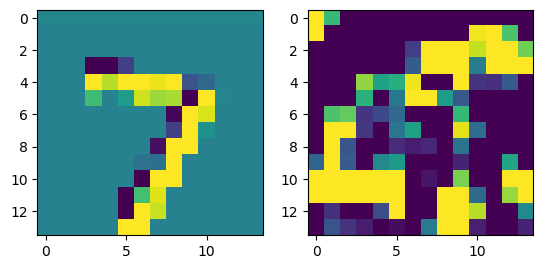

prediction: tensor([6, 2, 0]), tensor([3.1323, 3.0024, 1.6845]) groudtruth: 2
-0.10344684 0.09311864


<Figure size 640x480 with 0 Axes>

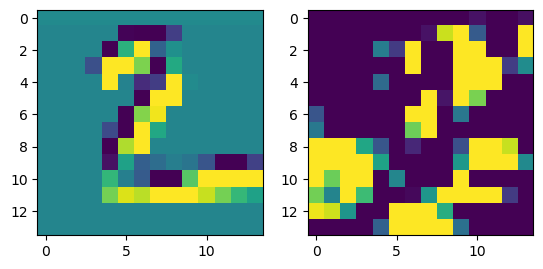

prediction: tensor([1, 7, 4]), tensor([7.0390, 1.6898, 0.6384]) groudtruth: 1
-0.08543736 0.08644612


<Figure size 640x480 with 0 Axes>

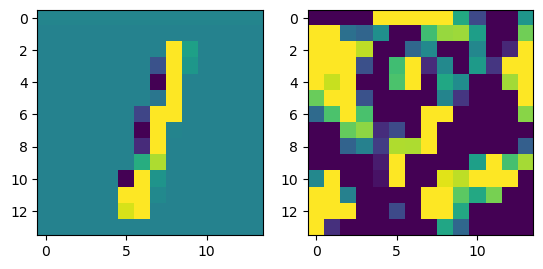

prediction: tensor([0, 6, 8]), tensor([4.6506, 2.5122, 1.0099]) groudtruth: 0
-0.064287424 0.10806079


<Figure size 640x480 with 0 Axes>

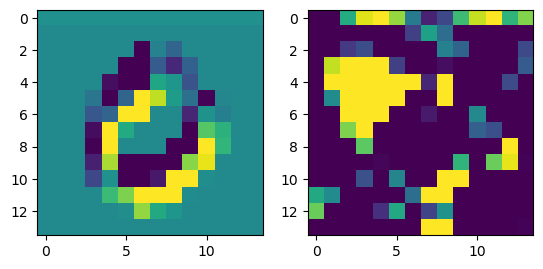

prediction: tensor([4, 9, 7]), tensor([5.1039, 1.9146, 1.2206]) groudtruth: 4
-0.07913017 0.08897742


<Figure size 640x480 with 0 Axes>

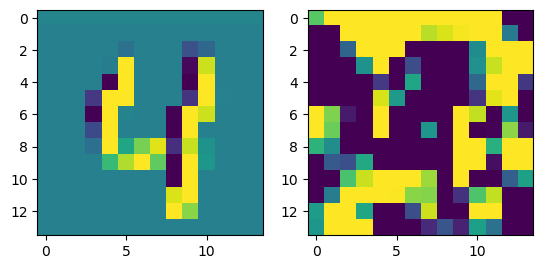

prediction: tensor([1, 4, 8]), tensor([5.9630, 1.0104, 0.3629]) groudtruth: 1
-0.07711607 0.074668884


<Figure size 640x480 with 0 Axes>

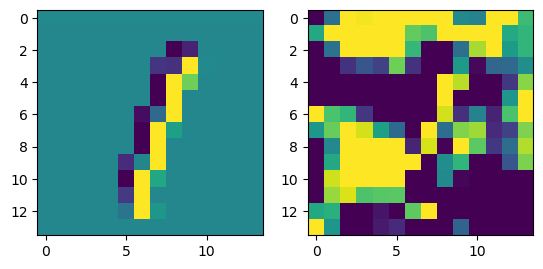

prediction: tensor([4, 2, 8]), tensor([4.2968, 2.3964, 1.8001]) groudtruth: 4
-0.068917096 0.08971547


<Figure size 640x480 with 0 Axes>

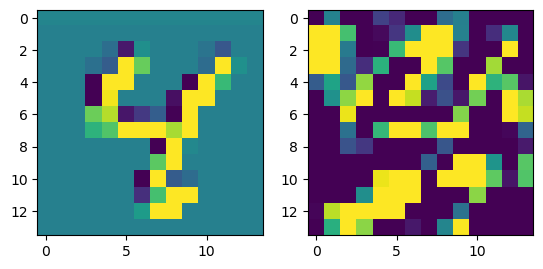

prediction: tensor([9, 7, 4]), tensor([4.7101, 2.6374, 1.7041]) groudtruth: 9
-0.07267356 0.072320305


<Figure size 640x480 with 0 Axes>

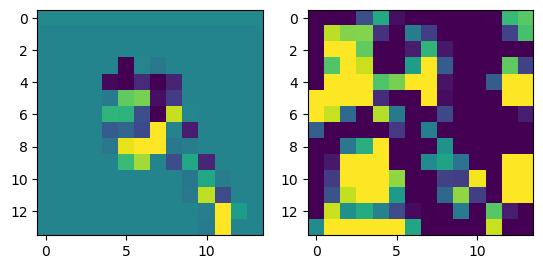

prediction: tensor([3, 6, 5]), tensor([3.7635, 2.9396, 1.8079]) groudtruth: 5
-0.08930874 0.06716827


<Figure size 640x480 with 0 Axes>

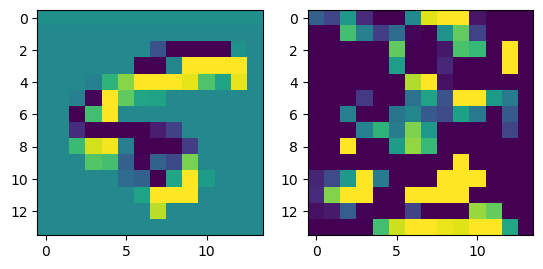

prediction: tensor([9, 5, 7]), tensor([3.8910, 2.0561, 1.4344]) groudtruth: 9
-0.106093645 0.09439786


<Figure size 640x480 with 0 Axes>

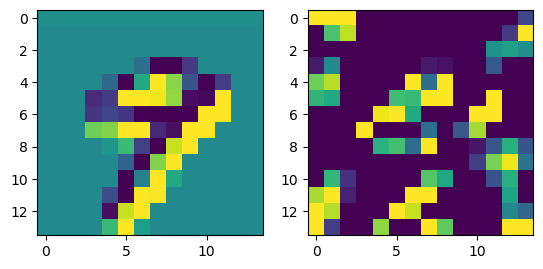

prediction: tensor([0, 7, 4]), tensor([6.2720, 1.4773, 0.4133]) groudtruth: 0
-0.07977301 0.06700952


<Figure size 640x480 with 0 Axes>

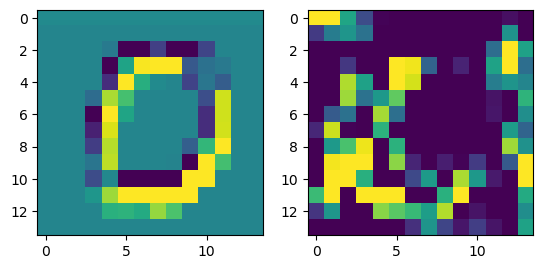

prediction: tensor([6, 3, 9]), tensor([2.4300, 1.2536, 1.2147]) groudtruth: 6
-0.10082626 0.116374545


<Figure size 640x480 with 0 Axes>

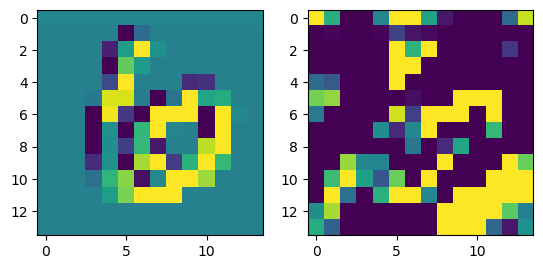

prediction: tensor([9, 7, 4]), tensor([4.9483, 2.5753, 1.2928]) groudtruth: 9
-0.09328985 0.09138017


<Figure size 640x480 with 0 Axes>

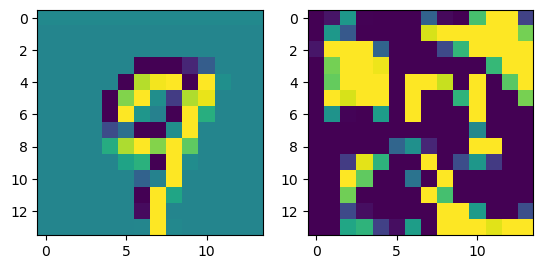

prediction: tensor([0, 5, 7]), tensor([5.3138, 1.2597, 0.9600]) groudtruth: 0
-0.083884954 0.09477981


<Figure size 640x480 with 0 Axes>

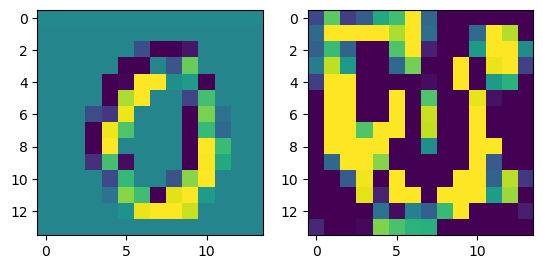

prediction: tensor([1, 9, 7]), tensor([4.5716, 2.3049, 0.7768]) groudtruth: 1
-0.069051504 0.07979786


<Figure size 640x480 with 0 Axes>

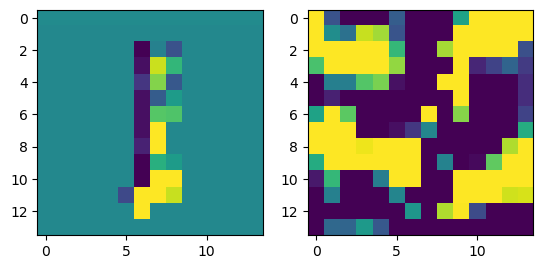

prediction: tensor([5, 6, 9]), tensor([3.0856, 2.1449, 1.5642]) groudtruth: 5
-0.08095896 0.07804505


<Figure size 640x480 with 0 Axes>

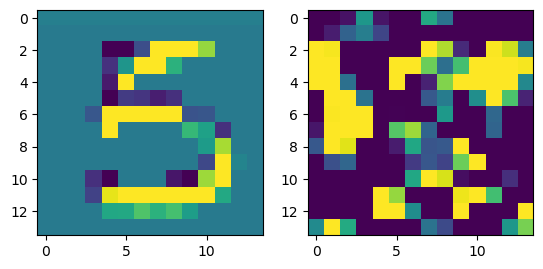

prediction: tensor([7, 5, 1]), tensor([5.5120, 2.0181, 1.0066]) groudtruth: 7
-0.08928192 0.13085437


<Figure size 640x480 with 0 Axes>

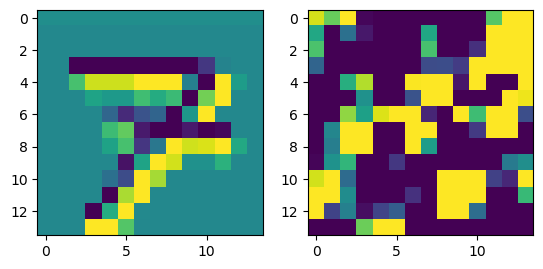

prediction: tensor([4, 0, 3]), tensor([2.6065, 2.0958, 1.6665]) groudtruth: 4
-0.08265835 0.057337422


<Figure size 640x480 with 0 Axes>

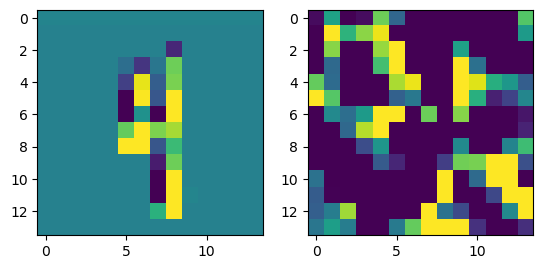

prediction: tensor([7, 0, 8]), tensor([5.3393, 3.7145, 2.8679]) groudtruth: 6
-0.08850485 0.08344665


<Figure size 640x480 with 0 Axes>

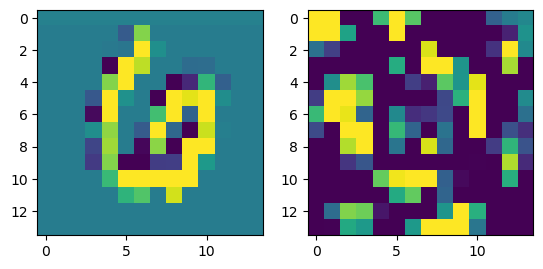

prediction: tensor([4, 3, 1]), tensor([4.0602, 3.3162, 1.3129]) groudtruth: 4
-0.06677526 0.07959476


<Figure size 640x480 with 0 Axes>

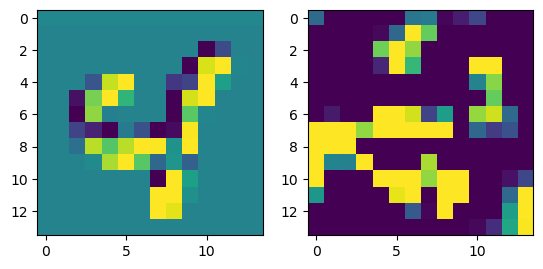

prediction: tensor([3, 5, 8]), tensor([4.4439, 1.4488, 0.7175]) groudtruth: 3
-0.079362035 0.13170189


<Figure size 640x480 with 0 Axes>

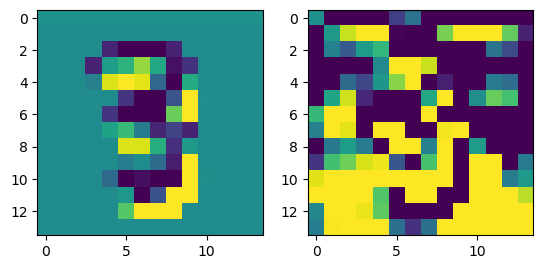

prediction: tensor([0, 3, 9]), tensor([2.5470, 1.0944, 0.9912]) groudtruth: 0
-0.10118246 0.06787058


<Figure size 640x480 with 0 Axes>

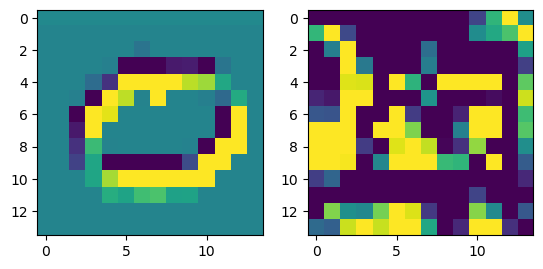

prediction: tensor([7, 9, 5]), tensor([6.7267, 1.9175, 0.8331]) groudtruth: 7
-0.0978058 0.074828476


<Figure size 640x480 with 0 Axes>

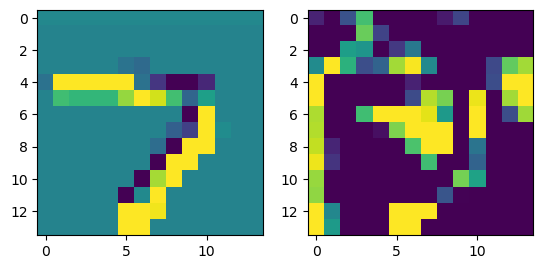

prediction: tensor([0, 9, 5]), tensor([7.2064, 1.1438, 0.1454]) groudtruth: 0
-0.07417846 0.09980711


<Figure size 640x480 with 0 Axes>

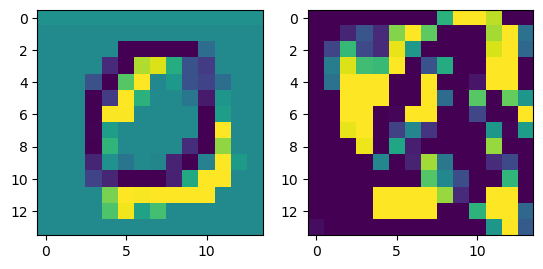

prediction: tensor([2, 0, 9]), tensor([2.8104, 2.3724, 0.9822]) groudtruth: 2
-0.097248256 0.095427334


<Figure size 640x480 with 0 Axes>

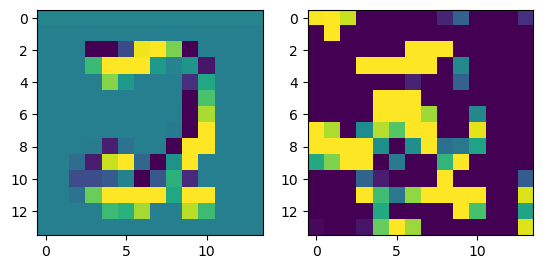

prediction: tensor([7, 8, 1]), tensor([3.1935, 2.3296, 1.8500]) groudtruth: 9
-0.0916729 0.108767174


<Figure size 640x480 with 0 Axes>

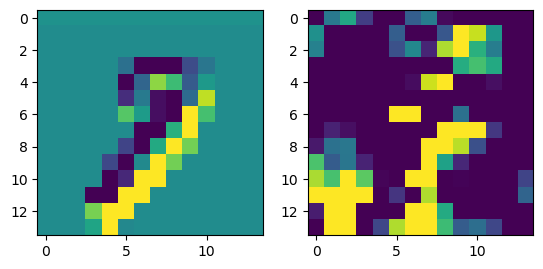

prediction: tensor([1, 9, 8]), tensor([6.7826, 0.6471, 0.1369]) groudtruth: 1
-0.08912665 0.077123545


<Figure size 640x480 with 0 Axes>

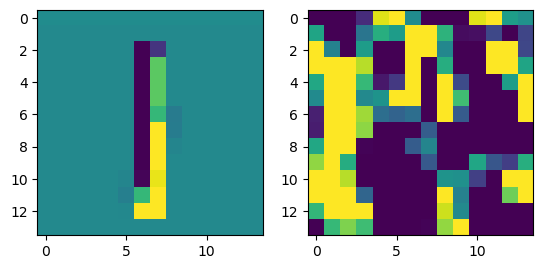

prediction: tensor([7, 2, 3]), tensor([1.4859, 1.4605, 1.0640]) groudtruth: 7
-0.05960405 0.070252284


<Figure size 640x480 with 0 Axes>

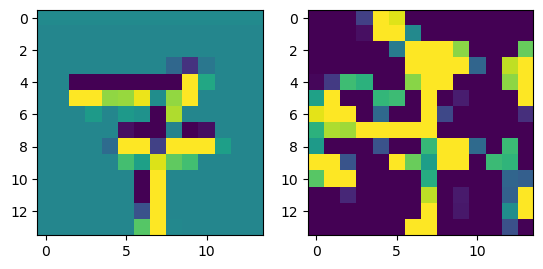

prediction: tensor([3, 9, 4]), tensor([4.6240, 0.3482, 0.2729]) groudtruth: 3
-0.08461475 0.094402865


<Figure size 640x480 with 0 Axes>

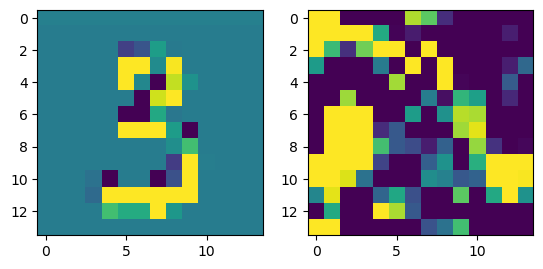

prediction: tensor([2, 8, 6]), tensor([4.5321, 1.6728, 0.7950]) groudtruth: 2
-0.101975024 0.12565146


<Figure size 640x480 with 0 Axes>

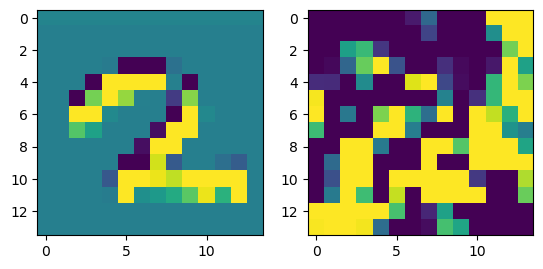

prediction: tensor([9, 8, 1]), tensor([4.5616, 3.3303, 0.8021]) groudtruth: 9
-0.060073435 0.090409495


<Figure size 640x480 with 0 Axes>

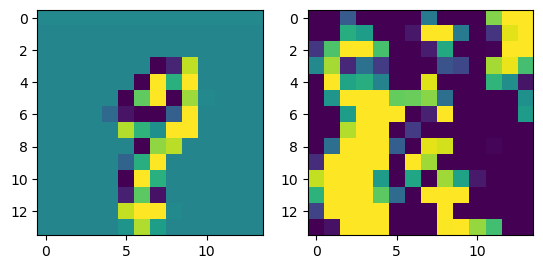

prediction: tensor([8, 7, 0]), tensor([2.7287, 2.6683, 0.2915]) groudtruth: 7
-0.11106485 0.10089882


<Figure size 640x480 with 0 Axes>

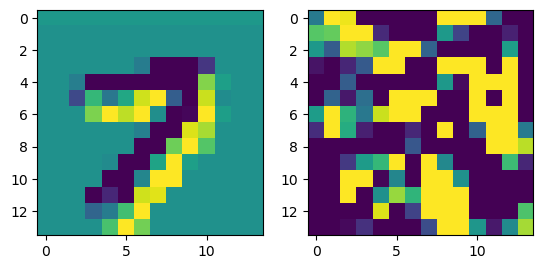

prediction: tensor([8, 9, 7]), tensor([3.3890, 1.1389, 1.1335]) groudtruth: 8
-0.08420718 0.08106809


<Figure size 640x480 with 0 Axes>

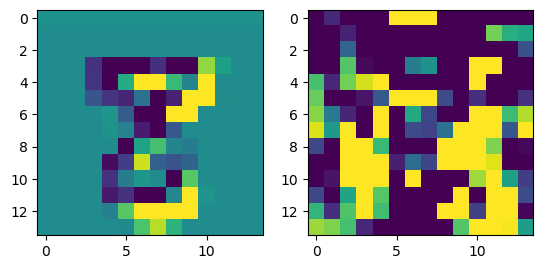

prediction: tensor([7, 5, 9]), tensor([3.1070, 3.0653, 1.3306]) groudtruth: 5
-0.059550643 0.090026125


<Figure size 640x480 with 0 Axes>

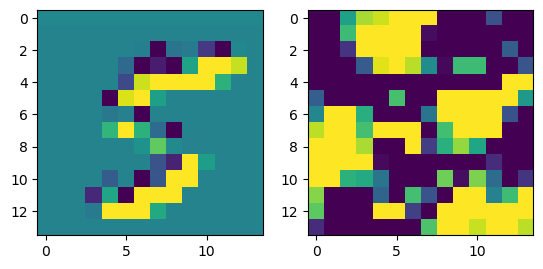

prediction: tensor([6, 8, 5]), tensor([6.8336, 0.9061, 0.8417]) groudtruth: 6
-0.080942094 0.072710186


<Figure size 640x480 with 0 Axes>

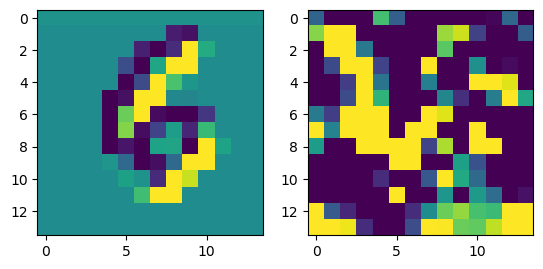

prediction: tensor([6, 2, 4]), tensor([4.3225, 2.4016, 1.5771]) groudtruth: 6
-0.07250625 0.066322


<Figure size 640x480 with 0 Axes>

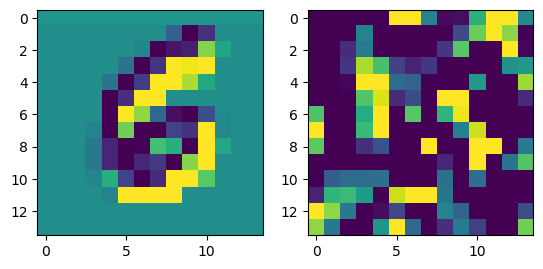

prediction: tensor([2, 3, 5]), tensor([3.3015, 2.5425, 2.2857]) groudtruth: 5
-0.114073634 0.08619352


<Figure size 640x480 with 0 Axes>

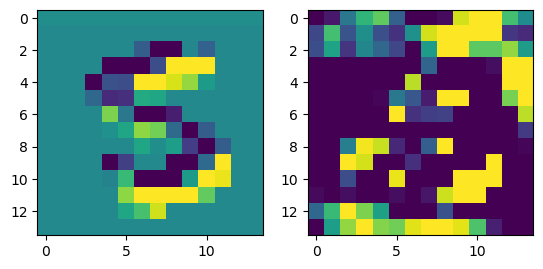

prediction: tensor([2, 7, 9]), tensor([2.2643, 1.9964, 1.3107]) groudtruth: 7
-0.09920734 0.091757014


<Figure size 640x480 with 0 Axes>

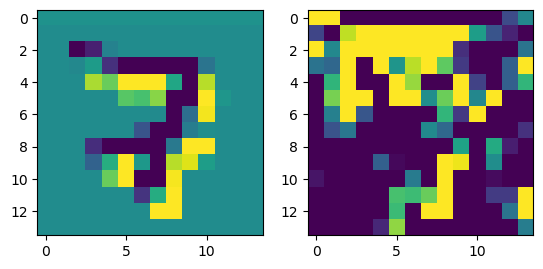

prediction: tensor([8, 2, 3]), tensor([5.2557, 1.3182, 0.7964]) groudtruth: 8
-0.07749188 0.11329113


<Figure size 640x480 with 0 Axes>

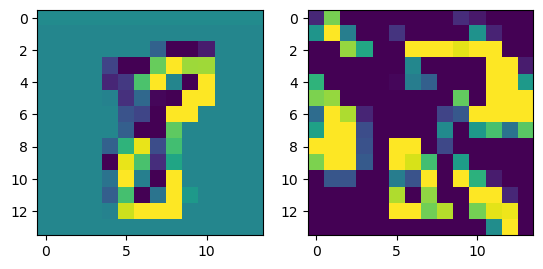

prediction: tensor([1, 9, 8]), tensor([4.5444, 1.1788, 0.9076]) groudtruth: 1
-0.06823015 0.06098575


<Figure size 640x480 with 0 Axes>

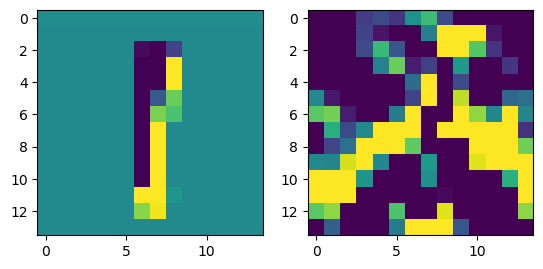

prediction: tensor([0, 7, 5]), tensor([3.9230, 1.7420, 1.0537]) groudtruth: 0
-0.082363784 0.07905206


<Figure size 640x480 with 0 Axes>

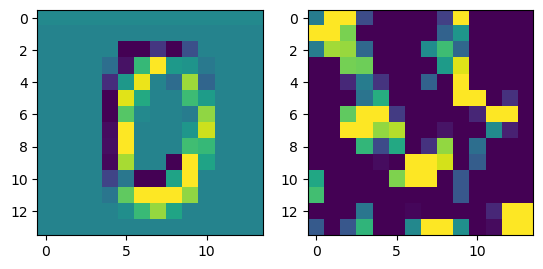

prediction: tensor([1, 7, 9]), tensor([2.9561, 1.6063, 1.4621]) groudtruth: 1
-0.07051593 0.1183375


<Figure size 640x480 with 0 Axes>

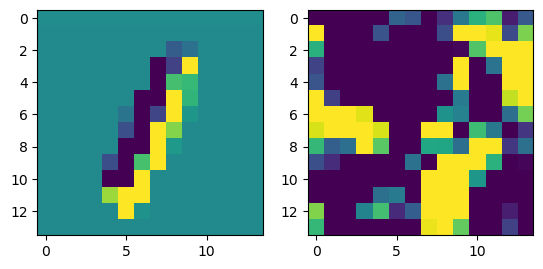

prediction: tensor([6, 4, 2]), tensor([5.9924, 1.2826, 0.8801]) groudtruth: 6
-0.07185608 0.08030705


<Figure size 640x480 with 0 Axes>

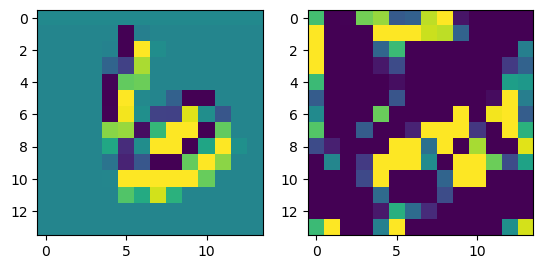

prediction: tensor([9, 3, 1]), tensor([3.4174, 2.1948, 1.6048]) groudtruth: 4
-0.08240241 0.078472376


<Figure size 640x480 with 0 Axes>

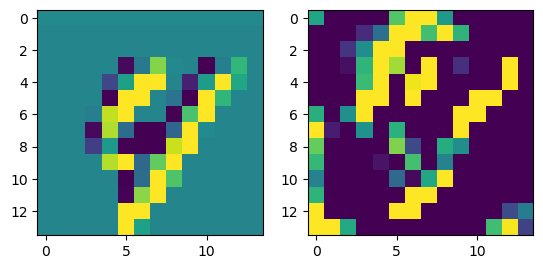

prediction: tensor([6, 0, 8]), tensor([5.3255, 3.1346, 2.8875]) groudtruth: 6
-0.06811732 0.06057153


<Figure size 640x480 with 0 Axes>

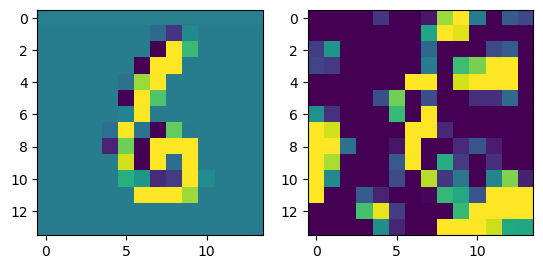

prediction: tensor([7, 9, 2]), tensor([6.6985, 2.0014, 0.9005]) groudtruth: 7
-0.07517755 0.0861125


<Figure size 640x480 with 0 Axes>

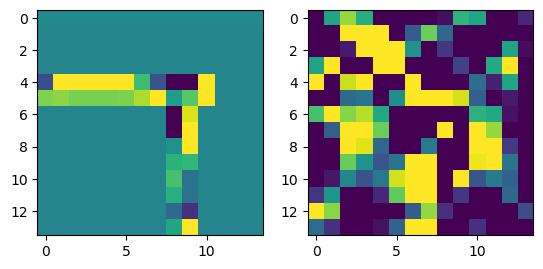

prediction: tensor([3, 2, 1]), tensor([4.6820, 2.8173, 0.6261]) groudtruth: 3
-0.0842576 0.11186448


<Figure size 640x480 with 0 Axes>

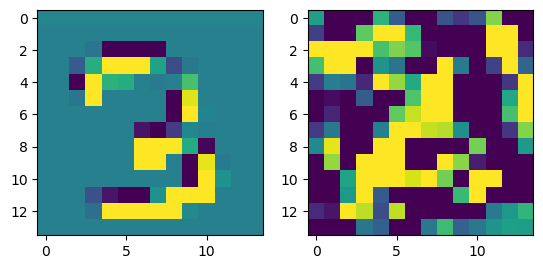

prediction: tensor([1, 8, 7]), tensor([6.7093, 1.1490, 0.6346]) groudtruth: 1
-0.075950384 0.06737538


<Figure size 640x480 with 0 Axes>

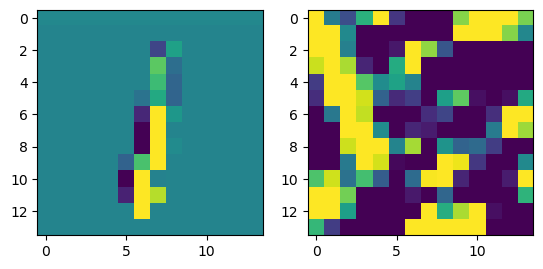

prediction: tensor([0, 6, 2]), tensor([5.7203, 1.8093, 1.0140]) groudtruth: 0
-0.08058268 0.09167868


<Figure size 640x480 with 0 Axes>

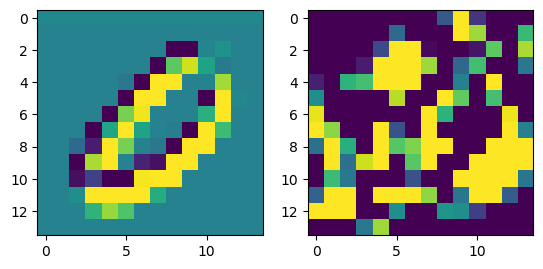

prediction: tensor([8, 3, 7]), tensor([2.6343, 1.6747, 1.5432]) groudtruth: 9
-0.08000213 0.07448705


<Figure size 640x480 with 0 Axes>

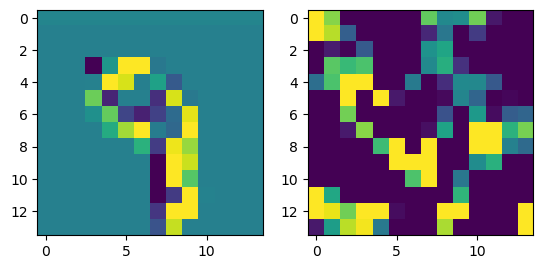

prediction: tensor([0, 5, 7]), tensor([4.9611, 2.5981, 1.0036]) groudtruth: 0
-0.08383846 0.10379371


<Figure size 640x480 with 0 Axes>

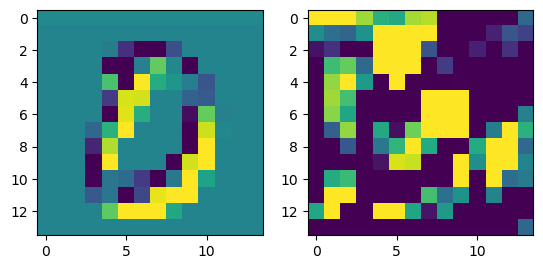

prediction: tensor([2, 3, 4]), tensor([5.9316, 2.4602, 1.6863]) groudtruth: 3
-0.0871827 0.104866214


<Figure size 640x480 with 0 Axes>

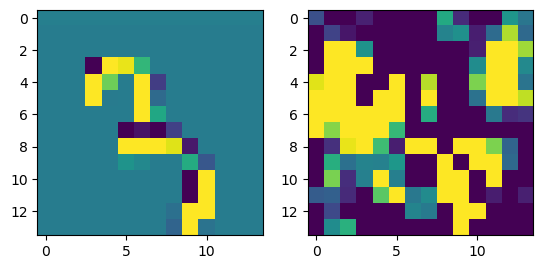

prediction: tensor([1, 6, 4]), tensor([4.8922, 3.1111, 0.9580]) groudtruth: 1
-0.08340132 0.106227286


<Figure size 640x480 with 0 Axes>

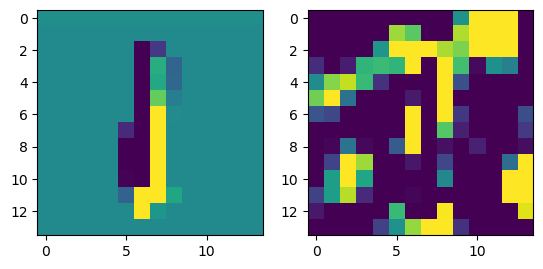

prediction: tensor([6, 7, 5]), tensor([6.2231, 1.3964, 1.0251]) groudtruth: 6
-0.085905075 0.09504223


<Figure size 640x480 with 0 Axes>

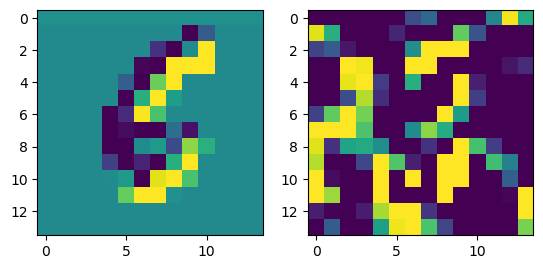

prediction: tensor([4, 7, 5]), tensor([3.6937, 2.4032, 0.3757]) groudtruth: 4
-0.09526205 0.12154343


<Figure size 640x480 with 0 Axes>

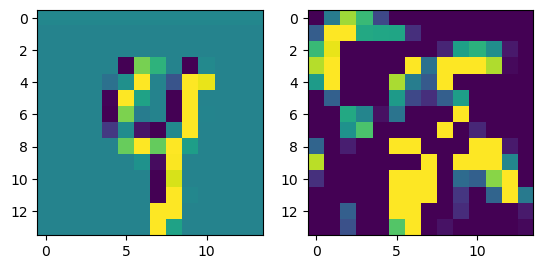

prediction: tensor([2, 1, 6]), tensor([4.4369, 0.8697, 0.0798]) groudtruth: 2
-0.0791536 0.13117127


<Figure size 640x480 with 0 Axes>

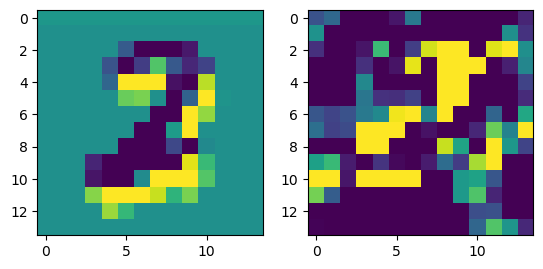

prediction: tensor([3, 2, 9]), tensor([3.3578, 2.9692, 1.4964]) groudtruth: 3
-0.10084355 0.085733905


<Figure size 640x480 with 0 Axes>

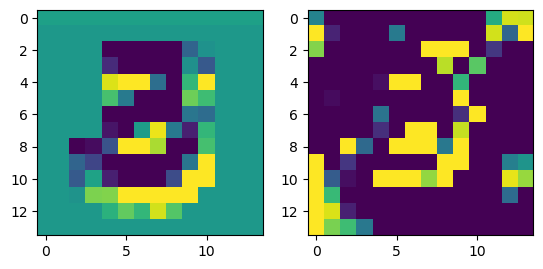

prediction: tensor([6, 0, 8]), tensor([3.5621, 2.4845, 0.4759]) groudtruth: 6
-0.08193445 0.09942074


<Figure size 640x480 with 0 Axes>

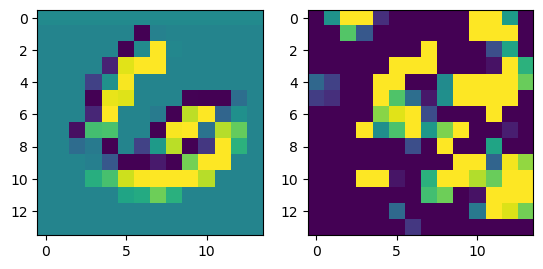

prediction: tensor([1, 2, 6]), tensor([4.9947, 1.2373, 1.2156]) groudtruth: 1
-0.09814161 0.12777677


<Figure size 640x480 with 0 Axes>

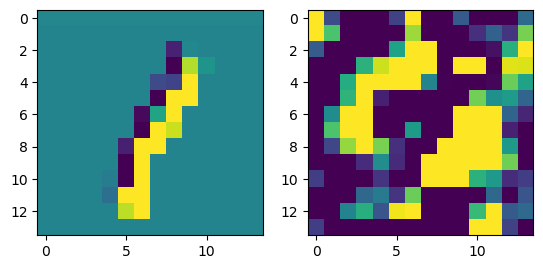

prediction: tensor([1, 8, 3]), tensor([4.6259, 2.0069, 1.9125]) groudtruth: 1
-0.07066488 0.07079174


<Figure size 640x480 with 0 Axes>

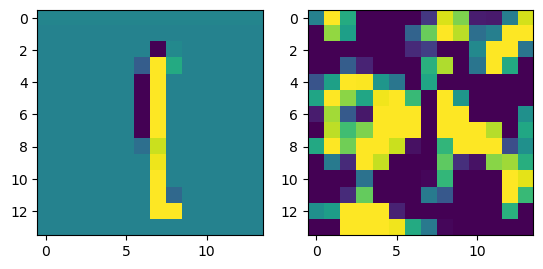

prediction: tensor([1, 7, 8]), tensor([5.9350, 1.8946, 0.5008]) groudtruth: 1
-0.10434133 0.088511944


<Figure size 640x480 with 0 Axes>

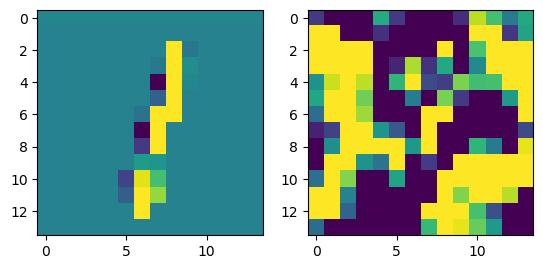

prediction: tensor([3, 0, 7]), tensor([6.1218, 2.3082, 1.1728]) groudtruth: 3
-0.06272322 0.09259497


<Figure size 640x480 with 0 Axes>

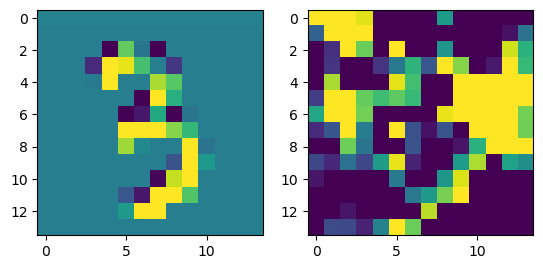

prediction: tensor([9, 6, 7]), tensor([3.9823, 1.9507, 0.6498]) groudtruth: 9
-0.09130061 0.08904351


<Figure size 640x480 with 0 Axes>

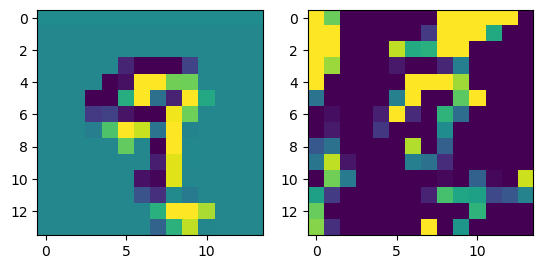

prediction: tensor([5, 1, 9]), tensor([4.1351, 3.3088, 2.8914]) groudtruth: 5
-0.113735974 0.09811027


<Figure size 640x480 with 0 Axes>

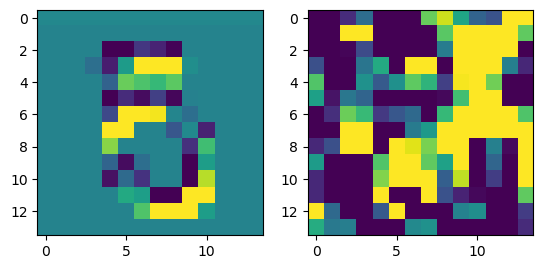

prediction: tensor([2, 9, 7]), tensor([3.6619, 2.0603, 1.6961]) groudtruth: 2
-0.1007483 0.085976824


<Figure size 640x480 with 0 Axes>

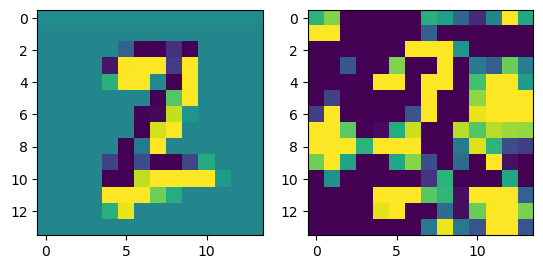

prediction: tensor([8, 6, 2]), tensor([4.0005, 1.1526, 0.4474]) groudtruth: 8
-0.058220148 0.069229454


<Figure size 640x480 with 0 Axes>

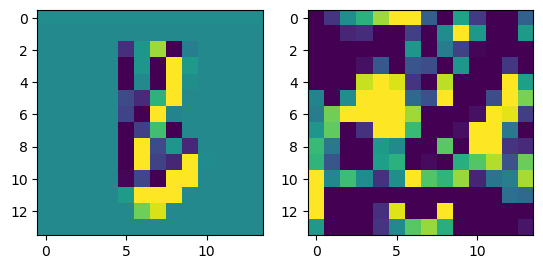

prediction: tensor([2, 9, 8]), tensor([4.6349, 0.7930, 0.6674]) groudtruth: 2
-0.09695369 0.11831857


<Figure size 640x480 with 0 Axes>

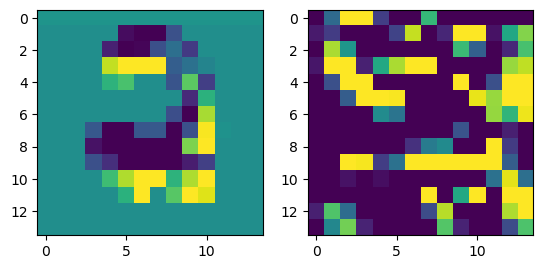

prediction: tensor([0, 8, 7]), tensor([5.0684, 1.8625, 1.0407]) groudtruth: 6
-0.06686187 0.08172417


<Figure size 640x480 with 0 Axes>

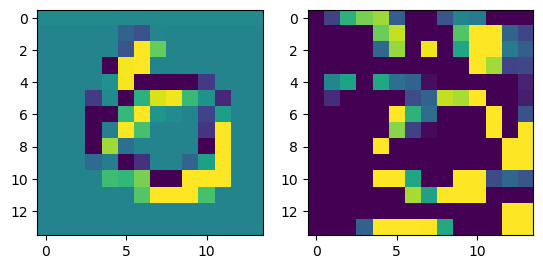

prediction: tensor([9, 8, 5]), tensor([5.1614, 2.1382, 1.6036]) groudtruth: 8
-0.08459914 0.08880061


<Figure size 640x480 with 0 Axes>

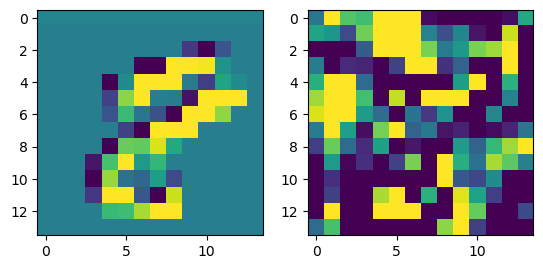

prediction: tensor([5, 3, 0]), tensor([7.5940, 1.8340, 0.5439]) groudtruth: 5
-0.088958025 0.07386558


<Figure size 640x480 with 0 Axes>

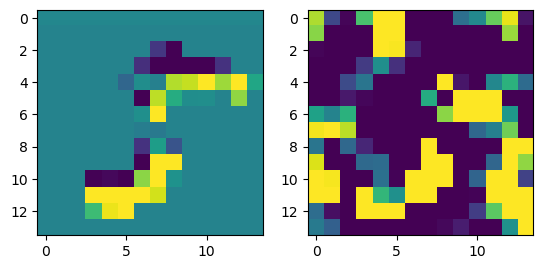

prediction: tensor([7, 9, 4]), tensor([ 7.1999,  2.4358, -0.4140]) groudtruth: 7
-0.102546334 0.06975238


<Figure size 640x480 with 0 Axes>

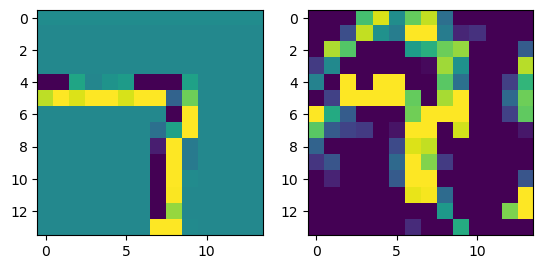

prediction: tensor([7, 2, 1]), tensor([3.7045, 2.7426, 1.4294]) groudtruth: 7
-0.09037477 0.083357446


<Figure size 640x480 with 0 Axes>

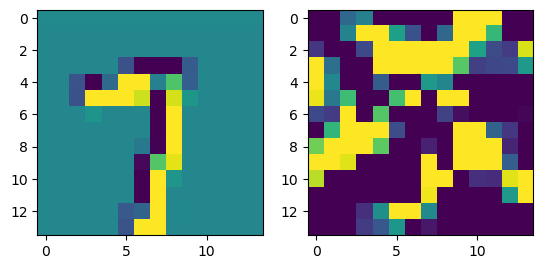

prediction: tensor([4, 8, 9]), tensor([2.1513, 1.3506, 1.2595]) groudtruth: 9
-0.08137441 0.07524632


<Figure size 640x480 with 0 Axes>

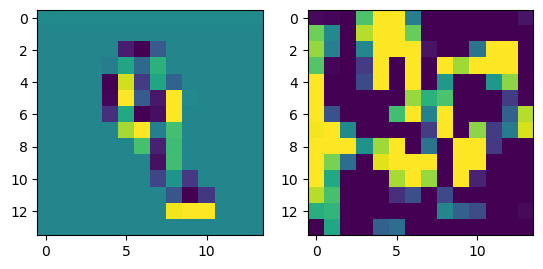

prediction: tensor([1, 3, 2]), tensor([3.6683, 1.9376, 0.6271]) groudtruth: 1
-0.046183944 0.083992794


<Figure size 640x480 with 0 Axes>

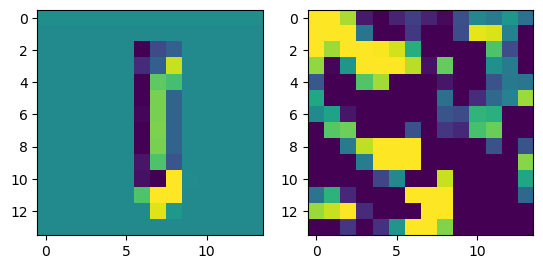

prediction: tensor([8, 7, 6]), tensor([3.7903, 1.0574, 0.9206]) groudtruth: 8
-0.099672556 0.07424961


<Figure size 640x480 with 0 Axes>

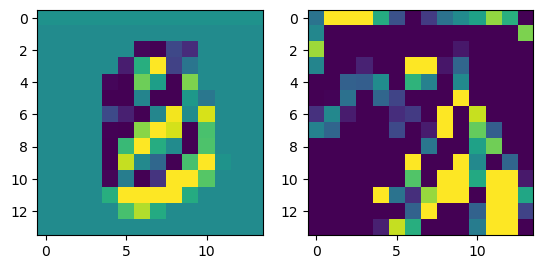

prediction: tensor([1, 7, 9]), tensor([3.9433, 1.9850, 1.0346]) groudtruth: 1
-0.082223654 0.07300635


<Figure size 640x480 with 0 Axes>

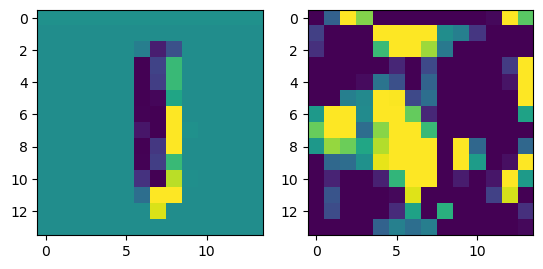

prediction: tensor([8, 6, 4]), tensor([3.5159, 2.0750, 1.4876]) groudtruth: 8
-0.10059559 0.08427726


<Figure size 640x480 with 0 Axes>

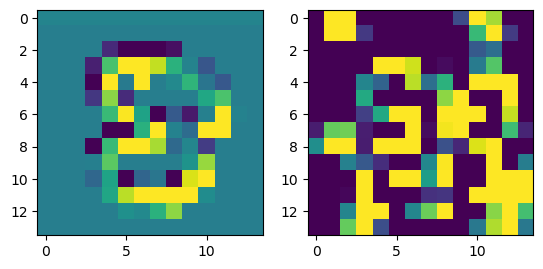

prediction: tensor([0, 3, 9]), tensor([5.1144, 3.1509, 1.1591]) groudtruth: 0
-0.08378112 0.11545523


<Figure size 640x480 with 0 Axes>

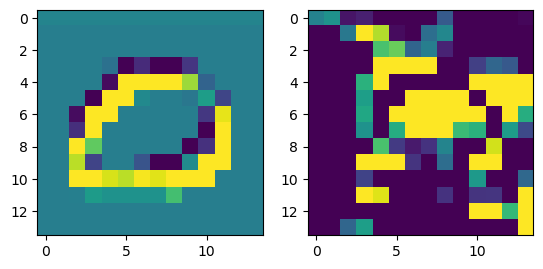

prediction: tensor([5, 3, 6]), tensor([3.7342, 3.3312, 1.7698]) groudtruth: 3
-0.07200903 0.07300369


<Figure size 640x480 with 0 Axes>

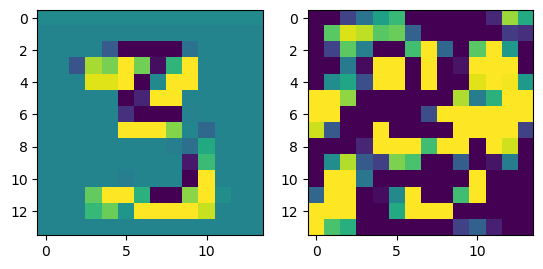

prediction: tensor([0, 3, 9]), tensor([2.7125, 1.4393, 0.5982]) groudtruth: 0
-0.081201255 0.119873896


<Figure size 640x480 with 0 Axes>

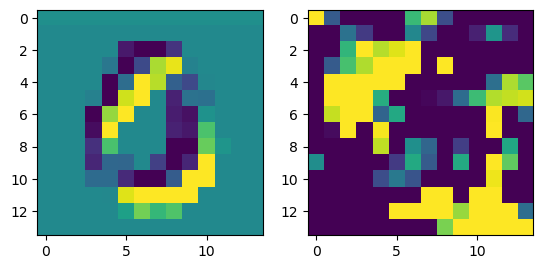

prediction: tensor([7, 9, 1]), tensor([2.1082, 1.8781, 1.8583]) groudtruth: 9
-0.07329297 0.056276746


<Figure size 640x480 with 0 Axes>

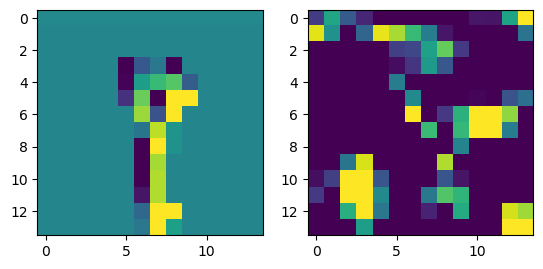

prediction: tensor([7, 2, 9]), tensor([2.6687, 2.0150, 0.9733]) groudtruth: 2
-0.08813667 0.10049356


<Figure size 640x480 with 0 Axes>

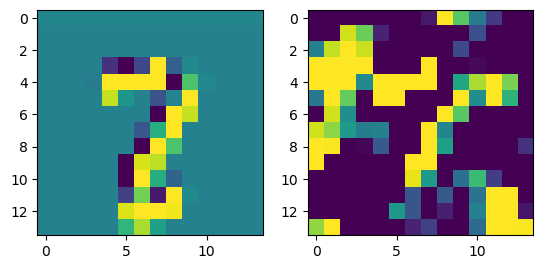

prediction: tensor([9, 7, 8]), tensor([3.4872, 1.3938, 1.2203]) groudtruth: 9
-0.083188 0.11084649


<Figure size 640x480 with 0 Axes>

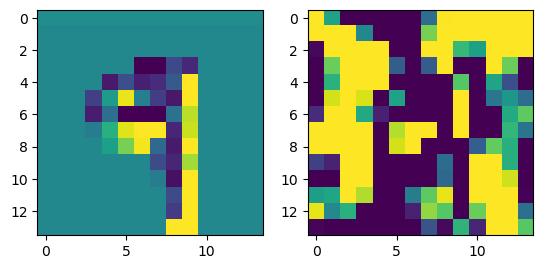

prediction: tensor([3, 0, 4]), tensor([4.2504, 1.9684, 1.2628]) groudtruth: 3
-0.07346165 0.07081391


<Figure size 640x480 with 0 Axes>

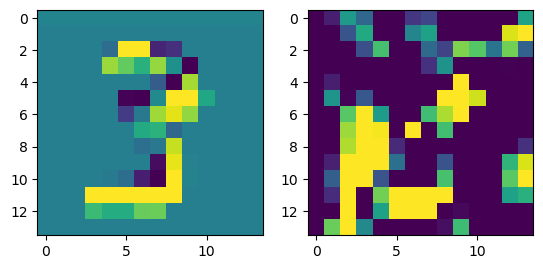

prediction: tensor([5, 8, 6]), tensor([2.1005, 1.9324, 0.4969]) groudtruth: 0
-0.10717672 0.09161697


<Figure size 640x480 with 0 Axes>

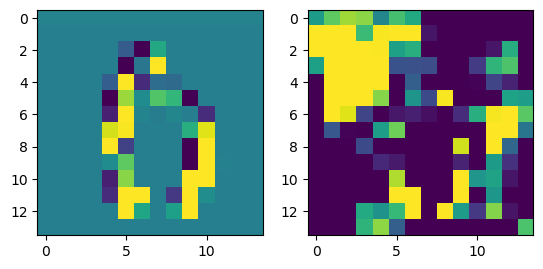

prediction: tensor([4, 9, 1]), tensor([3.7722, 2.6984, 1.4326]) groudtruth: 4
-0.067118764 0.09089024


<Figure size 640x480 with 0 Axes>

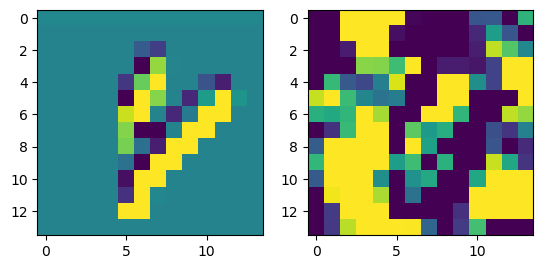

prediction: tensor([2, 6, 0]), tensor([6.0579, 3.3486, 0.3861]) groudtruth: 2
-0.07804972 0.111852534


<Figure size 640x480 with 0 Axes>

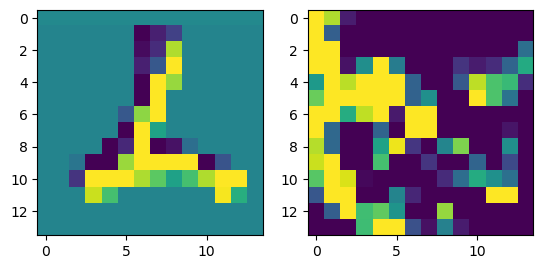

prediction: tensor([0, 7, 6]), tensor([3.5934, 1.8208, 1.1128]) groudtruth: 0
-0.10001427 0.09608717


<Figure size 640x480 with 0 Axes>

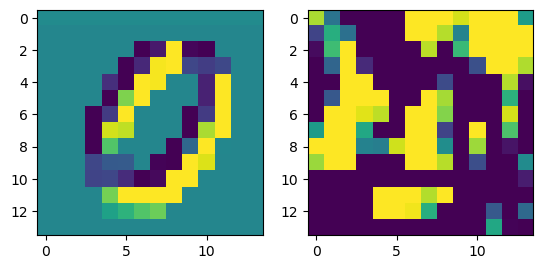

prediction: tensor([7, 9, 6]), tensor([3.2611, 1.2698, 0.4466]) groudtruth: 7
-0.07853484 0.087779135


<Figure size 640x480 with 0 Axes>

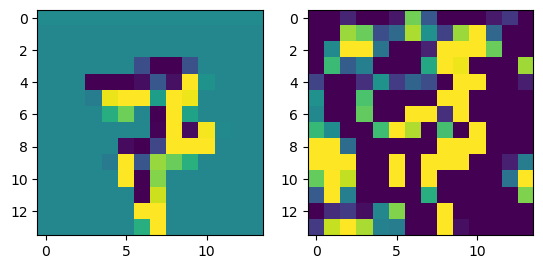

prediction: tensor([1, 7, 6]), tensor([4.4844, 2.0566, 0.1449]) groudtruth: 1
-0.06745398 0.10428633


<Figure size 640x480 with 0 Axes>

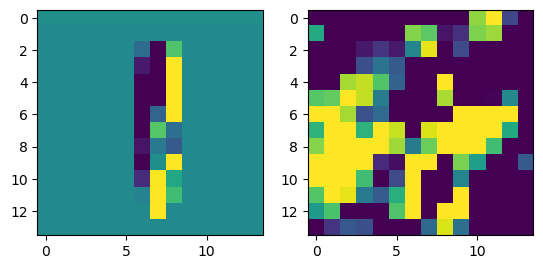

prediction: tensor([1, 5, 9]), tensor([2.8491, 0.7429, 0.6105]) groudtruth: 1
-0.06762618 0.07036259


<Figure size 640x480 with 0 Axes>

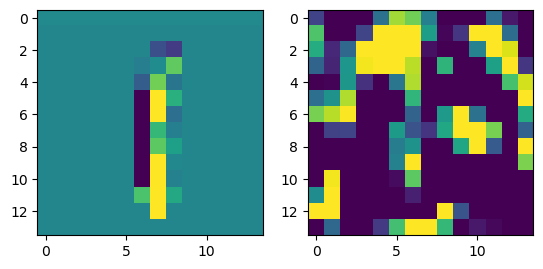

prediction: tensor([2, 1, 7]), tensor([3.0846, 2.2320, 2.2174]) groudtruth: 2
-0.07067931 0.12089825


<Figure size 640x480 with 0 Axes>

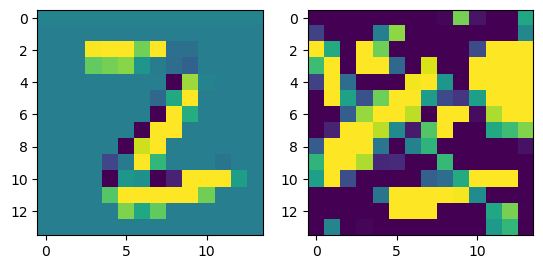

prediction: tensor([1, 7, 8]), tensor([4.3073, 3.3113, 0.3761]) groudtruth: 1
-0.06975365 0.09906887


<Figure size 640x480 with 0 Axes>

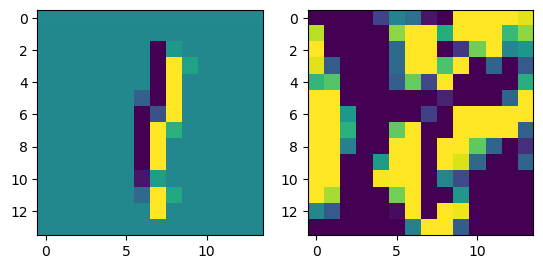

prediction: tensor([5, 8, 4]), tensor([5.4770, 2.6089, 1.8115]) groudtruth: 5
-0.070301116 0.075066365


<Figure size 640x480 with 0 Axes>

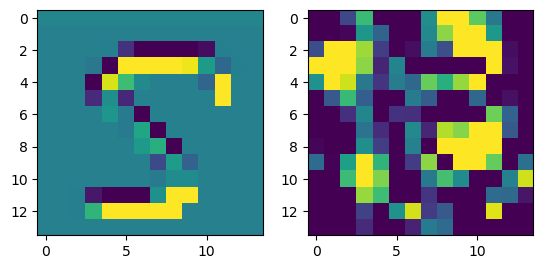

prediction: tensor([3, 9, 8]), tensor([5.6078, 2.6498, 0.7414]) groudtruth: 3
-0.07512081 0.07127716


<Figure size 640x480 with 0 Axes>

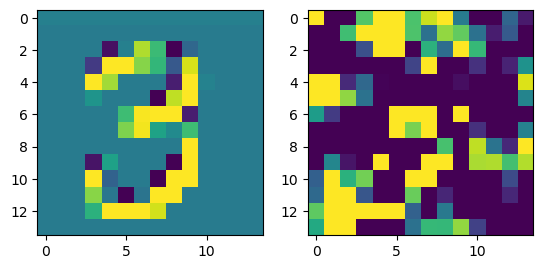

prediction: tensor([2, 8, 0]), tensor([3.3802, 1.6835, 1.5794]) groudtruth: 3
-0.08198738 0.09150778


<Figure size 640x480 with 0 Axes>

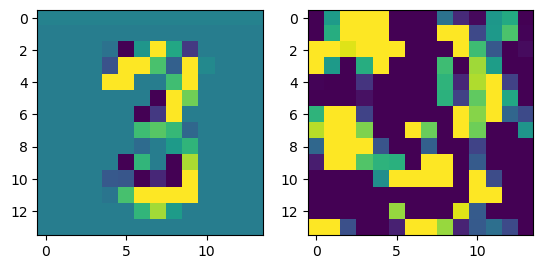

prediction: tensor([6, 9, 8]), tensor([5.5179, 1.1245, 0.5991]) groudtruth: 6
-0.07403648 0.07484633


<Figure size 640x480 with 0 Axes>

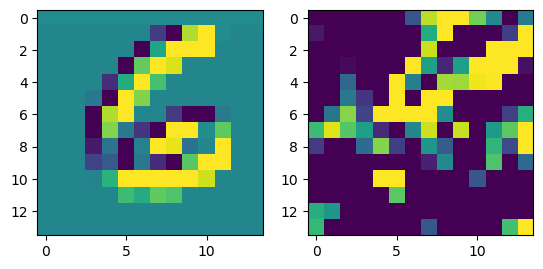

prediction: tensor([1, 0, 3]), tensor([5.1813, 0.6549, 0.3797]) groudtruth: 1
-0.06744897 0.09754041


<Figure size 640x480 with 0 Axes>

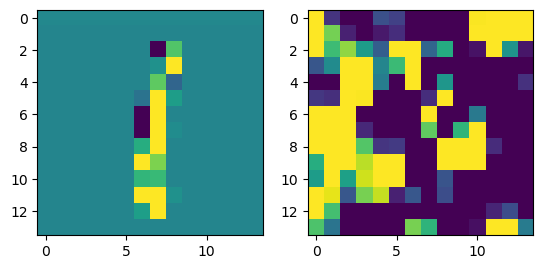

prediction: tensor([6, 0, 8]), tensor([3.2967, 1.3108, 0.7223]) groudtruth: 6
-0.07233095 0.11074011


<Figure size 640x480 with 0 Axes>

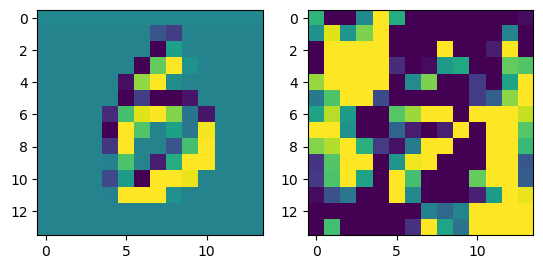

prediction: tensor([2, 8, 3]), tensor([6.4245, 2.4294, 1.8915]) groudtruth: 2
-0.06499541 0.06789929


<Figure size 640x480 with 0 Axes>

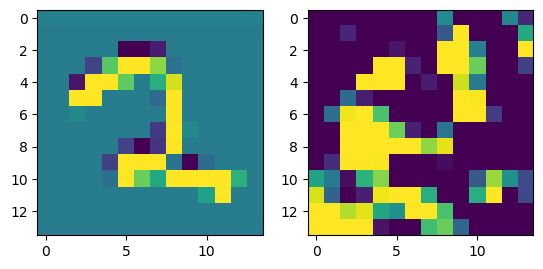

prediction: tensor([1, 0, 6]), tensor([3.0178, 1.1602, 1.0710]) groudtruth: 1
-0.066802084 0.07759198


<Figure size 640x480 with 0 Axes>

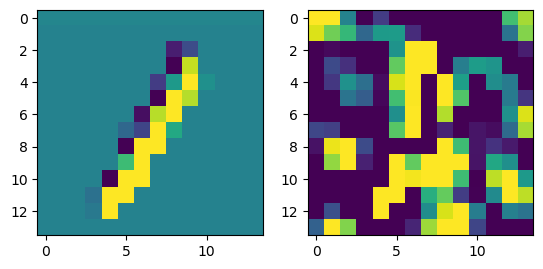

prediction: tensor([7, 9, 1]), tensor([3.2518, 2.7517, 1.0106]) groudtruth: 9
-0.09863114 0.098449394


<Figure size 640x480 with 0 Axes>

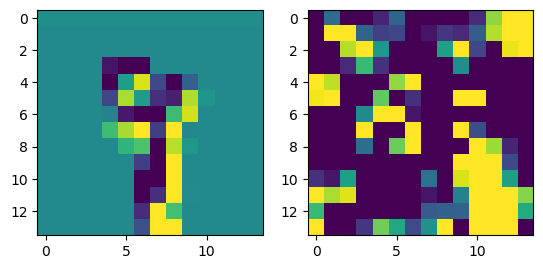

prediction: tensor([2, 6, 7]), tensor([4.4666, 1.0083, 0.8842]) groudtruth: 2
-0.10281932 0.100282274


<Figure size 640x480 with 0 Axes>

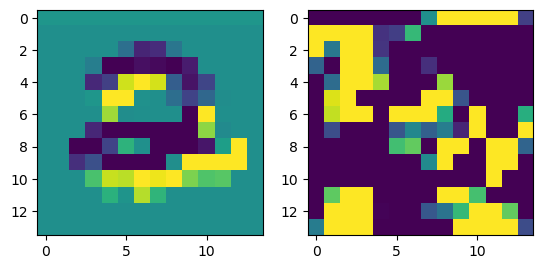

prediction: tensor([8, 5, 2]), tensor([3.1478, 2.7107, 0.6982]) groudtruth: 8
-0.051310956 0.05935785


<Figure size 640x480 with 0 Axes>

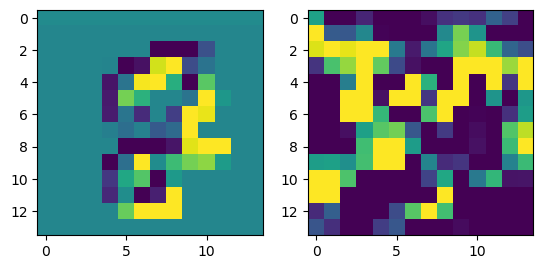

prediction: tensor([6, 7, 2]), tensor([5.4032, 1.0314, 0.0186]) groudtruth: 6
-0.08393687 0.07230027


<Figure size 640x480 with 0 Axes>

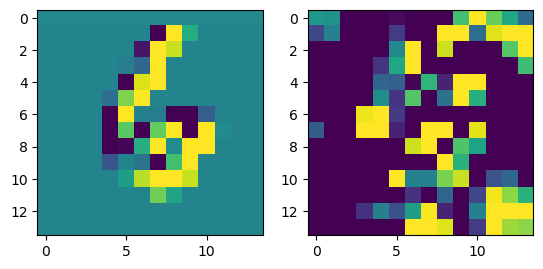

prediction: tensor([1, 9, 7]), tensor([4.4662, 1.7170, 1.3699]) groudtruth: 1
-0.086425304 0.081703715


<Figure size 640x480 with 0 Axes>

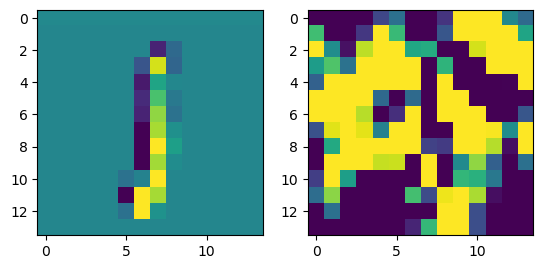

prediction: tensor([9, 2, 6]), tensor([2.5880, 2.2893, 0.6637]) groudtruth: 9
-0.072868586 0.090067126


<Figure size 640x480 with 0 Axes>

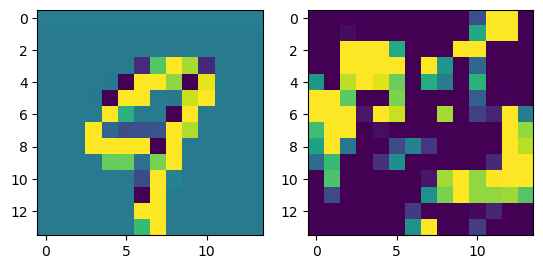

prediction: tensor([5, 3, 9]), tensor([4.4442, 4.2404, 1.1730]) groudtruth: 5
-0.10987079 0.09251591


<Figure size 640x480 with 0 Axes>

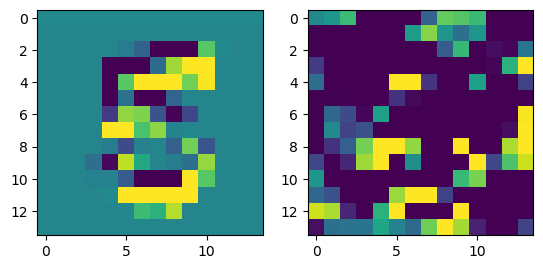

prediction: tensor([2, 6, 7]), tensor([2.6433, 2.4552, 1.9098]) groudtruth: 2
-0.08634633 0.08469938


<Figure size 640x480 with 0 Axes>

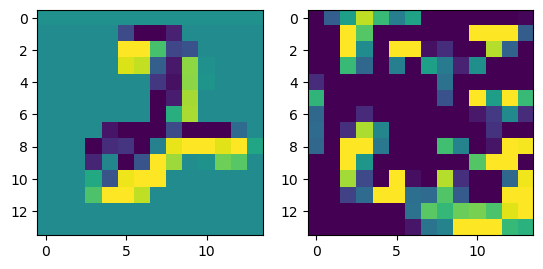

prediction: tensor([5, 3, 8]), tensor([4.8295, 2.8152, 2.7378]) groudtruth: 5
-0.08159959 0.107368335


<Figure size 640x480 with 0 Axes>

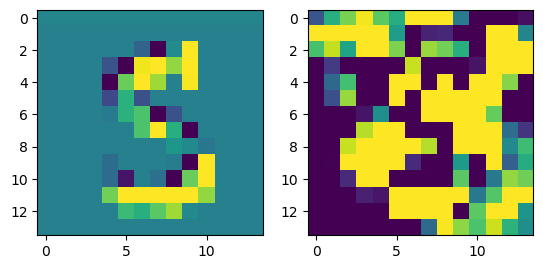

prediction: tensor([4, 6, 1]), tensor([3.6777, 3.5329, 1.6933]) groudtruth: 4
-0.10197568 0.075496696


<Figure size 640x480 with 0 Axes>

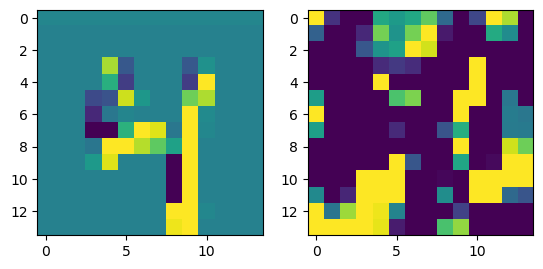

prediction: tensor([4, 3, 2]), tensor([4.3981, 0.8951, 0.7443]) groudtruth: 4
-0.0681414 0.06923962


<Figure size 640x480 with 0 Axes>

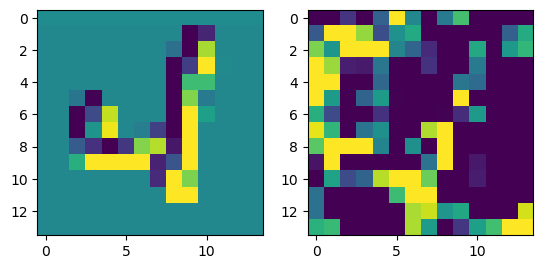

prediction: tensor([8, 5, 6]), tensor([1.8063, 1.6189, 1.6181]) groudtruth: 9
-0.11009592 0.08318518


<Figure size 640x480 with 0 Axes>

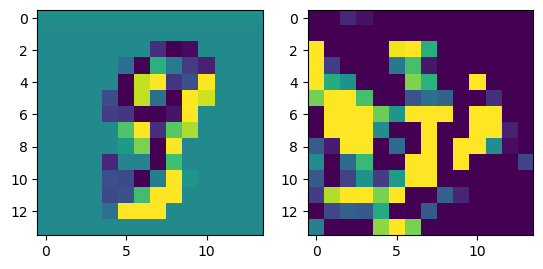

prediction: tensor([5, 3, 6]), tensor([3.7512, 1.6821, 1.1165]) groudtruth: 3
-0.08320719 0.09649438


<Figure size 640x480 with 0 Axes>

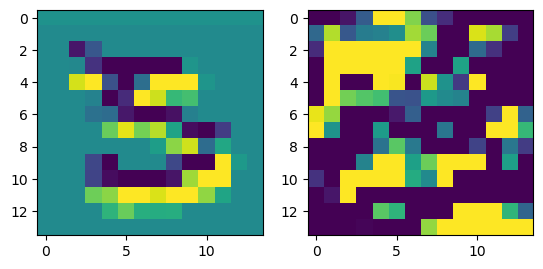

prediction: tensor([3, 5, 7]), tensor([3.4873, 2.2812, 0.7819]) groudtruth: 3
-0.11250007 0.15540037


<Figure size 640x480 with 0 Axes>

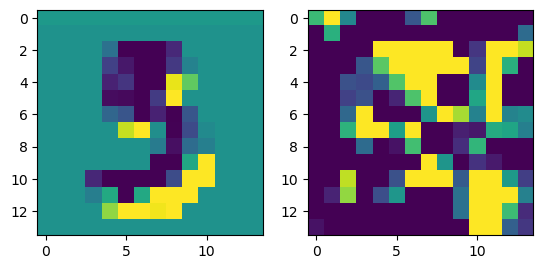

prediction: tensor([3, 2, 5]), tensor([5.8635, 3.1444, 0.5642]) groudtruth: 3
-0.08148527 0.08775842


<Figure size 640x480 with 0 Axes>

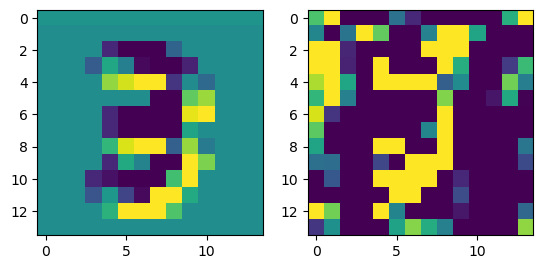

prediction: tensor([2, 1, 6]), tensor([4.0902, 1.5594, 1.3390]) groudtruth: 2
-0.095183134 0.096143365


<Figure size 640x480 with 0 Axes>

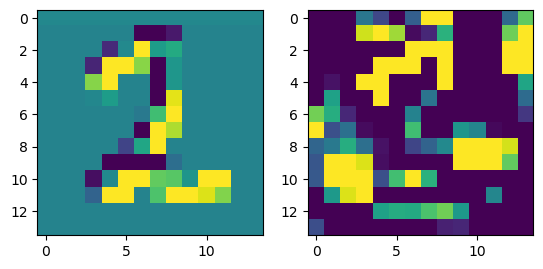

prediction: tensor([3, 2, 9]), tensor([5.8497, 4.2439, 0.9737]) groudtruth: 3
-0.0730955 0.094031364


<Figure size 640x480 with 0 Axes>

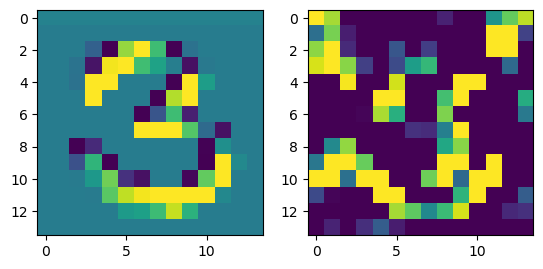

prediction: tensor([9, 0, 7]), tensor([3.5452, 2.8590, 1.4889]) groudtruth: 9
-0.102220416 0.10048519


<Figure size 640x480 with 0 Axes>

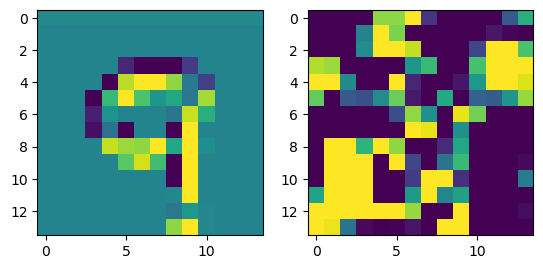

prediction: tensor([1, 4, 6]), tensor([5.0006, 1.6631, 1.0277]) groudtruth: 1
-0.060435474 0.08383313


<Figure size 640x480 with 0 Axes>

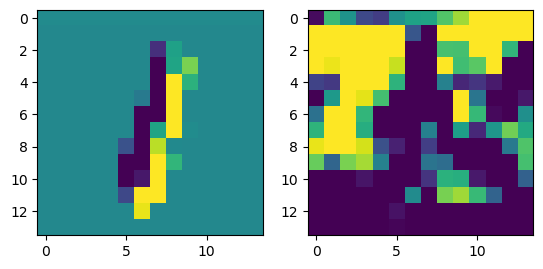

prediction: tensor([8, 2, 4]), tensor([2.5348, 2.1082, 2.0091]) groudtruth: 2
-0.060510635 0.06905661


<Figure size 640x480 with 0 Axes>

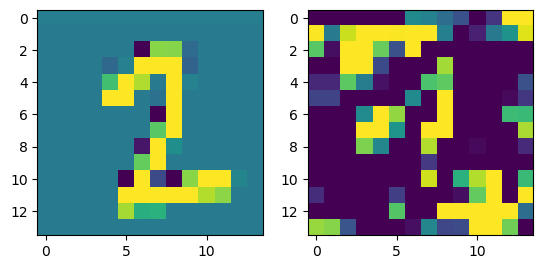

prediction: tensor([6, 0, 8]), tensor([3.8602, 2.7433, 2.3860]) groudtruth: 6
-0.08234018 0.073431835


<Figure size 640x480 with 0 Axes>

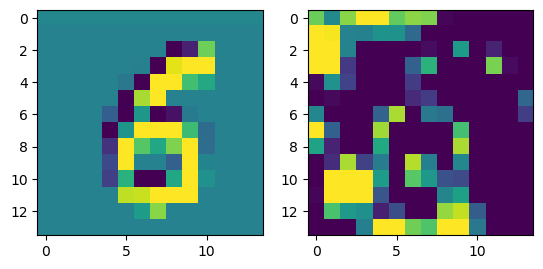

prediction: tensor([8, 9, 7]), tensor([4.0000, 2.6064, 2.0714]) groudtruth: 8
-0.08702999 0.08122834


<Figure size 640x480 with 0 Axes>

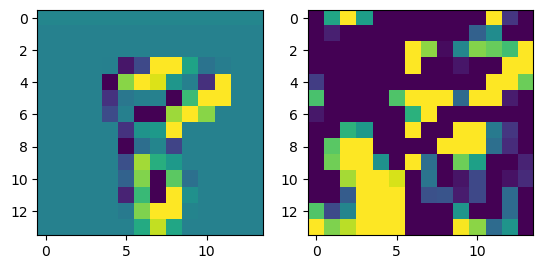

prediction: tensor([0, 8, 5]), tensor([5.1199, 1.7755, 1.1130]) groudtruth: 0
-0.07957983 0.07311321


<Figure size 640x480 with 0 Axes>

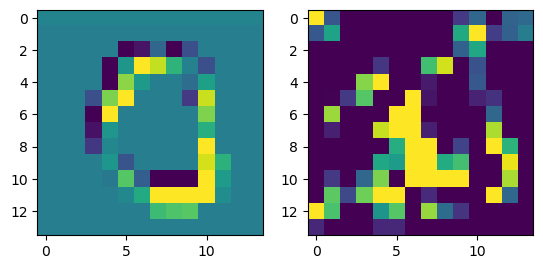

prediction: tensor([5, 7, 1]), tensor([3.0531, 2.4083, 0.7856]) groudtruth: 5
-0.10541451 0.0969246


<Figure size 640x480 with 0 Axes>

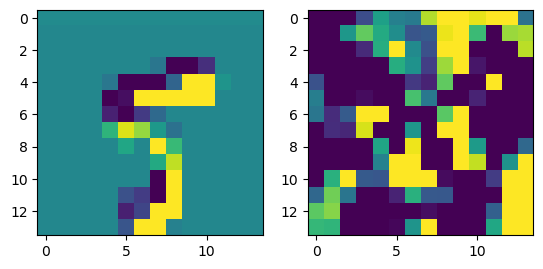

prediction: tensor([6, 4, 1]), tensor([5.0025, 2.0473, 1.2319]) groudtruth: 6
-0.08329725 0.07637428


<Figure size 640x480 with 0 Axes>

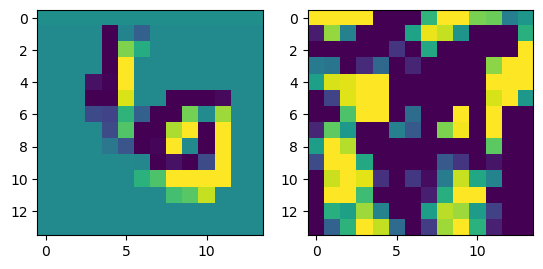

prediction: tensor([6, 5, 9]), tensor([6.5108, 1.5831, 1.0052]) groudtruth: 6
-0.065056324 0.08283757


<Figure size 640x480 with 0 Axes>

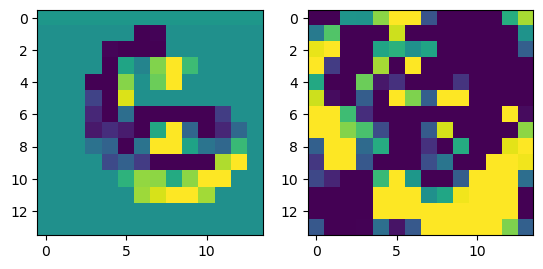

prediction: tensor([6, 7, 9]), tensor([5.2784, 1.3877, 0.5515]) groudtruth: 6
-0.09099543 0.08673373


<Figure size 640x480 with 0 Axes>

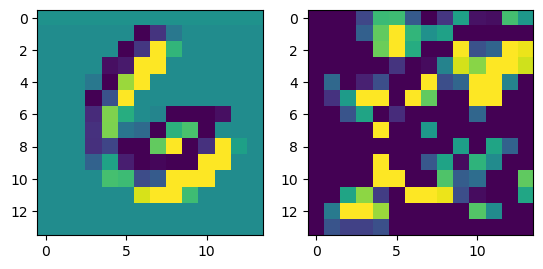

prediction: tensor([2, 0, 1]), tensor([4.6545, 2.1377, 1.1637]) groudtruth: 2
-0.08368999 0.09313522


<Figure size 640x480 with 0 Axes>

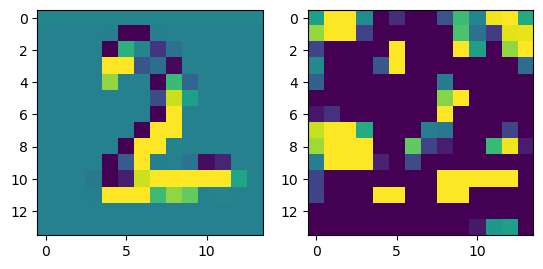

prediction: tensor([9, 4, 2]), tensor([3.0345, 2.9876, 1.7006]) groudtruth: 2
-0.08773464 0.107716225


<Figure size 640x480 with 0 Axes>

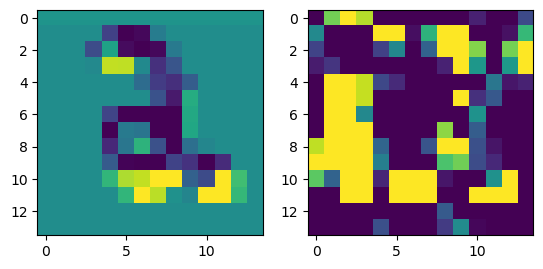

prediction: tensor([4, 1, 6]), tensor([2.6933, 2.3579, 1.3465]) groudtruth: 6
-0.088062584 0.118644714


<Figure size 640x480 with 0 Axes>

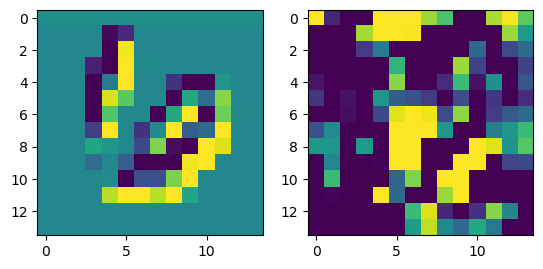

prediction: tensor([3, 8, 2]), tensor([4.0106, 1.8115, 1.4402]) groudtruth: 3
-0.09482849 0.082951315


<Figure size 640x480 with 0 Axes>

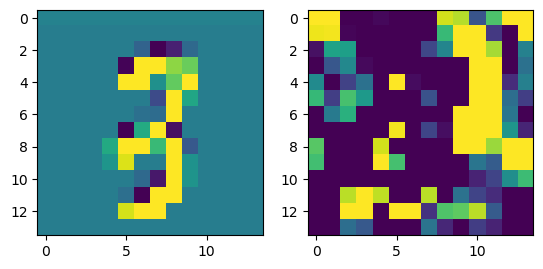

prediction: tensor([2, 3, 5]), tensor([6.2324, 4.6126, 1.2097]) groudtruth: 2
-0.08657259 0.09402149


<Figure size 640x480 with 0 Axes>

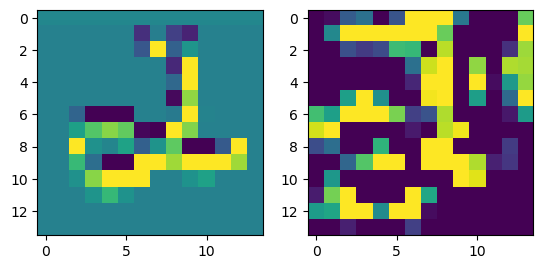

prediction: tensor([6, 4, 7]), tensor([5.0715, 0.6708, 0.4809]) groudtruth: 6
-0.0716126 0.06832667


<Figure size 640x480 with 0 Axes>

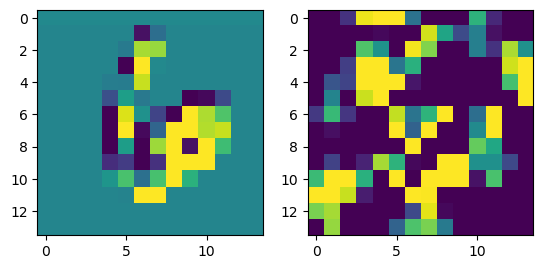

prediction: tensor([5, 8, 2]), tensor([5.4820, 2.2410, 0.1215]) groudtruth: 5
-0.06330079 0.07827279


<Figure size 640x480 with 0 Axes>

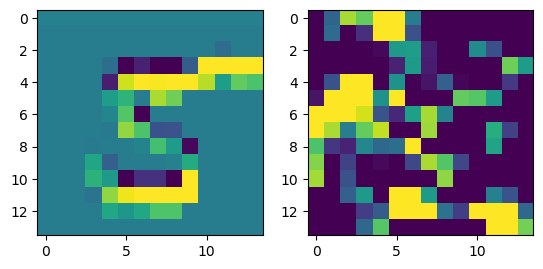

prediction: tensor([4, 9, 1]), tensor([2.6680, 2.4664, 1.7347]) groudtruth: 4
-0.07559776 0.07975289


<Figure size 640x480 with 0 Axes>

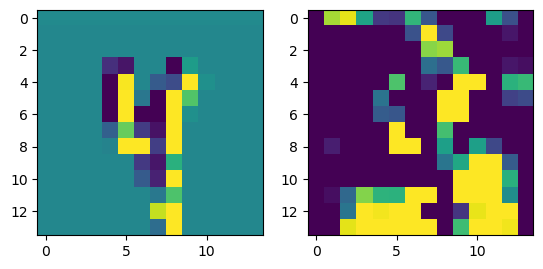

prediction: tensor([8, 2, 6]), tensor([2.5675, 2.1607, 1.5446]) groudtruth: 8
-0.10054028 0.07626758


<Figure size 640x480 with 0 Axes>

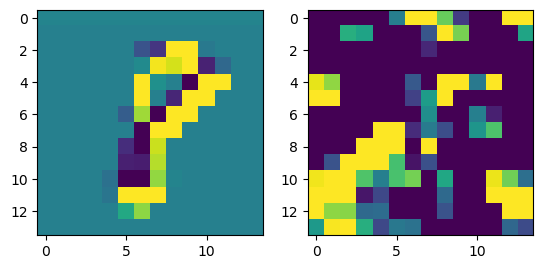

prediction: tensor([9, 3, 8]), tensor([5.1725, 2.6415, 2.0501]) groudtruth: 9
-0.08369845 0.08144213


<Figure size 640x480 with 0 Axes>

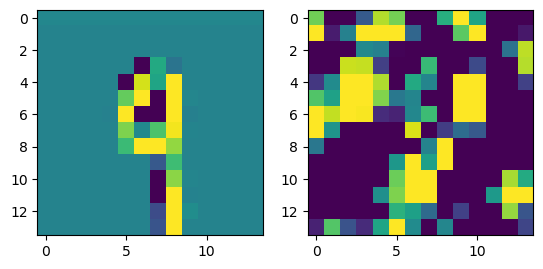

prediction: tensor([7, 2, 9]), tensor([6.6695, 1.5069, 1.4564]) groudtruth: 7
-0.06385553 0.06604017


<Figure size 640x480 with 0 Axes>

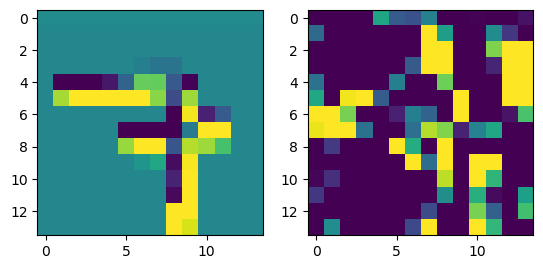

prediction: tensor([1, 3, 9]), tensor([2.8221, 1.5001, 0.6562]) groudtruth: 1
-0.07901794 0.056141913


<Figure size 640x480 with 0 Axes>

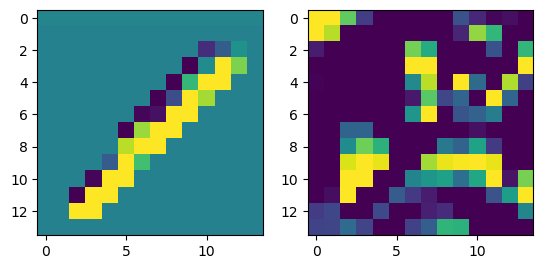

prediction: tensor([3, 4, 9]), tensor([3.5981, 1.9538, 1.8764]) groudtruth: 3
-0.090173066 0.07437257


<Figure size 640x480 with 0 Axes>

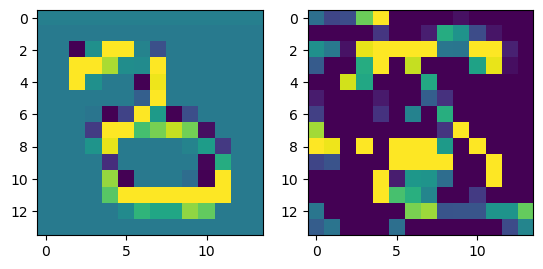

prediction: tensor([0, 7, 9]), tensor([5.8760, 2.1086, 1.2469]) groudtruth: 0
-0.07980269 0.09046866


<Figure size 640x480 with 0 Axes>

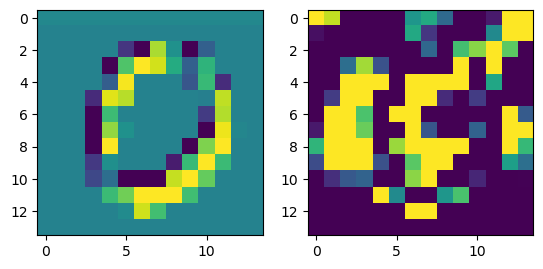

prediction: tensor([5, 3, 7]), tensor([4.7511, 3.0702, 0.7139]) groudtruth: 3
-0.079358935 0.08835457


<Figure size 640x480 with 0 Axes>

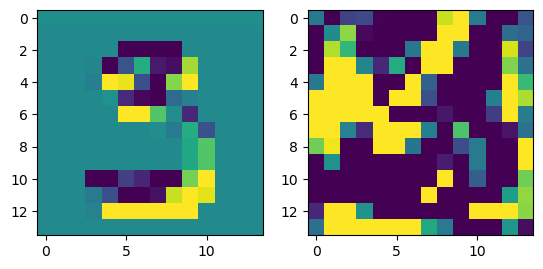

prediction: tensor([0, 8, 5]), tensor([4.2541, 3.8791, 1.8972]) groudtruth: 8
-0.07806605 0.066300616


<Figure size 640x480 with 0 Axes>

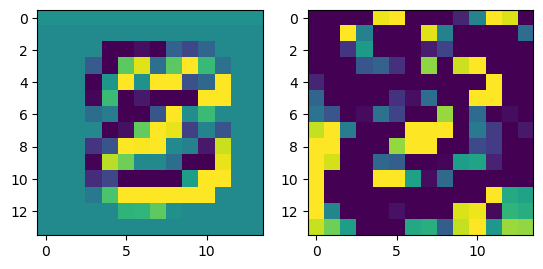

prediction: tensor([3, 4, 5]), tensor([3.9248, 2.1939, 0.6391]) groudtruth: 3
-0.070759475 0.08330702


<Figure size 640x480 with 0 Axes>

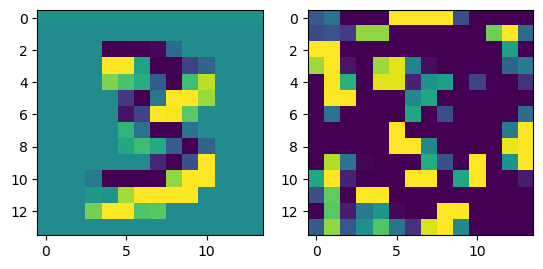

prediction: tensor([3, 2, 4]), tensor([4.6148, 2.5032, 0.9494]) groudtruth: 3
-0.08792573 0.08390039


<Figure size 640x480 with 0 Axes>

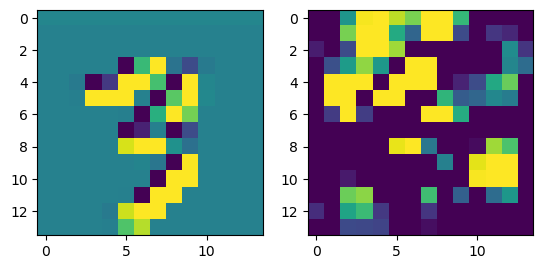

prediction: tensor([3, 8, 2]), tensor([3.6145, 1.7388, 1.5246]) groudtruth: 3
-0.10526103 0.0989171


<Figure size 640x480 with 0 Axes>

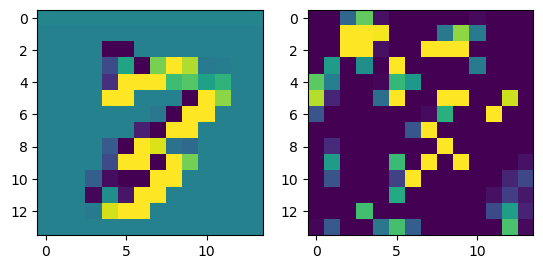

prediction: tensor([0, 7, 9]), tensor([3.5891, 2.1926, 1.8434]) groudtruth: 7
-0.04358524 0.0814109


<Figure size 640x480 with 0 Axes>

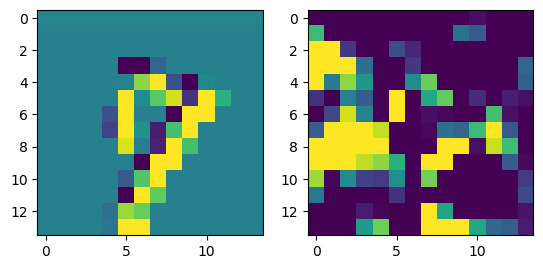

prediction: tensor([8, 3, 1]), tensor([3.9091, 3.1795, 2.9519]) groudtruth: 8
-0.080266535 0.10425288


<Figure size 640x480 with 0 Axes>

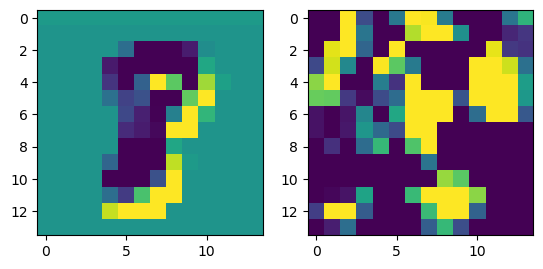

prediction: tensor([0, 9, 6]), tensor([4.7753, 1.6209, 1.2589]) groudtruth: 0
-0.074914336 0.076604724


<Figure size 640x480 with 0 Axes>

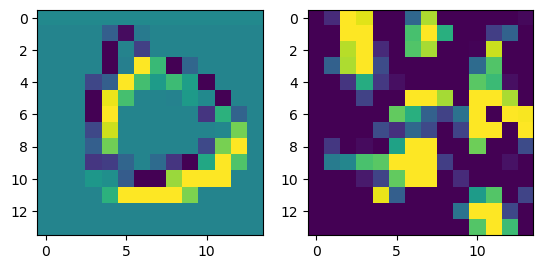

prediction: tensor([6, 2, 0]), tensor([3.0336, 2.5804, 2.1422]) groudtruth: 8
-0.08943111 0.080584705


<Figure size 640x480 with 0 Axes>

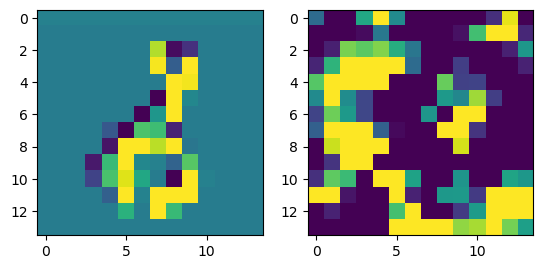

prediction: tensor([8, 2, 4]), tensor([2.6362, 2.4240, 2.3654]) groudtruth: 2
-0.055333912 0.10148152


<Figure size 640x480 with 0 Axes>

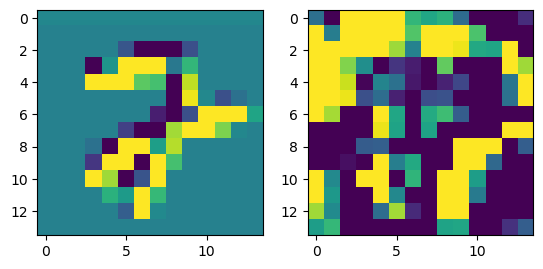

prediction: tensor([1, 2, 9]), tensor([3.1020, 0.8235, 0.5319]) groudtruth: 1
-0.07236904 0.08870211


<Figure size 640x480 with 0 Axes>

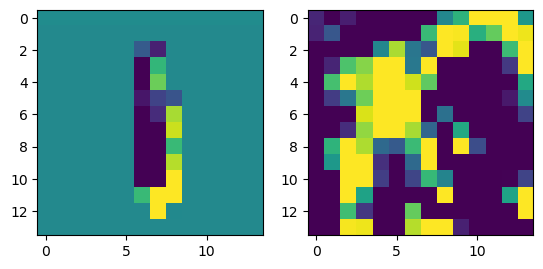

prediction: tensor([7, 2, 9]), tensor([5.5321, 1.0623, 0.7673]) groudtruth: 7
-0.066233635 0.13380362


<Figure size 640x480 with 0 Axes>

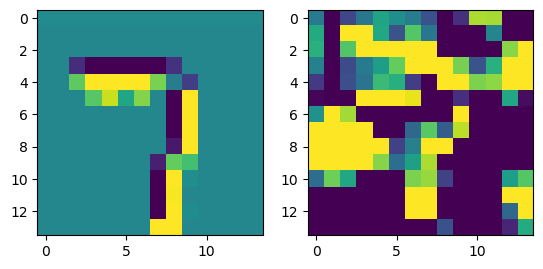

prediction: tensor([0, 3, 7]), tensor([4.2894, 0.6818, 0.3668]) groudtruth: 0
-0.09908515 0.07701894


<Figure size 640x480 with 0 Axes>

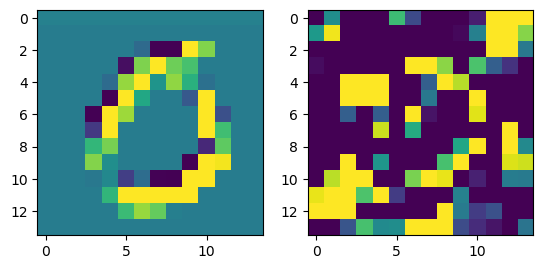

prediction: tensor([6, 1, 9]), tensor([4.4548, 2.2415, 1.0539]) groudtruth: 6
-0.10084236 0.049616124


<Figure size 640x480 with 0 Axes>

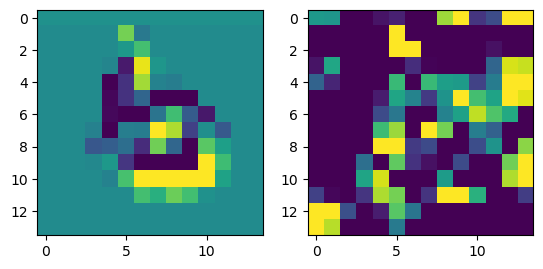

prediction: tensor([5, 6, 3]), tensor([4.8985, 2.5283, 2.1143]) groudtruth: 5
-0.082993746 0.064743154


<Figure size 640x480 with 0 Axes>

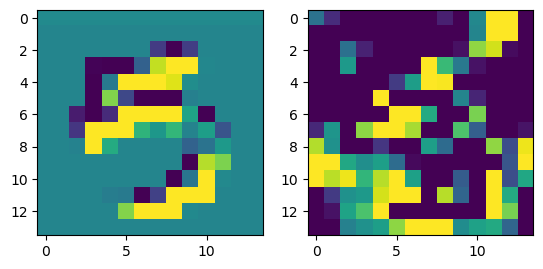

prediction: tensor([4, 8, 9]), tensor([6.6621, 1.7280, 1.4475]) groudtruth: 4
-0.06383687 0.103153855


<Figure size 640x480 with 0 Axes>

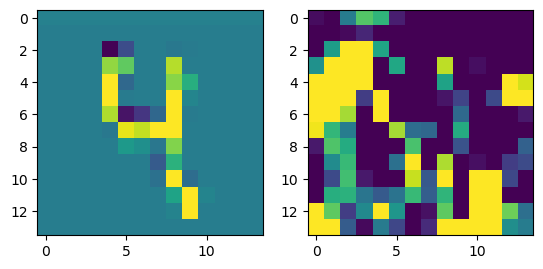

prediction: tensor([3, 8, 9]), tensor([3.4188, 2.7923, 2.1724]) groudtruth: 3
-0.07312608 0.0838856


<Figure size 640x480 with 0 Axes>

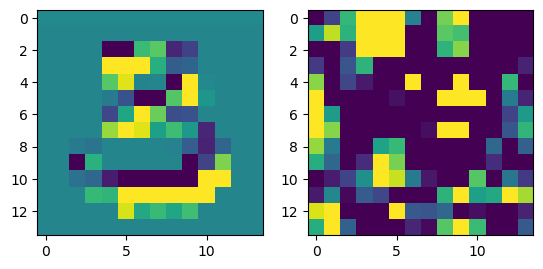

prediction: tensor([0, 3, 7]), tensor([2.2491, 1.4791, 0.5211]) groudtruth: 8
-0.10088295 0.09165212


<Figure size 640x480 with 0 Axes>

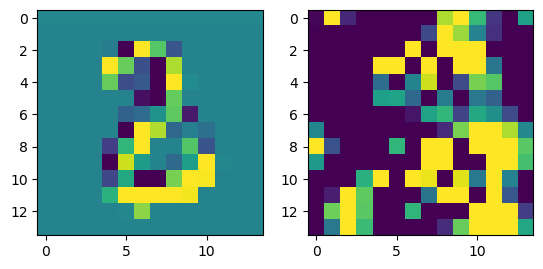

prediction: tensor([1, 3, 4]), tensor([4.7802, 1.8582, 1.8342]) groudtruth: 1
-0.08369815 0.122840226


<Figure size 640x480 with 0 Axes>

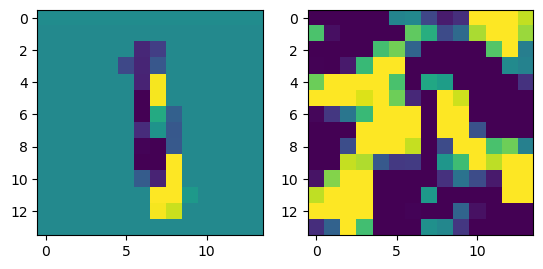

prediction: tensor([3, 8, 0]), tensor([3.3552, 1.6888, 1.0226]) groudtruth: 8
-0.07585698 0.08276902


<Figure size 640x480 with 0 Axes>

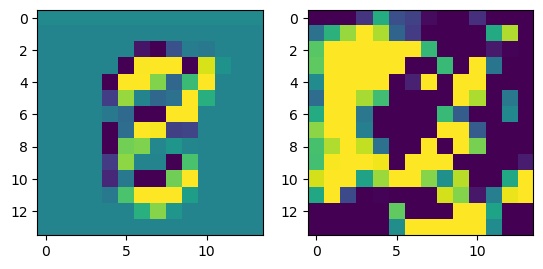

prediction: tensor([0, 3, 5]), tensor([4.2162, 1.4199, 0.7408]) groudtruth: 0
-0.097952306 0.08694097


<Figure size 640x480 with 0 Axes>

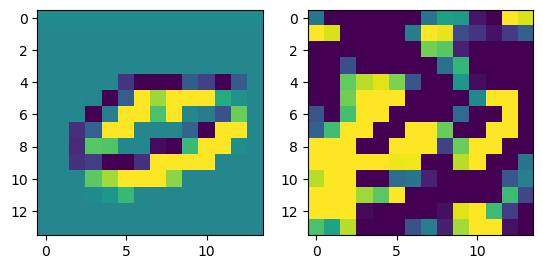

prediction: tensor([2, 7, 9]), tensor([5.8013, 2.0857, 1.3864]) groudtruth: 2
-0.0713492 0.08373579


<Figure size 640x480 with 0 Axes>

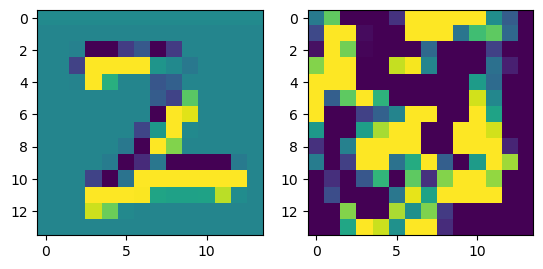

prediction: tensor([0, 8, 6]), tensor([4.0233, 3.5870, 1.6214]) groudtruth: 0
-0.071434736 0.09835553


<Figure size 640x480 with 0 Axes>

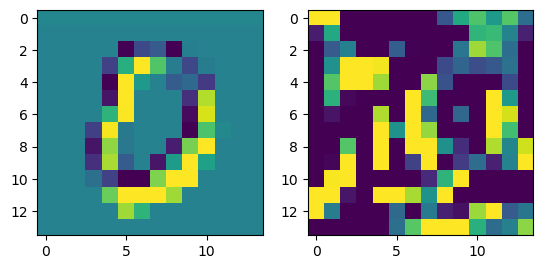

prediction: tensor([2, 1, 6]), tensor([1.4880, 0.6980, 0.6625]) groudtruth: 5
-0.08094156 0.06735644


<Figure size 640x480 with 0 Axes>

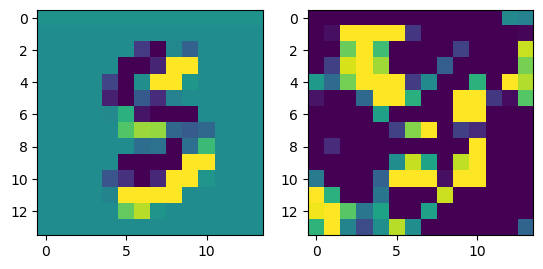

prediction: tensor([6, 2, 3]), tensor([3.6957, 2.9600, 2.3692]) groudtruth: 2
-0.09520292 0.07945329


<Figure size 640x480 with 0 Axes>

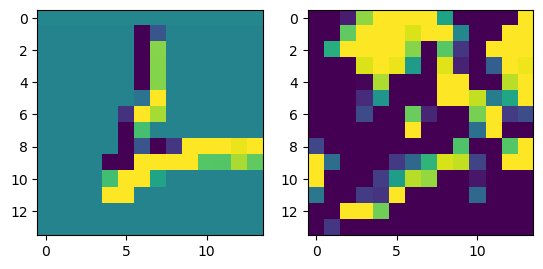

prediction: tensor([1, 3, 2]), tensor([5.7735, 1.0864, 0.7435]) groudtruth: 1
-0.08024889 0.088009685


<Figure size 640x480 with 0 Axes>

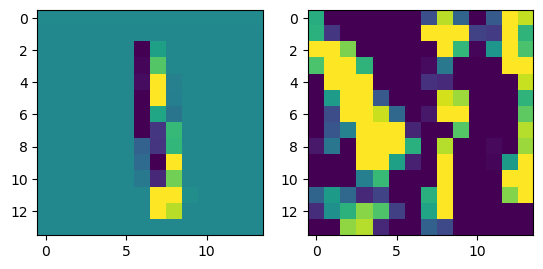

prediction: tensor([3, 4, 8]), tensor([5.4821, 1.0898, 0.6447]) groudtruth: 3
-0.06225431 0.113421194


<Figure size 640x480 with 0 Axes>

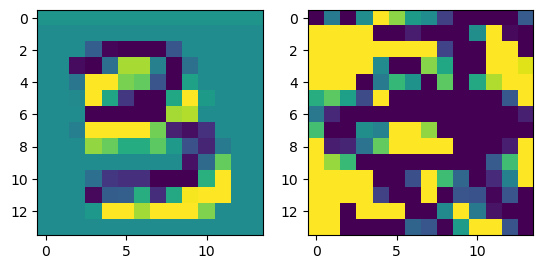

prediction: tensor([7, 1, 2]), tensor([4.8331, 2.0312, 0.8049]) groudtruth: 7
-0.0903092 0.069532216


<Figure size 640x480 with 0 Axes>

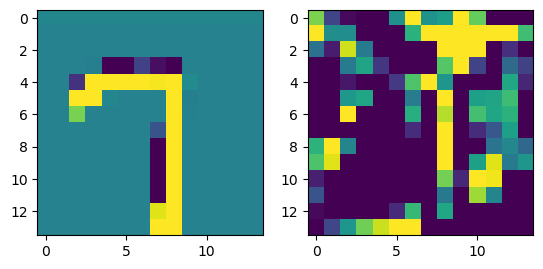

prediction: tensor([6, 0, 7]), tensor([4.5370, 1.8053, 1.6742]) groudtruth: 6
-0.07499933 0.081140555


<Figure size 640x480 with 0 Axes>

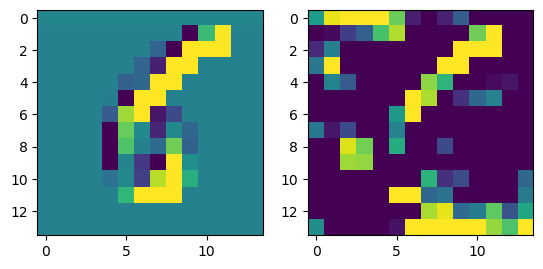

prediction: tensor([7, 2, 9]), tensor([4.8460, 0.5750, 0.4873]) groudtruth: 7
-0.08443308 0.06801098


<Figure size 640x480 with 0 Axes>

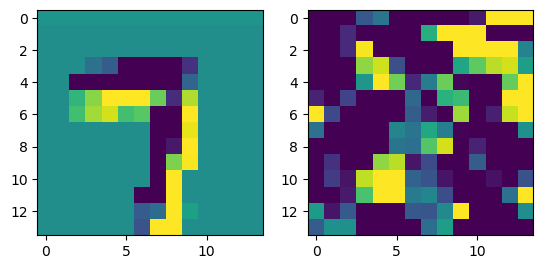

prediction: tensor([1, 9, 7]), tensor([4.3177, 1.3518, 1.3445]) groudtruth: 1
-0.06883919 0.055932738


<Figure size 640x480 with 0 Axes>

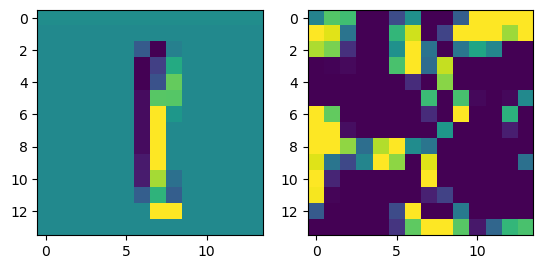

prediction: tensor([2, 9, 3]), tensor([4.4802, 1.6632, 1.4333]) groudtruth: 2
-0.08300674 0.11679749


<Figure size 640x480 with 0 Axes>

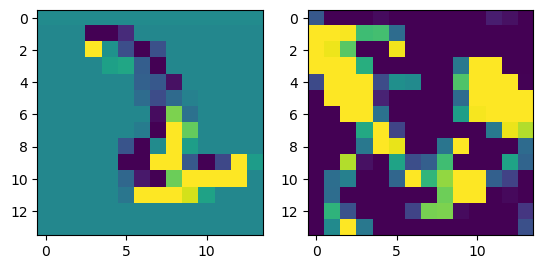

prediction: tensor([8, 5, 3]), tensor([2.2344, 2.2142, 1.5612]) groudtruth: 5
-0.0851174 0.09034543


<Figure size 640x480 with 0 Axes>

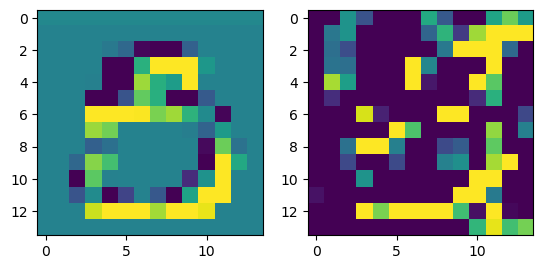

prediction: tensor([3, 8, 2]), tensor([4.1904, 4.0910, 0.7731]) groudtruth: 8
-0.07826495 0.07307315


<Figure size 640x480 with 0 Axes>

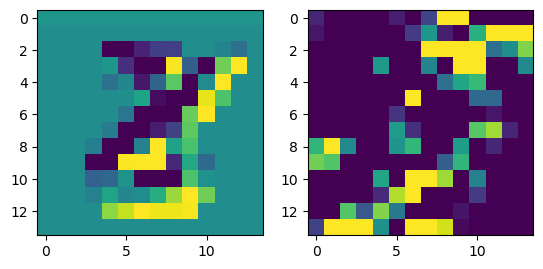

prediction: tensor([0, 6, 2]), tensor([5.6499, 1.7335, 1.3576]) groudtruth: 0
-0.06840098 0.10217066


<Figure size 640x480 with 0 Axes>

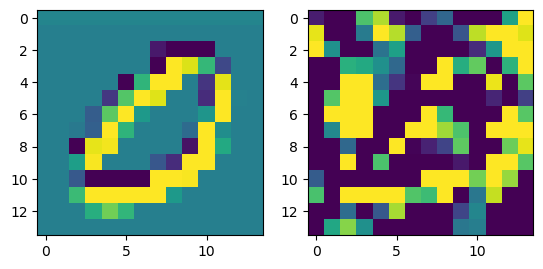

prediction: tensor([7, 9, 4]), tensor([5.2116, 1.8455, 0.4797]) groudtruth: 7
-0.07639974 0.09197473


<Figure size 640x480 with 0 Axes>

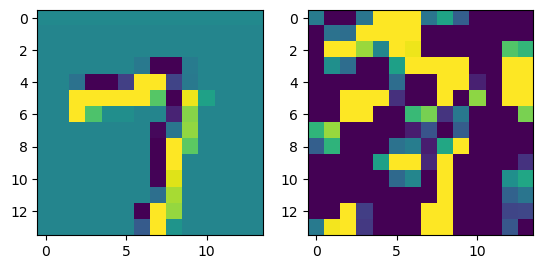

prediction: tensor([9, 7, 8]), tensor([5.5734, 2.5649, 0.4075]) groudtruth: 9
-0.07187611 0.09483136


<Figure size 640x480 with 0 Axes>

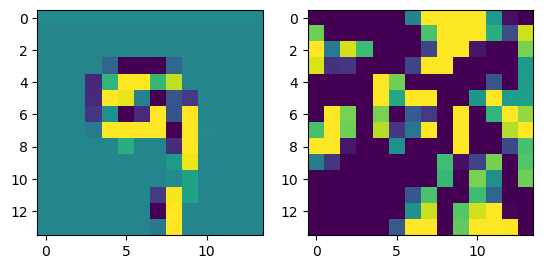

prediction: tensor([4, 9, 7]), tensor([3.0200, 2.4296, 0.9118]) groudtruth: 4
-0.08585143 0.08841612


<Figure size 640x480 with 0 Axes>

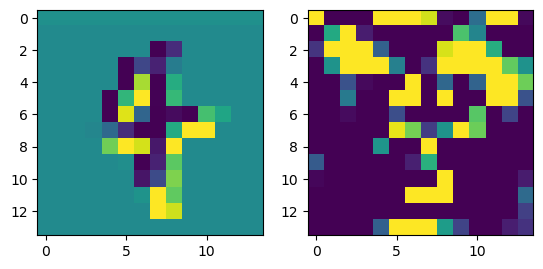

prediction: tensor([4, 7, 9]), tensor([4.9028, 1.2637, 0.8116]) groudtruth: 4
-0.06739801 0.09429044


<Figure size 640x480 with 0 Axes>

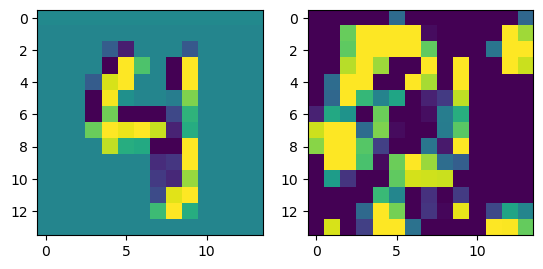

prediction: tensor([8, 1, 2]), tensor([4.7900, 1.3630, 0.9799]) groudtruth: 8
-0.11649907 0.11329818


<Figure size 640x480 with 0 Axes>

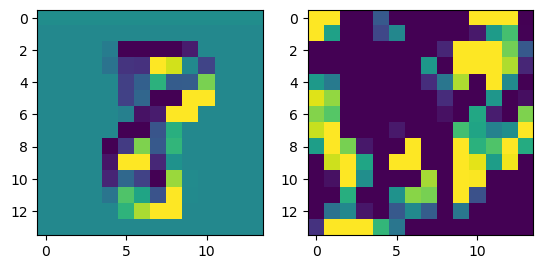

prediction: tensor([5, 8, 3]), tensor([5.2291, 2.5937, 0.5685]) groudtruth: 5
-0.076848686 0.058791485


<Figure size 640x480 with 0 Axes>

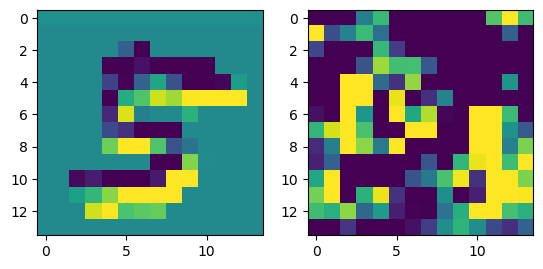

prediction: tensor([5, 3, 6]), tensor([5.8935, 1.9918, 0.2507]) groudtruth: 5
-0.08015472 0.08477769


<Figure size 640x480 with 0 Axes>

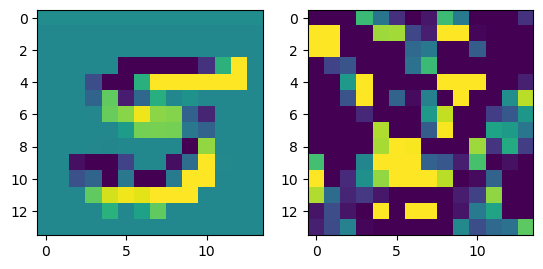

prediction: tensor([4, 9, 7]), tensor([3.6537, 2.7755, 2.5892]) groudtruth: 4
-0.07176781 0.10514934


<Figure size 640x480 with 0 Axes>

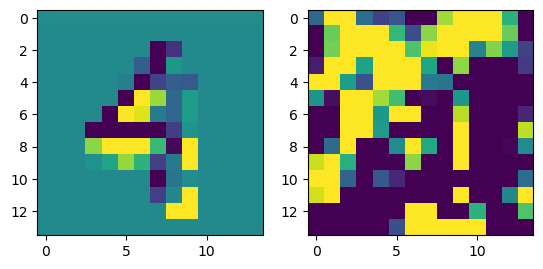

prediction: tensor([0, 2, 3]), tensor([4.9030, 1.6435, 0.9312]) groudtruth: 0
-0.07827121 0.09338496


<Figure size 640x480 with 0 Axes>

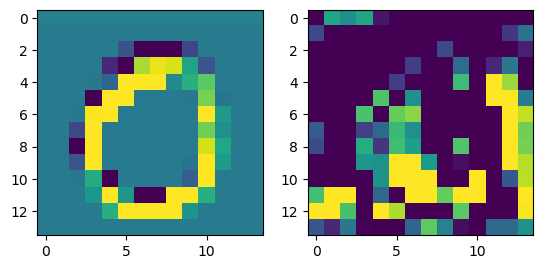

prediction: tensor([7, 4, 8]), tensor([2.1397, 1.7559, 1.0906]) groudtruth: 8
-0.09488374 0.08850436


<Figure size 640x480 with 0 Axes>

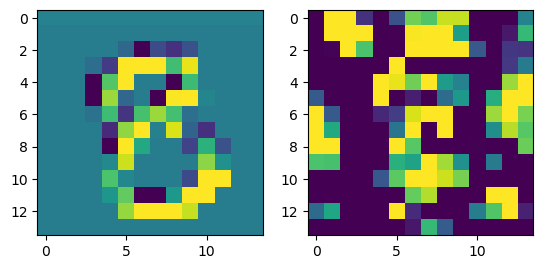

prediction: tensor([2, 3, 9]), tensor([4.6094, 2.5970, 0.6192]) groudtruth: 2
-0.14508325 0.1132966


<Figure size 640x480 with 0 Axes>

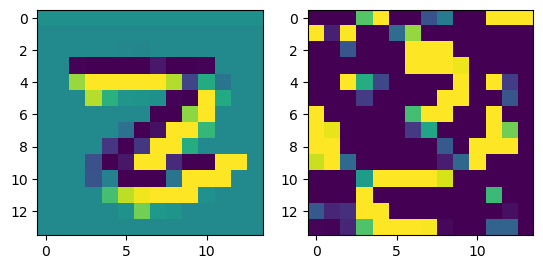

prediction: tensor([1, 8, 9]), tensor([4.2675, 2.6646, 1.5918]) groudtruth: 1
-0.08336252 0.09644949


<Figure size 640x480 with 0 Axes>

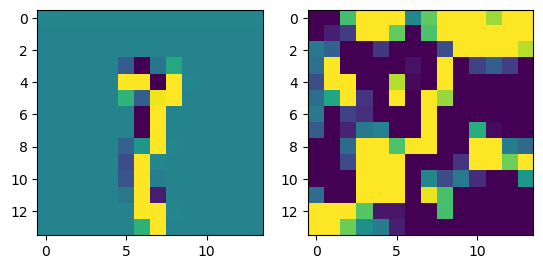

prediction: tensor([5, 7, 9]), tensor([2.8903, 1.7452, 0.5330]) groudtruth: 0
-0.052773178 0.08452697


<Figure size 640x480 with 0 Axes>

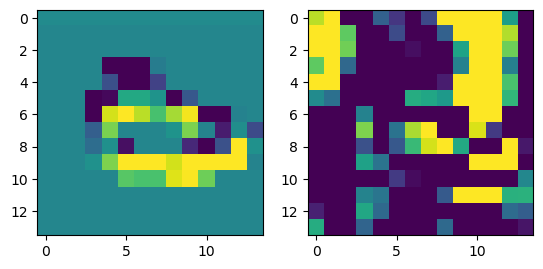

prediction: tensor([8, 1, 2]), tensor([5.1413, 1.6385, 1.1921]) groudtruth: 8
-0.054193556 0.059702355


<Figure size 640x480 with 0 Axes>

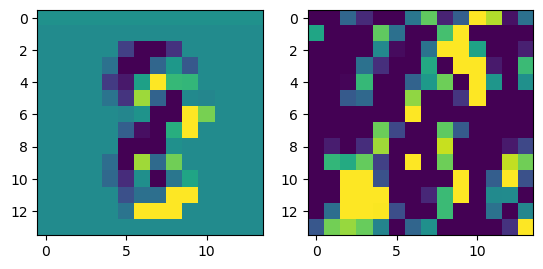

prediction: tensor([4, 6, 1]), tensor([6.4299, 1.2363, 0.0086]) groudtruth: 4
-0.09922379 0.09143022


<Figure size 640x480 with 0 Axes>

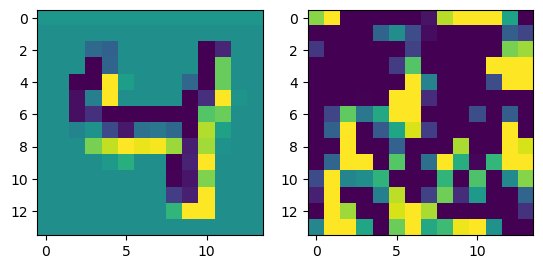

prediction: tensor([1, 7, 6]), tensor([4.2697, 1.0341, 0.5450]) groudtruth: 1
-0.054969013 0.070146956


<Figure size 640x480 with 0 Axes>

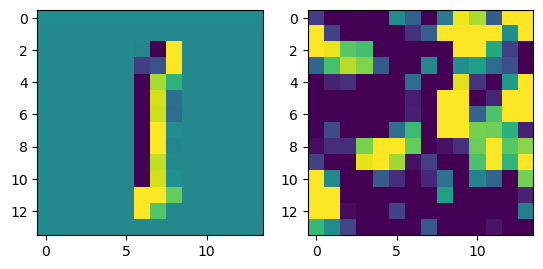

prediction: tensor([6, 8, 7]), tensor([4.3370, 2.3076, 1.5210]) groudtruth: 6
-0.07127869 0.09910093


<Figure size 640x480 with 0 Axes>

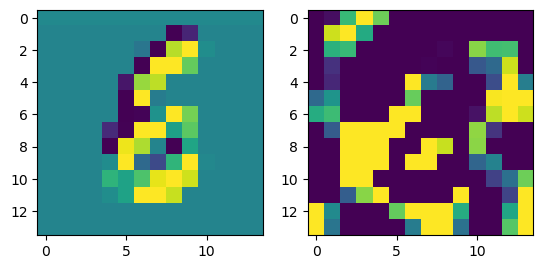

prediction: tensor([2, 4, 6]), tensor([4.2131, 2.9897, 2.2024]) groudtruth: 4
-0.06809437 0.0783474


<Figure size 640x480 with 0 Axes>

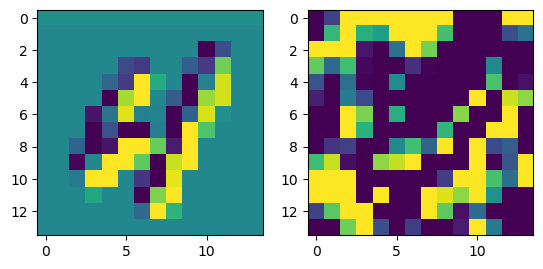

prediction: tensor([7, 9, 0]), tensor([3.0131, 2.1792, 0.8520]) groudtruth: 7
-0.07606238 0.07082565


<Figure size 640x480 with 0 Axes>

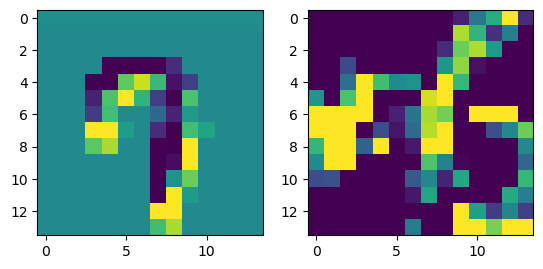

prediction: tensor([1, 5, 9]), tensor([5.0548, 1.3011, 0.4904]) groudtruth: 1
-0.10291618 0.101194665


<Figure size 640x480 with 0 Axes>

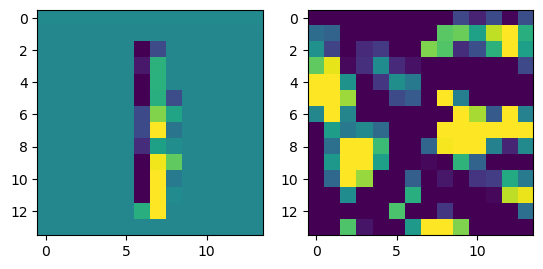

prediction: tensor([9, 3, 8]), tensor([4.6706, 1.2970, 0.4175]) groudtruth: 9
-0.08344972 0.10027924


<Figure size 640x480 with 0 Axes>

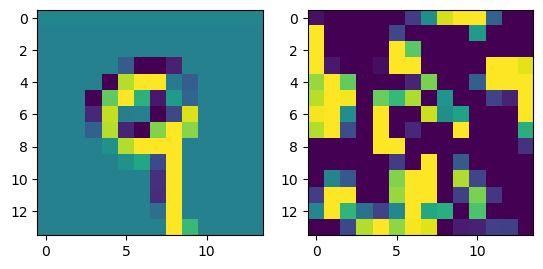

prediction: tensor([4, 3, 5]), tensor([2.6170, 1.5390, 0.9837]) groudtruth: 4
-0.07123405 0.072489545


<Figure size 640x480 with 0 Axes>

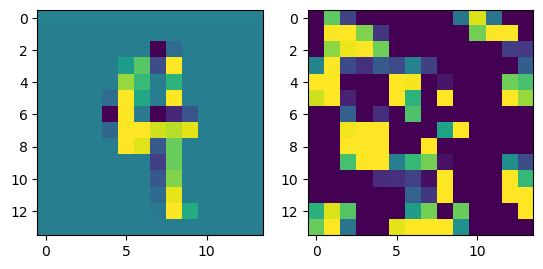

prediction: tensor([2, 7, 9]), tensor([3.4192, 2.0983, 0.7578]) groudtruth: 2
-0.074082315 0.12955984


<Figure size 640x480 with 0 Axes>

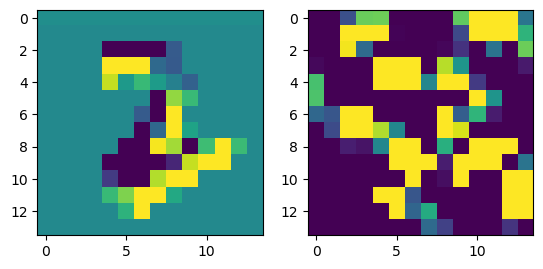

prediction: tensor([4, 6, 8]), tensor([3.7652, 2.4079, 0.5698]) groudtruth: 4
-0.086853564 0.08742373


<Figure size 640x480 with 0 Axes>

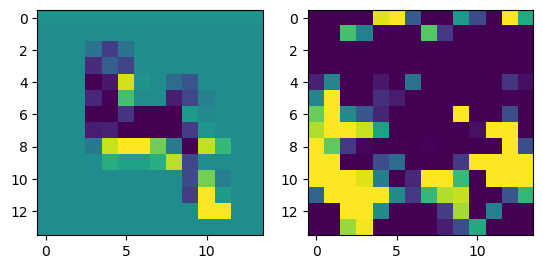

prediction: tensor([1, 9, 8]), tensor([7.0611, 1.7193, 0.9977]) groudtruth: 1
-0.07766068 0.089819625


<Figure size 640x480 with 0 Axes>

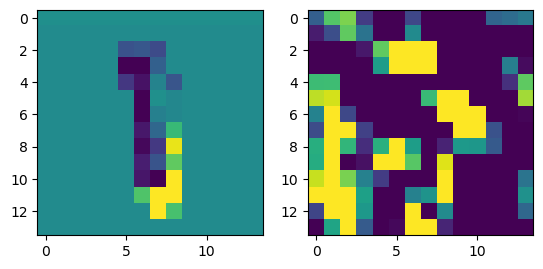

prediction: tensor([5, 2, 6]), tensor([3.7834, 3.0708, 1.4438]) groudtruth: 5
-0.09184623 0.1165912


<Figure size 640x480 with 0 Axes>

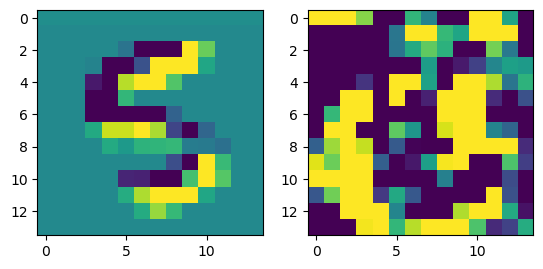

prediction: tensor([5, 9, 6]), tensor([4.7051, 3.3954, 2.5273]) groudtruth: 5
-0.095522225 0.10966501


<Figure size 640x480 with 0 Axes>

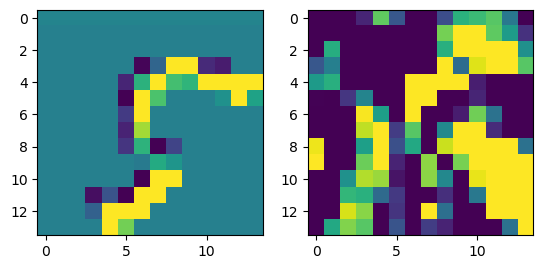

prediction: tensor([5, 4, 3]), tensor([3.5151, 3.1424, 3.0831]) groudtruth: 3
-0.075697005 0.07048524


<Figure size 640x480 with 0 Axes>

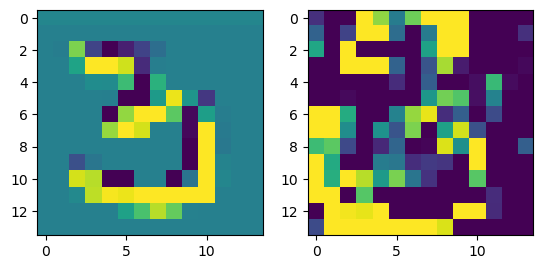

prediction: tensor([3, 8, 2]), tensor([3.7362, 2.9625, 0.8759]) groudtruth: 8
-0.13054854 0.14207289


<Figure size 640x480 with 0 Axes>

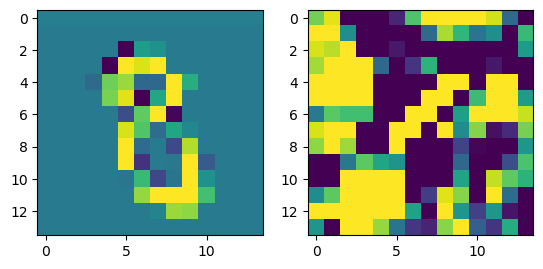

prediction: tensor([3, 5, 9]), tensor([3.6965, 1.6889, 1.1862]) groudtruth: 3
-0.09524208 0.09214064


<Figure size 640x480 with 0 Axes>

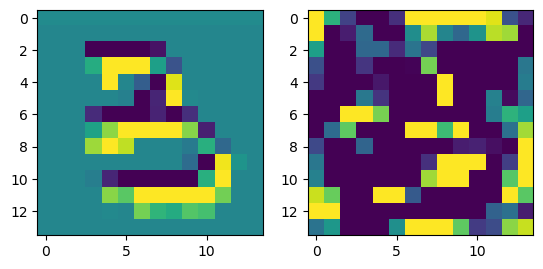

prediction: tensor([1, 6, 8]), tensor([5.5608, 1.1245, 0.4382]) groudtruth: 1
-0.0660941 0.087999046


<Figure size 640x480 with 0 Axes>

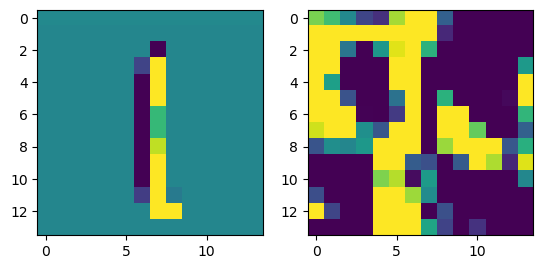

prediction: tensor([7, 8, 9]), tensor([3.5641, 1.4270, 1.1421]) groudtruth: 7
-0.08228278 0.098934636


<Figure size 640x480 with 0 Axes>

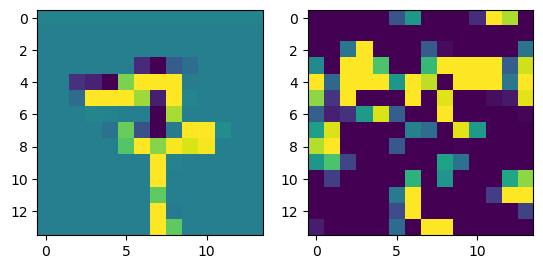

prediction: tensor([9, 4, 7]), tensor([4.1933, 2.7082, 1.8061]) groudtruth: 9
-0.08757806 0.10035705


<Figure size 640x480 with 0 Axes>

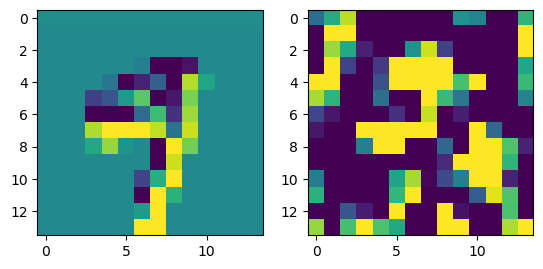

prediction: tensor([6, 1, 5]), tensor([4.9906, 3.2884, 0.8221]) groudtruth: 6
-0.11045444 0.07990065


<Figure size 640x480 with 0 Axes>

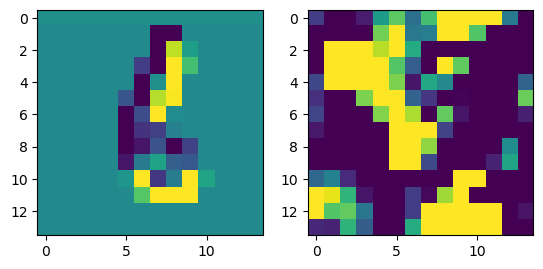

prediction: tensor([1, 7, 4]), tensor([5.5967, 2.4780, 1.1060]) groudtruth: 1
-0.1400634 0.12785447


<Figure size 640x480 with 0 Axes>

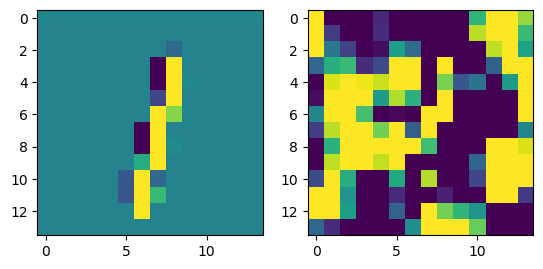

prediction: tensor([1, 0, 7]), tensor([ 5.7687,  2.3365, -0.1175]) groudtruth: 1
-0.09602338 0.110820234


<Figure size 640x480 with 0 Axes>

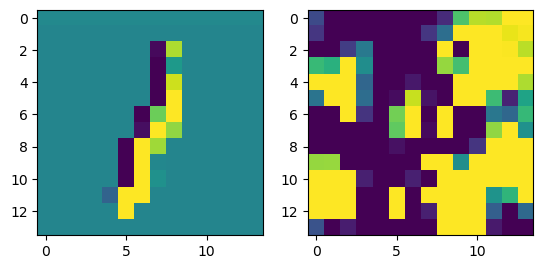

prediction: tensor([2, 4, 8]), tensor([4.9929, 2.5759, 1.1417]) groudtruth: 2
-0.07183987 0.10690659


<Figure size 640x480 with 0 Axes>

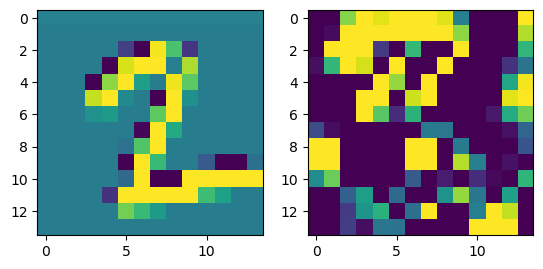

prediction: tensor([4, 8, 2]), tensor([5.9105, 1.7992, 1.3900]) groudtruth: 4
-0.081783175 0.08915533


<Figure size 640x480 with 0 Axes>

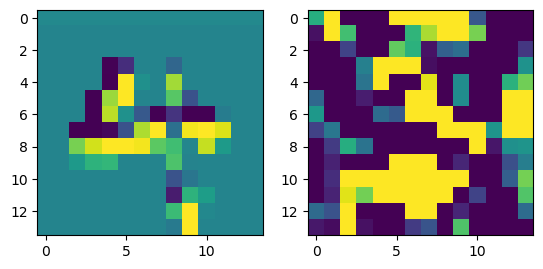

prediction: tensor([3, 8, 1]), tensor([2.8030, 1.7943, 1.6220]) groudtruth: 8
-0.088159084 0.10549264


<Figure size 640x480 with 0 Axes>

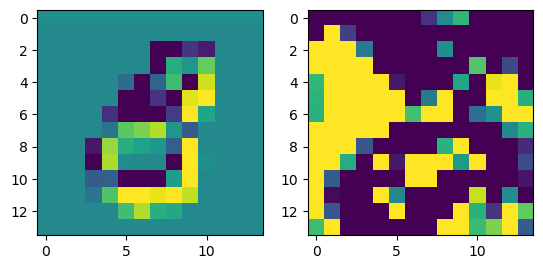

prediction: tensor([1, 6, 9]), tensor([2.2268, 1.7972, 1.2743]) groudtruth: 1
-0.11151892 0.11357874


<Figure size 640x480 with 0 Axes>

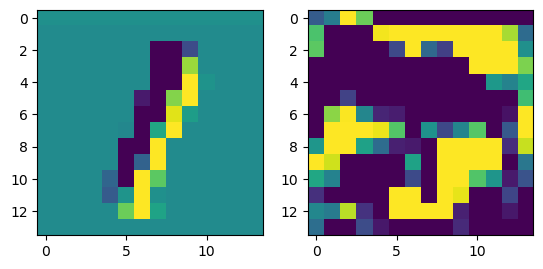

prediction: tensor([7, 9, 4]), tensor([5.0386, 1.6660, 1.0412]) groudtruth: 7
-0.0818398 0.078735866


<Figure size 640x480 with 0 Axes>

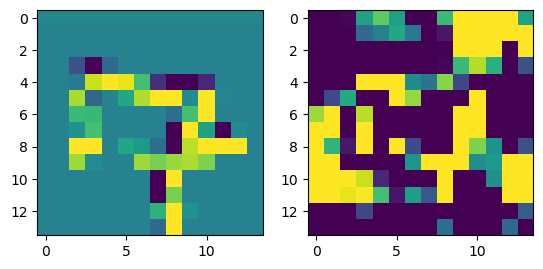

prediction: tensor([9, 2, 7]), tensor([1.9926, 1.9171, 0.9863]) groudtruth: 7
-0.07320213 0.0734157


<Figure size 640x480 with 0 Axes>

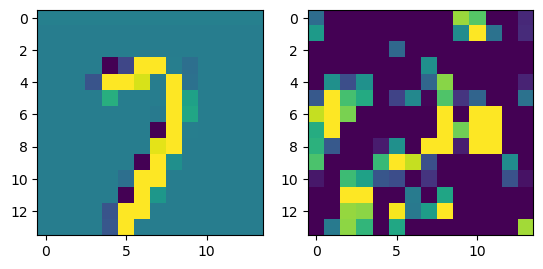

prediction: tensor([4, 6, 1]), tensor([3.4543, 2.8170, 0.1196]) groudtruth: 4
-0.08070636 0.1286648


<Figure size 640x480 with 0 Axes>

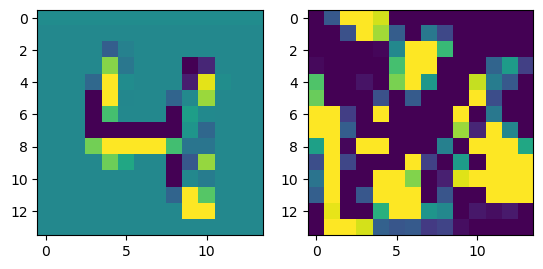

prediction: tensor([6, 8, 5]), tensor([3.0260, 2.7143, 1.3809]) groudtruth: 8
-0.08083171 0.085568935


<Figure size 640x480 with 0 Axes>

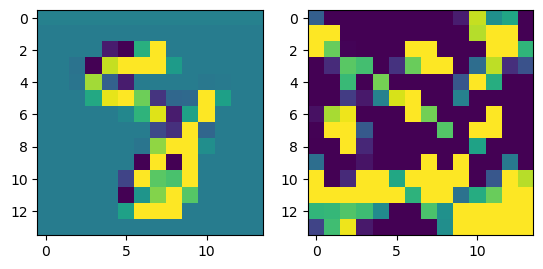

prediction: tensor([0, 7, 8]), tensor([7.1668, 1.0493, 0.3321]) groudtruth: 0
-0.0826053 0.12536943


<Figure size 640x480 with 0 Axes>

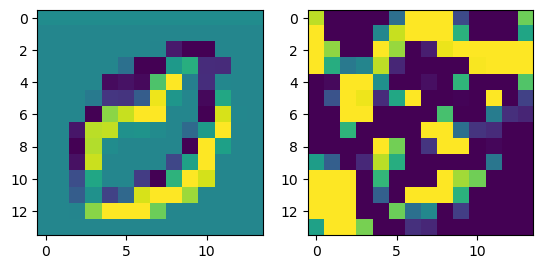

prediction: tensor([0, 7, 9]), tensor([2.8556, 1.5023, 1.4002]) groudtruth: 7
-0.06883353 0.098338075


<Figure size 640x480 with 0 Axes>

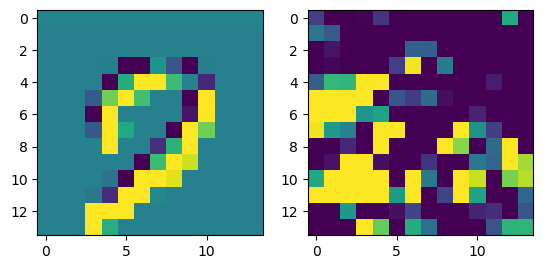

prediction: tensor([3, 5, 2]), tensor([3.3994, 1.7456, 1.4358]) groudtruth: 3
-0.083526075 0.11075886


<Figure size 640x480 with 0 Axes>

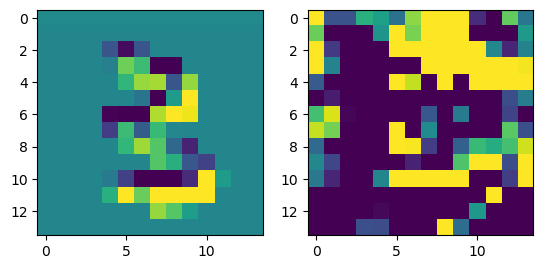

prediction: tensor([0, 2, 6]), tensor([4.2415, 2.8743, 1.6388]) groudtruth: 0
-0.08507848 0.082229406


<Figure size 640x480 with 0 Axes>

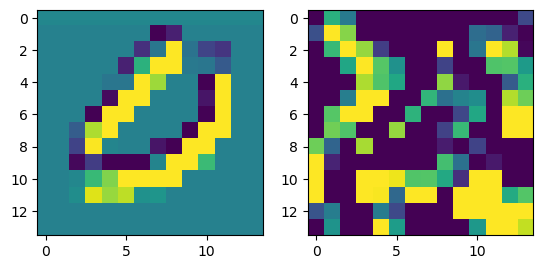

prediction: tensor([5, 8, 3]), tensor([6.6413, 1.7960, 0.3047]) groudtruth: 5
-0.09072727 0.08213553


<Figure size 640x480 with 0 Axes>

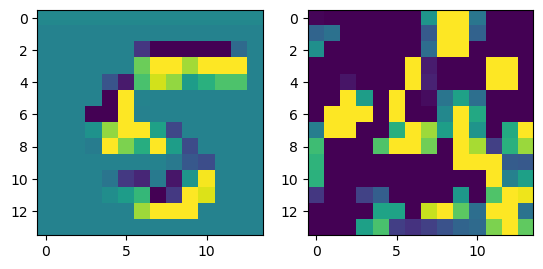

prediction: tensor([6, 8, 1]), tensor([1.2863, 1.2834, 1.0501]) groudtruth: 7
-0.07202846 0.07078342


<Figure size 640x480 with 0 Axes>

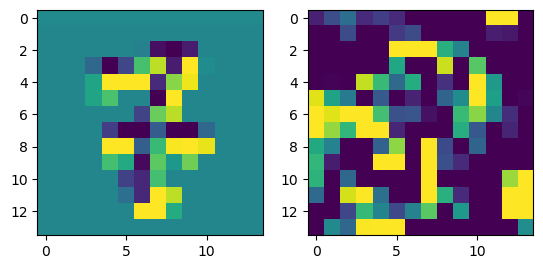

prediction: tensor([8, 3, 5]), tensor([6.7159, 0.6449, 0.4562]) groudtruth: 8
-0.09449756 0.061555993


<Figure size 640x480 with 0 Axes>

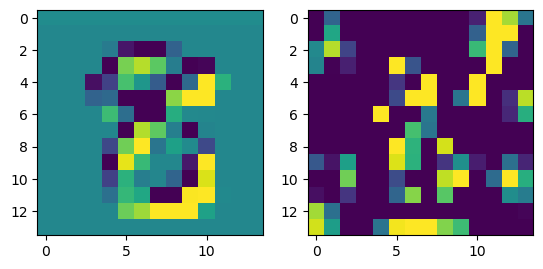

prediction: tensor([0, 1, 3]), tensor([2.3042, 1.5050, 0.9356]) groudtruth: 1
-0.074043214 0.10074466


<Figure size 640x480 with 0 Axes>

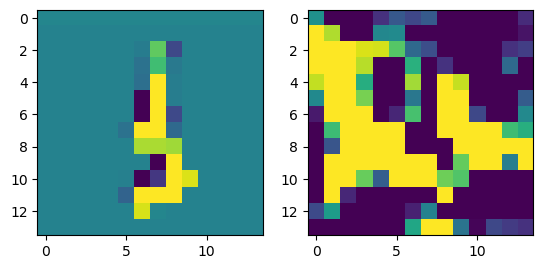

prediction: tensor([1, 4, 8]), tensor([3.0427, 2.8517, 1.5852]) groudtruth: 4
-0.09884441 0.09287203


<Figure size 640x480 with 0 Axes>

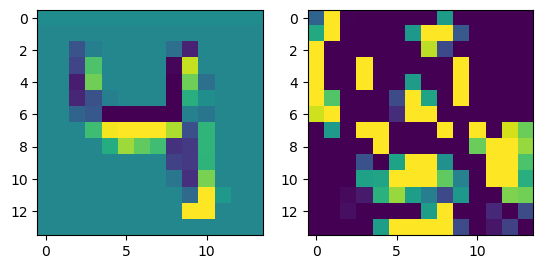

prediction: tensor([4, 3, 7]), tensor([4.3048, 0.9132, 0.9018]) groudtruth: 4
-0.10743815 0.097078286


<Figure size 640x480 with 0 Axes>

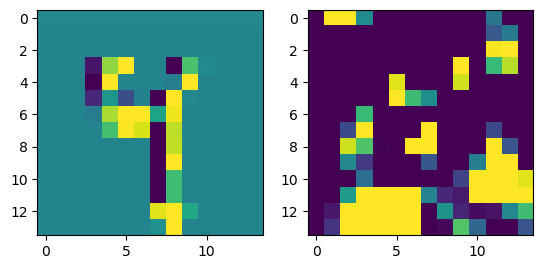

prediction: tensor([6, 9, 8]), tensor([2.8823, 2.3891, 1.8707]) groudtruth: 6
-0.08348411 0.0734953


<Figure size 640x480 with 0 Axes>

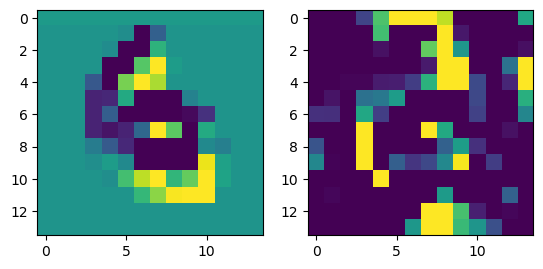

prediction: tensor([0, 8, 9]), tensor([3.9028, 2.8776, 1.7315]) groudtruth: 0
-0.07996088 0.084199905


<Figure size 640x480 with 0 Axes>

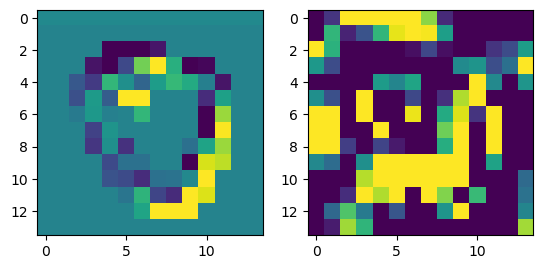

prediction: tensor([9, 2, 4]), tensor([3.3826, 3.2028, 1.0747]) groudtruth: 2
-0.086532354 0.09186992


<Figure size 640x480 with 0 Axes>

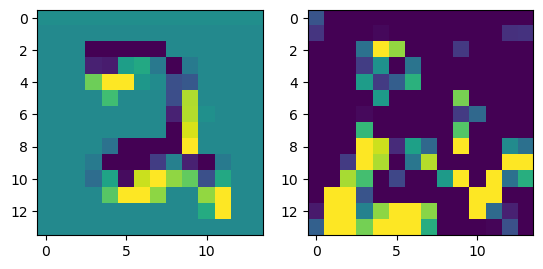

prediction: tensor([9, 7, 3]), tensor([2.5893, 1.3984, 0.4301]) groudtruth: 9
-0.06655961 0.11436832


<Figure size 640x480 with 0 Axes>

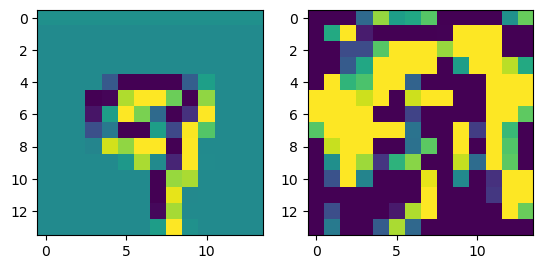

prediction: tensor([1, 5, 7]), tensor([5.5152, 1.3898, 0.3750]) groudtruth: 1
-0.06253505 0.07190206


<Figure size 640x480 with 0 Axes>

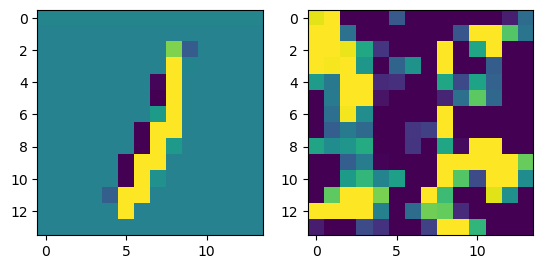

prediction: tensor([5, 4, 9]), tensor([3.3873, 3.1408, 1.4427]) groudtruth: 4
-0.09545761 0.1000457


<Figure size 640x480 with 0 Axes>

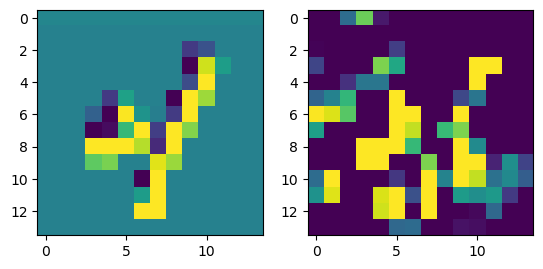

prediction: tensor([4, 1, 8]), tensor([2.5241, 2.1690, 1.4191]) groudtruth: 7
-0.108596504 0.09601465


<Figure size 640x480 with 0 Axes>

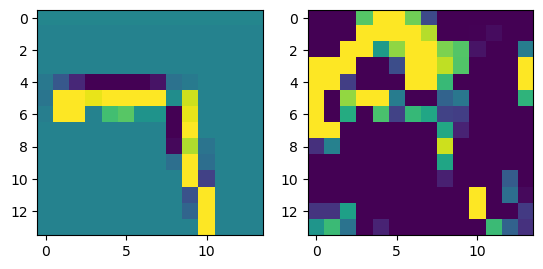

prediction: tensor([4, 6, 9]), tensor([4.6395, 1.4444, 1.0155]) groudtruth: 4
-0.095813036 0.09717651


<Figure size 640x480 with 0 Axes>

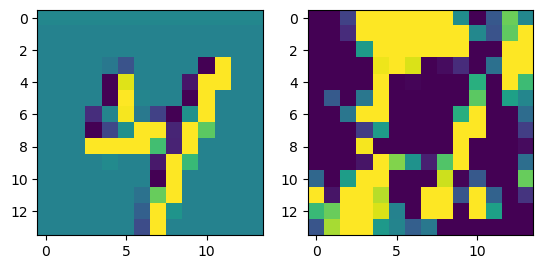

prediction: tensor([7, 3, 9]), tensor([4.3442, 3.0403, 2.4282]) groudtruth: 7
-0.07986003 0.080989264


<Figure size 640x480 with 0 Axes>

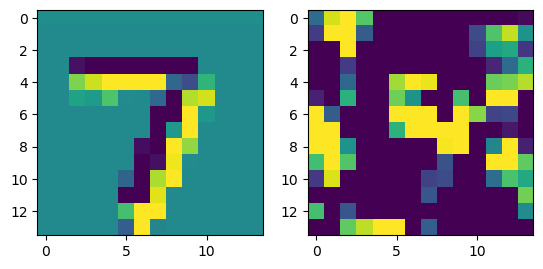

prediction: tensor([9, 7, 1]), tensor([1.5780, 1.5753, 0.1789]) groudtruth: 7
-0.07389718 0.07538895


<Figure size 640x480 with 0 Axes>

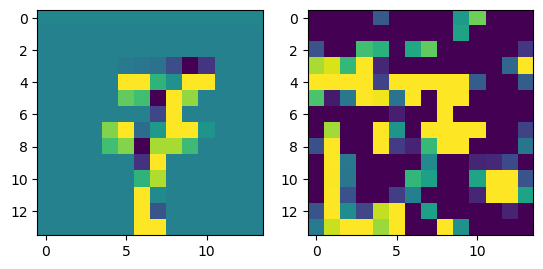

prediction: tensor([8, 3, 5]), tensor([2.1537, 1.8126, 1.2184]) groudtruth: 8
-0.08596712 0.077441745


<Figure size 640x480 with 0 Axes>

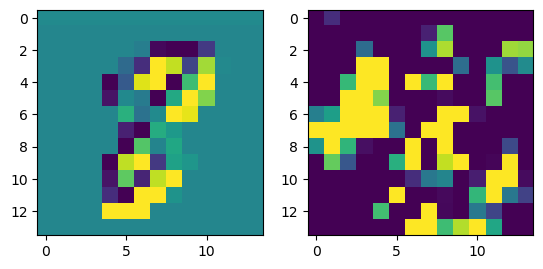

prediction: tensor([2, 3, 9]), tensor([2.9578, 2.7613, 2.6055]) groudtruth: 9
-0.084679425 0.09867024


<Figure size 640x480 with 0 Axes>

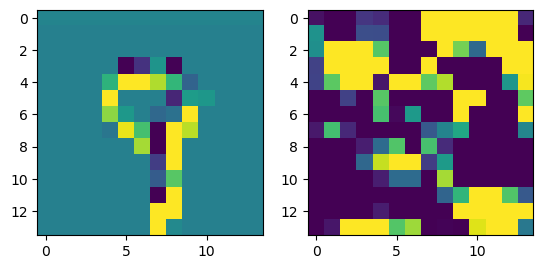

prediction: tensor([1, 7, 8]), tensor([6.3633, 2.9070, 0.4548]) groudtruth: 1
-0.059637666 0.09224093


<Figure size 640x480 with 0 Axes>

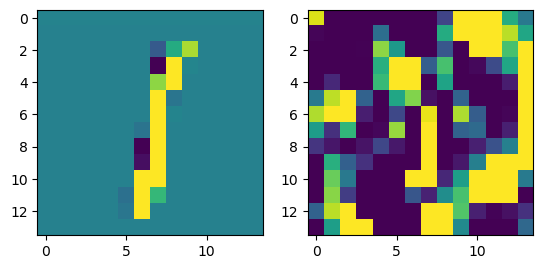

prediction: tensor([1, 4, 2]), tensor([4.1209, 1.3726, 0.6198]) groudtruth: 1
-0.06452596 0.06907718


<Figure size 640x480 with 0 Axes>

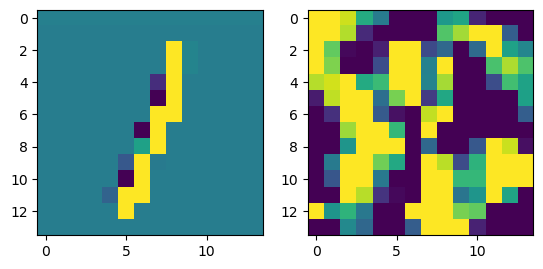

prediction: tensor([0, 6, 5]), tensor([3.8761, 2.5650, 1.3613]) groudtruth: 6
-0.08200312 0.103248626


<Figure size 640x480 with 0 Axes>

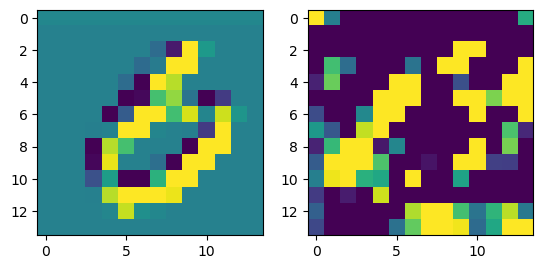

prediction: tensor([9, 7, 3]), tensor([4.9679, 3.3804, 0.9762]) groudtruth: 9
-0.10480499 0.107486024


<Figure size 640x480 with 0 Axes>

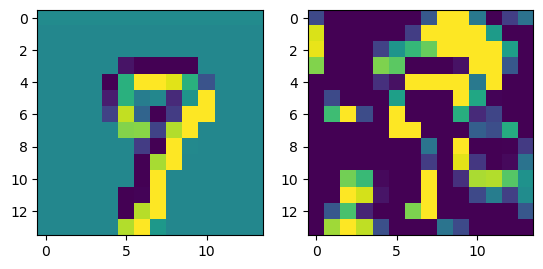

prediction: tensor([1, 7, 8]), tensor([6.1548, 0.5985, 0.4039]) groudtruth: 1
-0.06113434 0.08556526


<Figure size 640x480 with 0 Axes>

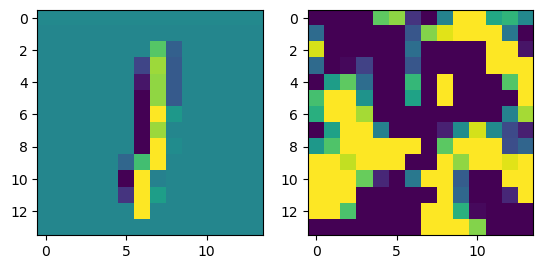

prediction: tensor([4, 2, 7]), tensor([3.7018, 1.3250, 0.7054]) groudtruth: 4
-0.06740731 0.09281263


<Figure size 640x480 with 0 Axes>

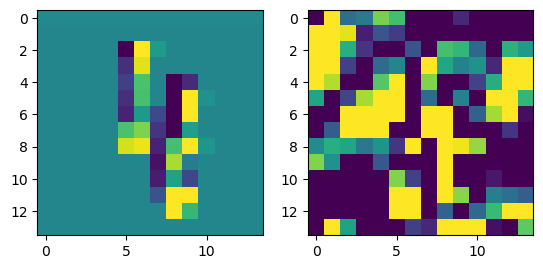

prediction: tensor([4, 6, 2]), tensor([4.0239, 3.5133, 3.4105]) groudtruth: 4
-0.09151739 0.08928967


<Figure size 640x480 with 0 Axes>

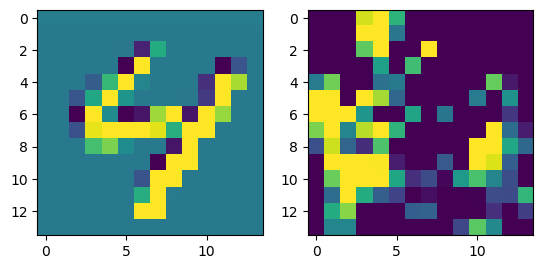

prediction: tensor([3, 5, 7]), tensor([2.7744, 2.1668, 1.5760]) groudtruth: 5
-0.06688273 0.070903674


<Figure size 640x480 with 0 Axes>

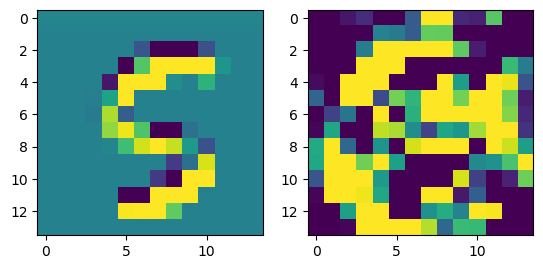

prediction: tensor([4, 8, 7]), tensor([4.0197, 0.7806, 0.3571]) groudtruth: 4
-0.05623859 0.06739481


<Figure size 640x480 with 0 Axes>

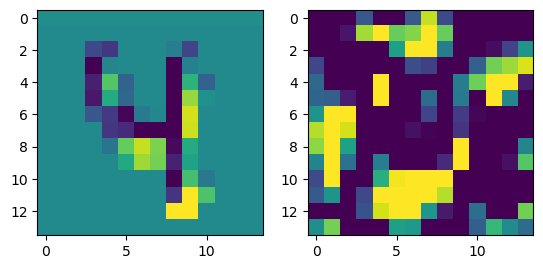

prediction: tensor([0, 5, 3]), tensor([3.6834, 2.1600, 1.6317]) groudtruth: 0
-0.073048174 0.11556484


<Figure size 640x480 with 0 Axes>

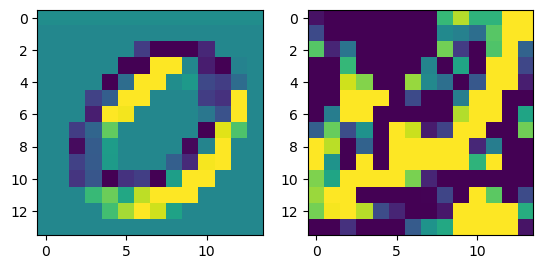

prediction: tensor([6, 1, 8]), tensor([4.7353, 2.2683, 2.1091]) groudtruth: 6
-0.07142919 0.061915167


<Figure size 640x480 with 0 Axes>

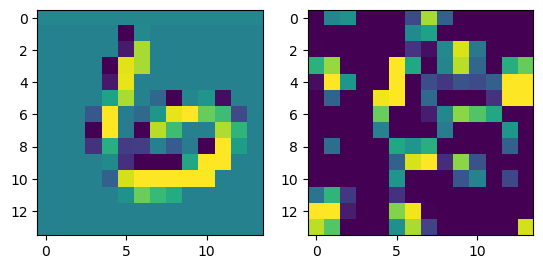

prediction: tensor([2, 3, 6]), tensor([5.6868, 1.2901, 1.2563]) groudtruth: 2
-0.08133644 0.11889431


<Figure size 640x480 with 0 Axes>

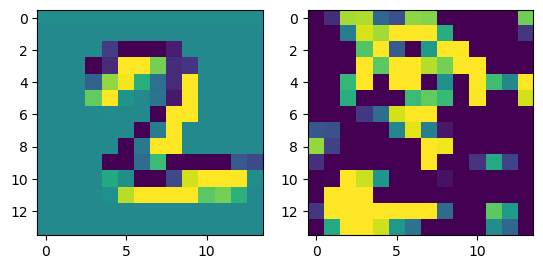

prediction: tensor([9, 2, 8]), tensor([2.9969, 2.0949, 0.5971]) groudtruth: 2
-0.07927096 0.113156796


<Figure size 640x480 with 0 Axes>

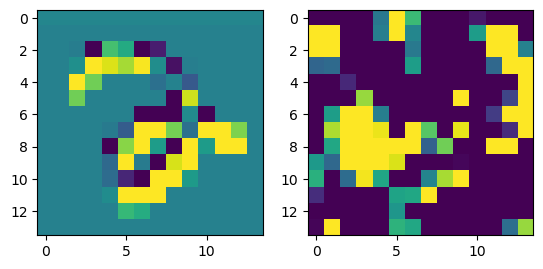

prediction: tensor([4, 7, 8]), tensor([6.3486, 1.6492, 1.0312]) groudtruth: 4
-0.08503145 0.089031786


<Figure size 640x480 with 0 Axes>

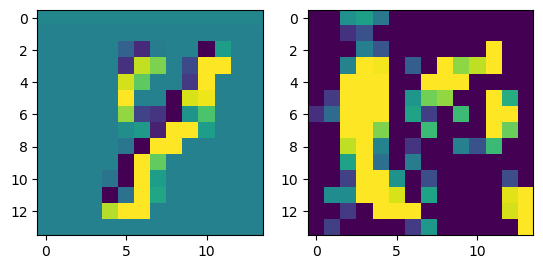

prediction: tensor([1, 6, 4]), tensor([6.0132, 2.0224, 1.8568]) groudtruth: 1
-0.081314325 0.06890344


<Figure size 640x480 with 0 Axes>

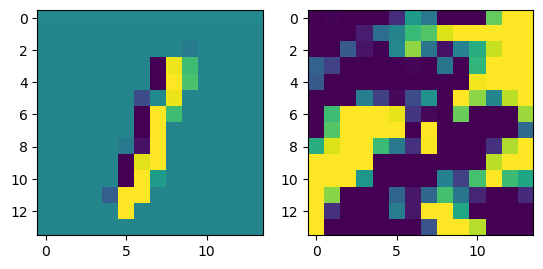

prediction: tensor([8, 1, 9]), tensor([5.3275, 2.7008, 1.0918]) groudtruth: 8
-0.06836599 0.06225345


<Figure size 640x480 with 0 Axes>

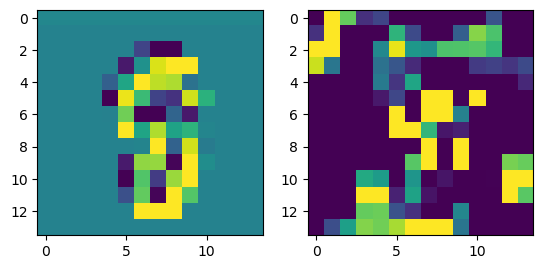

prediction: tensor([1, 7, 8]), tensor([5.2749, 1.6303, 0.5113]) groudtruth: 1
-0.122511625 0.09423658


<Figure size 640x480 with 0 Axes>

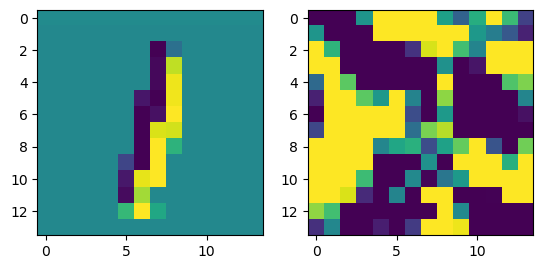

prediction: tensor([3, 9, 5]), tensor([7.0707, 3.9004, 2.7992]) groudtruth: 3
-0.09520888 0.07359266


<Figure size 640x480 with 0 Axes>

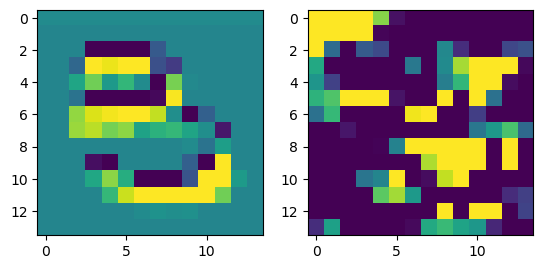

prediction: tensor([8, 3, 2]), tensor([2.4020, 1.7504, 0.6943]) groudtruth: 8
-0.06933963 0.064594865


<Figure size 640x480 with 0 Axes>

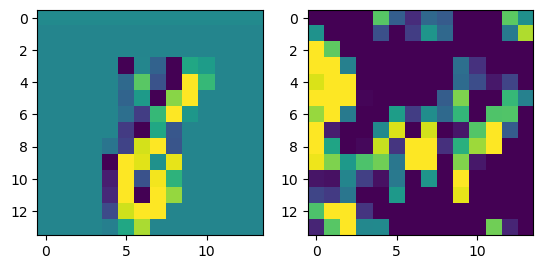

prediction: tensor([1, 7, 9]), tensor([5.9847, 1.6817, 0.5726]) groudtruth: 1
-0.10107875 0.09346987


<Figure size 640x480 with 0 Axes>

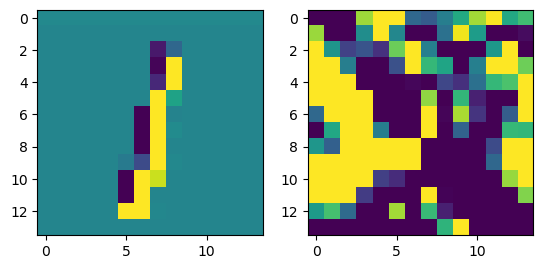

prediction: tensor([2, 7, 3]), tensor([3.1543, 2.8147, 1.5044]) groudtruth: 2
-0.08868837 0.10735965


<Figure size 640x480 with 0 Axes>

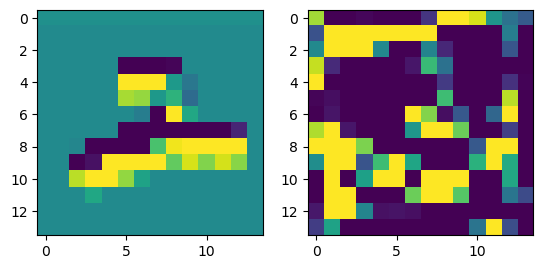

prediction: tensor([5, 6, 2]), tensor([4.4820, 3.6059, 2.8289]) groudtruth: 5
-0.07797253 0.10565734


<Figure size 640x480 with 0 Axes>

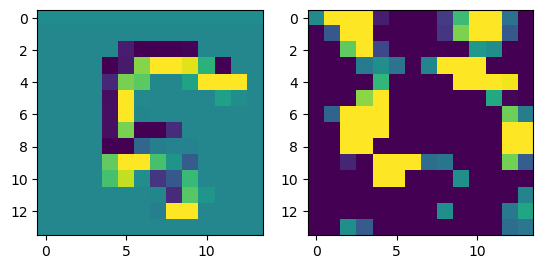

prediction: tensor([8, 1, 0]), tensor([2.1402, 2.0468, 1.1302]) groudtruth: 8
-0.08227432 0.07424629


<Figure size 640x480 with 0 Axes>

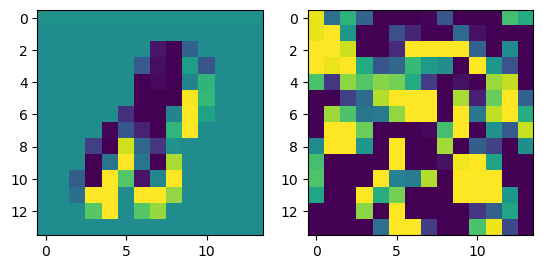

prediction: tensor([0, 3, 6]), tensor([4.3607, 1.5913, 0.8065]) groudtruth: 0
-0.13198543 0.09796621


<Figure size 640x480 with 0 Axes>

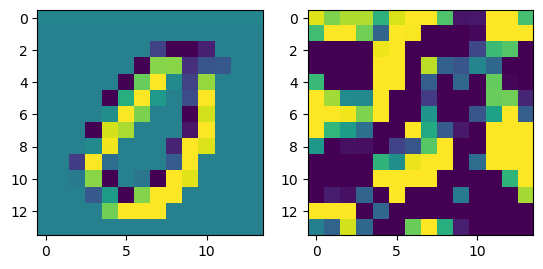

prediction: tensor([9, 6, 3]), tensor([2.0318, 1.9459, 1.7695]) groudtruth: 6
-0.08205706 0.07864036


<Figure size 640x480 with 0 Axes>

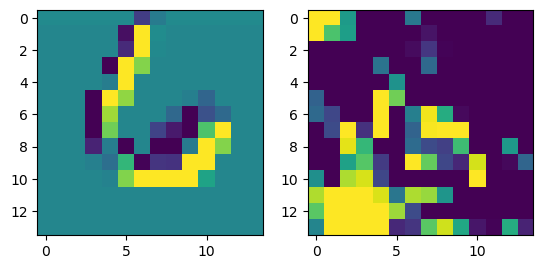

prediction: tensor([2, 6, 9]), tensor([2.0094, 1.3422, 0.8008]) groudtruth: 2
-0.082416415 0.10967296


<Figure size 640x480 with 0 Axes>

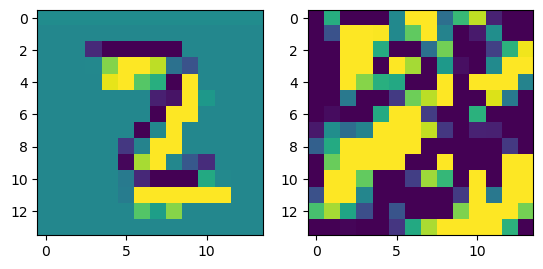

prediction: tensor([1, 2, 8]), tensor([5.8251, 0.8674, 0.5283]) groudtruth: 1
-0.06899285 0.07430114


<Figure size 640x480 with 0 Axes>

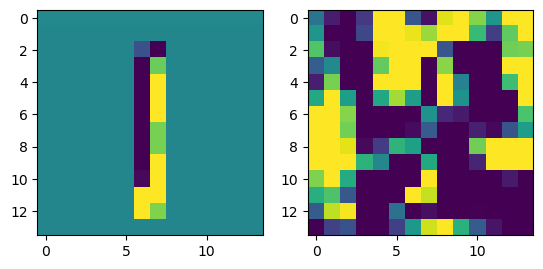

prediction: tensor([1, 5, 7]), tensor([4.5103, 1.5332, 1.1704]) groudtruth: 1
-0.089595795 0.11913366


<Figure size 640x480 with 0 Axes>

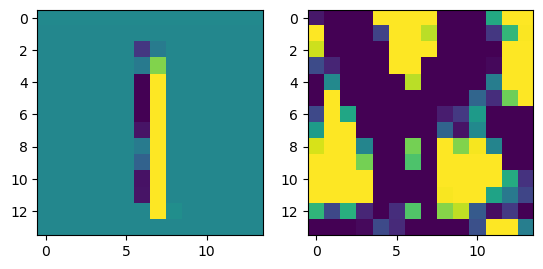

prediction: tensor([4, 8, 1]), tensor([3.2486, 2.7120, 1.8875]) groudtruth: 7
-0.111349404 0.09532855


<Figure size 640x480 with 0 Axes>

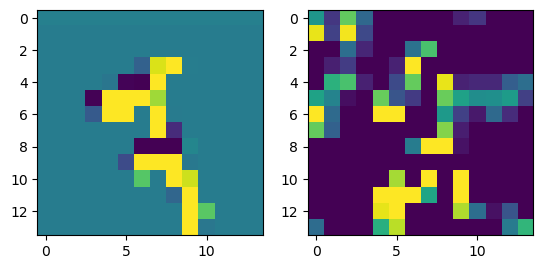

prediction: tensor([9, 8, 2]), tensor([4.2140, 1.7080, 1.1314]) groudtruth: 9
-0.075561166 0.11991057


<Figure size 640x480 with 0 Axes>

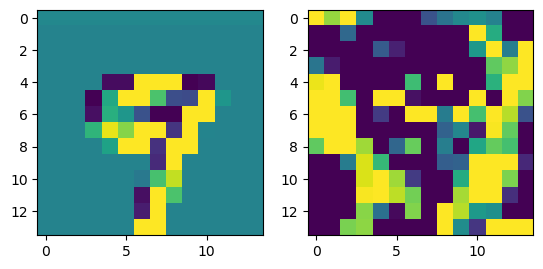

prediction: tensor([3, 5, 2]), tensor([3.9177, 2.8719, 1.1991]) groudtruth: 5
-0.077160895 0.06610832


<Figure size 640x480 with 0 Axes>

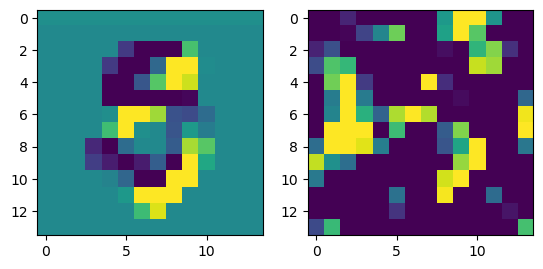

prediction: tensor([9, 3, 5]), tensor([4.5161, 0.6263, 0.4653]) groudtruth: 9
-0.12798202 0.10951411


<Figure size 640x480 with 0 Axes>

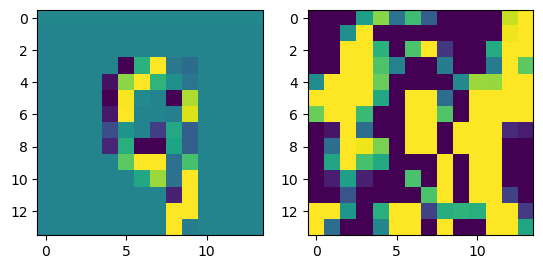

prediction: tensor([2, 7, 8]), tensor([3.6771, 1.3435, 0.8259]) groudtruth: 7
-0.07697928 0.069008246


<Figure size 640x480 with 0 Axes>

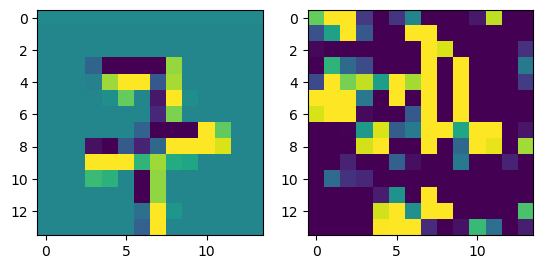

prediction: tensor([3, 5, 6]), tensor([2.7493, 2.5913, 1.8688]) groudtruth: 3
-0.08051455 0.10034084


<Figure size 640x480 with 0 Axes>

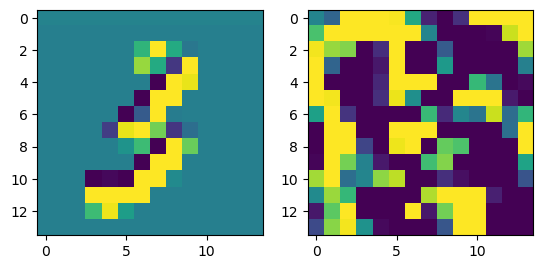

prediction: tensor([8, 7, 9]), tensor([3.6361, 2.4033, 1.5480]) groudtruth: 8
-0.134938 0.11566673


<Figure size 640x480 with 0 Axes>

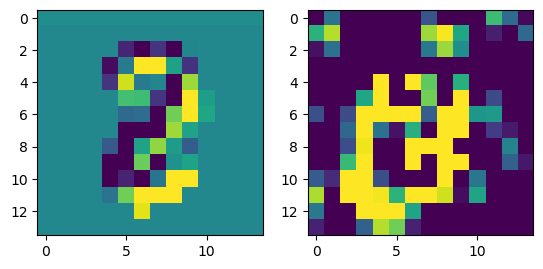

prediction: tensor([0, 6, 2]), tensor([2.9508, 1.8151, 1.7501]) groudtruth: 0
-0.056380033 0.10982341


<Figure size 640x480 with 0 Axes>

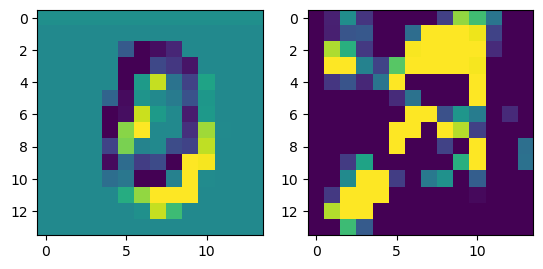

prediction: tensor([3, 2, 9]), tensor([5.6569, 1.3986, 0.9733]) groudtruth: 3
-0.109250486 0.08372155


<Figure size 640x480 with 0 Axes>

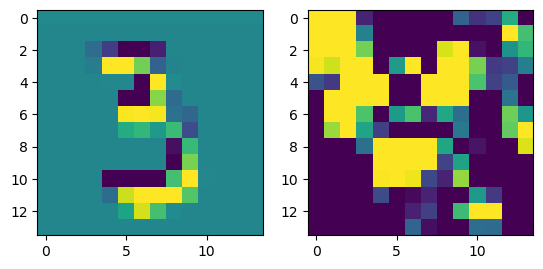

prediction: tensor([7, 0, 9]), tensor([4.7378, 1.6460, 1.4302]) groudtruth: 7
-0.09680396 0.11198735


<Figure size 640x480 with 0 Axes>

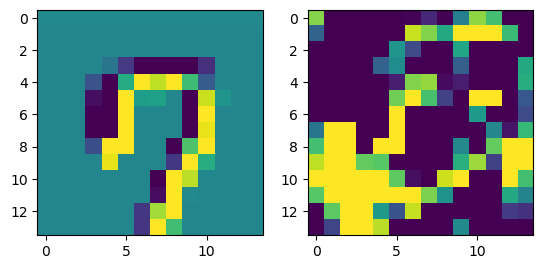

prediction: tensor([1, 8, 5]), tensor([4.6733, 1.5409, 0.8593]) groudtruth: 1
-0.07743281 0.07543782


<Figure size 640x480 with 0 Axes>

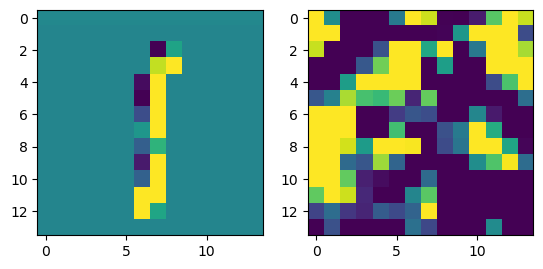

prediction: tensor([9, 3, 8]), tensor([3.9820, 3.9235, 1.7237]) groudtruth: 3
-0.08929974 0.08473779


<Figure size 640x480 with 0 Axes>

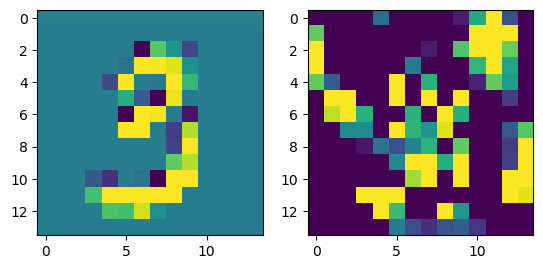

prediction: tensor([6, 7, 0]), tensor([3.4569, 1.7066, 1.4626]) groudtruth: 6
-0.09081215 0.077108294


<Figure size 640x480 with 0 Axes>

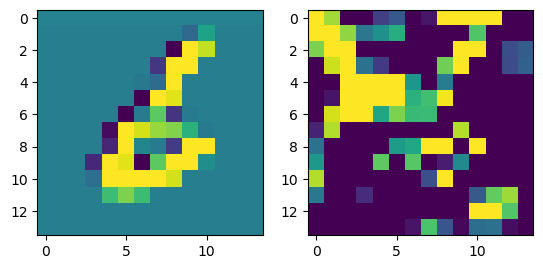

prediction: tensor([7, 6, 3]), tensor([4.0837, 2.4207, 1.1637]) groudtruth: 7
-0.10951018 0.1168487


<Figure size 640x480 with 0 Axes>

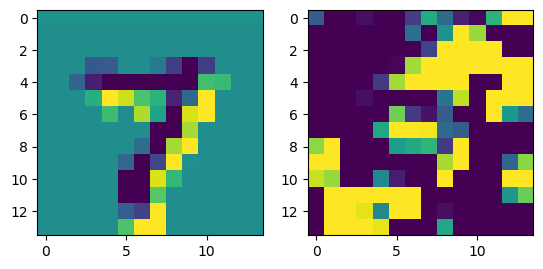

prediction: tensor([8, 3, 9]), tensor([3.4405, 2.6369, 0.9663]) groudtruth: 8
-0.085461736 0.073932245


<Figure size 640x480 with 0 Axes>

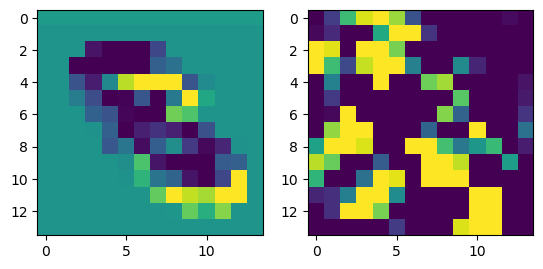

prediction: tensor([5, 7, 3]), tensor([3.4927, 1.8391, 1.2024]) groudtruth: 5
-0.08985281 0.06984347


<Figure size 640x480 with 0 Axes>

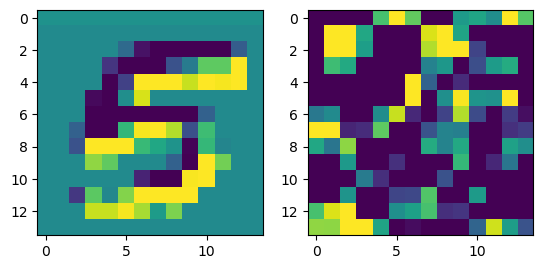

prediction: tensor([9, 8, 5]), tensor([4.6074, 2.5395, 2.0504]) groudtruth: 9
-0.09187704 0.08885276


<Figure size 640x480 with 0 Axes>

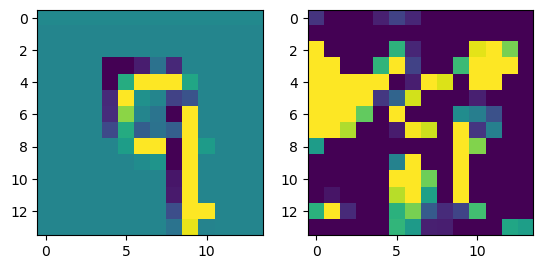

prediction: tensor([9, 4, 0]), tensor([2.8754, 1.1357, 0.8032]) groudtruth: 9
-0.09659004 0.10847816


<Figure size 640x480 with 0 Axes>

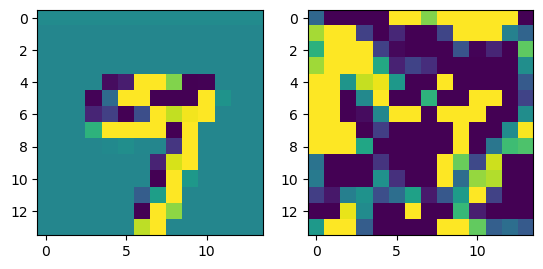

prediction: tensor([7, 6, 5]), tensor([2.8535, 1.3913, 1.1456]) groudtruth: 6
-0.10165435 0.06902833


<Figure size 640x480 with 0 Axes>

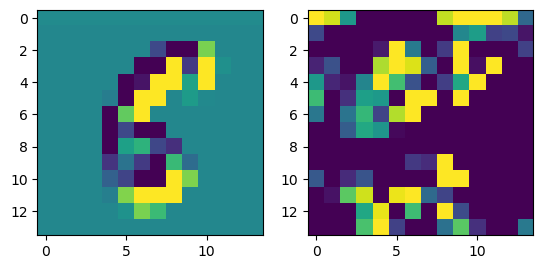

prediction: tensor([0, 8, 5]), tensor([3.4933, 2.5041, 0.6350]) groudtruth: 0
-0.064293385 0.06679522


<Figure size 640x480 with 0 Axes>

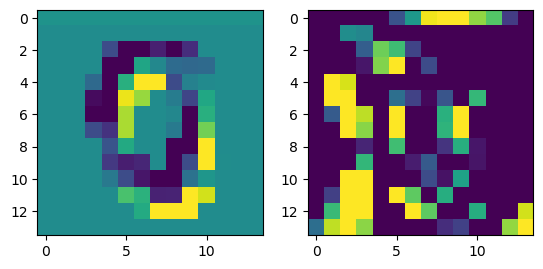

prediction: tensor([2, 8, 4]), tensor([3.3280, 1.7600, 1.6156]) groudtruth: 2
-0.09893733 0.09111065


<Figure size 640x480 with 0 Axes>

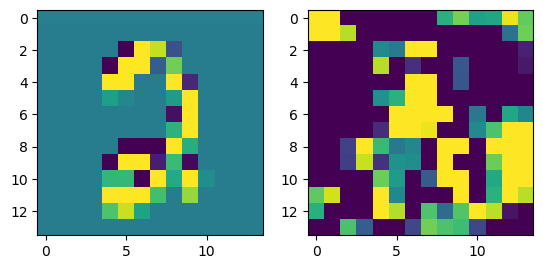

prediction: tensor([6, 9, 5]), tensor([5.4802, 3.4211, 2.1151]) groudtruth: 7
-0.070663035 0.09044379


<Figure size 640x480 with 0 Axes>

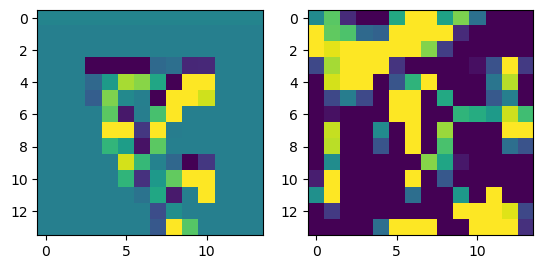

prediction: tensor([4, 9, 6]), tensor([3.2231, 2.4361, 1.3144]) groudtruth: 4
-0.0677129 0.057660587


<Figure size 640x480 with 0 Axes>

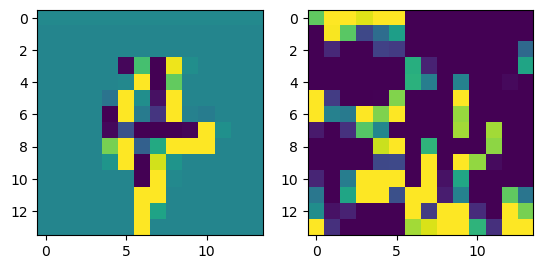

prediction: tensor([4, 7, 6]), tensor([3.4622, 1.7822, 1.6206]) groudtruth: 4
-0.08492565 0.06998417


<Figure size 640x480 with 0 Axes>

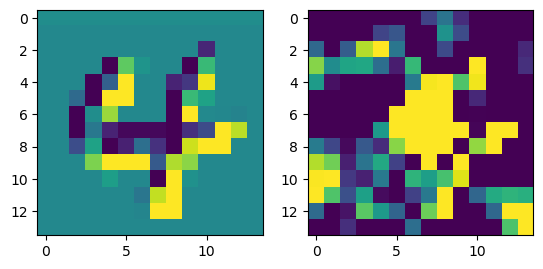

prediction: tensor([4, 6, 8]), tensor([3.5219, 2.5971, 0.7160]) groudtruth: 4
-0.091382325 0.06763062


<Figure size 640x480 with 0 Axes>

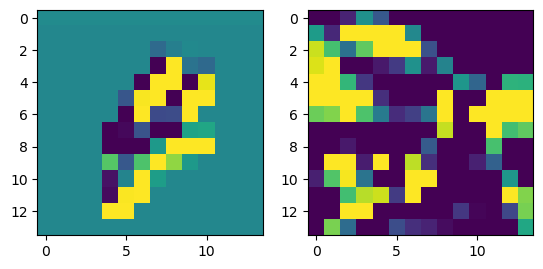

prediction: tensor([4, 9, 3]), tensor([4.6062, 1.4432, 1.1742]) groudtruth: 4
-0.08069414 0.09970098


<Figure size 640x480 with 0 Axes>

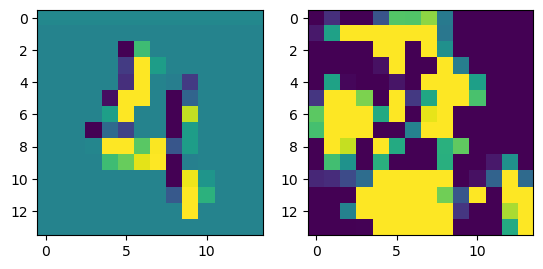

prediction: tensor([6, 7, 9]), tensor([4.0910, 3.5529, 0.6996]) groudtruth: 6
-0.10951382 0.0665054


<Figure size 640x480 with 0 Axes>

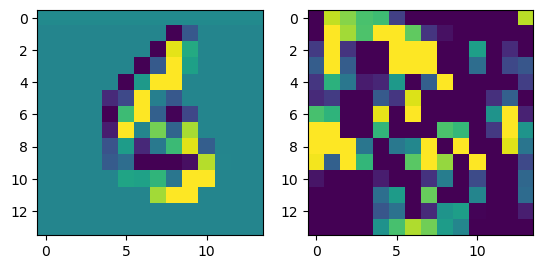

prediction: tensor([1, 9, 4]), tensor([3.6501, 2.6790, 2.5263]) groudtruth: 6
-0.076744735 0.10069284


<Figure size 640x480 with 0 Axes>

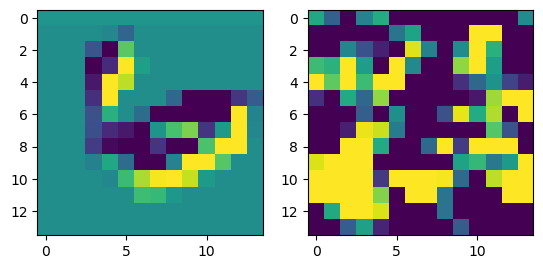

prediction: tensor([4, 1, 9]), tensor([4.5300, 1.4697, 1.2893]) groudtruth: 4
-0.07068819 0.08174388


<Figure size 640x480 with 0 Axes>

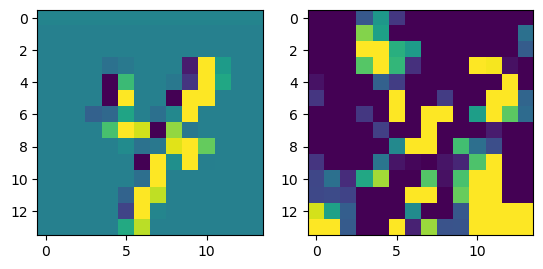

prediction: tensor([7, 6, 4]), tensor([2.0448, 1.6225, 1.4069]) groudtruth: 7
-0.06580198 0.07049363


<Figure size 640x480 with 0 Axes>

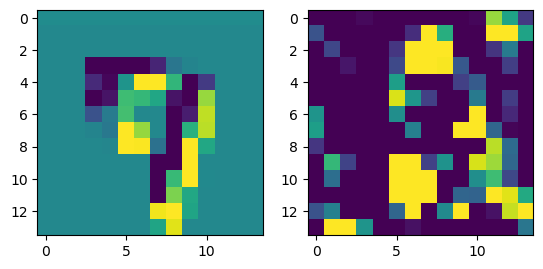

prediction: tensor([9, 8, 7]), tensor([3.9148, 0.7718, 0.3914]) groudtruth: 9
-0.06838876 0.062288657


<Figure size 640x480 with 0 Axes>

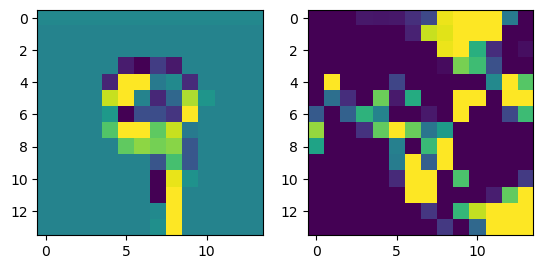

prediction: tensor([7, 8, 0]), tensor([2.0078, 1.8776, 1.8565]) groudtruth: 3
-0.11377722 0.10033956


<Figure size 640x480 with 0 Axes>

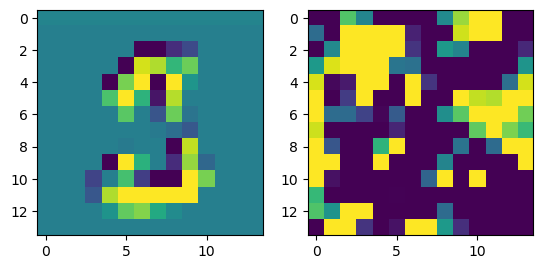

prediction: tensor([4, 7, 1]), tensor([5.8318, 1.8119, 0.9475]) groudtruth: 4
-0.08488703 0.078131564


<Figure size 640x480 with 0 Axes>

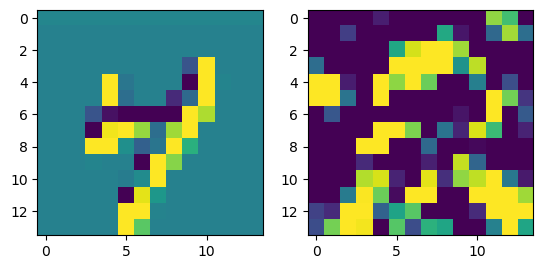

prediction: tensor([7, 2, 8]), tensor([4.6018, 1.8857, 1.1913]) groudtruth: 7
-0.080953956 0.10230079


<Figure size 640x480 with 0 Axes>

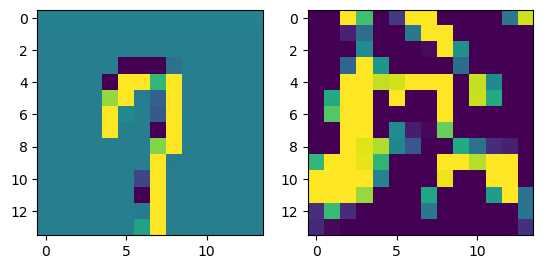

prediction: tensor([9, 7, 4]), tensor([4.4382, 2.9405, 0.9228]) groudtruth: 9
-0.07387042 0.10063994


<Figure size 640x480 with 0 Axes>

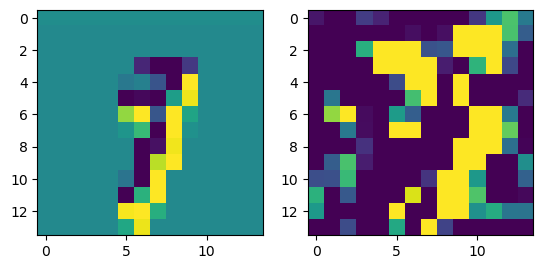

prediction: tensor([0, 8, 7]), tensor([5.1875, 4.3145, 0.0062]) groudtruth: 0
-0.09098256 0.09024111


<Figure size 640x480 with 0 Axes>

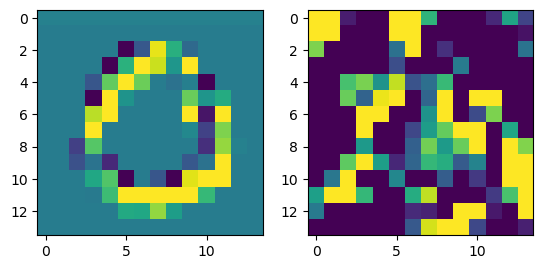

prediction: tensor([8, 7, 9]), tensor([3.3459, 1.0718, 0.5658]) groudtruth: 8
-0.05956304 0.06127148


<Figure size 640x480 with 0 Axes>

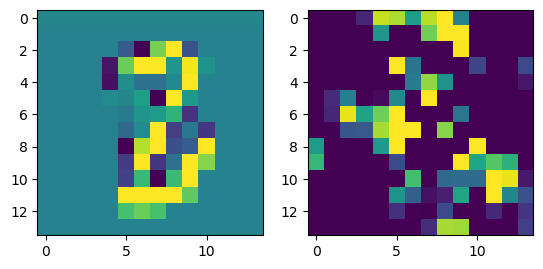

prediction: tensor([0, 3, 7]), tensor([3.3387, 2.2544, 1.8261]) groudtruth: 0
-0.08909172 0.07747726


<Figure size 640x480 with 0 Axes>

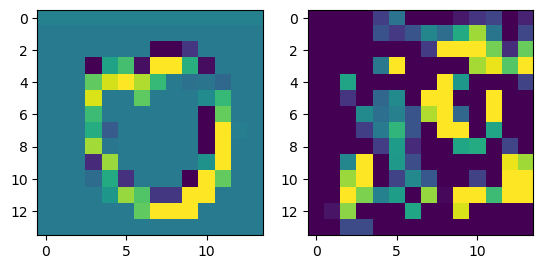

prediction: tensor([5, 3, 7]), tensor([5.5178, 1.0139, 0.6649]) groudtruth: 5
-0.07712901 0.07406747


<Figure size 640x480 with 0 Axes>

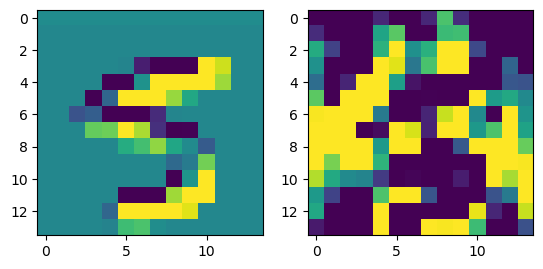

prediction: tensor([4, 2, 7]), tensor([5.2849, 2.2204, 1.8325]) groudtruth: 4
-0.07428163 0.057163067


<Figure size 640x480 with 0 Axes>

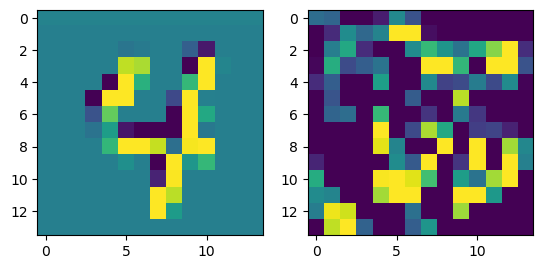

prediction: tensor([0, 7, 2]), tensor([2.7155, 1.1270, 0.4952]) groudtruth: 0
-0.05282557 0.083998546


<Figure size 640x480 with 0 Axes>

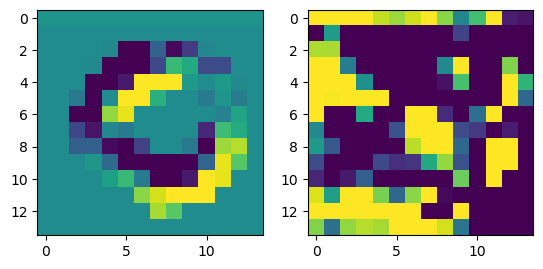

prediction: tensor([5, 3, 4]), tensor([4.0872, 3.0506, 2.4081]) groudtruth: 2
-0.080038846 0.088687494


<Figure size 640x480 with 0 Axes>

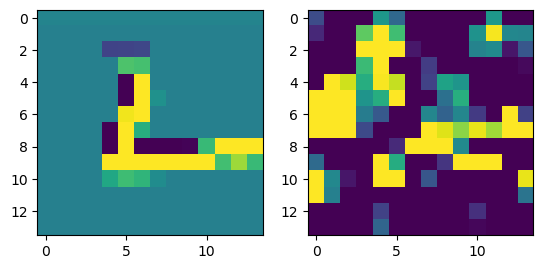

prediction: tensor([8, 5, 6]), tensor([5.4922, 2.7304, 0.1094]) groudtruth: 8
-0.074810445 0.067894004


<Figure size 640x480 with 0 Axes>

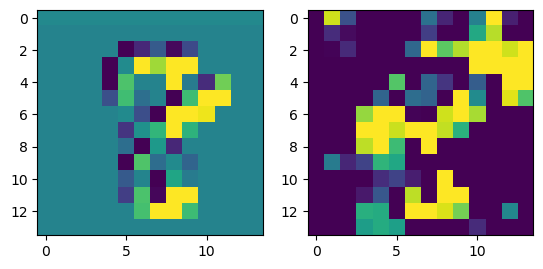

prediction: tensor([2, 7, 1]), tensor([4.0552, 2.2141, 1.1844]) groudtruth: 7
-0.085466206 0.09059808


<Figure size 640x480 with 0 Axes>

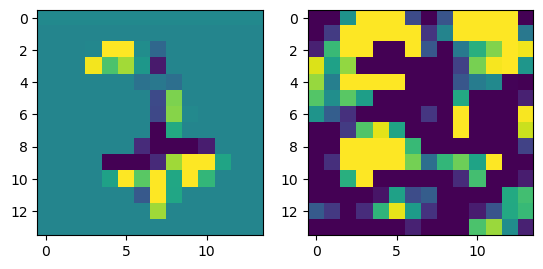

prediction: tensor([2, 5, 1]), tensor([3.4429, 2.9708, 1.6013]) groudtruth: 2
-0.07096022 0.08323941


<Figure size 640x480 with 0 Axes>

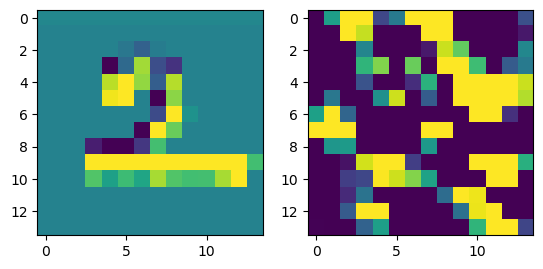

prediction: tensor([9, 3, 6]), tensor([3.9880, 1.9447, 1.2244]) groudtruth: 9
-0.099589825 0.12779075


<Figure size 640x480 with 0 Axes>

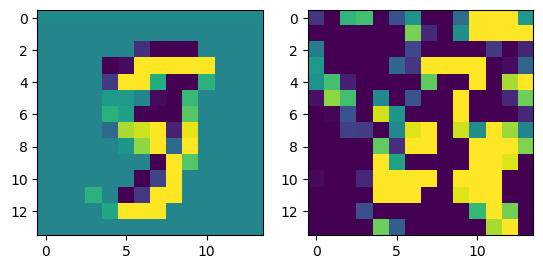

prediction: tensor([8, 2, 1]), tensor([5.1482, 0.8430, 0.4383]) groudtruth: 8
-0.07216787 0.07996193


<Figure size 640x480 with 0 Axes>

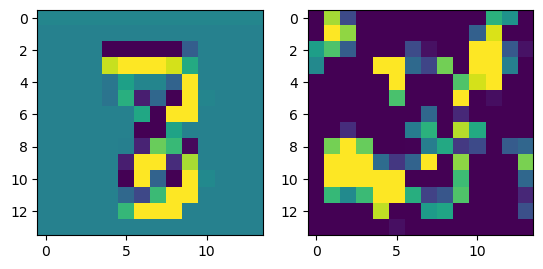

prediction: tensor([4, 1, 2]), tensor([3.5313, 1.8133, 1.7928]) groudtruth: 4
-0.07444632 0.07659515


<Figure size 640x480 with 0 Axes>

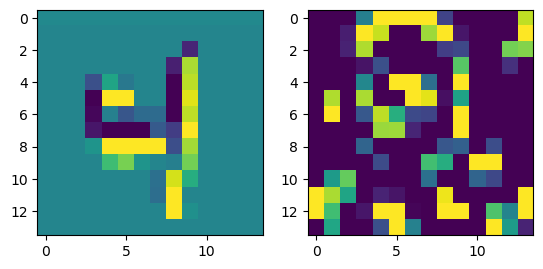

prediction: tensor([0, 5, 3]), tensor([5.7656, 0.9496, 0.8726]) groudtruth: 0
-0.0913077 0.061064795


<Figure size 640x480 with 0 Axes>

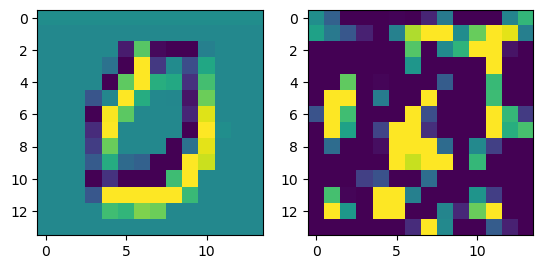

prediction: tensor([1, 5, 7]), tensor([5.5932, 1.6065, 1.0446]) groudtruth: 1
-0.107984364 0.08842193


<Figure size 640x480 with 0 Axes>

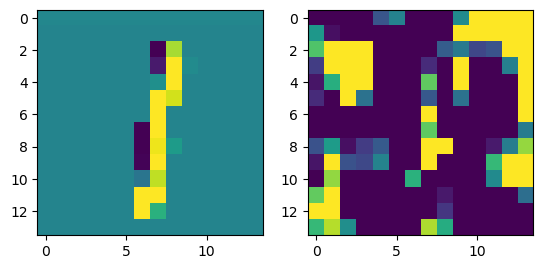

prediction: tensor([5, 3, 9]), tensor([4.5007, 3.2223, 0.4449]) groudtruth: 5
-0.089020014 0.09755932


<Figure size 640x480 with 0 Axes>

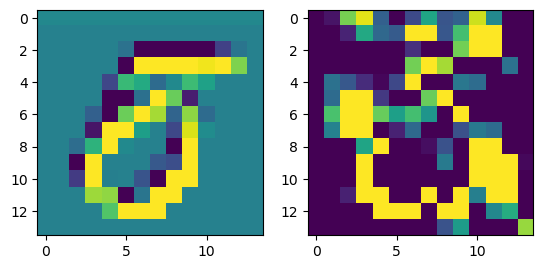

prediction: tensor([9, 2, 4]), tensor([4.2573, 2.4480, 1.3513]) groudtruth: 9
-0.079235315 0.09266935


<Figure size 640x480 with 0 Axes>

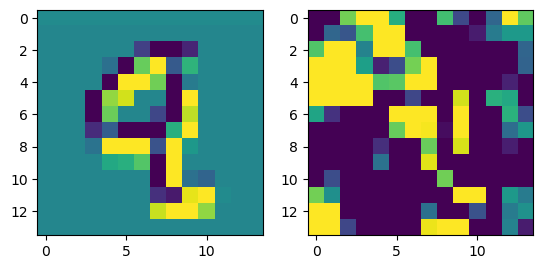

prediction: tensor([7, 2, 3]), tensor([2.7477, 2.4153, 1.7975]) groudtruth: 7
-0.089375615 0.09733724


<Figure size 640x480 with 0 Axes>

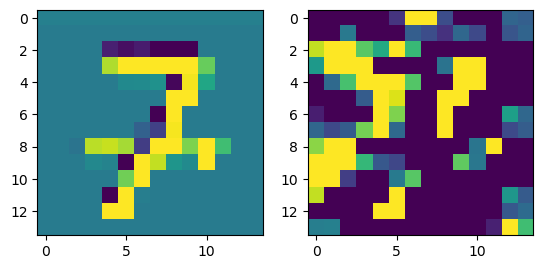

prediction: tensor([3, 9, 7]), tensor([6.7110, 4.3688, 2.6343]) groudtruth: 3
-0.08933699 0.08882414


<Figure size 640x480 with 0 Axes>

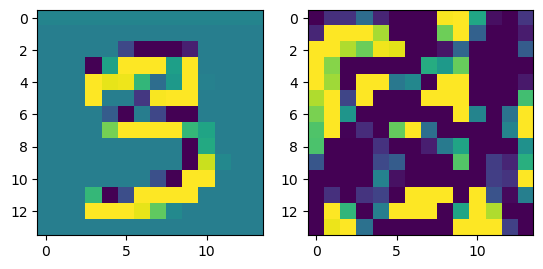

prediction: tensor([0, 3, 5]), tensor([3.4379, 2.0593, 1.9776]) groudtruth: 5
-0.11423379 0.073028654


<Figure size 640x480 with 0 Axes>

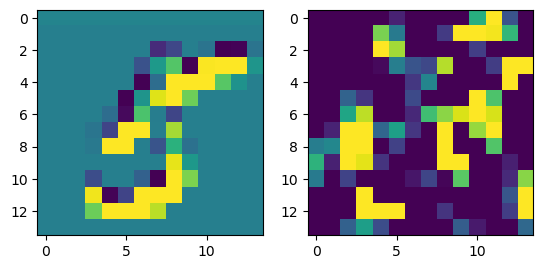

prediction: tensor([8, 3, 9]), tensor([4.7329, 1.6196, 1.0957]) groudtruth: 8
-0.08341783 0.075063944


<Figure size 640x480 with 0 Axes>

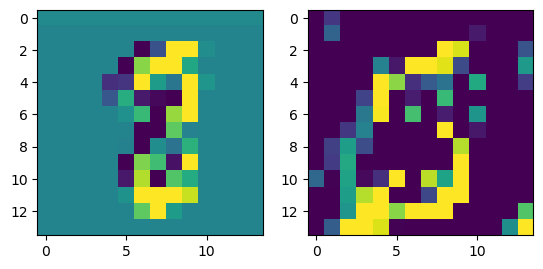

prediction: tensor([9, 8, 7]), tensor([3.2188, 2.9643, 1.6731]) groudtruth: 8
-0.103389025 0.096149966


<Figure size 640x480 with 0 Axes>

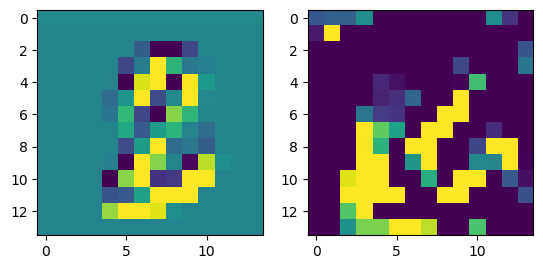

prediction: tensor([0, 6, 5]), tensor([2.9341, 1.8336, 1.0568]) groudtruth: 0
-0.09610307 0.100067705


<Figure size 640x480 with 0 Axes>

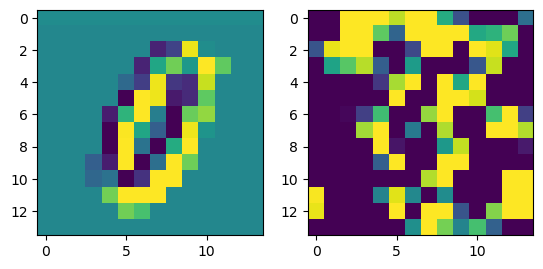

prediction: tensor([9, 7, 3]), tensor([1.0498, 1.0497, 0.7386]) groudtruth: 5
-0.09875566 0.08265904


<Figure size 640x480 with 0 Axes>

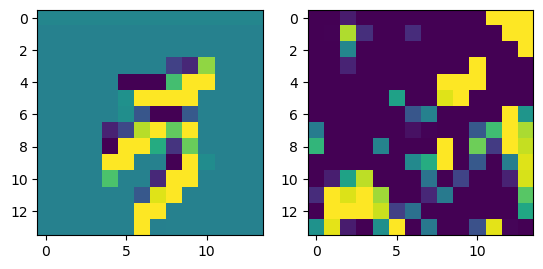

prediction: tensor([3, 5, 9]), tensor([2.6397, 1.6247, 0.4649]) groudtruth: 3
-0.12034041 0.095569625


<Figure size 640x480 with 0 Axes>

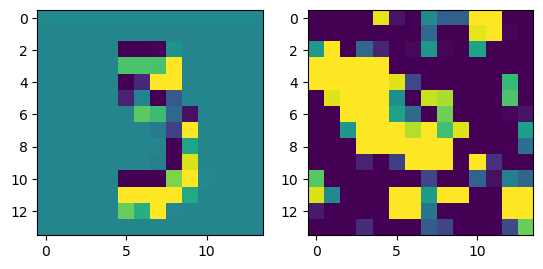

prediction: tensor([2, 3, 9]), tensor([2.7610, 2.7503, 2.6358]) groudtruth: 3
-0.07137263 0.07544845


<Figure size 640x480 with 0 Axes>

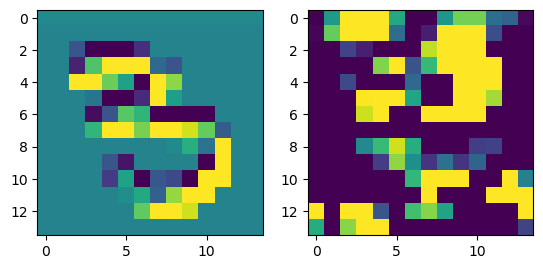

prediction: tensor([6, 5, 2]), tensor([4.0815, 1.7677, 1.0059]) groudtruth: 6
-0.09929395 0.08792244


<Figure size 640x480 with 0 Axes>

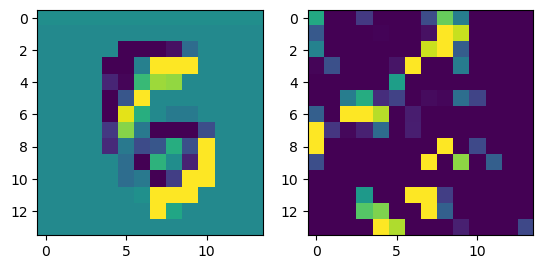

prediction: tensor([6, 9, 1]), tensor([4.8584, 2.6176, 1.2574]) groudtruth: 6
-0.08040017 0.09115343


<Figure size 640x480 with 0 Axes>

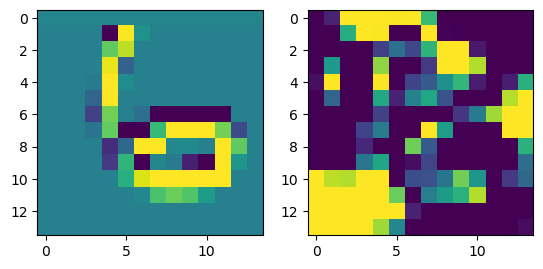

prediction: tensor([0, 6, 8]), tensor([2.6884, 1.1084, 0.9094]) groudtruth: 0
-0.08234948 0.07612367


<Figure size 640x480 with 0 Axes>

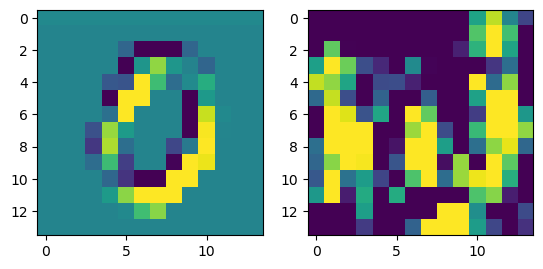

prediction: tensor([1, 4, 7]), tensor([7.3154, 1.5261, 1.3380]) groudtruth: 1
-0.09087181 0.09416615


<Figure size 640x480 with 0 Axes>

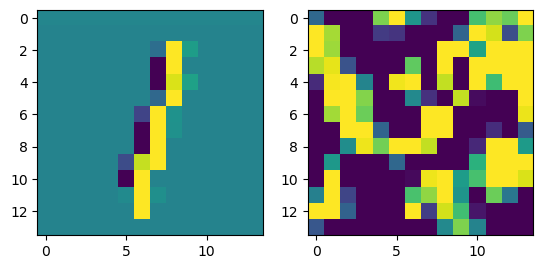

prediction: tensor([6, 1, 2]), tensor([3.4531, 2.0860, 1.2367]) groudtruth: 6
-0.09427607 0.097276695


<Figure size 640x480 with 0 Axes>

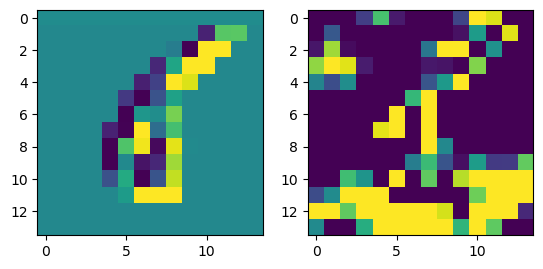

prediction: tensor([2, 5, 3]), tensor([3.5741, 2.1495, 1.5611]) groudtruth: 2
-0.092766106 0.08090446


<Figure size 640x480 with 0 Axes>

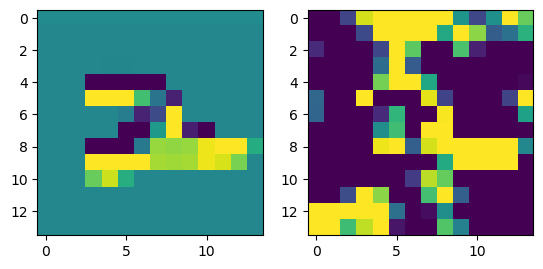

prediction: tensor([7, 0, 2]), tensor([4.4355, 1.2428, 1.1322]) groudtruth: 7
-0.06841177 0.06681891


<Figure size 640x480 with 0 Axes>

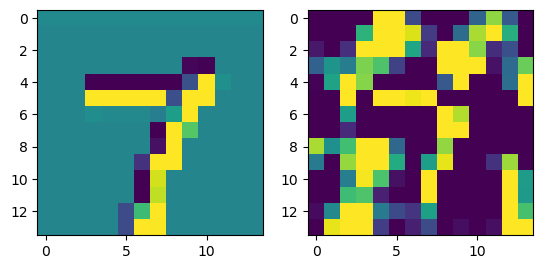

prediction: tensor([9, 7, 4]), tensor([2.9241, 2.4099, 1.4349]) groudtruth: 7
-0.084307194 0.10089539


<Figure size 640x480 with 0 Axes>

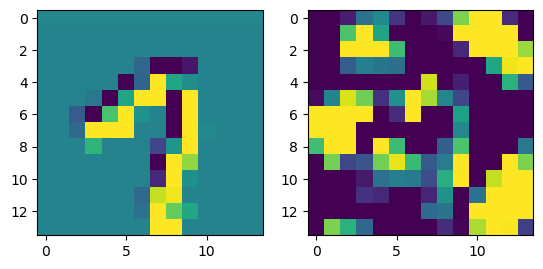

prediction: tensor([2, 1, 6]), tensor([4.1254, 1.9450, 1.0910]) groudtruth: 2
-0.10531169 0.11132615


<Figure size 640x480 with 0 Axes>

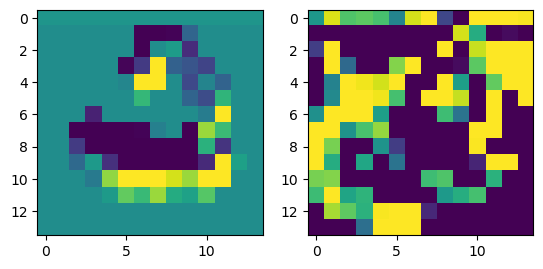

prediction: tensor([2, 7, 1]), tensor([4.1229, 2.6527, 0.7887]) groudtruth: 2
-0.10277045 0.097430125


<Figure size 640x480 with 0 Axes>

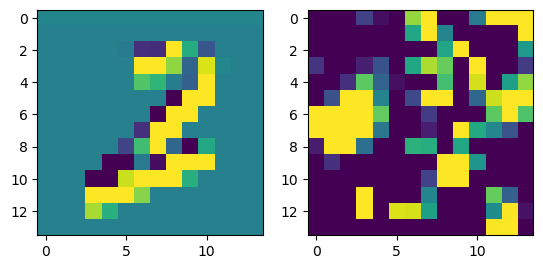

prediction: tensor([1, 7, 8]), tensor([4.5923, 0.8866, 0.7988]) groudtruth: 1
-0.07289654 0.08411908


<Figure size 640x480 with 0 Axes>

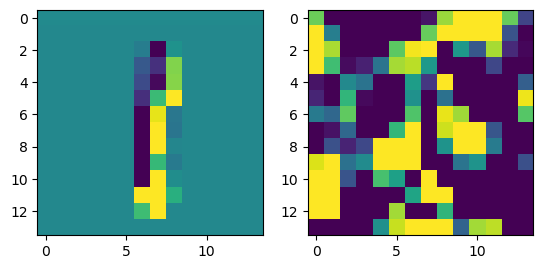

prediction: tensor([1, 4, 6]), tensor([3.3934, 1.9505, 1.5515]) groudtruth: 1
-0.08047712 0.07208608


<Figure size 640x480 with 0 Axes>

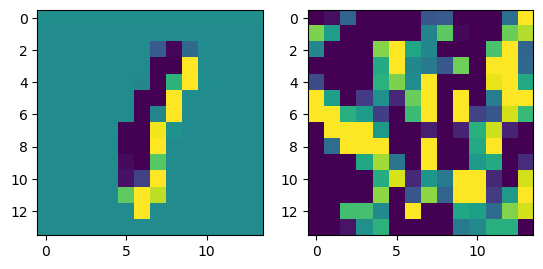

prediction: tensor([0, 2, 5]), tensor([3.7187, 2.8146, 1.3302]) groudtruth: 2
-0.07710147 0.08030979


<Figure size 640x480 with 0 Axes>

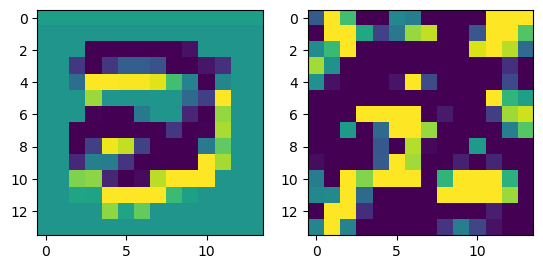

prediction: tensor([8, 5, 9]), tensor([5.0173, 1.7345, 1.6608]) groudtruth: 8
-0.083063304 0.09537404


<Figure size 640x480 with 0 Axes>

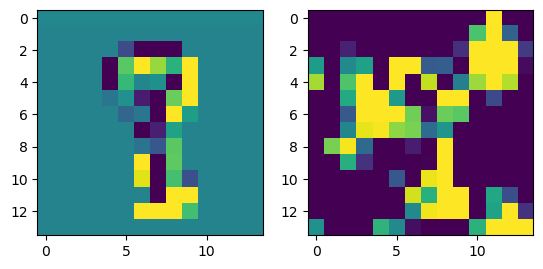

prediction: tensor([3, 5, 7]), tensor([3.1612, 2.7527, 2.3351]) groudtruth: 3
-0.0948571 0.07956426


<Figure size 640x480 with 0 Axes>

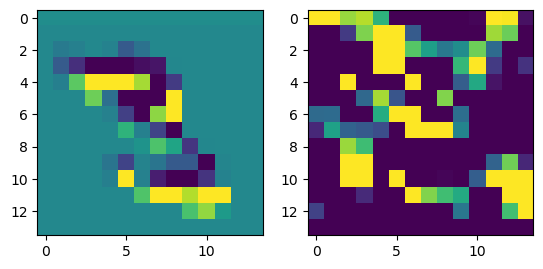

prediction: tensor([4, 1, 8]), tensor([3.6796, 2.6225, 2.0965]) groudtruth: 7
-0.09298426 0.102659576


<Figure size 640x480 with 0 Axes>

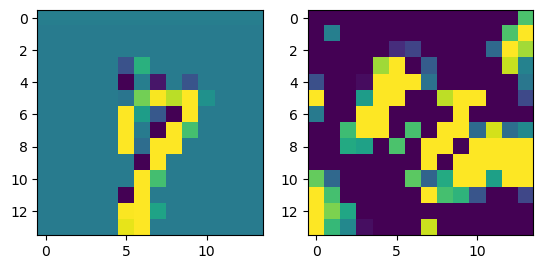

prediction: tensor([7, 4, 2]), tensor([2.3074, 1.9301, 1.3305]) groudtruth: 2
-0.07617414 0.113794684


<Figure size 640x480 with 0 Axes>

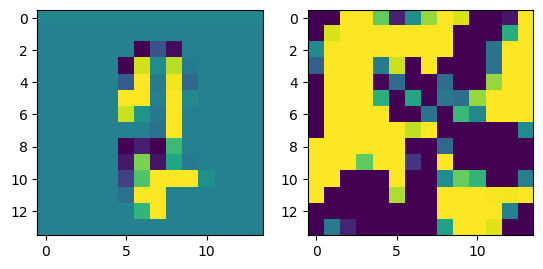

prediction: tensor([4, 1, 8]), tensor([5.6596, 1.9181, 1.1938]) groudtruth: 4
-0.10861695 0.11072433


<Figure size 640x480 with 0 Axes>

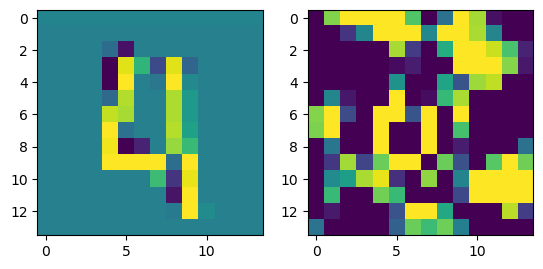

prediction: tensor([1, 7, 8]), tensor([4.9667, 0.8863, 0.3887]) groudtruth: 1
-0.06710315 0.068915054


<Figure size 640x480 with 0 Axes>

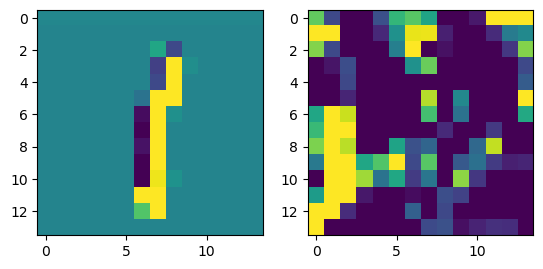

prediction: tensor([7, 2, 3]), tensor([3.2767, 1.2323, 1.2205]) groudtruth: 7
-0.099669576 0.09774946


<Figure size 640x480 with 0 Axes>

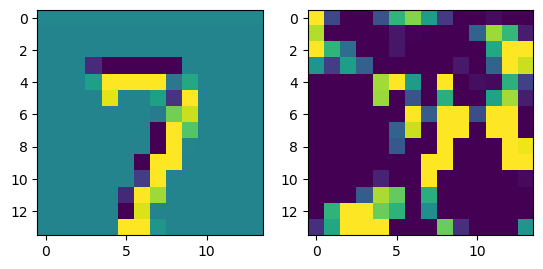

prediction: tensor([0, 6, 8]), tensor([7.2980, 1.6100, 0.2695]) groudtruth: 0
-0.07738489 0.05512191


<Figure size 640x480 with 0 Axes>

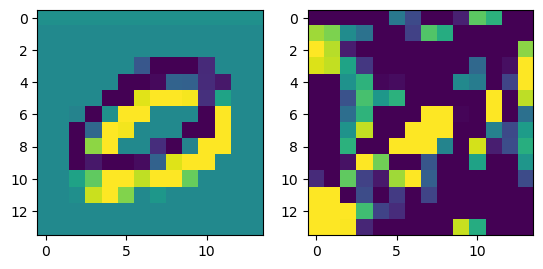

prediction: tensor([8, 2, 1]), tensor([2.4358, 1.9871, 1.5483]) groudtruth: 2
-0.12158972 0.08841573


<Figure size 640x480 with 0 Axes>

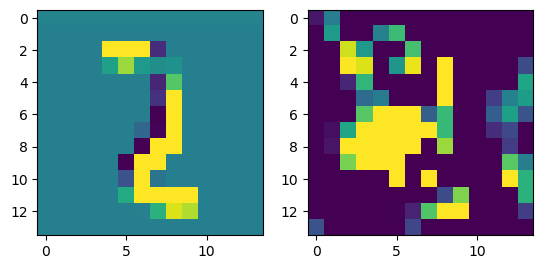

prediction: tensor([6, 2, 0]), tensor([2.1671, 2.1047, 2.0946]) groudtruth: 2
-0.072461545 0.08910817


<Figure size 640x480 with 0 Axes>

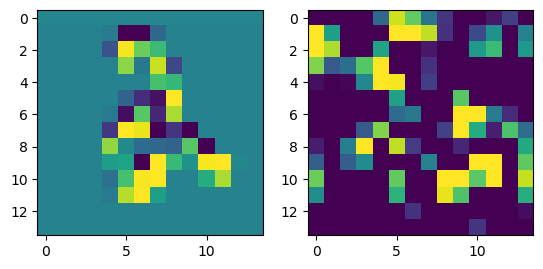

prediction: tensor([0, 8, 4]), tensor([3.1034, 2.4122, 2.1219]) groudtruth: 0
-0.10923475 0.14124529


<Figure size 640x480 with 0 Axes>

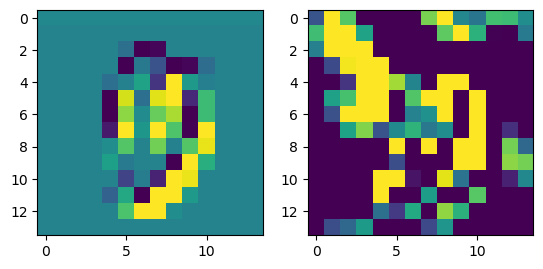

prediction: tensor([2, 4, 7]), tensor([6.9041, 3.1318, 0.6834]) groudtruth: 2
-0.07562727 0.091965236


<Figure size 640x480 with 0 Axes>

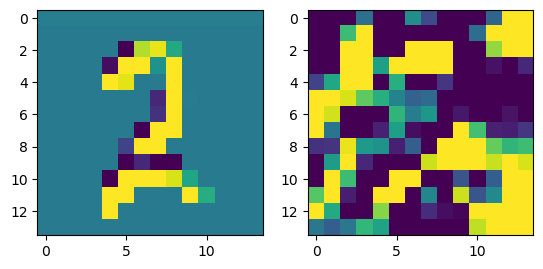

prediction: tensor([4, 9, 8]), tensor([5.2768, 2.7931, 2.3585]) groudtruth: 4
-0.074144185 0.07854796


<Figure size 640x480 with 0 Axes>

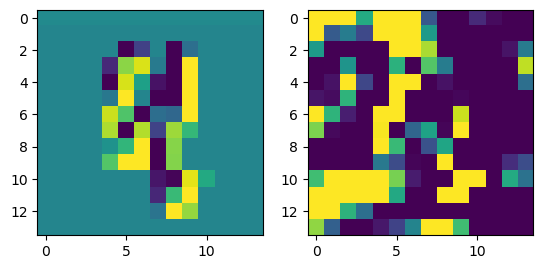

prediction: tensor([9, 4, 6]), tensor([3.1725, 3.1131, 1.7061]) groudtruth: 9
-0.07164848 0.092041746


<Figure size 640x480 with 0 Axes>

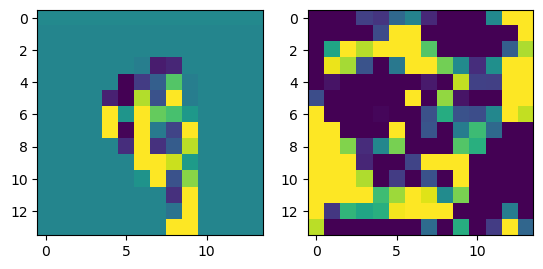

prediction: tensor([8, 6, 5]), tensor([3.9979, 3.3086, 2.0858]) groudtruth: 8
-0.05975336 0.09489302


<Figure size 640x480 with 0 Axes>

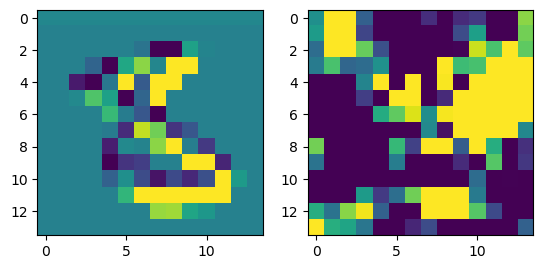

prediction: tensor([0, 6, 2]), tensor([4.1599, 1.4440, 0.6452]) groudtruth: 0
-0.08207679 0.062346295


<Figure size 640x480 with 0 Axes>

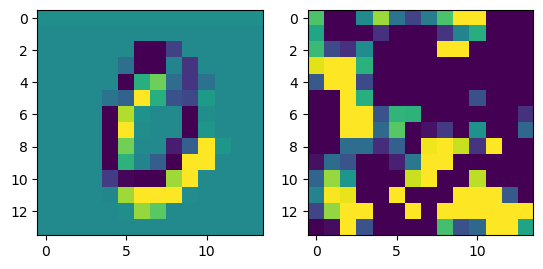

prediction: tensor([9, 6, 5]), tensor([4.4462, 0.8787, 0.4744]) groudtruth: 9
-0.11078119 0.07094383


<Figure size 640x480 with 0 Axes>

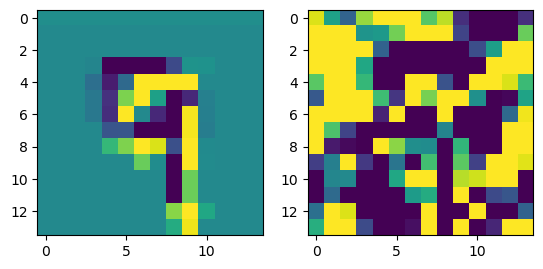

prediction: tensor([9, 3, 7]), tensor([4.6217, 1.4247, 1.1955]) groudtruth: 9
-0.08250135 0.12078308


<Figure size 640x480 with 0 Axes>

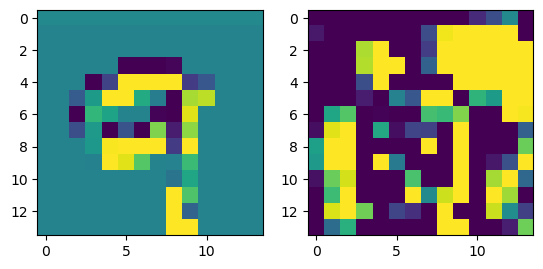

prediction: tensor([4, 6, 1]), tensor([4.3667, 2.5757, 1.0469]) groudtruth: 4
-0.10801691 0.084017664


<Figure size 640x480 with 0 Axes>

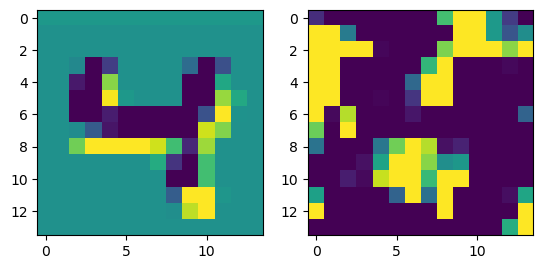

prediction: tensor([6, 7, 9]), tensor([4.5919, 2.2198, 0.4255]) groudtruth: 6
-0.06859976 0.06487301


<Figure size 640x480 with 0 Axes>

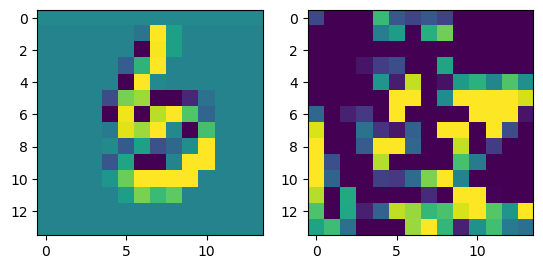

prediction: tensor([3, 5, 2]), tensor([6.2646, 4.7170, 2.4593]) groudtruth: 5
-0.0719493 0.096113995


<Figure size 640x480 with 0 Axes>

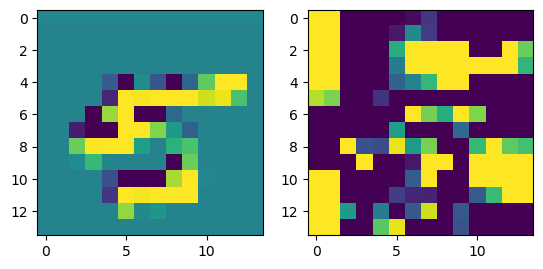

prediction: tensor([3, 4, 5]), tensor([3.1868, 1.9855, 1.3127]) groudtruth: 4
-0.08630115 0.10243789


<Figure size 640x480 with 0 Axes>

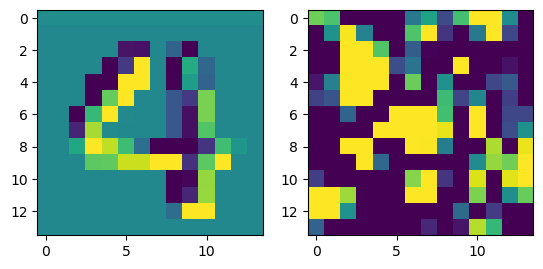

prediction: tensor([7, 9, 6]), tensor([2.9823, 1.0195, 0.8971]) groudtruth: 9
-0.08845025 0.098893836


<Figure size 640x480 with 0 Axes>

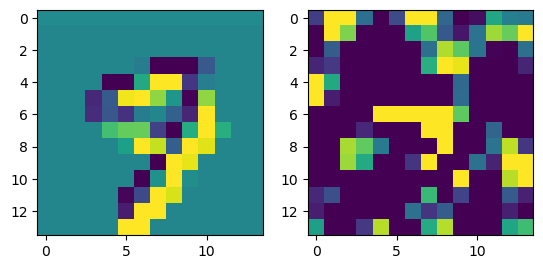

prediction: tensor([8, 3, 0]), tensor([2.9604, 2.9582, 2.8879]) groudtruth: 3
-0.08892059 0.075288124


<Figure size 640x480 with 0 Axes>

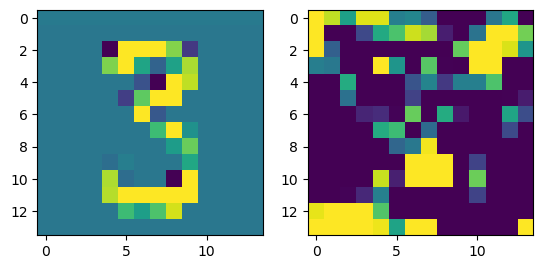

prediction: tensor([5, 3, 8]), tensor([5.1813, 1.5420, 1.1797]) groudtruth: 5
-0.08744365 0.08641432


<Figure size 640x480 with 0 Axes>

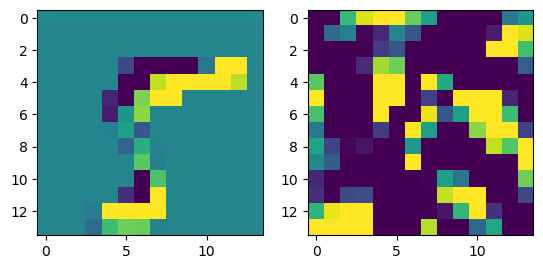

prediction: tensor([8, 9, 7]), tensor([2.7811, 1.7358, 1.0652]) groudtruth: 8
-0.066821575 0.10843614


<Figure size 640x480 with 0 Axes>

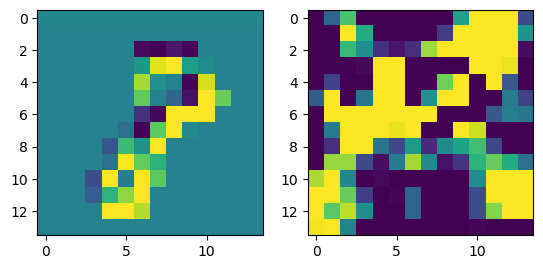

prediction: tensor([6, 7, 0]), tensor([1.9487, 1.7383, 0.8717]) groudtruth: 6
-0.08083892 0.06995521


<Figure size 640x480 with 0 Axes>

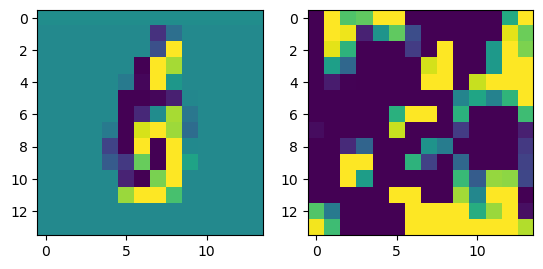

prediction: tensor([5, 9, 3]), tensor([4.3333, 1.7698, 1.6948]) groudtruth: 5
-0.10289383 0.1251054


<Figure size 640x480 with 0 Axes>

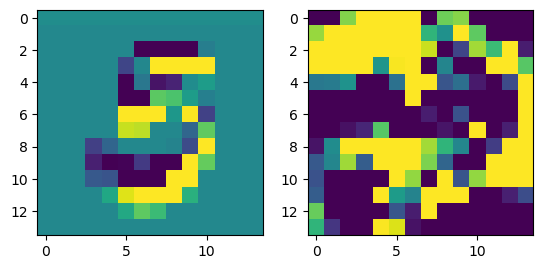

prediction: tensor([7, 2, 9]), tensor([2.7807, 1.2178, 0.8046]) groudtruth: 7
-0.092746556 0.056723006


<Figure size 640x480 with 0 Axes>

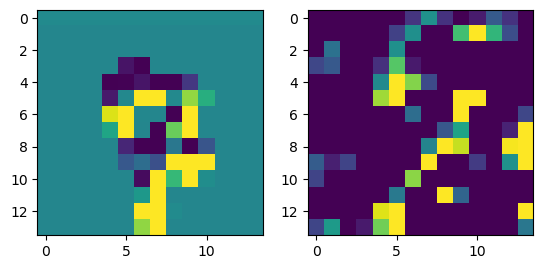

prediction: tensor([6, 8, 5]), tensor([5.4690, 2.0129, 1.5642]) groudtruth: 6
-0.0703603 0.07448688


<Figure size 640x480 with 0 Axes>

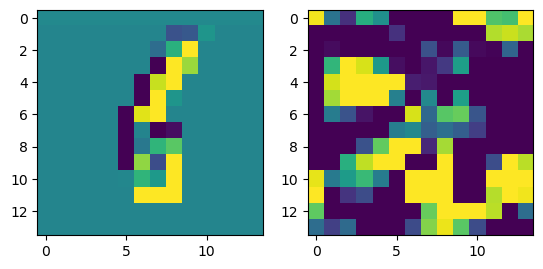

prediction: tensor([3, 7, 9]), tensor([3.2229, 1.0574, 0.5037]) groudtruth: 3
-0.08825582 0.08821131


<Figure size 640x480 with 0 Axes>

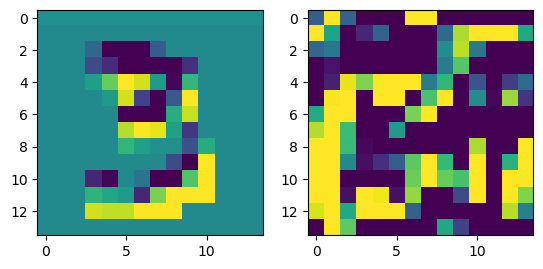

prediction: tensor([3, 2, 9]), tensor([5.9110, 1.2899, 0.4851]) groudtruth: 3
-0.105846286 0.09909123


<Figure size 640x480 with 0 Axes>

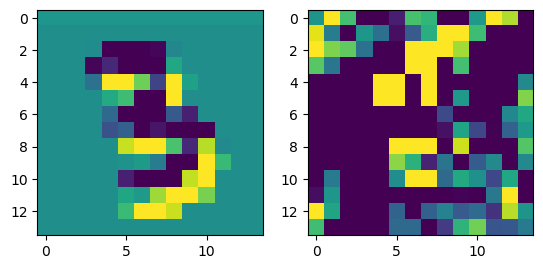

prediction: tensor([9, 2, 3]), tensor([3.4202, 1.6827, 0.8254]) groudtruth: 9
-0.10435593 0.097735316


<Figure size 640x480 with 0 Axes>

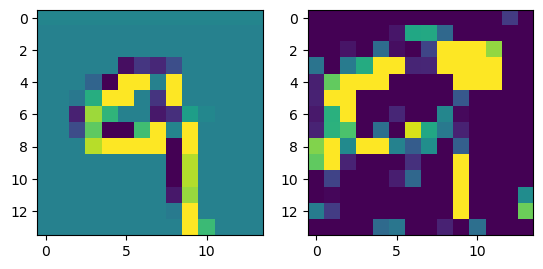

prediction: tensor([6, 4, 7]), tensor([2.2823, 1.8941, 1.8357]) groudtruth: 6
-0.08461732 0.101795234


<Figure size 640x480 with 0 Axes>

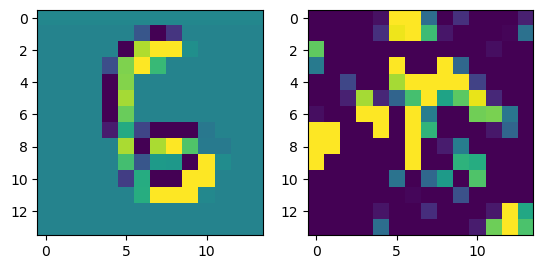

prediction: tensor([1, 2, 7]), tensor([6.7506, 0.3965, 0.3696]) groudtruth: 1
-0.07663655 0.095560774


<Figure size 640x480 with 0 Axes>

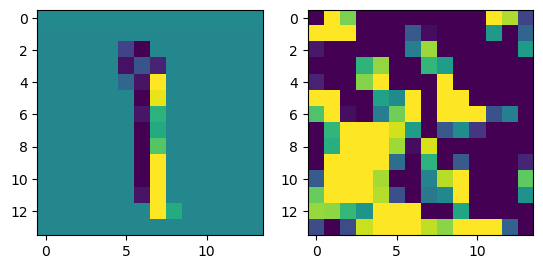

prediction: tensor([1, 0, 5]), tensor([5.6398, 1.0704, 0.9273]) groudtruth: 1
-0.09026933 0.08301232


<Figure size 640x480 with 0 Axes>

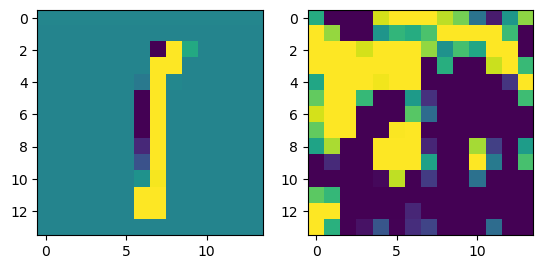

prediction: tensor([2, 3, 5]), tensor([ 5.2035,  1.8441, -0.2687]) groudtruth: 2
-0.10036111 0.10035348


<Figure size 640x480 with 0 Axes>

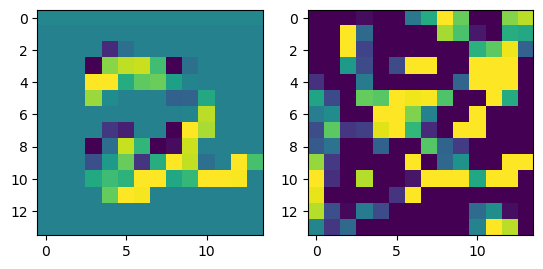

prediction: tensor([8, 9, 3]), tensor([3.6939, 3.6654, 2.5641]) groudtruth: 9
-0.09792513 0.09447079


<Figure size 640x480 with 0 Axes>

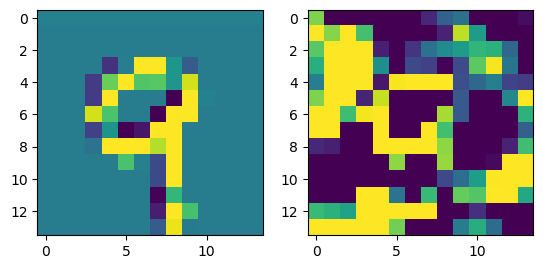

prediction: tensor([0, 6, 5]), tensor([5.0809, 1.6012, 1.1687]) groudtruth: 0
-0.07484543 0.06755298


<Figure size 640x480 with 0 Axes>

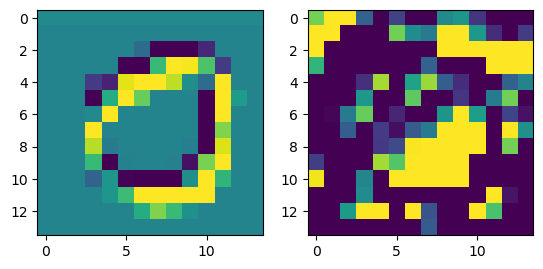

prediction: tensor([9, 6, 8]), tensor([3.7729, 2.3863, 0.2880]) groudtruth: 6
-0.053854942 0.06685168


<Figure size 640x480 with 0 Axes>

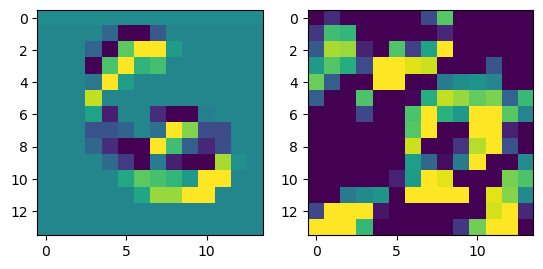

prediction: tensor([6, 0, 4]), tensor([4.0933, 1.0240, 0.4370]) groudtruth: 6
-0.063008666 0.07936889


<Figure size 640x480 with 0 Axes>

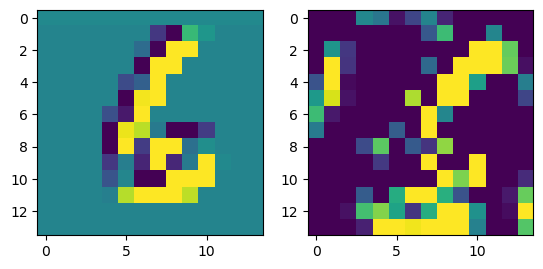

prediction: tensor([7, 1, 0]), tensor([1.7046, 1.5117, 1.4952]) groudtruth: 2
-0.091902316 0.11610123


<Figure size 640x480 with 0 Axes>

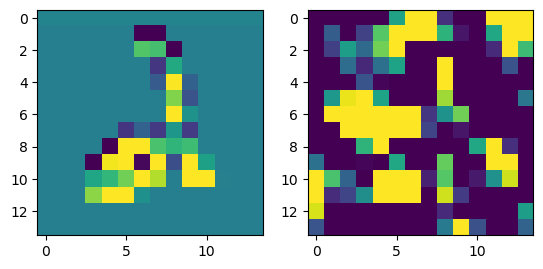

prediction: tensor([3, 9, 0]), tensor([4.0139, 1.9609, 0.2003]) groudtruth: 3
-0.08274895 0.0860754


<Figure size 640x480 with 0 Axes>

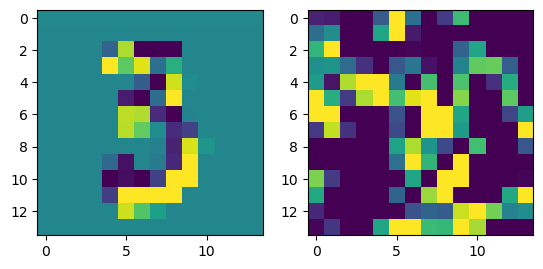

prediction: tensor([8, 0, 1]), tensor([2.2287, 1.9360, 1.5273]) groudtruth: 7
-0.08522934 0.08331375


<Figure size 640x480 with 0 Axes>

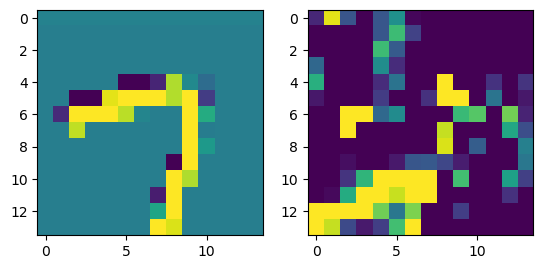

prediction: tensor([8, 2, 4]), tensor([4.8228, 1.4077, 0.5267]) groudtruth: 8
-0.097090304 0.08564104


<Figure size 640x480 with 0 Axes>

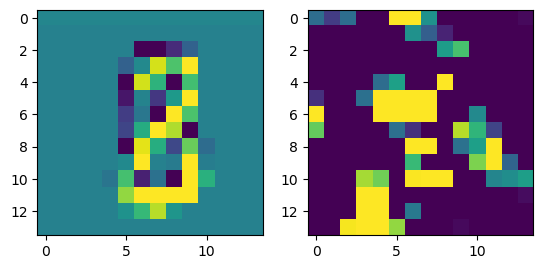

prediction: tensor([4, 6, 3]), tensor([3.6981, 0.5631, 0.4978]) groudtruth: 4
-0.08488953 0.09433362


<Figure size 640x480 with 0 Axes>

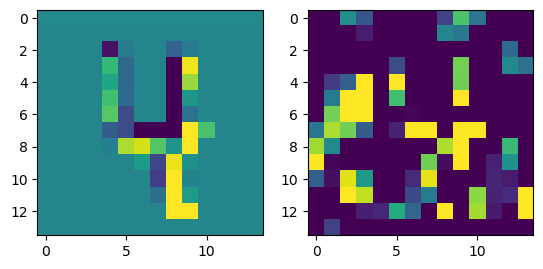

prediction: tensor([2, 7, 9]), tensor([2.8081, 2.0738, 1.7422]) groudtruth: 7
-0.08104533 0.0765716


<Figure size 640x480 with 0 Axes>

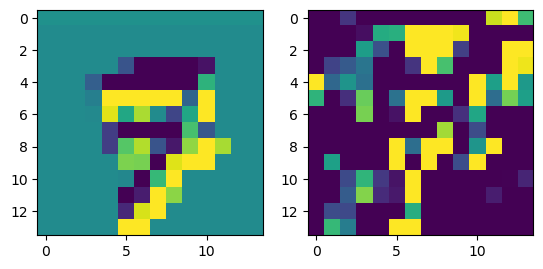

prediction: tensor([7, 6, 2]), tensor([6.0492, 1.9400, 1.0899]) groudtruth: 7
-0.06589675 0.08269282


<Figure size 640x480 with 0 Axes>

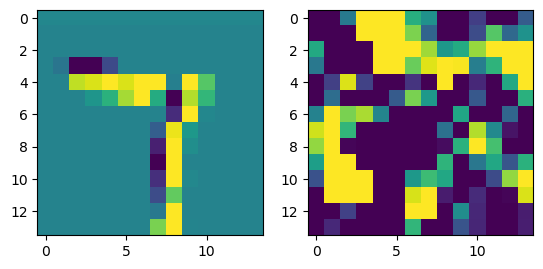

prediction: tensor([9, 3, 4]), tensor([5.0566, 3.3833, 2.7551]) groudtruth: 9
-0.0977692 0.08291795


<Figure size 640x480 with 0 Axes>

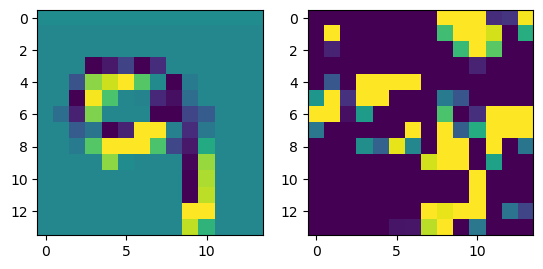

prediction: tensor([2, 9, 7]), tensor([3.2538, 1.1120, 1.0348]) groudtruth: 2
-0.08159053 0.122180864


<Figure size 640x480 with 0 Axes>

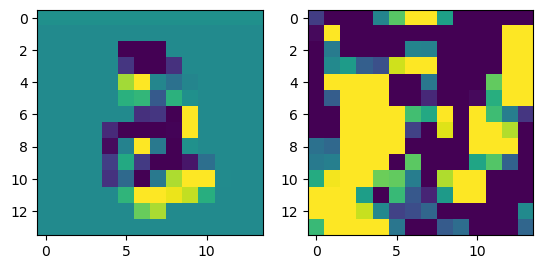

prediction: tensor([4, 7, 9]), tensor([2.5489, 1.5407, 1.0049]) groudtruth: 4
-0.06481695 0.07771319


<Figure size 640x480 with 0 Axes>

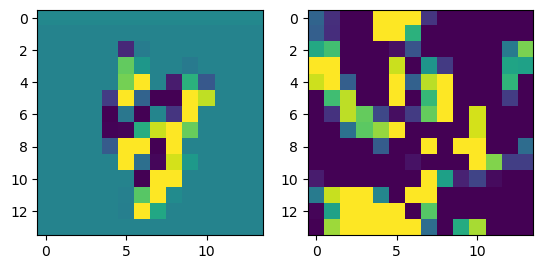

prediction: tensor([1, 7, 3]), tensor([4.9327, 0.1898, 0.1405]) groudtruth: 1
-0.08754063 0.08191837


<Figure size 640x480 with 0 Axes>

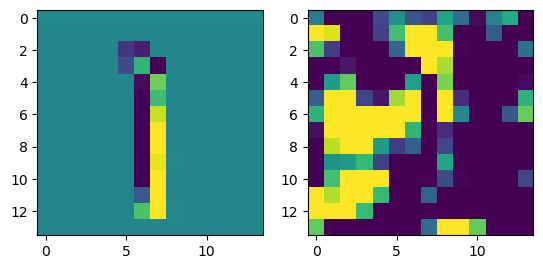

prediction: tensor([6, 4, 2]), tensor([4.2027, 2.2919, 1.1030]) groudtruth: 4
-0.103260815 0.07555249


<Figure size 640x480 with 0 Axes>

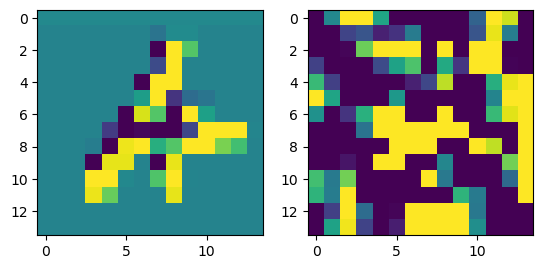

prediction: tensor([5, 3, 6]), tensor([4.6989, 2.5663, 2.2703]) groudtruth: 5
-0.06415796 0.09714099


<Figure size 640x480 with 0 Axes>

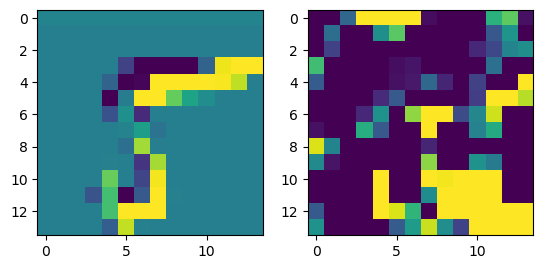

prediction: tensor([8, 9, 7]), tensor([3.2269, 2.8468, 2.2556]) groudtruth: 2
-0.09091157 0.08741852


<Figure size 640x480 with 0 Axes>

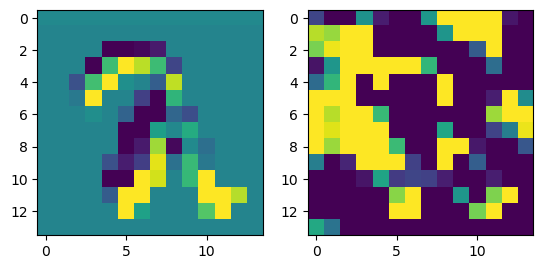

prediction: tensor([3, 5, 4]), tensor([4.9874, 1.5929, 0.8246]) groudtruth: 3
-0.09957951 0.10344717


<Figure size 640x480 with 0 Axes>

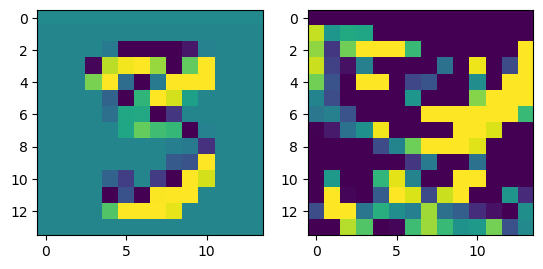

prediction: tensor([7, 3, 0]), tensor([3.1025, 2.9719, 1.0631]) groudtruth: 3
-0.09981853 0.11407912


<Figure size 640x480 with 0 Axes>

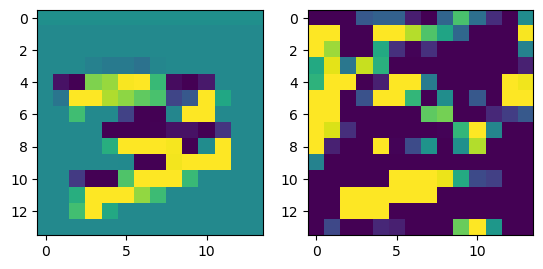

prediction: tensor([6, 8, 9]), tensor([4.4755, 1.3607, 0.6618]) groudtruth: 6
-0.0635407 0.0779873


<Figure size 640x480 with 0 Axes>

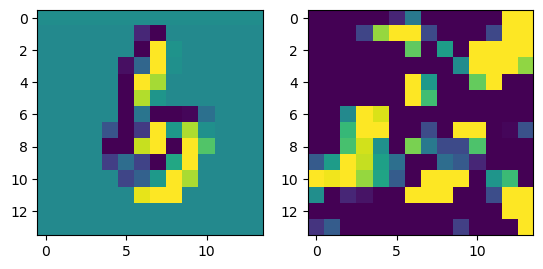

prediction: tensor([1, 8, 2]), tensor([6.7423, 1.8393, 1.4089]) groudtruth: 1
-0.06180066 0.07310873


<Figure size 640x480 with 0 Axes>

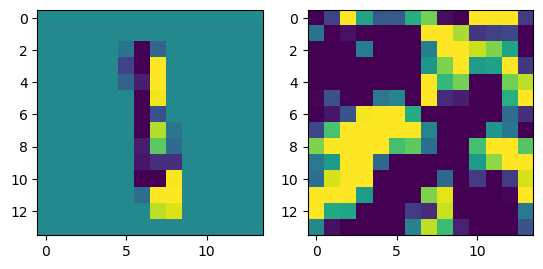

prediction: tensor([2, 9, 3]), tensor([3.2994, 1.8679, 1.2046]) groudtruth: 2
-0.100390494 0.09706688


<Figure size 640x480 with 0 Axes>

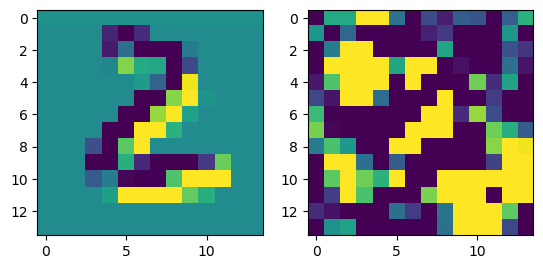

prediction: tensor([3, 8, 0]), tensor([4.4866, 1.9070, 0.4901]) groudtruth: 3
-0.108400404 0.079950914


<Figure size 640x480 with 0 Axes>

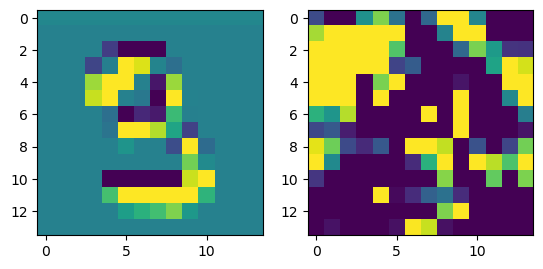

prediction: tensor([7, 9, 0]), tensor([2.3816, 1.7076, 1.1067]) groudtruth: 7
-0.066527426 0.1009427


<Figure size 640x480 with 0 Axes>

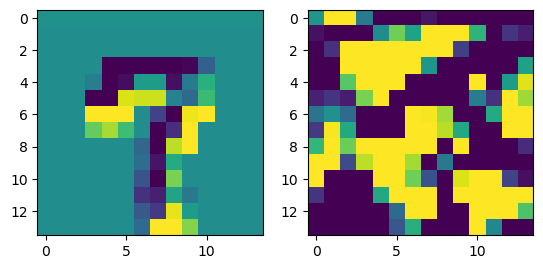

prediction: tensor([4, 3, 2]), tensor([2.5561, 1.2314, 0.7113]) groudtruth: 3
-0.07720333 0.10125089


<Figure size 640x480 with 0 Axes>

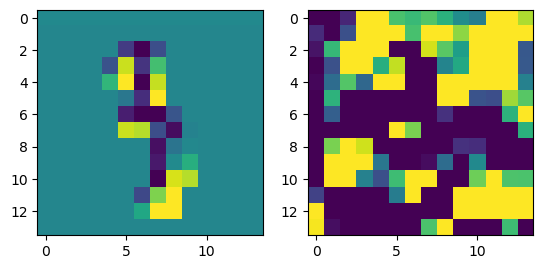

prediction: tensor([3, 6, 5]), tensor([3.3425, 1.7033, 1.3218]) groudtruth: 3
-0.06964737 0.0892387


<Figure size 640x480 with 0 Axes>

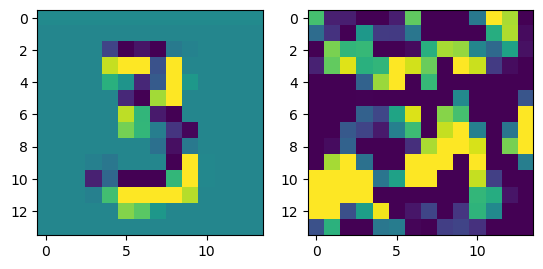

prediction: tensor([5, 0, 6]), tensor([4.0145, 1.3342, 1.3278]) groudtruth: 2
-0.12830162 0.12814745


<Figure size 640x480 with 0 Axes>

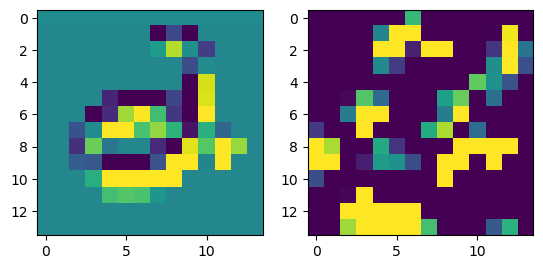

prediction: tensor([0, 8, 9]), tensor([7.1293, 1.2283, 0.3424]) groudtruth: 0
-0.06203574 0.07035749


<Figure size 640x480 with 0 Axes>

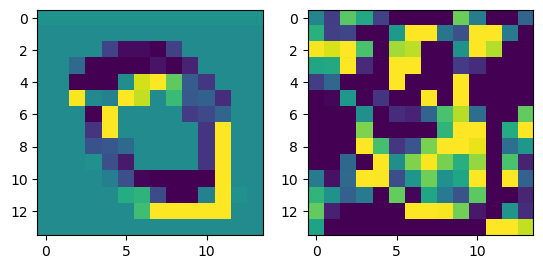

prediction: tensor([8, 3, 2]), tensor([3.5978, 1.9531, 0.8955]) groudtruth: 3
-0.085072696 0.097892374


<Figure size 640x480 with 0 Axes>

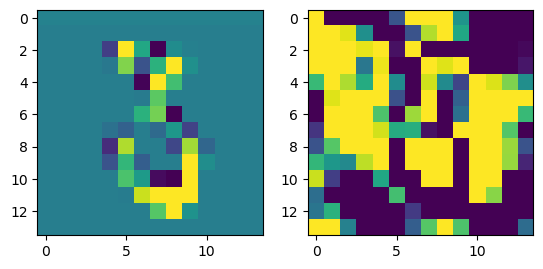

prediction: tensor([3, 9, 5]), tensor([2.3005, 1.5491, 0.8561]) groudtruth: 3
-0.10163456 0.07991286


<Figure size 640x480 with 0 Axes>

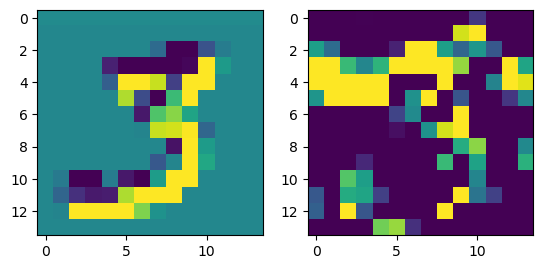

prediction: tensor([8, 1, 4]), tensor([5.2833, 2.3842, 1.0918]) groudtruth: 8
-0.072398424 0.08384581


<Figure size 640x480 with 0 Axes>

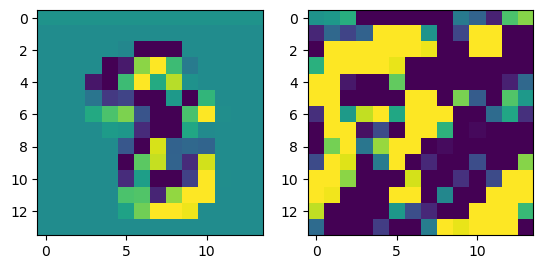

prediction: tensor([7, 4, 0]), tensor([2.4697, 1.8344, 1.7140]) groudtruth: 4
-0.10052812 0.10302368


<Figure size 640x480 with 0 Axes>

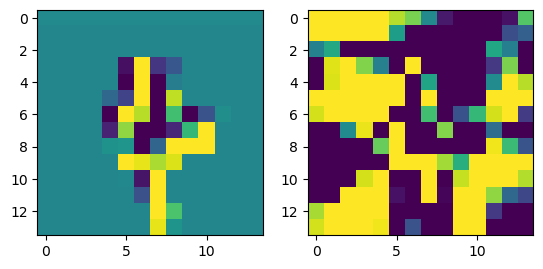

prediction: tensor([3, 9, 2]), tensor([5.5208, 2.8633, 0.7985]) groudtruth: 3
-0.0902344 0.102136955


<Figure size 640x480 with 0 Axes>

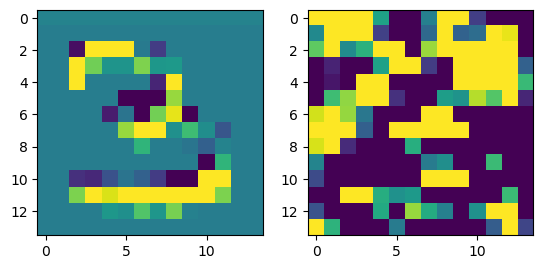

prediction: tensor([8, 2, 1]), tensor([3.2650, 2.0225, 0.4770]) groudtruth: 8
-0.071647406 0.08757199


<Figure size 640x480 with 0 Axes>

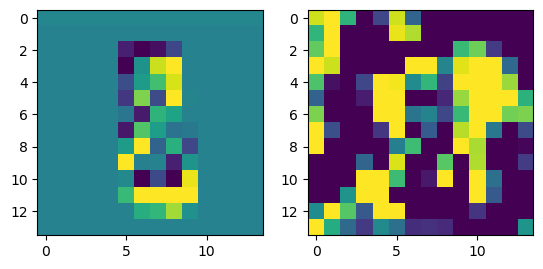

prediction: tensor([4, 5, 8]), tensor([5.7487, 0.5291, 0.2902]) groudtruth: 4
-0.081100166 0.079487234


<Figure size 640x480 with 0 Axes>

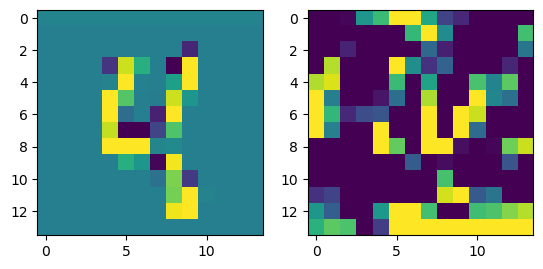

prediction: tensor([9, 3, 8]), tensor([5.8428, 2.2353, 1.8195]) groudtruth: 9
-0.07285267 0.09795293


<Figure size 640x480 with 0 Axes>

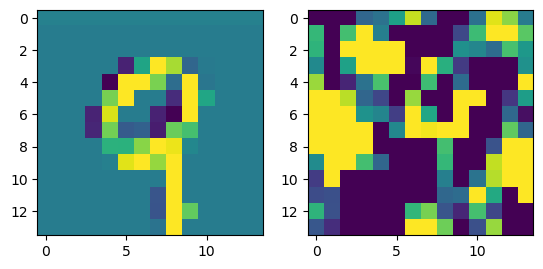

prediction: tensor([1, 9, 2]), tensor([4.4149, 1.2338, 0.3574]) groudtruth: 1
-0.078036964 0.08306013


<Figure size 640x480 with 0 Axes>

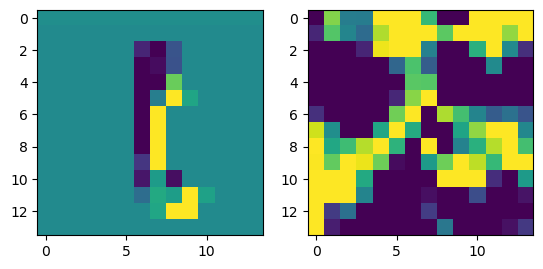

prediction: tensor([9, 4, 3]), tensor([3.6306, 1.2571, 0.8950]) groudtruth: 9
-0.07438558 0.064433105


<Figure size 640x480 with 0 Axes>

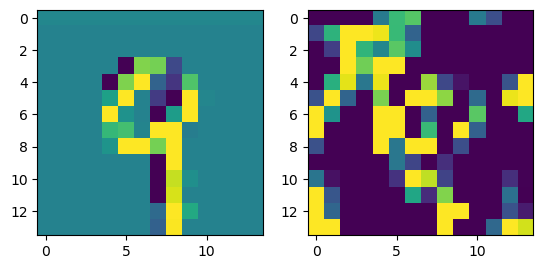

prediction: tensor([3, 8, 9]), tensor([3.3060, 2.9698, 1.5871]) groudtruth: 8
-0.09124881 0.09596592


<Figure size 640x480 with 0 Axes>

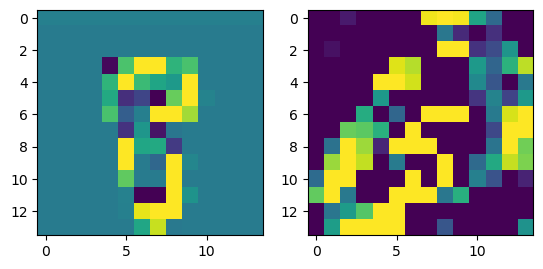

prediction: tensor([5, 8, 0]), tensor([6.9397, 2.0781, 1.3918]) groudtruth: 5
-0.06774145 0.058787934


<Figure size 640x480 with 0 Axes>

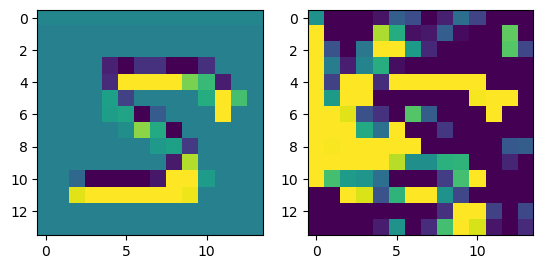

prediction: tensor([7, 9, 3]), tensor([3.8481, 1.6255, 0.6541]) groudtruth: 7
-0.098026514 0.09466935


<Figure size 640x480 with 0 Axes>

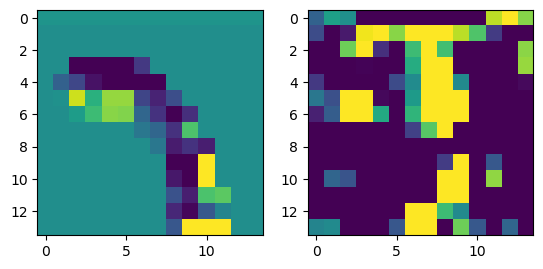

prediction: tensor([5, 7, 6]), tensor([4.9707, 2.3277, 1.5466]) groudtruth: 5
-0.11899036 0.08766603


<Figure size 640x480 with 0 Axes>

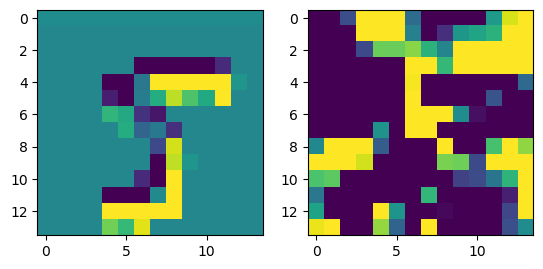

prediction: tensor([1, 8, 9]), tensor([3.6393, 0.6629, 0.6306]) groudtruth: 1
-0.06823295 0.083310395


<Figure size 640x480 with 0 Axes>

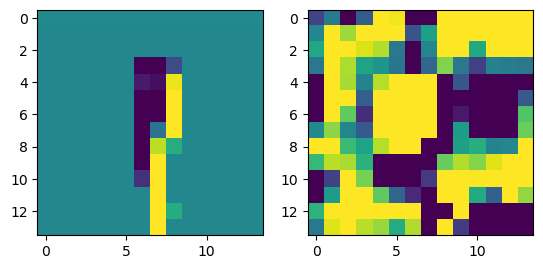

prediction: tensor([1, 9, 7]), tensor([5.2876, 1.4020, 0.1187]) groudtruth: 1
-0.10995424 0.069723725


<Figure size 640x480 with 0 Axes>

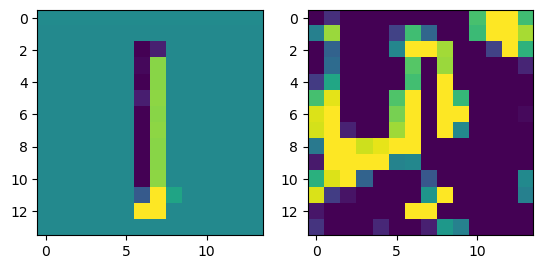

prediction: tensor([8, 3, 9]), tensor([4.6005, 1.4343, 1.0297]) groudtruth: 8
-0.078199506 0.07971217


<Figure size 640x480 with 0 Axes>

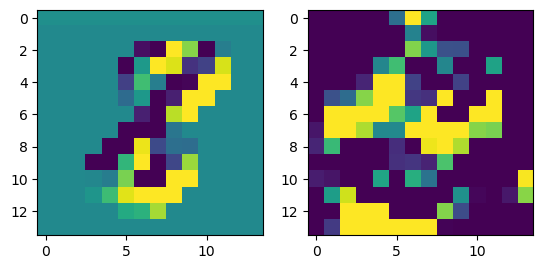

prediction: tensor([6, 7, 8]), tensor([3.3244, 1.1407, 0.9424]) groudtruth: 6
-0.12443107 0.084022395


<Figure size 640x480 with 0 Axes>

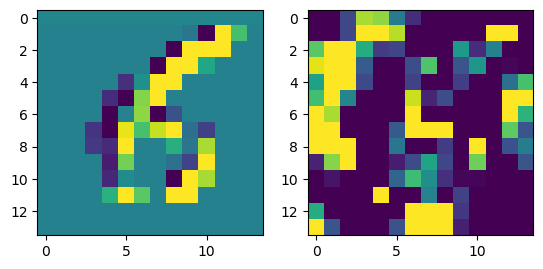

prediction: tensor([5, 8, 4]), tensor([8.0764, 2.0061, 1.9369]) groudtruth: 5
-0.049531877 0.091588534


<Figure size 640x480 with 0 Axes>

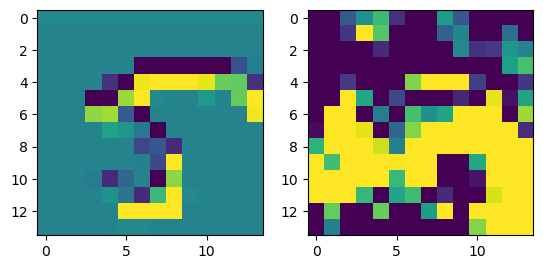

prediction: tensor([9, 4, 0]), tensor([2.4720, 1.7210, 1.6754]) groudtruth: 2
-0.07901198 0.09743399


<Figure size 640x480 with 0 Axes>

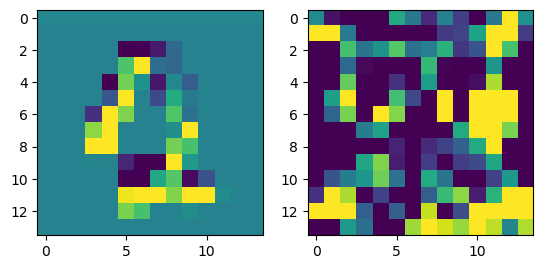

prediction: tensor([4, 5, 6]), tensor([4.5667, 1.1404, 0.9455]) groudtruth: 4
-0.11874634 0.090934664


<Figure size 640x480 with 0 Axes>

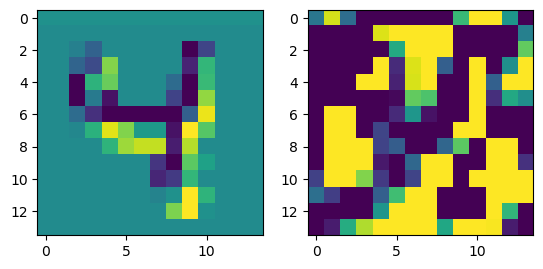

prediction: tensor([1, 9, 3]), tensor([4.3606, 1.7580, 0.5411]) groudtruth: 1
-0.08737385 0.108387515


<Figure size 640x480 with 0 Axes>

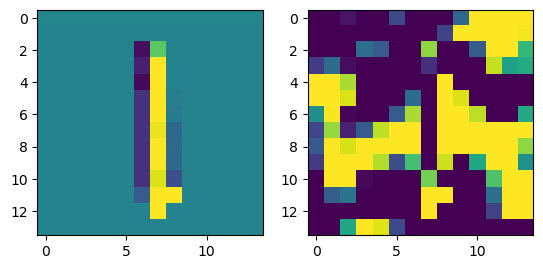

prediction: tensor([1, 9, 2]), tensor([3.8806, 2.0615, 1.2305]) groudtruth: 1
-0.10136187 0.123232394


<Figure size 640x480 with 0 Axes>

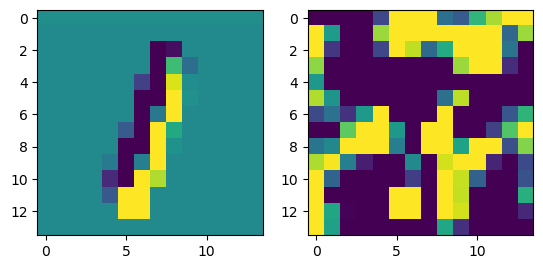

prediction: tensor([3, 5, 1]), tensor([4.8392, 2.5764, 1.7109]) groudtruth: 3
-0.10558158 0.07732305


<Figure size 640x480 with 0 Axes>

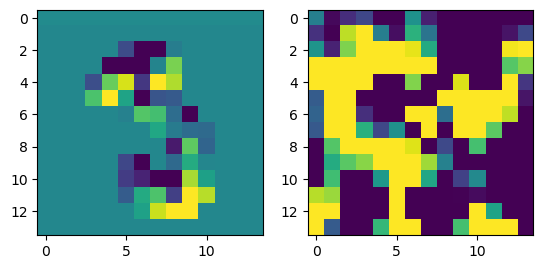

prediction: tensor([3, 8, 2]), tensor([3.9496, 1.9327, 1.2059]) groudtruth: 3
-0.09437275 0.08221167


<Figure size 640x480 with 0 Axes>

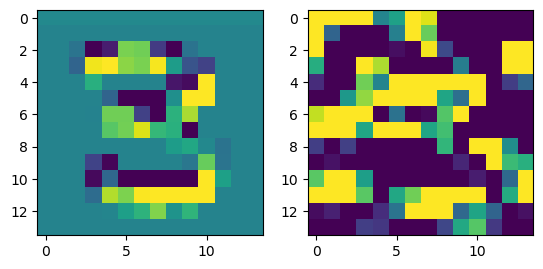

prediction: tensor([9, 3, 0]), tensor([2.8095, 1.5055, 1.4723]) groudtruth: 9
-0.10872114 0.105195366


<Figure size 640x480 with 0 Axes>

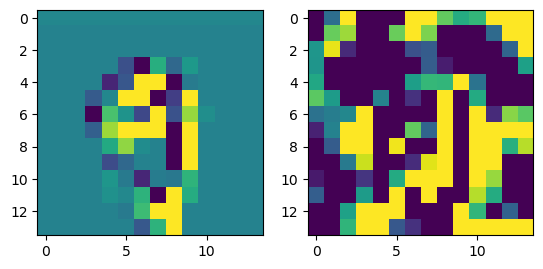

prediction: tensor([6, 9, 0]), tensor([4.0054, 0.8546, 0.6774]) groudtruth: 6
-0.068128884 0.08285908


<Figure size 640x480 with 0 Axes>

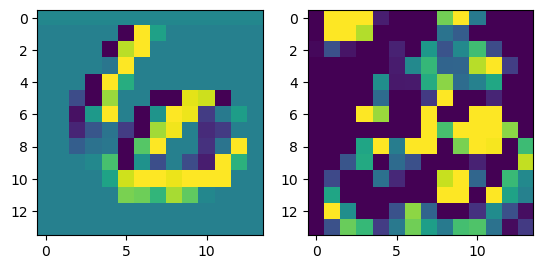

prediction: tensor([7, 0, 6]), tensor([3.5353, 1.9605, 1.8784]) groudtruth: 7
-0.10732061 0.111123346


<Figure size 640x480 with 0 Axes>

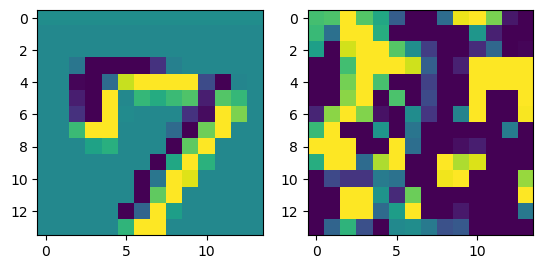

prediction: tensor([4, 3, 8]), tensor([2.8154, 1.7854, 1.1945]) groudtruth: 4
-0.08018398 0.0746953


<Figure size 640x480 with 0 Axes>

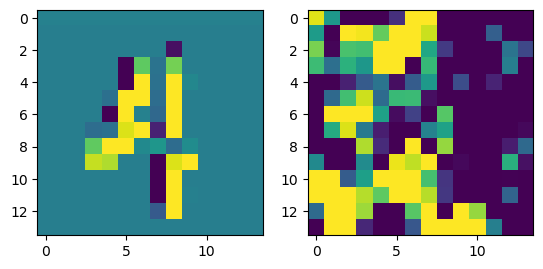

prediction: tensor([1, 4, 8]), tensor([4.7393, 2.3793, 1.8964]) groudtruth: 1
-0.0695498 0.088501796


<Figure size 640x480 with 0 Axes>

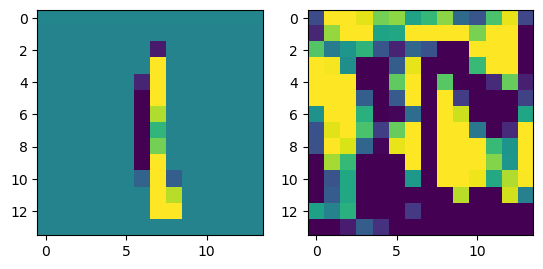

prediction: tensor([3, 5, 8]), tensor([3.9425, 3.4036, 1.2266]) groudtruth: 5
-0.096419394 0.11872287


<Figure size 640x480 with 0 Axes>

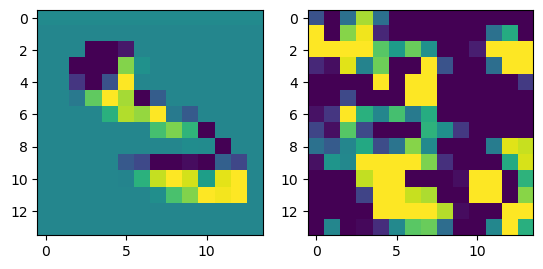

prediction: tensor([3, 9, 2]), tensor([3.9250, 1.1511, 0.6263]) groudtruth: 3
-0.07923025 0.09162784


<Figure size 640x480 with 0 Axes>

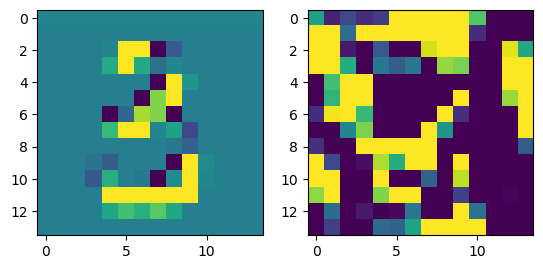

prediction: tensor([0, 6, 7]), tensor([3.8192, 2.8582, 1.6146]) groudtruth: 0
-0.1034683 0.049200386


<Figure size 640x480 with 0 Axes>

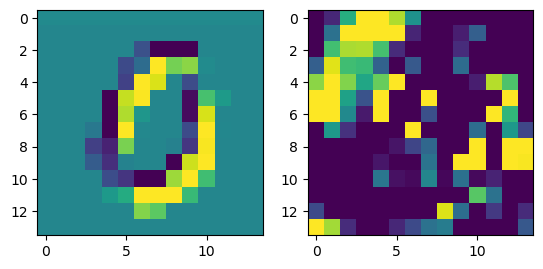

prediction: tensor([2, 8, 0]), tensor([4.0508, 2.9870, 1.6221]) groudtruth: 8
-0.0848155 0.0677308


<Figure size 640x480 with 0 Axes>

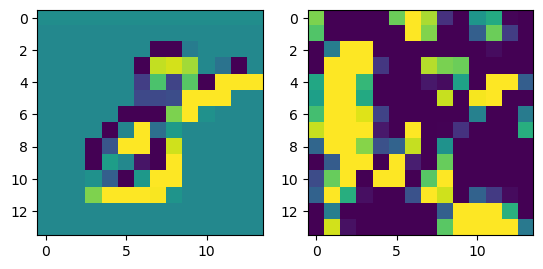

prediction: tensor([7, 1, 4]), tensor([3.3741, 1.4019, 1.3352]) groudtruth: 7
-0.08644271 0.08589362


<Figure size 640x480 with 0 Axes>

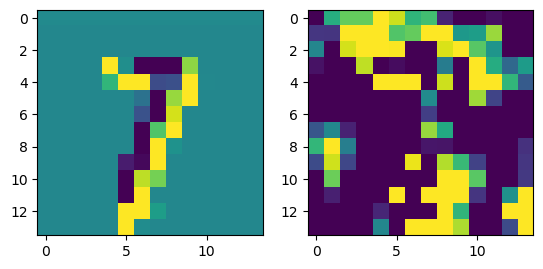

prediction: tensor([3, 6, 8]), tensor([5.6514, 2.0746, 0.6875]) groudtruth: 3
-0.082221806 0.104675576


<Figure size 640x480 with 0 Axes>

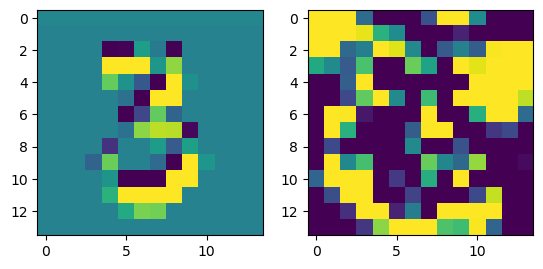

prediction: tensor([9, 6, 7]), tensor([3.1161, 1.6591, 1.2390]) groudtruth: 9
-0.079907775 0.07044253


<Figure size 640x480 with 0 Axes>

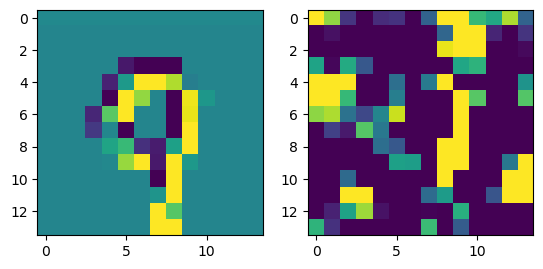

prediction: tensor([7, 2, 9]), tensor([5.2605, 2.5133, 0.9163]) groudtruth: 7
-0.06356329 0.06505381


<Figure size 640x480 with 0 Axes>

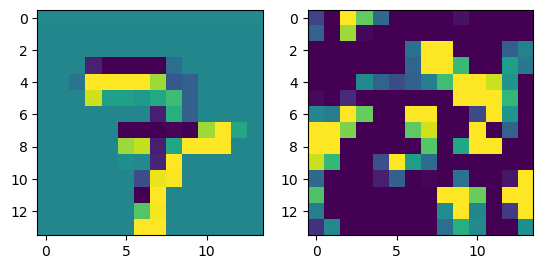

prediction: tensor([9, 3, 7]), tensor([3.9388, 1.9200, 1.2149]) groudtruth: 9
-0.0878557 0.067599736


<Figure size 640x480 with 0 Axes>

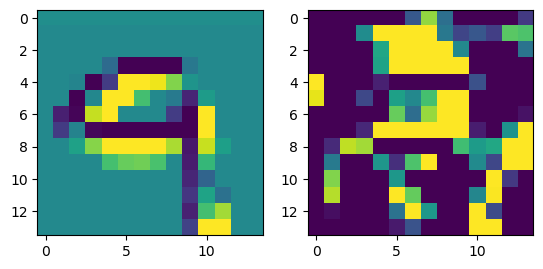

prediction: tensor([0, 6, 2]), tensor([3.2425, 2.6797, 2.0060]) groudtruth: 0
-0.1005308 0.0839126


<Figure size 640x480 with 0 Axes>

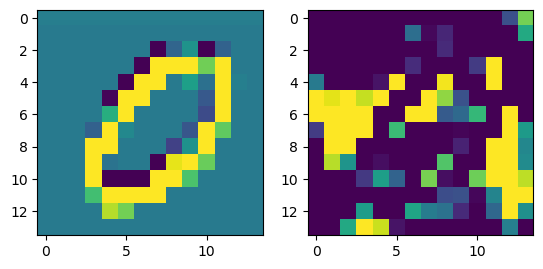

prediction: tensor([2, 7, 6]), tensor([5.4629, 0.8159, 0.5250]) groudtruth: 2
-0.07286328 0.07836669


<Figure size 640x480 with 0 Axes>

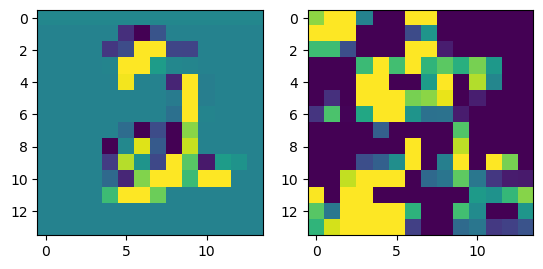

prediction: tensor([0, 6, 3]), tensor([4.5721, 1.2218, 0.8642]) groudtruth: 0
-0.080726445 0.08393608


<Figure size 640x480 with 0 Axes>

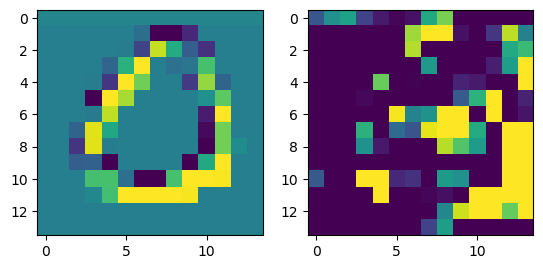

prediction: tensor([3, 9, 4]), tensor([2.5744, 1.5037, 0.2155]) groudtruth: 3
-0.06267089 0.07747017


<Figure size 640x480 with 0 Axes>

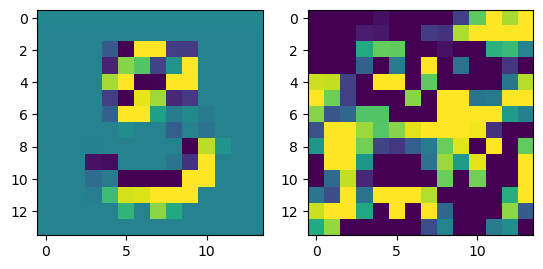

prediction: tensor([3, 5, 2]), tensor([3.0820, 1.9369, 1.1747]) groudtruth: 3
-0.087262094 0.08911407


<Figure size 640x480 with 0 Axes>

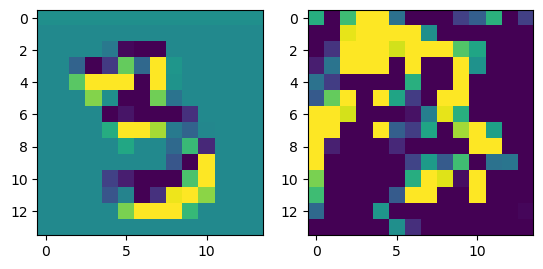

prediction: tensor([7, 2, 0]), tensor([4.5132, 1.9064, 0.6277]) groudtruth: 7
-0.11609852 0.1140798


<Figure size 640x480 with 0 Axes>

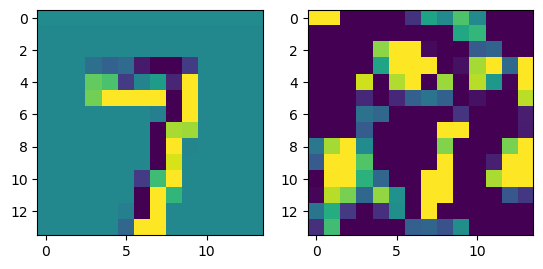

prediction: tensor([4, 9, 6]), tensor([2.3125, 1.9406, 1.2319]) groudtruth: 6
-0.06340623 0.07814883


<Figure size 640x480 with 0 Axes>

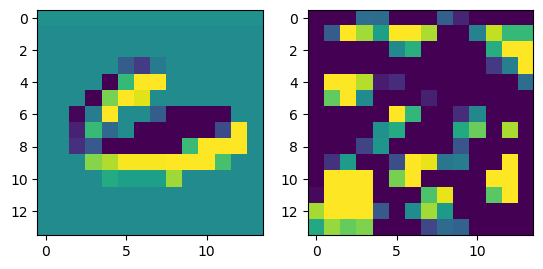

prediction: tensor([9, 7, 1]), tensor([5.7805, 3.5274, 0.6411]) groudtruth: 9
-0.05519104 0.0749858


<Figure size 640x480 with 0 Axes>

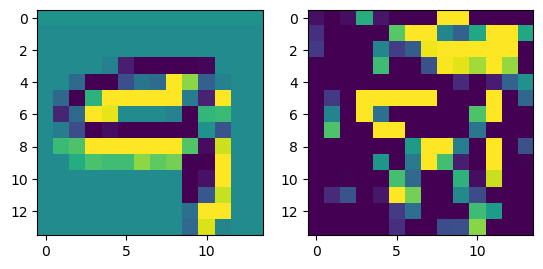

prediction: tensor([2, 7, 3]), tensor([4.2843, 1.1867, 0.4729]) groudtruth: 2
-0.09141904 0.07883291


<Figure size 640x480 with 0 Axes>

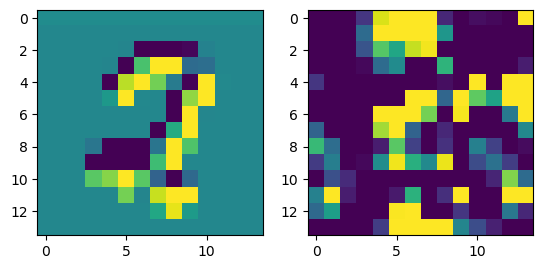

prediction: tensor([3, 9, 5]), tensor([4.0220, 2.2997, 1.8397]) groudtruth: 3
-0.09216827 0.07148366


<Figure size 640x480 with 0 Axes>

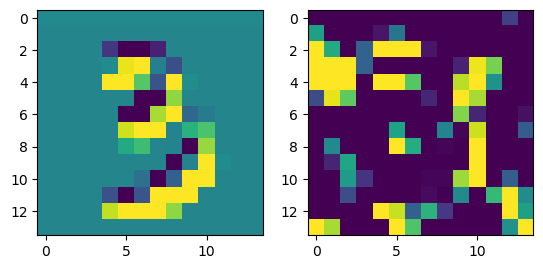

prediction: tensor([3, 2, 8]), tensor([4.8159, 2.0102, 1.5475]) groudtruth: 3
-0.0866102 0.1109775


<Figure size 640x480 with 0 Axes>

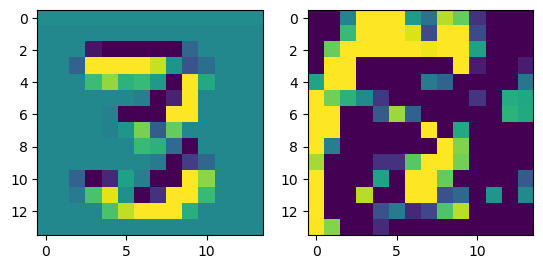

prediction: tensor([7, 0, 1]), tensor([4.3634, 4.1000, 2.5064]) groudtruth: 7
-0.07569498 0.10257234


<Figure size 640x480 with 0 Axes>

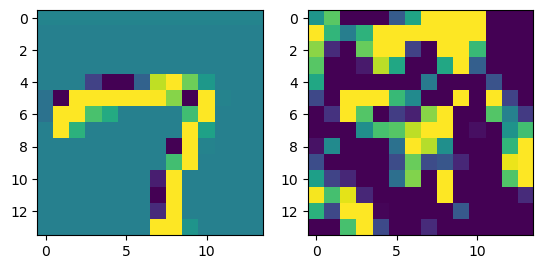

prediction: tensor([7, 3, 0]), tensor([4.5917, 2.3393, 0.8626]) groudtruth: 7
-0.08381122 0.075602785


<Figure size 640x480 with 0 Axes>

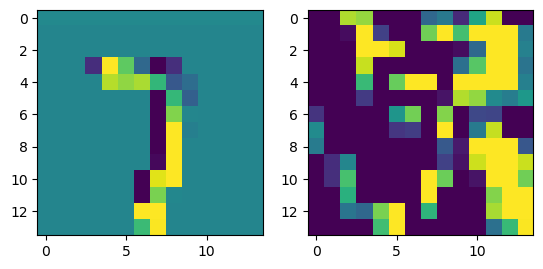

prediction: tensor([0, 9, 3]), tensor([2.7589, 1.9625, 1.4570]) groudtruth: 0
-0.084959745 0.08054836


<Figure size 640x480 with 0 Axes>

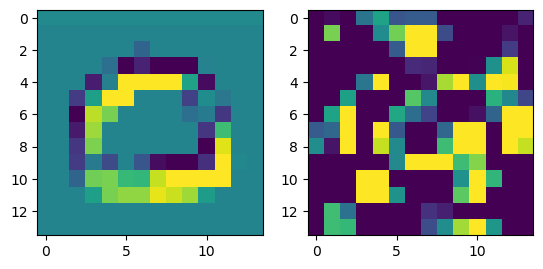

prediction: tensor([2, 3, 1]), tensor([2.7470, 1.8941, 1.7907]) groudtruth: 3
-0.07766706 0.07071393


<Figure size 640x480 with 0 Axes>

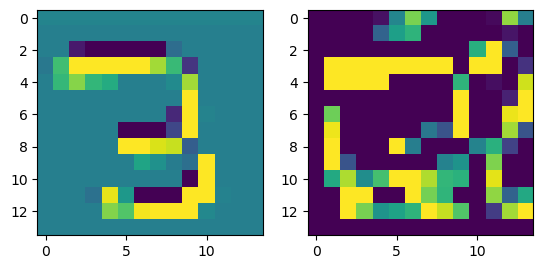

prediction: tensor([6, 4, 9]), tensor([4.0922, 2.5665, 2.2874]) groudtruth: 6
-0.06782496 0.071318574


<Figure size 640x480 with 0 Axes>

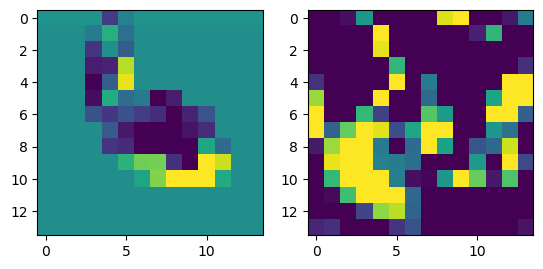

prediction: tensor([6, 2, 7]), tensor([4.2314, 1.9120, 1.0360]) groudtruth: 6
-0.09714347 0.054909457


<Figure size 640x480 with 0 Axes>

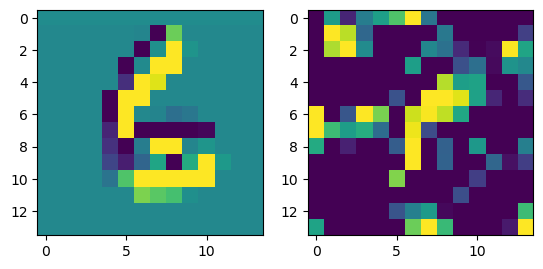

prediction: tensor([8, 5, 6]), tensor([3.2170, 1.9778, 1.9123]) groudtruth: 8
-0.08297938 0.09993897


<Figure size 640x480 with 0 Axes>

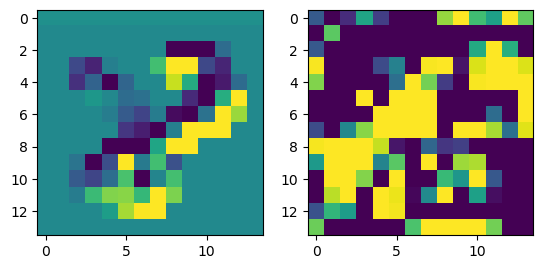

prediction: tensor([5, 3, 9]), tensor([6.7065, 1.7383, 1.5020]) groudtruth: 5
-0.094677806 0.090855


<Figure size 640x480 with 0 Axes>

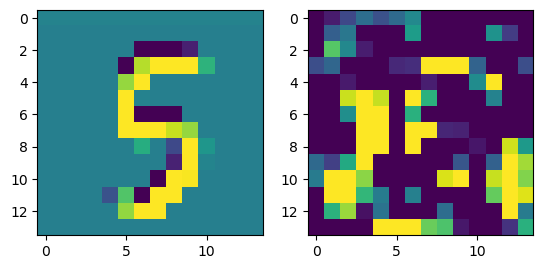

prediction: tensor([1, 2, 7]), tensor([5.4069, 2.0390, 0.6688]) groudtruth: 1
-0.09625143 0.06318197


<Figure size 640x480 with 0 Axes>

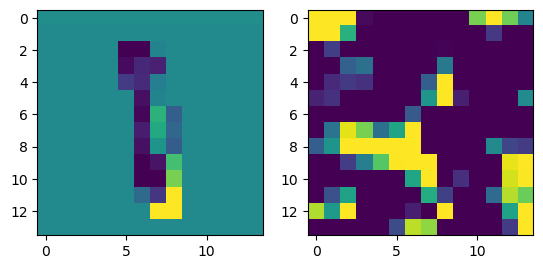

prediction: tensor([4, 8, 1]), tensor([3.8516, 1.9357, 0.3759]) groudtruth: 4
-0.07395363 0.0982414


<Figure size 640x480 with 0 Axes>

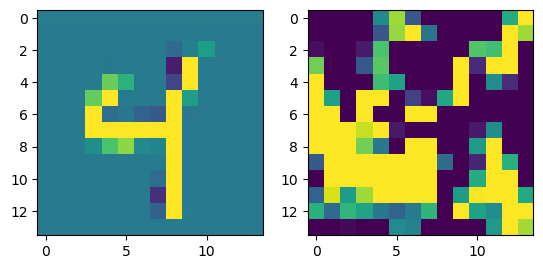

prediction: tensor([2, 3, 4]), tensor([7.2376, 2.4537, 2.2416]) groudtruth: 2
-0.10661161 0.06690813


<Figure size 640x480 with 0 Axes>

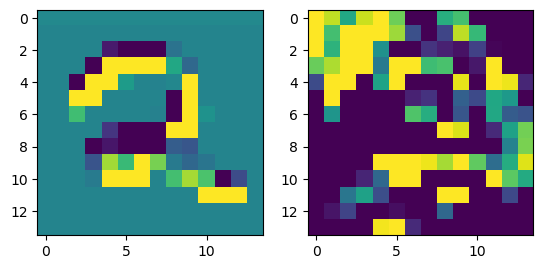

prediction: tensor([4, 1, 7]), tensor([4.1443, 2.8860, 1.4900]) groudtruth: 4
-0.065051615 0.10064386


<Figure size 640x480 with 0 Axes>

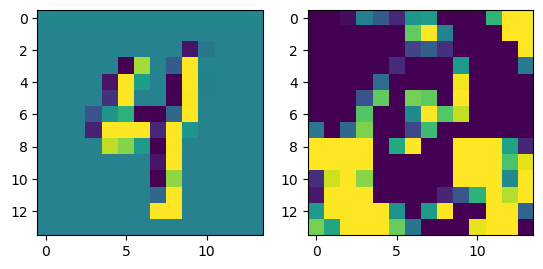

prediction: tensor([9, 4, 1]), tensor([4.3944, 2.6160, 1.6166]) groudtruth: 4
-0.071700156 0.08294983


<Figure size 640x480 with 0 Axes>

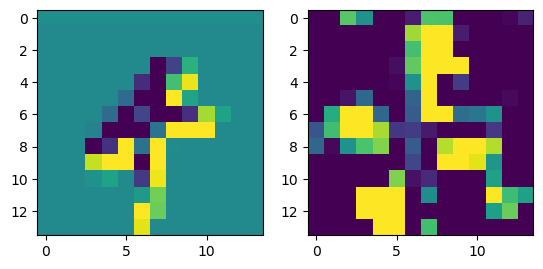

prediction: tensor([5, 8, 3]), tensor([3.6504, 3.2411, 1.9945]) groudtruth: 5
-0.060137987 0.10004451


<Figure size 640x480 with 0 Axes>

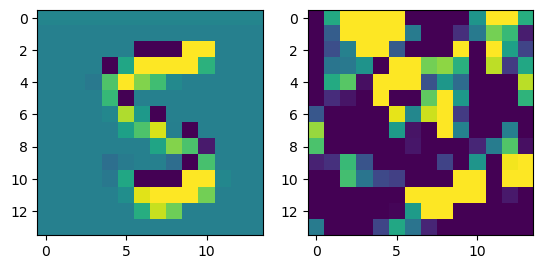

prediction: tensor([1, 9, 8]), tensor([ 5.1237,  0.4575, -0.1290]) groudtruth: 1
-0.092469335 0.07357056


<Figure size 640x480 with 0 Axes>

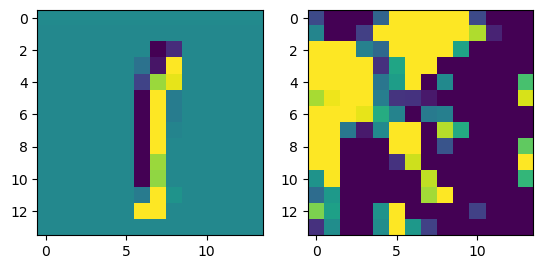

prediction: tensor([8, 1, 2]), tensor([3.7263, 1.9537, 1.0855]) groudtruth: 1
-0.06533158 0.07974764


<Figure size 640x480 with 0 Axes>

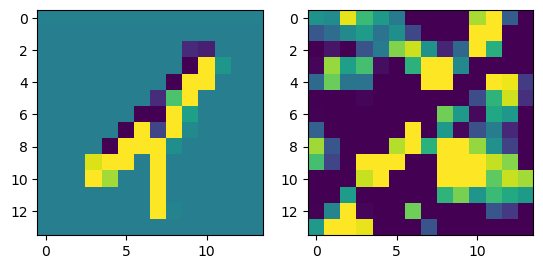

prediction: tensor([9, 7, 5]), tensor([5.1950, 1.0763, 0.8153]) groudtruth: 9
-0.10371739 0.10664238


<Figure size 640x480 with 0 Axes>

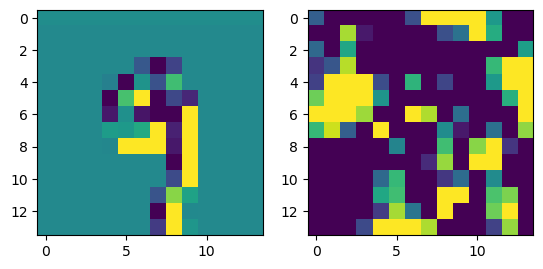

prediction: tensor([0, 5, 6]), tensor([6.2127, 1.7510, 1.3479]) groudtruth: 0
-0.08503473 0.062017463


<Figure size 640x480 with 0 Axes>

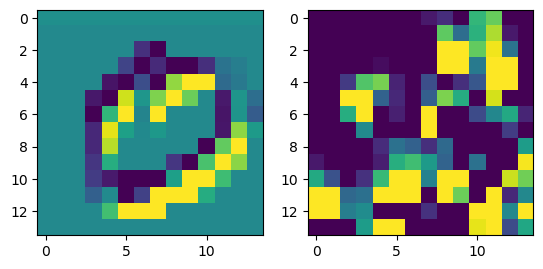

prediction: tensor([8, 9, 2]), tensor([1.5107, 0.9866, 0.9862]) groudtruth: 2
-0.07897961 0.0983313


<Figure size 640x480 with 0 Axes>

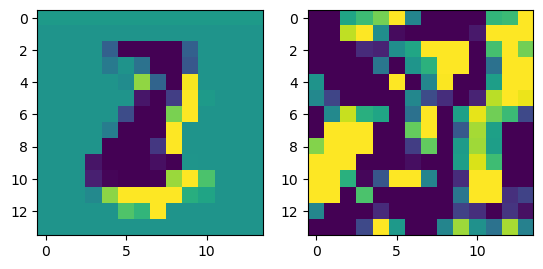

prediction: tensor([5, 4, 3]), tensor([4.1873, 4.1727, 2.5709]) groudtruth: 4
-0.07481873 0.07026178


<Figure size 640x480 with 0 Axes>

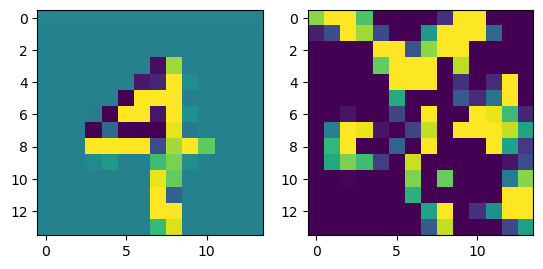

prediction: tensor([6, 0, 7]), tensor([4.1913, 0.8805, 0.5127]) groudtruth: 6
-0.08881539 0.08595582


<Figure size 640x480 with 0 Axes>

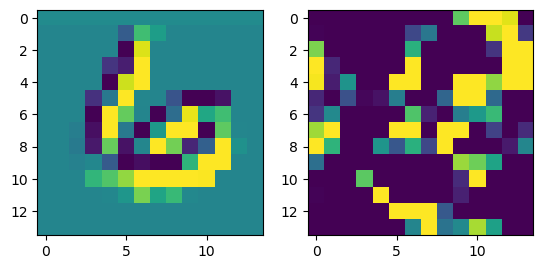

prediction: tensor([1, 7, 8]), tensor([6.5145, 1.5592, 1.4607]) groudtruth: 1
-0.11385125 0.10800845


<Figure size 640x480 with 0 Axes>

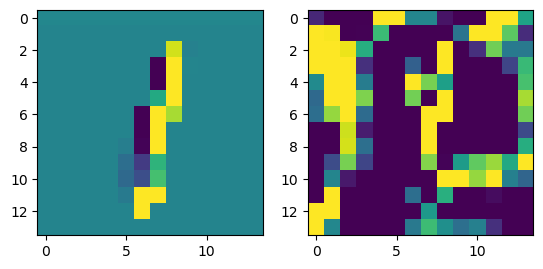

prediction: tensor([3, 9, 1]), tensor([4.0275, 2.3170, 0.7507]) groudtruth: 3
-0.066824436 0.06914239


<Figure size 640x480 with 0 Axes>

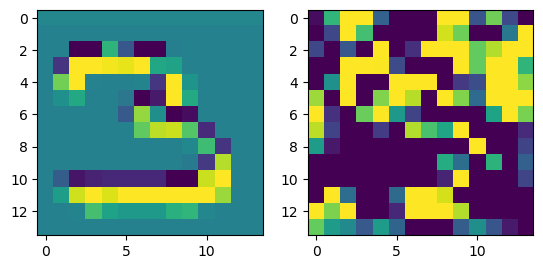

prediction: tensor([4, 8, 2]), tensor([4.1330, 2.0598, 1.9760]) groudtruth: 4
-0.06342244 0.07812187


<Figure size 640x480 with 0 Axes>

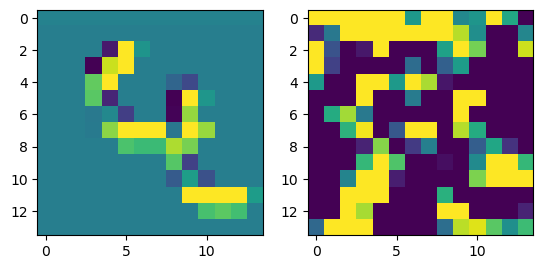

prediction: tensor([7, 9, 2]), tensor([3.2445, 1.5215, 1.1662]) groudtruth: 7
-0.08326292 0.08501576


<Figure size 640x480 with 0 Axes>

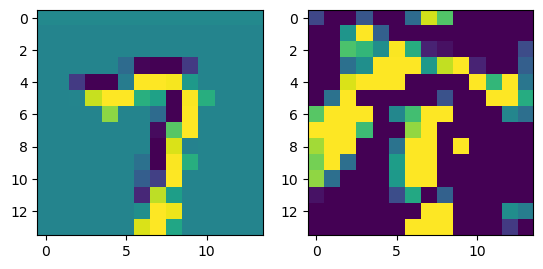

prediction: tensor([4, 9, 8]), tensor([2.2708, 1.7739, 1.3908]) groudtruth: 3
-0.087634385 0.0943197


<Figure size 640x480 with 0 Axes>

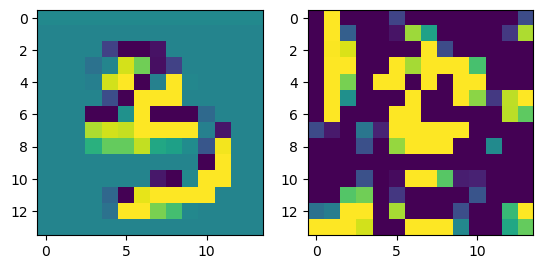

prediction: tensor([2, 7, 1]), tensor([3.6265, 3.0497, 1.2994]) groudtruth: 2
-0.06785756 0.113195606


<Figure size 640x480 with 0 Axes>

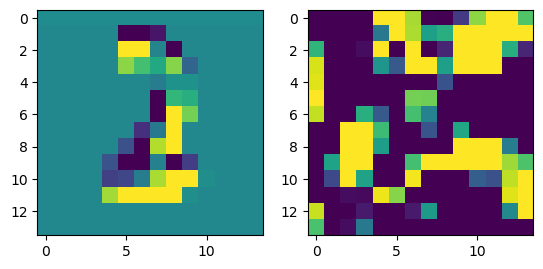

prediction: tensor([3, 5, 4]), tensor([7.3021, 2.3173, 1.2862]) groudtruth: 3
-0.079001606 0.08580658


<Figure size 640x480 with 0 Axes>

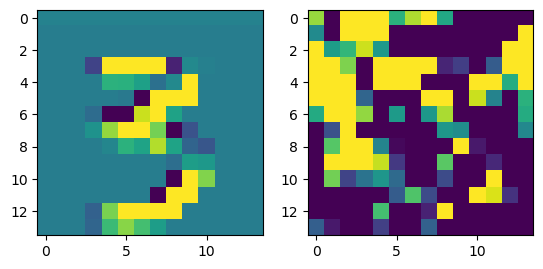

prediction: tensor([4, 2, 3]), tensor([2.8023, 1.2878, 0.4492]) groudtruth: 4
-0.11976725 0.078749016


<Figure size 640x480 with 0 Axes>

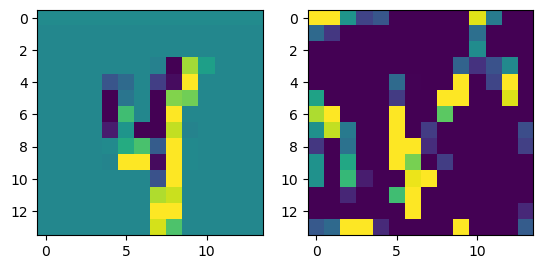

prediction: tensor([2, 4, 3]), tensor([5.4220, 3.7402, 1.6918]) groudtruth: 2
-0.09595865 0.10637078


<Figure size 640x480 with 0 Axes>

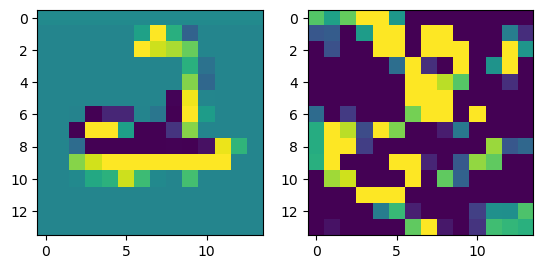

prediction: tensor([9, 4, 6]), tensor([2.8600, 2.4479, 1.1968]) groudtruth: 5
-0.07912296 0.09266397


<Figure size 640x480 with 0 Axes>

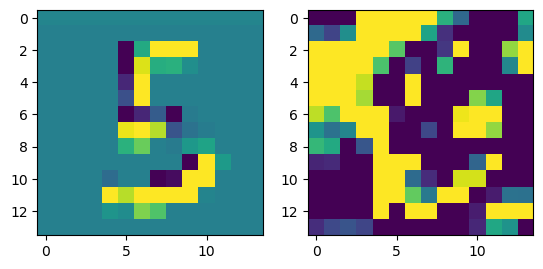

prediction: tensor([2, 7, 3]), tensor([4.0324, 2.3160, 0.9269]) groudtruth: 2
-0.13774228 0.10917455


<Figure size 640x480 with 0 Axes>

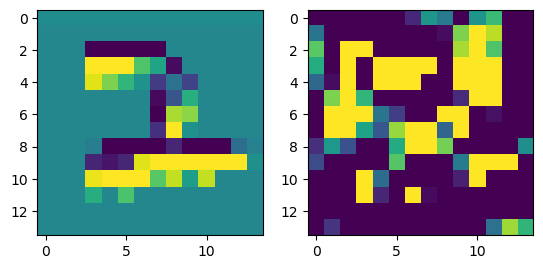

prediction: tensor([7, 6, 2]), tensor([2.1520, 1.0269, 0.9452]) groudtruth: 7
-0.08805072 0.071795866


<Figure size 640x480 with 0 Axes>

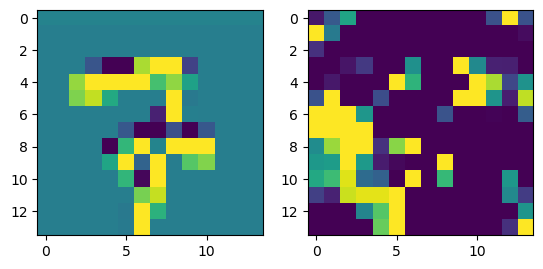

prediction: tensor([1, 9, 3]), tensor([4.5714, 0.7835, 0.5683]) groudtruth: 1
-0.06649667 0.079671025


<Figure size 640x480 with 0 Axes>

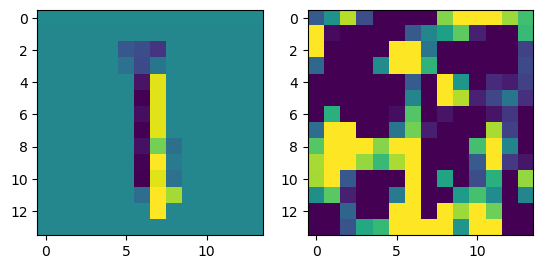

prediction: tensor([7, 2, 9]), tensor([6.8820, 2.6617, 0.0324]) groudtruth: 7
-0.076467454 0.08137101


<Figure size 640x480 with 0 Axes>

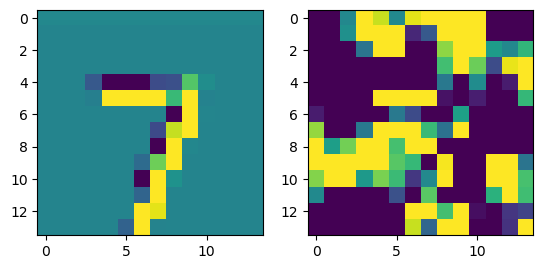

prediction: tensor([0, 6, 9]), tensor([2.1799, 2.1093, 1.6534]) groudtruth: 2
-0.08684206 0.100327775


<Figure size 640x480 with 0 Axes>

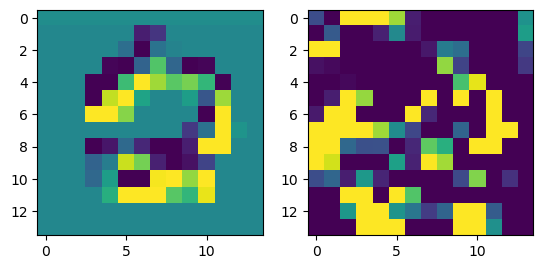

prediction: tensor([4, 2, 8]), tensor([2.2951, 2.1099, 1.3030]) groudtruth: 4
-0.07854569 0.07070534


<Figure size 640x480 with 0 Axes>

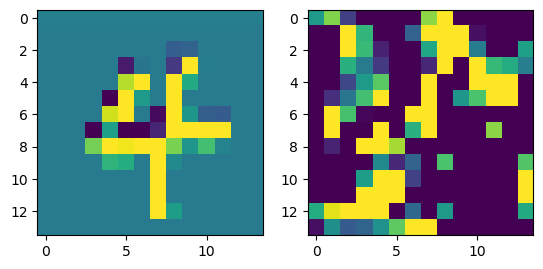

prediction: tensor([1, 9, 4]), tensor([6.2218, 1.6072, 1.2240]) groudtruth: 1
-0.05456686 0.07317696


<Figure size 640x480 with 0 Axes>

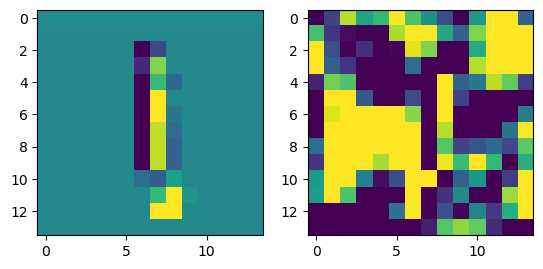

prediction: tensor([0, 9, 7]), tensor([3.9062, 2.6373, 2.0807]) groudtruth: 0
-0.0669145 0.091743365


<Figure size 640x480 with 0 Axes>

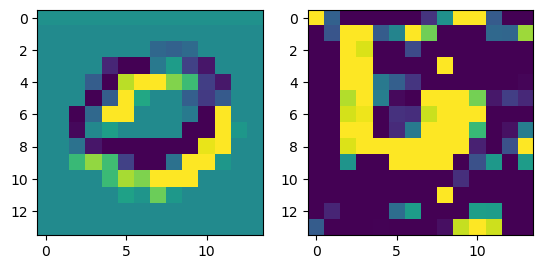

prediction: tensor([1, 9, 8]), tensor([7.4166, 2.4945, 1.4522]) groudtruth: 1
-0.06812632 0.06942233


<Figure size 640x480 with 0 Axes>

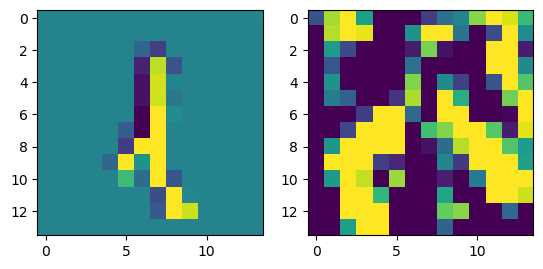

prediction: tensor([7, 4, 2]), tensor([2.7766, 2.0034, 1.9311]) groudtruth: 4
-0.10160184 0.06662345


<Figure size 640x480 with 0 Axes>

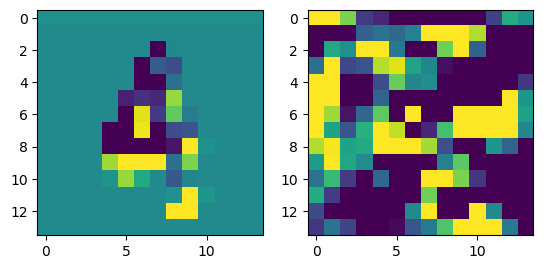

prediction: tensor([6, 0, 7]), tensor([4.4778, 2.3440, 0.4548]) groudtruth: 6
-0.07987869 0.09261085


<Figure size 640x480 with 0 Axes>

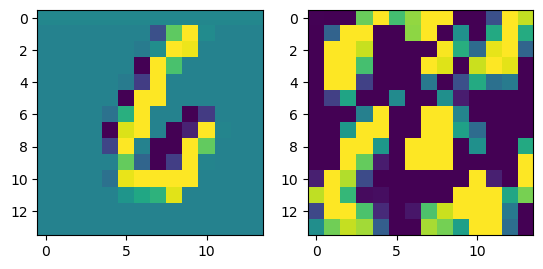

prediction: tensor([2, 7, 9]), tensor([3.4395, 2.1975, 1.6813]) groudtruth: 2
-0.08572048 0.06327176


<Figure size 640x480 with 0 Axes>

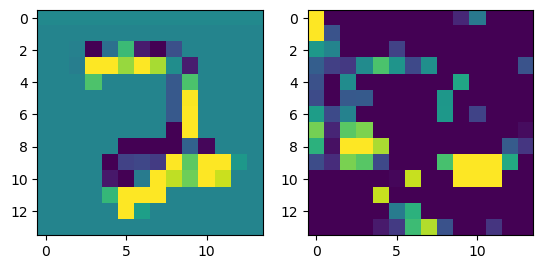

prediction: tensor([9, 8, 7]), tensor([4.8220, 1.5368, 0.6961]) groudtruth: 9
-0.09653509 0.08306454


<Figure size 640x480 with 0 Axes>

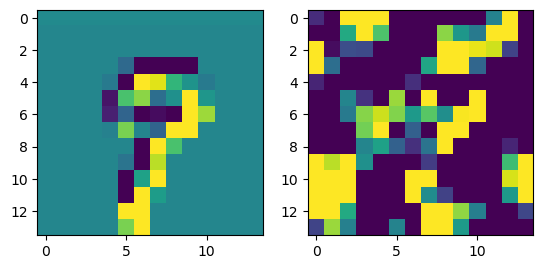

prediction: tensor([1, 7, 8]), tensor([2.1693, 1.0988, 1.0468]) groudtruth: 1
-0.076179385 0.10092694


<Figure size 640x480 with 0 Axes>

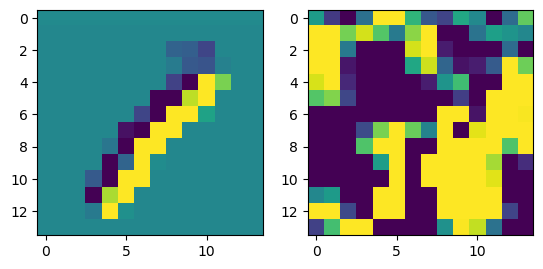

prediction: tensor([1, 9, 3]), tensor([4.5059, 0.7089, 0.2349]) groudtruth: 1
-0.06857586 0.12604798


<Figure size 640x480 with 0 Axes>

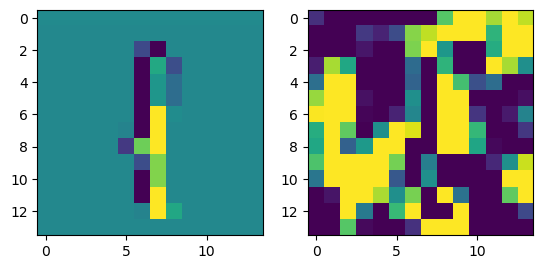

prediction: tensor([0, 3, 9]), tensor([3.9689, 2.9786, 1.0244]) groudtruth: 0
-0.07566333 0.0903291


<Figure size 640x480 with 0 Axes>

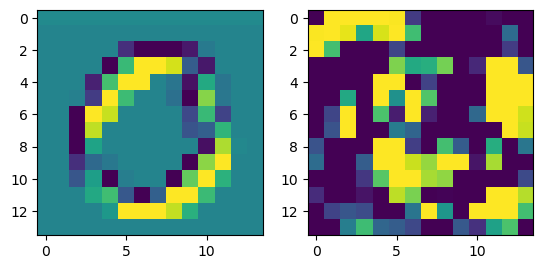

prediction: tensor([5, 6, 4]), tensor([4.1159, 2.0183, 0.8715]) groudtruth: 6
-0.08321452 0.071066305


<Figure size 640x480 with 0 Axes>

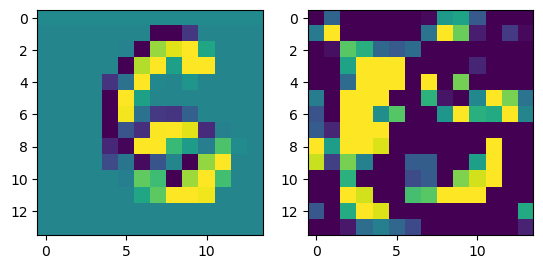

prediction: tensor([3, 2, 1]), tensor([3.5152, 1.7105, 1.6279]) groudtruth: 3
-0.07236534 0.077226266


<Figure size 640x480 with 0 Axes>

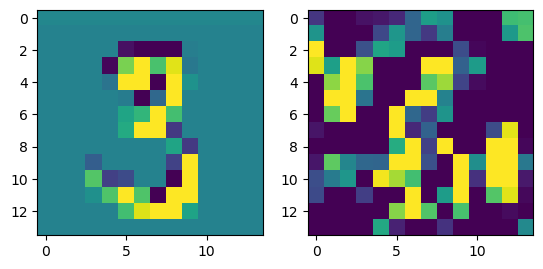

prediction: tensor([9, 4, 7]), tensor([3.7128, 1.6192, 1.3964]) groudtruth: 9
-0.06270033 0.08395974


<Figure size 640x480 with 0 Axes>

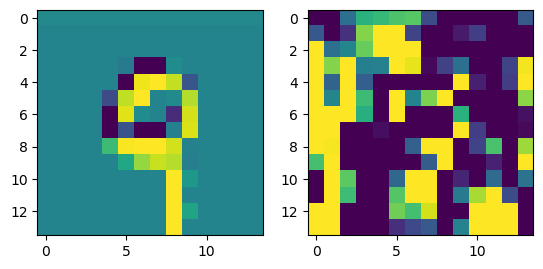

prediction: tensor([5, 7, 9]), tensor([4.2575, 3.0255, 2.4529]) groudtruth: 5
-0.057484865 0.10243994


<Figure size 640x480 with 0 Axes>

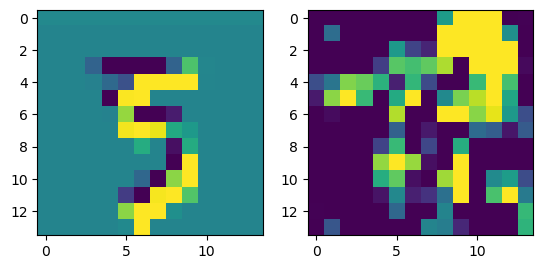

prediction: tensor([7, 5, 0]), tensor([ 3.9628,  0.7428, -0.0383]) groudtruth: 7
-0.070272624 0.11595479


<Figure size 640x480 with 0 Axes>

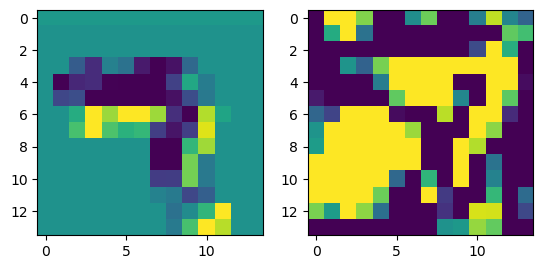

prediction: tensor([9, 8, 4]), tensor([2.4848, 1.7907, 1.5584]) groudtruth: 9
-0.07264984 0.07997349


<Figure size 640x480 with 0 Axes>

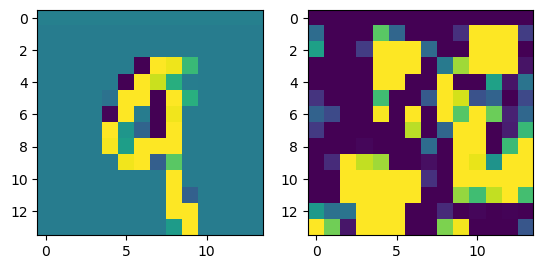

prediction: tensor([8, 6, 9]), tensor([3.1107, 1.3524, 0.6164]) groudtruth: 8
-0.065802634 0.08177049


<Figure size 640x480 with 0 Axes>

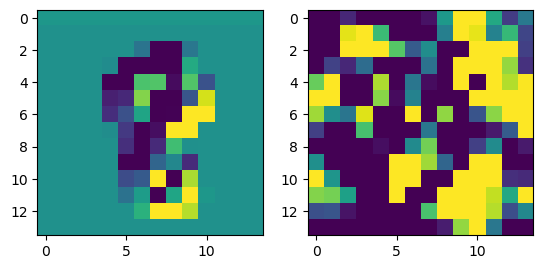

prediction: tensor([1, 0, 6]), tensor([4.0525, 1.4493, 1.2143]) groudtruth: 1
-0.082322 0.07010765


<Figure size 640x480 with 0 Axes>

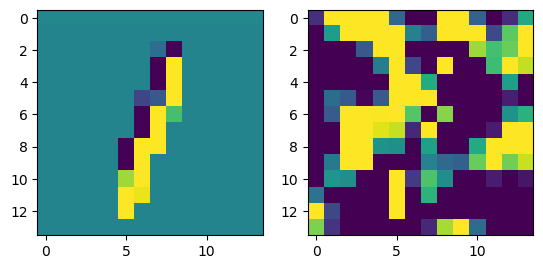

prediction: tensor([2, 9, 3]), tensor([5.5764, 3.6141, 2.1246]) groudtruth: 8
-0.080451965 0.098398626


<Figure size 640x480 with 0 Axes>

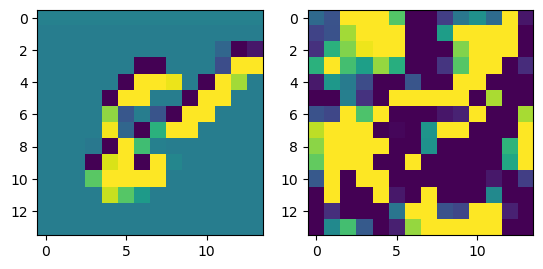

prediction: tensor([9, 4, 8]), tensor([2.3746, 2.1805, 1.0743]) groudtruth: 4
-0.088977635 0.084552936


<Figure size 640x480 with 0 Axes>

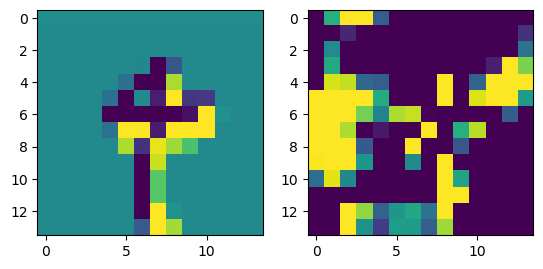

prediction: tensor([9, 3, 5]), tensor([5.6497, 2.6698, 1.7238]) groudtruth: 9
-0.088935375 0.111184776


<Figure size 640x480 with 0 Axes>

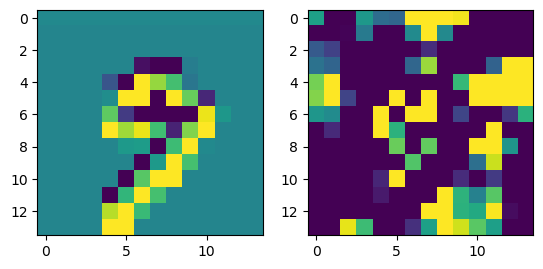

prediction: tensor([2, 1, 4]), tensor([2.7660, 2.7213, 0.9807]) groudtruth: 2
-0.10732317 0.097022414


<Figure size 640x480 with 0 Axes>

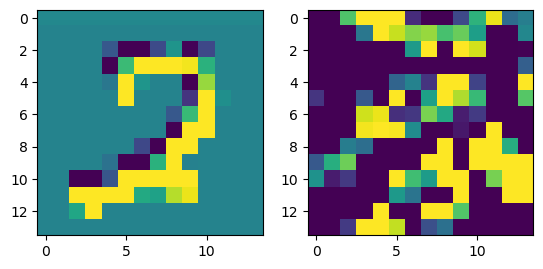

prediction: tensor([8, 9, 3]), tensor([3.0051, 0.7866, 0.6376]) groudtruth: 8
-0.077480376 0.103715405


<Figure size 640x480 with 0 Axes>

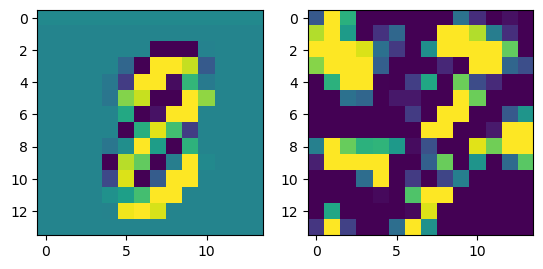

prediction: tensor([4, 6, 0]), tensor([4.2228, 3.1412, 1.5356]) groudtruth: 6
-0.069045186 0.08267267


<Figure size 640x480 with 0 Axes>

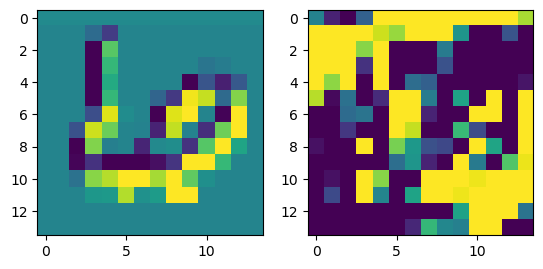

prediction: tensor([2, 3, 7]), tensor([3.0712, 0.8923, 0.8345]) groudtruth: 2
-0.09525412 0.0874321


<Figure size 640x480 with 0 Axes>

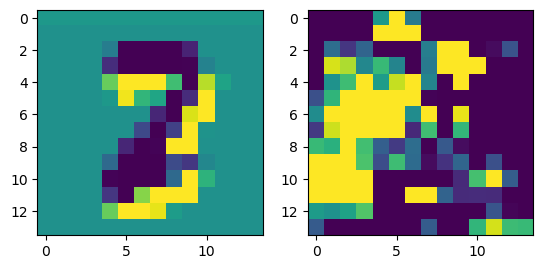

prediction: tensor([8, 7, 9]), tensor([2.7853, 2.4307, 1.7866]) groudtruth: 7
-0.07542795 0.08648437


<Figure size 640x480 with 0 Axes>

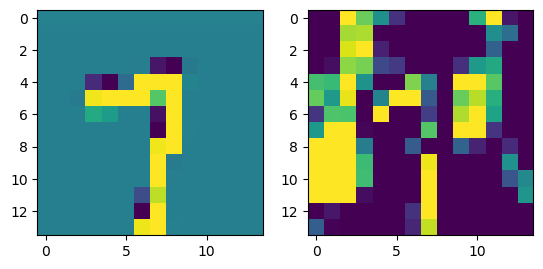

prediction: tensor([0, 9, 8]), tensor([3.7496, 2.2438, 1.8402]) groudtruth: 0
-0.08060211 0.07196391


<Figure size 640x480 with 0 Axes>

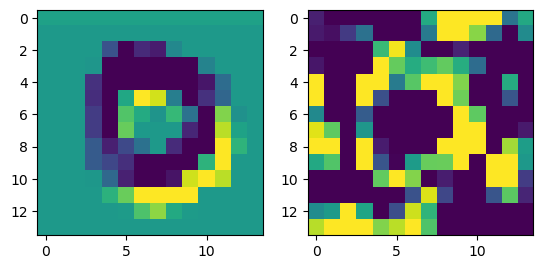

prediction: tensor([0, 7, 4]), tensor([3.0408, 1.0025, 0.7465]) groudtruth: 0
-0.06327671 0.085097395


<Figure size 640x480 with 0 Axes>

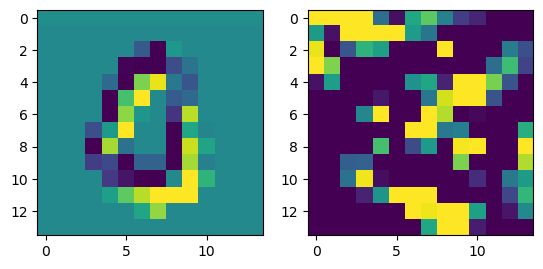

prediction: tensor([6, 4, 8]), tensor([6.8571, 1.6411, 0.8761]) groudtruth: 6
-0.10472292 0.07390358


<Figure size 640x480 with 0 Axes>

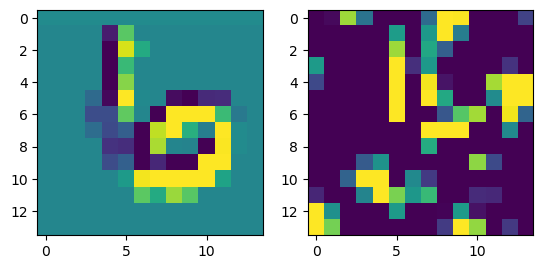

prediction: tensor([8, 2, 6]), tensor([3.1532, 2.4685, 2.4273]) groudtruth: 7
-0.0900836 0.05819084


<Figure size 640x480 with 0 Axes>

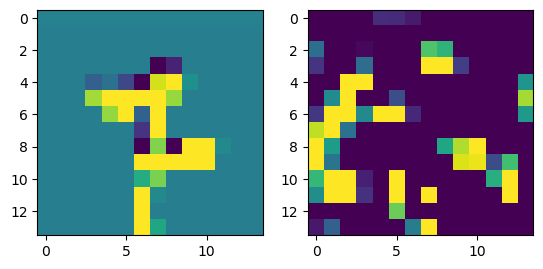

prediction: tensor([2, 5, 6]), tensor([3.5355, 1.3309, 0.7662]) groudtruth: 2
-0.06920177 0.06550397


<Figure size 640x480 with 0 Axes>

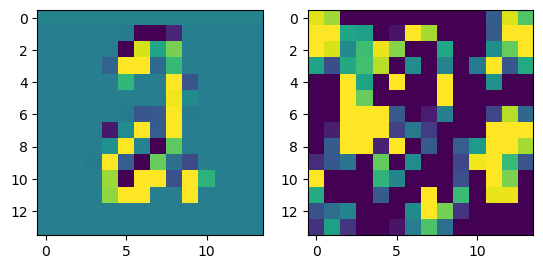

prediction: tensor([5, 3, 1]), tensor([4.8963, 2.5855, 1.6917]) groudtruth: 5
-0.0747354 0.114617184


<Figure size 640x480 with 0 Axes>

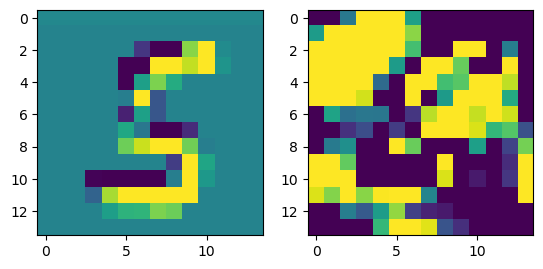

prediction: tensor([5, 3, 9]), tensor([6.4122, 3.2931, 1.6596]) groudtruth: 5
-0.08436388 0.07398549


<Figure size 640x480 with 0 Axes>

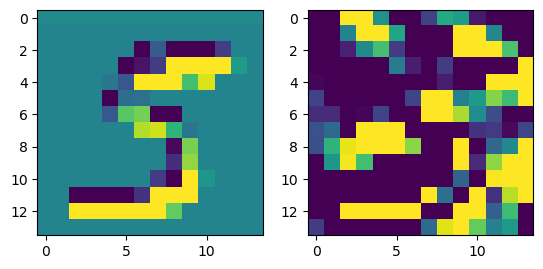

prediction: tensor([7, 0, 9]), tensor([4.1030, 3.2578, 2.5173]) groudtruth: 7
-0.08994627 0.09983678


<Figure size 640x480 with 0 Axes>

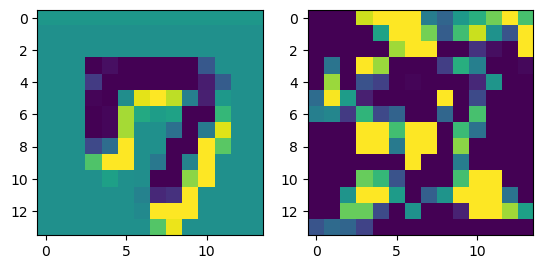

prediction: tensor([6, 0, 2]), tensor([3.5621, 1.2058, 0.9203]) groudtruth: 6
-0.066229224 0.08151135


<Figure size 640x480 with 0 Axes>

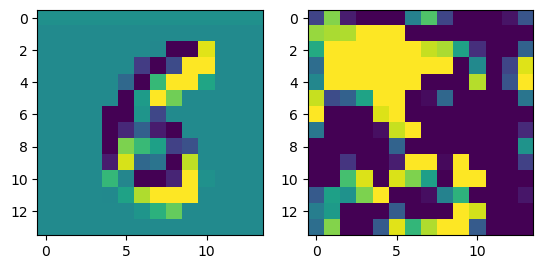

prediction: tensor([4, 8, 1]), tensor([4.5189, 2.8128, 1.0035]) groudtruth: 4
-0.06847501 0.08313336


<Figure size 640x480 with 0 Axes>

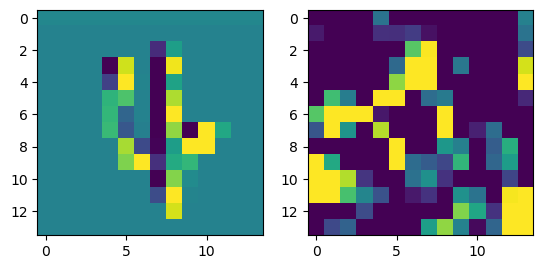

prediction: tensor([0, 4, 8]), tensor([5.5931, 2.5940, 2.4203]) groudtruth: 6
-0.06468862 0.078030065


<Figure size 640x480 with 0 Axes>

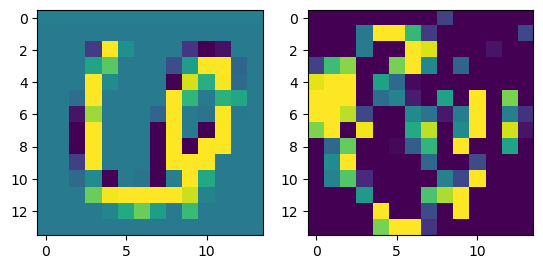

prediction: tensor([8, 4, 9]), tensor([2.8649, 0.9142, 0.4549]) groudtruth: 8
-0.054537654 0.08413681


<Figure size 640x480 with 0 Axes>

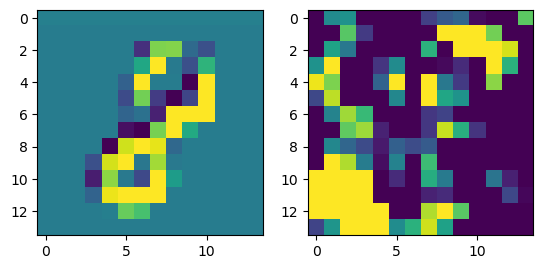

prediction: tensor([4, 7, 0]), tensor([5.0472, 0.7493, 0.1899]) groudtruth: 4
-0.086568296 0.08784363


<Figure size 640x480 with 0 Axes>

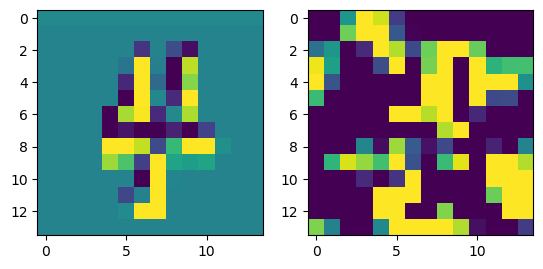

prediction: tensor([8, 9, 6]), tensor([3.2864, 1.8388, 1.0168]) groudtruth: 8
-0.08313131 0.06501842


<Figure size 640x480 with 0 Axes>

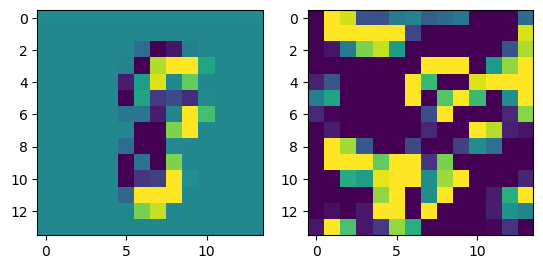

prediction: tensor([2, 7, 9]), tensor([3.7096, 2.8693, 2.8456]) groudtruth: 2
-0.12400365 0.102257


<Figure size 640x480 with 0 Axes>

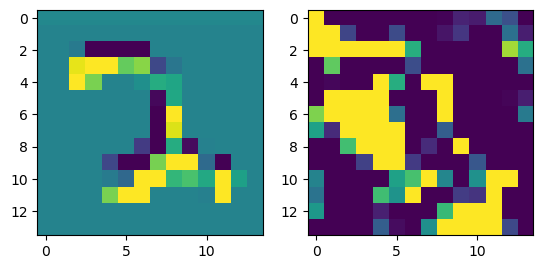

prediction: tensor([7, 9, 2]), tensor([2.2284, 1.1892, 0.6569]) groudtruth: 7
-0.06305981 0.06312856


<Figure size 640x480 with 0 Axes>

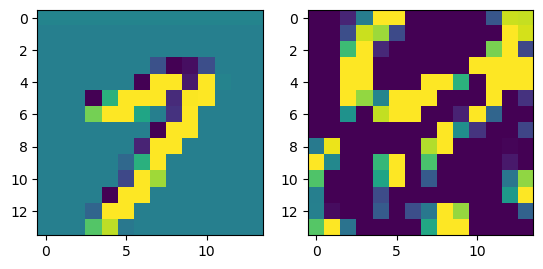

prediction: tensor([4, 6, 1]), tensor([4.7566, 3.6129, 1.4981]) groudtruth: 4
-0.065677285 0.07018139


<Figure size 640x480 with 0 Axes>

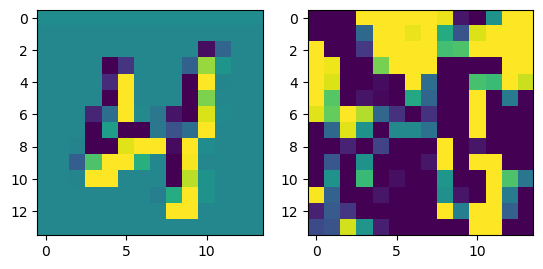

prediction: tensor([3, 6, 5]), tensor([2.2251, 2.1712, 1.4984]) groudtruth: 5
-0.07073647 0.07143779


<Figure size 640x480 with 0 Axes>

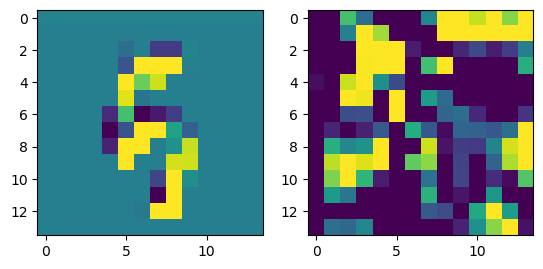

prediction: tensor([2, 9, 3]), tensor([6.0678, 1.8025, 1.6137]) groudtruth: 2
-0.077943444 0.09058686


<Figure size 640x480 with 0 Axes>

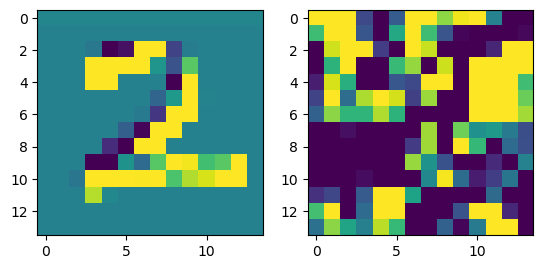

prediction: tensor([0, 6, 9]), tensor([5.7496, 0.9329, 0.6193]) groudtruth: 0
-0.10457015 0.08564816


<Figure size 640x480 with 0 Axes>

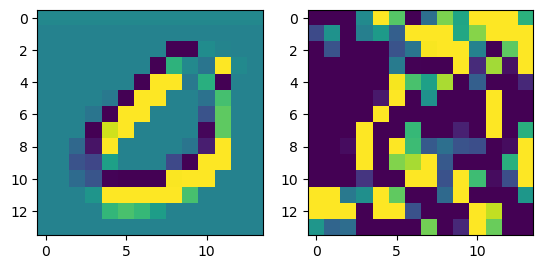

prediction: tensor([2, 4, 3]), tensor([4.0567, 3.4870, 2.7986]) groudtruth: 2
-0.06811285 0.08485113


<Figure size 640x480 with 0 Axes>

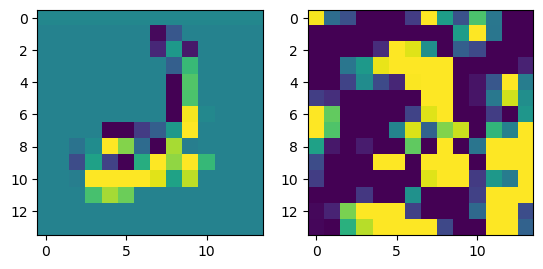

prediction: tensor([1, 2, 3]), tensor([2.1183, 2.1020, 2.0952]) groudtruth: 8
-0.074320376 0.076417446


<Figure size 640x480 with 0 Axes>

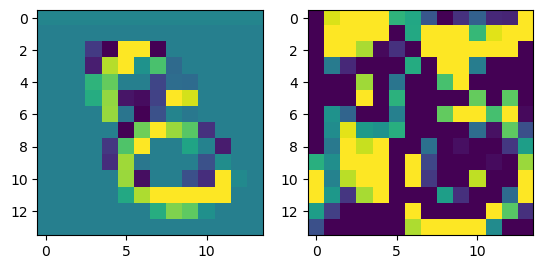

prediction: tensor([0, 6, 3]), tensor([4.4821, 1.0977, 0.5602]) groudtruth: 0
-0.06680608 0.06895832


<Figure size 640x480 with 0 Axes>

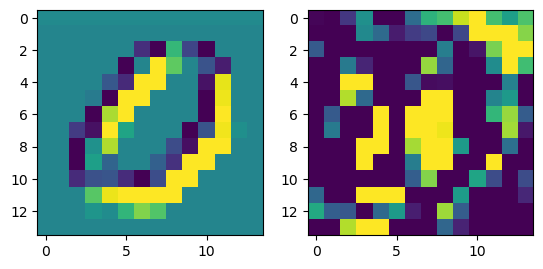

prediction: tensor([8, 9, 3]), tensor([3.1979, 3.1185, 2.3588]) groudtruth: 8
-0.11065537 0.08744162


<Figure size 640x480 with 0 Axes>

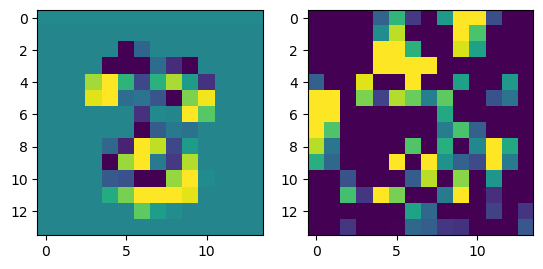

prediction: tensor([5, 6, 2]), tensor([4.9856, 1.4677, 1.1037]) groudtruth: 5
-0.08087838 0.10430163


<Figure size 640x480 with 0 Axes>

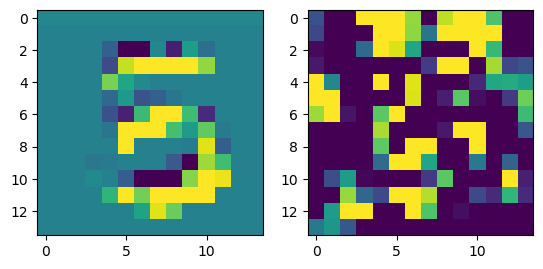

prediction: tensor([4, 9, 1]), tensor([3.9068, 3.6457, 2.0404]) groudtruth: 9
-0.09472823 0.109274834


<Figure size 640x480 with 0 Axes>

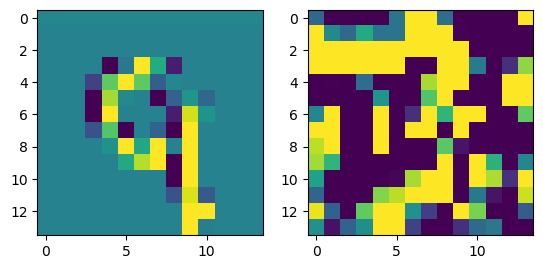

prediction: tensor([9, 2, 7]), tensor([2.8749, 1.3516, 1.3194]) groudtruth: 1
-0.09658557 0.083668604


<Figure size 640x480 with 0 Axes>

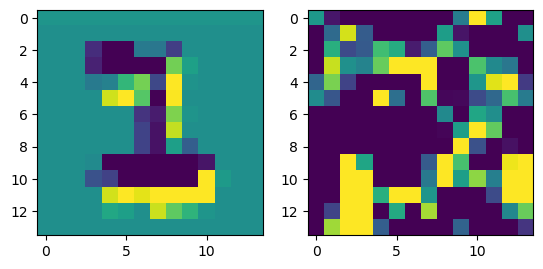

prediction: tensor([2, 4, 6]), tensor([3.4184, 2.4081, 1.1849]) groudtruth: 4
-0.07888335 0.08620212


<Figure size 640x480 with 0 Axes>

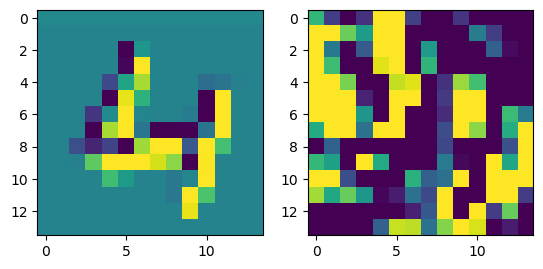

prediction: tensor([2, 6, 9]), tensor([4.1208, 1.0891, 0.6582]) groudtruth: 2
-0.09763008 0.08558488


<Figure size 640x480 with 0 Axes>

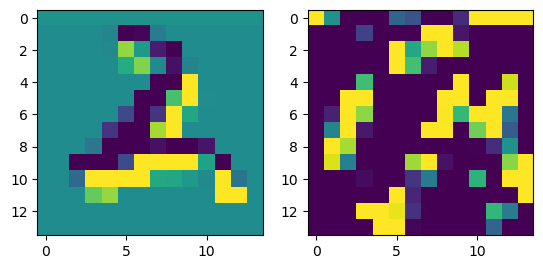

prediction: tensor([8, 9, 4]), tensor([4.8366, 1.9822, 0.3856]) groudtruth: 0
-0.10491532 0.05923643


<Figure size 640x480 with 0 Axes>

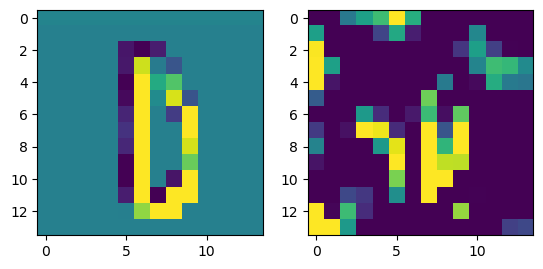

prediction: tensor([0, 2, 7]), tensor([3.4387, 3.4032, 0.8157]) groudtruth: 2
-0.07970053 0.071009636


<Figure size 640x480 with 0 Axes>

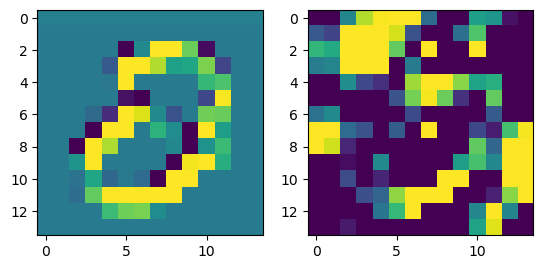

prediction: tensor([7, 9, 2]), tensor([4.5818, 1.8809, 1.2928]) groudtruth: 7
-0.06768525 0.08051416


<Figure size 640x480 with 0 Axes>

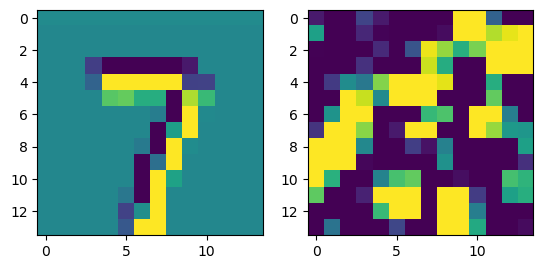

prediction: tensor([0, 8, 5]), tensor([1.9983, 1.7333, 0.8009]) groudtruth: 0
-0.095669866 0.1094417


<Figure size 640x480 with 0 Axes>

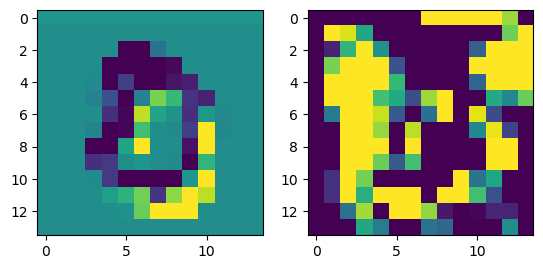

prediction: tensor([1, 7, 2]), tensor([2.8696, 2.5498, 1.0230]) groudtruth: 9
-0.092885494 0.063263334


<Figure size 640x480 with 0 Axes>

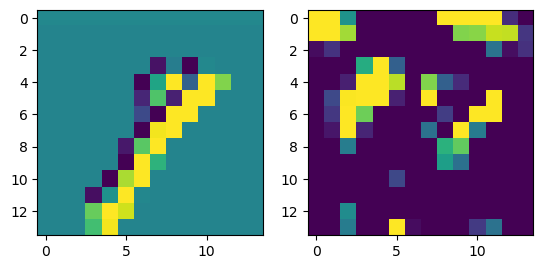

prediction: tensor([0, 4, 7]), tensor([4.8738, 1.8167, 1.6562]) groudtruth: 0
-0.070714176 0.062174533


<Figure size 640x480 with 0 Axes>

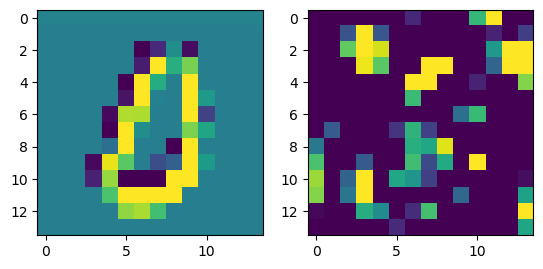

prediction: tensor([2, 8, 3]), tensor([4.2745, 2.8517, 0.8890]) groudtruth: 2
-0.11298829 0.1118627


<Figure size 640x480 with 0 Axes>

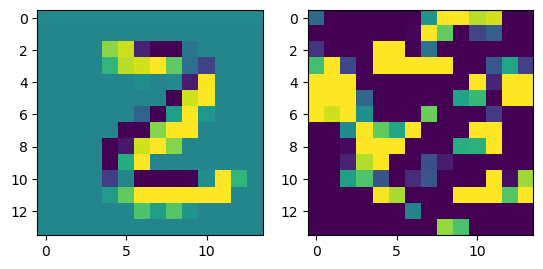

prediction: tensor([7, 9, 0]), tensor([5.4843, 2.0114, 1.7159]) groudtruth: 7
-0.08286446 0.07704345


<Figure size 640x480 with 0 Axes>

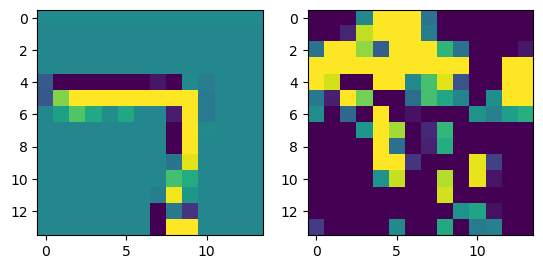

prediction: tensor([5, 3, 8]), tensor([9.1510, 4.5353, 0.4694]) groudtruth: 5
-0.09884924 0.08493193


<Figure size 640x480 with 0 Axes>

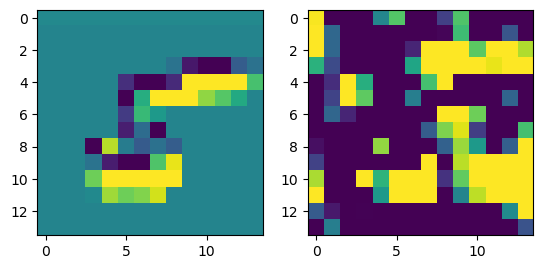

prediction: tensor([2, 1, 8]), tensor([3.8925, 1.6604, 1.5363]) groudtruth: 2
-0.077703536 0.09466526


<Figure size 640x480 with 0 Axes>

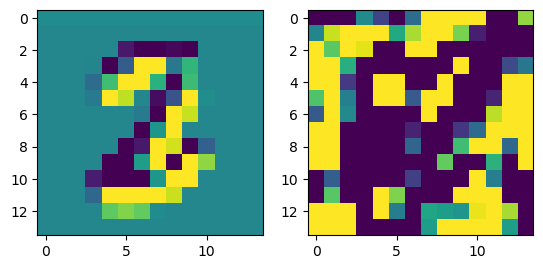

prediction: tensor([7, 8, 5]), tensor([3.4850, 2.9487, 1.0960]) groudtruth: 7
-0.10295373 0.08470007


<Figure size 640x480 with 0 Axes>

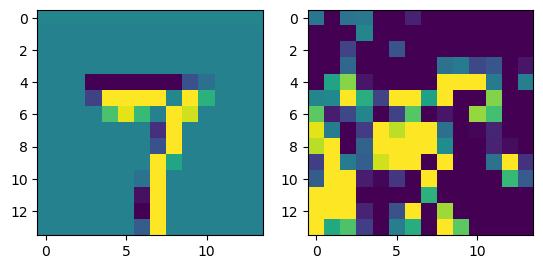

prediction: tensor([9, 7, 8]), tensor([3.1390, 1.4970, 1.2769]) groudtruth: 9
-0.099473715 0.06565051


<Figure size 640x480 with 0 Axes>

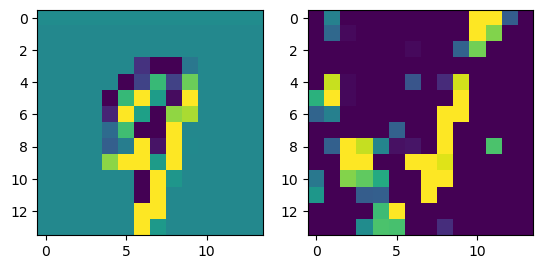

prediction: tensor([1, 8, 0]), tensor([4.2135, 1.5186, 1.3429]) groudtruth: 1
-0.07969028 0.08656345


<Figure size 640x480 with 0 Axes>

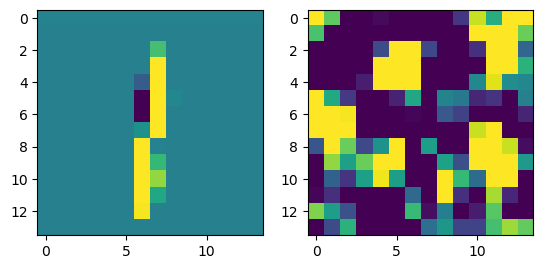

prediction: tensor([8, 6, 9]), tensor([4.9946, 1.3726, 1.1538]) groudtruth: 8
-0.06912559 0.06214407


<Figure size 640x480 with 0 Axes>

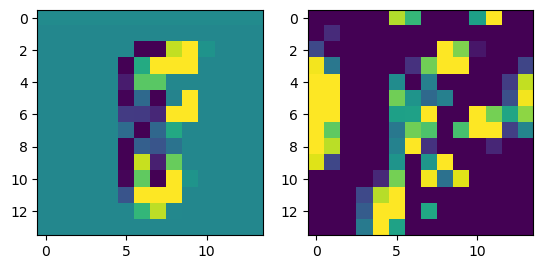

prediction: tensor([5, 8, 6]), tensor([4.1407, 2.9502, 2.3750]) groudtruth: 5
-0.109330714 0.08952147


<Figure size 640x480 with 0 Axes>

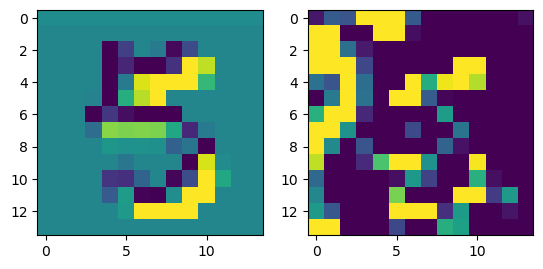

prediction: tensor([2, 7, 3]), tensor([4.3084, 3.0736, 1.1767]) groudtruth: 2
-0.07873374 0.088520326


<Figure size 640x480 with 0 Axes>

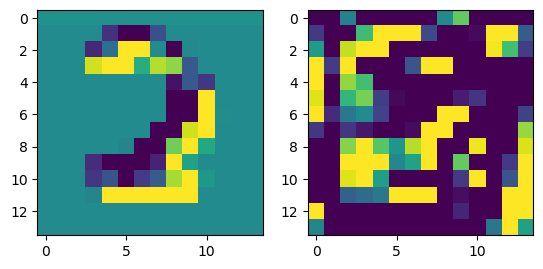

prediction: tensor([4, 5, 9]), tensor([6.9922, 0.8169, 0.4595]) groudtruth: 4
-0.07494289 0.08654194


<Figure size 640x480 with 0 Axes>

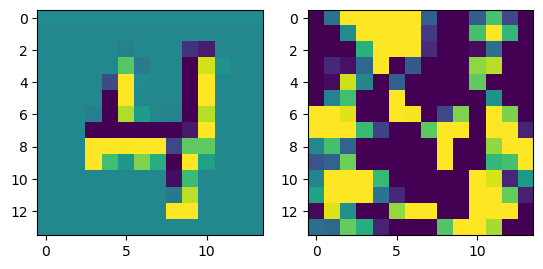

prediction: tensor([9, 3, 8]), tensor([2.9455, 2.6969, 0.7679]) groudtruth: 9
-0.08480084 0.12333651


<Figure size 640x480 with 0 Axes>

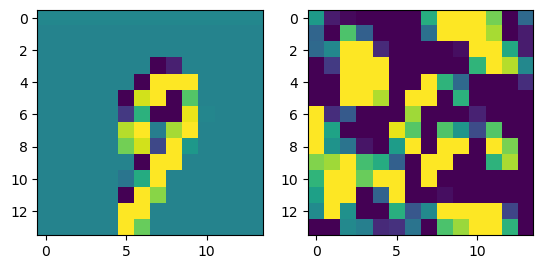

prediction: tensor([4, 9, 1]), tensor([3.0211, 1.6148, 0.6227]) groudtruth: 4
-0.085413754 0.10127771


<Figure size 640x480 with 0 Axes>

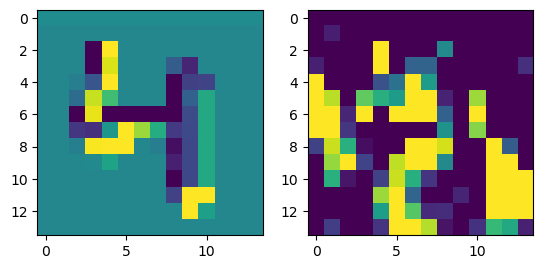

prediction: tensor([7, 1, 9]), tensor([4.3292, 1.6018, 1.3000]) groudtruth: 7
-0.07041204 0.093185596


<Figure size 640x480 with 0 Axes>

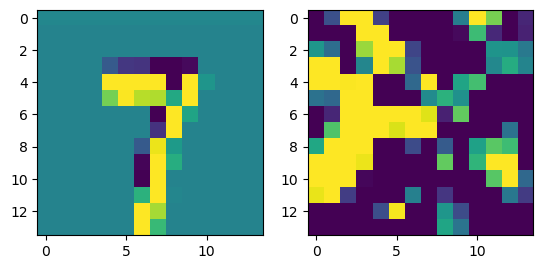

prediction: tensor([6, 5, 2]), tensor([3.8390, 3.5467, 3.3559]) groudtruth: 2
-0.123117626 0.11898661


<Figure size 640x480 with 0 Axes>

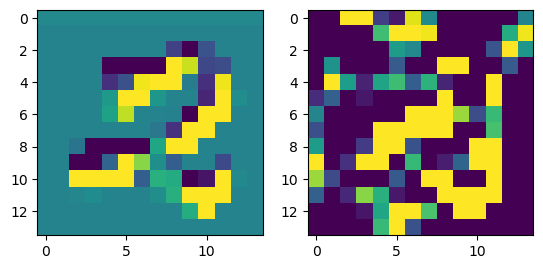

prediction: tensor([2, 8, 3]), tensor([5.0453, 3.8406, 2.9975]) groudtruth: 2
-0.095433414 0.079154655


<Figure size 640x480 with 0 Axes>

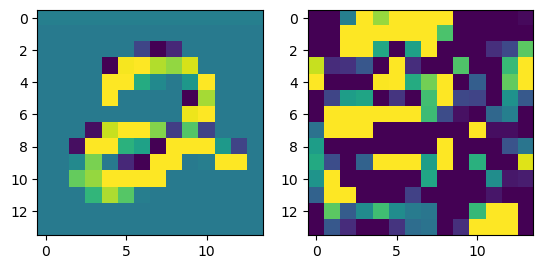

prediction: tensor([8, 3, 2]), tensor([4.7000, 4.2150, 2.0050]) groudtruth: 3
-0.11078638 0.07157451


<Figure size 640x480 with 0 Axes>

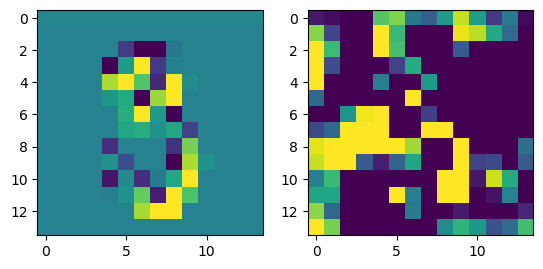

prediction: tensor([0, 8, 9]), tensor([5.3505, 1.2381, 0.6029]) groudtruth: 0
-0.0695405 0.08642572


<Figure size 640x480 with 0 Axes>

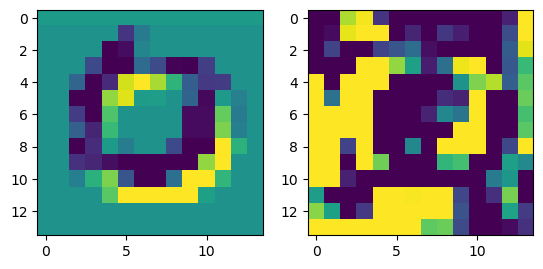

prediction: tensor([1, 3, 9]), tensor([3.0057, 2.3953, 1.0404]) groudtruth: 3
-0.07579875 0.07467889


<Figure size 640x480 with 0 Axes>

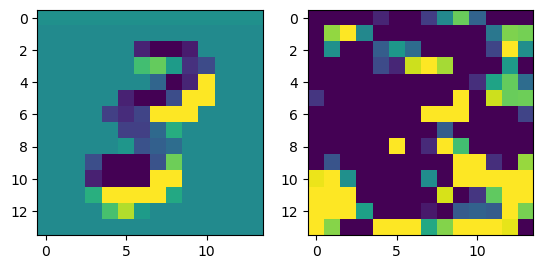

prediction: tensor([4, 8, 1]), tensor([3.5609, 1.9964, 1.9409]) groudtruth: 4
-0.06779349 0.09976123


<Figure size 640x480 with 0 Axes>

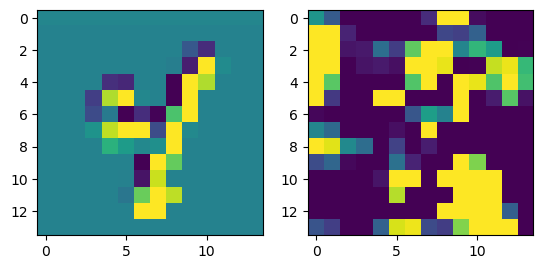

prediction: tensor([4, 8, 5]), tensor([4.3066, 2.5637, 0.9817]) groudtruth: 4
-0.064187884 0.1046549


<Figure size 640x480 with 0 Axes>

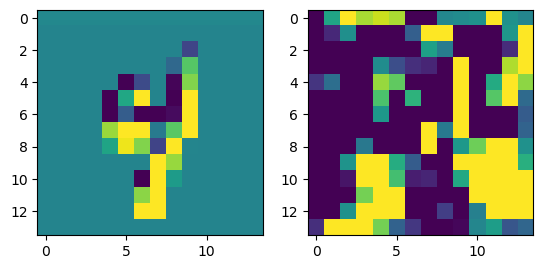

prediction: tensor([3, 5, 7]), tensor([3.7073, 2.0177, 1.7902]) groudtruth: 3
-0.08037919 0.08864574


<Figure size 640x480 with 0 Axes>

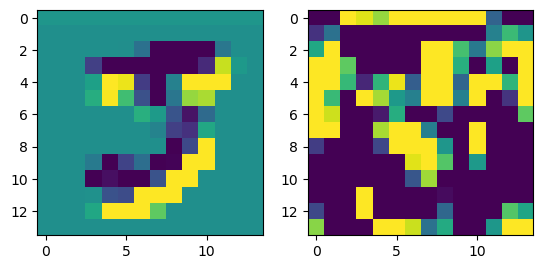

prediction: tensor([8, 9, 3]), tensor([4.3307, 3.6228, 0.6340]) groudtruth: 8
-0.07303077 0.07599321


<Figure size 640x480 with 0 Axes>

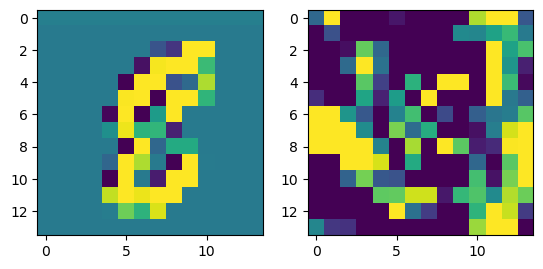

prediction: tensor([9, 8, 1]), tensor([3.3132, 2.6578, 0.9664]) groudtruth: 9
-0.07884717 0.065815054


<Figure size 640x480 with 0 Axes>

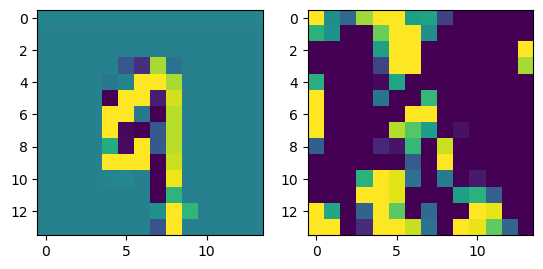

prediction: tensor([8, 2, 3]), tensor([1.9429, 1.9267, 1.6243]) groudtruth: 2
-0.07425851 0.060051955


<Figure size 640x480 with 0 Axes>

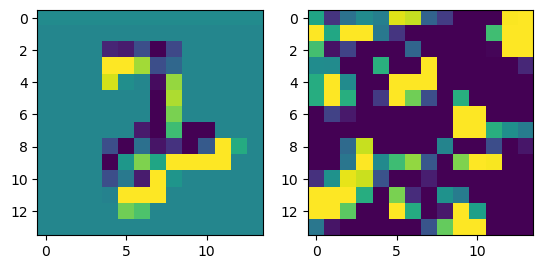

prediction: tensor([3, 2, 8]), tensor([2.5149, 1.9847, 1.1708]) groudtruth: 3
-0.102164745 0.12140172


<Figure size 640x480 with 0 Axes>

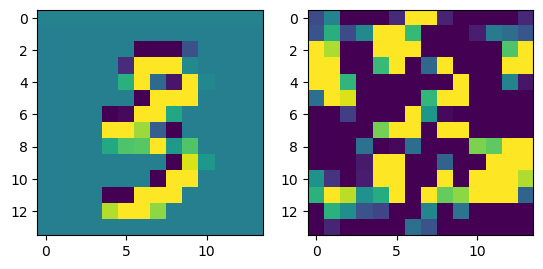

prediction: tensor([9, 4, 6]), tensor([3.1431, 2.4810, 1.0630]) groudtruth: 9
-0.10073513 0.06985703


<Figure size 640x480 with 0 Axes>

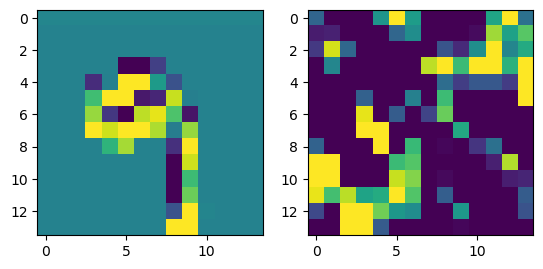

prediction: tensor([7, 9, 1]), tensor([6.8471, 1.5917, 1.2660]) groudtruth: 7
-0.09512031 0.09298706


<Figure size 640x480 with 0 Axes>

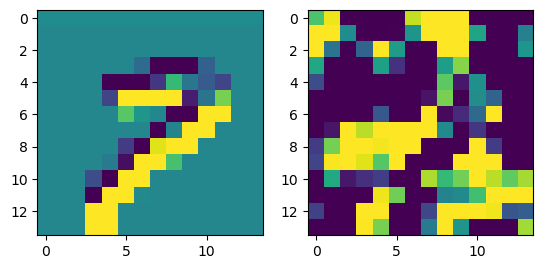

prediction: tensor([1, 8, 4]), tensor([4.9244, 0.6075, 0.5520]) groudtruth: 1
-0.092175245 0.1320973


<Figure size 640x480 with 0 Axes>

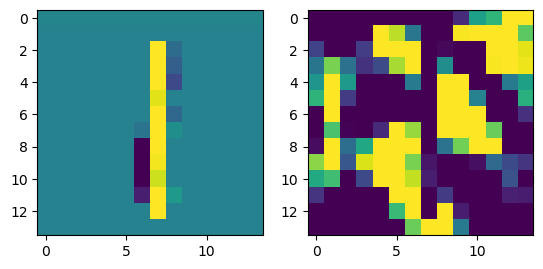

prediction: tensor([1, 4, 9]), tensor([4.8935, 0.6535, 0.5360]) groudtruth: 1
-0.10245103 0.10862626


<Figure size 640x480 with 0 Axes>

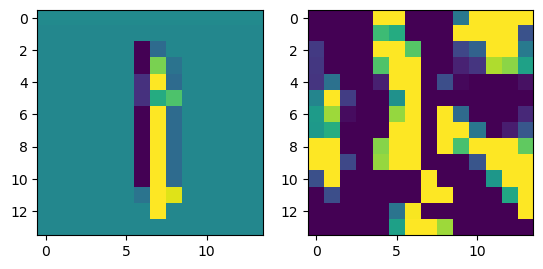

prediction: tensor([7, 1, 0]), tensor([4.2961, 1.8998, 1.2399]) groudtruth: 7
-0.07314801 0.08341241


<Figure size 640x480 with 0 Axes>

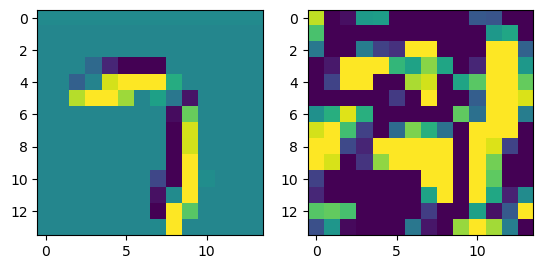

prediction: tensor([9, 0, 6]), tensor([2.1927, 1.5943, 1.4153]) groudtruth: 0
-0.07171512 0.085281745


<Figure size 640x480 with 0 Axes>

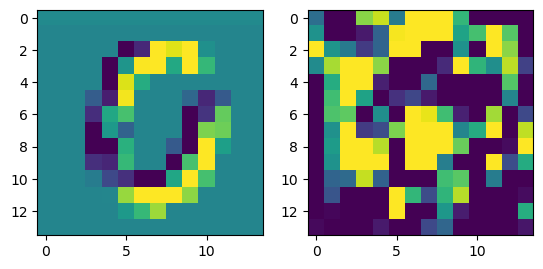

prediction: tensor([4, 6, 2]), tensor([2.9873, 2.1503, 1.9207]) groudtruth: 4
-0.06423426 0.09033966


<Figure size 640x480 with 0 Axes>

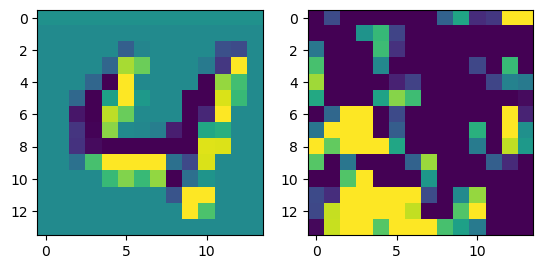

prediction: tensor([4, 3, 5]), tensor([5.8078, 1.9318, 0.9597]) groudtruth: 4
-0.08363289 0.083032414


<Figure size 640x480 with 0 Axes>

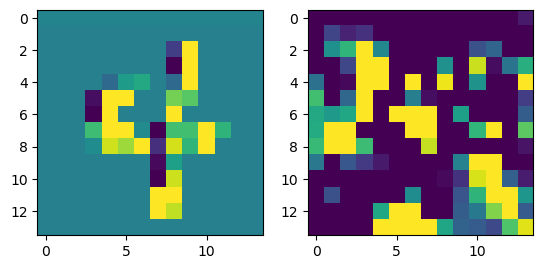

prediction: tensor([5, 6, 2]), tensor([3.9022, 2.8776, 1.3141]) groudtruth: 5
-0.107893944 0.11294119


<Figure size 640x480 with 0 Axes>

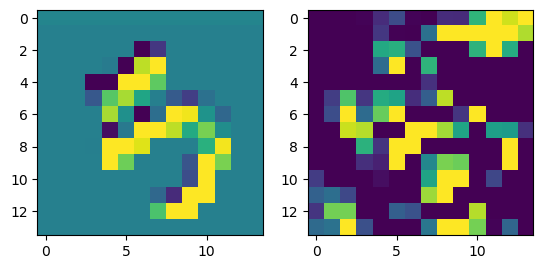

prediction: tensor([0, 9, 7]), tensor([2.8365, 2.0319, 1.5275]) groudtruth: 0
-0.10462475 0.090336144


<Figure size 640x480 with 0 Axes>

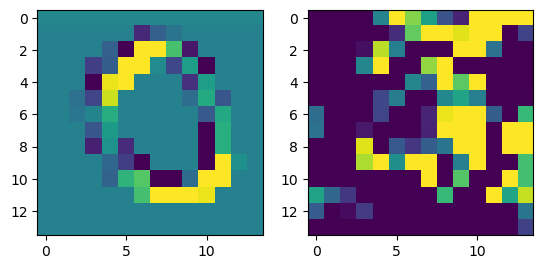

prediction: tensor([4, 9, 2]), tensor([4.2946, 2.8161, 0.1502]) groudtruth: 4
-0.06566447 0.08394136


<Figure size 640x480 with 0 Axes>

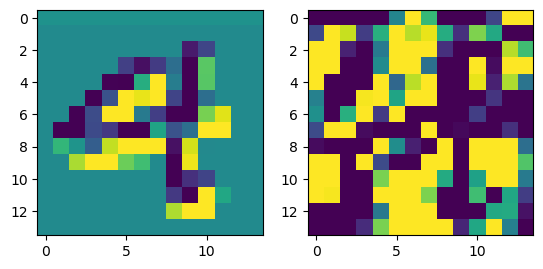

prediction: tensor([9, 7, 6]), tensor([2.8282, 2.7279, 1.0987]) groudtruth: 7
-0.057283938 0.09435439


<Figure size 640x480 with 0 Axes>

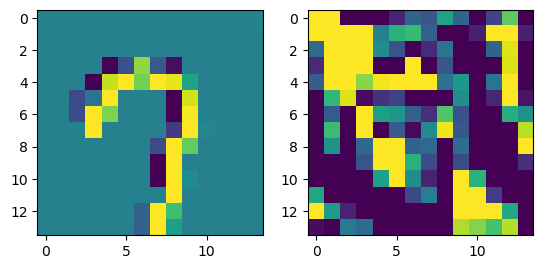

prediction: tensor([4, 5, 8]), tensor([2.5861, 1.5968, 1.2860]) groudtruth: 4
-0.09231061 0.063602746


<Figure size 640x480 with 0 Axes>

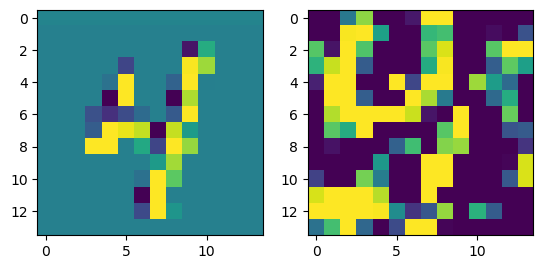

prediction: tensor([2, 0, 9]), tensor([5.3945, 1.7524, 1.4965]) groudtruth: 2
-0.057678282 0.07788506


<Figure size 640x480 with 0 Axes>

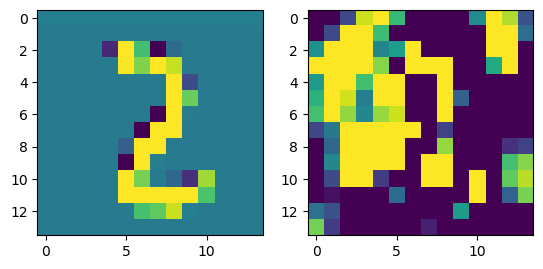

prediction: tensor([4, 2, 3]), tensor([5.3440, 1.2950, 1.1859]) groudtruth: 4
-0.10788292 0.11224472


<Figure size 640x480 with 0 Axes>

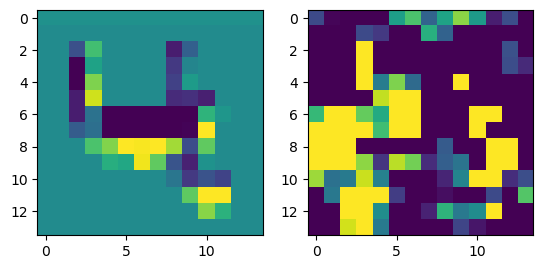

prediction: tensor([0, 2, 6]), tensor([5.2347, 3.0013, 1.1689]) groudtruth: 0
-0.08501667 0.07979378


<Figure size 640x480 with 0 Axes>

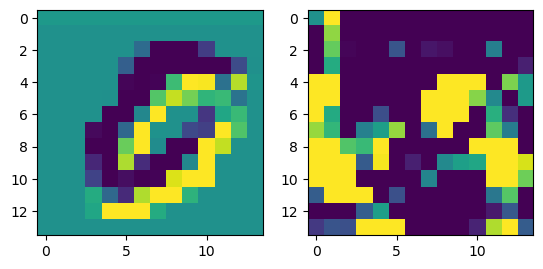

prediction: tensor([7, 1, 4]), tensor([3.3357, 3.1239, 1.1451]) groudtruth: 7
-0.06373596 0.08207058


<Figure size 640x480 with 0 Axes>

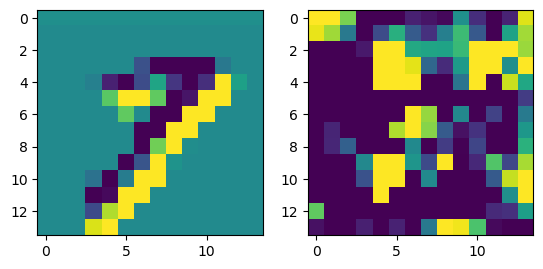

prediction: tensor([0, 3, 9]), tensor([4.4218, 2.6151, 1.1088]) groudtruth: 0
-0.093676746 0.09107171


<Figure size 640x480 with 0 Axes>

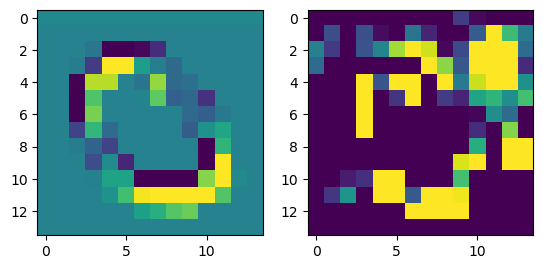

prediction: tensor([1, 7, 8]), tensor([3.5032, 1.0004, 0.4400]) groudtruth: 1
-0.065488815 0.05989984


<Figure size 640x480 with 0 Axes>

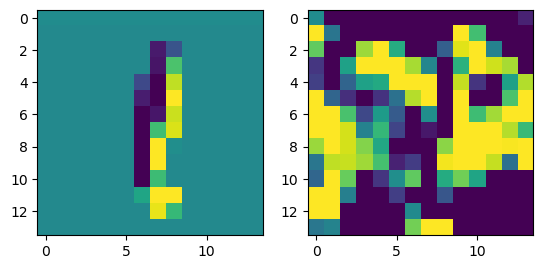

prediction: tensor([8, 3, 5]), tensor([2.3489, 1.3117, 0.7288]) groudtruth: 9
-0.07987416 0.071841925


<Figure size 640x480 with 0 Axes>

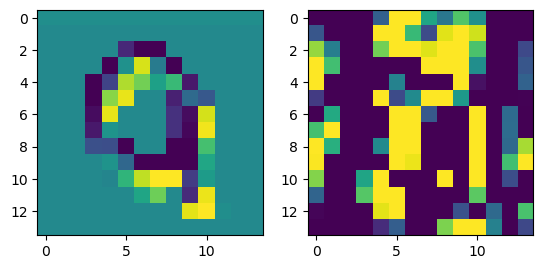

prediction: tensor([8, 5, 3]), tensor([4.9517, 1.8387, 1.2623]) groudtruth: 8
-0.08176398 0.05931509


<Figure size 640x480 with 0 Axes>

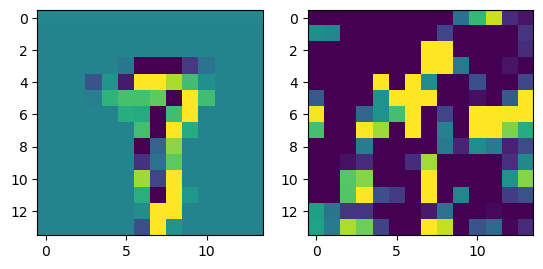

prediction: tensor([8, 0, 2]), tensor([3.0552, 2.2848, 1.5323]) groudtruth: 8
-0.08069289 0.06151845


<Figure size 640x480 with 0 Axes>

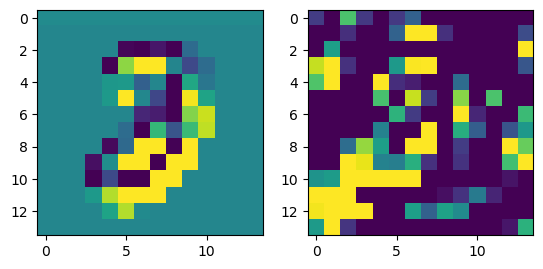

prediction: tensor([6, 9, 7]), tensor([6.2854, 1.5110, 1.0609]) groudtruth: 6
-0.09048802 0.08150591


<Figure size 640x480 with 0 Axes>

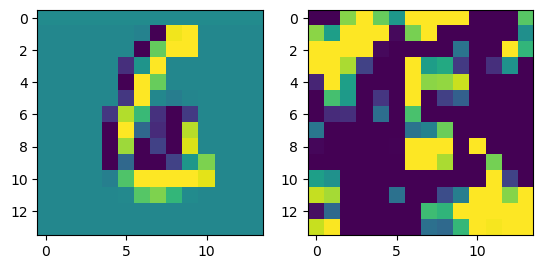

prediction: tensor([2, 9, 3]), tensor([7.6434, 1.3405, 1.3086]) groudtruth: 2
-0.08699453 0.11954826


<Figure size 640x480 with 0 Axes>

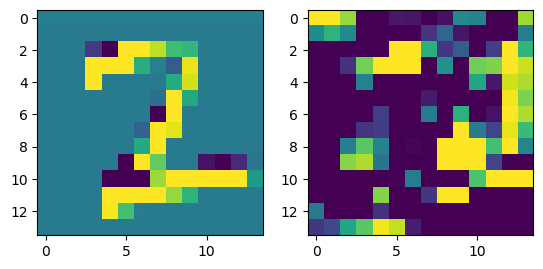

prediction: tensor([9, 2, 7]), tensor([3.4516, 2.1691, 1.6329]) groudtruth: 2
-0.09035045 0.08287987


<Figure size 640x480 with 0 Axes>

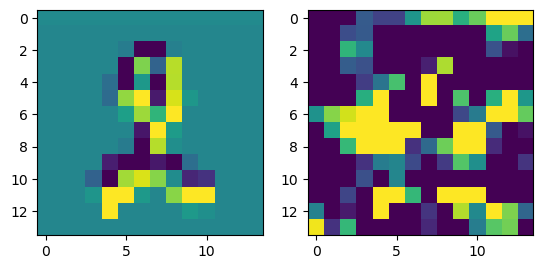

prediction: tensor([1, 3, 9]), tensor([3.7882, 1.7710, 1.4336]) groudtruth: 1
-0.06570554 0.07038279


<Figure size 640x480 with 0 Axes>

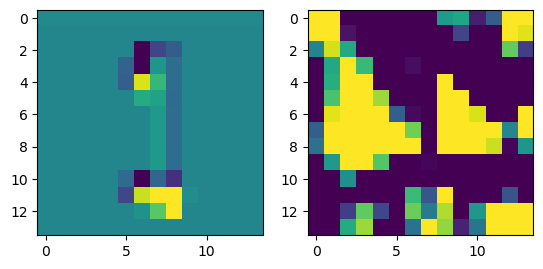

prediction: tensor([0, 7, 3]), tensor([5.6352, 1.7040, 1.0344]) groudtruth: 0
-0.08846229 0.083024494


<Figure size 640x480 with 0 Axes>

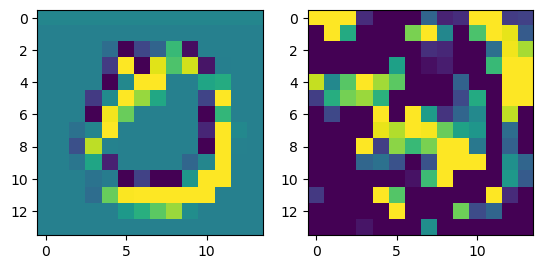

prediction: tensor([4, 7, 3]), tensor([4.8583, 2.9124, 1.0357]) groudtruth: 4
-0.07798678 0.07130593


<Figure size 640x480 with 0 Axes>

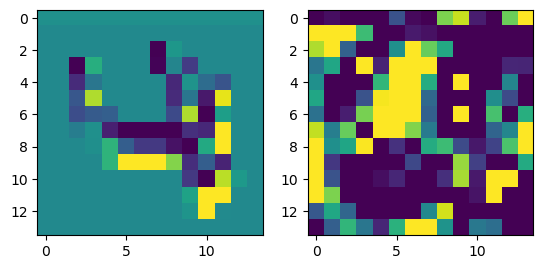

prediction: tensor([2, 6, 5]), tensor([5.5218, 2.9309, 1.6865]) groudtruth: 2
-0.102437735 0.11316909


<Figure size 640x480 with 0 Axes>

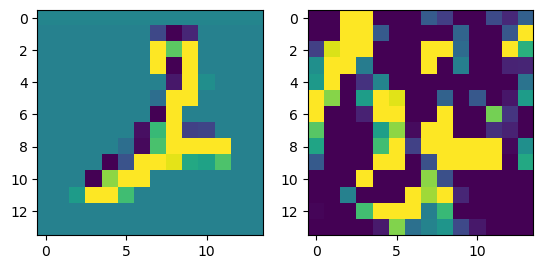

prediction: tensor([9, 7, 8]), tensor([4.1119, 1.4662, 0.8437]) groudtruth: 9
-0.08954078 0.096167505


<Figure size 640x480 with 0 Axes>

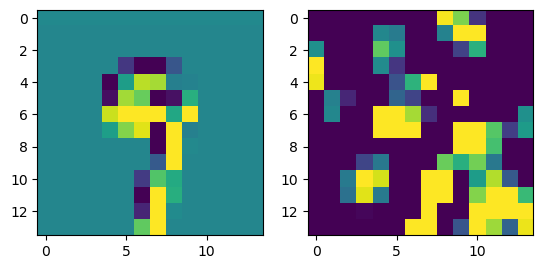

prediction: tensor([2, 6, 0]), tensor([2.8435, 1.9923, 1.1016]) groudtruth: 2
-0.07593936 0.10218082


<Figure size 640x480 with 0 Axes>

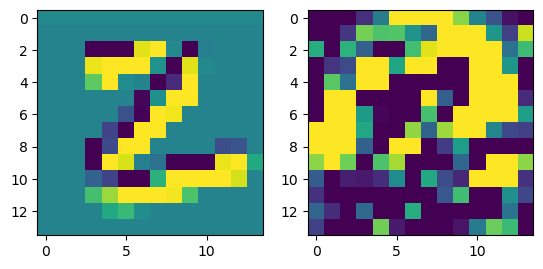

prediction: tensor([4, 2, 9]), tensor([4.7317, 1.4273, 1.2088]) groudtruth: 4
-0.088258445 0.07394692


<Figure size 640x480 with 0 Axes>

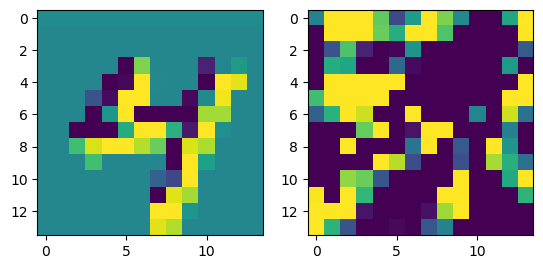

prediction: tensor([3, 2, 8]), tensor([3.4041, 1.9739, 1.1973]) groudtruth: 3
-0.11760807 0.10026659


<Figure size 640x480 with 0 Axes>

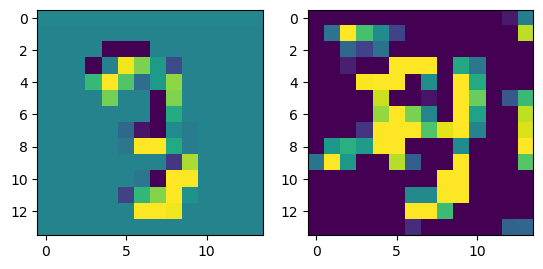

prediction: tensor([7, 9, 6]), tensor([5.6966, 2.3466, 1.8584]) groudtruth: 7
-0.09003937 0.09806374


<Figure size 640x480 with 0 Axes>

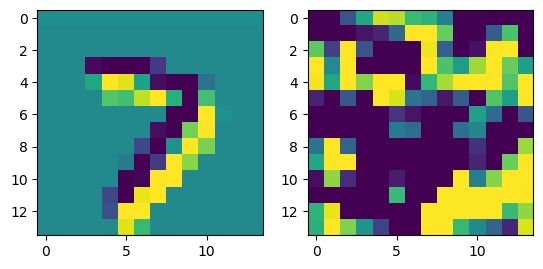

prediction: tensor([9, 7, 6]), tensor([5.0097, 2.2949, 0.3705]) groudtruth: 9
-0.091469824 0.10409731


<Figure size 640x480 with 0 Axes>

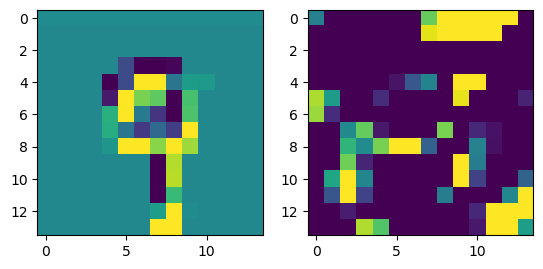

prediction: tensor([1, 4, 8]), tensor([4.4431, 1.6082, 1.0375]) groudtruth: 1
-0.06658453 0.084977694


<Figure size 640x480 with 0 Axes>

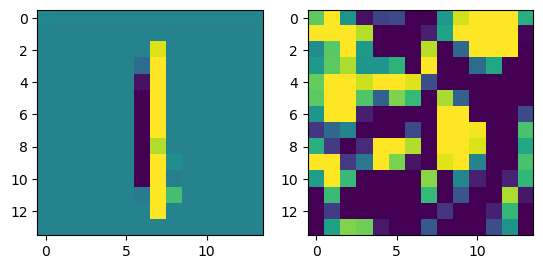

prediction: tensor([8, 5, 7]), tensor([1.9596, 1.6892, 1.3971]) groudtruth: 5
-0.12553704 0.10954644


<Figure size 640x480 with 0 Axes>

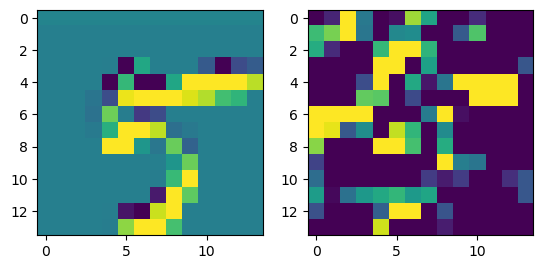

prediction: tensor([2, 6, 7]), tensor([5.6739, 1.8915, 0.9375]) groudtruth: 2
-0.09706092 0.086499244


<Figure size 640x480 with 0 Axes>

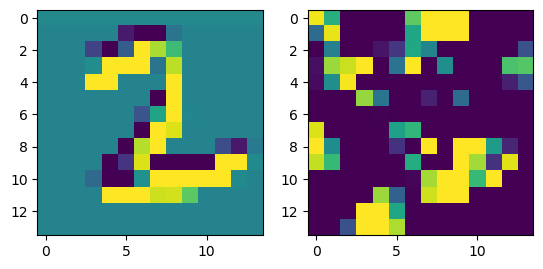

prediction: tensor([9, 4, 7]), tensor([3.1873, 2.1801, 2.0041]) groudtruth: 4
-0.114477694 0.09809155


<Figure size 640x480 with 0 Axes>

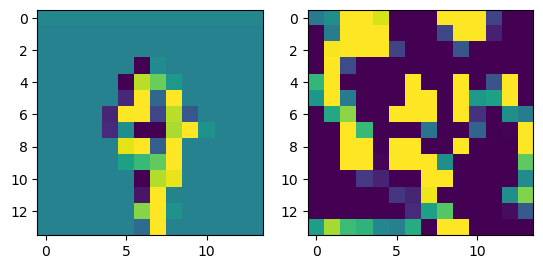

prediction: tensor([3, 2, 5]), tensor([4.8619, 3.5893, 1.7229]) groudtruth: 2
-0.07268387 0.093223006


<Figure size 640x480 with 0 Axes>

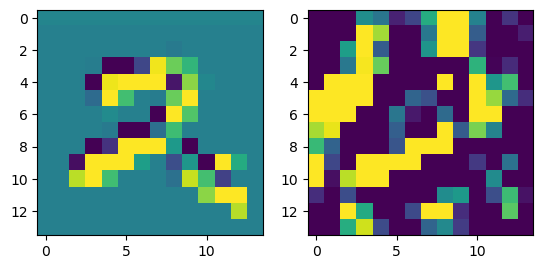

prediction: tensor([9, 8, 7]), tensor([3.9611, 2.1739, 1.4889]) groudtruth: 9
-0.08708918 0.08926205


<Figure size 640x480 with 0 Axes>

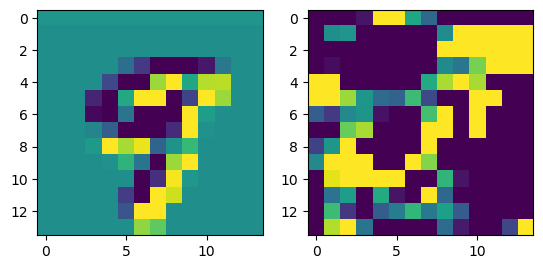

prediction: tensor([4, 2, 6]), tensor([5.6274, 1.6248, 1.3741]) groudtruth: 4
-0.073884726 0.1474239


<Figure size 640x480 with 0 Axes>

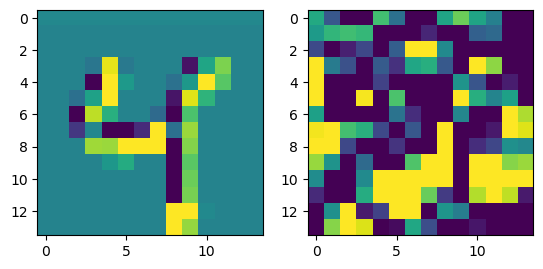

prediction: tensor([4, 5, 9]), tensor([7.0233, 1.1876, 0.1081]) groudtruth: 4
-0.099550486 0.08921654


<Figure size 640x480 with 0 Axes>

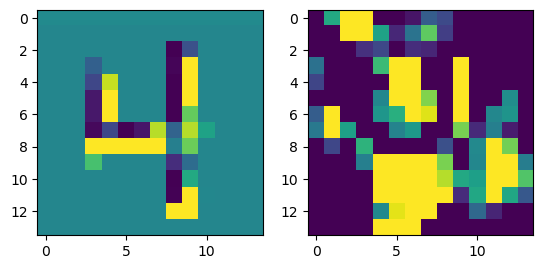

prediction: tensor([2, 3, 7]), tensor([5.0614, 3.2120, 1.4294]) groudtruth: 2
-0.119636714 0.08515315


<Figure size 640x480 with 0 Axes>

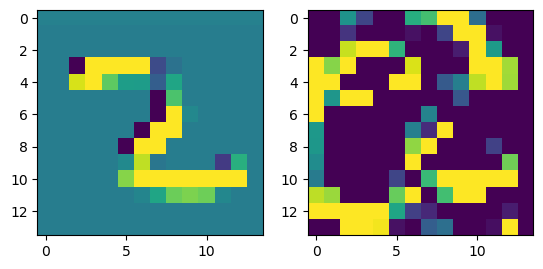

prediction: tensor([3, 0, 2]), tensor([3.3354, 2.7118, 1.8908]) groudtruth: 3
-0.07024336 0.05809286


<Figure size 640x480 with 0 Axes>

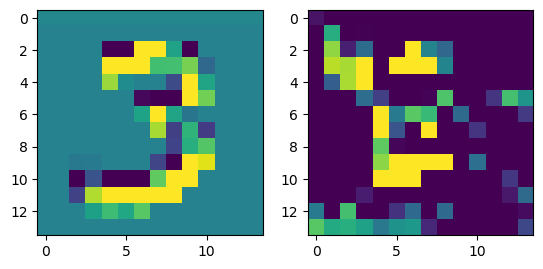

prediction: tensor([3, 9, 1]), tensor([4.5953, 2.0414, 1.3010]) groudtruth: 3
-0.0716328 0.09893914


<Figure size 640x480 with 0 Axes>

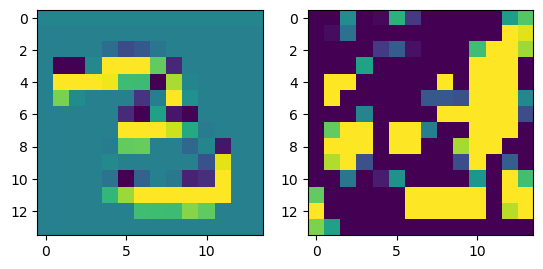

prediction: tensor([2, 3, 1]), tensor([6.4800, 2.5171, 2.3902]) groudtruth: 2
-0.10014117 0.060855553


<Figure size 640x480 with 0 Axes>

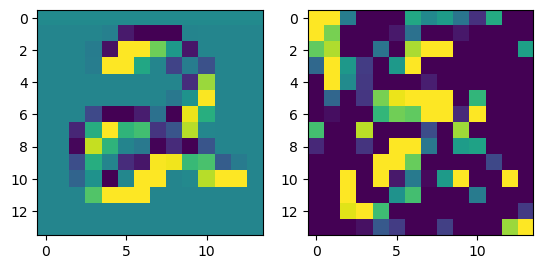

prediction: tensor([1, 3, 5]), tensor([4.4647, 3.2604, 2.8109]) groudtruth: 1
-0.05712384 0.089268565


<Figure size 640x480 with 0 Axes>

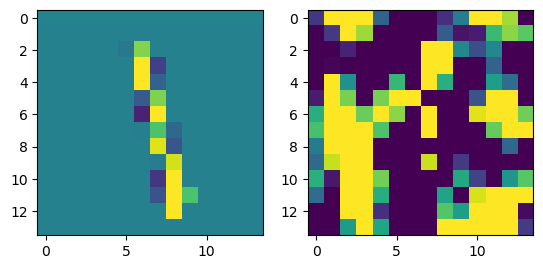

prediction: tensor([7, 0, 8]), tensor([5.3509, 2.8174, 0.6490]) groudtruth: 7
-0.07406348 0.088577196


<Figure size 640x480 with 0 Axes>

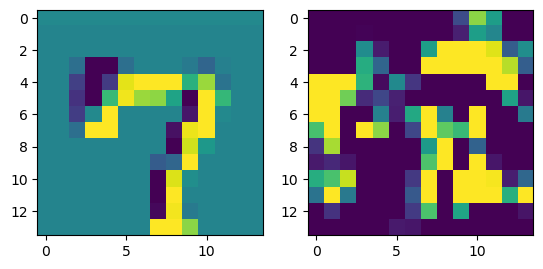

prediction: tensor([0, 9, 7]), tensor([2.6269, 1.9563, 1.1023]) groudtruth: 0
-0.080856204 0.09641276


<Figure size 640x480 with 0 Axes>

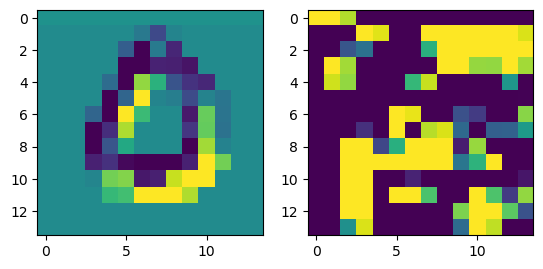

prediction: tensor([2, 1, 7]), tensor([2.3696, 1.1490, 0.8919]) groudtruth: 7
-0.07658124 0.06944036


<Figure size 640x480 with 0 Axes>

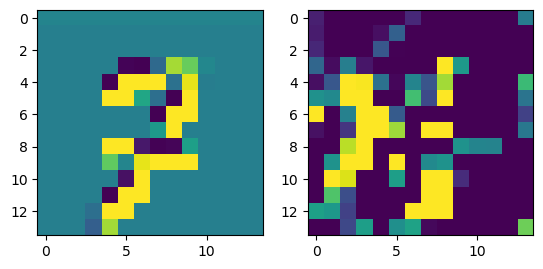

prediction: tensor([6, 9, 1]), tensor([3.5080, 1.4020, 0.7568]) groudtruth: 6
-0.07828605 0.07975958


<Figure size 640x480 with 0 Axes>

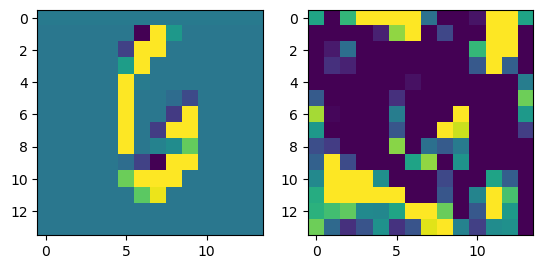

prediction: tensor([4, 8, 2]), tensor([3.1724, 2.7363, 2.2036]) groudtruth: 4
-0.10848373 0.092348255


<Figure size 640x480 with 0 Axes>

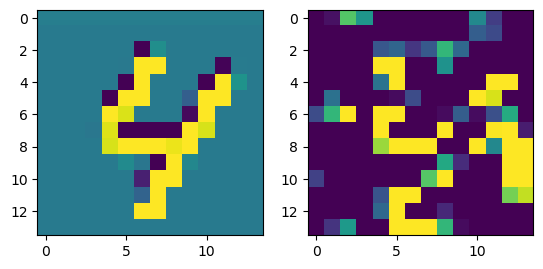

prediction: tensor([6, 0, 4]), tensor([3.3855, 1.6368, 1.4065]) groudtruth: 1
-0.080409646 0.06535557


<Figure size 640x480 with 0 Axes>

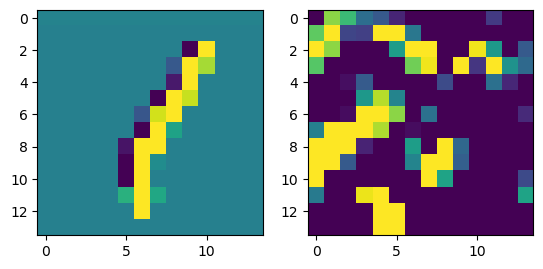

prediction: tensor([3, 8, 0]), tensor([3.9527, 1.5808, 0.6547]) groudtruth: 3
-0.10661954 0.1065905


<Figure size 640x480 with 0 Axes>

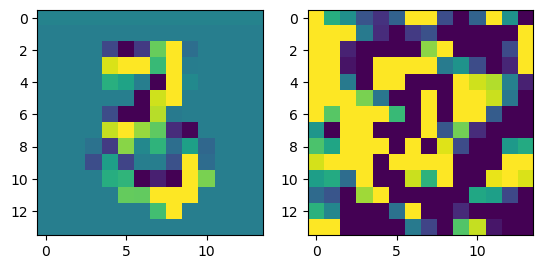

prediction: tensor([8, 3, 5]), tensor([4.1621, 1.0188, 1.0163]) groudtruth: 3
-0.08729857 0.10573955


<Figure size 640x480 with 0 Axes>

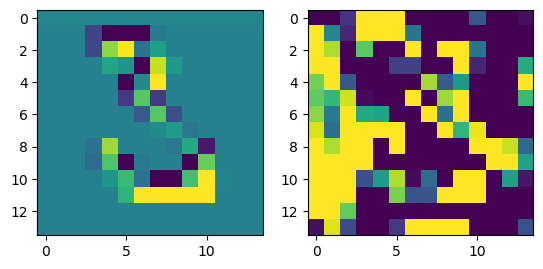

prediction: tensor([8, 9, 5]), tensor([5.2344, 3.7848, 1.0283]) groudtruth: 8
-0.073806465 0.083213724


<Figure size 640x480 with 0 Axes>

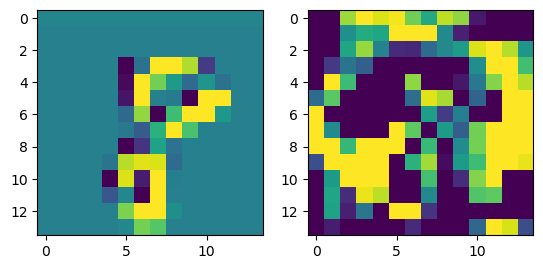

prediction: tensor([6, 1, 9]), tensor([4.3549, 1.0937, 0.8292]) groudtruth: 6
-0.08544904 0.09208578


<Figure size 640x480 with 0 Axes>

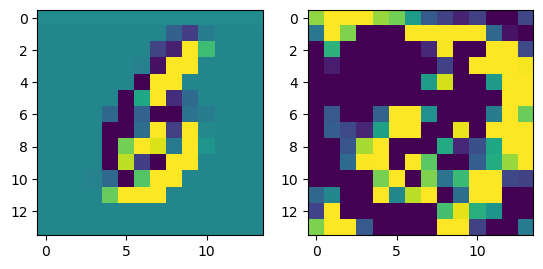

prediction: tensor([7, 6, 9]), tensor([3.7309, 1.0834, 0.7314]) groudtruth: 7
-0.07620925 0.09872737


<Figure size 640x480 with 0 Axes>

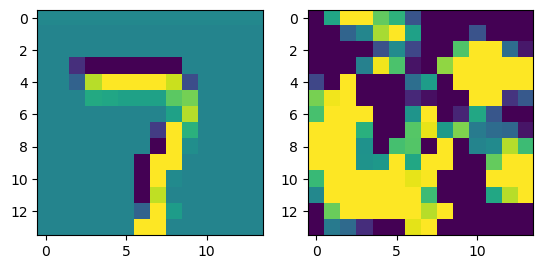

prediction: tensor([7, 4, 1]), tensor([3.8923, 2.0096, 1.6125]) groudtruth: 7
-0.094792485 0.07435943


<Figure size 640x480 with 0 Axes>

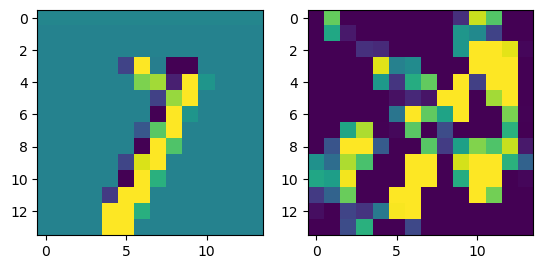

prediction: tensor([7, 0, 6]), tensor([5.6011, 1.8748, 0.9032]) groudtruth: 7
-0.06381804 0.06668633


<Figure size 640x480 with 0 Axes>

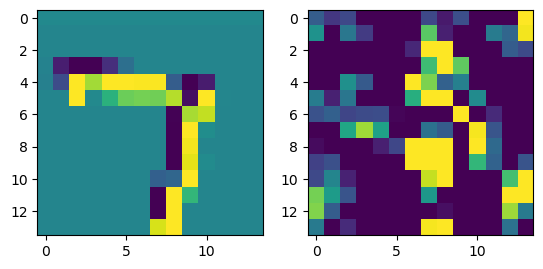

prediction: tensor([3, 4, 9]), tensor([3.0786, 1.7328, 0.7771]) groudtruth: 3
-0.08459592 0.103750706


<Figure size 640x480 with 0 Axes>

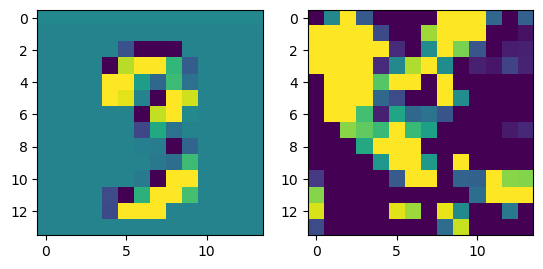

prediction: tensor([7, 2, 9]), tensor([4.1893, 1.7085, 1.0550]) groudtruth: 7
-0.09012437 0.07971485


<Figure size 640x480 with 0 Axes>

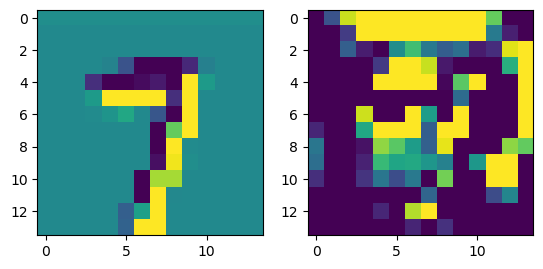

prediction: tensor([0, 3, 9]), tensor([8.1499, 2.4811, 1.3195]) groudtruth: 0
-0.09543139 0.0928511


<Figure size 640x480 with 0 Axes>

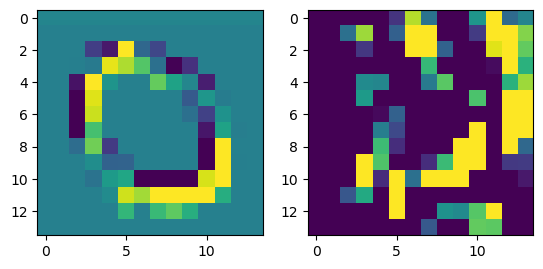

prediction: tensor([3, 5, 9]), tensor([4.4489, 4.0379, 2.0301]) groudtruth: 5
-0.10603809 0.12122837


<Figure size 640x480 with 0 Axes>

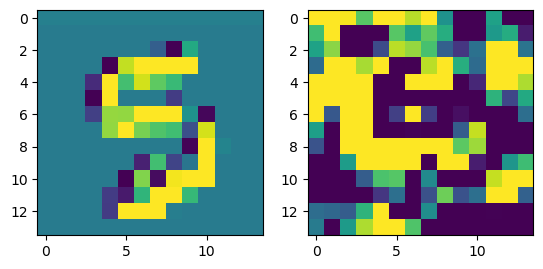

prediction: tensor([2, 9, 6]), tensor([3.0020, 1.6958, 1.5355]) groudtruth: 9
-0.09617978 0.08868201


<Figure size 640x480 with 0 Axes>

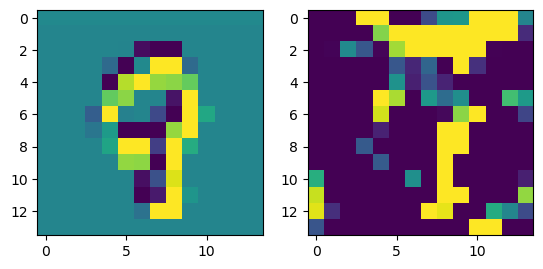

prediction: tensor([0, 7, 8]), tensor([5.7093, 2.0321, 0.9006]) groudtruth: 0
-0.09064835 0.07060867


<Figure size 640x480 with 0 Axes>

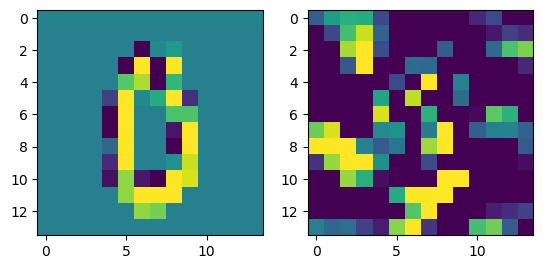

prediction: tensor([2, 6, 0]), tensor([3.0330, 1.2979, 0.3924]) groudtruth: 2
-0.07479358 0.07907292


<Figure size 640x480 with 0 Axes>

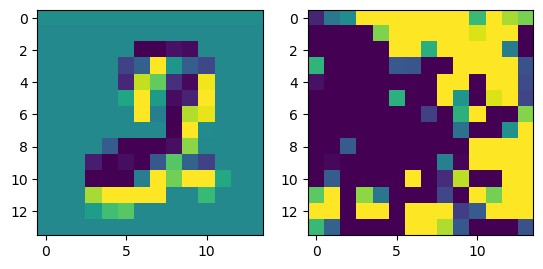

prediction: tensor([5, 8, 1]), tensor([2.3267, 1.3421, 1.1325]) groudtruth: 5
-0.09666437 0.06776117


<Figure size 640x480 with 0 Axes>

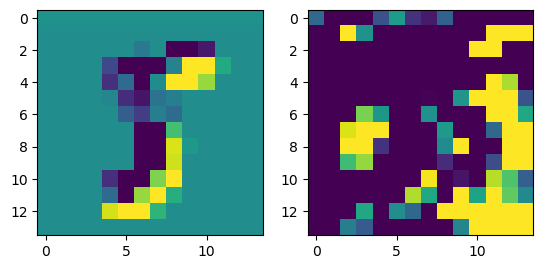

prediction: tensor([3, 9, 5]), tensor([3.3637, 2.6175, 1.3718]) groudtruth: 5
-0.069589496 0.072072595


<Figure size 640x480 with 0 Axes>

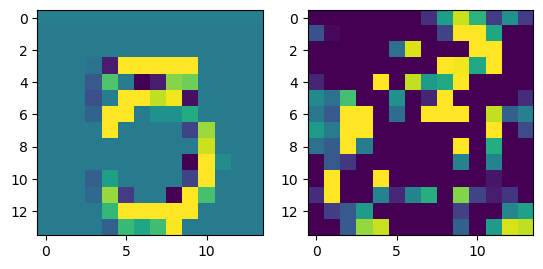

prediction: tensor([3, 7, 9]), tensor([3.9253, 2.6435, 0.5955]) groudtruth: 3
-0.079987586 0.11747871


<Figure size 640x480 with 0 Axes>

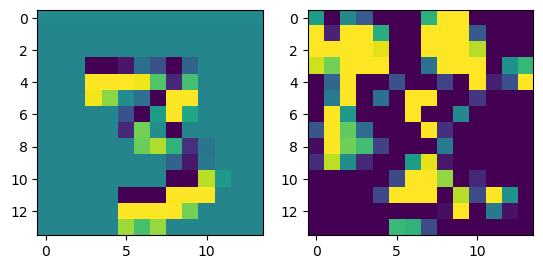

prediction: tensor([1, 3, 2]), tensor([3.7302, 3.1198, 1.9418]) groudtruth: 3
-0.11109471 0.081740886


<Figure size 640x480 with 0 Axes>

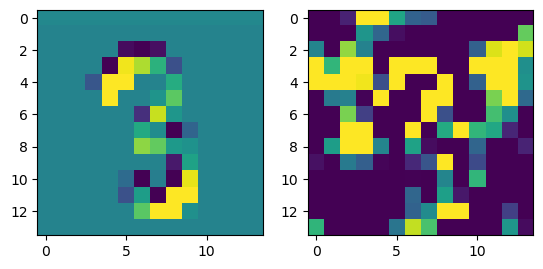

prediction: tensor([6, 2, 7]), tensor([2.6961, 2.3351, 0.6131]) groudtruth: 2
-0.07142186 0.07487048


<Figure size 640x480 with 0 Axes>

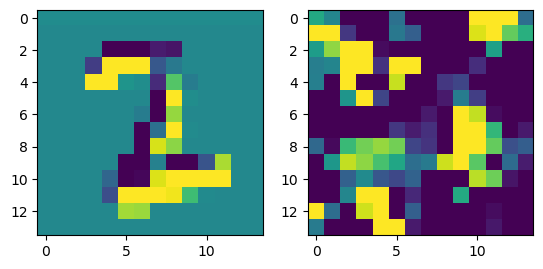

prediction: tensor([1, 8, 9]), tensor([5.1556, 1.8500, 0.7412]) groudtruth: 1
-0.07169157 0.07214892


<Figure size 640x480 with 0 Axes>

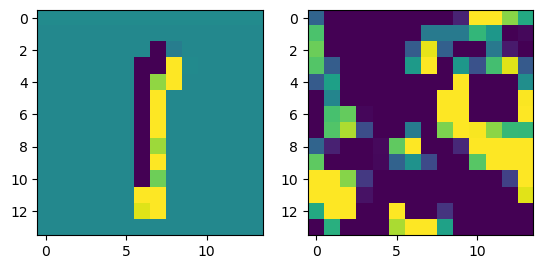

prediction: tensor([0, 8, 9]), tensor([4.9526, 1.4800, 1.2438]) groudtruth: 0
-0.060830295 0.10898812


<Figure size 640x480 with 0 Axes>

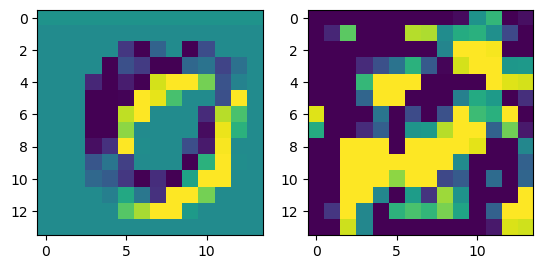

prediction: tensor([2, 7, 9]), tensor([4.3415, 1.9628, 1.2838]) groudtruth: 7
-0.07456076 0.07209739


<Figure size 640x480 with 0 Axes>

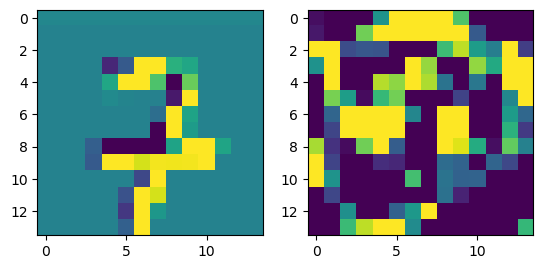

prediction: tensor([3, 2, 5]), tensor([3.6605, 2.7220, 1.7206]) groudtruth: 3
-0.093250334 0.08389672


<Figure size 640x480 with 0 Axes>

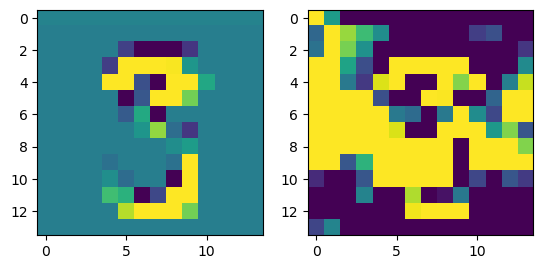

prediction: tensor([6, 4, 7]), tensor([2.6554, 2.3131, 0.3984]) groudtruth: 4
-0.080650866 0.07648255


<Figure size 640x480 with 0 Axes>

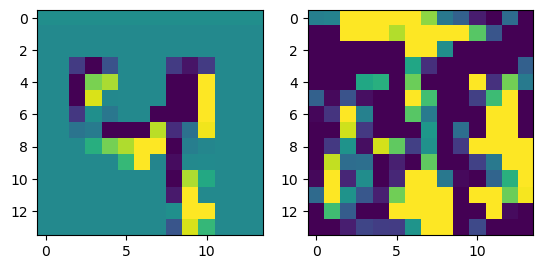

prediction: tensor([0, 6, 7]), tensor([3.1268, 2.2334, 0.9909]) groudtruth: 0
-0.09146309 0.05844634


<Figure size 640x480 with 0 Axes>

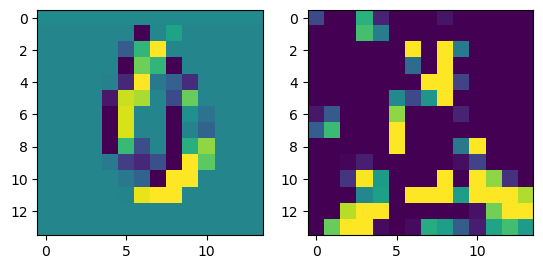

prediction: tensor([3, 1, 7]), tensor([5.7170, 1.7745, 0.9361]) groudtruth: 3
-0.064786375 0.07276689


<Figure size 640x480 with 0 Axes>

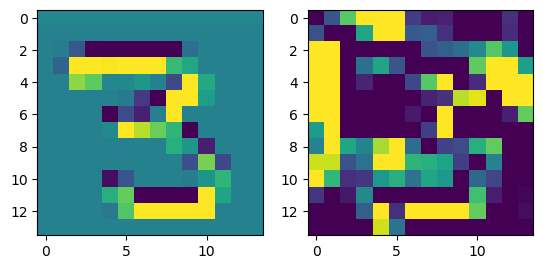

prediction: tensor([9, 7, 6]), tensor([4.7680, 1.8134, 0.0400]) groudtruth: 9
-0.08885467 0.08345473


<Figure size 640x480 with 0 Axes>

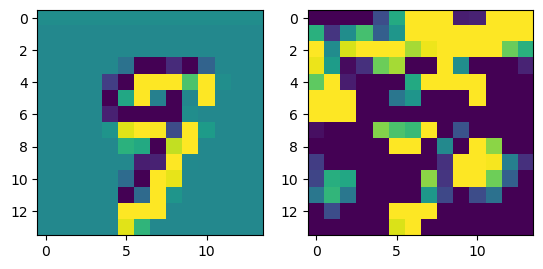

prediction: tensor([3, 6, 5]), tensor([3.7076, 1.0417, 0.7443]) groudtruth: 3
-0.093209684 0.08974702


<Figure size 640x480 with 0 Axes>

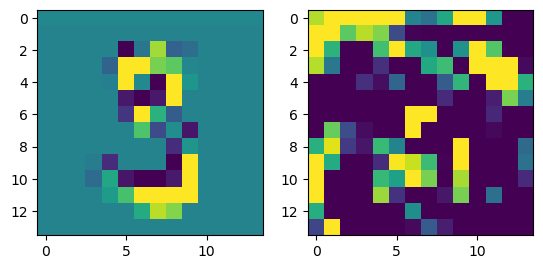

prediction: tensor([2, 7, 5]), tensor([2.7586, 2.6301, 1.3365]) groudtruth: 2
-0.11076218 0.10077286


<Figure size 640x480 with 0 Axes>

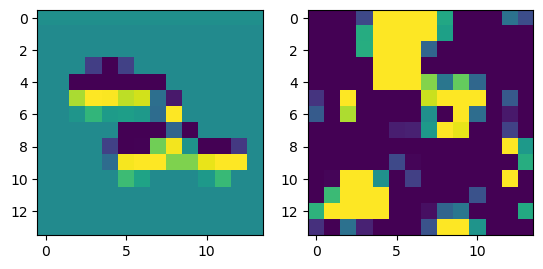

prediction: tensor([0, 8, 9]), tensor([2.0698, 1.6882, 1.5433]) groudtruth: 8
-0.062015414 0.09885697


<Figure size 640x480 with 0 Axes>

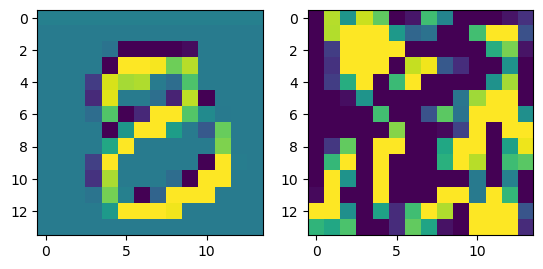

prediction: tensor([9, 3, 8]), tensor([5.8369, 2.8695, 2.4021]) groudtruth: 9
-0.08102012 0.076826364


<Figure size 640x480 with 0 Axes>

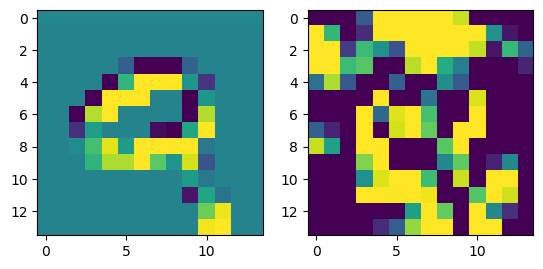

prediction: tensor([0, 3, 6]), tensor([4.7533, 1.6133, 0.1176]) groudtruth: 0
-0.067691684 0.06838991


<Figure size 640x480 with 0 Axes>

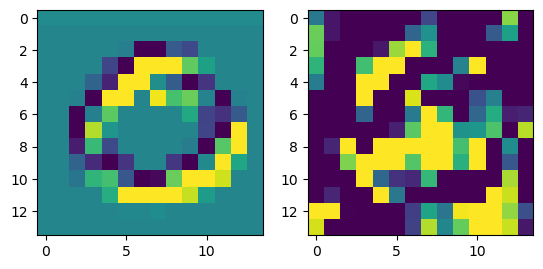

prediction: tensor([3, 5, 8]), tensor([3.3017, 2.3565, 1.4226]) groudtruth: 3
-0.0527339 0.07499194


<Figure size 640x480 with 0 Axes>

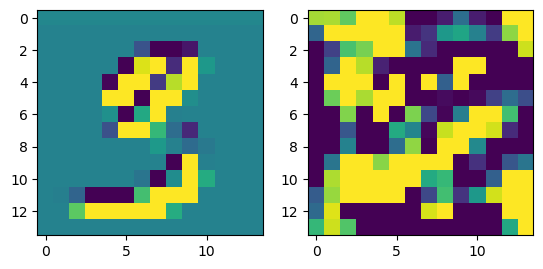

prediction: tensor([1, 7, 3]), tensor([4.6868, 1.0772, 0.8436]) groudtruth: 1
-0.0729031 0.09057908


<Figure size 640x480 with 0 Axes>

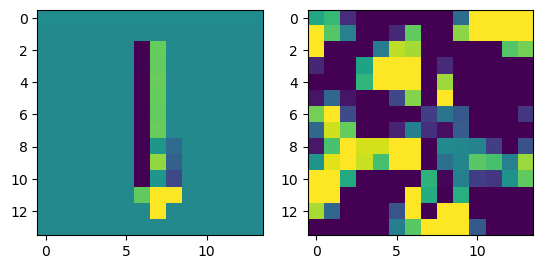

prediction: tensor([3, 5, 2]), tensor([5.2911, 3.5683, 1.1657]) groudtruth: 5
-0.08096355 0.081916444


<Figure size 640x480 with 0 Axes>

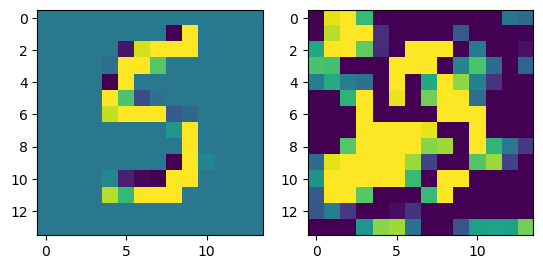

prediction: tensor([3, 5, 2]), tensor([3.3136, 1.8108, 0.8506]) groudtruth: 3
-0.07873416 0.105715856


<Figure size 640x480 with 0 Axes>

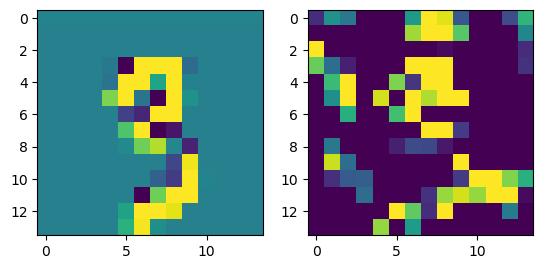

prediction: tensor([8, 5, 6]), tensor([4.8673, 1.8100, 1.8005]) groudtruth: 8
-0.06352222 0.08275629


<Figure size 640x480 with 0 Axes>

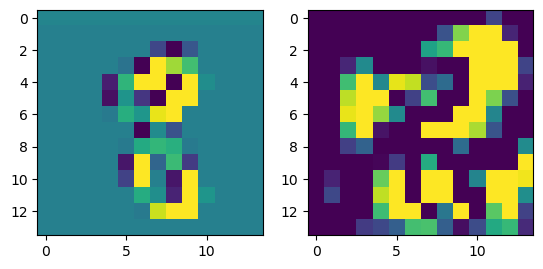

prediction: tensor([9, 7, 1]), tensor([4.3398, 2.0488, 1.4460]) groudtruth: 9
-0.10134041 0.086055554


<Figure size 640x480 with 0 Axes>

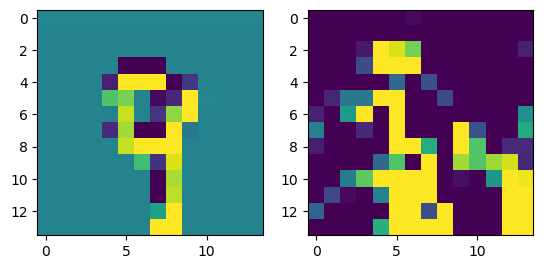

prediction: tensor([1, 6, 8]), tensor([5.1959, 0.8408, 0.4879]) groudtruth: 1
-0.0925737 0.0773039


<Figure size 640x480 with 0 Axes>

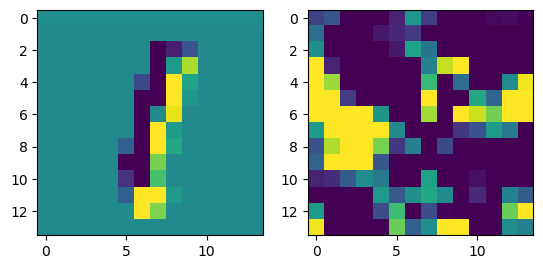

prediction: tensor([9, 1, 7]), tensor([4.4137, 0.9012, 0.8894]) groudtruth: 9
-0.09951556 0.048553567


<Figure size 640x480 with 0 Axes>

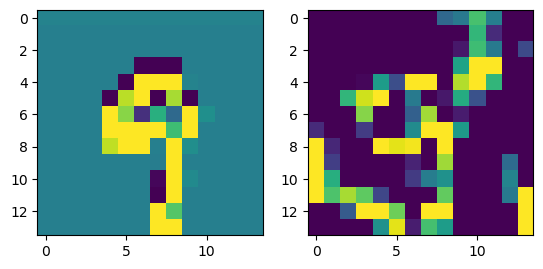

prediction: tensor([4, 9, 3]), tensor([3.1496, 2.9686, 2.5609]) groudtruth: 7
-0.12381542 0.090313144


<Figure size 640x480 with 0 Axes>

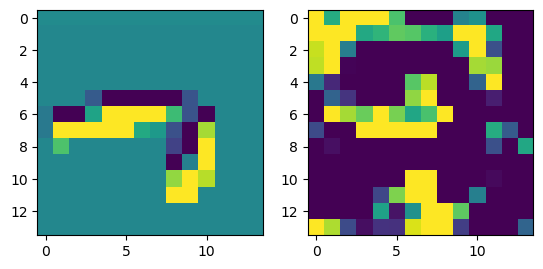

prediction: tensor([9, 1, 7]), tensor([2.9643, 2.6518, 1.9563]) groudtruth: 9
-0.083420634 0.09342103


<Figure size 640x480 with 0 Axes>

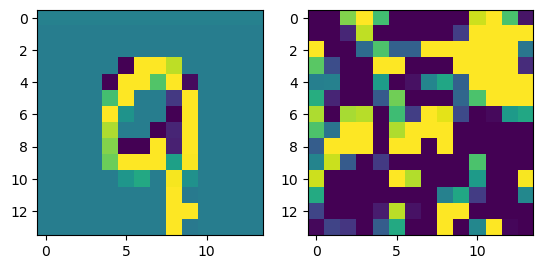

prediction: tensor([5, 3, 9]), tensor([3.3346, 2.4652, 1.5240]) groudtruth: 5
-0.08793074 0.110279754


<Figure size 640x480 with 0 Axes>

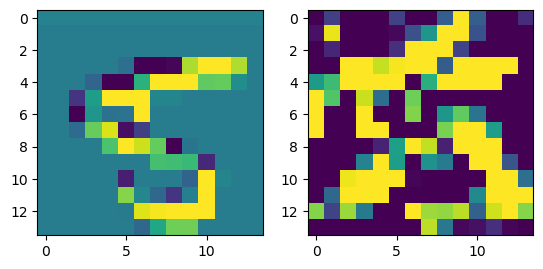

prediction: tensor([3, 5, 7]), tensor([2.1157, 1.8925, 1.2871]) groudtruth: 5
-0.07257557 0.1078122


<Figure size 640x480 with 0 Axes>

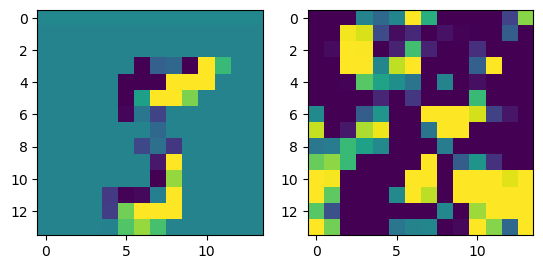

prediction: tensor([2, 4, 8]), tensor([3.7712, 2.3988, 1.8503]) groudtruth: 2
-0.10286921 0.11881165


<Figure size 640x480 with 0 Axes>

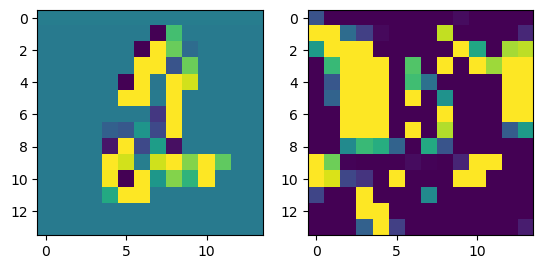

prediction: tensor([7, 8, 9]), tensor([4.5017, 1.7831, 1.4541]) groudtruth: 7
-0.07210851 0.078277245


<Figure size 640x480 with 0 Axes>

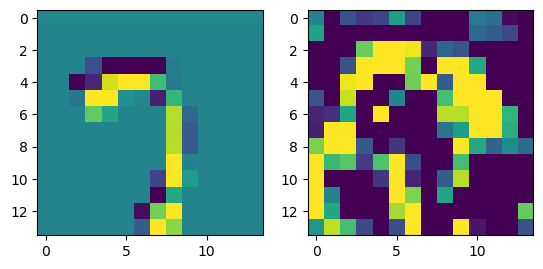

prediction: tensor([7, 4, 0]), tensor([3.8774, 2.8302, 1.4761]) groudtruth: 4
-0.07841265 0.07801288


<Figure size 640x480 with 0 Axes>

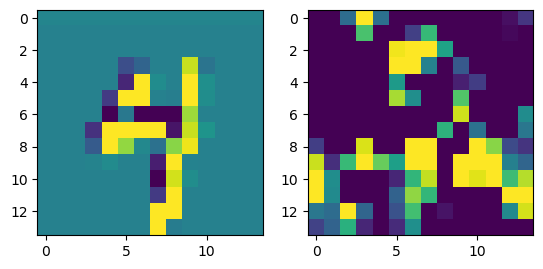

prediction: tensor([0, 6, 8]), tensor([4.3090, 2.4017, 2.0376]) groudtruth: 6
-0.08559567 0.10852196


<Figure size 640x480 with 0 Axes>

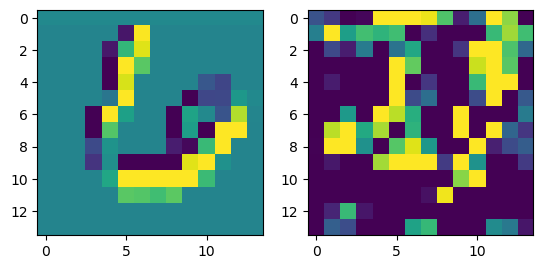

prediction: tensor([0, 6, 5]), tensor([7.1436, 3.4345, 1.1327]) groudtruth: 0
-0.07954109 0.053842522


<Figure size 640x480 with 0 Axes>

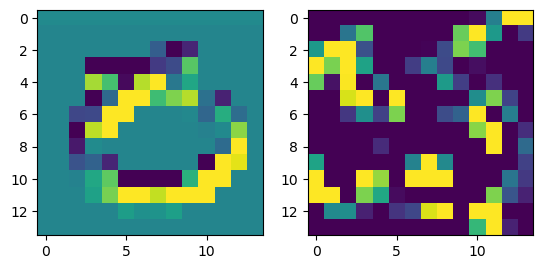

prediction: tensor([2, 1, 3]), tensor([3.4377, 2.9515, 1.3815]) groudtruth: 2
-0.09545982 0.08293949


<Figure size 640x480 with 0 Axes>

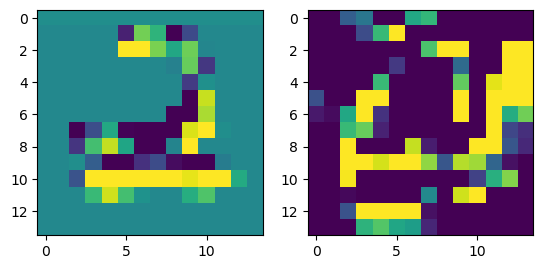

prediction: tensor([1, 0, 3]), tensor([3.7669, 2.1062, 1.2147]) groudtruth: 1
-0.072135866 0.11077461


<Figure size 640x480 with 0 Axes>

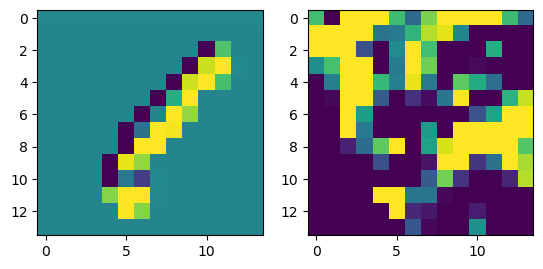

prediction: tensor([6, 4, 9]), tensor([2.9102, 2.2567, 2.0449]) groudtruth: 6
-0.07474846 0.055290017


<Figure size 640x480 with 0 Axes>

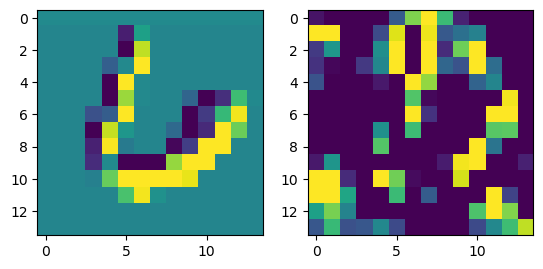

prediction: tensor([9, 5, 7]), tensor([3.7272, 1.8099, 0.2852]) groudtruth: 9
-0.11709654 0.063069284


<Figure size 640x480 with 0 Axes>

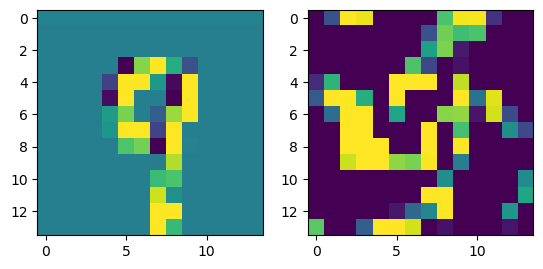

prediction: tensor([3, 9, 5]), tensor([3.4669, 1.9768, 1.4492]) groudtruth: 3
-0.13129753 0.13332406


<Figure size 640x480 with 0 Axes>

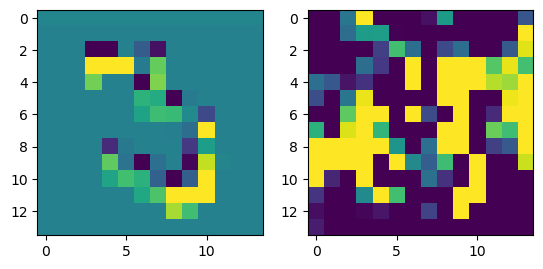

prediction: tensor([1, 6, 3]), tensor([4.2467, 1.7504, 0.2435]) groudtruth: 1
-0.07634354 0.0909189


<Figure size 640x480 with 0 Axes>

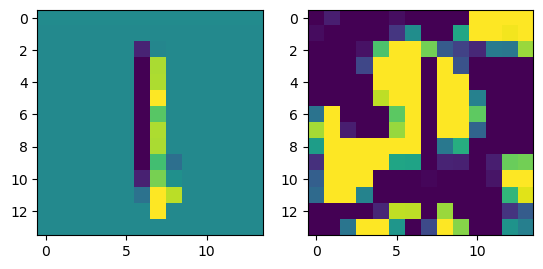

prediction: tensor([8, 5, 3]), tensor([2.6175, 1.9151, 1.1734]) groudtruth: 8
-0.08530843 0.08206755


<Figure size 640x480 with 0 Axes>

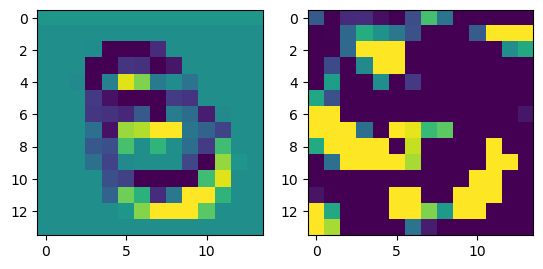

prediction: tensor([6, 8, 0]), tensor([ 8.7344,  0.0365, -0.1762]) groudtruth: 6
-0.10544449 0.09270108


<Figure size 640x480 with 0 Axes>

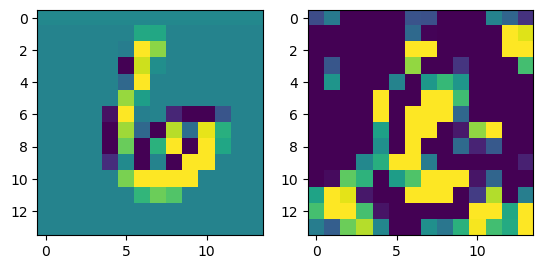

prediction: tensor([2, 5, 8]), tensor([2.4304, 2.3338, 1.2838]) groudtruth: 9
-0.06864393 0.08585279


<Figure size 640x480 with 0 Axes>

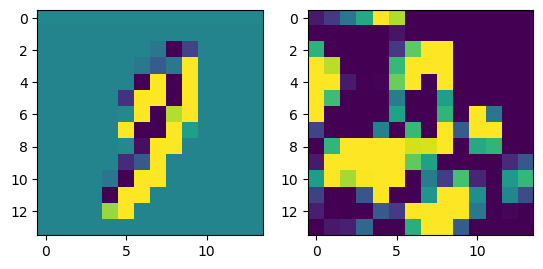

prediction: tensor([0, 6, 2]), tensor([5.8660, 3.7147, 0.7152]) groudtruth: 0
-0.08330709 0.0829141


<Figure size 640x480 with 0 Axes>

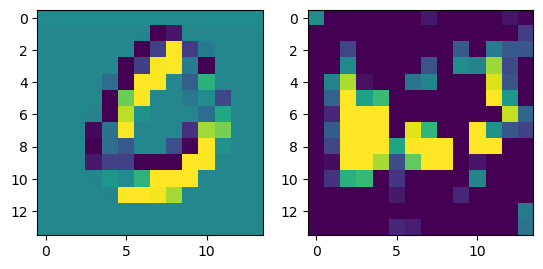

prediction: tensor([6, 1, 3]), tensor([5.6109, 0.8226, 0.2217]) groudtruth: 6
-0.07217449 0.06663482


<Figure size 640x480 with 0 Axes>

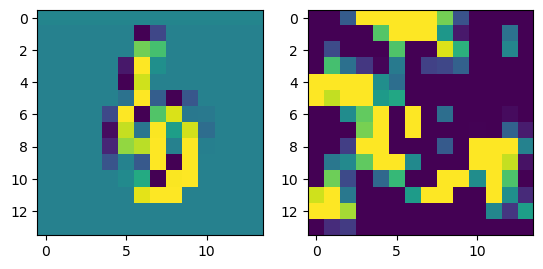

prediction: tensor([0, 3, 6]), tensor([4.7081, 1.6244, 0.9584]) groudtruth: 0
-0.08479577 0.08944264


<Figure size 640x480 with 0 Axes>

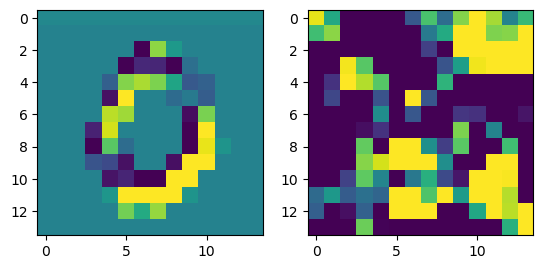

prediction: tensor([0, 8, 5]), tensor([4.2920, 1.6053, 0.5948]) groudtruth: 0
-0.05571562 0.058210544


<Figure size 640x480 with 0 Axes>

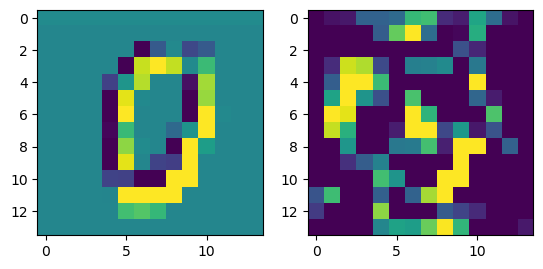

prediction: tensor([0, 7, 3]), tensor([5.5300, 1.7164, 0.4169]) groudtruth: 0
-0.109372675 0.086208075


<Figure size 640x480 with 0 Axes>

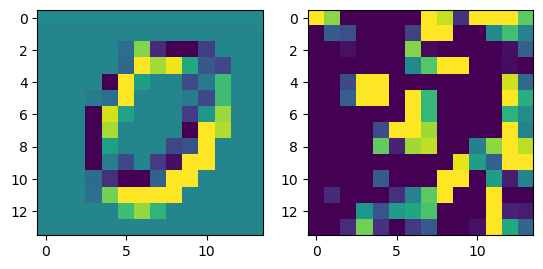

prediction: tensor([6, 9, 0]), tensor([3.6034, 2.7089, 1.9087]) groudtruth: 6
-0.078430235 0.07524063


<Figure size 640x480 with 0 Axes>

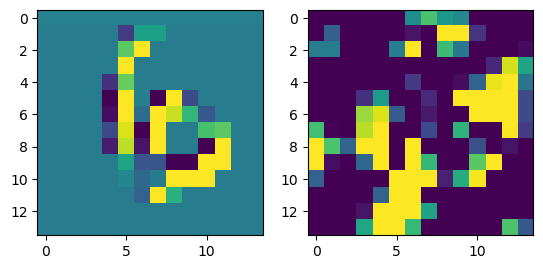

prediction: tensor([3, 2, 5]), tensor([3.2443, 1.9796, 0.6448]) groudtruth: 3
-0.09788638 0.08313739


<Figure size 640x480 with 0 Axes>

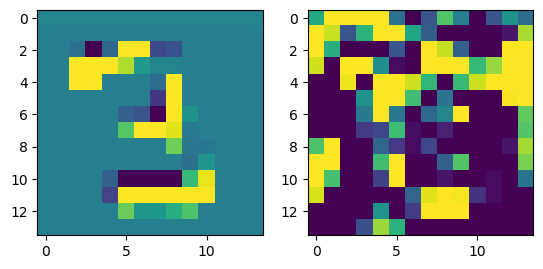

prediction: tensor([1, 6, 8]), tensor([6.3457, 2.4777, 0.2300]) groudtruth: 1
-0.08265227 0.09522145


<Figure size 640x480 with 0 Axes>

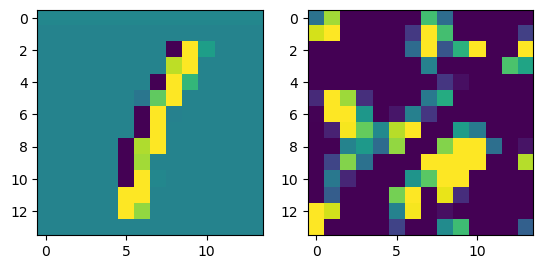

prediction: tensor([0, 4, 8]), tensor([4.9048, 0.8580, 0.2393]) groudtruth: 0
-0.10655892 0.11492273


<Figure size 640x480 with 0 Axes>

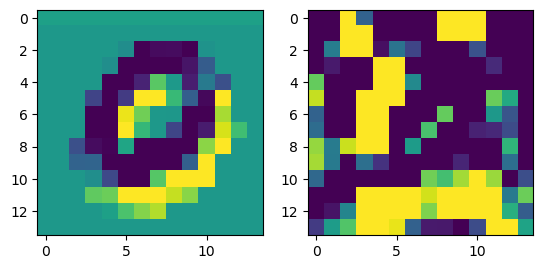

prediction: tensor([4, 9, 8]), tensor([3.0758, 3.0522, 2.2180]) groudtruth: 4
-0.09084791 0.055455457


<Figure size 640x480 with 0 Axes>

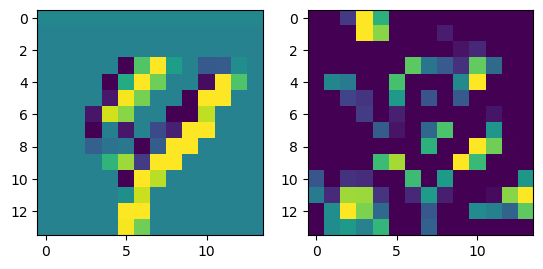

prediction: tensor([4, 1, 2]), tensor([4.0526, 1.5177, 0.7512]) groudtruth: 4
-0.10433686 0.111827955


<Figure size 640x480 with 0 Axes>

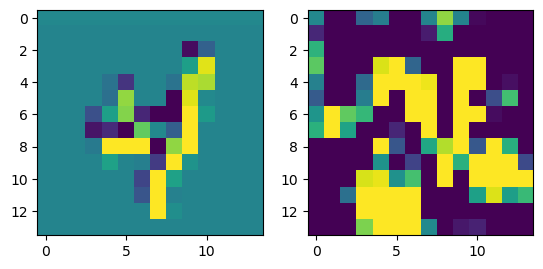

prediction: tensor([2, 7, 6]), tensor([5.2913, 3.3866, 0.9697]) groudtruth: 7
-0.06471938 0.08425431


<Figure size 640x480 with 0 Axes>

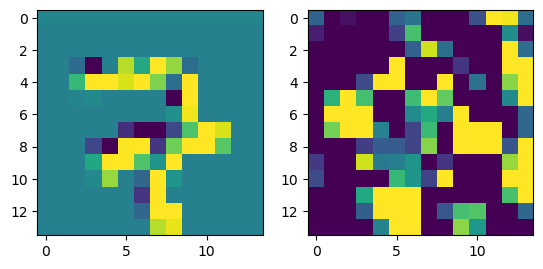

prediction: tensor([0, 3, 6]), tensor([4.9135, 2.2338, 0.6284]) groudtruth: 0
-0.089359224 0.07107857


<Figure size 640x480 with 0 Axes>

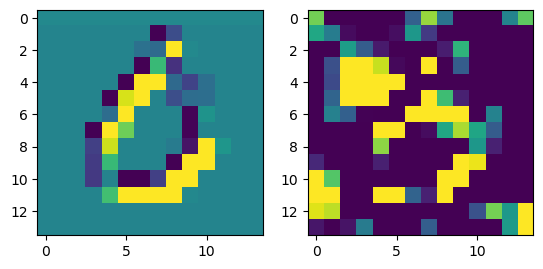

prediction: tensor([1, 2, 4]), tensor([5.6846, 2.1100, 0.8075]) groudtruth: 1
-0.08822906 0.08776139


<Figure size 640x480 with 0 Axes>

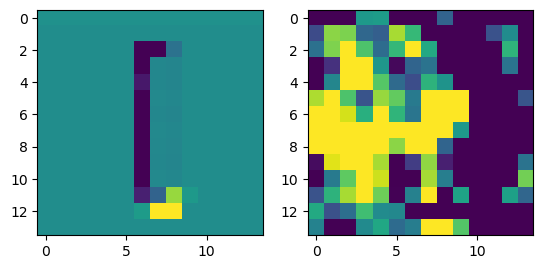

prediction: tensor([4, 8, 7]), tensor([2.3400, 1.2692, 1.2358]) groudtruth: 7
-0.104705095 0.07777467


<Figure size 640x480 with 0 Axes>

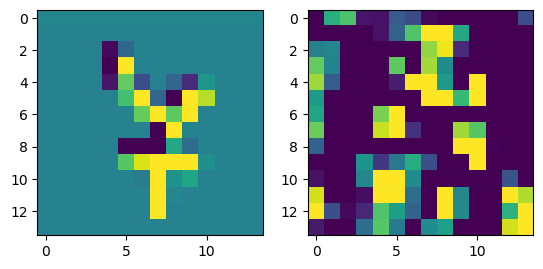

prediction: tensor([0, 8, 9]), tensor([2.9807, 2.8521, 0.4774]) groudtruth: 0
-0.084111154 0.07525274


<Figure size 640x480 with 0 Axes>

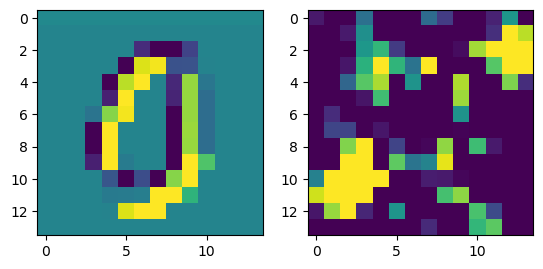

prediction: tensor([1, 8, 2]), tensor([4.3694, 2.5140, 0.6241]) groudtruth: 1
-0.07775831 0.073892936


<Figure size 640x480 with 0 Axes>

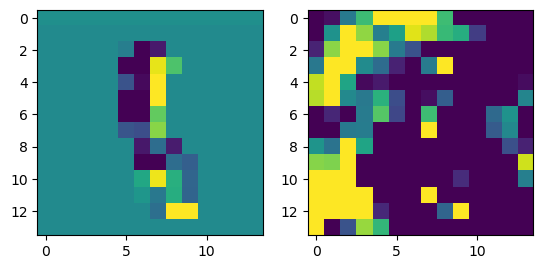

prediction: tensor([6, 4, 1]), tensor([6.0602, 1.0773, 1.0297]) groudtruth: 6
-0.08817983 0.10037737


<Figure size 640x480 with 0 Axes>

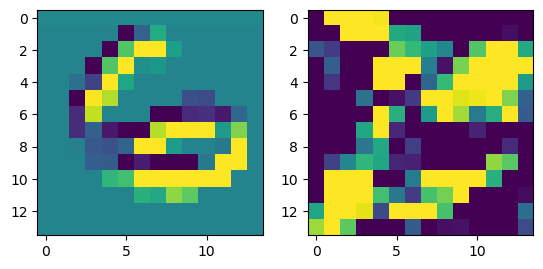

prediction: tensor([1, 8, 3]), tensor([4.5835, 2.7747, 1.4976]) groudtruth: 1
-0.07858449 0.122399315


<Figure size 640x480 with 0 Axes>

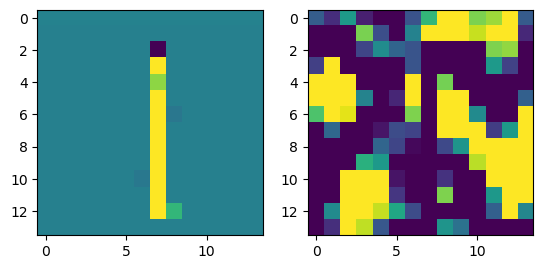

prediction: tensor([4, 8, 9]), tensor([3.1286, 1.5003, 1.2414]) groudtruth: 4
-0.082398534 0.0900786


<Figure size 640x480 with 0 Axes>

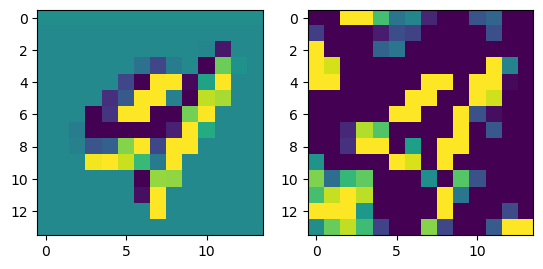

prediction: tensor([9, 5, 6]), tensor([2.5097, 2.3750, 0.8167]) groudtruth: 5
-0.095314145 0.07743794


<Figure size 640x480 with 0 Axes>

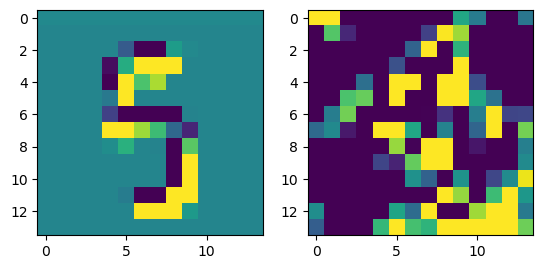

prediction: tensor([6, 4, 9]), tensor([3.2834, 2.1704, 1.8730]) groudtruth: 6
-0.08658397 0.07648001


<Figure size 640x480 with 0 Axes>

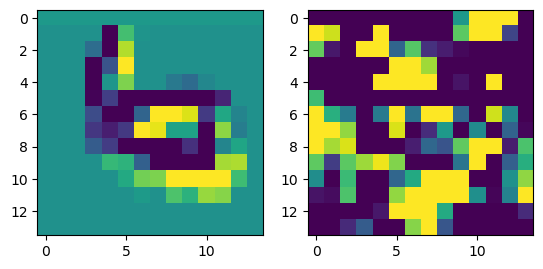

prediction: tensor([6, 5, 2]), tensor([4.7557, 1.9196, 1.2648]) groudtruth: 6
-0.06137806 0.065854825


<Figure size 640x480 with 0 Axes>

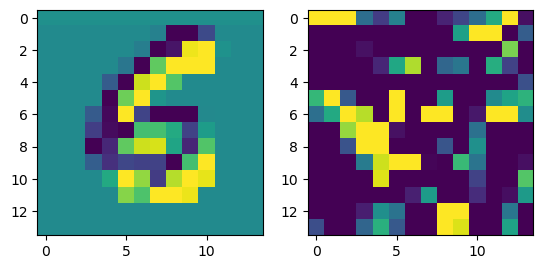

prediction: tensor([1, 8, 6]), tensor([6.7722, 0.9981, 0.8899]) groudtruth: 1
-0.061165154 0.068051055


<Figure size 640x480 with 0 Axes>

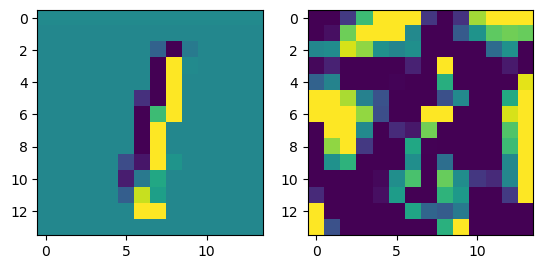

prediction: tensor([3, 5, 8]), tensor([3.2931, 1.8721, 1.8084]) groudtruth: 3
-0.073593795 0.07666768


<Figure size 640x480 with 0 Axes>

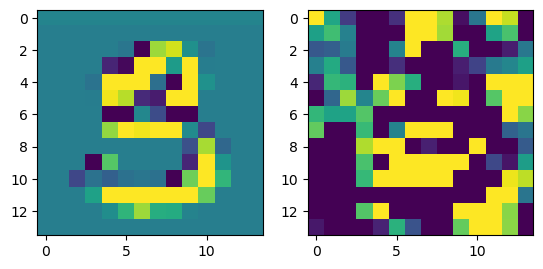

prediction: tensor([4, 8, 7]), tensor([4.1068, 1.3890, 0.9871]) groudtruth: 4
-0.08706659 0.09942383


<Figure size 640x480 with 0 Axes>

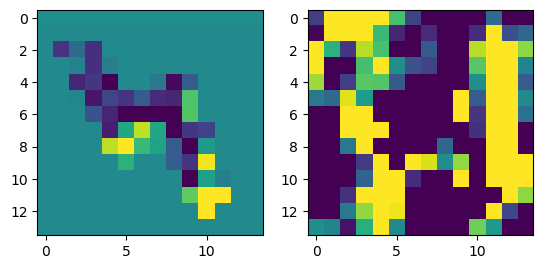

prediction: tensor([3, 9, 5]), tensor([2.3702, 2.2813, 1.3530]) groudtruth: 9
-0.083898485 0.084070876


<Figure size 640x480 with 0 Axes>

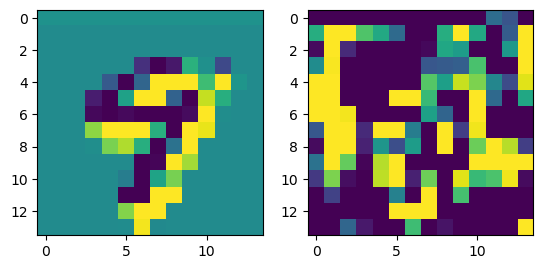

prediction: tensor([3, 7, 2]), tensor([3.9547, 1.7664, 1.3330]) groudtruth: 3
-0.09702283 0.092633635


<Figure size 640x480 with 0 Axes>

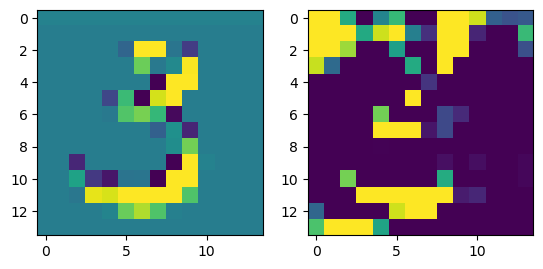

prediction: tensor([1, 0, 8]), tensor([3.8651, 1.1581, 0.8915]) groudtruth: 1
-0.06569153 0.06389108


<Figure size 640x480 with 0 Axes>

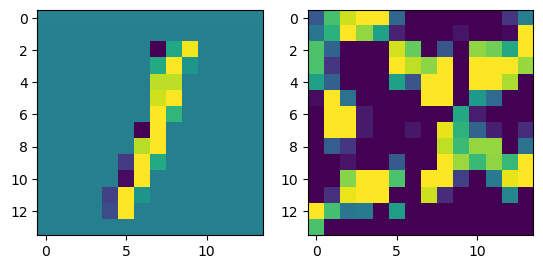

prediction: tensor([4, 1, 9]), tensor([6.1232, 1.5402, 0.8125]) groudtruth: 4
-0.082392156 0.101392426


<Figure size 640x480 with 0 Axes>

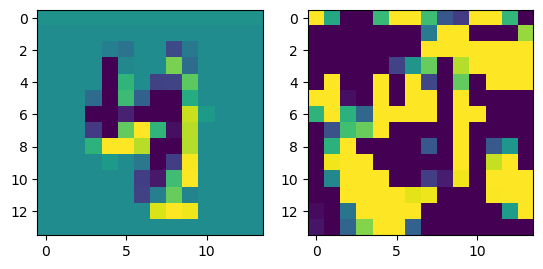

prediction: tensor([7, 2, 3]), tensor([4.2181, 3.5543, 0.0414]) groudtruth: 7
-0.08357334 0.0691096


<Figure size 640x480 with 0 Axes>

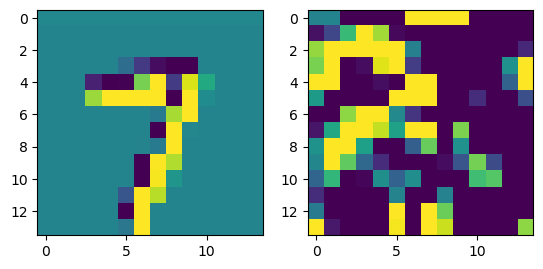

prediction: tensor([1, 9, 7]), tensor([2.6751, 2.6518, 2.4165]) groudtruth: 7
-0.06769091 0.081427455


<Figure size 640x480 with 0 Axes>

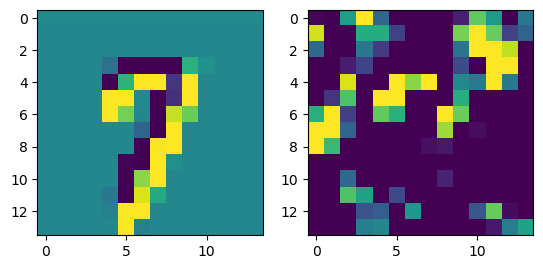

prediction: tensor([4, 5, 1]), tensor([5.5460, 1.8370, 1.0130]) groudtruth: 4
-0.081908405 0.052737176


<Figure size 640x480 with 0 Axes>

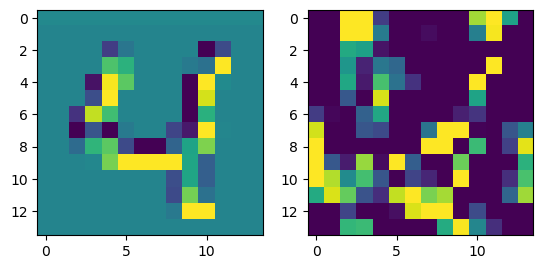

prediction: tensor([7, 3, 9]), tensor([4.4294, 1.7754, 1.4689]) groudtruth: 7
-0.06254876 0.08169411


<Figure size 640x480 with 0 Axes>

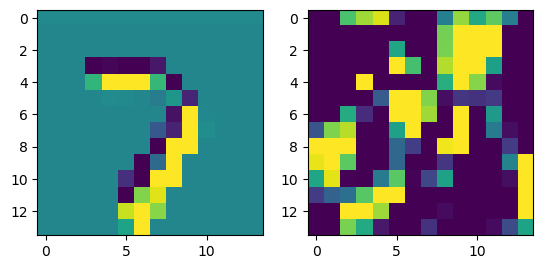

prediction: tensor([2, 6, 3]), tensor([3.4956, 2.1825, 1.6426]) groudtruth: 2
-0.08368778 0.0915913


<Figure size 640x480 with 0 Axes>

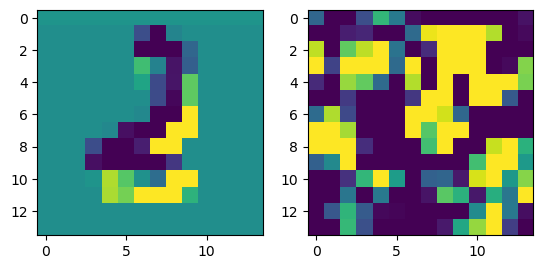

prediction: tensor([9, 0, 3]), tensor([4.7927, 0.9063, 0.8609]) groudtruth: 9
-0.087112725 0.08703815


<Figure size 640x480 with 0 Axes>

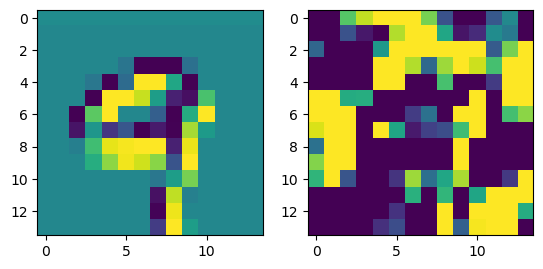

prediction: tensor([9, 3, 1]), tensor([3.4632, 2.9908, 1.7154]) groudtruth: 3
-0.11012858 0.09105562


<Figure size 640x480 with 0 Axes>

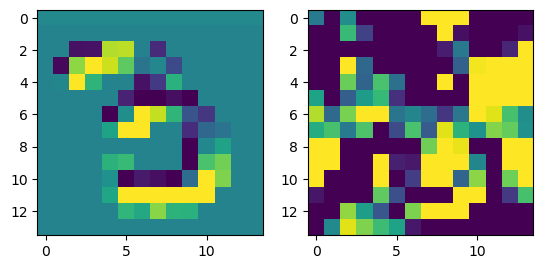

prediction: tensor([0, 9, 5]), tensor([3.1354, 1.9242, 1.1189]) groudtruth: 0
-0.04385525 0.062911674


<Figure size 640x480 with 0 Axes>

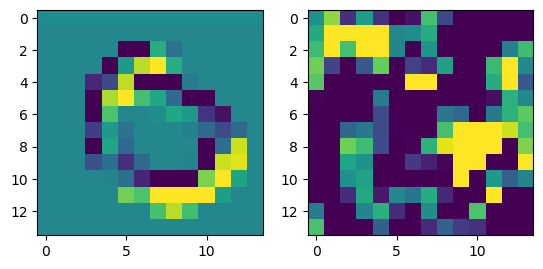

prediction: tensor([8, 1, 2]), tensor([5.9019, 2.2627, 0.6275]) groudtruth: 8
-0.08866888 0.07557785


<Figure size 640x480 with 0 Axes>

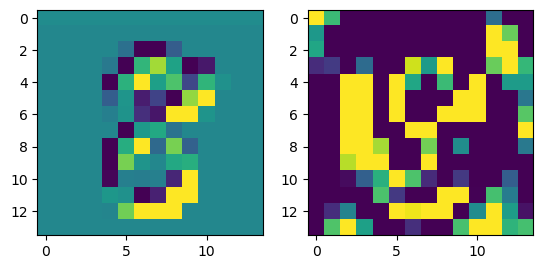

prediction: tensor([0, 8, 5]), tensor([4.4978, 2.6698, 1.1682]) groudtruth: 0
-0.063515544 0.07887462


<Figure size 640x480 with 0 Axes>

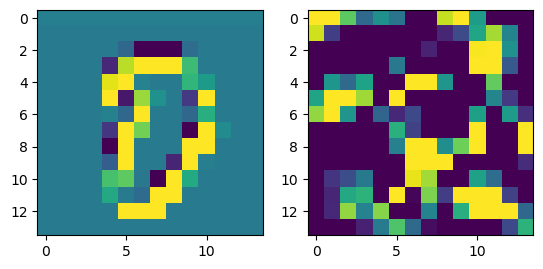

prediction: tensor([3, 9, 7]), tensor([3.1689, 2.3967, 1.9004]) groudtruth: 3
-0.07552719 0.08937162


<Figure size 640x480 with 0 Axes>

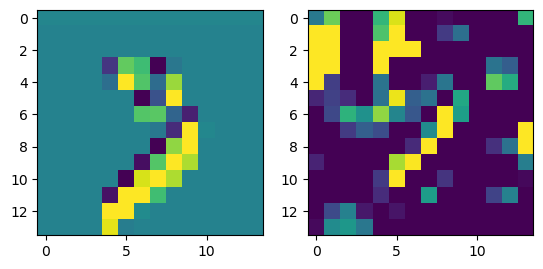

prediction: tensor([7, 0, 1]), tensor([4.7475, 2.7095, 2.0514]) groudtruth: 1
-0.078250885 0.08683863


<Figure size 640x480 with 0 Axes>

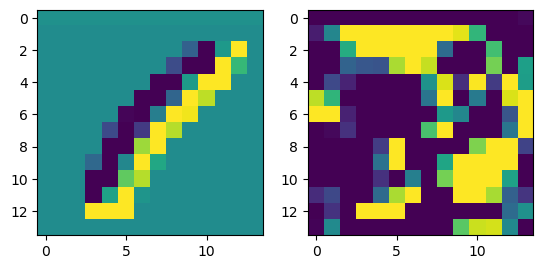

prediction: tensor([6, 5, 7]), tensor([5.2440, 1.2626, 1.1777]) groudtruth: 6
-0.085942686 0.05657404


<Figure size 640x480 with 0 Axes>

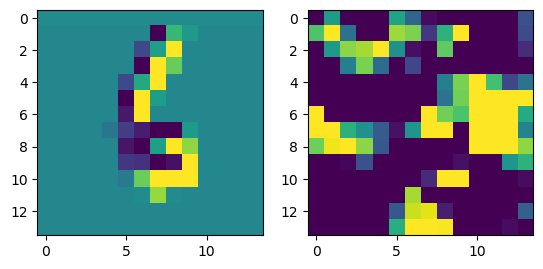

prediction: tensor([5, 1, 3]), tensor([4.9550, 1.8315, 1.3141]) groudtruth: 5
-0.097123265 0.072433904


<Figure size 640x480 with 0 Axes>

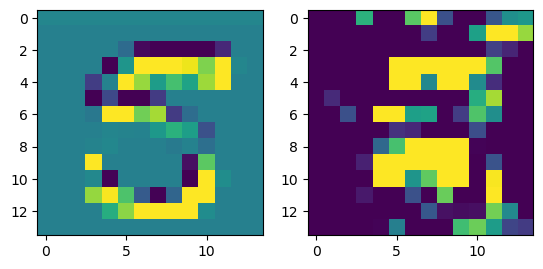

prediction: tensor([8, 5, 3]), tensor([5.0076, 2.2461, 1.8347]) groudtruth: 8
-0.079869926 0.07794526


<Figure size 640x480 with 0 Axes>

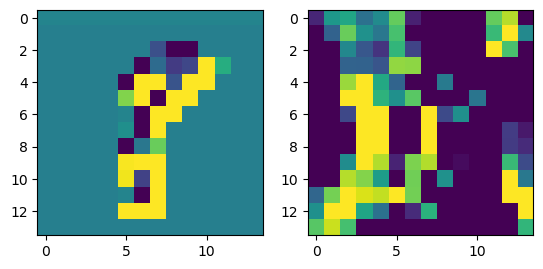

prediction: tensor([1, 7, 8]), tensor([4.9996, 0.6485, 0.4255]) groudtruth: 1
-0.07200408 0.06743741


<Figure size 640x480 with 0 Axes>

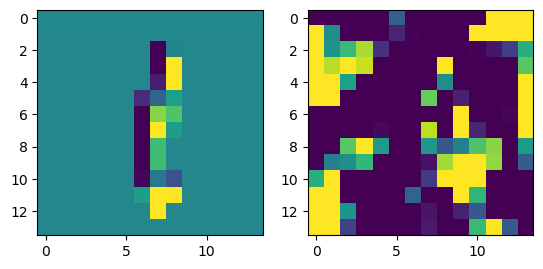

prediction: tensor([2, 5, 8]), tensor([2.4263, 2.1922, 1.9970]) groudtruth: 5
-0.08427209 0.07590859


<Figure size 640x480 with 0 Axes>

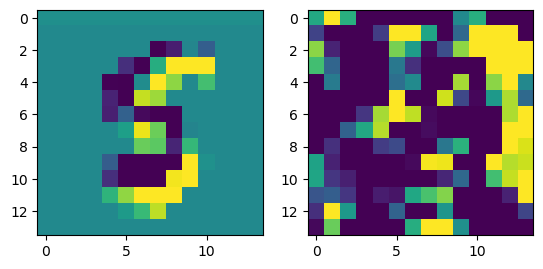

prediction: tensor([3, 5, 7]), tensor([3.1078, 3.0803, 0.2876]) groudtruth: 3
-0.07129109 0.08988163


<Figure size 640x480 with 0 Axes>

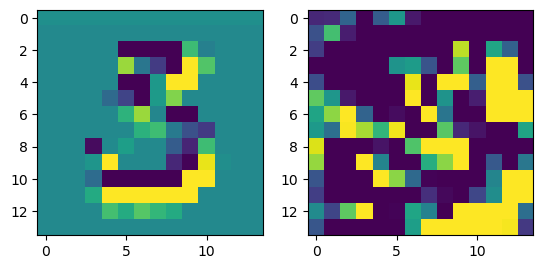

prediction: tensor([5, 3, 7]), tensor([2.6575, 1.6110, 1.2195]) groudtruth: 3
-0.081442416 0.074357346


<Figure size 640x480 with 0 Axes>

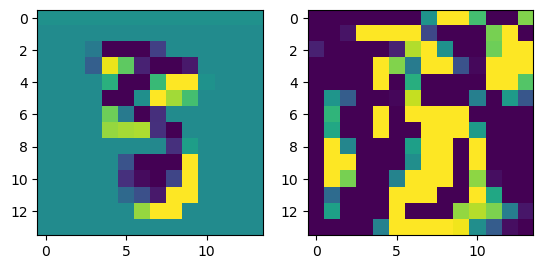

prediction: tensor([0, 1, 6]), tensor([4.1844, 1.2597, 0.9922]) groudtruth: 0
-0.08753747 0.10823467


<Figure size 640x480 with 0 Axes>

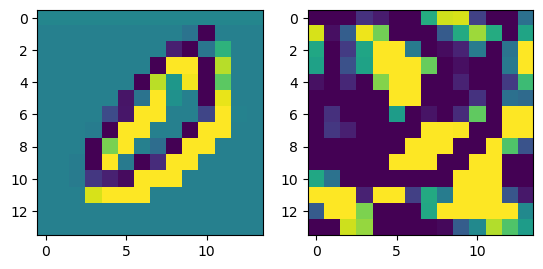

prediction: tensor([3, 9, 7]), tensor([3.1431, 1.3720, 1.2914]) groudtruth: 3
-0.09736061 0.09002114


<Figure size 640x480 with 0 Axes>

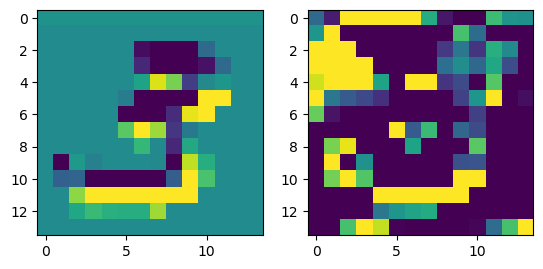

prediction: tensor([5, 8, 6]), tensor([5.1376, 2.3376, 1.9928]) groudtruth: 5
-0.074905574 0.09283058


<Figure size 640x480 with 0 Axes>

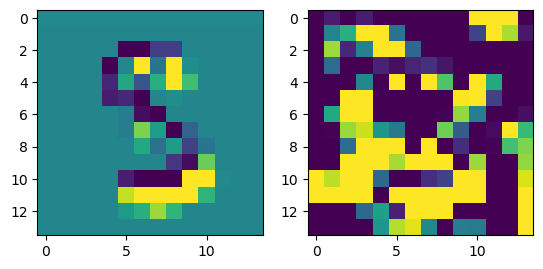

prediction: tensor([5, 8, 6]), tensor([4.7362, 3.6596, 1.1575]) groudtruth: 5
-0.098171294 0.08750592


<Figure size 640x480 with 0 Axes>

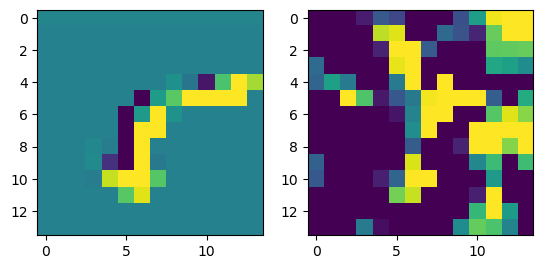

prediction: tensor([9, 8, 7]), tensor([4.5459, 3.7682, 0.2232]) groudtruth: 9
-0.090333104 0.088448085


<Figure size 640x480 with 0 Axes>

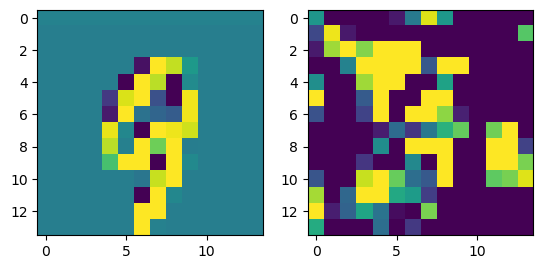

prediction: tensor([3, 2, 4]), tensor([2.0220, 0.9611, 0.8963]) groudtruth: 2
-0.084503114 0.086809695


<Figure size 640x480 with 0 Axes>

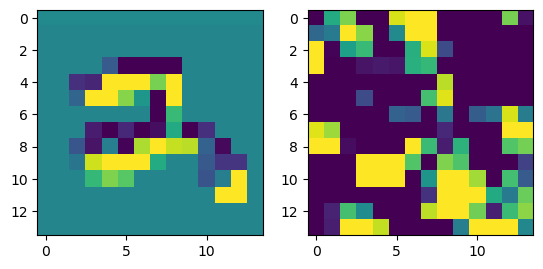

prediction: tensor([9, 1, 6]), tensor([3.1557, 1.7915, 1.4608]) groudtruth: 9
-0.0779233 0.056004852


<Figure size 640x480 with 0 Axes>

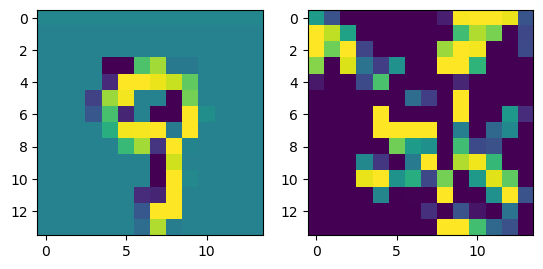

prediction: tensor([7, 9, 3]), tensor([5.5798, 3.6620, 0.9047]) groudtruth: 7
-0.09130913 0.07179668


<Figure size 640x480 with 0 Axes>

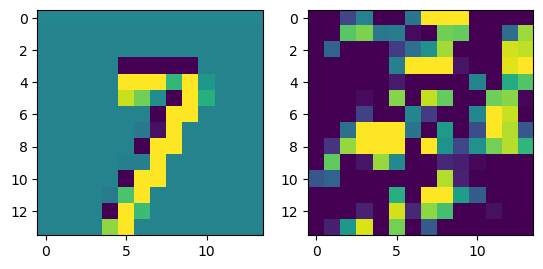

prediction: tensor([3, 7, 9]), tensor([5.9796, 1.7663, 1.1841]) groudtruth: 3
-0.07639843 0.08481656


<Figure size 640x480 with 0 Axes>

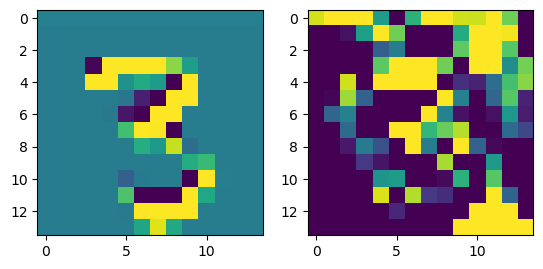

prediction: tensor([7, 6, 0]), tensor([3.4913, 2.4979, 2.1191]) groudtruth: 7
-0.09016234 0.09837298


<Figure size 640x480 with 0 Axes>

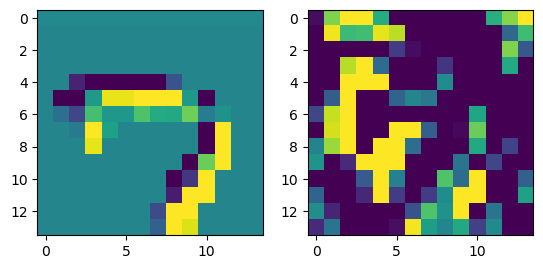

prediction: tensor([8, 5, 3]), tensor([2.8318, 2.0431, 0.9715]) groudtruth: 8
-0.06866336 0.07101305


<Figure size 640x480 with 0 Axes>

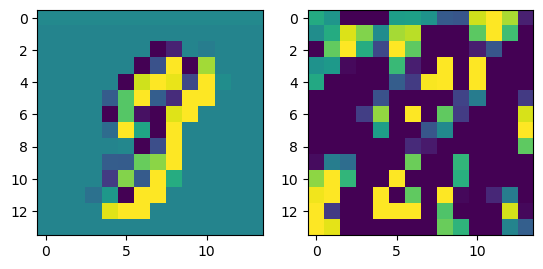

prediction: tensor([0, 5, 2]), tensor([4.4798, 2.2842, 1.4988]) groudtruth: 0
-0.06461537 0.09511658


<Figure size 640x480 with 0 Axes>

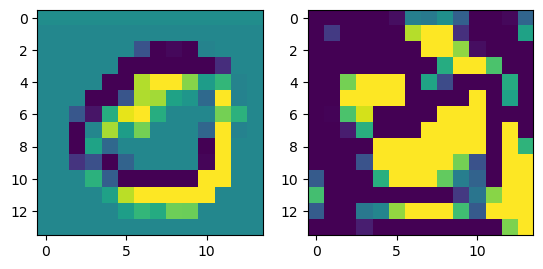

prediction: tensor([1, 6, 4]), tensor([3.5647, 3.2482, 1.0419]) groudtruth: 1
-0.07930112 0.08420064


<Figure size 640x480 with 0 Axes>

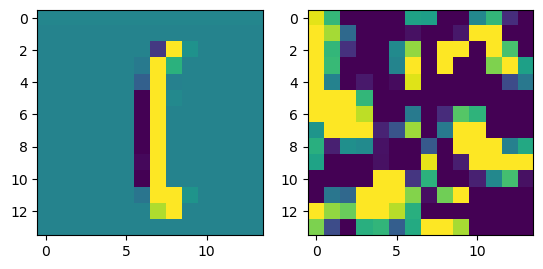

prediction: tensor([3, 5, 4]), tensor([4.3477, 1.7082, 1.6447]) groudtruth: 3
-0.11129022 0.09568902


<Figure size 640x480 with 0 Axes>

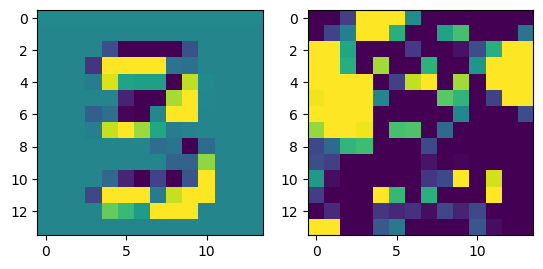

prediction: tensor([0, 3, 9]), tensor([3.1515, 2.6454, 1.7911]) groudtruth: 0
-0.0721215 0.10305232


<Figure size 640x480 with 0 Axes>

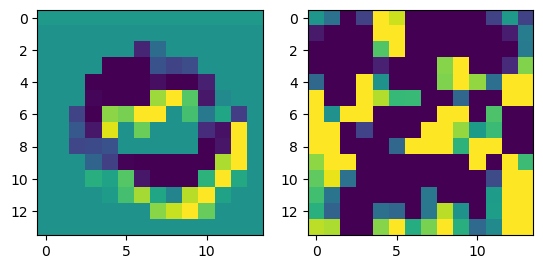

prediction: tensor([4, 5, 9]), tensor([5.4097, 1.4086, 0.6362]) groudtruth: 4
-0.076325595 0.08556111


<Figure size 640x480 with 0 Axes>

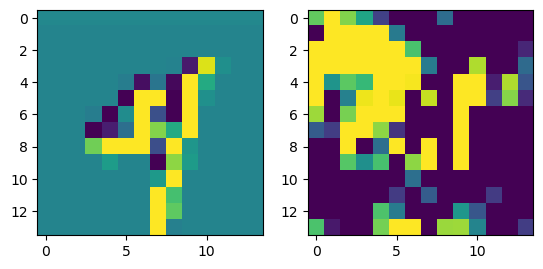

prediction: tensor([6, 2, 8]), tensor([6.1882, 1.6180, 1.0380]) groudtruth: 6
-0.060536146 0.07488336


<Figure size 640x480 with 0 Axes>

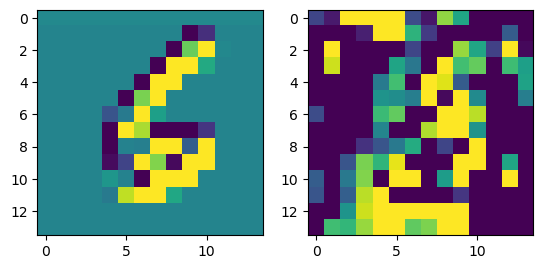

prediction: tensor([1, 7, 2]), tensor([4.0262, 1.5261, 1.2889]) groudtruth: 1
-0.066557825 0.09767802


<Figure size 640x480 with 0 Axes>

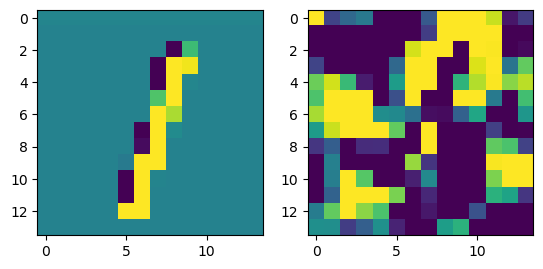

prediction: tensor([0, 8, 9]), tensor([3.9525, 3.4358, 0.4809]) groudtruth: 0
-0.085666955 0.06577276


<Figure size 640x480 with 0 Axes>

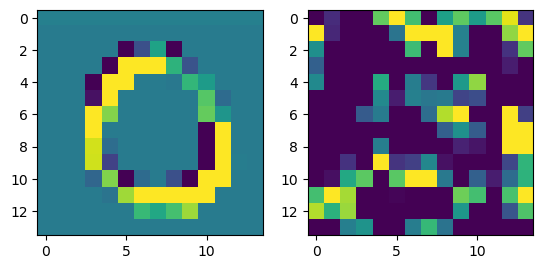

prediction: tensor([3, 2, 1]), tensor([2.7282, 1.3351, 1.3036]) groudtruth: 2
-0.07455003 0.071120024


<Figure size 640x480 with 0 Axes>

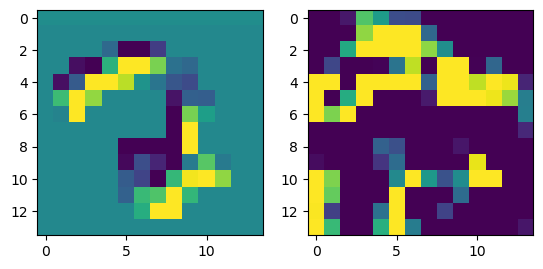

prediction: tensor([5, 4, 3]), tensor([3.9098, 2.9241, 0.7483]) groudtruth: 5
-0.1132012 0.06979635


<Figure size 640x480 with 0 Axes>

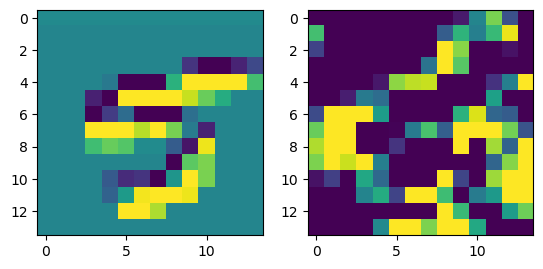

prediction: tensor([2, 8, 5]), tensor([2.2338, 1.7531, 1.1338]) groudtruth: 8
-0.103194594 0.08763109


<Figure size 640x480 with 0 Axes>

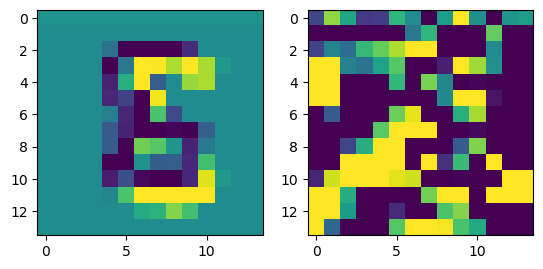

prediction: tensor([8, 3, 2]), tensor([4.3759, 1.8512, 1.0584]) groudtruth: 8
-0.09321517 0.09603758


<Figure size 640x480 with 0 Axes>

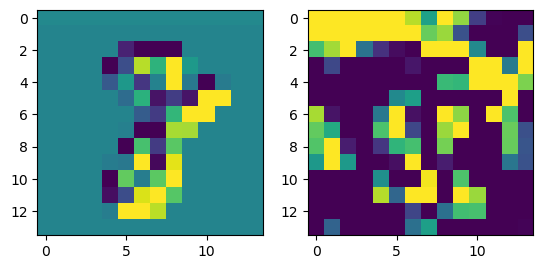

prediction: tensor([2, 3, 4]), tensor([4.7516, 3.6856, 0.9912]) groudtruth: 1
-0.10507035 0.071137965


<Figure size 640x480 with 0 Axes>

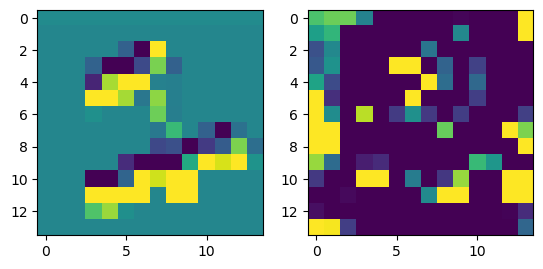

prediction: tensor([3, 4, 5]), tensor([5.0141, 1.6658, 0.8830]) groudtruth: 3
-0.066039145 0.06953082


<Figure size 640x480 with 0 Axes>

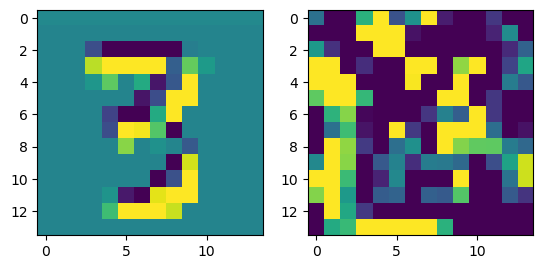

prediction: tensor([9, 5, 8]), tensor([3.3120, 1.2340, 0.5087]) groudtruth: 9
-0.086609185 0.08541233


<Figure size 640x480 with 0 Axes>

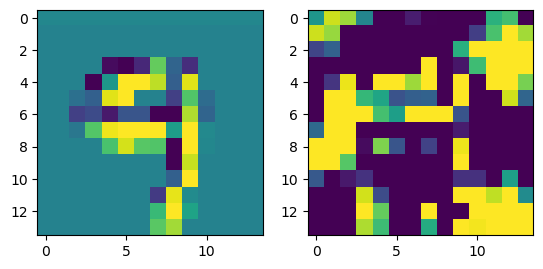

prediction: tensor([4, 1, 6]), tensor([5.1361, 1.8915, 1.2856]) groudtruth: 4
-0.12481147 0.092978254


<Figure size 640x480 with 0 Axes>

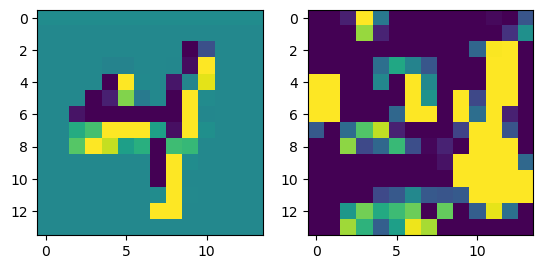

prediction: tensor([3, 0, 9]), tensor([4.5880, 4.1850, 1.5239]) groudtruth: 0
-0.08619189 0.09761095


<Figure size 640x480 with 0 Axes>

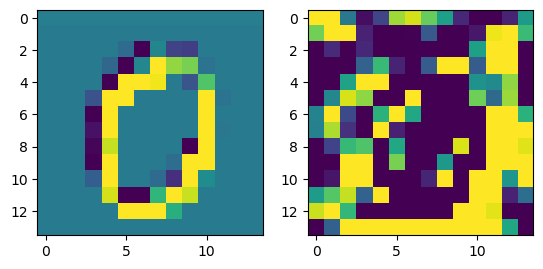

prediction: tensor([2, 3, 1]), tensor([4.6792, 2.8645, 2.8343]) groudtruth: 3
-0.07463056 0.07991107


<Figure size 640x480 with 0 Axes>

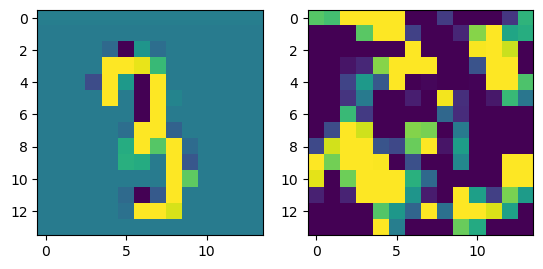

prediction: tensor([7, 3, 2]), tensor([4.2644, 1.9906, 1.0637]) groudtruth: 7
-0.0808903 0.065503806


<Figure size 640x480 with 0 Axes>

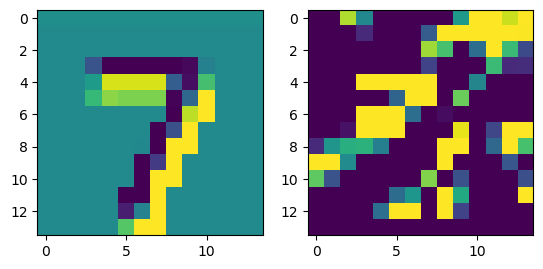

prediction: tensor([1, 3, 5]), tensor([3.9314, 2.3547, 1.6414]) groudtruth: 3
-0.063848436 0.07254745


<Figure size 640x480 with 0 Axes>

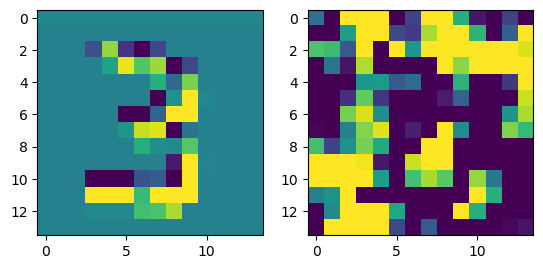

prediction: tensor([2, 3, 9]), tensor([4.8381, 1.7166, 0.7132]) groudtruth: 2
-0.073661685 0.12507805


<Figure size 640x480 with 0 Axes>

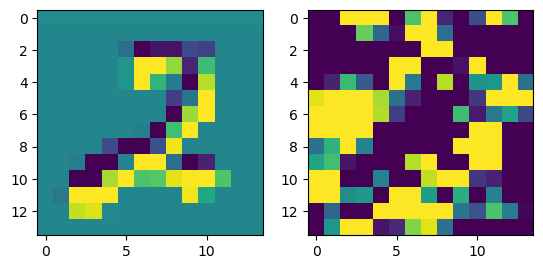

prediction: tensor([3, 0, 2]), tensor([5.6043, 3.3386, 1.6880]) groudtruth: 3
-0.105243206 0.07399587


<Figure size 640x480 with 0 Axes>

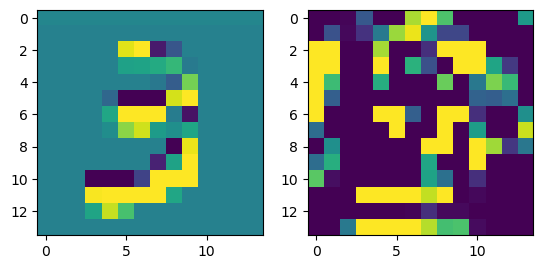

prediction: tensor([3, 9, 1]), tensor([4.1869, 2.0250, 1.4477]) groudtruth: 3
-0.0827018 0.098695956


<Figure size 640x480 with 0 Axes>

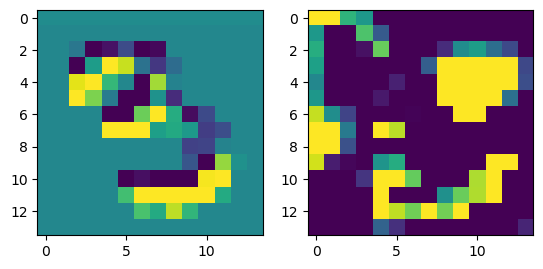

prediction: tensor([7, 9, 0]), tensor([3.9364, 3.2808, 1.0340]) groudtruth: 7
-0.10144615 0.097672135


<Figure size 640x480 with 0 Axes>

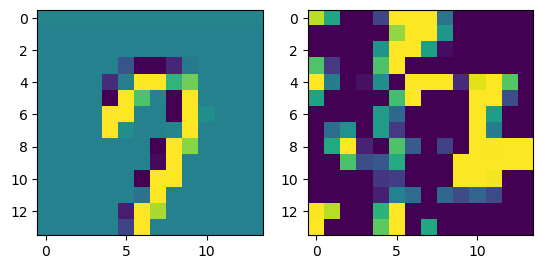

prediction: tensor([3, 8, 7]), tensor([4.9754, 1.2932, 1.2815]) groudtruth: 3
-0.08628374 0.11065692


<Figure size 640x480 with 0 Axes>

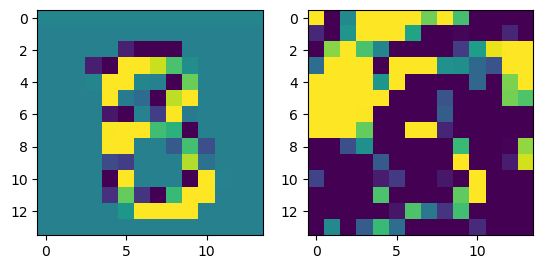

prediction: tensor([4, 7, 1]), tensor([2.5360, 2.1291, 1.3719]) groudtruth: 4
-0.085595965 0.10003732


<Figure size 640x480 with 0 Axes>

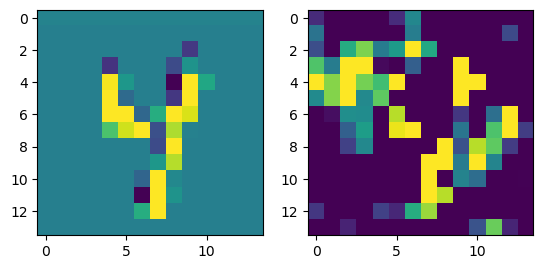

prediction: tensor([0, 9, 8]), tensor([2.1880, 0.8227, 0.5566]) groudtruth: 0
-0.06474203 0.085138984


<Figure size 640x480 with 0 Axes>

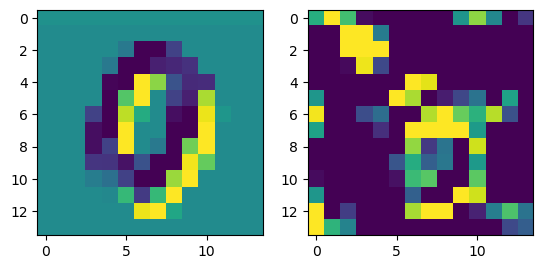

prediction: tensor([7, 4, 9]), tensor([1.8025, 1.4527, 0.8054]) groudtruth: 7
-0.076664746 0.07407138


<Figure size 640x480 with 0 Axes>

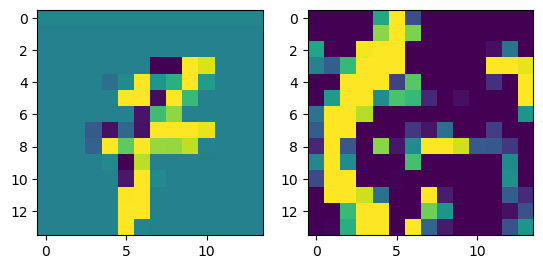

prediction: tensor([4, 2, 7]), tensor([5.9125, 0.6021, 0.4673]) groudtruth: 4
-0.11736822 0.12354978


<Figure size 640x480 with 0 Axes>

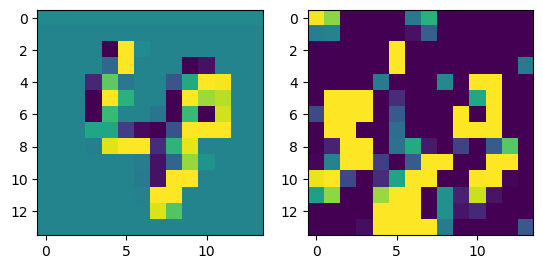

prediction: tensor([0, 3, 5]), tensor([5.4218, 3.5906, 0.6182]) groudtruth: 3
-0.066717625 0.061008334


<Figure size 640x480 with 0 Axes>

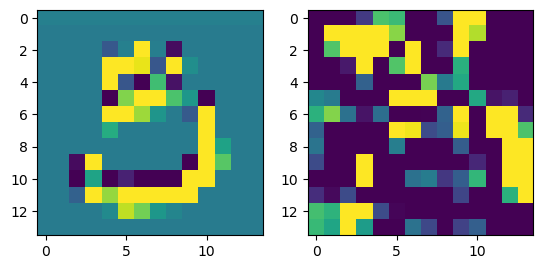

prediction: tensor([2, 8, 3]), tensor([4.1448, 2.8724, 2.2500]) groudtruth: 8
-0.07434583 0.10516805


<Figure size 640x480 with 0 Axes>

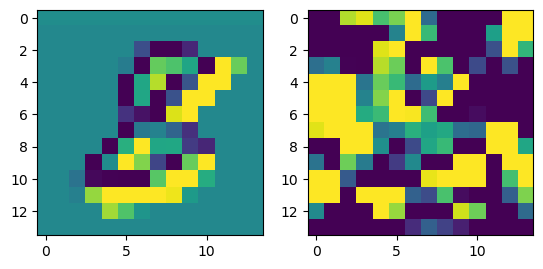

prediction: tensor([0, 6, 1]), tensor([4.1807, 2.1180, 0.9168]) groudtruth: 0
-0.081195235 0.07356445


<Figure size 640x480 with 0 Axes>

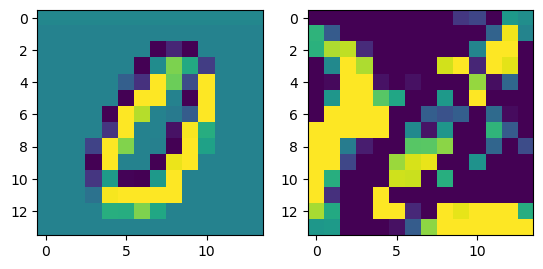

prediction: tensor([6, 3, 5]), tensor([3.7713, 1.1403, 0.8913]) groudtruth: 6
-0.09594345 0.08532407


<Figure size 640x480 with 0 Axes>

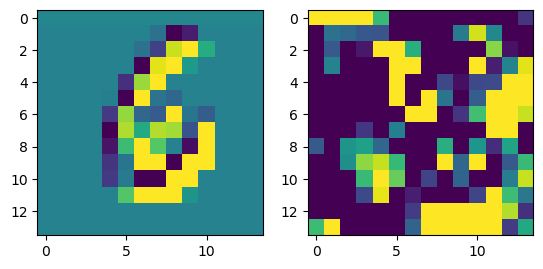

prediction: tensor([2, 6, 9]), tensor([4.9294, 2.4829, 0.8279]) groudtruth: 2
-0.12397051 0.10383662


<Figure size 640x480 with 0 Axes>

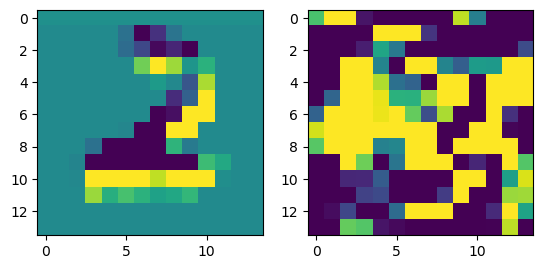

prediction: tensor([1, 3, 9]), tensor([6.6753, 2.6068, 0.7623]) groudtruth: 1
-0.07232648 0.080504775


<Figure size 640x480 with 0 Axes>

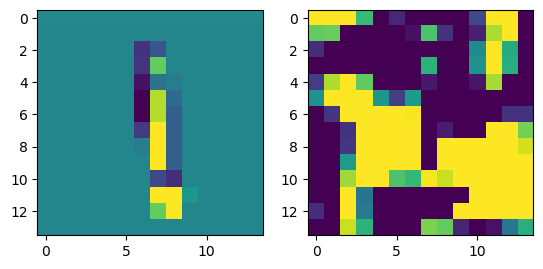

prediction: tensor([1, 9, 6]), tensor([3.9575, 3.3888, 2.6134]) groudtruth: 6
-0.06619614 0.0715131


<Figure size 640x480 with 0 Axes>

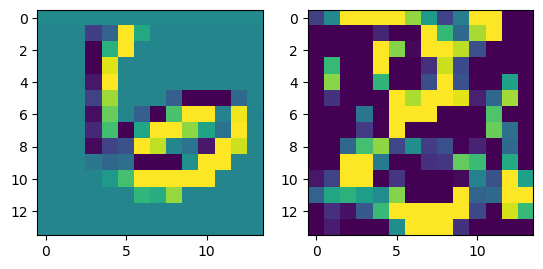

prediction: tensor([5, 6, 2]), tensor([5.6782, 2.2477, 1.0292]) groudtruth: 5
-0.059912622 0.093591526


<Figure size 640x480 with 0 Axes>

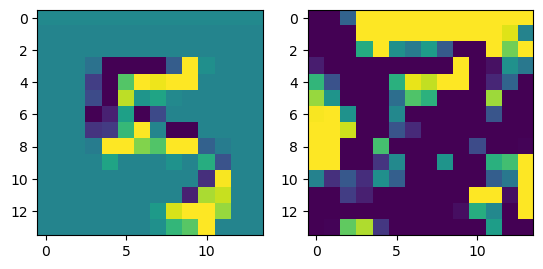

prediction: tensor([3, 9, 4]), tensor([3.9472, 3.5502, 1.7290]) groudtruth: 3
-0.07434851 0.10821378


<Figure size 640x480 with 0 Axes>

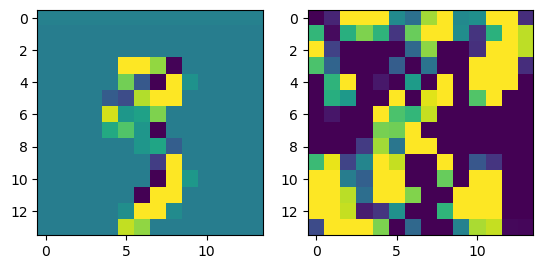

prediction: tensor([9, 4, 8]), tensor([4.5566, 2.5429, 1.4727]) groudtruth: 9
-0.11033696 0.09631553


<Figure size 640x480 with 0 Axes>

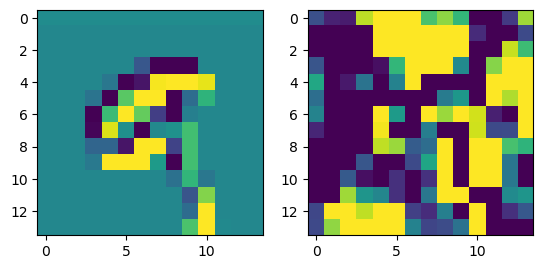

prediction: tensor([1, 7, 5]), tensor([6.4500, 1.7948, 0.6599]) groudtruth: 1
-0.059944928 0.08977881


<Figure size 640x480 with 0 Axes>

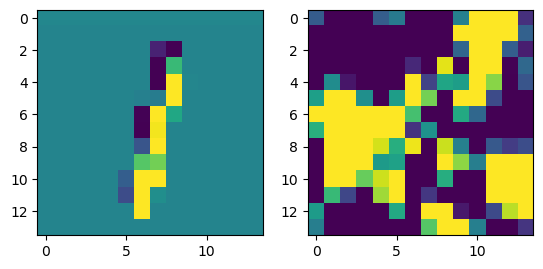

prediction: tensor([9, 3, 7]), tensor([3.3445, 1.6638, 1.6366]) groudtruth: 9
-0.07008189 0.08651073


<Figure size 640x480 with 0 Axes>

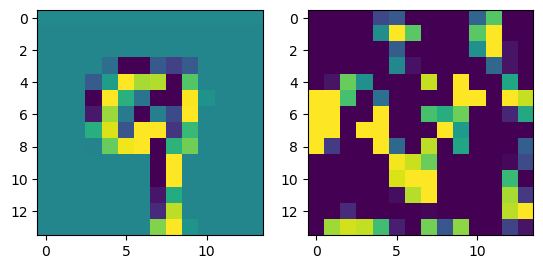

prediction: tensor([3, 5, 4]), tensor([3.3809, 1.6758, 0.0245]) groudtruth: 3
-0.060991883 0.09065363


<Figure size 640x480 with 0 Axes>

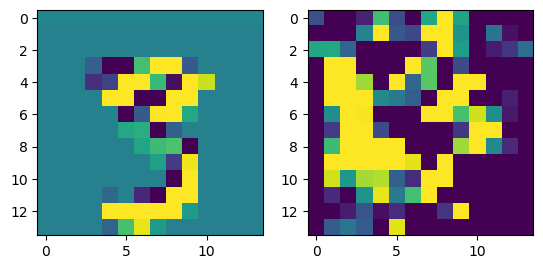

prediction: tensor([0, 2, 1]), tensor([2.4308, 2.0953, 1.0296]) groudtruth: 2
-0.094248235 0.09111636


<Figure size 640x480 with 0 Axes>

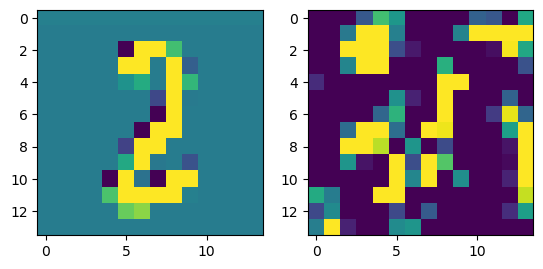

prediction: tensor([9, 6, 4]), tensor([4.0196, 2.0494, 1.8539]) groudtruth: 9
-0.067444384 0.11018741


<Figure size 640x480 with 0 Axes>

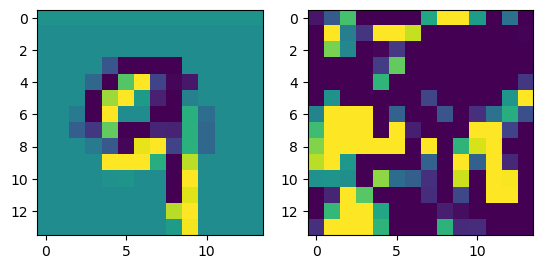

prediction: tensor([2, 6, 7]), tensor([3.7554, 1.0885, 1.0680]) groudtruth: 2
-0.099541664 0.09223186


<Figure size 640x480 with 0 Axes>

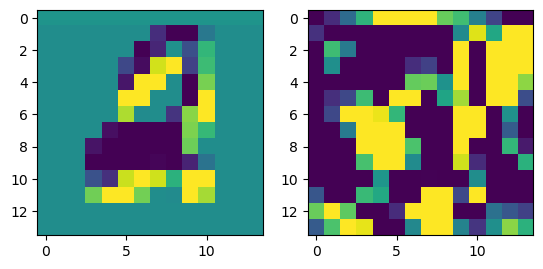

prediction: tensor([7, 4, 6]), tensor([2.9673, 2.6636, 1.1342]) groudtruth: 7
-0.09767914 0.09052545


<Figure size 640x480 with 0 Axes>

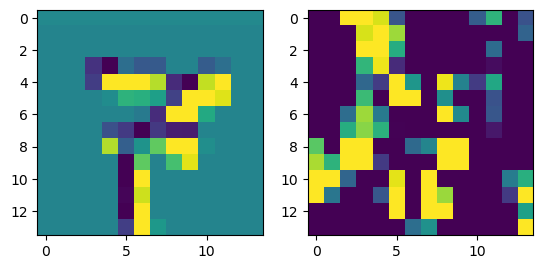

prediction: tensor([1, 7, 2]), tensor([6.5000, 1.4403, 1.0541]) groudtruth: 1
-0.08799803 0.08573699


<Figure size 640x480 with 0 Axes>

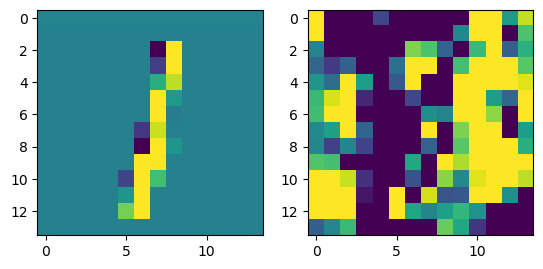

prediction: tensor([8, 3, 9]), tensor([5.2264, 1.4428, 1.0988]) groudtruth: 8
-0.08433306 0.059251245


<Figure size 640x480 with 0 Axes>

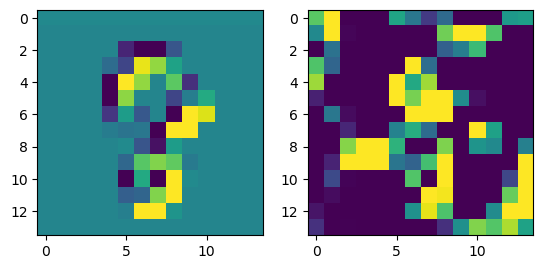

prediction: tensor([8, 7, 9]), tensor([ 4.0052,  0.4403, -0.1014]) groudtruth: 8
-0.06980461 0.06768605


<Figure size 640x480 with 0 Axes>

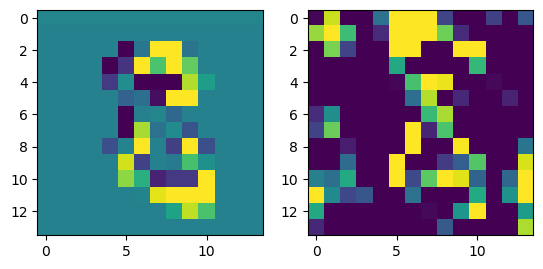

prediction: tensor([3, 9, 7]), tensor([5.6253, 1.7746, 0.9969]) groudtruth: 8
-0.05692166 0.06322122


<Figure size 640x480 with 0 Axes>

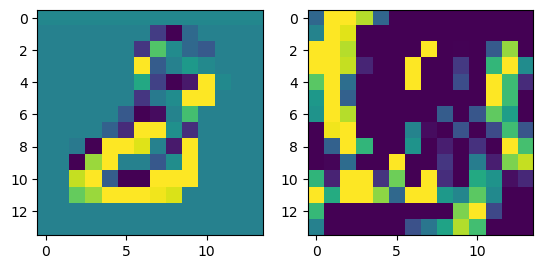

prediction: tensor([2, 1, 0]), tensor([2.8470, 2.8011, 1.8951]) groudtruth: 2
-0.09984416 0.06585803


<Figure size 640x480 with 0 Axes>

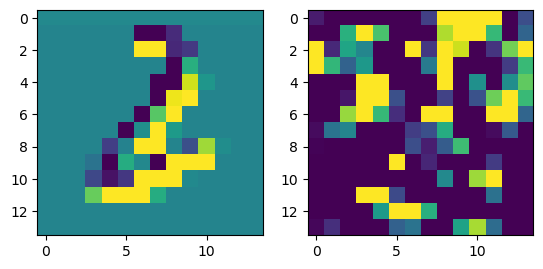

prediction: tensor([7, 9, 0]), tensor([3.0406, 1.4943, 1.4862]) groudtruth: 7
-0.080001056 0.085141346


<Figure size 640x480 with 0 Axes>

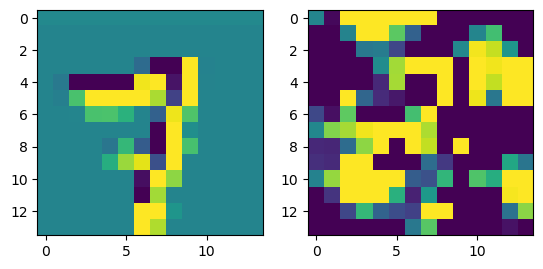

prediction: tensor([6, 9, 7]), tensor([4.6308, 1.1342, 0.6819]) groudtruth: 6
-0.08964449 0.07775296


<Figure size 640x480 with 0 Axes>

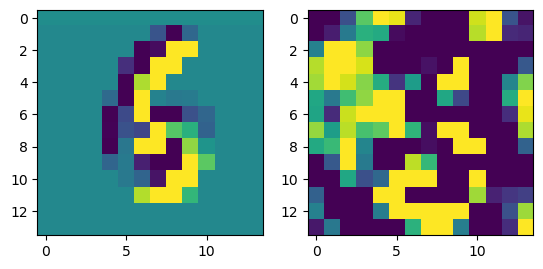

prediction: tensor([0, 6, 2]), tensor([6.7385, 0.7102, 0.7043]) groudtruth: 0
-0.07131022 0.087632984


<Figure size 640x480 with 0 Axes>

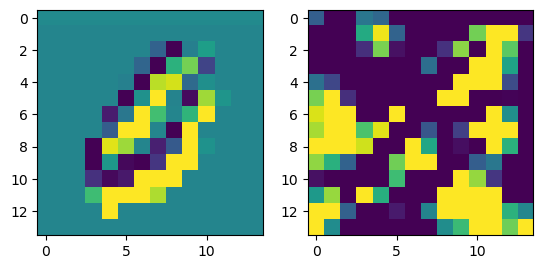

prediction: tensor([1, 2, 8]), tensor([2.7342, 2.1810, 0.9275]) groudtruth: 1
-0.08487183 0.09131683


<Figure size 640x480 with 0 Axes>

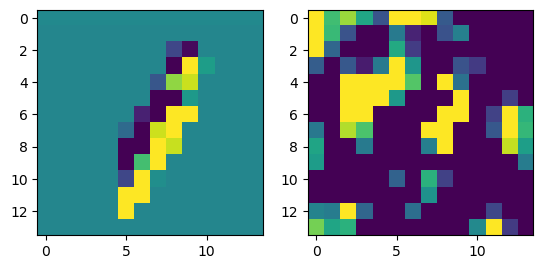

prediction: tensor([2, 9, 4]), tensor([5.5598, 2.2240, 2.0934]) groudtruth: 2
-0.09095514 0.06320069


<Figure size 640x480 with 0 Axes>

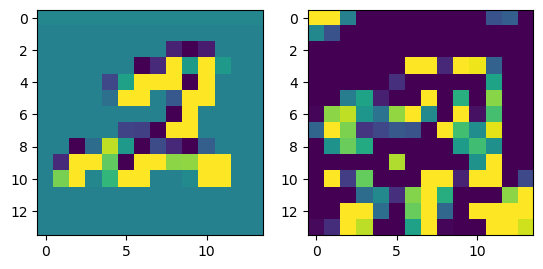

prediction: tensor([9, 7, 8]), tensor([4.4981, 2.5933, 1.0565]) groudtruth: 7
-0.0878939 0.09647674


<Figure size 640x480 with 0 Axes>

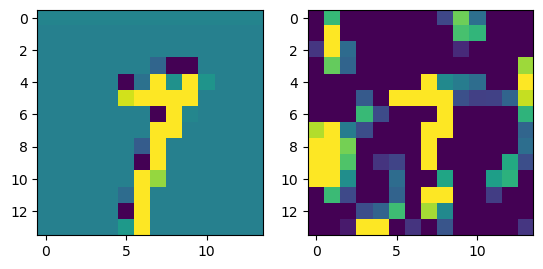

prediction: tensor([1, 4, 0]), tensor([5.6004, 0.4534, 0.4111]) groudtruth: 1
-0.067108214 0.07609402


<Figure size 640x480 with 0 Axes>

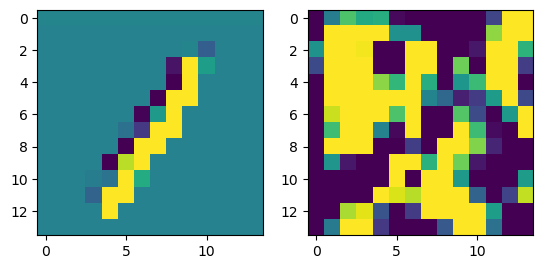

prediction: tensor([0, 6, 8]), tensor([5.2416, 2.6754, 1.1471]) groudtruth: 0
-0.09655571 0.11209841


<Figure size 640x480 with 0 Axes>

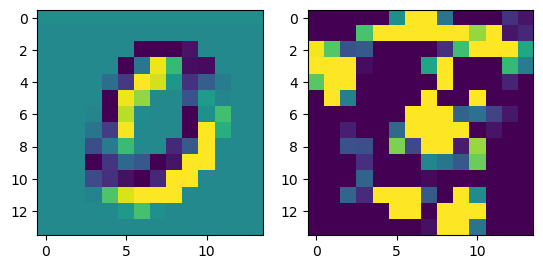

prediction: tensor([1, 4, 6]), tensor([3.7109, 1.7199, 1.2326]) groudtruth: 1
-0.08455676 0.066876136


<Figure size 640x480 with 0 Axes>

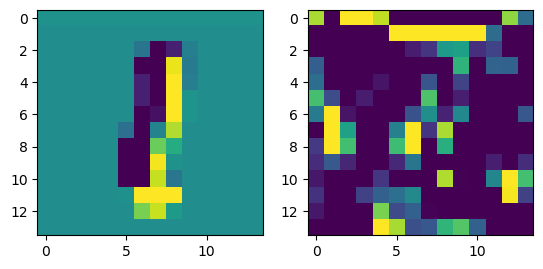

prediction: tensor([0, 5, 9]), tensor([6.1502, 1.0204, 0.6681]) groudtruth: 0
-0.1020807 0.08608107


<Figure size 640x480 with 0 Axes>

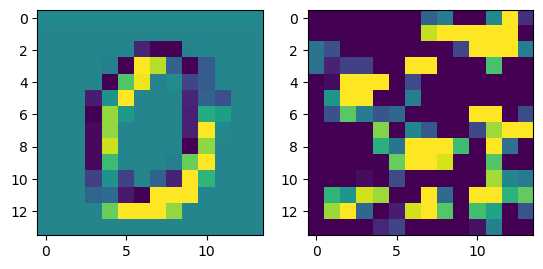

prediction: tensor([0, 9, 8]), tensor([3.5741, 1.1616, 0.7660]) groudtruth: 0
-0.07782984 0.08890397


<Figure size 640x480 with 0 Axes>

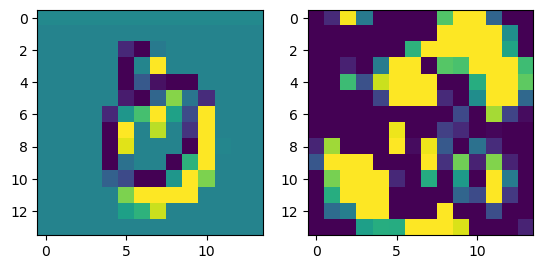

prediction: tensor([2, 3, 7]), tensor([3.7520, 3.0779, 1.6612]) groudtruth: 2
-0.08021867 0.105718285


<Figure size 640x480 with 0 Axes>

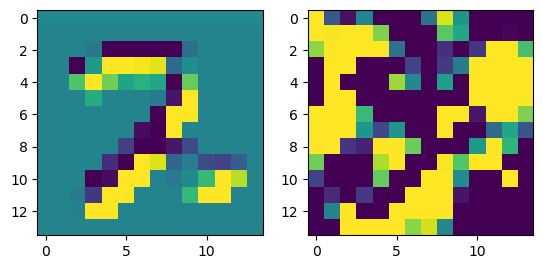

prediction: tensor([1, 6, 5]), tensor([4.7815, 2.6721, 0.9742]) groudtruth: 1
-0.10366964 0.1044351


<Figure size 640x480 with 0 Axes>

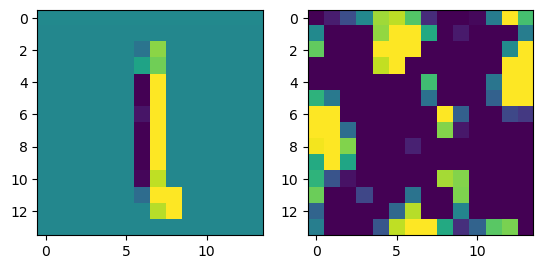

prediction: tensor([0, 7, 8]), tensor([3.9235, 2.0507, 1.9151]) groudtruth: 6
-0.06481546 0.107351795


<Figure size 640x480 with 0 Axes>

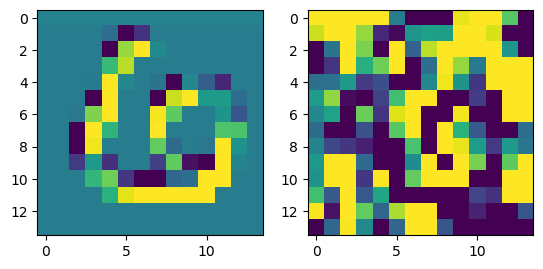

prediction: tensor([6, 4, 1]), tensor([5.4325, 1.6535, 0.7542]) groudtruth: 6
-0.08986235 0.10354193


<Figure size 640x480 with 0 Axes>

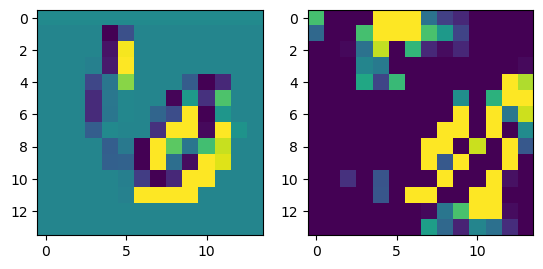

prediction: tensor([0, 3, 9]), tensor([5.1190, 1.8389, 0.5942]) groudtruth: 0
-0.08611244 0.09736781


<Figure size 640x480 with 0 Axes>

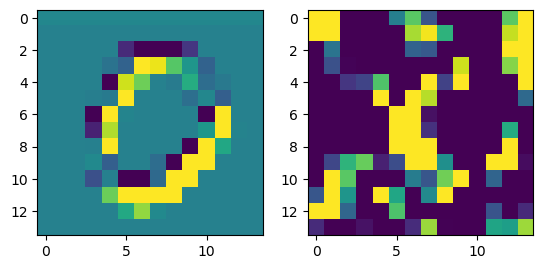

prediction: tensor([1, 8, 0]), tensor([3.1575, 1.4799, 0.6894]) groudtruth: 1
-0.077804506 0.08283357


<Figure size 640x480 with 0 Axes>

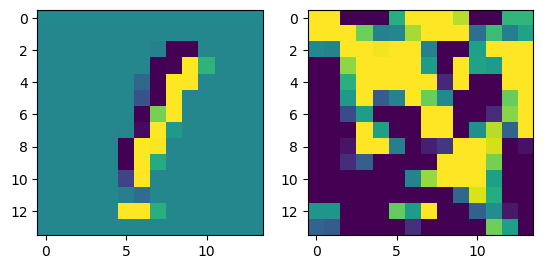

prediction: tensor([6, 5, 2]), tensor([3.0474, 2.0713, 0.7193]) groudtruth: 6
-0.075861216 0.07957519


<Figure size 640x480 with 0 Axes>

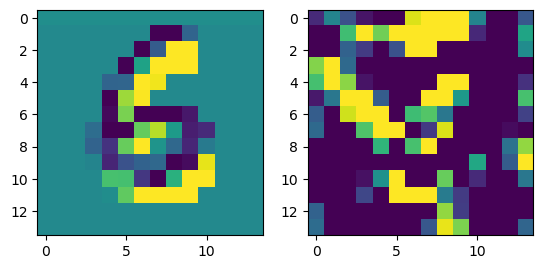

prediction: tensor([7, 2, 9]), tensor([3.4256, 2.4262, 1.5839]) groudtruth: 2
-0.09453881 0.080160186


<Figure size 640x480 with 0 Axes>

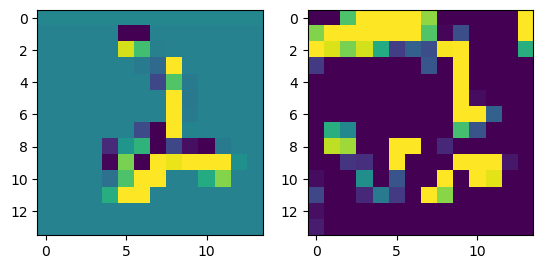

prediction: tensor([9, 4, 8]), tensor([2.0005, 1.9165, 0.6861]) groudtruth: 5
-0.057476103 0.08726003


<Figure size 640x480 with 0 Axes>

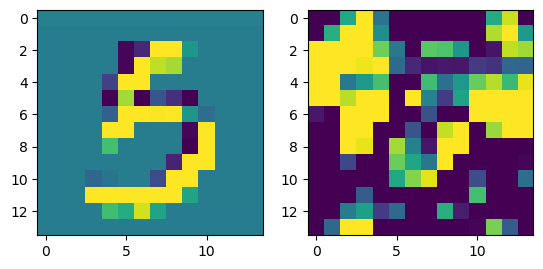

prediction: tensor([1, 8, 7]), tensor([5.0641, 0.6821, 0.2108]) groudtruth: 1
-0.06822473 0.080349654


<Figure size 640x480 with 0 Axes>

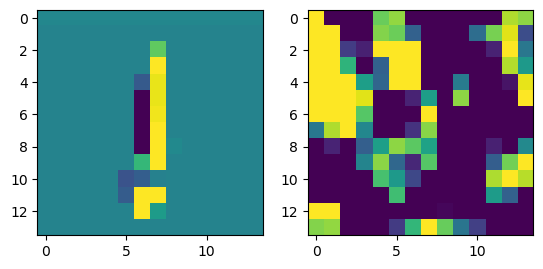

prediction: tensor([7, 8, 3]), tensor([3.6522, 1.2421, 0.8391]) groudtruth: 7
-0.098872185 0.10299109


<Figure size 640x480 with 0 Axes>

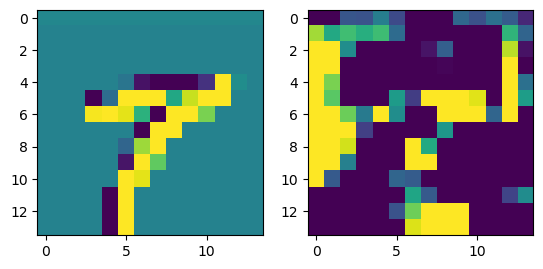

prediction: tensor([4, 7, 1]), tensor([3.5341, 2.9619, 1.4675]) groudtruth: 4
-0.09586024 0.078666456


<Figure size 640x480 with 0 Axes>

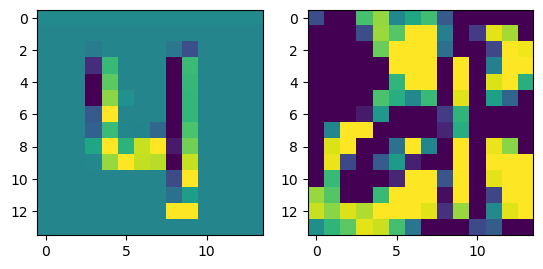

prediction: tensor([8, 3, 5]), tensor([3.2662, 1.8968, 1.1687]) groudtruth: 8
-0.06154138 0.12741579


<Figure size 640x480 with 0 Axes>

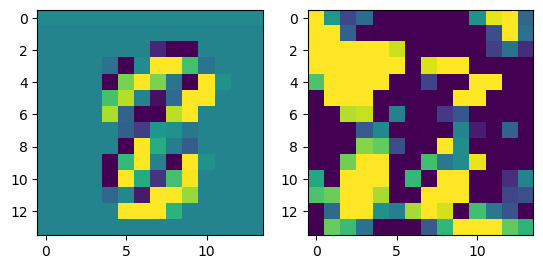

prediction: tensor([7, 3, 5]), tensor([7.0462, 0.6340, 0.3710]) groudtruth: 7
-0.10728043 0.08595941


<Figure size 640x480 with 0 Axes>

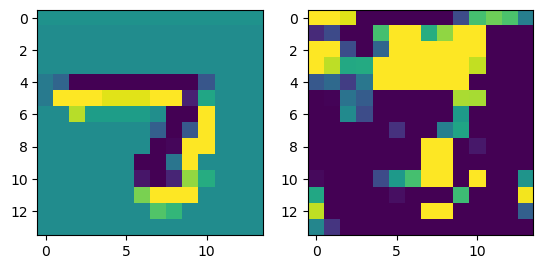

prediction: tensor([3, 7, 8]), tensor([4.2231, 0.6792, 0.6499]) groudtruth: 7
-0.067258954 0.07239072


<Figure size 640x480 with 0 Axes>

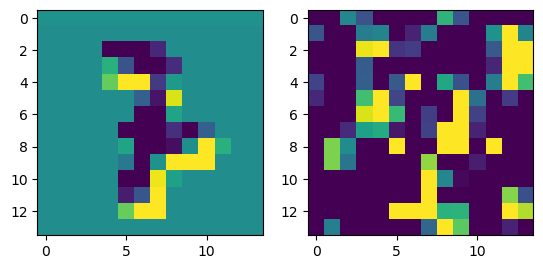

prediction: tensor([7, 3, 0]), tensor([1.9370, 1.2351, 1.0541]) groudtruth: 2
-0.079787195 0.095032156


<Figure size 640x480 with 0 Axes>

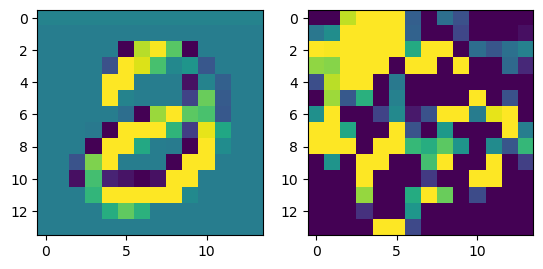

prediction: tensor([6, 2, 5]), tensor([4.8406, 2.5373, 2.2792]) groudtruth: 6
-0.08460897 0.10057221


<Figure size 640x480 with 0 Axes>

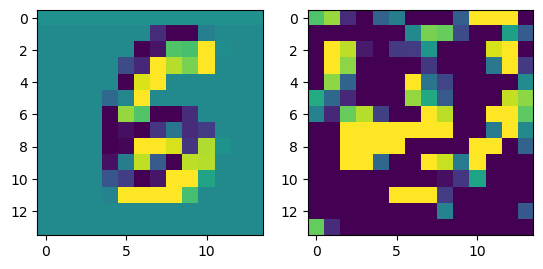

prediction: tensor([4, 1, 6]), tensor([2.9252, 2.5361, 2.2594]) groudtruth: 4
-0.08012408 0.09589564


<Figure size 640x480 with 0 Axes>

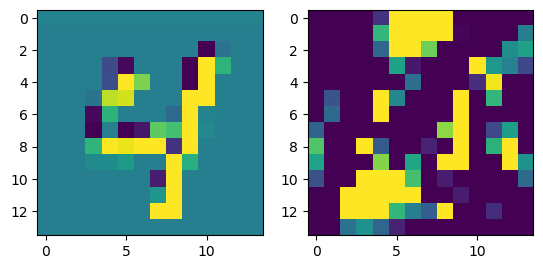

prediction: tensor([9, 3, 2]), tensor([2.5392, 2.0583, 1.5969]) groudtruth: 7
-0.0892753 0.074310705


<Figure size 640x480 with 0 Axes>

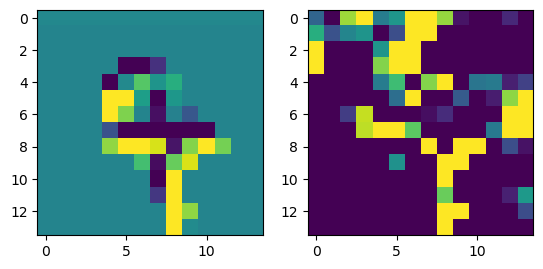

prediction: tensor([5, 3, 7]), tensor([2.9338, 2.7316, 2.3570]) groudtruth: 5
-0.080352485 0.10509905


<Figure size 640x480 with 0 Axes>

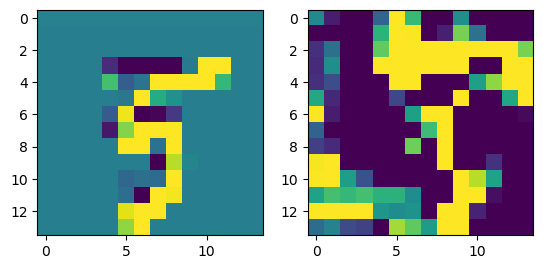

prediction: tensor([5, 3, 8]), tensor([7.2920, 3.7368, 1.6497]) groudtruth: 5
-0.10893339 0.124230705


<Figure size 640x480 with 0 Axes>

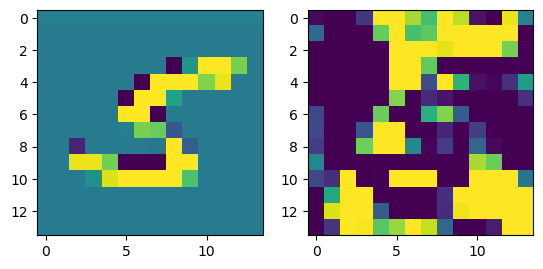

prediction: tensor([7, 5, 8]), tensor([2.4061, 2.1029, 1.5744]) groudtruth: 5
-0.08063209 0.09353778


<Figure size 640x480 with 0 Axes>

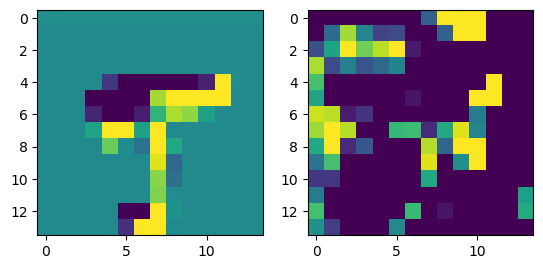

prediction: tensor([2, 7, 4]), tensor([3.6916, 2.7012, 2.0656]) groudtruth: 2
-0.08294469 0.07693225


<Figure size 640x480 with 0 Axes>

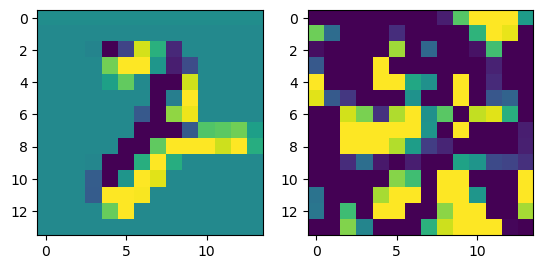

prediction: tensor([9, 2, 4]), tensor([3.2310, 1.4114, 1.3968]) groudtruth: 9
-0.099334 0.14046887


<Figure size 640x480 with 0 Axes>

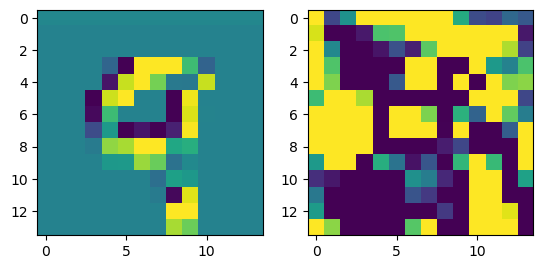

prediction: tensor([2, 3, 8]), tensor([5.0397, 1.4957, 1.3504]) groudtruth: 2
-0.09343141 0.08596884


<Figure size 640x480 with 0 Axes>

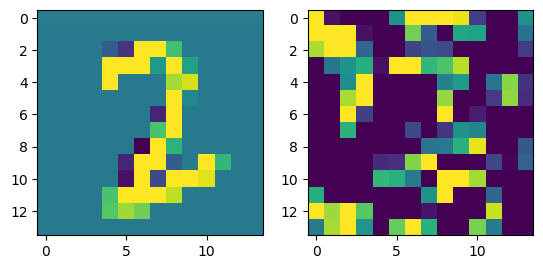

prediction: tensor([8, 9, 3]), tensor([4.0069, 2.6340, 1.8527]) groudtruth: 8
-0.10976404 0.07675994


<Figure size 640x480 with 0 Axes>

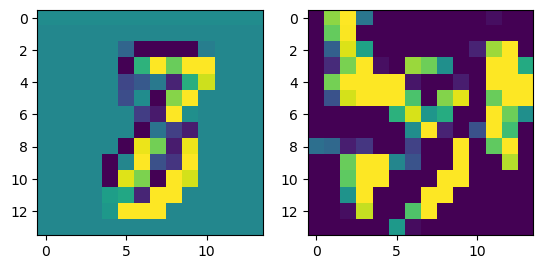

prediction: tensor([4, 1, 3]), tensor([2.9323, 1.5797, 1.4121]) groudtruth: 4
-0.08965647 0.07904728


<Figure size 640x480 with 0 Axes>

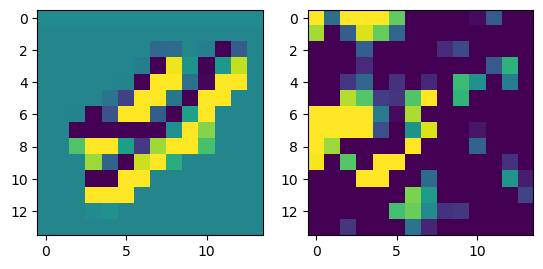

prediction: tensor([6, 0, 5]), tensor([1.6297, 1.5729, 1.3467]) groudtruth: 6
-0.086010695 0.08694716


<Figure size 640x480 with 0 Axes>

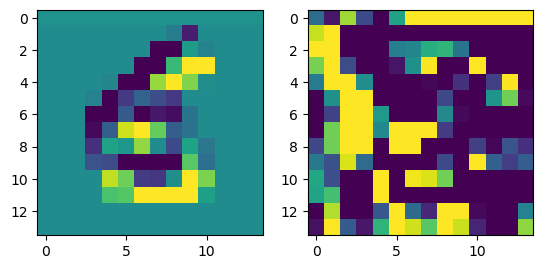

prediction: tensor([8, 2, 1]), tensor([3.7767, 2.5604, 1.7490]) groudtruth: 8
-0.067902565 0.08098675


<Figure size 640x480 with 0 Axes>

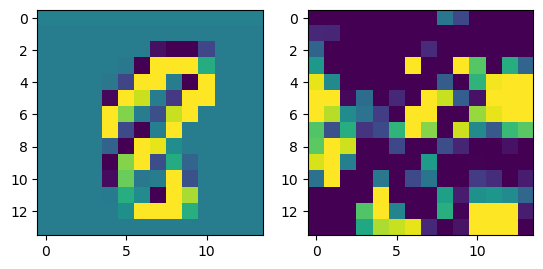

prediction: tensor([9, 5, 6]), tensor([2.7770, 2.6810, 1.6152]) groudtruth: 9
-0.07287586 0.09444597


<Figure size 640x480 with 0 Axes>

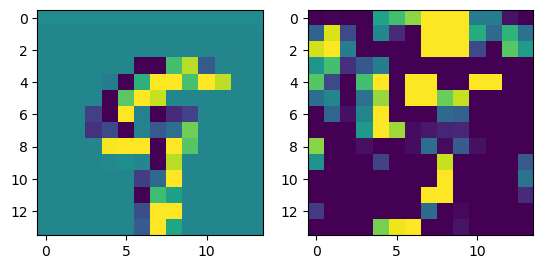

prediction: tensor([5, 0, 8]), tensor([7.0372, 3.0638, 1.5938]) groudtruth: 5
-0.083306015 0.07846901


<Figure size 640x480 with 0 Axes>

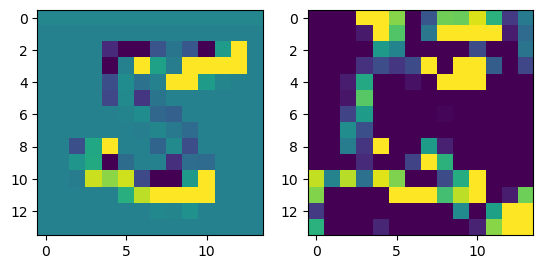

prediction: tensor([4, 1, 9]), tensor([3.3437, 3.0510, 2.6873]) groudtruth: 9
-0.09655213 0.09729338


<Figure size 640x480 with 0 Axes>

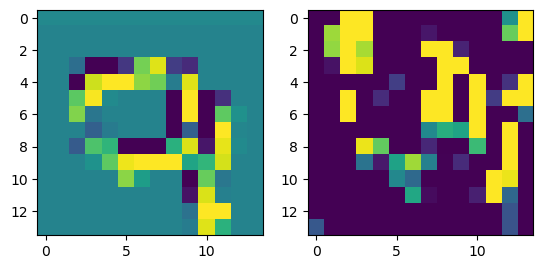

prediction: tensor([6, 2, 5]), tensor([4.9441, 0.9695, 0.8114]) groudtruth: 6
-0.09991211 0.068135425


<Figure size 640x480 with 0 Axes>

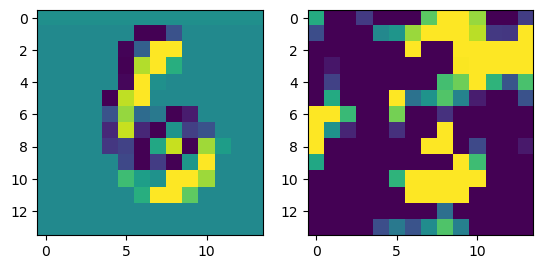

prediction: tensor([2, 4, 3]), tensor([3.2176, 2.4795, 2.0974]) groudtruth: 2
-0.08080006 0.07623215


<Figure size 640x480 with 0 Axes>

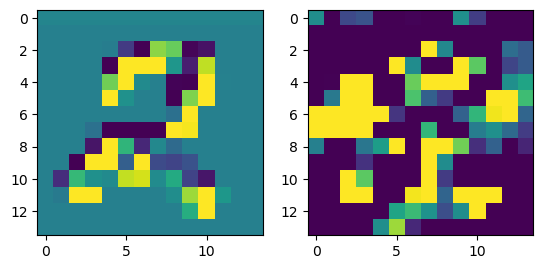

prediction: tensor([4, 7, 0]), tensor([5.4300, 2.8847, 1.0534]) groudtruth: 4
-0.062082767 0.06295168


<Figure size 640x480 with 0 Axes>

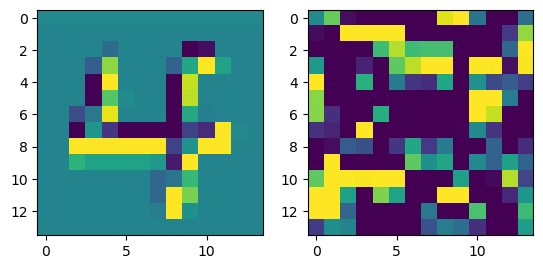

prediction: tensor([6, 0, 8]), tensor([6.1914, 0.9402, 0.4926]) groudtruth: 6
-0.06898564 0.11484511


<Figure size 640x480 with 0 Axes>

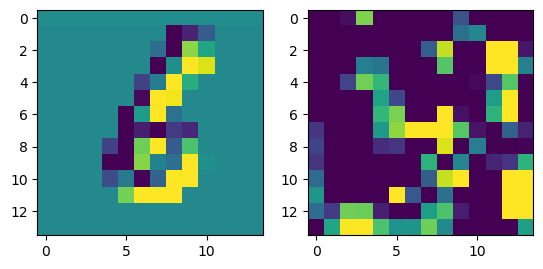

prediction: tensor([7, 0, 6]), tensor([4.9083, 2.5468, 1.7312]) groudtruth: 7
-0.06436163 0.07546909


<Figure size 640x480 with 0 Axes>

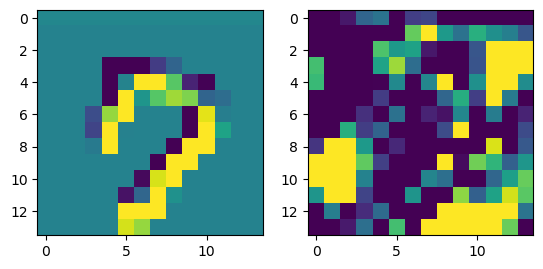

prediction: tensor([7, 2, 1]), tensor([5.7153, 0.9581, 0.8305]) groudtruth: 7
-0.09267396 0.08541128


<Figure size 640x480 with 0 Axes>

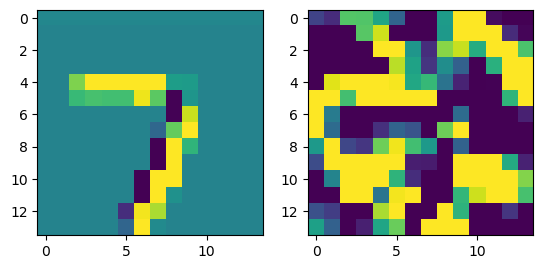

prediction: tensor([0, 3, 8]), tensor([2.5229, 2.5020, 2.4490]) groudtruth: 0
-0.08633101 0.120241165


<Figure size 640x480 with 0 Axes>

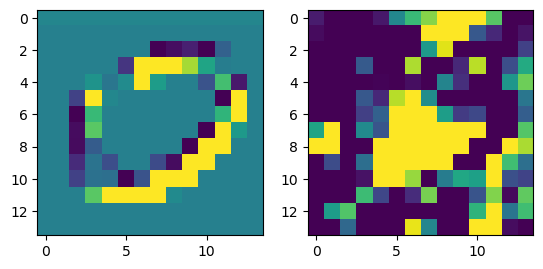

prediction: tensor([6, 8, 2]), tensor([3.9370, 1.0448, 1.0022]) groudtruth: 6
-0.09096944 0.09400363


<Figure size 640x480 with 0 Axes>

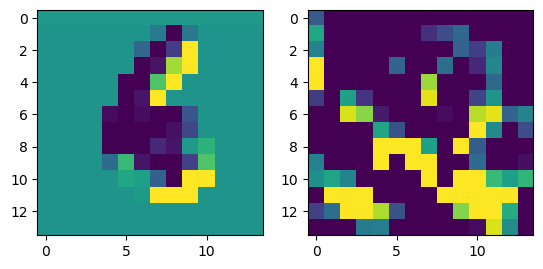

prediction: tensor([6, 7, 1]), tensor([3.7353, 1.8556, 1.5172]) groudtruth: 6
-0.080958724 0.081308186


<Figure size 640x480 with 0 Axes>

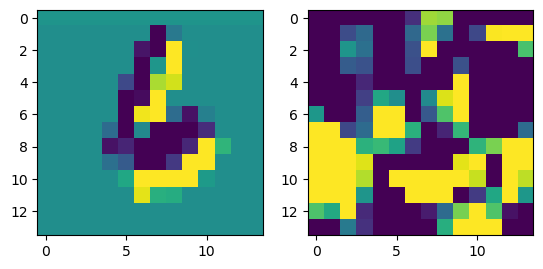

prediction: tensor([9, 4, 2]), tensor([3.0944, 1.7672, 1.7239]) groudtruth: 9
-0.07018983 0.08511366


<Figure size 640x480 with 0 Axes>

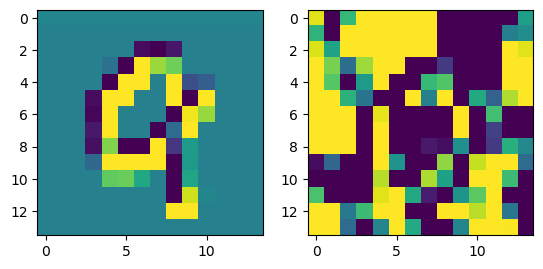

prediction: tensor([7, 4, 1]), tensor([2.4833, 2.4422, 2.0027]) groudtruth: 4
-0.07041657 0.07732249


<Figure size 640x480 with 0 Axes>

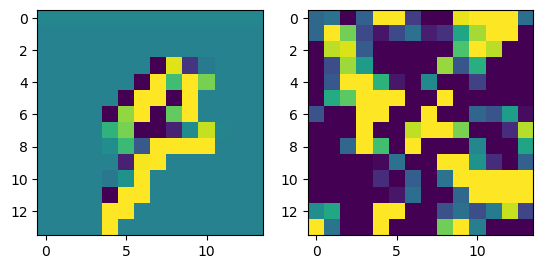

prediction: tensor([8, 3, 5]), tensor([4.5468, 1.2986, 0.1076]) groudtruth: 8
-0.11073017 0.07112306


<Figure size 640x480 with 0 Axes>

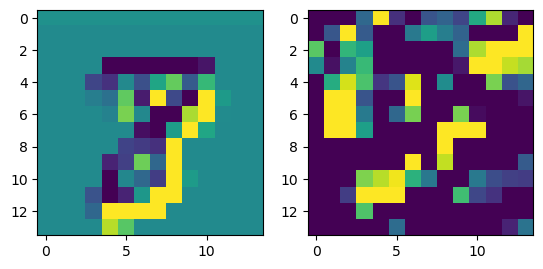

prediction: tensor([3, 7, 4]), tensor([3.6070, 0.8620, 0.7165]) groudtruth: 3
-0.08901769 0.11280884


<Figure size 640x480 with 0 Axes>

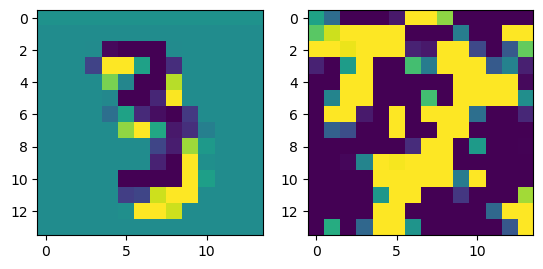

prediction: tensor([8, 3, 1]), tensor([2.4515, 2.3681, 2.2830]) groudtruth: 3
-0.10321212 0.09139175


<Figure size 640x480 with 0 Axes>

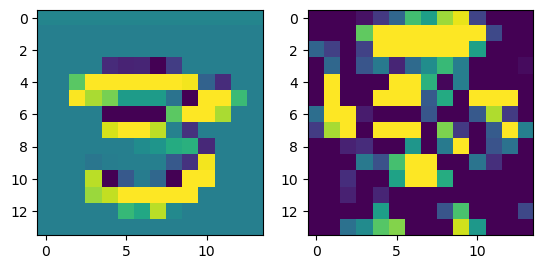

prediction: tensor([1, 6, 9]), tensor([2.4653, 2.2078, 0.9873]) groudtruth: 1
-0.074836254 0.072383784


<Figure size 640x480 with 0 Axes>

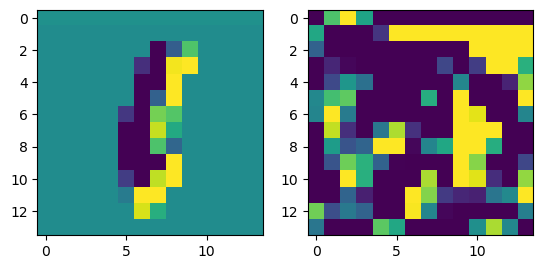

prediction: tensor([0, 3, 5]), tensor([6.3123, 1.0919, 0.9464]) groudtruth: 0
-0.091347575 0.08694188


<Figure size 640x480 with 0 Axes>

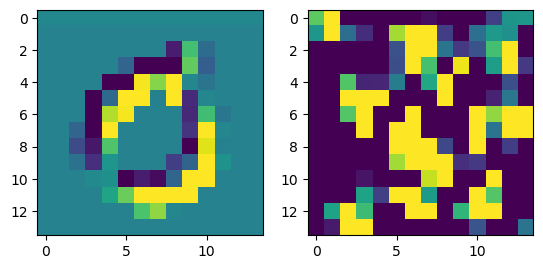

prediction: tensor([9, 3, 6]), tensor([3.3146, 2.5344, 1.0569]) groudtruth: 9
-0.085464716 0.12772416


<Figure size 640x480 with 0 Axes>

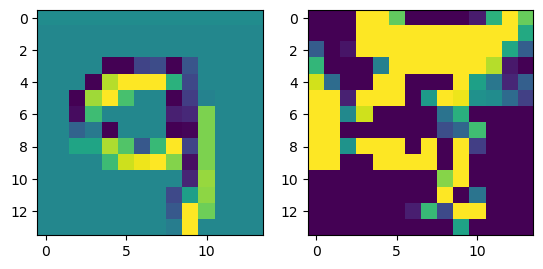

prediction: tensor([3, 8, 6]), tensor([3.2693, 2.2124, 1.2435]) groudtruth: 9
-0.08699381 0.11042346


<Figure size 640x480 with 0 Axes>

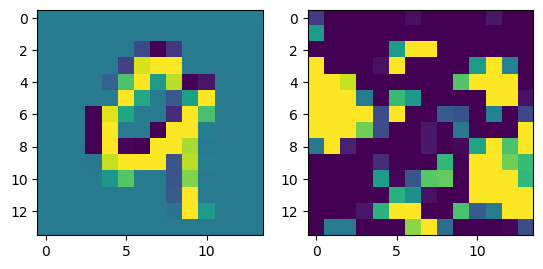

prediction: tensor([7, 8, 6]), tensor([4.9225, 1.0651, 1.0387]) groudtruth: 7
-0.072110236 0.08523278


<Figure size 640x480 with 0 Axes>

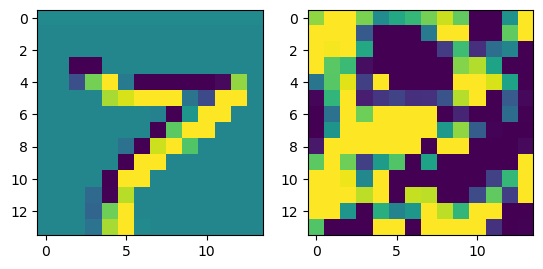

prediction: tensor([5, 8, 6]), tensor([6.5484, 1.2526, 0.4490]) groudtruth: 5
-0.08801031 0.07788907


<Figure size 640x480 with 0 Axes>

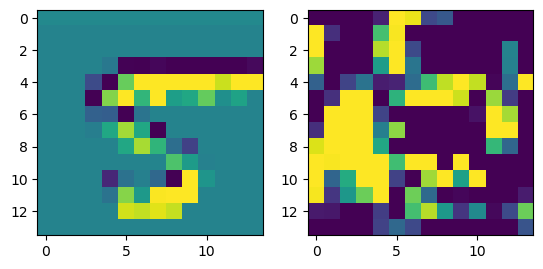

prediction: tensor([4, 6, 5]), tensor([4.0366, 1.8545, 0.5208]) groudtruth: 4
-0.069548786 0.08176178


<Figure size 640x480 with 0 Axes>

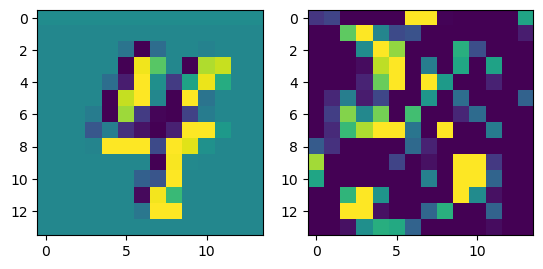

prediction: tensor([1, 2, 3]), tensor([5.5929, 1.2529, 1.0838]) groudtruth: 1
-0.074989736 0.08312321


<Figure size 640x480 with 0 Axes>

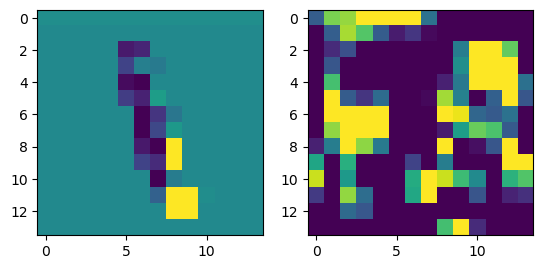

prediction: tensor([4, 9, 7]), tensor([4.0503, 0.8355, 0.7399]) groudtruth: 4
-0.10722691 0.089103945


<Figure size 640x480 with 0 Axes>

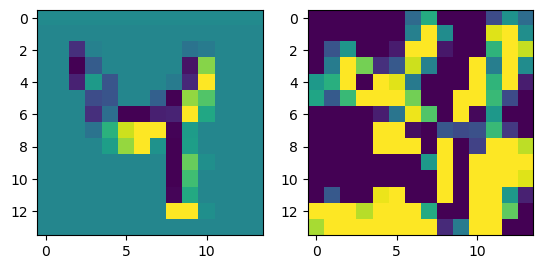

prediction: tensor([8, 2, 1]), tensor([2.2662, 2.1678, 0.7494]) groudtruth: 8
-0.088817954 0.10501929


<Figure size 640x480 with 0 Axes>

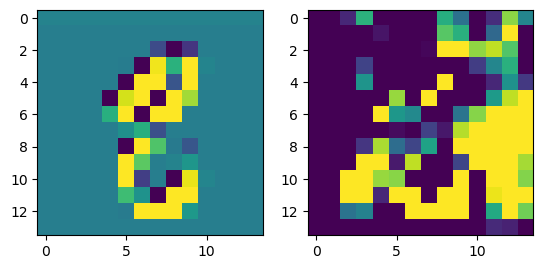

prediction: tensor([9, 6, 5]), tensor([6.0124, 0.9467, 0.8999]) groudtruth: 9
-0.091686845 0.062926695


<Figure size 640x480 with 0 Axes>

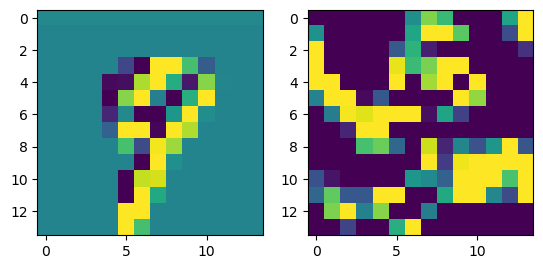

prediction: tensor([5, 6, 4]), tensor([3.1444, 2.6517, 1.9196]) groudtruth: 5
-0.06669277 0.091920085


<Figure size 640x480 with 0 Axes>

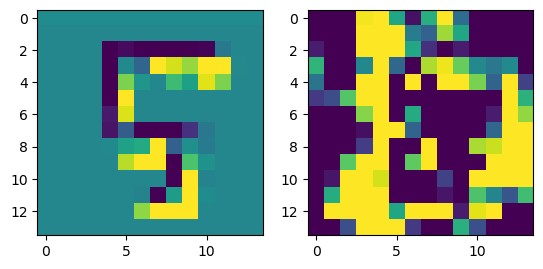

prediction: tensor([3, 5, 1]), tensor([5.6578, 2.1202, 1.6955]) groudtruth: 3
-0.06587154 0.09502187


<Figure size 640x480 with 0 Axes>

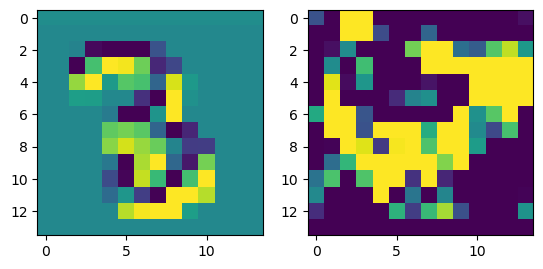

prediction: tensor([8, 5, 3]), tensor([3.4743, 3.3302, 2.8734]) groudtruth: 5
-0.119253516 0.090590455


<Figure size 640x480 with 0 Axes>

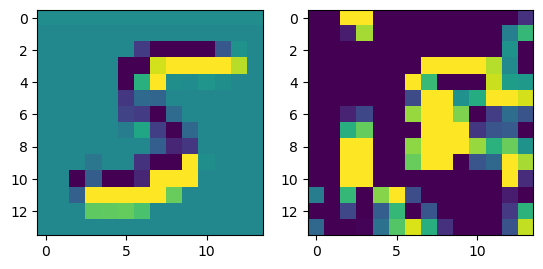

prediction: tensor([1, 4, 6]), tensor([3.3513, 1.4208, 0.6299]) groudtruth: 1
-0.063400686 0.10985161


<Figure size 640x480 with 0 Axes>

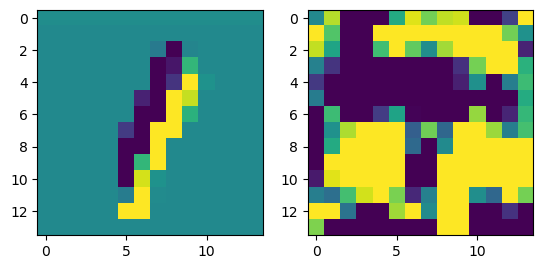

prediction: tensor([4, 9, 6]), tensor([5.9123, 3.0660, 2.4891]) groudtruth: 6
-0.06933415 0.07431908


<Figure size 640x480 with 0 Axes>

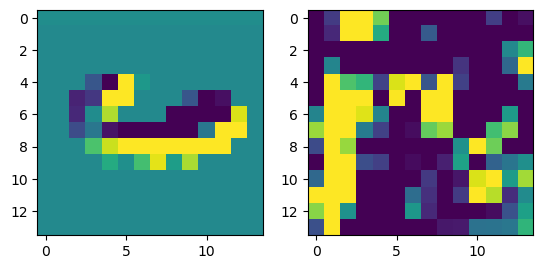

prediction: tensor([8, 2, 6]), tensor([4.6145, 1.2725, 0.8783]) groudtruth: 8
-0.07829571 0.11096369


<Figure size 640x480 with 0 Axes>

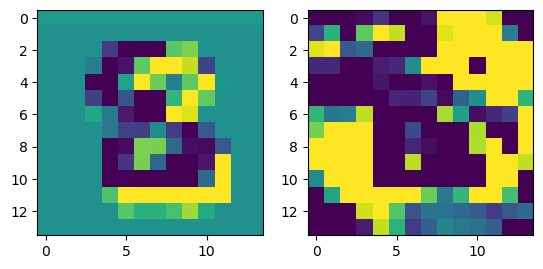

prediction: tensor([2, 9, 3]), tensor([4.9837, 2.5954, 1.0184]) groudtruth: 2
-0.07970387 0.09943828


<Figure size 640x480 with 0 Axes>

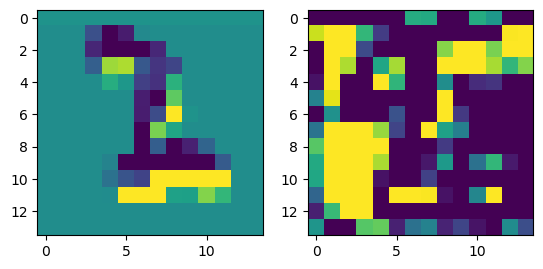

prediction: tensor([4, 2, 1]), tensor([4.7537, 1.7206, 0.9674]) groudtruth: 4
-0.08503759 0.07082327


<Figure size 640x480 with 0 Axes>

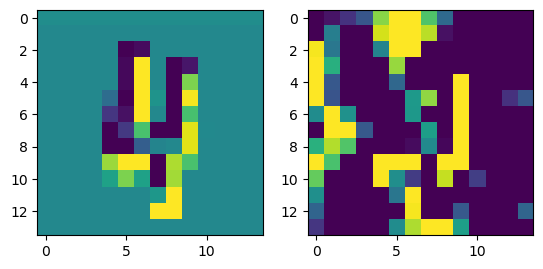

prediction: tensor([1, 6, 4]), tensor([3.6952, 2.9464, 2.9015]) groudtruth: 6
-0.081557214 0.08604818


<Figure size 640x480 with 0 Axes>

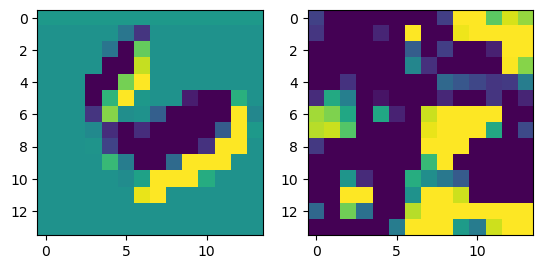

prediction: tensor([7, 0, 8]), tensor([3.1251, 0.9716, 0.4055]) groudtruth: 7
-0.08346605 0.077721074


<Figure size 640x480 with 0 Axes>

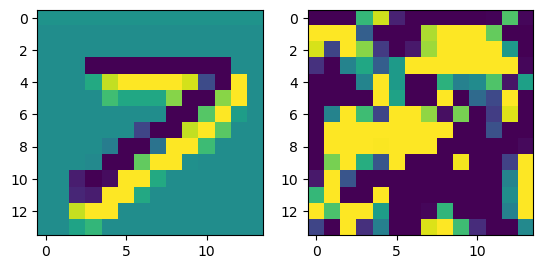

prediction: tensor([9, 7, 8]), tensor([3.3389, 2.6956, 1.1158]) groudtruth: 9
-0.08873588 0.07250056


<Figure size 640x480 with 0 Axes>

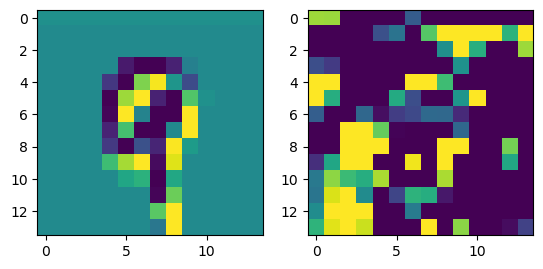

prediction: tensor([3, 5, 8]), tensor([5.2212, 2.6015, 1.5090]) groudtruth: 3
-0.07408482 0.10346813


<Figure size 640x480 with 0 Axes>

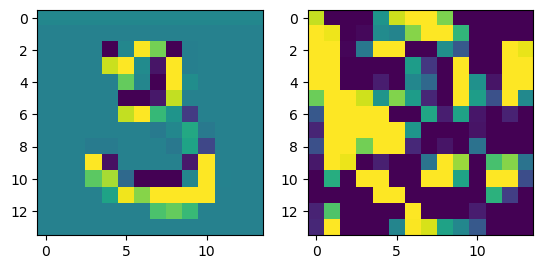

prediction: tensor([3, 5, 8]), tensor([4.9325, 1.9707, 1.7746]) groudtruth: 3
-0.08721626 0.090636075


<Figure size 640x480 with 0 Axes>

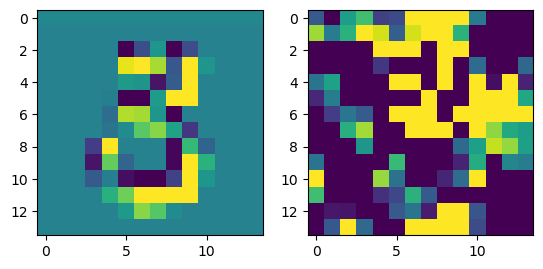

prediction: tensor([9, 4, 6]), tensor([2.9306, 1.0460, 0.5244]) groudtruth: 9
-0.113456905 0.083235174


<Figure size 640x480 with 0 Axes>

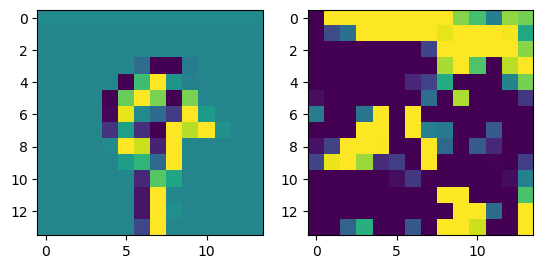

prediction: tensor([4, 8, 6]), tensor([1.7179, 1.2307, 0.9176]) groudtruth: 4
-0.11396849 0.06662641


<Figure size 640x480 with 0 Axes>

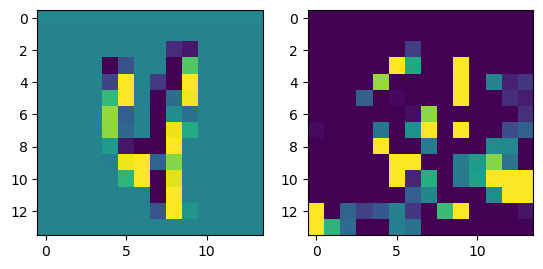

prediction: tensor([3, 5, 9]), tensor([2.4293, 2.1823, 1.5931]) groudtruth: 3
-0.07674116 0.11462335


<Figure size 640x480 with 0 Axes>

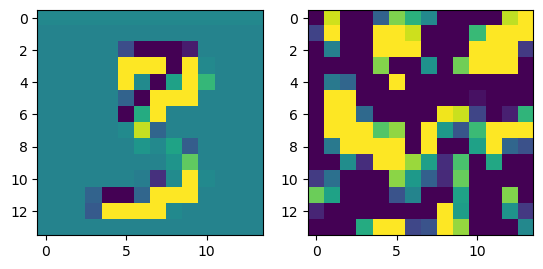

prediction: tensor([1, 7, 6]), tensor([5.0353, 0.5298, 0.4590]) groudtruth: 1
-0.099233806 0.06828756


<Figure size 640x480 with 0 Axes>

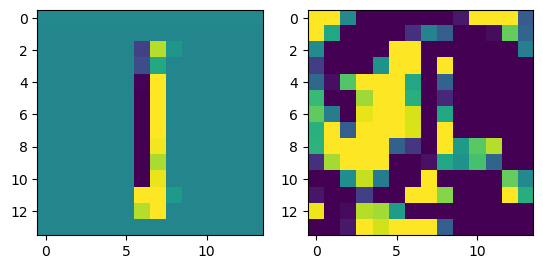

prediction: tensor([4, 9, 2]), tensor([4.4253, 2.9032, 1.9391]) groudtruth: 4
-0.076165974 0.080903836


<Figure size 640x480 with 0 Axes>

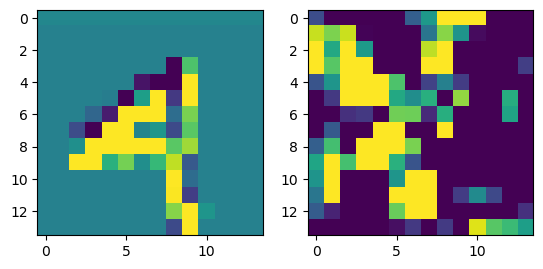

prediction: tensor([4, 8, 6]), tensor([4.2131, 1.8433, 1.7692]) groudtruth: 4
-0.06346923 0.09068562


<Figure size 640x480 with 0 Axes>

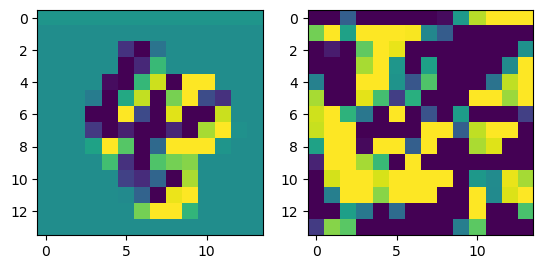

prediction: tensor([7, 6, 0]), tensor([4.0967, 2.9167, 0.9832]) groudtruth: 7
-0.07404512 0.0799995


<Figure size 640x480 with 0 Axes>

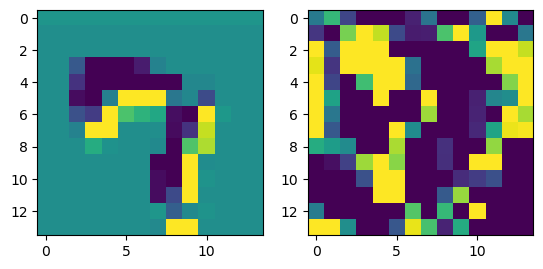

prediction: tensor([0, 3, 5]), tensor([3.6209, 2.1045, 0.5067]) groudtruth: 0
-0.09437817 0.069673896


<Figure size 640x480 with 0 Axes>

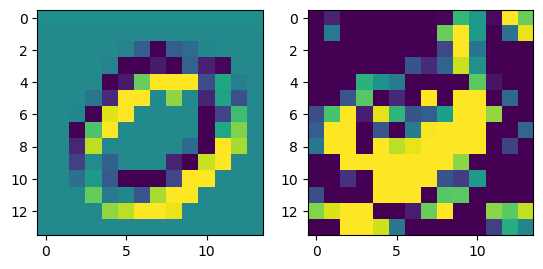

prediction: tensor([7, 9, 5]), tensor([2.9056, 2.6617, 0.9061]) groudtruth: 7
-0.0756802 0.08577931


<Figure size 640x480 with 0 Axes>

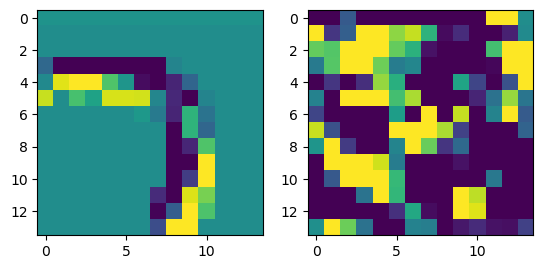

prediction: tensor([1, 2, 7]), tensor([5.1736, 2.5076, 0.4581]) groudtruth: 1
-0.073637426 0.07187526


<Figure size 640x480 with 0 Axes>

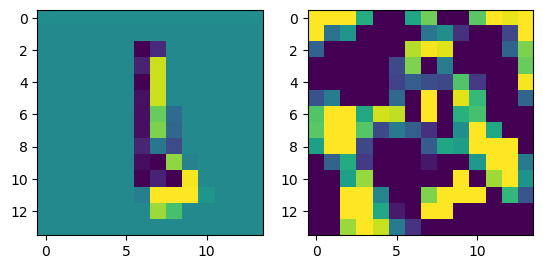

prediction: tensor([9, 8, 4]), tensor([2.8282, 1.8236, 1.3144]) groudtruth: 9
-0.05905491 0.08063871


<Figure size 640x480 with 0 Axes>

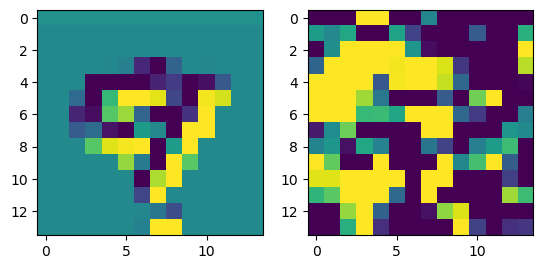

prediction: tensor([8, 3, 0]), tensor([5.7292, 1.4179, 0.9233]) groudtruth: 8
-0.07414687 0.07667425


<Figure size 640x480 with 0 Axes>

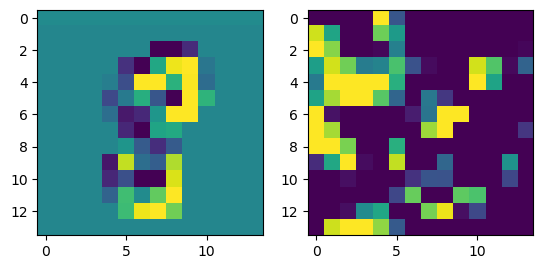

prediction: tensor([7, 9, 2]), tensor([5.5647, 2.3867, 0.3880]) groudtruth: 7
-0.09175563 0.07355418


<Figure size 640x480 with 0 Axes>

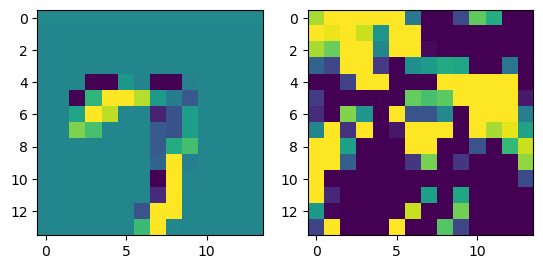

prediction: tensor([5, 3, 7]), tensor([5.6789, 2.8291, 1.4379]) groudtruth: 5
-0.10126895 0.096726224


<Figure size 640x480 with 0 Axes>

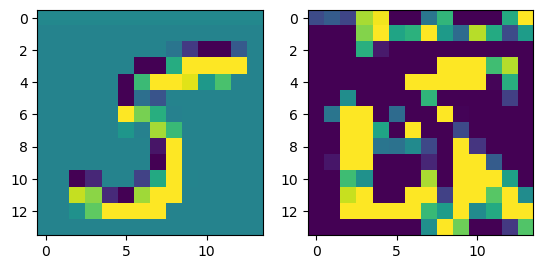

prediction: tensor([5, 3, 6]), tensor([2.8948, 2.0614, 2.0420]) groudtruth: 5
-0.08167535 0.10121666


<Figure size 640x480 with 0 Axes>

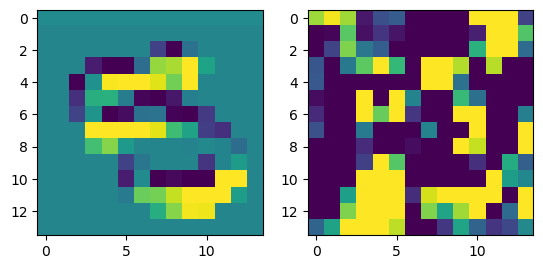

prediction: tensor([9, 7, 4]), tensor([4.1003, 1.8998, 0.8583]) groudtruth: 9
-0.106296 0.08422758


<Figure size 640x480 with 0 Axes>

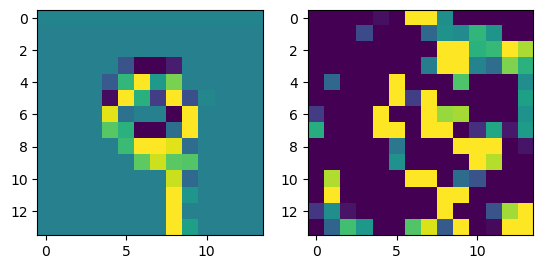

prediction: tensor([1, 7, 9]), tensor([4.3739, 0.6221, 0.1068]) groudtruth: 1
-0.09915745 0.084938034


<Figure size 640x480 with 0 Axes>

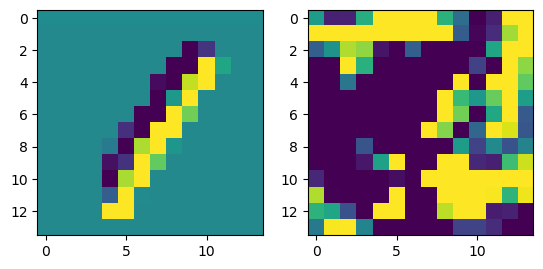

prediction: tensor([7, 9, 8]), tensor([6.1953, 1.0964, 0.6049]) groudtruth: 7
-0.08877432 0.08320826


<Figure size 640x480 with 0 Axes>

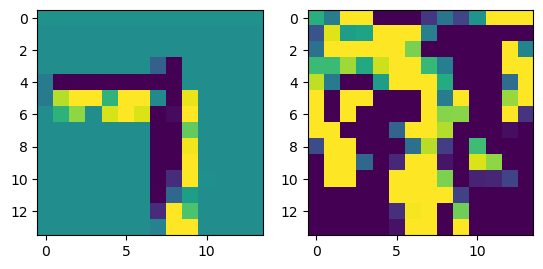

prediction: tensor([5, 3, 8]), tensor([7.6823, 2.8531, 0.1872]) groudtruth: 5
-0.059917748 0.0847235


<Figure size 640x480 with 0 Axes>

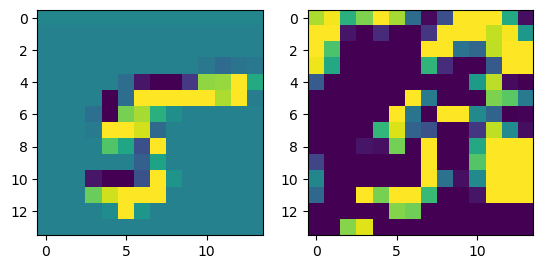

prediction: tensor([5, 4, 9]), tensor([1.8349, 1.8318, 1.7701]) groudtruth: 4
-0.07860428 0.11012186


<Figure size 640x480 with 0 Axes>

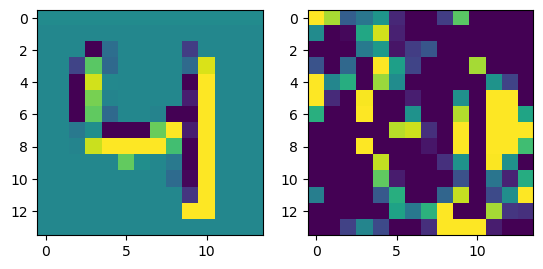

prediction: tensor([8, 5, 9]), tensor([1.9583, 1.8241, 1.4456]) groudtruth: 9
-0.0713948 0.11247176


<Figure size 640x480 with 0 Axes>

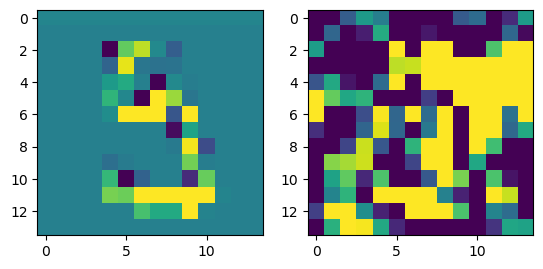

prediction: tensor([8, 1, 4]), tensor([2.8552, 2.3782, 1.2744]) groudtruth: 1
-0.10086125 0.07028918


<Figure size 640x480 with 0 Axes>

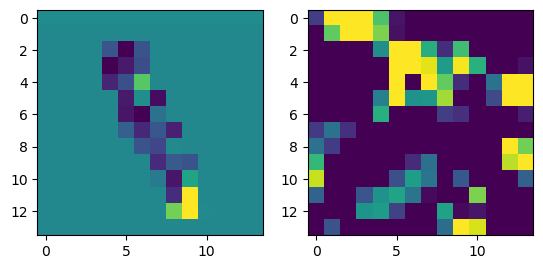

prediction: tensor([2, 4, 7]), tensor([6.5667, 2.0384, 1.5058]) groudtruth: 2
-0.0744527 0.07796777


<Figure size 640x480 with 0 Axes>

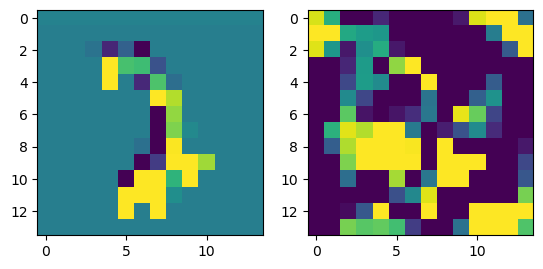

prediction: tensor([1, 7, 6]), tensor([5.3259, 3.1467, 0.4702]) groudtruth: 1
-0.076123476 0.090747565


<Figure size 640x480 with 0 Axes>

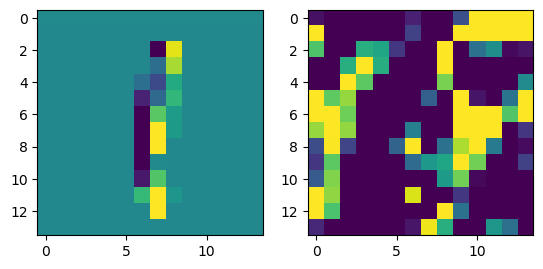

prediction: tensor([1, 2, 3]), tensor([4.0980, 1.2029, 1.0933]) groudtruth: 1
-0.069919825 0.090390235


<Figure size 640x480 with 0 Axes>

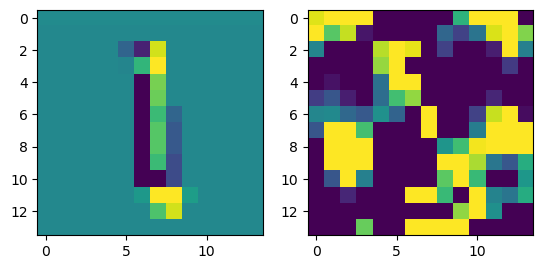

prediction: tensor([0, 6, 7]), tensor([3.7632, 2.2146, 1.2444]) groudtruth: 0
-0.053480446 0.052279416


<Figure size 640x480 with 0 Axes>

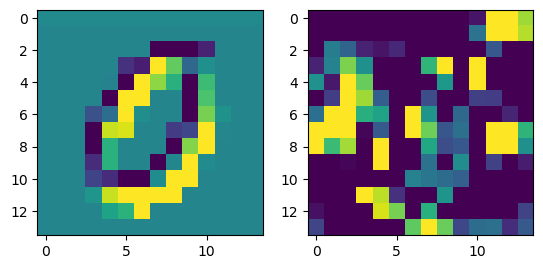

prediction: tensor([1, 2, 3]), tensor([5.3370, 1.6684, 1.3997]) groudtruth: 1
-0.049441695 0.08523701


<Figure size 640x480 with 0 Axes>

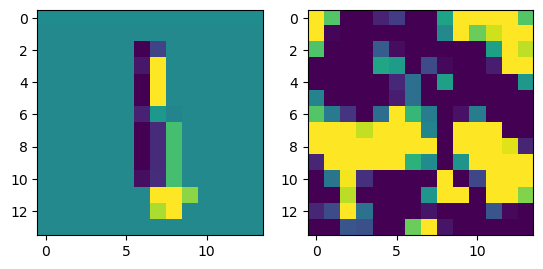

prediction: tensor([1, 8, 2]), tensor([5.6475, 1.9605, 0.5283]) groudtruth: 1
-0.05530858 0.080169454


<Figure size 640x480 with 0 Axes>

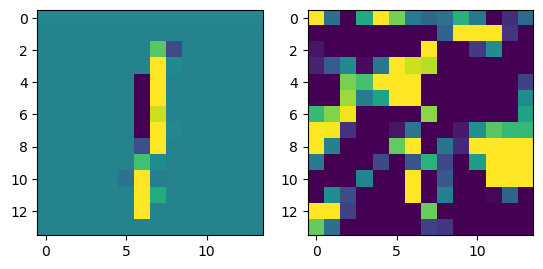

prediction: tensor([7, 4, 8]), tensor([2.9690, 2.8219, 1.5958]) groudtruth: 4
-0.083369374 0.092676125


<Figure size 640x480 with 0 Axes>

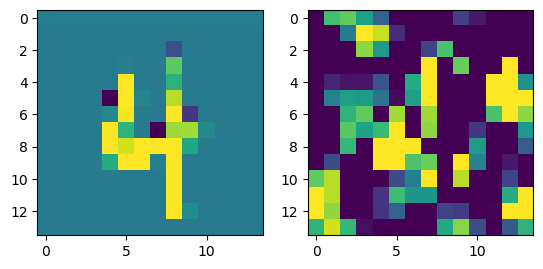

prediction: tensor([5, 6, 8]), tensor([4.4267, 2.4369, 1.6292]) groudtruth: 5
-0.10614878 0.116632536


<Figure size 640x480 with 0 Axes>

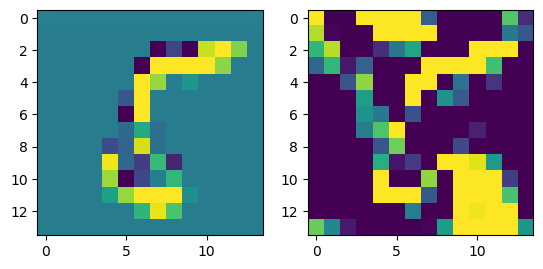

prediction: tensor([2, 1, 3]), tensor([4.9709, 1.3411, 0.5373]) groudtruth: 2
-0.05741346 0.14333601


<Figure size 640x480 with 0 Axes>

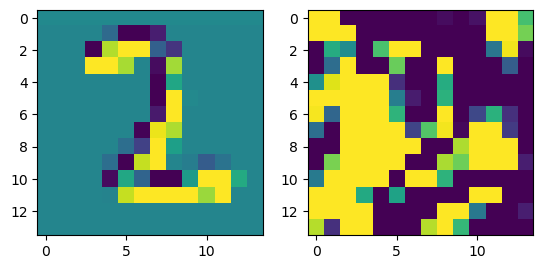

prediction: tensor([7, 2, 9]), tensor([6.0898, 2.4129, 1.6323]) groudtruth: 7
-0.08748895 0.0795401


<Figure size 640x480 with 0 Axes>

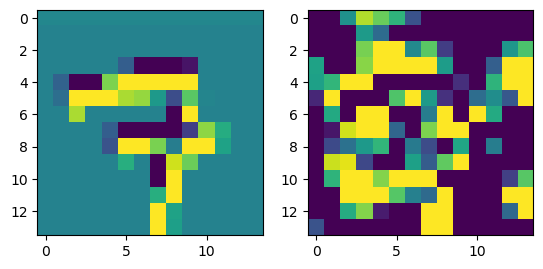

prediction: tensor([6, 1, 9]), tensor([5.5321, 1.8617, 1.2466]) groudtruth: 6
-0.07372671 0.09305309


<Figure size 640x480 with 0 Axes>

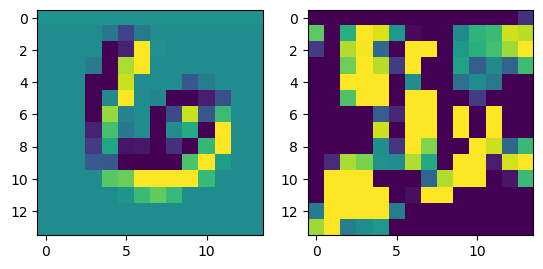

prediction: tensor([2, 9, 4]), tensor([4.7490, 2.7846, 1.5443]) groudtruth: 2
-0.06849402 0.13096434


<Figure size 640x480 with 0 Axes>

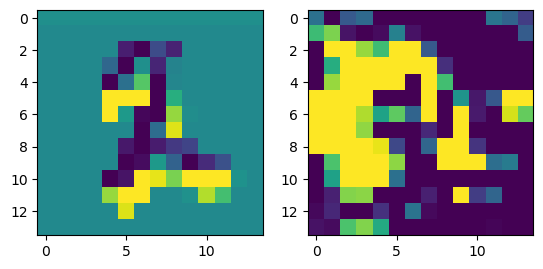

prediction: tensor([3, 9, 4]), tensor([4.0769, 2.0115, 1.7901]) groudtruth: 3
-0.061329603 0.10478405


<Figure size 640x480 with 0 Axes>

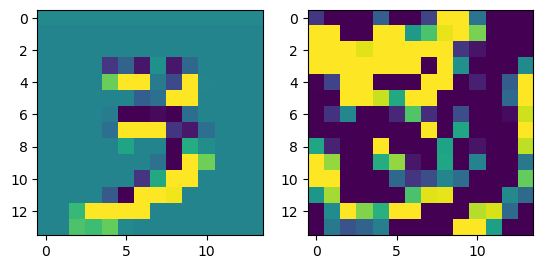

prediction: tensor([0, 1, 4]), tensor([6.0024, 0.2011, 0.0149]) groudtruth: 0
-0.07915604 0.08368788


<Figure size 640x480 with 0 Axes>

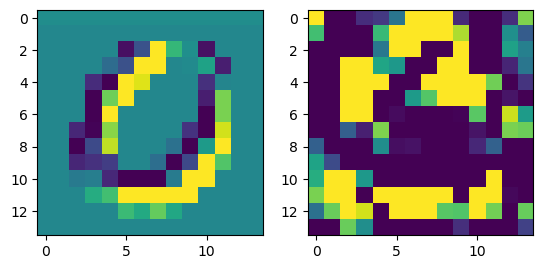

prediction: tensor([2, 6, 7]), tensor([3.8905, 2.1133, 1.6912]) groudtruth: 2
-0.09233457 0.07724028


<Figure size 640x480 with 0 Axes>

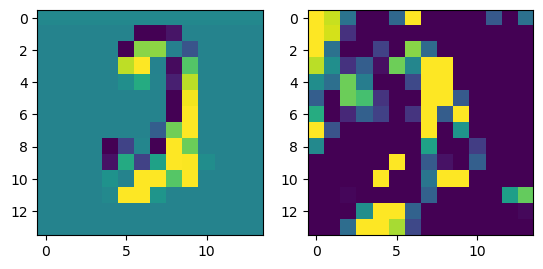

prediction: tensor([3, 0, 6]), tensor([2.9471, 2.8221, 1.0672]) groudtruth: 8
-0.079452336 0.0894932


<Figure size 640x480 with 0 Axes>

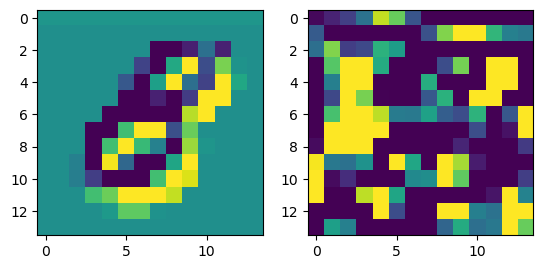

prediction: tensor([5, 7, 8]), tensor([4.6607, 0.7248, 0.5176]) groudtruth: 5
-0.09405786 0.11826286


<Figure size 640x480 with 0 Axes>

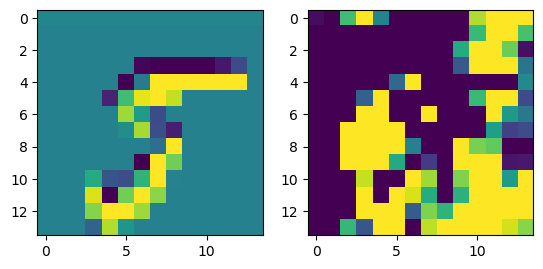

prediction: tensor([6, 9, 4]), tensor([5.2729, 2.3862, 1.5452]) groudtruth: 6
-0.07775664 0.083635345


<Figure size 640x480 with 0 Axes>

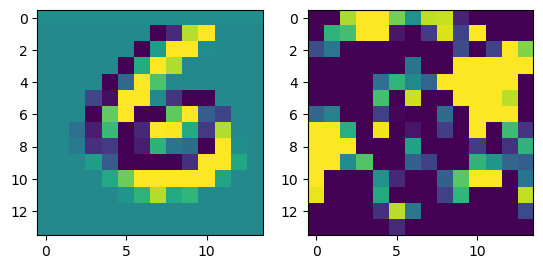

prediction: tensor([7, 6, 2]), tensor([3.6802, 2.7957, 1.3057]) groudtruth: 7
-0.08407128 0.0764359


<Figure size 640x480 with 0 Axes>

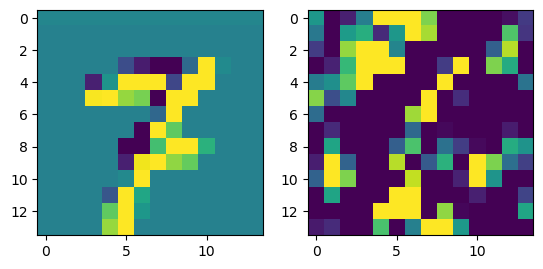

prediction: tensor([6, 9, 2]), tensor([4.7549, 0.9257, 0.1956]) groudtruth: 6
-0.091316044 0.10410879


<Figure size 640x480 with 0 Axes>

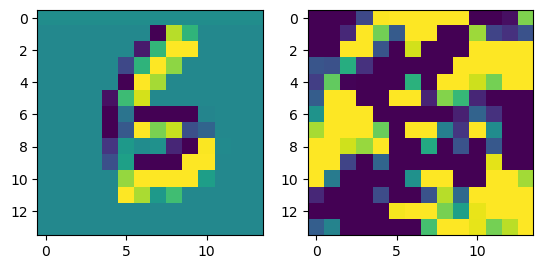

prediction: tensor([3, 5, 8]), tensor([2.4952, 1.7256, 1.2821]) groudtruth: 3
-0.0777536 0.119524896


<Figure size 640x480 with 0 Axes>

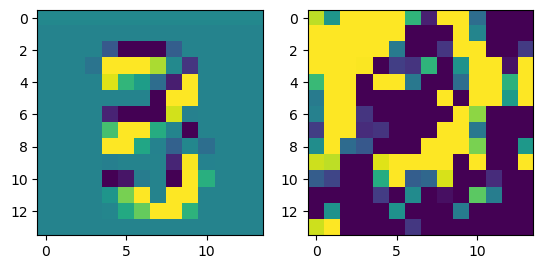

prediction: tensor([3, 5, 4]), tensor([2.8183, 1.6797, 1.2216]) groudtruth: 9
-0.0986253 0.09848136


<Figure size 640x480 with 0 Axes>

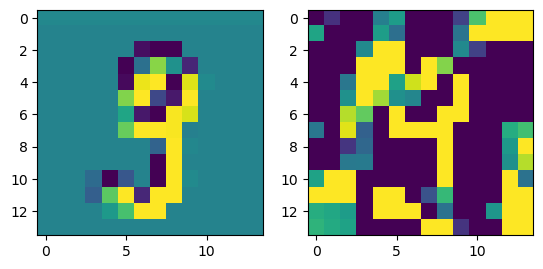

prediction: tensor([3, 8, 5]), tensor([3.0314, 1.4534, 0.8551]) groudtruth: 3
-0.103283525 0.08844319


<Figure size 640x480 with 0 Axes>

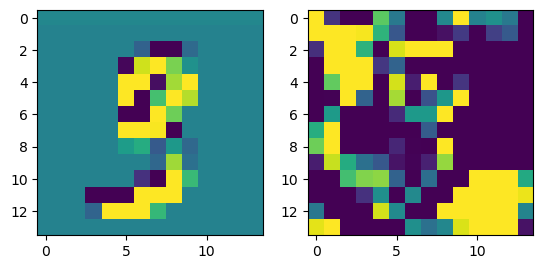

prediction: tensor([9, 8, 3]), tensor([3.9451, 3.4784, 2.2494]) groudtruth: 4
-0.07264006 0.067452475


<Figure size 640x480 with 0 Axes>

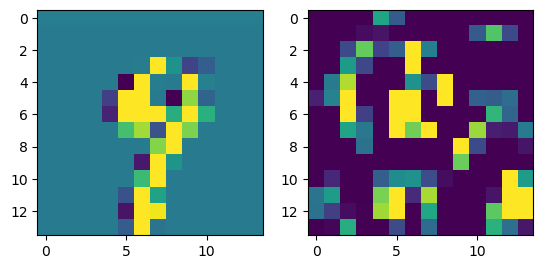

prediction: tensor([7, 0, 9]), tensor([5.5773, 0.7669, 0.6566]) groudtruth: 7
-0.08324945 0.08652745


<Figure size 640x480 with 0 Axes>

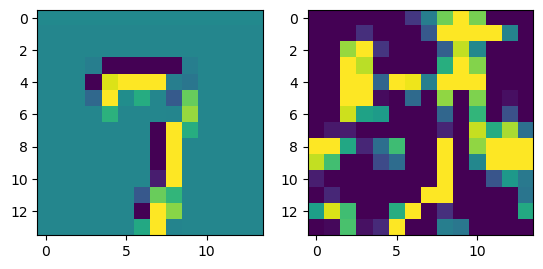

prediction: tensor([7, 9, 6]), tensor([3.4649, 2.0604, 1.1373]) groudtruth: 7
-0.06649971 0.12052511


<Figure size 640x480 with 0 Axes>

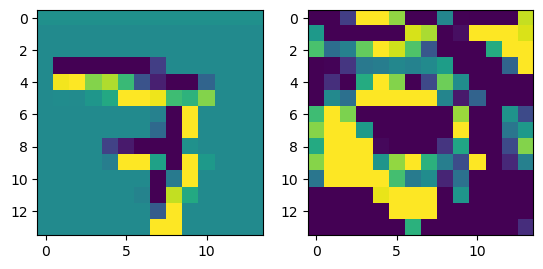

prediction: tensor([1, 7, 2]), tensor([2.4158, 2.0488, 1.0878]) groudtruth: 7
-0.05770445 0.07174225


<Figure size 640x480 with 0 Axes>

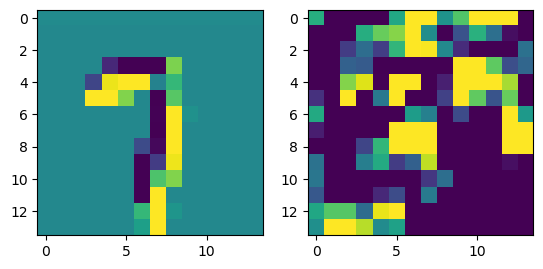

prediction: tensor([4, 9, 7]), tensor([4.4939, 1.6659, 0.9648]) groudtruth: 4
-0.11890435 0.05427037


<Figure size 640x480 with 0 Axes>

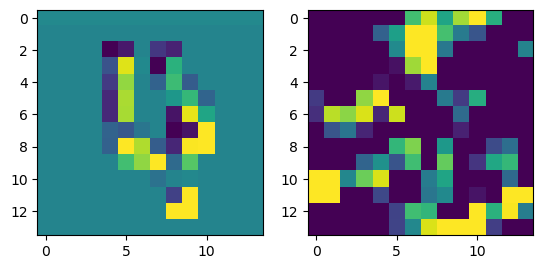

prediction: tensor([9, 7, 2]), tensor([3.5799, 2.3193, 1.3256]) groudtruth: 9
-0.09491444 0.07909313


<Figure size 640x480 with 0 Axes>

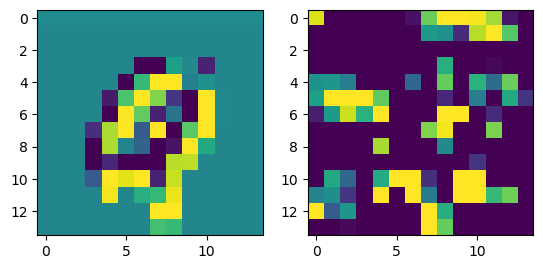

prediction: tensor([0, 6, 7]), tensor([3.4211, 2.1226, 1.1642]) groudtruth: 0
-0.05996251 0.08965609


<Figure size 640x480 with 0 Axes>

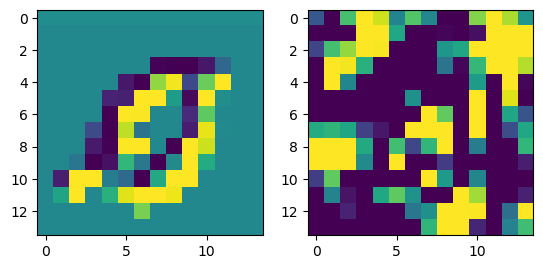

prediction: tensor([6, 9, 1]), tensor([3.4000, 2.3747, 1.4770]) groudtruth: 6
-0.0636611 0.06998038


<Figure size 640x480 with 0 Axes>

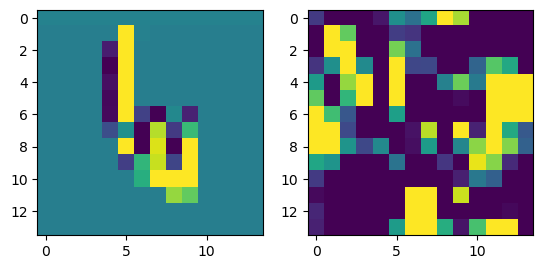

prediction: tensor([4, 9, 3]), tensor([1.5621, 1.3214, 1.0615]) groudtruth: 4
-0.07989538 0.09485501


<Figure size 640x480 with 0 Axes>

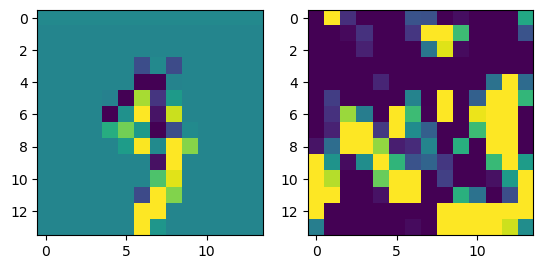

prediction: tensor([0, 8, 9]), tensor([1.8462, 1.6435, 1.5503]) groudtruth: 8
-0.08053458 0.06456062


<Figure size 640x480 with 0 Axes>

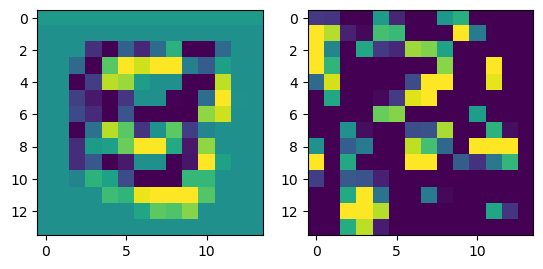

prediction: tensor([5, 8, 2]), tensor([4.1769, 3.0027, 2.8513]) groudtruth: 5
-0.080042005 0.103212535


<Figure size 640x480 with 0 Axes>

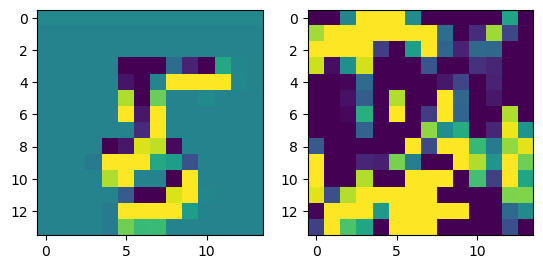

prediction: tensor([1, 6, 5]), tensor([4.5238, 3.1259, 0.9800]) groudtruth: 1
-0.11489421 0.085177645


<Figure size 640x480 with 0 Axes>

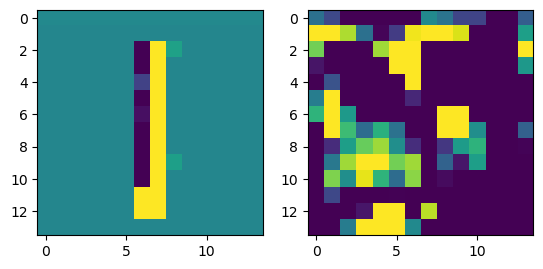

prediction: tensor([2, 6, 5]), tensor([3.7073, 3.0309, 1.9289]) groudtruth: 5
-0.07923156 0.090144075


<Figure size 640x480 with 0 Axes>

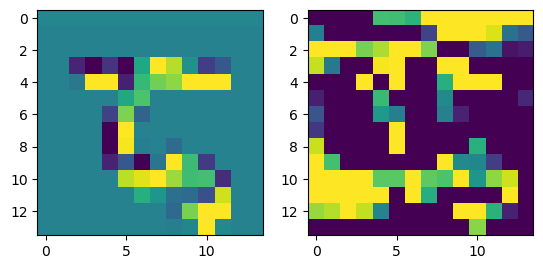

prediction: tensor([1, 3, 9]), tensor([4.8381, 1.3184, 1.0980]) groudtruth: 1
-0.06592417 0.07686691


<Figure size 640x480 with 0 Axes>

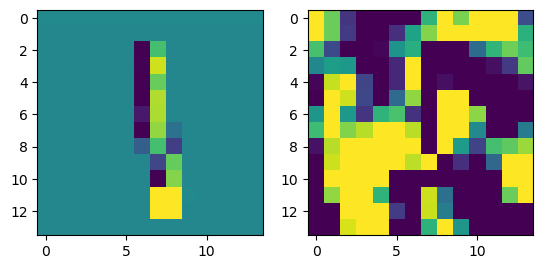

prediction: tensor([6, 4, 2]), tensor([4.6598, 3.0299, 2.0461]) groudtruth: 4
-0.080994904 0.08411895


<Figure size 640x480 with 0 Axes>

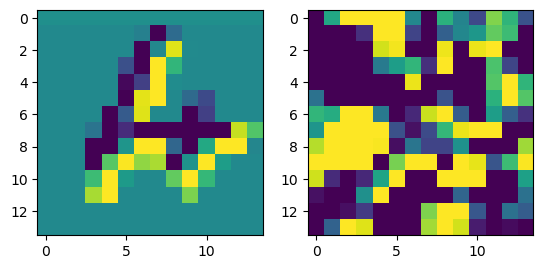

prediction: tensor([8, 9, 6]), tensor([3.8393, 1.7179, 0.0068]) groudtruth: 8
-0.060925424 0.06869433


<Figure size 640x480 with 0 Axes>

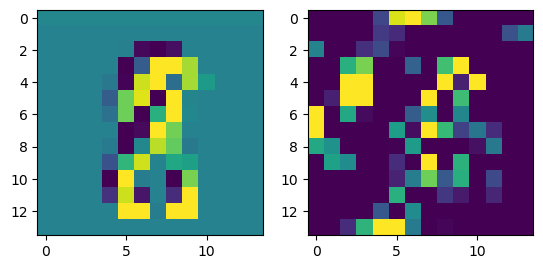

prediction: tensor([3, 7, 8]), tensor([2.3882, 1.2403, 1.1145]) groudtruth: 8
-0.07303965 0.11277972


<Figure size 640x480 with 0 Axes>

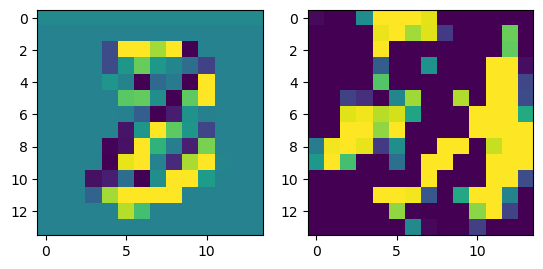

prediction: tensor([9, 8, 0]), tensor([3.1521, 1.0744, 0.8893]) groudtruth: 9
-0.094402015 0.10740858


<Figure size 640x480 with 0 Axes>

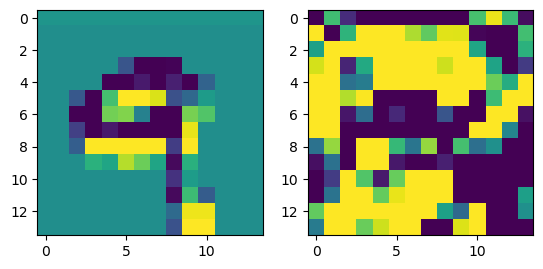

prediction: tensor([1, 7, 4]), tensor([6.1081, 0.5218, 0.1368]) groudtruth: 1
-0.06997496 0.06888128


<Figure size 640x480 with 0 Axes>

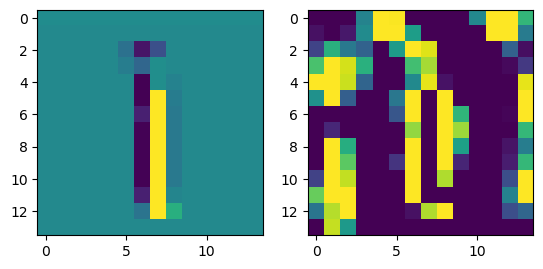

prediction: tensor([2, 3, 4]), tensor([4.7749, 1.0237, 0.4694]) groudtruth: 2
-0.09479016 0.08332203


<Figure size 640x480 with 0 Axes>

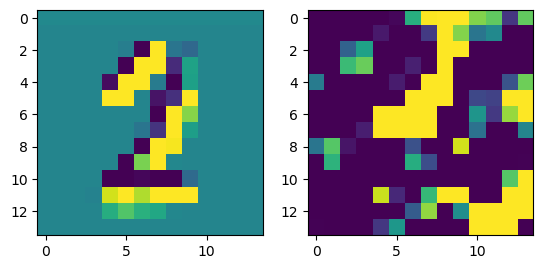

prediction: tensor([1, 8, 4]), tensor([6.1252, 0.4967, 0.4318]) groudtruth: 1
-0.071418285 0.07101413


<Figure size 640x480 with 0 Axes>

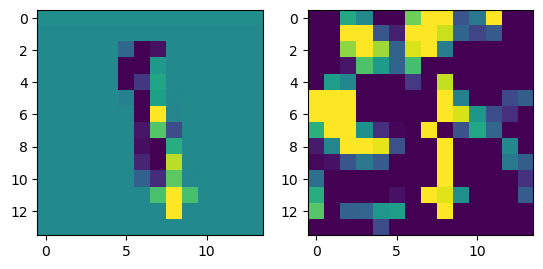

prediction: tensor([3, 9, 1]), tensor([5.1237, 2.3397, 0.7336]) groudtruth: 3
-0.07137823 0.08655809


<Figure size 640x480 with 0 Axes>

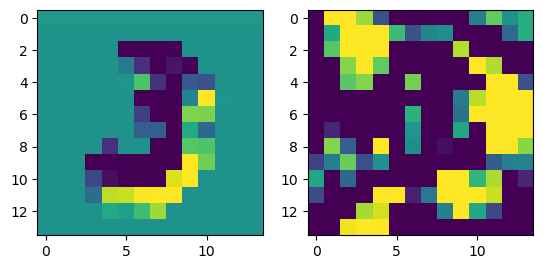

prediction: tensor([5, 7, 8]), tensor([5.4676, 1.7900, 0.4234]) groudtruth: 5
-0.064686 0.08425555


<Figure size 640x480 with 0 Axes>

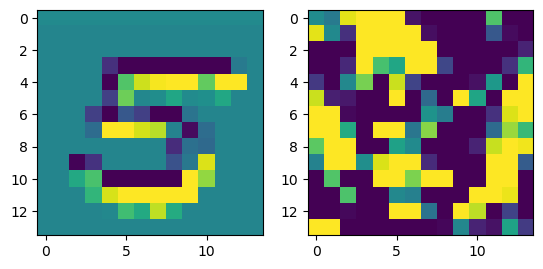

prediction: tensor([1, 8, 4]), tensor([4.6720, 2.9893, 1.1485]) groudtruth: 1
-0.08227724 0.09131186


<Figure size 640x480 with 0 Axes>

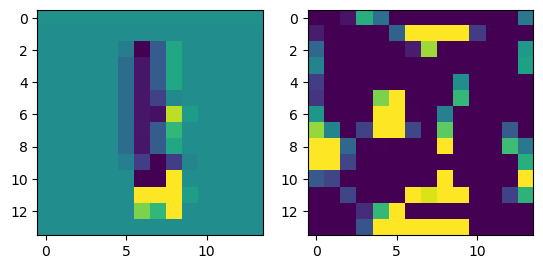

prediction: tensor([0, 9, 3]), tensor([5.4272, 3.2888, 1.3566]) groudtruth: 0
-0.10890269 0.11528639


<Figure size 640x480 with 0 Axes>

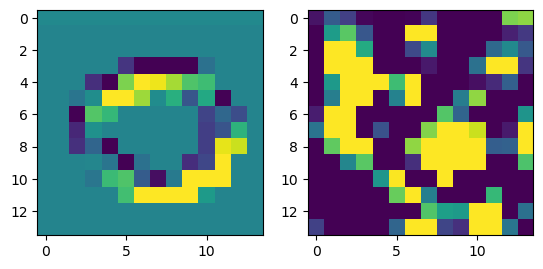

prediction: tensor([9, 4, 5]), tensor([2.9645, 2.2917, 1.2092]) groudtruth: 9
-0.08607942 0.06783486


<Figure size 640x480 with 0 Axes>

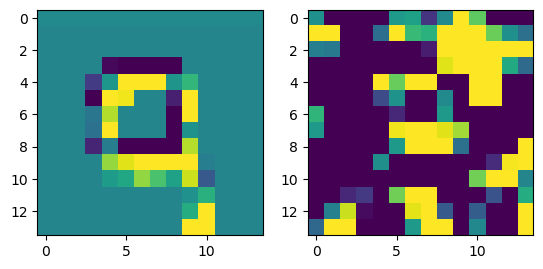

prediction: tensor([9, 5, 3]), tensor([3.6566, 0.5747, 0.5334]) groudtruth: 9
-0.0704515 0.08281034


<Figure size 640x480 with 0 Axes>

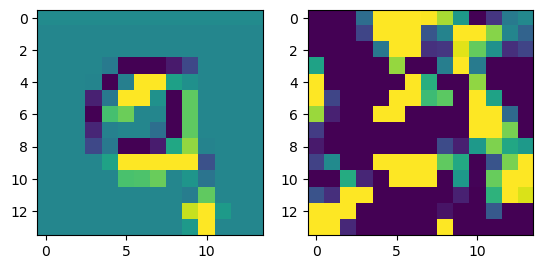

prediction: tensor([4, 9, 7]), tensor([4.2731, 1.7264, 1.1377]) groudtruth: 4
-0.081362665 0.1032634


<Figure size 640x480 with 0 Axes>

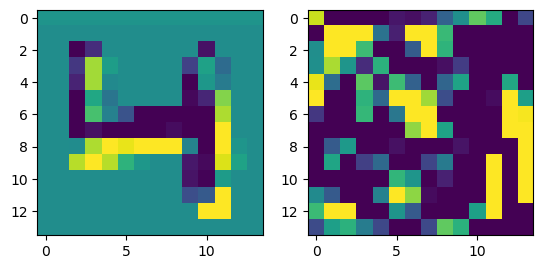

prediction: tensor([9, 8, 2]), tensor([4.2552, 1.4656, 0.2554]) groudtruth: 9
-0.08557975 0.09975469


<Figure size 640x480 with 0 Axes>

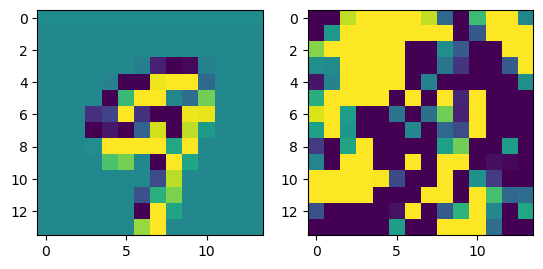

prediction: tensor([1, 8, 4]), tensor([6.4274, 0.9618, 0.1023]) groudtruth: 1
-0.07037753 0.10380873


<Figure size 640x480 with 0 Axes>

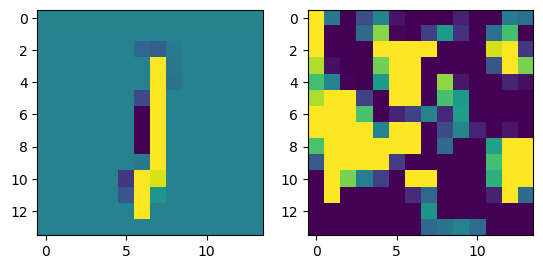

prediction: tensor([2, 7, 1]), tensor([3.9047, 2.1782, 1.8035]) groudtruth: 2
-0.11912352 0.14613914


<Figure size 640x480 with 0 Axes>

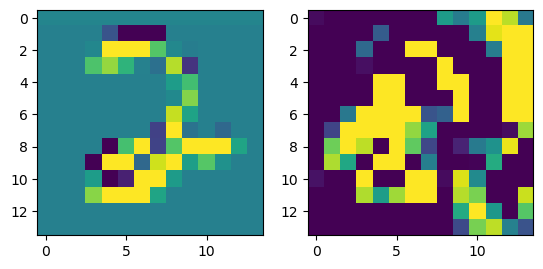

prediction: tensor([8, 3, 2]), tensor([4.9102, 1.8799, 1.8390]) groudtruth: 8
-0.08738077 0.08011299


<Figure size 640x480 with 0 Axes>

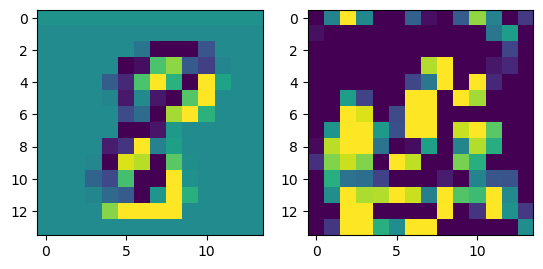

prediction: tensor([4, 0, 5]), tensor([2.9423, 2.1471, 0.9559]) groudtruth: 6
-0.097180486 0.10061654


<Figure size 640x480 with 0 Axes>

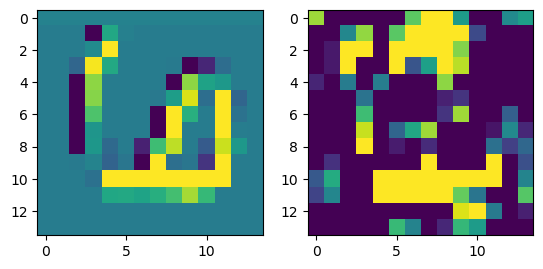

prediction: tensor([0, 3, 8]), tensor([7.9631, 1.1685, 0.4965]) groudtruth: 0
-0.07357496 0.07018414


<Figure size 640x480 with 0 Axes>

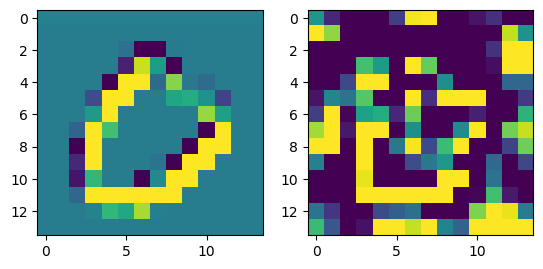

prediction: tensor([3, 2, 4]), tensor([1.5715, 1.1192, 0.8577]) groudtruth: 7
-0.09174371 0.073401585


<Figure size 640x480 with 0 Axes>

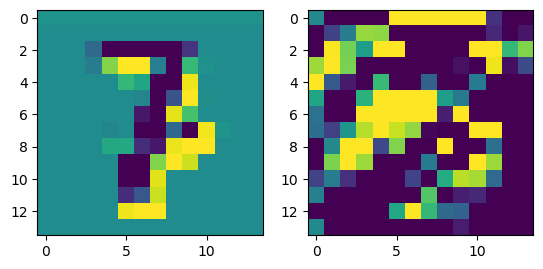

prediction: tensor([0, 3, 8]), tensor([2.3618, 1.9486, 1.5342]) groudtruth: 0
-0.10158843 0.07516128


<Figure size 640x480 with 0 Axes>

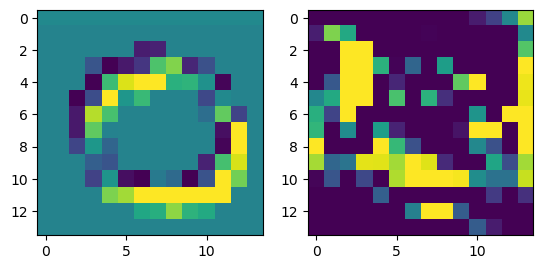

prediction: tensor([4, 9, 3]), tensor([4.9136, 2.5841, 1.3061]) groudtruth: 9
-0.07005 0.098119274


<Figure size 640x480 with 0 Axes>

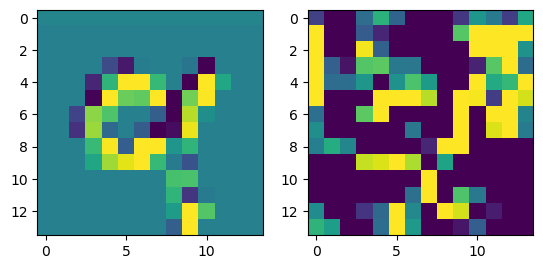

prediction: tensor([0, 1, 6]), tensor([2.8501, 2.8219, 1.5581]) groudtruth: 1
-0.084097445 0.09342636


<Figure size 640x480 with 0 Axes>

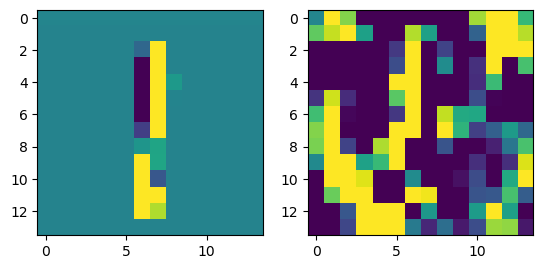

prediction: tensor([1, 5, 4]), tensor([3.7079, 3.1523, 1.8660]) groudtruth: 1
-0.06327206 0.077798694


<Figure size 640x480 with 0 Axes>

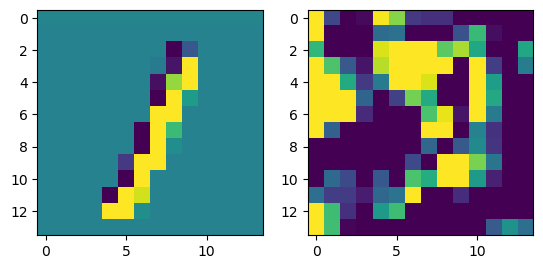

prediction: tensor([5, 8, 3]), tensor([4.3878, 2.3174, 2.1564]) groudtruth: 6
-0.09947723 0.10269746


<Figure size 640x480 with 0 Axes>

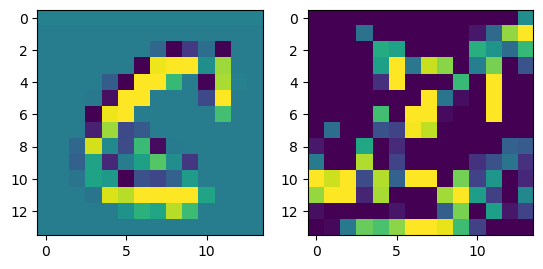

prediction: tensor([8, 7, 6]), tensor([2.8564, 2.6556, 1.0516]) groudtruth: 7
-0.08414972 0.06684789


<Figure size 640x480 with 0 Axes>

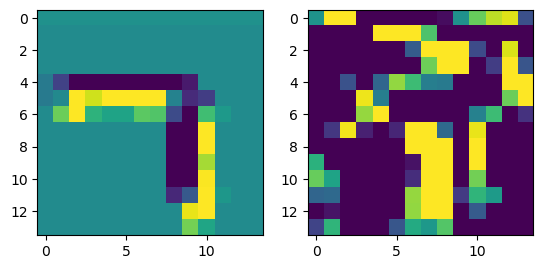

prediction: tensor([0, 1, 3]), tensor([3.1303, 1.5846, 1.4591]) groudtruth: 5
-0.09893727 0.06563164


<Figure size 640x480 with 0 Axes>

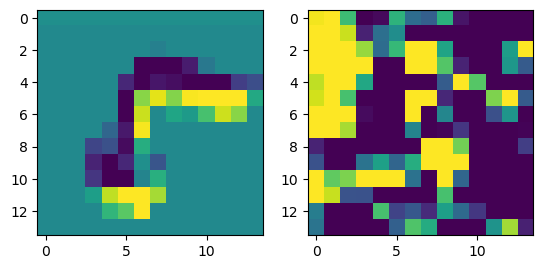

prediction: tensor([2, 4, 8]), tensor([3.3723, 1.1533, 1.1371]) groudtruth: 2
-0.07133913 0.098435596


<Figure size 640x480 with 0 Axes>

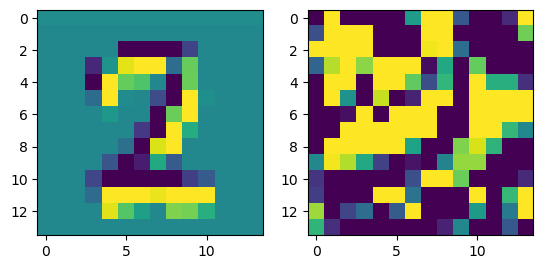

prediction: tensor([8, 2, 4]), tensor([6.3165, 1.8488, 1.5526]) groudtruth: 8
-0.06160158 0.06694095


<Figure size 640x480 with 0 Axes>

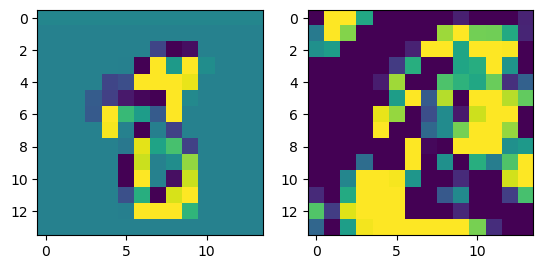

prediction: tensor([4, 2, 3]), tensor([3.5067, 1.9474, 0.8141]) groudtruth: 1
-0.068564236 0.09672404


<Figure size 640x480 with 0 Axes>

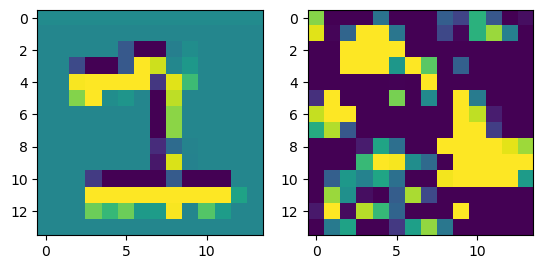

prediction: tensor([5, 4, 7]), tensor([4.7990, 2.2862, 1.2819]) groudtruth: 5
-0.086275876 0.09435263


<Figure size 640x480 with 0 Axes>

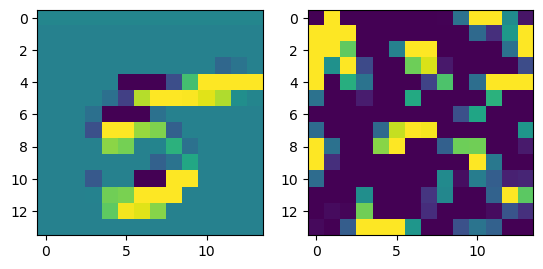

prediction: tensor([6, 2, 7]), tensor([3.2314, 1.9570, 1.2185]) groudtruth: 6
-0.08330464 0.08606291


<Figure size 640x480 with 0 Axes>

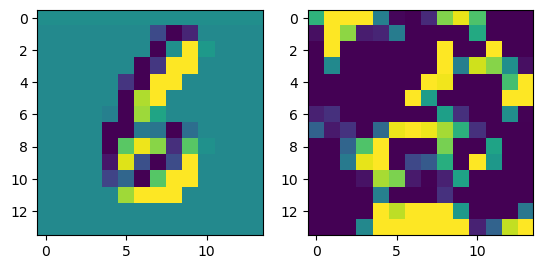

prediction: tensor([2, 0, 7]), tensor([3.7332, 1.3411, 0.8584]) groudtruth: 2
-0.07816863 0.117166735


<Figure size 640x480 with 0 Axes>

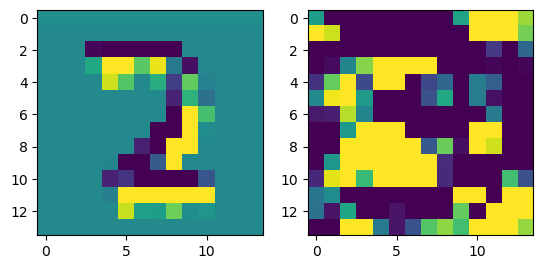

prediction: tensor([3, 5, 9]), tensor([4.4806, 1.2887, 0.3914]) groudtruth: 3
-0.09333646 0.092779435


<Figure size 640x480 with 0 Axes>

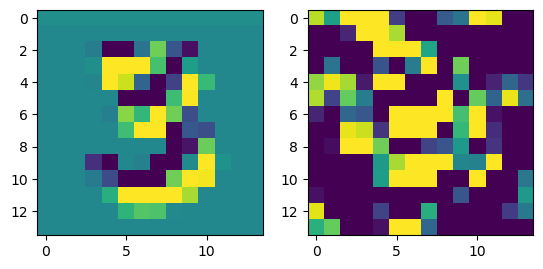

prediction: tensor([0, 3, 2]), tensor([6.8337, 1.6005, 0.7974]) groudtruth: 0
-0.08578706 0.08293338


<Figure size 640x480 with 0 Axes>

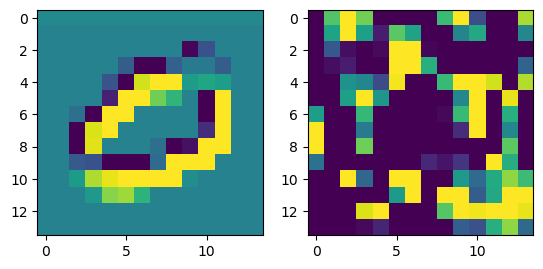

prediction: tensor([2, 8, 4]), tensor([6.0175, 1.8028, 1.4832]) groudtruth: 2
-0.08252126 0.08782967


<Figure size 640x480 with 0 Axes>

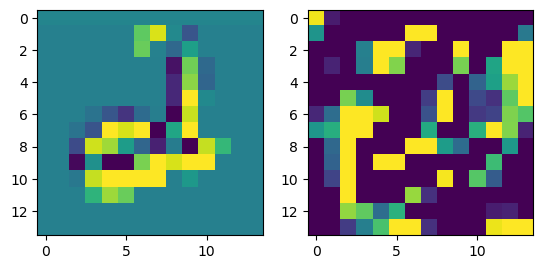

prediction: tensor([2, 5, 4]), tensor([2.5434, 2.1727, 1.6486]) groudtruth: 2
-0.096492946 0.07002832


<Figure size 640x480 with 0 Axes>

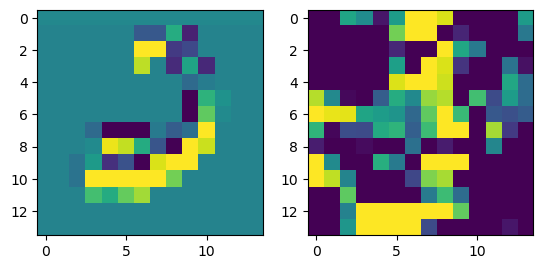

prediction: tensor([6, 5, 7]), tensor([6.2727, 1.6471, 0.8161]) groudtruth: 6
-0.07230133 0.0883305


<Figure size 640x480 with 0 Axes>

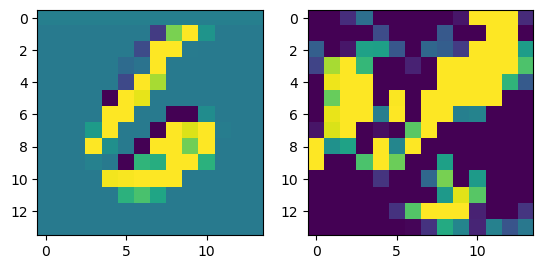

prediction: tensor([4, 7, 0]), tensor([4.8992, 2.2984, 0.6775]) groudtruth: 4
-0.08342731 0.080013916


<Figure size 640x480 with 0 Axes>

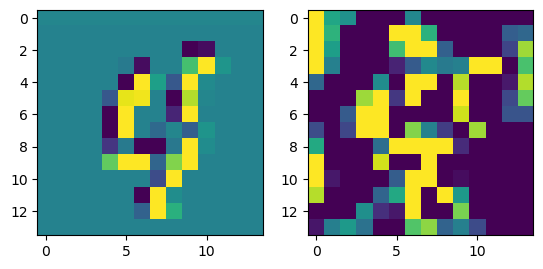

prediction: tensor([3, 5, 2]), tensor([3.6029, 3.1139, 0.8762]) groudtruth: 3
-0.12792182 0.1054502


<Figure size 640x480 with 0 Axes>

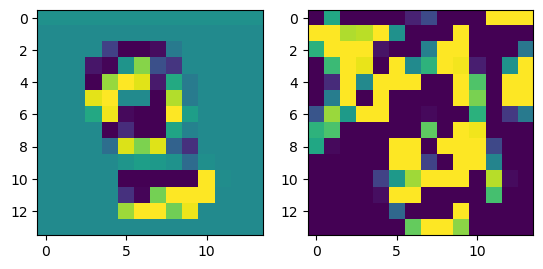

prediction: tensor([5, 3, 6]), tensor([4.5920, 3.7212, 1.7796]) groudtruth: 5
-0.08802825 0.10839629


<Figure size 640x480 with 0 Axes>

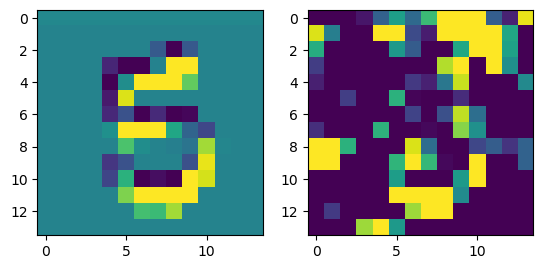

prediction: tensor([8, 4, 9]), tensor([4.2157, 3.7962, 2.4652]) groudtruth: 5
-0.071754515 0.07337026


<Figure size 640x480 with 0 Axes>

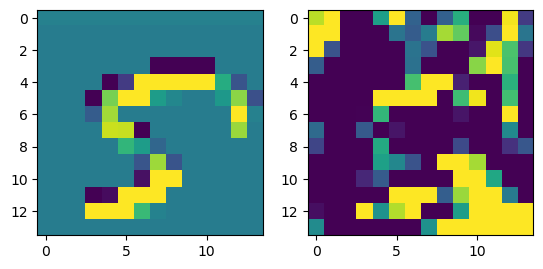

prediction: tensor([1, 3, 9]), tensor([4.0962, 1.6711, 1.5583]) groudtruth: 1
-0.09337026 0.08434179


<Figure size 640x480 with 0 Axes>

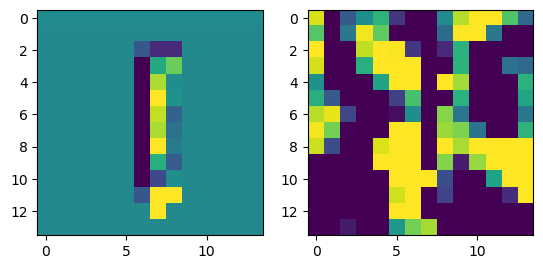

prediction: tensor([8, 2, 4]), tensor([1.8690, 0.9274, 0.9059]) groudtruth: 5
-0.0776521 0.08197936


<Figure size 640x480 with 0 Axes>

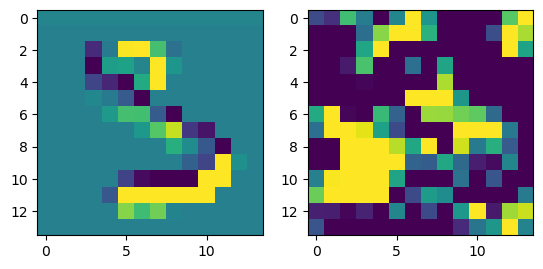

prediction: tensor([7, 9, 4]), tensor([3.4186, 2.6375, 0.8973]) groudtruth: 7
-0.09163809 0.1014439


<Figure size 640x480 with 0 Axes>

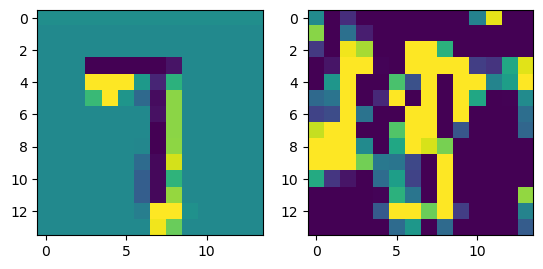

prediction: tensor([9, 7, 4]), tensor([4.0886, 1.2362, 0.6389]) groudtruth: 9
-0.09472537 0.06645208


<Figure size 640x480 with 0 Axes>

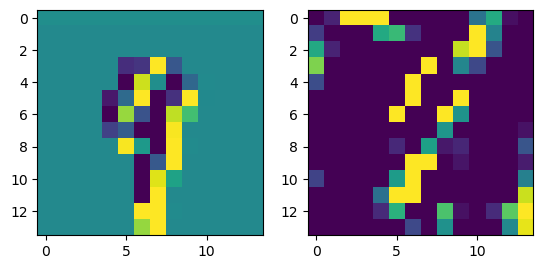

prediction: tensor([4, 8, 9]), tensor([4.0200, 2.2019, 1.6940]) groudtruth: 4
-0.07624656 0.09316628


<Figure size 640x480 with 0 Axes>

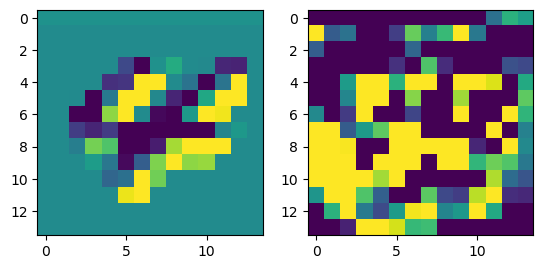

prediction: tensor([6, 0, 5]), tensor([5.0130, 1.1672, 0.6432]) groudtruth: 6
-0.061244488 0.07176898


<Figure size 640x480 with 0 Axes>

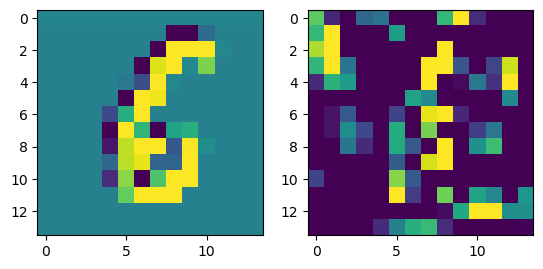

prediction: tensor([7, 9, 6]), tensor([3.6565, 0.8726, 0.6306]) groudtruth: 7
-0.08360219 0.06537637


<Figure size 640x480 with 0 Axes>

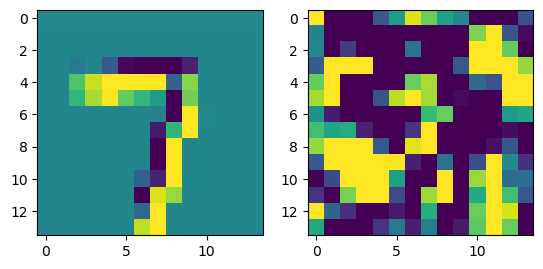

prediction: tensor([1, 2, 0]), tensor([5.2404, 1.7803, 1.2487]) groudtruth: 1
-0.08073223 0.07498506


<Figure size 640x480 with 0 Axes>

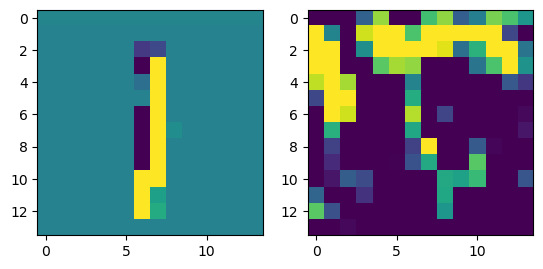

prediction: tensor([3, 1, 9]), tensor([2.9066, 1.5998, 1.0735]) groudtruth: 3
-0.077260315 0.08200003


<Figure size 640x480 with 0 Axes>

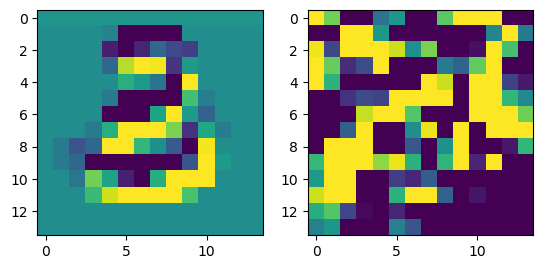

prediction: tensor([3, 1, 9]), tensor([1.9795, 1.5725, 1.4036]) groudtruth: 7
-0.08422041 0.088580854


<Figure size 640x480 with 0 Axes>

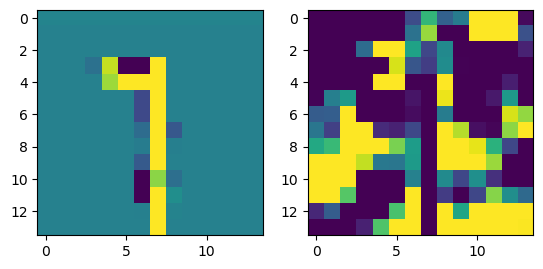

prediction: tensor([3, 7, 2]), tensor([3.4411, 2.1205, 0.3971]) groudtruth: 3
-0.10288626 0.10079172


<Figure size 640x480 with 0 Axes>

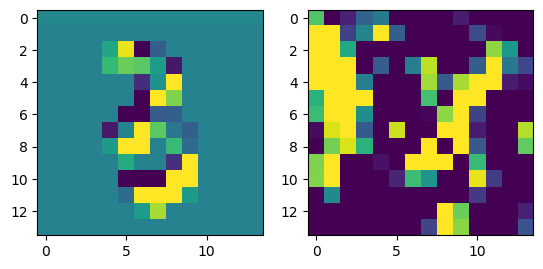

prediction: tensor([6, 2, 9]), tensor([2.2694, 1.1247, 0.7319]) groudtruth: 6
-0.07166809 0.05462855


<Figure size 640x480 with 0 Axes>

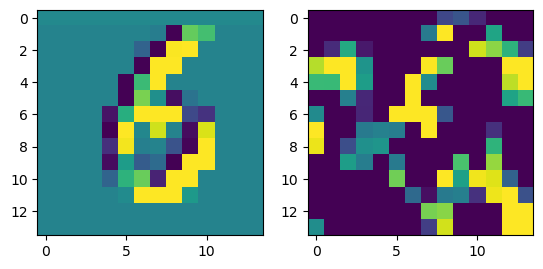

prediction: tensor([6, 5, 9]), tensor([3.0057, 1.5565, 1.3497]) groudtruth: 6
-0.08511603 0.0916507


<Figure size 640x480 with 0 Axes>

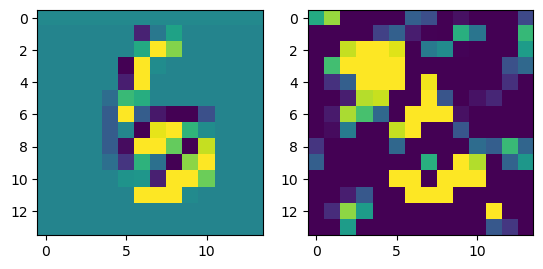

prediction: tensor([0, 7, 3]), tensor([6.7028, 1.8904, 1.6605]) groudtruth: 0
-0.0867874 0.074825376


<Figure size 640x480 with 0 Axes>

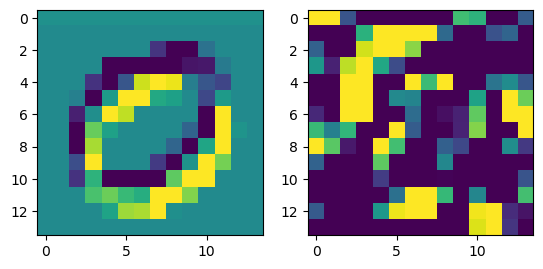

prediction: tensor([9, 3, 0]), tensor([2.9237, 1.8006, 1.6717]) groudtruth: 9
-0.08359921 0.07784023


<Figure size 640x480 with 0 Axes>

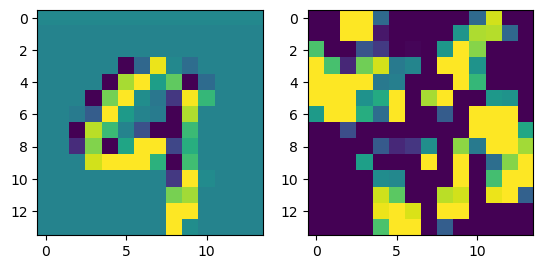

prediction: tensor([0, 8, 5]), tensor([4.6963, 3.5137, 2.0213]) groudtruth: 0
-0.073367774 0.079342216


<Figure size 640x480 with 0 Axes>

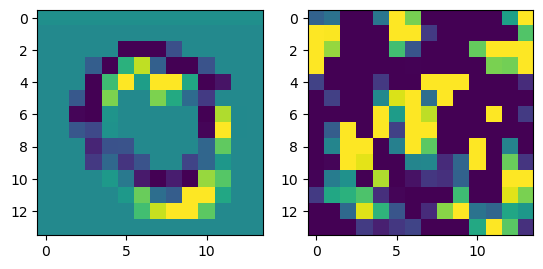

prediction: tensor([1, 0, 2]), tensor([4.6167, 1.7473, 0.9690]) groudtruth: 1
-0.056570828 0.06600482


<Figure size 640x480 with 0 Axes>

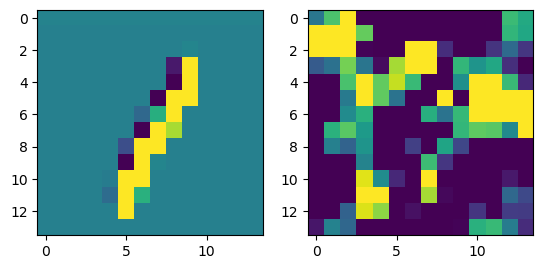

prediction: tensor([1, 8, 4]), tensor([3.9670, 1.2203, 0.8972]) groudtruth: 1
-0.10104519 0.09018943


<Figure size 640x480 with 0 Axes>

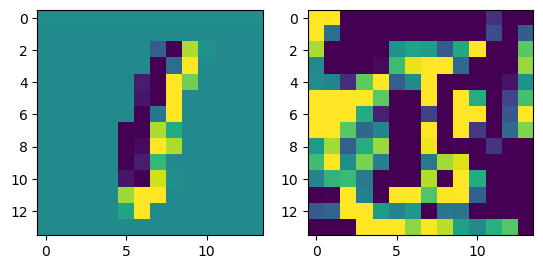

prediction: tensor([0, 6, 8]), tensor([5.4726, 0.9937, 0.8873]) groudtruth: 0
-0.0965026 0.10477169


<Figure size 640x480 with 0 Axes>

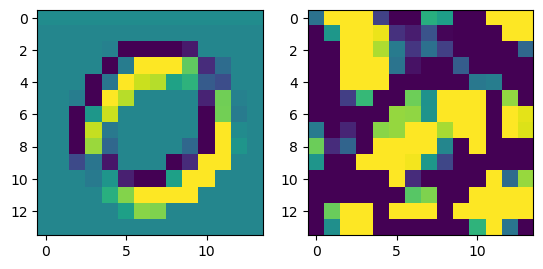

prediction: tensor([0, 6, 7]), tensor([5.5618, 0.9544, 0.9030]) groudtruth: 0
-0.102151394 0.117096774


<Figure size 640x480 with 0 Axes>

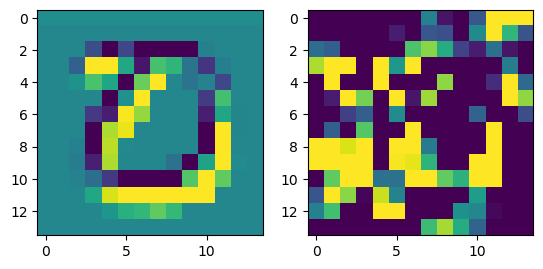

prediction: tensor([1, 7, 9]), tensor([4.5893, 1.3589, 0.7164]) groudtruth: 1
-0.07327354 0.0792418


<Figure size 640x480 with 0 Axes>

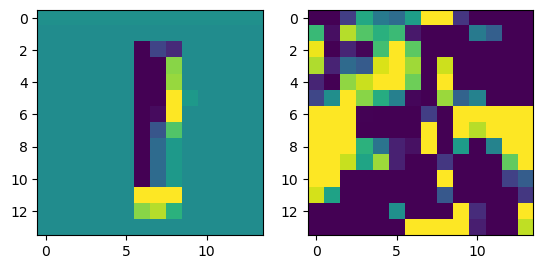

prediction: tensor([1, 7, 9]), tensor([5.0962, 0.8159, 0.7786]) groudtruth: 1
-0.073976696 0.07982093


<Figure size 640x480 with 0 Axes>

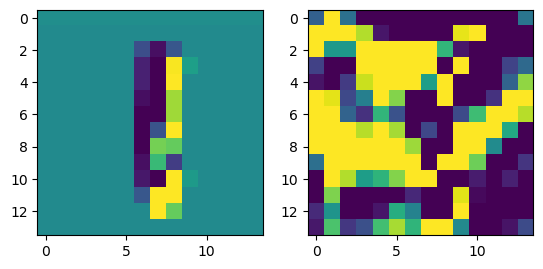

prediction: tensor([6, 8, 2]), tensor([4.0008, 1.7775, 0.1825]) groudtruth: 6
-0.082338214 0.06909937


<Figure size 640x480 with 0 Axes>

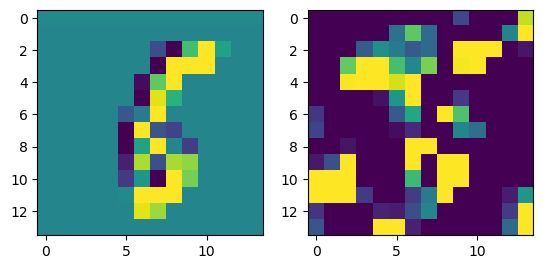

prediction: tensor([2, 1, 0]), tensor([3.5516, 2.0332, 1.8291]) groudtruth: 2
-0.08137375 0.1055637


<Figure size 640x480 with 0 Axes>

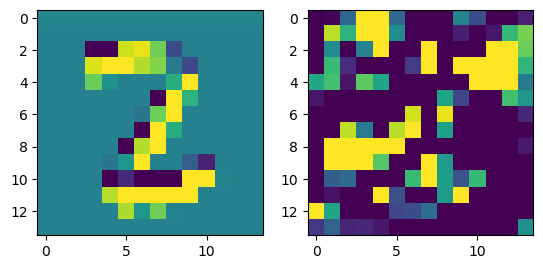

prediction: tensor([1, 8, 7]), tensor([6.2334, 2.0237, 0.8435]) groudtruth: 1
-0.060127735 0.086304456


<Figure size 640x480 with 0 Axes>

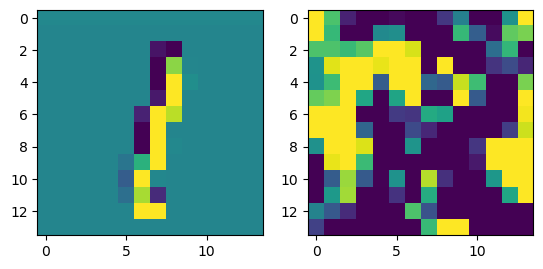

prediction: tensor([9, 4, 7]), tensor([4.6307, 2.0546, 0.1793]) groudtruth: 9
-0.11418003 0.07283427


<Figure size 640x480 with 0 Axes>

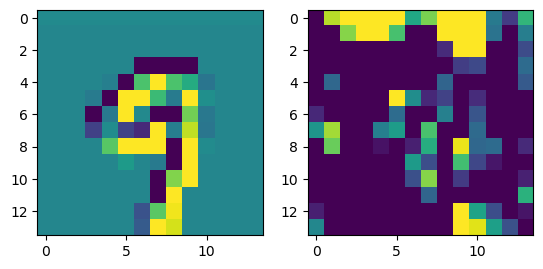

prediction: tensor([8, 7, 3]), tensor([5.1029, 0.7090, 0.1467]) groudtruth: 8
-0.08687776 0.08186585


<Figure size 640x480 with 0 Axes>

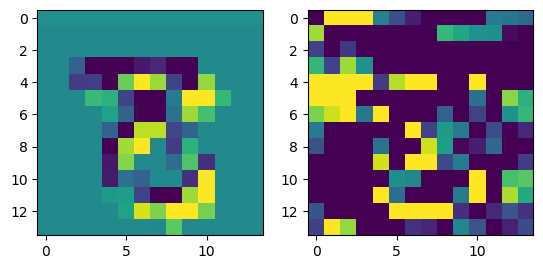

prediction: tensor([4, 6, 2]), tensor([6.1065, 1.0096, 0.6225]) groudtruth: 4
-0.086654484 0.10664352


<Figure size 640x480 with 0 Axes>

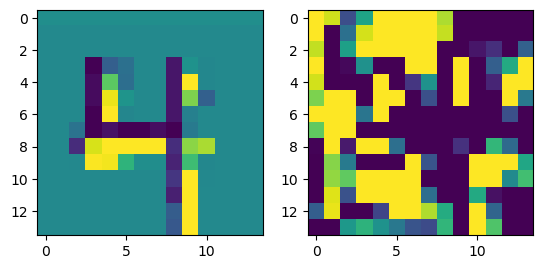

prediction: tensor([0, 1, 9]), tensor([4.5511, 2.7113, 2.6641]) groudtruth: 0
-0.08666885 0.119797155


<Figure size 640x480 with 0 Axes>

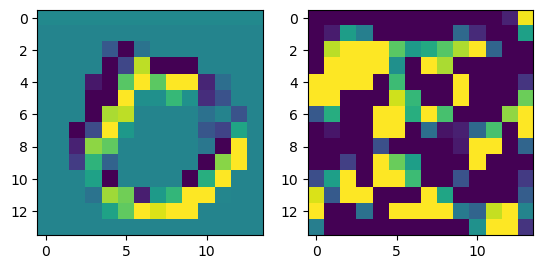

prediction: tensor([8, 4, 5]), tensor([2.0798, 1.8633, 1.0515]) groudtruth: 3
-0.10504681 0.10604842


<Figure size 640x480 with 0 Axes>

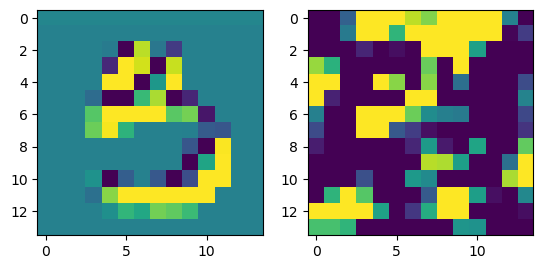

prediction: tensor([6, 7, 2]), tensor([3.8844, 2.6341, 1.9207]) groudtruth: 6
-0.09887844 0.07809748


<Figure size 640x480 with 0 Axes>

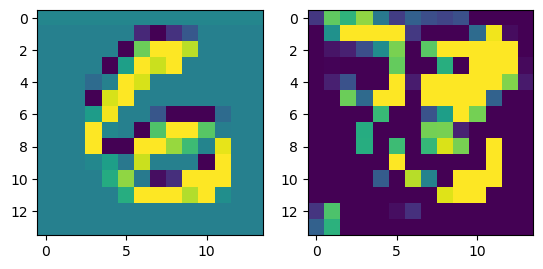

prediction: tensor([4, 1, 9]), tensor([4.2847, 3.1988, 1.1895]) groudtruth: 4
-0.07444596 0.063162774


<Figure size 640x480 with 0 Axes>

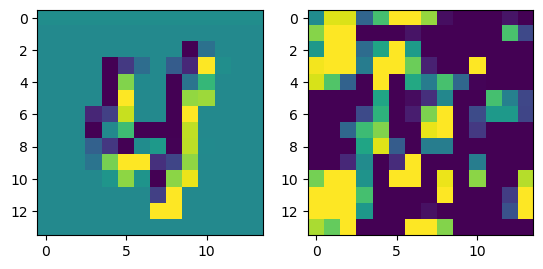

prediction: tensor([5, 9, 7]), tensor([2.5116, 2.5097, 1.7282]) groudtruth: 9
-0.07213873 0.11670273


<Figure size 640x480 with 0 Axes>

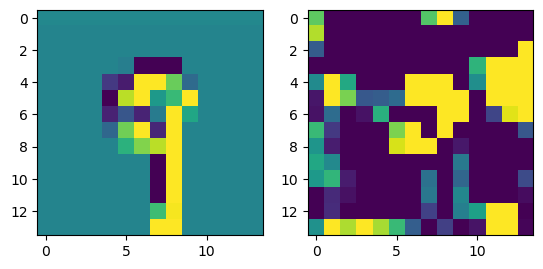

prediction: tensor([8, 4, 9]), tensor([5.0503, 2.8807, 2.7368]) groudtruth: 8
-0.08707309 0.10933639


<Figure size 640x480 with 0 Axes>

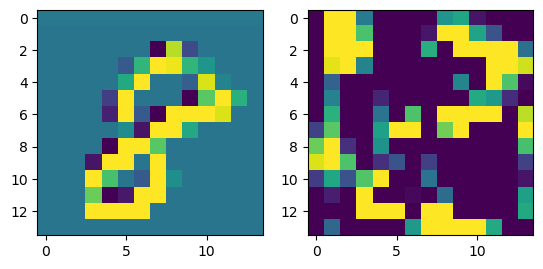

prediction: tensor([3, 2, 0]), tensor([3.7756, 1.0496, 0.9757]) groudtruth: 3
-0.07776773 0.08885982


<Figure size 640x480 with 0 Axes>

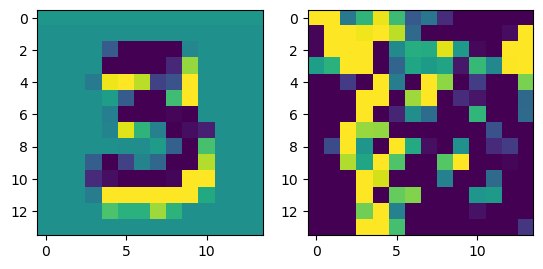

prediction: tensor([9, 2, 7]), tensor([2.8002, 2.3041, 0.7489]) groudtruth: 2
-0.071983695 0.06712304


<Figure size 640x480 with 0 Axes>

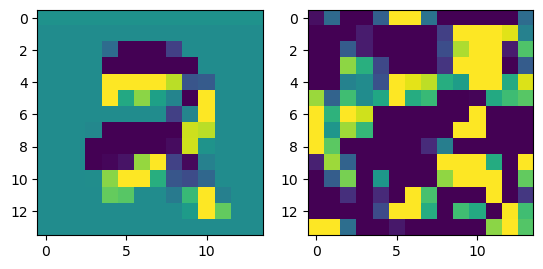

prediction: tensor([7, 9, 2]), tensor([6.0673, 2.0908, 1.6962]) groudtruth: 7
-0.07576376 0.070939854


<Figure size 640x480 with 0 Axes>

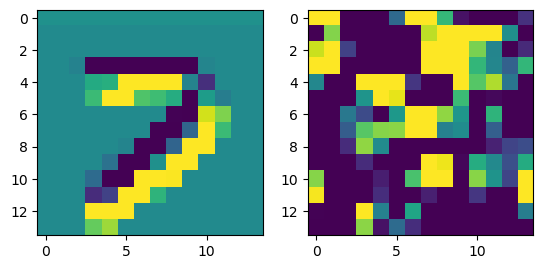

prediction: tensor([2, 9, 8]), tensor([2.8442, 1.8599, 1.4101]) groudtruth: 2
-0.111353636 0.10570924


<Figure size 640x480 with 0 Axes>

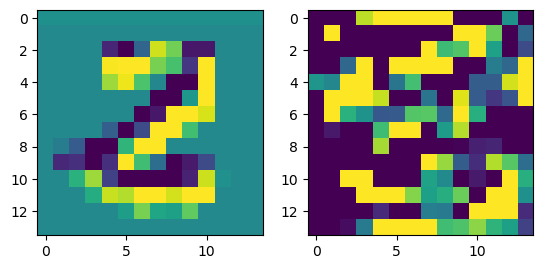

prediction: tensor([9, 1, 7]), tensor([2.8512, 1.5820, 0.8078]) groudtruth: 9
-0.10139626 0.10601597


<Figure size 640x480 with 0 Axes>

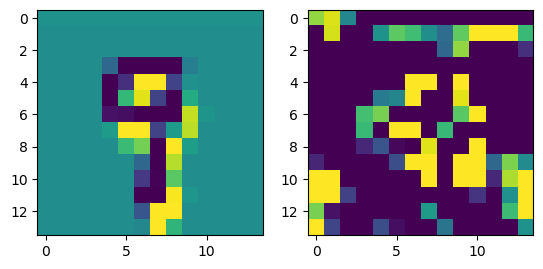

prediction: tensor([7, 9, 6]), tensor([5.4019, 1.9337, 0.8900]) groudtruth: 7
-0.09547436 0.078342095


<Figure size 640x480 with 0 Axes>

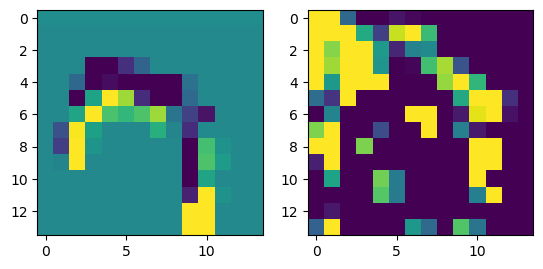

prediction: tensor([2, 4, 3]), tensor([4.0512, 2.9992, 0.9223]) groudtruth: 2
-0.10704738 0.08144288


<Figure size 640x480 with 0 Axes>

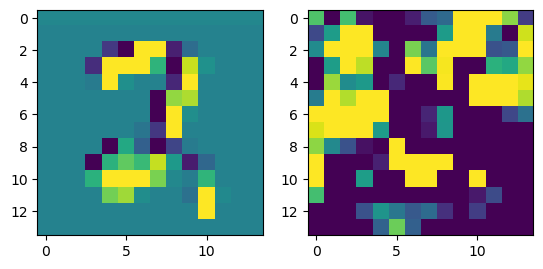

prediction: tensor([1, 7, 4]), tensor([3.8637, 3.1596, 1.0008]) groudtruth: 1
-0.078936994 0.07470833


<Figure size 640x480 with 0 Axes>

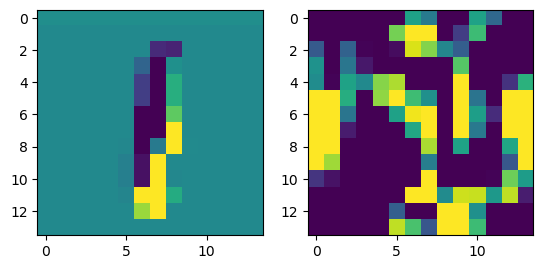

prediction: tensor([1, 6, 7]), tensor([5.9395, 0.6698, 0.6657]) groudtruth: 1
-0.07868338 0.09534071


<Figure size 640x480 with 0 Axes>

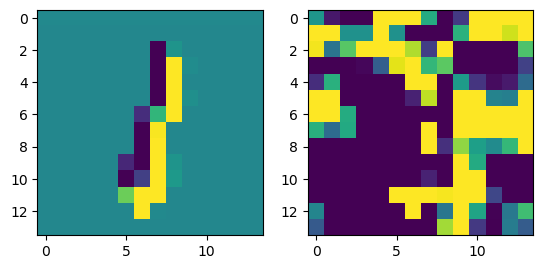

prediction: tensor([8, 3, 9]), tensor([2.5584, 2.1636, 1.7355]) groudtruth: 3
-0.07950598 0.071125746


<Figure size 640x480 with 0 Axes>

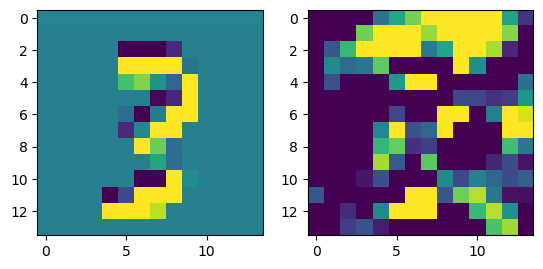

prediction: tensor([7, 3, 8]), tensor([3.1585, 2.5718, 1.8382]) groudtruth: 7
-0.08089274 0.077836715


<Figure size 640x480 with 0 Axes>

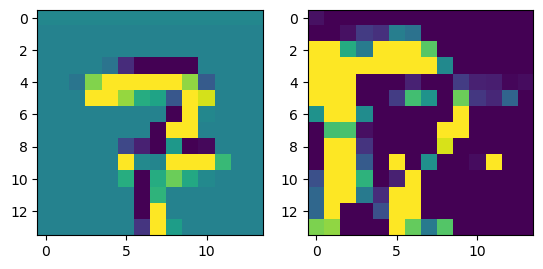

prediction: tensor([5, 3, 7]), tensor([7.3987, 2.2275, 0.8543]) groudtruth: 5
-0.07615638 0.09496026


<Figure size 640x480 with 0 Axes>

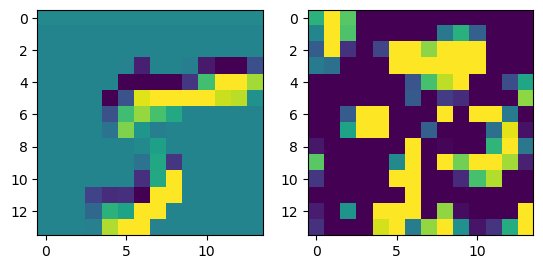

prediction: tensor([3, 1, 5]), tensor([3.4981, 2.4017, 1.0628]) groudtruth: 3
-0.093114614 0.08694504


<Figure size 640x480 with 0 Axes>

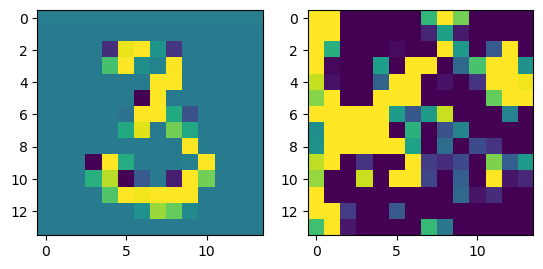

prediction: tensor([1, 7, 4]), tensor([5.4086, 2.5382, 0.5525]) groudtruth: 1
-0.07171708 0.06876674


<Figure size 640x480 with 0 Axes>

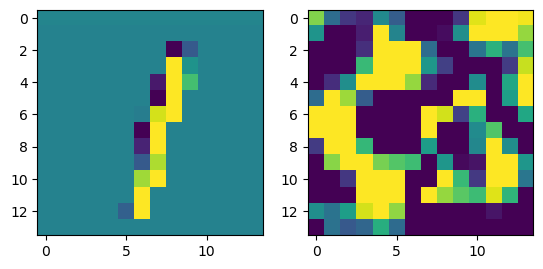

prediction: tensor([3, 4, 9]), tensor([2.5237, 2.0855, 1.7392]) groudtruth: 9
-0.07333428 0.062540166


<Figure size 640x480 with 0 Axes>

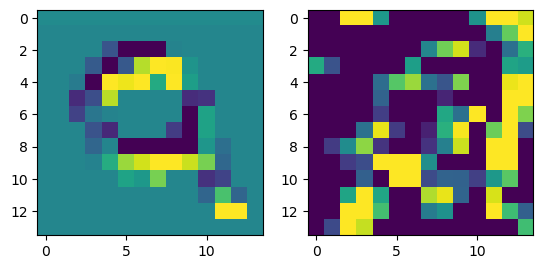

prediction: tensor([2, 7, 6]), tensor([1.9150, 1.4705, 1.4378]) groudtruth: 6
-0.091322064 0.08540076


<Figure size 640x480 with 0 Axes>

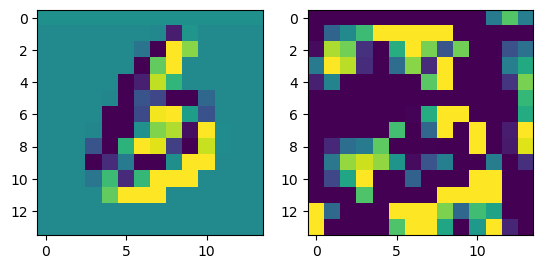

prediction: tensor([2, 9, 6]), tensor([3.5885, 1.0156, 0.2214]) groudtruth: 2
-0.087225854 0.06645289


<Figure size 640x480 with 0 Axes>

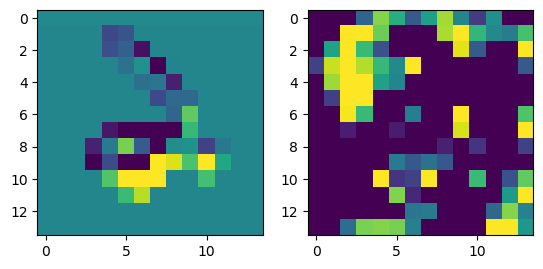

prediction: tensor([3, 7, 9]), tensor([5.1587, 3.9559, 1.8718]) groudtruth: 3
-0.06905055 0.078640684


<Figure size 640x480 with 0 Axes>

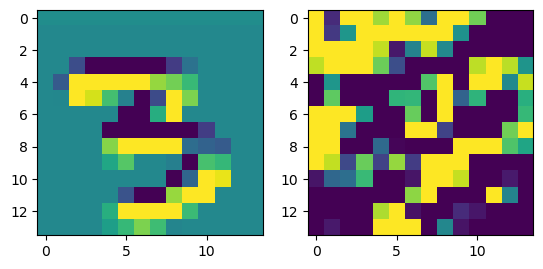

prediction: tensor([0, 9, 5]), tensor([3.7473, 1.7786, 1.4855]) groudtruth: 9
-0.080133915 0.094069086


<Figure size 640x480 with 0 Axes>

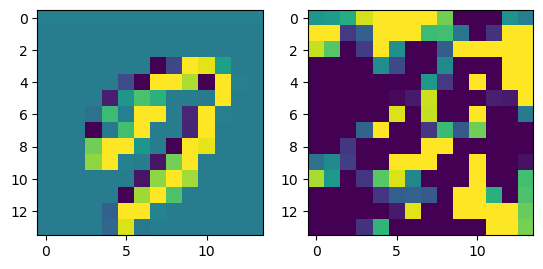

prediction: tensor([3, 4, 9]), tensor([4.5118, 1.7649, 0.7702]) groudtruth: 3
-0.08019692 0.099134535


<Figure size 640x480 with 0 Axes>

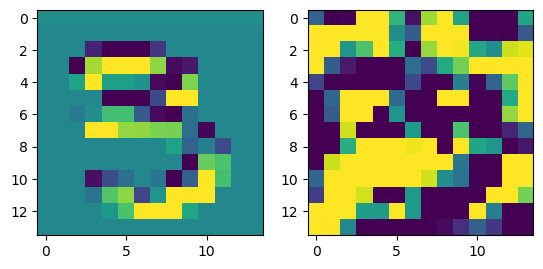

prediction: tensor([8, 2, 0]), tensor([5.4856, 1.5329, 1.3845]) groudtruth: 8
-0.07700348 0.0847796


<Figure size 640x480 with 0 Axes>

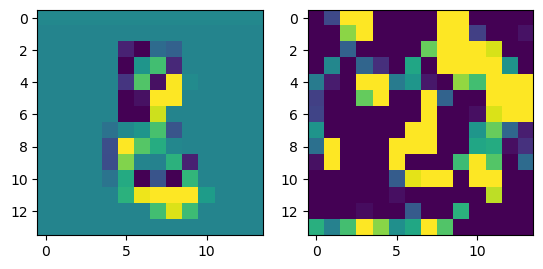

prediction: tensor([0, 8, 2]), tensor([4.0985, 3.6106, 0.0077]) groudtruth: 0
-0.06915444 0.098167


<Figure size 640x480 with 0 Axes>

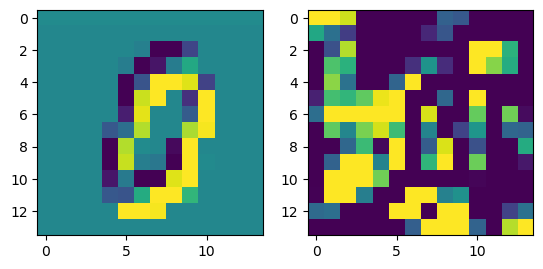

prediction: tensor([2, 9, 8]), tensor([3.8685, 1.7840, 1.5546]) groudtruth: 2
-0.0948149 0.10323819


<Figure size 640x480 with 0 Axes>

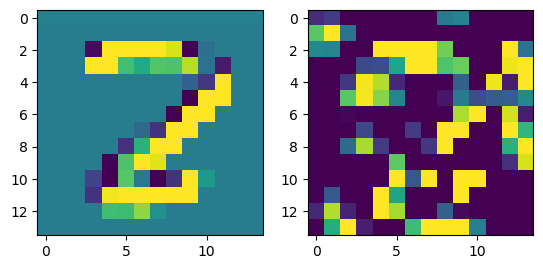

prediction: tensor([1, 6, 9]), tensor([5.0866, 0.9786, 0.8480]) groudtruth: 1
-0.063298404 0.109999105


<Figure size 640x480 with 0 Axes>

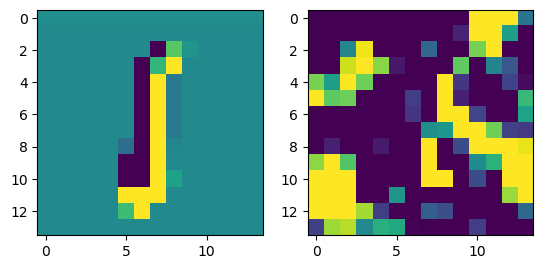

prediction: tensor([1, 7, 9]), tensor([3.7197, 2.2108, 0.9935]) groudtruth: 1
-0.07357836 0.07689272


<Figure size 640x480 with 0 Axes>

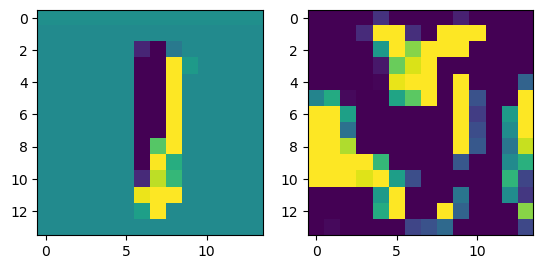

prediction: tensor([1, 3, 5]), tensor([5.0150, 1.7545, 1.1681]) groudtruth: 1
-0.0652532 0.104623914


<Figure size 640x480 with 0 Axes>

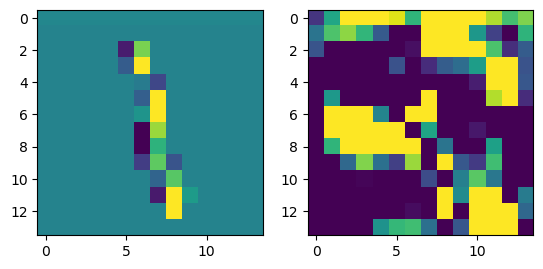

prediction: tensor([1, 8, 3]), tensor([5.3846, 1.7087, 0.6660]) groudtruth: 1
-0.07545626 0.068880185


<Figure size 640x480 with 0 Axes>

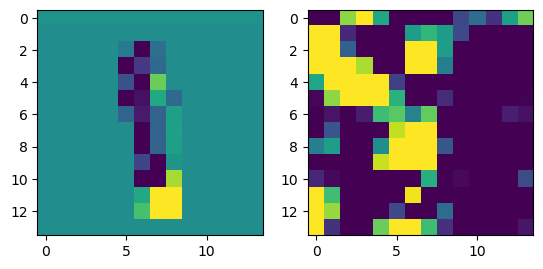

prediction: tensor([4, 2, 8]), tensor([2.4021, 0.9505, 0.9363]) groudtruth: 4
-0.09194845 0.07525701


<Figure size 640x480 with 0 Axes>

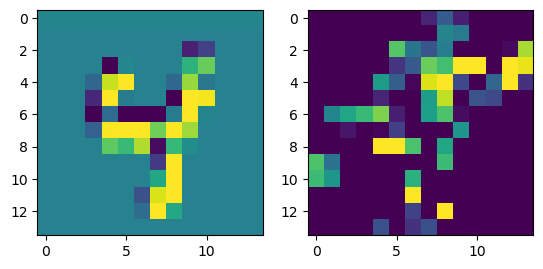

prediction: tensor([2, 6, 8]), tensor([5.7415, 1.1445, 0.7369]) groudtruth: 2
-0.075220644 0.07031098


<Figure size 640x480 with 0 Axes>

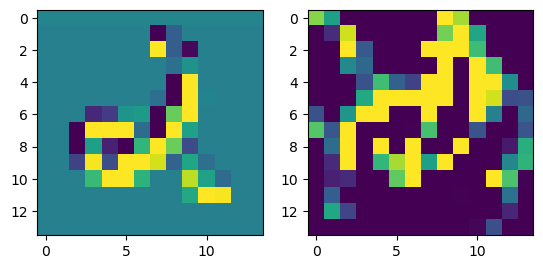

prediction: tensor([9, 1, 3]), tensor([3.3967, 1.2150, 0.6944]) groudtruth: 9
-0.09486908 0.11183995


<Figure size 640x480 with 0 Axes>

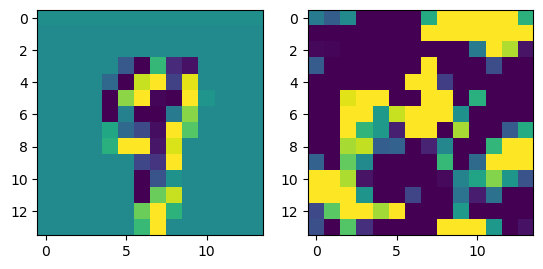

prediction: tensor([7, 9, 6]), tensor([3.4096, 1.2734, 0.9188]) groudtruth: 7
-0.08713734 0.09296116


<Figure size 640x480 with 0 Axes>

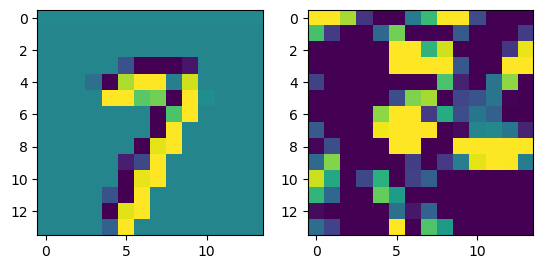

prediction: tensor([7, 9, 8]), tensor([3.9189, 3.6754, 2.1715]) groudtruth: 9
-0.079891086 0.06110788


<Figure size 640x480 with 0 Axes>

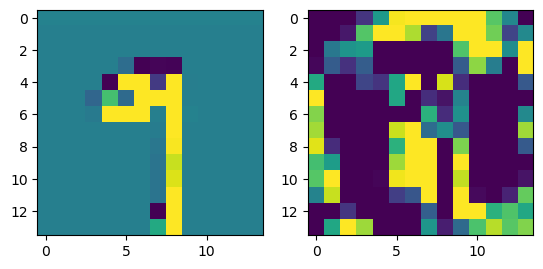

prediction: tensor([2, 7, 3]), tensor([2.9969, 2.4038, 1.4420]) groudtruth: 7
-0.093447626 0.085114196


<Figure size 640x480 with 0 Axes>

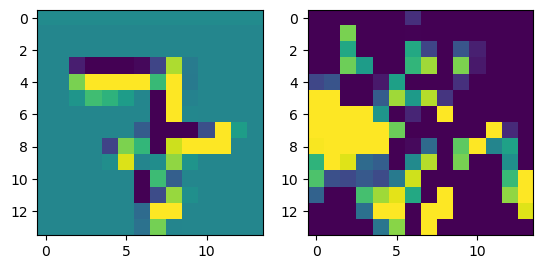

prediction: tensor([5, 7, 9]), tensor([5.6561, 2.3744, 0.8786]) groudtruth: 5
-0.09796566 0.09570488


<Figure size 640x480 with 0 Axes>

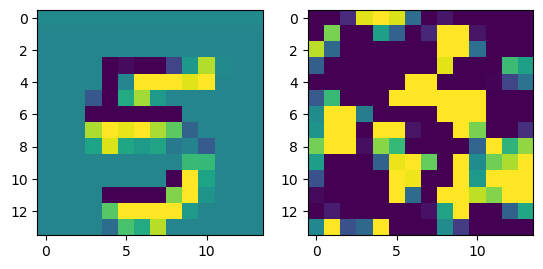

prediction: tensor([0, 8, 9]), tensor([5.5492, 0.6947, 0.6710]) groudtruth: 0
-0.05775577 0.06256297


<Figure size 640x480 with 0 Axes>

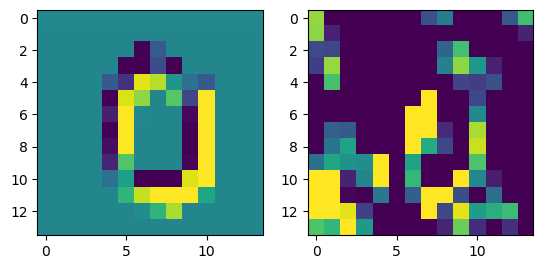

prediction: tensor([3, 7, 9]), tensor([3.6633, 2.1171, 1.5561]) groudtruth: 7
-0.0877915 0.08327863


<Figure size 640x480 with 0 Axes>

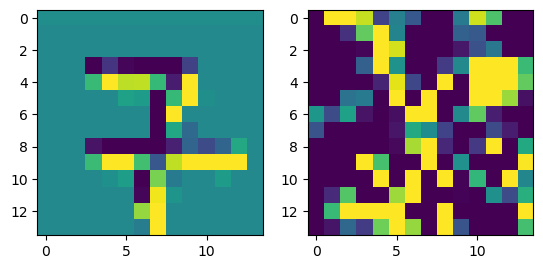

prediction: tensor([7, 4, 6]), tensor([3.9516, 2.8864, 1.0316]) groudtruth: 4
-0.104405224 0.08800055


<Figure size 640x480 with 0 Axes>

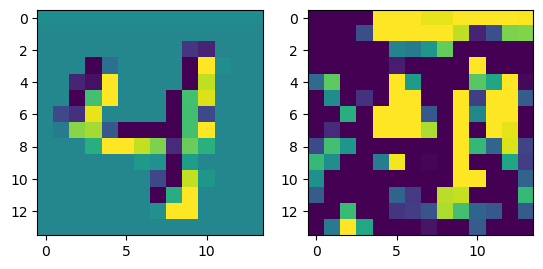

prediction: tensor([6, 8, 0]), tensor([3.0107, 2.4450, 1.8636]) groudtruth: 8
-0.07915717 0.09362553


<Figure size 640x480 with 0 Axes>

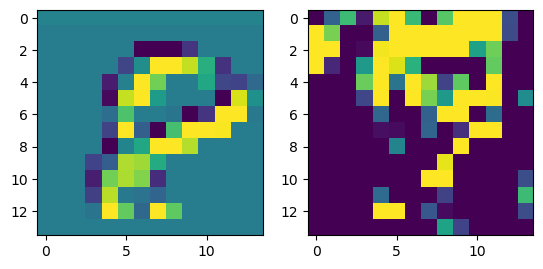

prediction: tensor([8, 5, 9]), tensor([7.8905, 3.1633, 1.8111]) groudtruth: 8
-0.063869655 0.055762015


<Figure size 640x480 with 0 Axes>

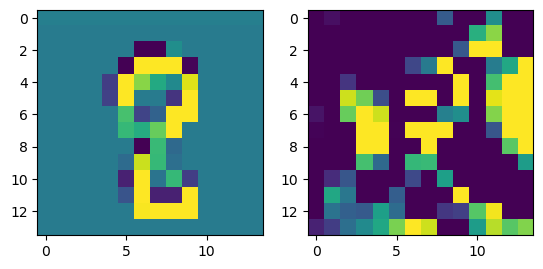

prediction: tensor([1, 6, 5]), tensor([3.8299, 3.5969, 0.7316]) groudtruth: 1
-0.0731073 0.08340934


<Figure size 640x480 with 0 Axes>

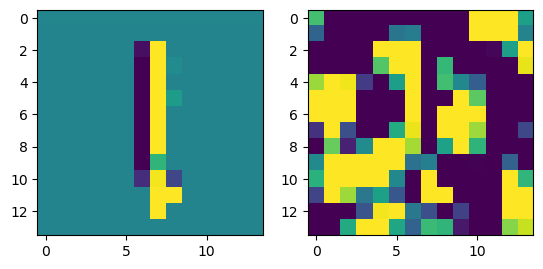

prediction: tensor([5, 6, 9]), tensor([7.4433, 1.2485, 0.8684]) groudtruth: 5
-0.093129754 0.09949258


<Figure size 640x480 with 0 Axes>

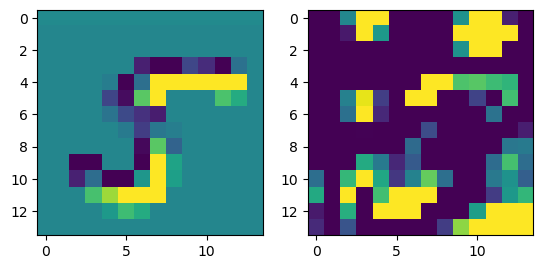

prediction: tensor([3, 2, 9]), tensor([5.5175, 2.1200, 1.4092]) groudtruth: 3
-0.13282031 0.12591448


<Figure size 640x480 with 0 Axes>

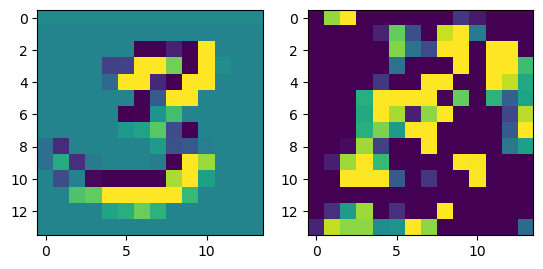

prediction: tensor([9, 4, 3]), tensor([2.3811, 1.0473, 0.9950]) groudtruth: 9
-0.086787224 0.08921879


<Figure size 640x480 with 0 Axes>

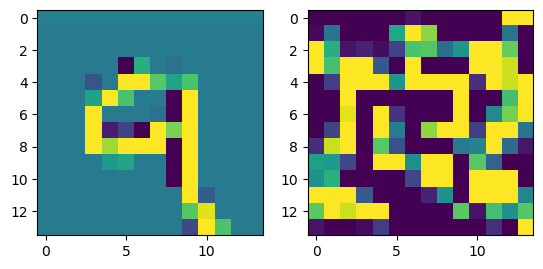

prediction: tensor([5, 3, 6]), tensor([4.4369, 2.1500, 1.2071]) groudtruth: 5
-0.06950939 0.11701045


<Figure size 640x480 with 0 Axes>

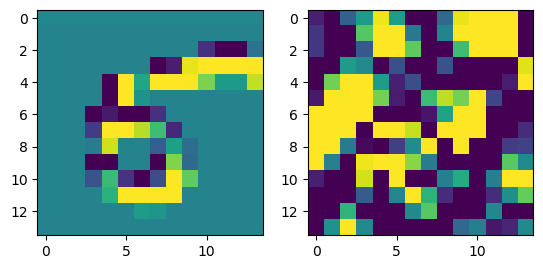

prediction: tensor([9, 7, 4]), tensor([5.7461, 2.7494, 2.4981]) groudtruth: 9
-0.06848818 0.08629759


<Figure size 640x480 with 0 Axes>

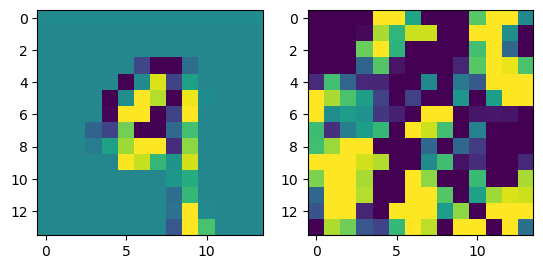

prediction: tensor([3, 9, 5]), tensor([2.8868, 1.6616, 1.5897]) groudtruth: 7
-0.09520209 0.13629419


<Figure size 640x480 with 0 Axes>

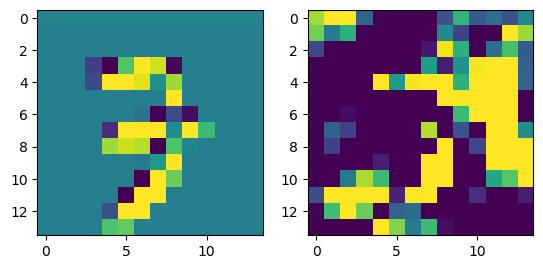

prediction: tensor([6, 5, 0]), tensor([4.1062, 2.0948, 1.7369]) groudtruth: 6
-0.07326096 0.07762951


<Figure size 640x480 with 0 Axes>

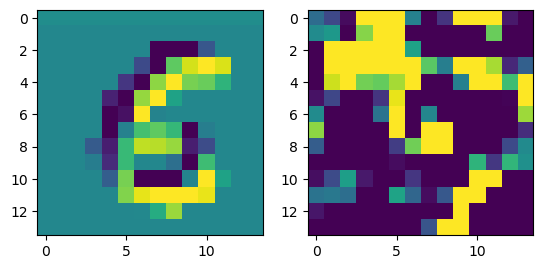

prediction: tensor([3, 7, 0]), tensor([7.9310, 2.4221, 1.5174]) groudtruth: 3
-0.0915457 0.112294555


<Figure size 640x480 with 0 Axes>

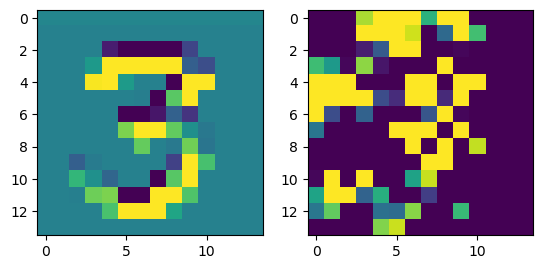

prediction: tensor([1, 7, 9]), tensor([2.2023, 1.9529, 1.7218]) groudtruth: 2
-0.075998306 0.09117065


<Figure size 640x480 with 0 Axes>

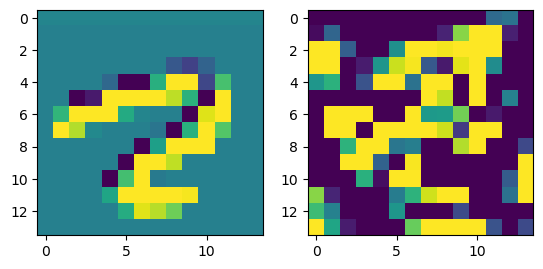

prediction: tensor([6, 8, 5]), tensor([3.2093, 1.7953, 0.9760]) groudtruth: 8
-0.07914734 0.09522617


<Figure size 640x480 with 0 Axes>

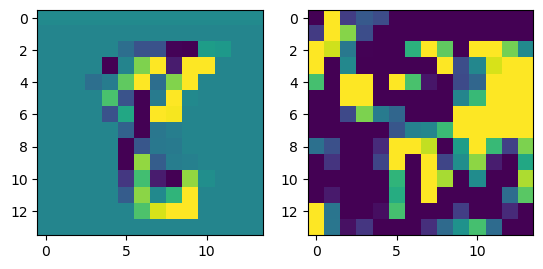

prediction: tensor([3, 4, 5]), tensor([3.4270, 2.7870, 2.0473]) groudtruth: 4
-0.10154492 0.108878806


<Figure size 640x480 with 0 Axes>

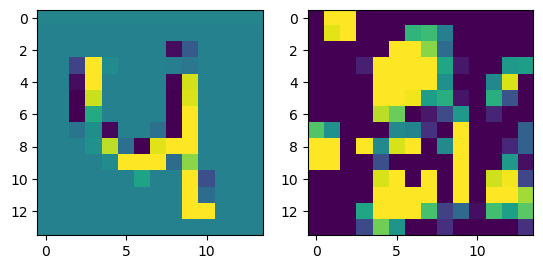

prediction: tensor([1, 6, 8]), tensor([4.4666, 2.2947, 0.7976]) groudtruth: 1
-0.090976596 0.08139934


<Figure size 640x480 with 0 Axes>

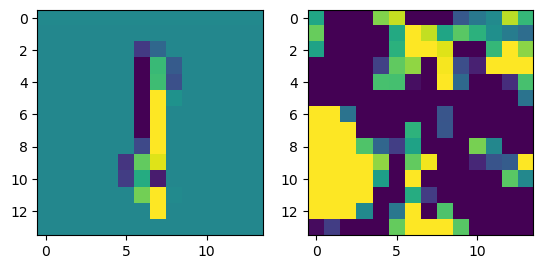

prediction: tensor([9, 4, 1]), tensor([2.5727, 2.2872, 2.0925]) groudtruth: 9
-0.07545084 0.06470081


<Figure size 640x480 with 0 Axes>

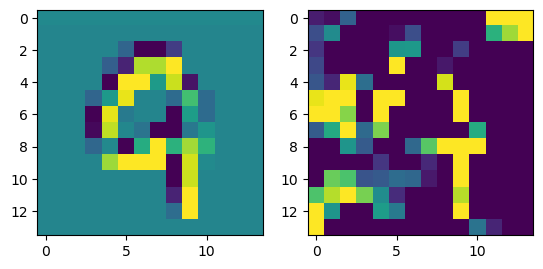

prediction: tensor([9, 0, 4]), tensor([5.0866, 1.2402, 0.9278]) groudtruth: 9
-0.062820196 0.11104642


<Figure size 640x480 with 0 Axes>

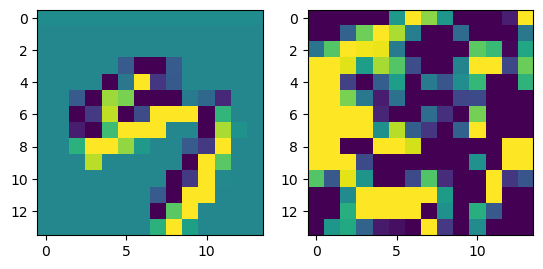

prediction: tensor([7, 0, 9]), tensor([3.9103, 1.1380, 0.0158]) groudtruth: 7
-0.08864796 0.096174076


<Figure size 640x480 with 0 Axes>

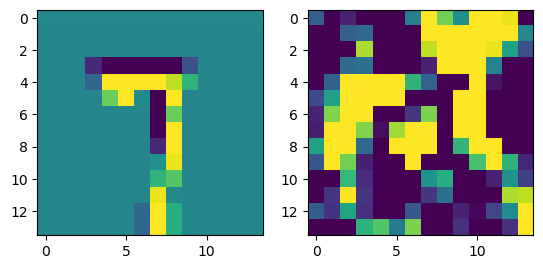

prediction: tensor([2, 6, 7]), tensor([4.9524, 1.4004, 1.2341]) groudtruth: 2
-0.09346801 0.08311775


<Figure size 640x480 with 0 Axes>

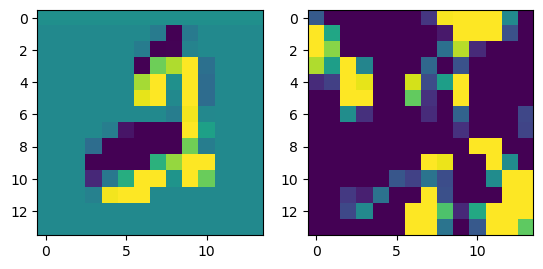

prediction: tensor([7, 1, 8]), tensor([1.5689, 1.5171, 1.3017]) groudtruth: 7
-0.069000125 0.095428556


<Figure size 640x480 with 0 Axes>

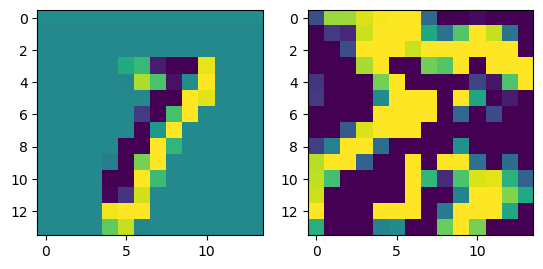

prediction: tensor([6, 3, 2]), tensor([2.4073, 2.3603, 1.5183]) groudtruth: 9
-0.071041465 0.07009546


<Figure size 640x480 with 0 Axes>

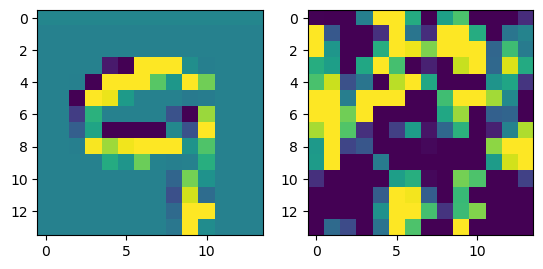

prediction: tensor([9, 7, 2]), tensor([3.8103, 3.4944, 0.9258]) groudtruth: 9
-0.10460073 0.08286004


<Figure size 640x480 with 0 Axes>

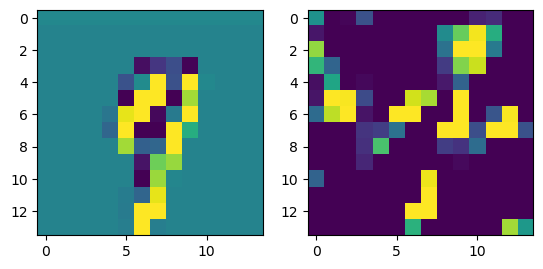

prediction: tensor([4, 8, 9]), tensor([3.4720, 2.4631, 2.4564]) groudtruth: 5
-0.07702166 0.06782916


<Figure size 640x480 with 0 Axes>

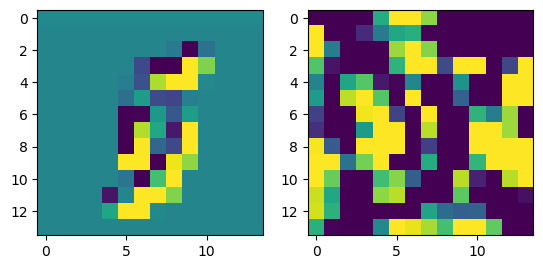

prediction: tensor([7, 9, 0]), tensor([2.1073, 1.5247, 0.4494]) groudtruth: 9
-0.080078065 0.08826356


<Figure size 640x480 with 0 Axes>

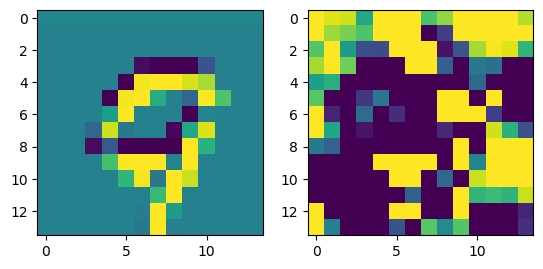

prediction: tensor([5, 8, 3]), tensor([3.0003, 2.2715, 1.2760]) groudtruth: 5
-0.104772925 0.077218875


<Figure size 640x480 with 0 Axes>

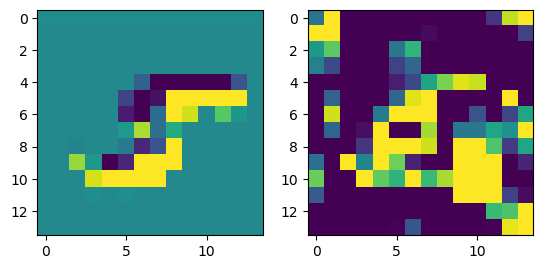

prediction: tensor([6, 1, 0]), tensor([3.2561, 2.9323, 0.9015]) groudtruth: 1
-0.07330233 0.07026385


<Figure size 640x480 with 0 Axes>

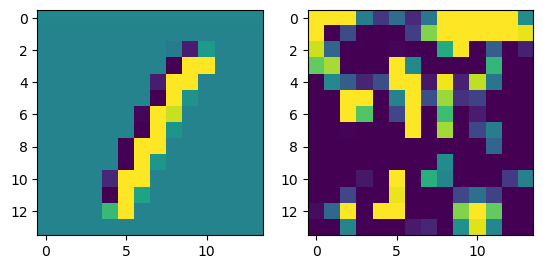

prediction: tensor([3, 9, 8]), tensor([4.5331, 3.1459, 2.4206]) groudtruth: 3
-0.085057735 0.098674975


<Figure size 640x480 with 0 Axes>

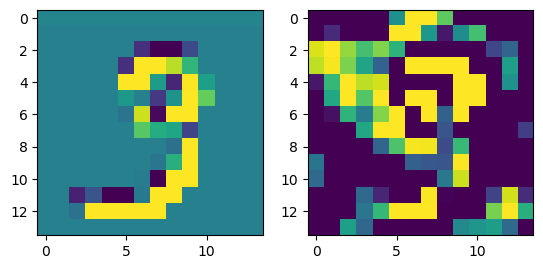

prediction: tensor([0, 5, 8]), tensor([3.3629, 0.9009, 0.8069]) groudtruth: 0
-0.11029631 0.09022337


<Figure size 640x480 with 0 Axes>

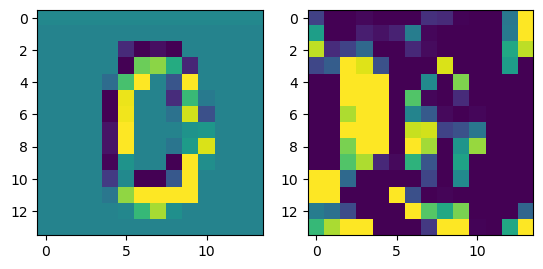

prediction: tensor([2, 9, 4]), tensor([4.3343, 1.4519, 0.9178]) groudtruth: 2
-0.085862815 0.09267093


<Figure size 640x480 with 0 Axes>

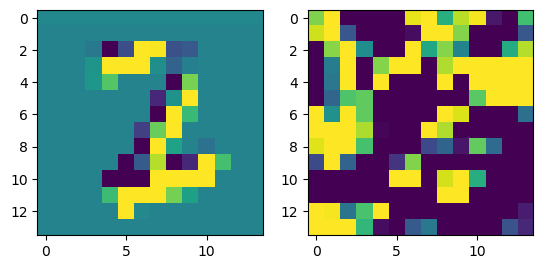

prediction: tensor([9, 7, 5]), tensor([3.0779, 2.8976, 2.3106]) groudtruth: 5
-0.077840686 0.09623573


<Figure size 640x480 with 0 Axes>

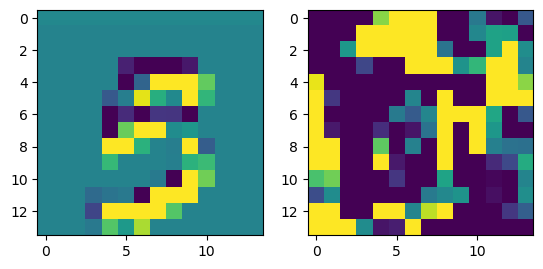

prediction: tensor([6, 5, 3]), tensor([1.7890, 1.3178, 0.9365]) groudtruth: 5
-0.08715469 0.05810661


<Figure size 640x480 with 0 Axes>

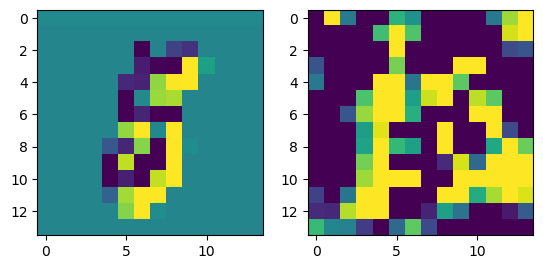

prediction: tensor([7, 8, 0]), tensor([3.7998, 1.9303, 1.4213]) groudtruth: 7
-0.092196465 0.074149415


<Figure size 640x480 with 0 Axes>

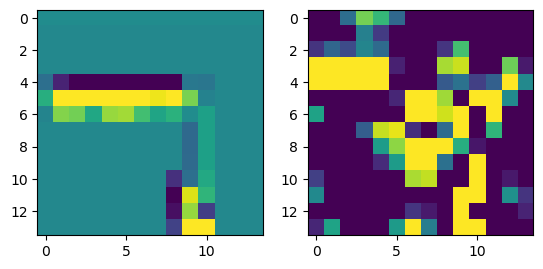

prediction: tensor([9, 7, 3]), tensor([4.5214, 2.6515, 1.1719]) groudtruth: 9
-0.10222995 0.08880894


<Figure size 640x480 with 0 Axes>

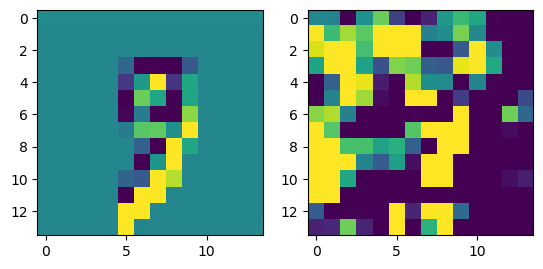

prediction: tensor([5, 8, 9]), tensor([4.0809, 2.3993, 2.2169]) groudtruth: 5
-0.1111604 0.06681774


<Figure size 640x480 with 0 Axes>

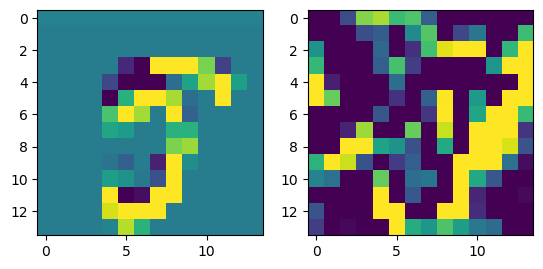

prediction: tensor([3, 5, 7]), tensor([1.8906, 1.8764, 1.2478]) groudtruth: 5
-0.09529132 0.115920655


<Figure size 640x480 with 0 Axes>

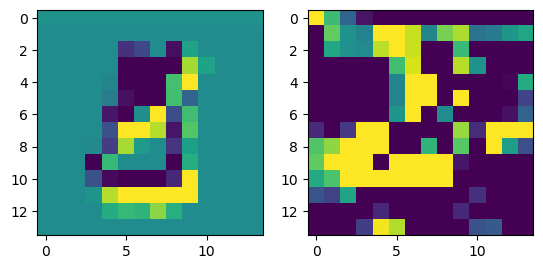

prediction: tensor([0, 9, 8]), tensor([2.9243, 0.7838, 0.1603]) groudtruth: 0
-0.079085946 0.07489848


<Figure size 640x480 with 0 Axes>

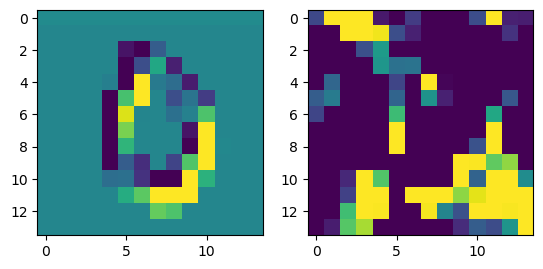

prediction: tensor([8, 3, 1]), tensor([5.1668, 1.6725, 1.0452]) groudtruth: 8
-0.085895896 0.059014197


<Figure size 640x480 with 0 Axes>

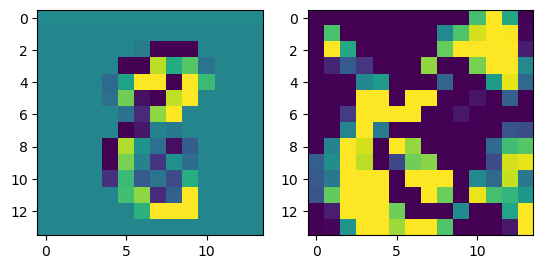

prediction: tensor([9, 5, 2]), tensor([4.8934, 1.8177, 1.6748]) groudtruth: 9
-0.08744526 0.09562356


<Figure size 640x480 with 0 Axes>

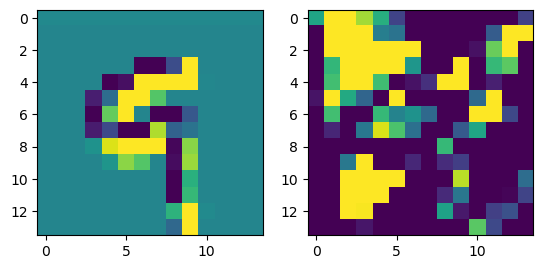

prediction: tensor([5, 3, 8]), tensor([3.9819, 2.4131, 0.8279]) groudtruth: 5
-0.11249906 0.095304236


<Figure size 640x480 with 0 Axes>

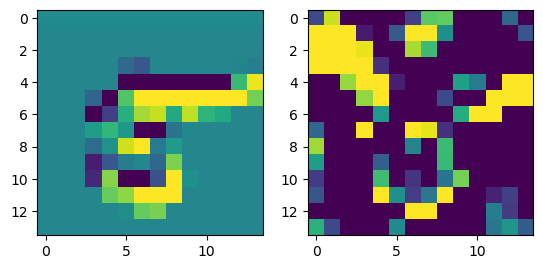

prediction: tensor([0, 8, 6]), tensor([5.5567, 2.2497, 1.1435]) groudtruth: 0
-0.08674759 0.08568151


<Figure size 640x480 with 0 Axes>

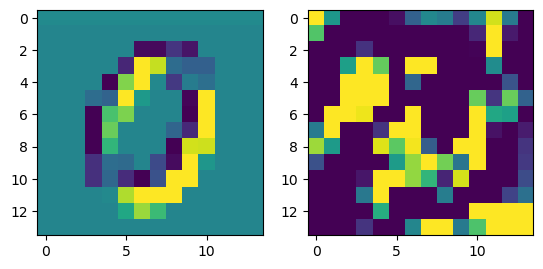

prediction: tensor([3, 0, 8]), tensor([5.9196, 2.3048, 1.7357]) groudtruth: 3
-0.08908391 0.092046544


<Figure size 640x480 with 0 Axes>

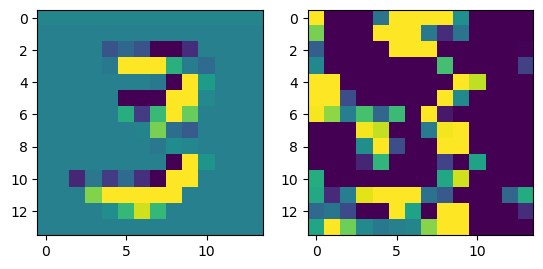

prediction: tensor([2, 6, 0]), tensor([6.0522, 1.9450, 1.4400]) groudtruth: 2
-0.06972337 0.057062257


<Figure size 640x480 with 0 Axes>

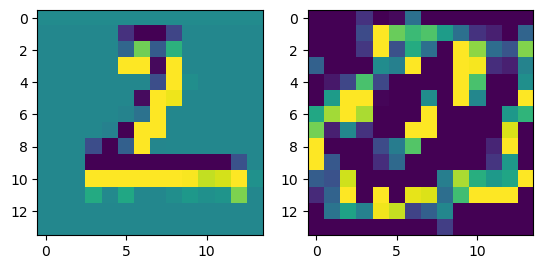

prediction: tensor([6, 0, 8]), tensor([7.2647, 2.5146, 1.0553]) groudtruth: 6
-0.101546764 0.09039704


<Figure size 640x480 with 0 Axes>

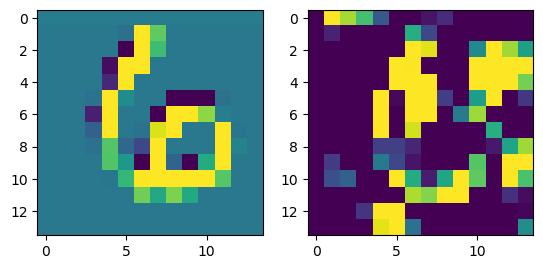

prediction: tensor([9, 2, 7]), tensor([3.5793, 2.7946, 1.0484]) groudtruth: 9
-0.086839914 0.06365535


<Figure size 640x480 with 0 Axes>

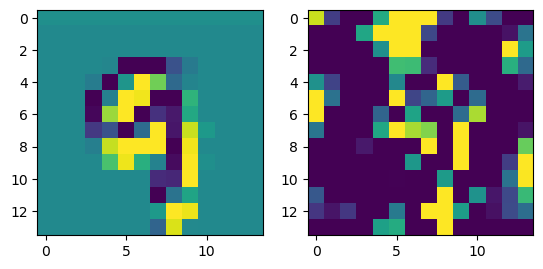

prediction: tensor([2, 9, 3]), tensor([4.1457, 2.4468, 2.1394]) groudtruth: 2
-0.10794312 0.086074024


<Figure size 640x480 with 0 Axes>

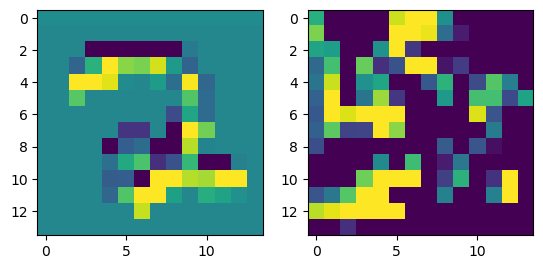

prediction: tensor([8, 4, 3]), tensor([3.9649, 2.3159, 1.3816]) groudtruth: 8
-0.066123545 0.08409786


<Figure size 640x480 with 0 Axes>

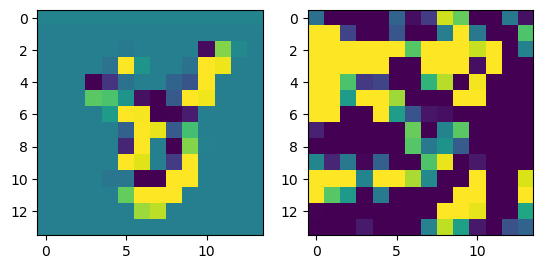

prediction: tensor([5, 9, 3]), tensor([5.7496, 2.0939, 1.9211]) groudtruth: 5
-0.11983627 0.08401657


<Figure size 640x480 with 0 Axes>

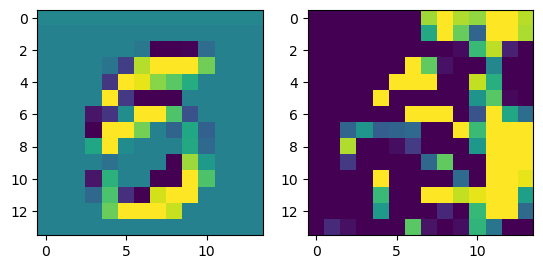

prediction: tensor([4, 3, 5]), tensor([4.9951, 3.0833, 1.8332]) groudtruth: 4
-0.083646536 0.107502334


<Figure size 640x480 with 0 Axes>

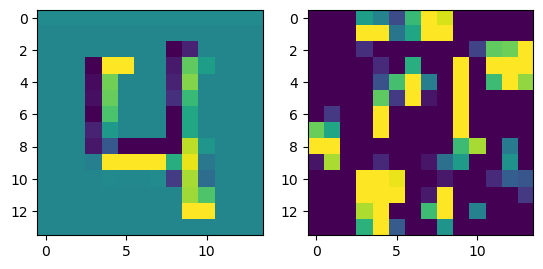

prediction: tensor([5, 6, 9]), tensor([2.7596, 1.8469, 1.3028]) groudtruth: 5
-0.07394844 0.101362586


<Figure size 640x480 with 0 Axes>

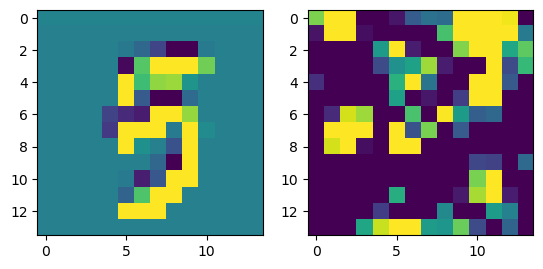

prediction: tensor([7, 3, 2]), tensor([3.5894, 1.1590, 0.3589]) groudtruth: 7
-0.0673452 0.06416837


<Figure size 640x480 with 0 Axes>

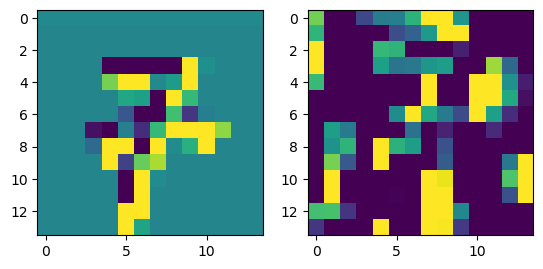

prediction: tensor([9, 2, 3]), tensor([2.3938, 1.0272, 0.8415]) groudtruth: 9
-0.09142214 0.08132781


<Figure size 640x480 with 0 Axes>

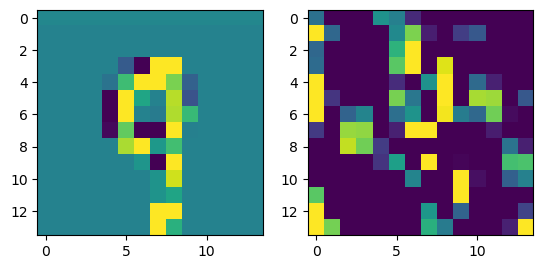

prediction: tensor([4, 9, 3]), tensor([2.7113, 2.4639, 1.6845]) groudtruth: 9
-0.07044643 0.08131209


<Figure size 640x480 with 0 Axes>

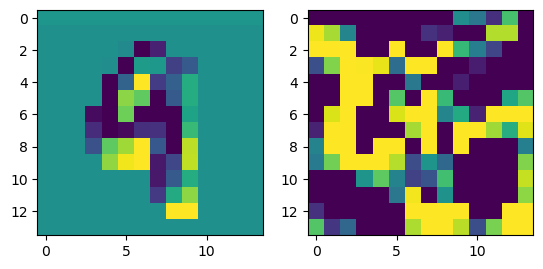

prediction: tensor([9, 0, 7]), tensor([3.3273, 2.3149, 0.4379]) groudtruth: 9
-0.07284373 0.09492443


<Figure size 640x480 with 0 Axes>

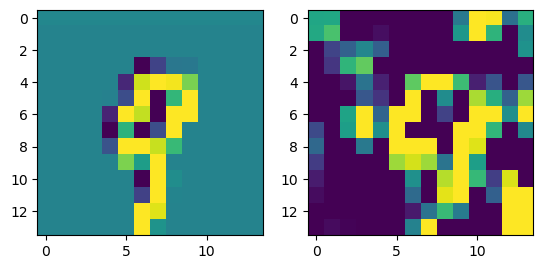

prediction: tensor([2, 8, 1]), tensor([3.1790, 1.0600, 0.6394]) groudtruth: 2
-0.07852268 0.096489295


<Figure size 640x480 with 0 Axes>

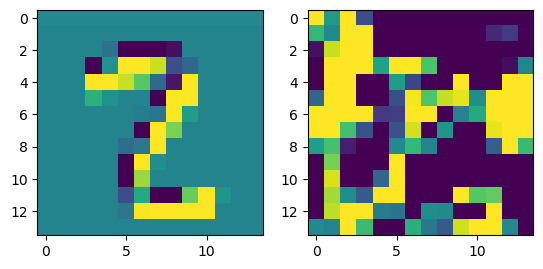

prediction: tensor([1, 8, 0]), tensor([5.0765, 2.1783, 2.1085]) groudtruth: 1
-0.094082355 0.11344348


<Figure size 640x480 with 0 Axes>

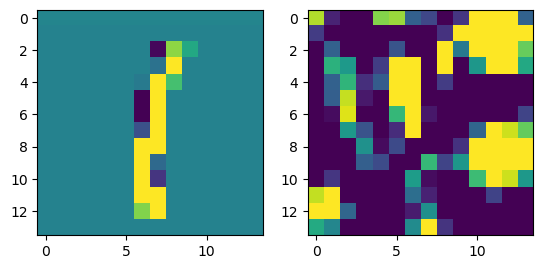

prediction: tensor([8, 7, 9]), tensor([4.0926, 2.3593, 2.0327]) groudtruth: 8
-0.06740576 0.08224796


<Figure size 640x480 with 0 Axes>

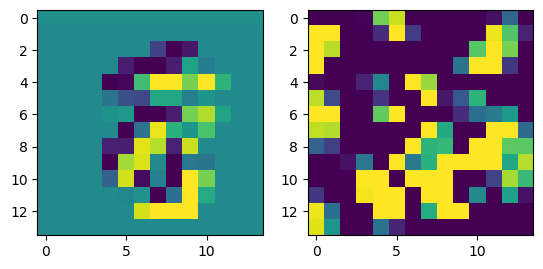

prediction: tensor([3, 1, 9]), tensor([4.4207, 1.7224, 0.8664]) groudtruth: 3
-0.08323586 0.0873153


<Figure size 640x480 with 0 Axes>

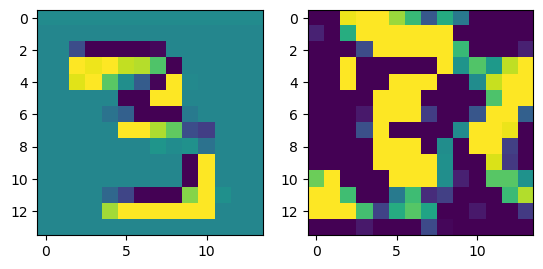

prediction: tensor([4, 3, 8]), tensor([3.0479, 1.4304, 1.1083]) groudtruth: 4
-0.09832394 0.078747556


<Figure size 640x480 with 0 Axes>

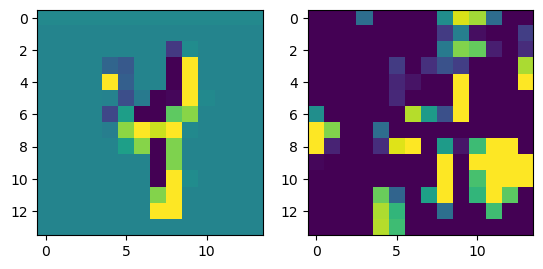

prediction: tensor([7, 9, 5]), tensor([3.9035, 2.7375, 1.2432]) groudtruth: 9
-0.105977654 0.095456965


<Figure size 640x480 with 0 Axes>

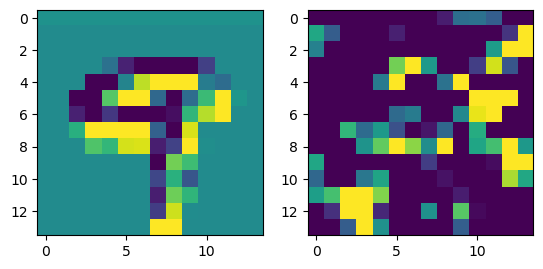

prediction: tensor([4, 5, 2]), tensor([4.0462, 1.9514, 0.8831]) groudtruth: 4
-0.08599353 0.09208192


<Figure size 640x480 with 0 Axes>

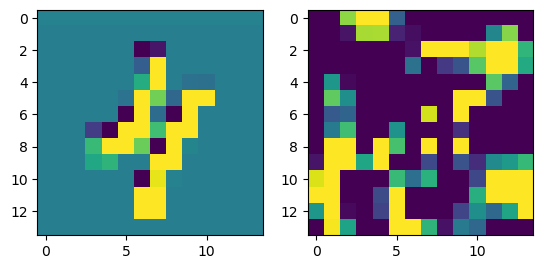

prediction: tensor([2, 3, 0]), tensor([3.2800, 3.2190, 2.7399]) groudtruth: 2
-0.110687554 0.112621695


<Figure size 640x480 with 0 Axes>

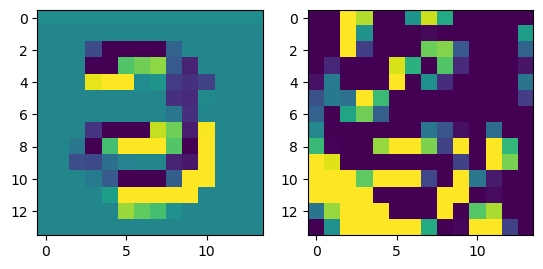

prediction: tensor([5, 4, 1]), tensor([2.7343, 2.4876, 2.1689]) groudtruth: 4
-0.0879997 0.08787258


<Figure size 640x480 with 0 Axes>

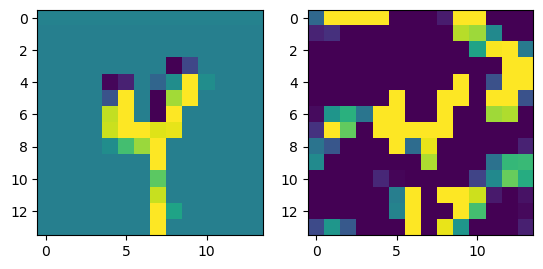

prediction: tensor([6, 5, 7]), tensor([4.3916, 2.6522, 0.9259]) groudtruth: 6
-0.07091951 0.09750557


<Figure size 640x480 with 0 Axes>

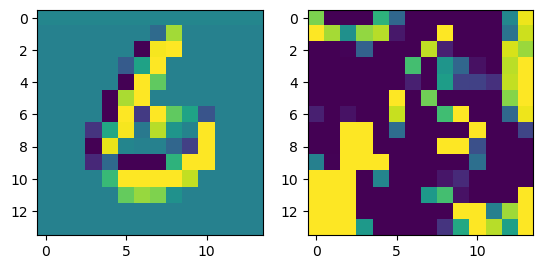

prediction: tensor([7, 3, 5]), tensor([4.9920, 2.3584, 1.3889]) groudtruth: 7
-0.0777033 0.10507323


<Figure size 640x480 with 0 Axes>

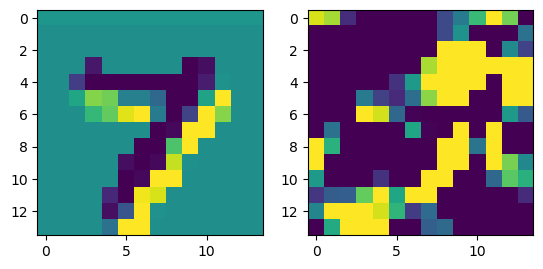

prediction: tensor([8, 5, 9]), tensor([3.1191, 2.7018, 2.4376]) groudtruth: 8
-0.119530976 0.112902954


<Figure size 640x480 with 0 Axes>

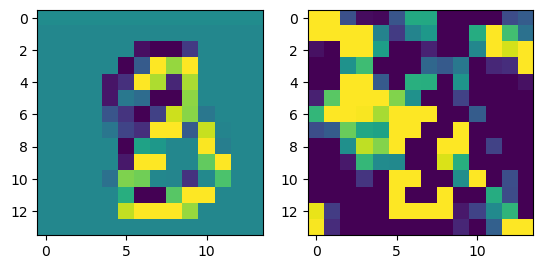

prediction: tensor([7, 3, 8]), tensor([3.5483, 1.1696, 0.6827]) groudtruth: 7
-0.078976154 0.09363121


<Figure size 640x480 with 0 Axes>

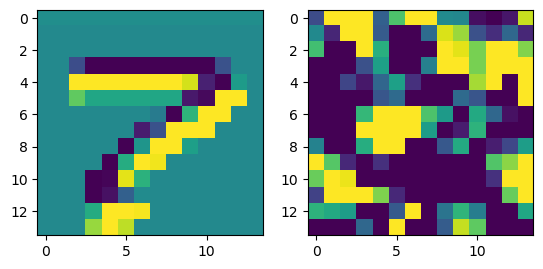

prediction: tensor([6, 2, 7]), tensor([3.6143, 1.5900, 1.2351]) groudtruth: 6
-0.111800194 0.07365781


<Figure size 640x480 with 0 Axes>

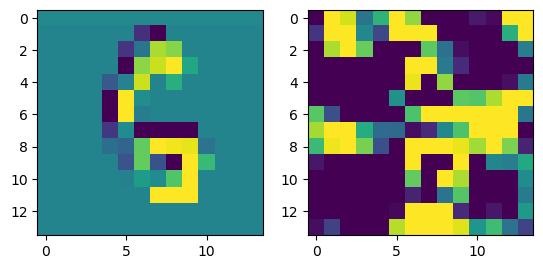

prediction: tensor([4, 3, 9]), tensor([2.3148, 1.7645, 1.4267]) groudtruth: 9
-0.108958185 0.09620293


<Figure size 640x480 with 0 Axes>

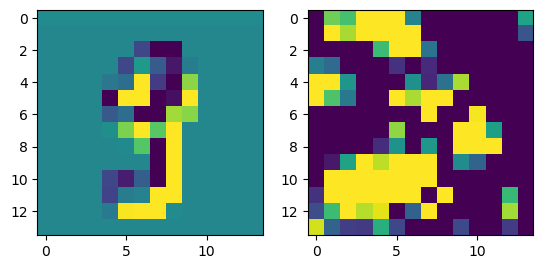

prediction: tensor([4, 1, 6]), tensor([3.6195, 1.2891, 1.2403]) groudtruth: 4
-0.0859918 0.09177271


<Figure size 640x480 with 0 Axes>

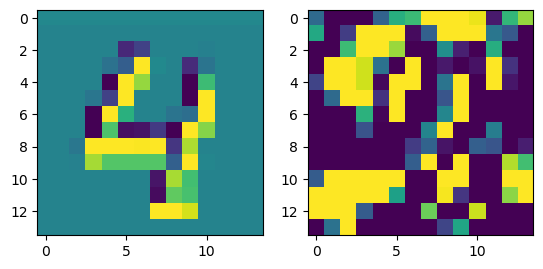

prediction: tensor([1, 5, 8]), tensor([3.8235, 3.2921, 1.4554]) groudtruth: 1
-0.059696734 0.086711526


<Figure size 640x480 with 0 Axes>

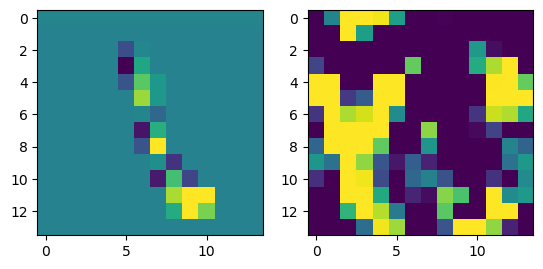

prediction: tensor([3, 7, 1]), tensor([2.6117, 1.8279, 0.6622]) groudtruth: 3
-0.07698345 0.09616618


<Figure size 640x480 with 0 Axes>

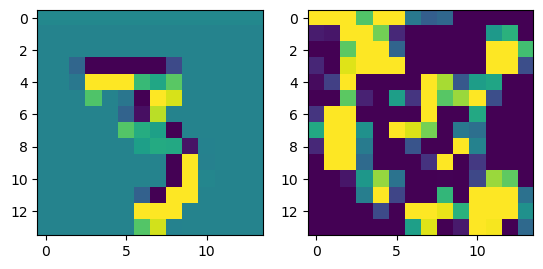

prediction: tensor([7, 6, 9]), tensor([2.3403, 0.9715, 0.9055]) groudtruth: 7
-0.1013841 0.07232733


<Figure size 640x480 with 0 Axes>

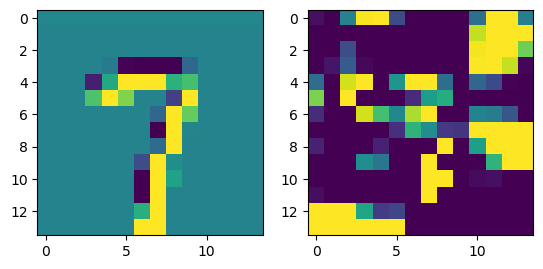

prediction: tensor([9, 3, 7]), tensor([2.8958, 2.3748, 1.6039]) groudtruth: 3
-0.07681078 0.08282847


<Figure size 640x480 with 0 Axes>

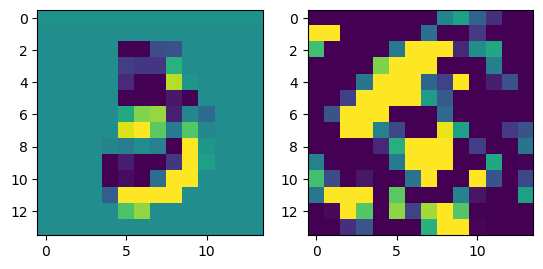

prediction: tensor([0, 5, 8]), tensor([5.1032, 1.2060, 0.7603]) groudtruth: 0
-0.06858355 0.067669064


<Figure size 640x480 with 0 Axes>

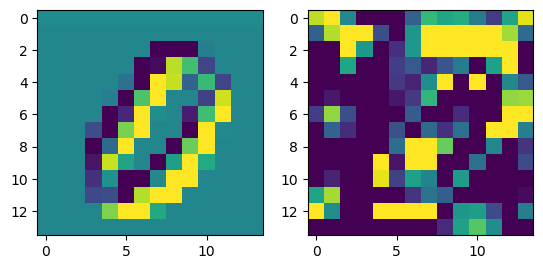

prediction: tensor([4, 8, 9]), tensor([3.7474, 0.8587, 0.5595]) groudtruth: 4
-0.07170886 0.10052717


<Figure size 640x480 with 0 Axes>

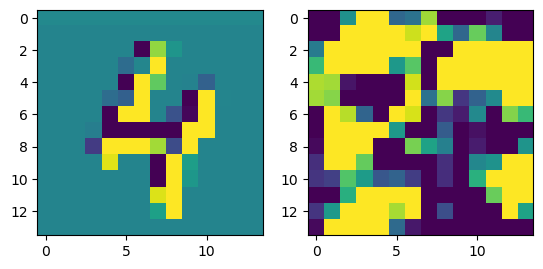

prediction: tensor([8, 9, 1]), tensor([4.5634, 2.9194, 0.8589]) groudtruth: 8
-0.08819538 0.08613456


<Figure size 640x480 with 0 Axes>

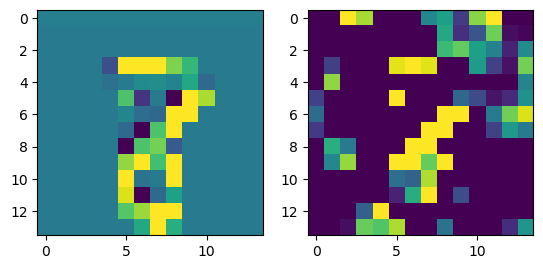

prediction: tensor([2, 3, 4]), tensor([5.0139, 2.6342, 0.6219]) groudtruth: 2
-0.0625512 0.07973887


<Figure size 640x480 with 0 Axes>

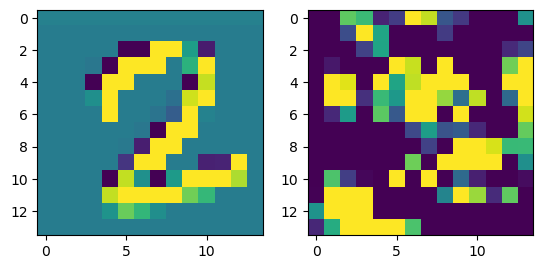

prediction: tensor([6, 8, 4]), tensor([2.6167, 1.9657, 0.9287]) groudtruth: 6
-0.064255655 0.073103935


<Figure size 640x480 with 0 Axes>

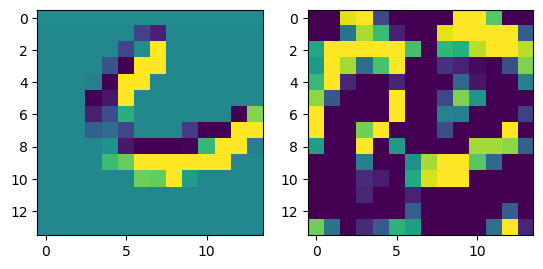

prediction: tensor([6, 4, 0]), tensor([1.9705, 1.8323, 0.9428]) groudtruth: 5
-0.07036489 0.07403085


<Figure size 640x480 with 0 Axes>

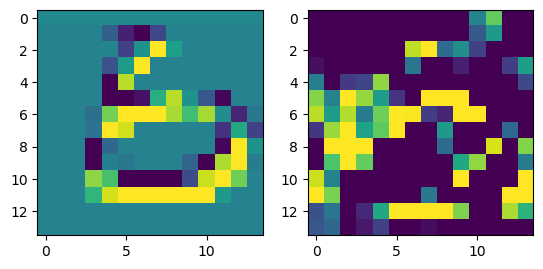

prediction: tensor([2, 9, 6]), tensor([7.4863, 0.6082, 0.2279]) groudtruth: 2
-0.11169529 0.11647032


<Figure size 640x480 with 0 Axes>

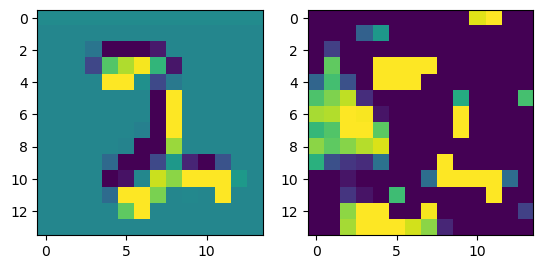

prediction: tensor([9, 7, 4]), tensor([3.3084, 0.7263, 0.6616]) groudtruth: 9
-0.075344265 0.082554236


<Figure size 640x480 with 0 Axes>

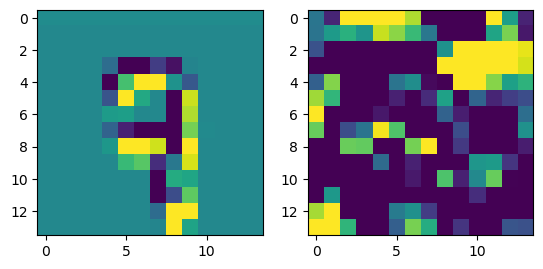

prediction: tensor([7, 4, 5]), tensor([3.7439, 1.3144, 0.7219]) groudtruth: 7
-0.069099426 0.081773624


<Figure size 640x480 with 0 Axes>

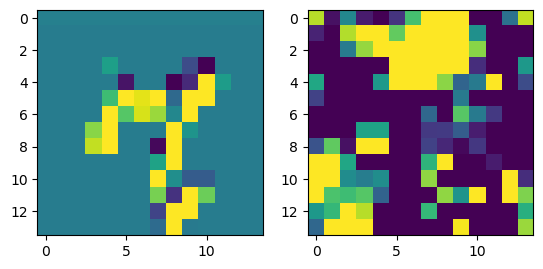

prediction: tensor([9, 7, 8]), tensor([2.9196, 2.5170, 1.2410]) groudtruth: 3
-0.08114457 0.10115765


<Figure size 640x480 with 0 Axes>

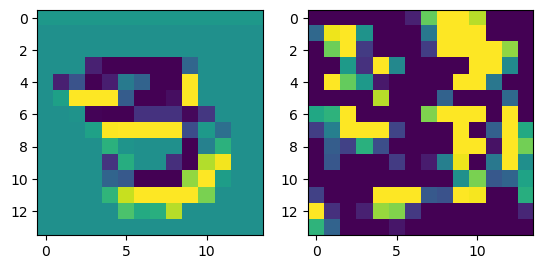

prediction: tensor([9, 4, 2]), tensor([4.2138, 1.6497, 1.0788]) groudtruth: 9
-0.09665507 0.112858


<Figure size 640x480 with 0 Axes>

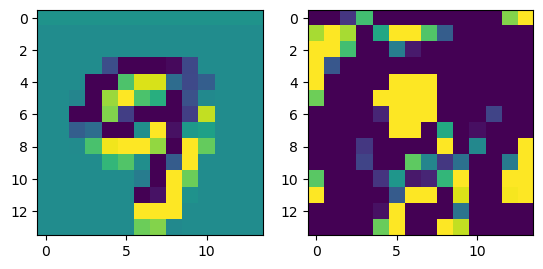

prediction: tensor([0, 7, 2]), tensor([5.1480, 2.1248, 1.6175]) groudtruth: 0
-0.089876235 0.08928837


<Figure size 640x480 with 0 Axes>

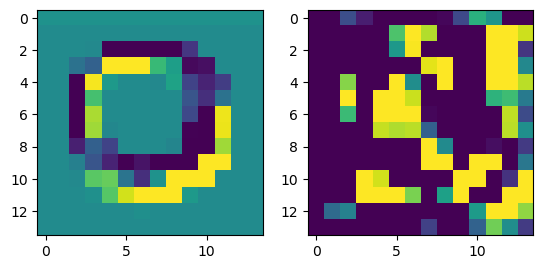

prediction: tensor([9, 4, 7]), tensor([4.1555, 2.4140, 1.3718]) groudtruth: 9
-0.075562954 0.07028095


<Figure size 640x480 with 0 Axes>

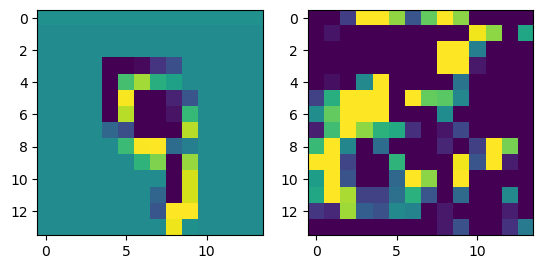

prediction: tensor([9, 0, 5]), tensor([4.8264, 2.6532, 1.7849]) groudtruth: 9
-0.088840365 0.08922133


<Figure size 640x480 with 0 Axes>

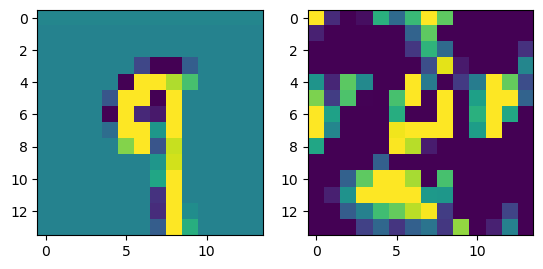

prediction: tensor([6, 7, 0]), tensor([4.3377, 2.6678, 2.1036]) groudtruth: 6
-0.08632177 0.074308135


<Figure size 640x480 with 0 Axes>

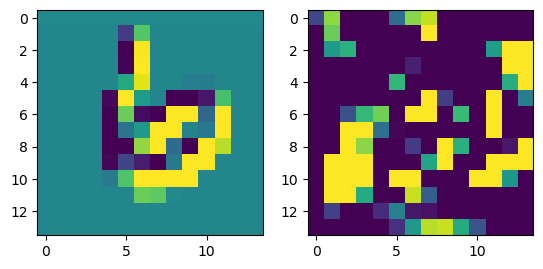

prediction: tensor([4, 1, 9]), tensor([5.1784, 1.8319, 1.0951]) groudtruth: 4
-0.09990758 0.08807186


<Figure size 640x480 with 0 Axes>

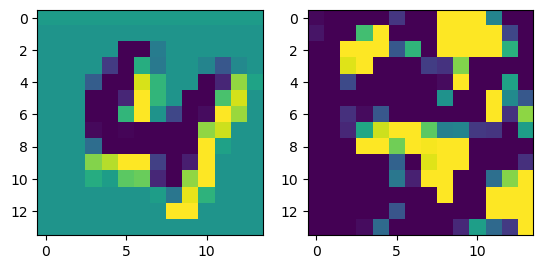

prediction: tensor([2, 7, 6]), tensor([3.5931, 2.9149, 2.8660]) groudtruth: 2
-0.077265024 0.12621996


<Figure size 640x480 with 0 Axes>

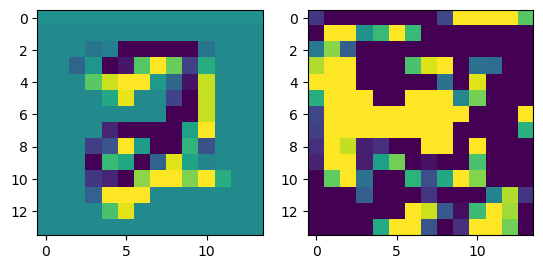

prediction: tensor([6, 8, 0]), tensor([3.9726, 3.2361, 1.0604]) groudtruth: 8
-0.08172262 0.11848574


<Figure size 640x480 with 0 Axes>

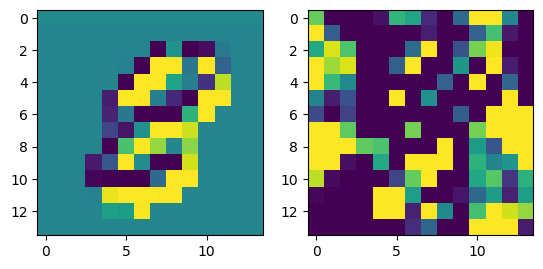

prediction: tensor([4, 2, 8]), tensor([5.3873, 1.9935, 1.7587]) groudtruth: 4
-0.06550437 0.08029942


<Figure size 640x480 with 0 Axes>

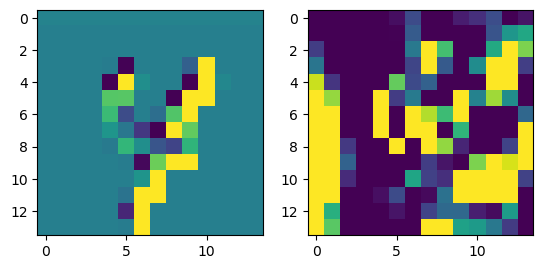

prediction: tensor([9, 1, 2]), tensor([3.2813, 2.1573, 1.9270]) groudtruth: 9
-0.08628237 0.07868994


<Figure size 640x480 with 0 Axes>

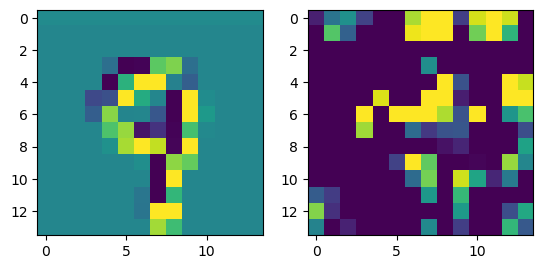

prediction: tensor([0, 3, 5]), tensor([8.7173, 1.8297, 1.6408]) groudtruth: 0
-0.08353096 0.12003406


<Figure size 640x480 with 0 Axes>

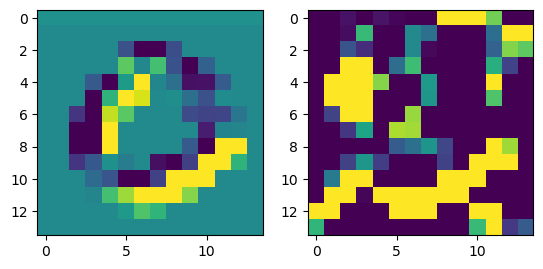

prediction: tensor([7, 1, 2]), tensor([4.0699, 0.9897, 0.9590]) groudtruth: 7
-0.101757824 0.10343715


<Figure size 640x480 with 0 Axes>

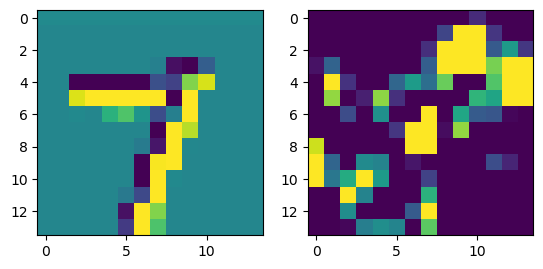

prediction: tensor([3, 9, 0]), tensor([4.0204, 1.8904, 0.6644]) groudtruth: 3
-0.07890087 0.09958214


<Figure size 640x480 with 0 Axes>

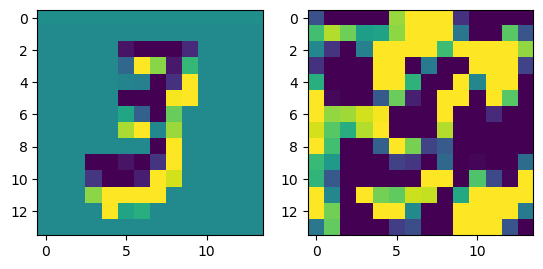

prediction: tensor([0, 7, 9]), tensor([4.6174, 2.0478, 1.1915]) groudtruth: 0
-0.06838721 0.089233175


<Figure size 640x480 with 0 Axes>

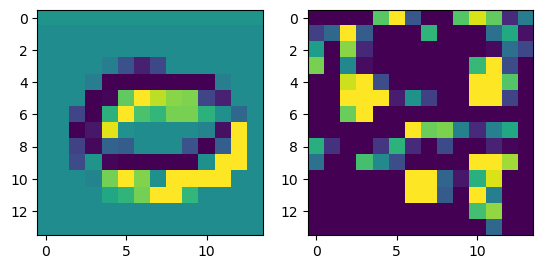

prediction: tensor([4, 2, 6]), tensor([3.6890, 3.0910, 0.9351]) groudtruth: 2
-0.11641985 0.14722519


<Figure size 640x480 with 0 Axes>

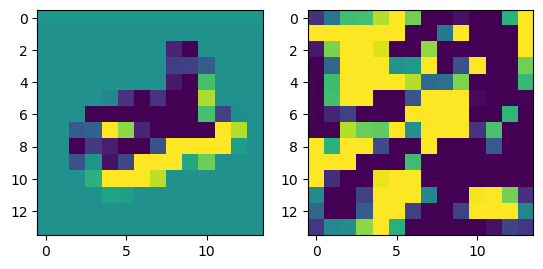

prediction: tensor([1, 9, 6]), tensor([3.4927, 2.1867, 2.0561]) groudtruth: 9
-0.06721318 0.12264954


<Figure size 640x480 with 0 Axes>

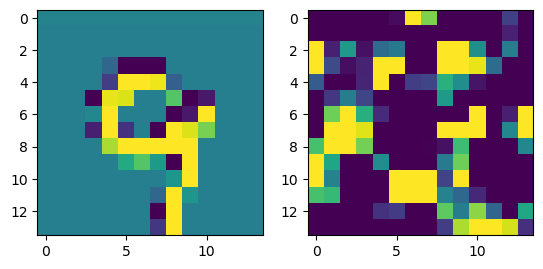

prediction: tensor([0, 9, 8]), tensor([4.0075, 2.3774, 1.8408]) groudtruth: 0
-0.075035095 0.078671515


<Figure size 640x480 with 0 Axes>

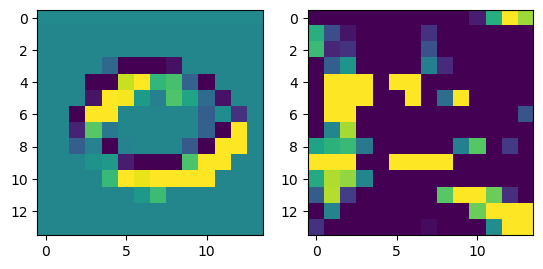

prediction: tensor([6, 8, 5]), tensor([5.1919, 2.3674, 0.5450]) groudtruth: 6
-0.09464717 0.08514627


<Figure size 640x480 with 0 Axes>

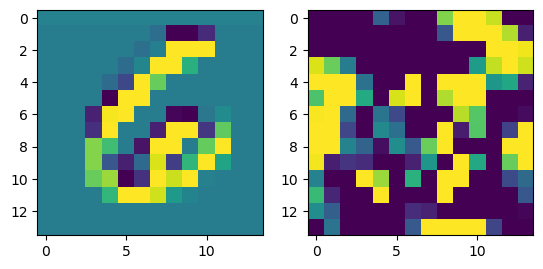

prediction: tensor([2, 6, 8]), tensor([2.7377, 1.8130, 1.3714]) groudtruth: 6
-0.08223778 0.053882618


<Figure size 640x480 with 0 Axes>

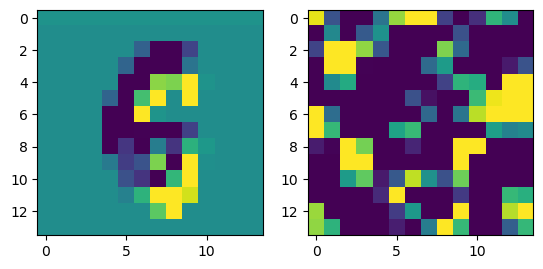

prediction: tensor([2, 6, 5]), tensor([2.4189, 1.8406, 1.5361]) groudtruth: 6
-0.064474106 0.08713612


<Figure size 640x480 with 0 Axes>

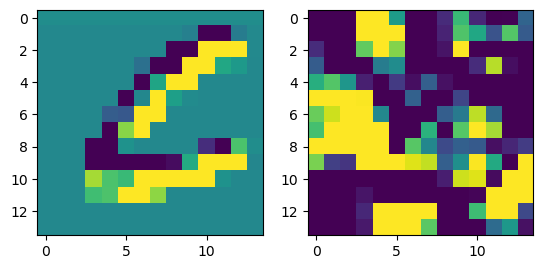

prediction: tensor([3, 4, 6]), tensor([2.3929, 1.5184, 1.0961]) groudtruth: 3
-0.089090705 0.0803061


<Figure size 640x480 with 0 Axes>

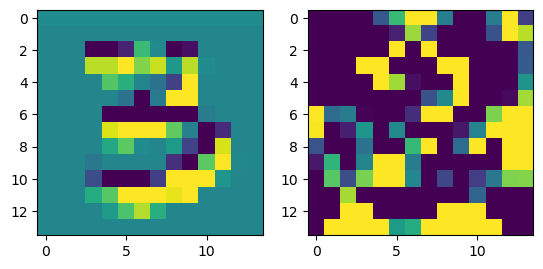

prediction: tensor([0, 6, 4]), tensor([3.5391, 2.7947, 0.9481]) groudtruth: 6
-0.07203138 0.091426834


<Figure size 640x480 with 0 Axes>

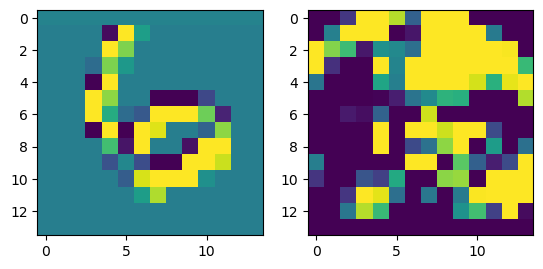

prediction: tensor([7, 9, 0]), tensor([6.9385, 1.1222, 0.2487]) groudtruth: 7
-0.07030052 0.09350097


<Figure size 640x480 with 0 Axes>

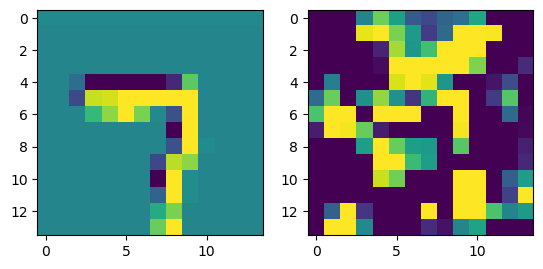

prediction: tensor([0, 2, 8]), tensor([6.0496, 1.2925, 0.6255]) groudtruth: 0
-0.08091545 0.07804616


<Figure size 640x480 with 0 Axes>

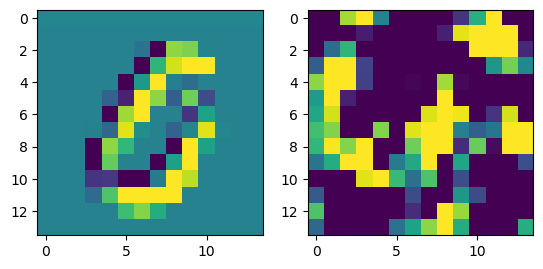

prediction: tensor([8, 6, 9]), tensor([3.5679, 2.7881, 2.1670]) groudtruth: 9
-0.09648818 0.08450559


<Figure size 640x480 with 0 Axes>

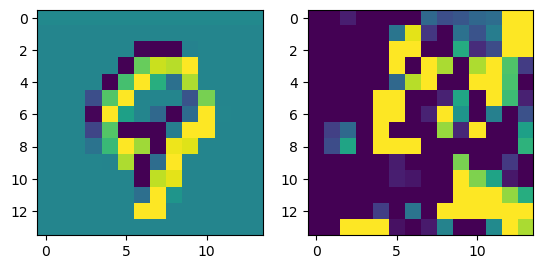

prediction: tensor([1, 6, 5]), tensor([4.5977, 2.5012, 0.9568]) groudtruth: 1
-0.06828165 0.06950819


<Figure size 640x480 with 0 Axes>

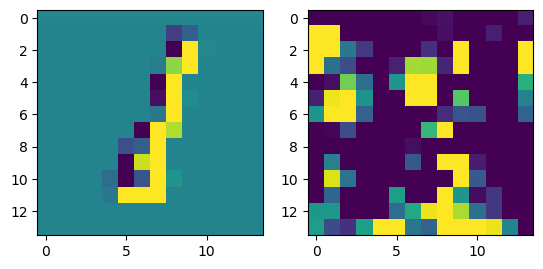

prediction: tensor([0, 8, 6]), tensor([4.3713, 1.9644, 0.2522]) groudtruth: 0
-0.09417242 0.09634629


<Figure size 640x480 with 0 Axes>

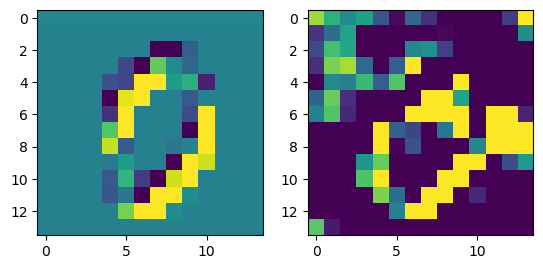

prediction: tensor([1, 8, 7]), tensor([6.5370, 1.5795, 0.4735]) groudtruth: 1
-0.08880854 0.08914026


<Figure size 640x480 with 0 Axes>

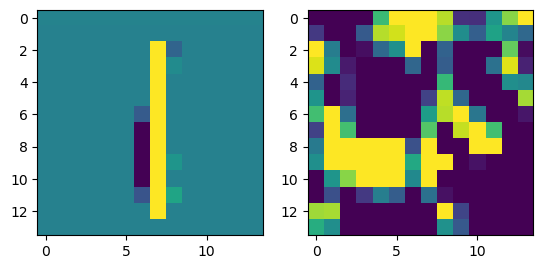

prediction: tensor([7, 9, 3]), tensor([2.4003, 2.3038, 1.7358]) groudtruth: 7
-0.07340962 0.08696292


<Figure size 640x480 with 0 Axes>

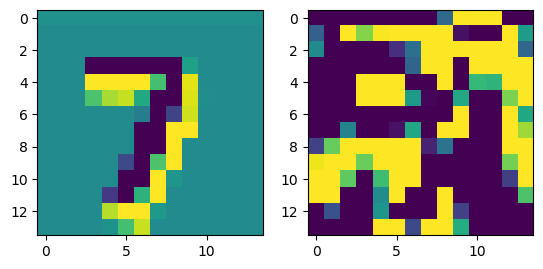

prediction: tensor([7, 9, 0]), tensor([5.6678, 2.8052, 1.6009]) groudtruth: 7
-0.071348906 0.111333504


<Figure size 640x480 with 0 Axes>

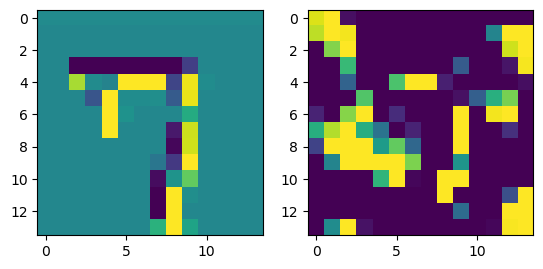

prediction: tensor([4, 2, 9]), tensor([4.3376, 1.0690, 0.8227]) groudtruth: 9
-0.07957542 0.11117234


<Figure size 640x480 with 0 Axes>

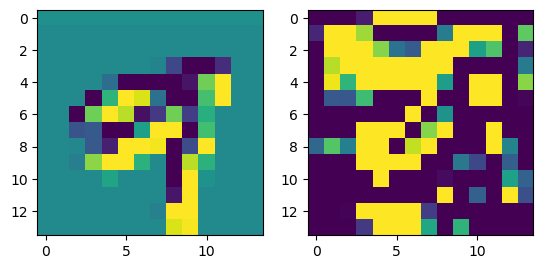

prediction: tensor([6, 2, 8]), tensor([3.2358, 2.0785, 1.0856]) groudtruth: 6
-0.08107442 0.07871767


<Figure size 640x480 with 0 Axes>

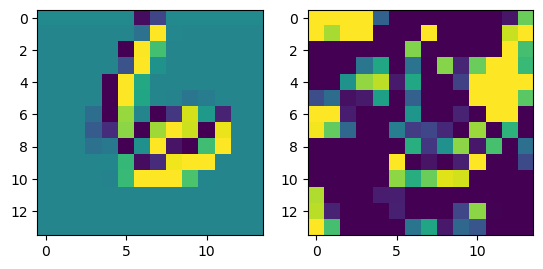

prediction: tensor([9, 4, 6]), tensor([2.3851, 1.8547, 0.5614]) groudtruth: 9
-0.06792641 0.0990306


<Figure size 640x480 with 0 Axes>

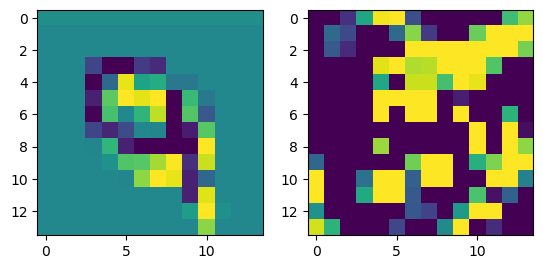

prediction: tensor([9, 8, 3]), tensor([4.0713, 2.8649, 2.0788]) groudtruth: 9
-0.07976848 0.09481497


<Figure size 640x480 with 0 Axes>

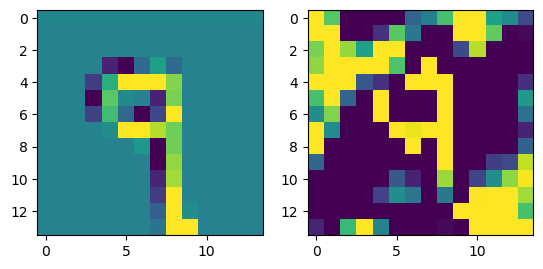

prediction: tensor([9, 7, 6]), tensor([4.2344, 1.6533, 1.6193]) groudtruth: 9
-0.07916272 0.09201747


<Figure size 640x480 with 0 Axes>

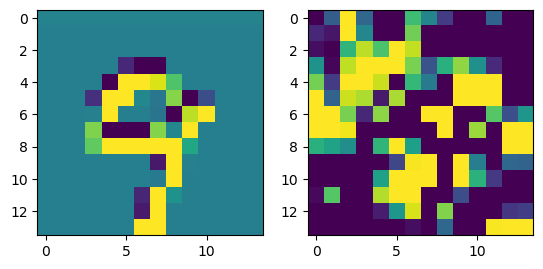

prediction: tensor([2, 8, 7]), tensor([3.7603, 2.2866, 1.8336]) groudtruth: 2
-0.08159602 0.084043086


<Figure size 640x480 with 0 Axes>

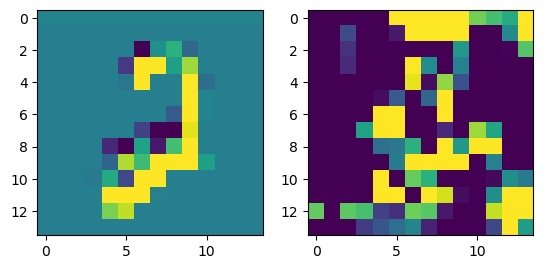

prediction: tensor([1, 3, 5]), tensor([5.6774, 1.0479, 0.8040]) groudtruth: 1
-0.080302894 0.07969791


<Figure size 640x480 with 0 Axes>

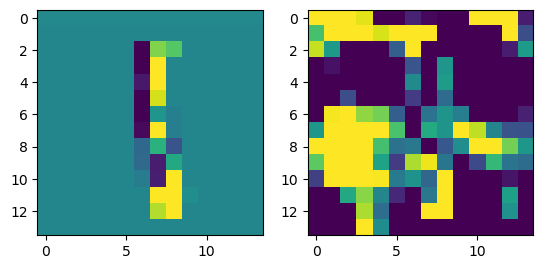

prediction: tensor([6, 0, 3]), tensor([3.3677, 3.0834, 1.8083]) groudtruth: 6
-0.09512937 0.09998094


<Figure size 640x480 with 0 Axes>

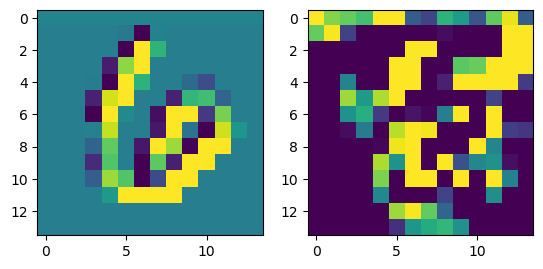

prediction: tensor([1, 5, 7]), tensor([4.5306, 1.2986, 0.4161]) groudtruth: 1
-0.08385587 0.093473196


<Figure size 640x480 with 0 Axes>

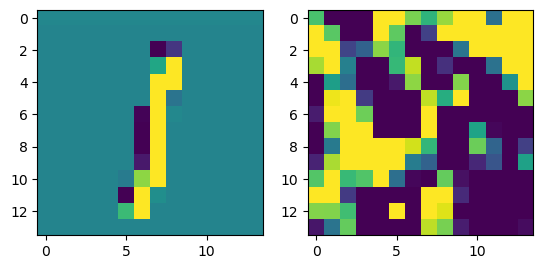

prediction: tensor([2, 7, 4]), tensor([2.5478, 2.0632, 1.3676]) groudtruth: 7
-0.11869204 0.08555915


<Figure size 640x480 with 0 Axes>

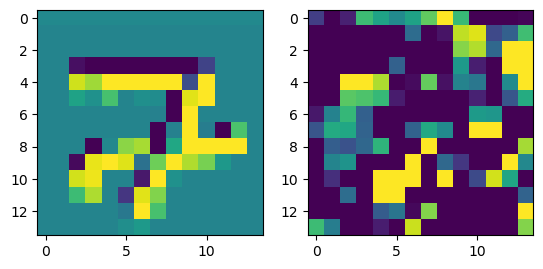

prediction: tensor([8, 6, 2]), tensor([4.6889, 1.6297, 1.5974]) groudtruth: 8
-0.061494768 0.08505273


<Figure size 640x480 with 0 Axes>

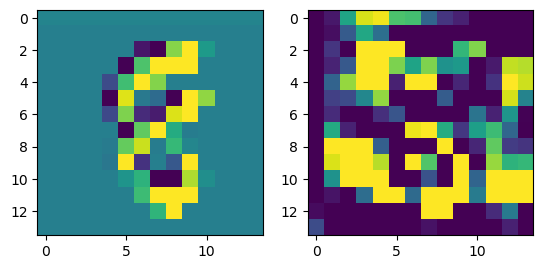

prediction: tensor([4, 1, 6]), tensor([2.4746, 1.5843, 1.3188]) groudtruth: 4
-0.08233273 0.06007576


<Figure size 640x480 with 0 Axes>

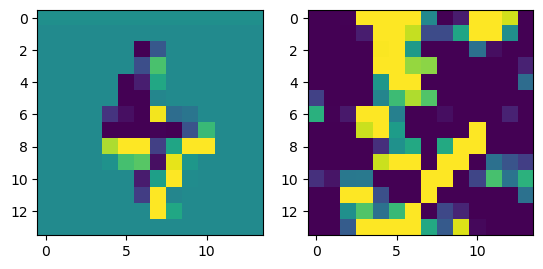

prediction: tensor([0, 4, 7]), tensor([3.2062, 2.6531, 1.8605]) groudtruth: 0
-0.08644587 0.07513917


<Figure size 640x480 with 0 Axes>

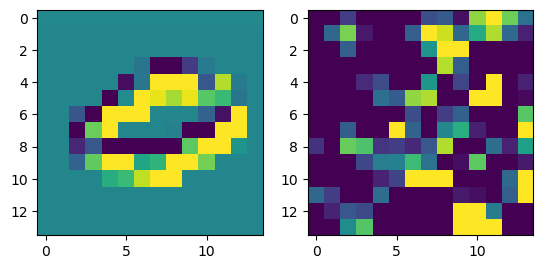

prediction: tensor([5, 3, 4]), tensor([3.0271, 2.1187, 1.0631]) groudtruth: 3
-0.0700205 0.10120488


<Figure size 640x480 with 0 Axes>

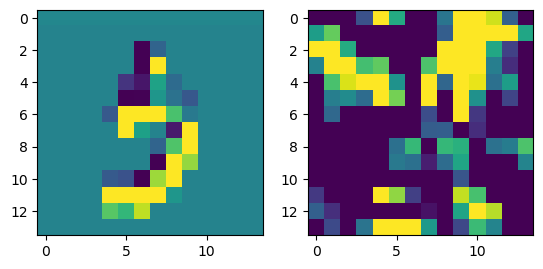

prediction: tensor([0, 5, 3]), tensor([2.9935, 2.1909, 1.7056]) groudtruth: 0
-0.07235545 0.09846053


<Figure size 640x480 with 0 Axes>

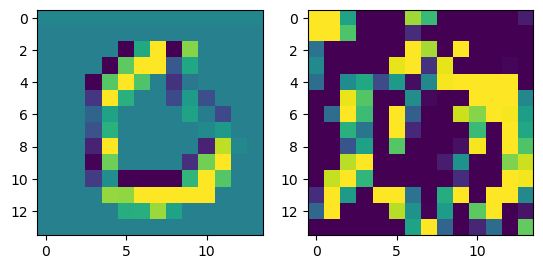

prediction: tensor([7, 9, 3]), tensor([5.4602, 2.1936, 1.7835]) groudtruth: 7
-0.08336228 0.0886552


<Figure size 640x480 with 0 Axes>

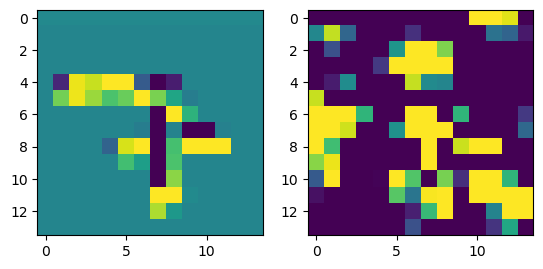

prediction: tensor([8, 7, 3]), tensor([3.1254, 1.3851, 1.1156]) groudtruth: 8
-0.074376166 0.10049641


<Figure size 640x480 with 0 Axes>

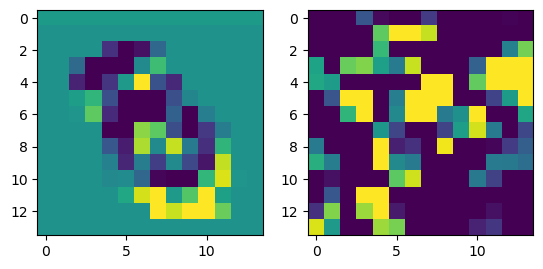

prediction: tensor([8, 3, 1]), tensor([3.5262, 0.8528, 0.6775]) groudtruth: 8
-0.08497852 0.10005789


<Figure size 640x480 with 0 Axes>

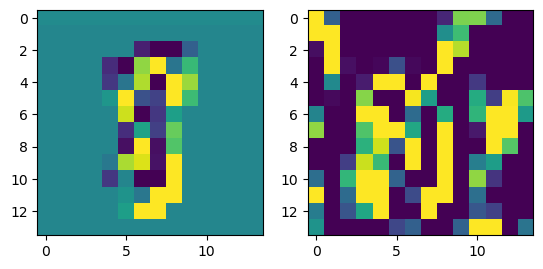

prediction: tensor([4, 3, 9]), tensor([6.0115, 0.3386, 0.1255]) groudtruth: 4
-0.07474226 0.092714444


<Figure size 640x480 with 0 Axes>

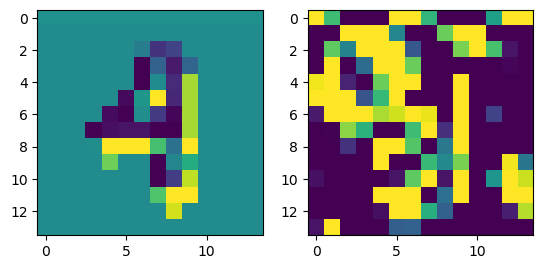

prediction: tensor([7, 4, 6]), tensor([5.3250, 0.7187, 0.3352]) groudtruth: 7
-0.08739686 0.07368172


<Figure size 640x480 with 0 Axes>

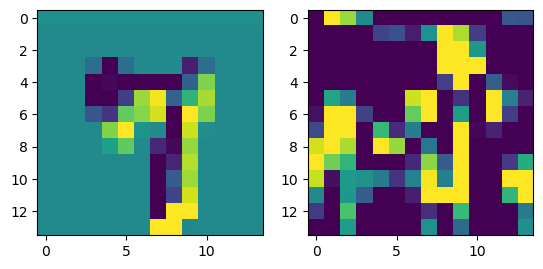

prediction: tensor([7, 0, 3]), tensor([4.9797, 2.2074, 1.6594]) groudtruth: 7
-0.073236346 0.09375267


<Figure size 640x480 with 0 Axes>

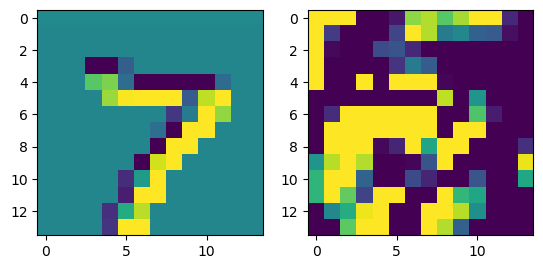

prediction: tensor([9, 5, 8]), tensor([2.8773, 2.2358, 2.1315]) groudtruth: 8
-0.09399152 0.08345443


<Figure size 640x480 with 0 Axes>

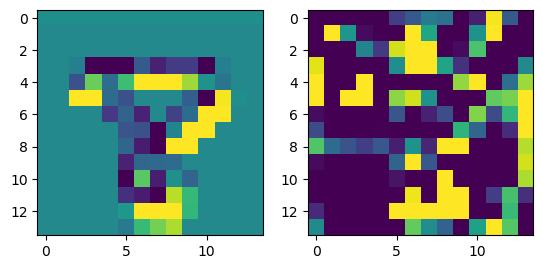

prediction: tensor([5, 8, 3]), tensor([6.5908, 2.2888, 2.1177]) groudtruth: 5
-0.10309714 0.08098263


<Figure size 640x480 with 0 Axes>

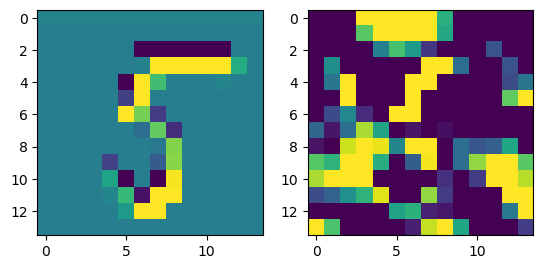

prediction: tensor([8, 1, 5]), tensor([3.1975, 0.4516, 0.4131]) groudtruth: 8
-0.052715898 0.095937714


<Figure size 640x480 with 0 Axes>

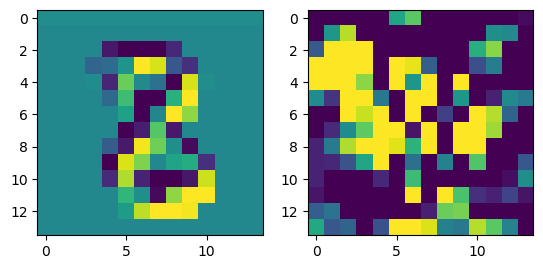

prediction: tensor([0, 7, 6]), tensor([1.5201, 1.3452, 0.6153]) groudtruth: 4
-0.09496927 0.06821723


<Figure size 640x480 with 0 Axes>

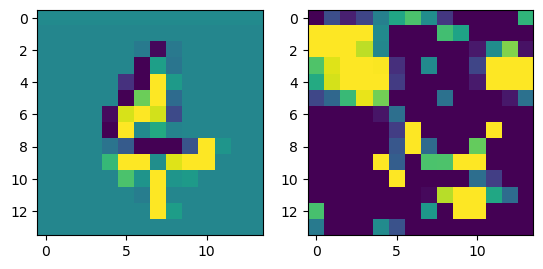

prediction: tensor([7, 6, 2]), tensor([4.3926, 2.1327, 1.3609]) groudtruth: 7
-0.06704134 0.07469548


<Figure size 640x480 with 0 Axes>

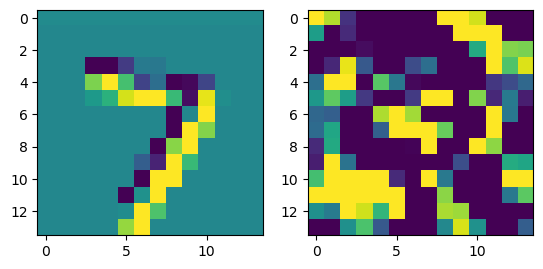

prediction: tensor([2, 5, 6]), tensor([6.5990, 2.3100, 0.4937]) groudtruth: 2
-0.08324623 0.070523925


<Figure size 640x480 with 0 Axes>

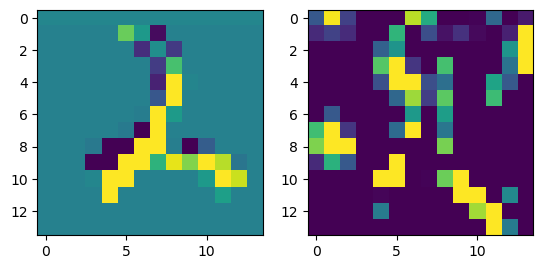

prediction: tensor([3, 4, 0]), tensor([3.3824, 2.4343, 1.3251]) groudtruth: 3
-0.10295117 0.09226684


<Figure size 640x480 with 0 Axes>

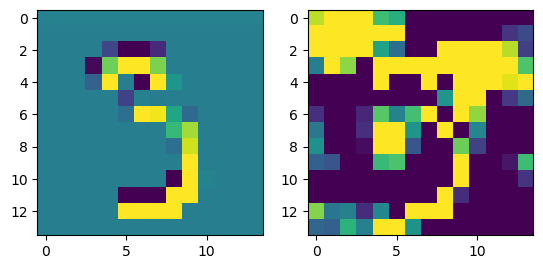

prediction: tensor([4, 7, 5]), tensor([3.8930, 1.9379, 0.9868]) groudtruth: 4
-0.0868566 0.09439026


<Figure size 640x480 with 0 Axes>

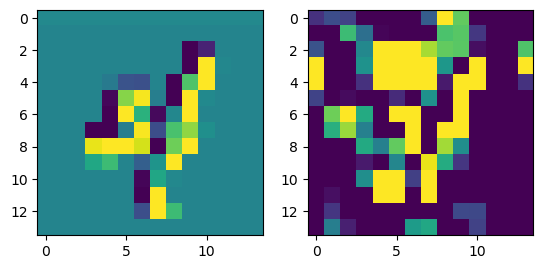

prediction: tensor([0, 1, 6]), tensor([3.8195, 2.0603, 0.7863]) groudtruth: 0
-0.07722896 0.13034071


<Figure size 640x480 with 0 Axes>

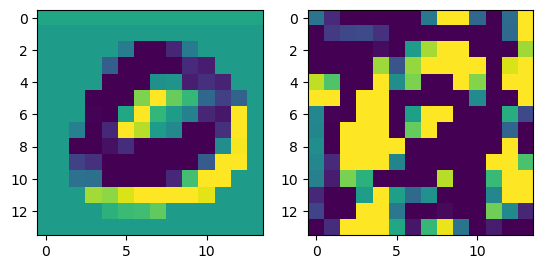

prediction: tensor([2, 6, 1]), tensor([4.6253, 2.7567, 2.5699]) groudtruth: 2
-0.090982914 0.08568548


<Figure size 640x480 with 0 Axes>

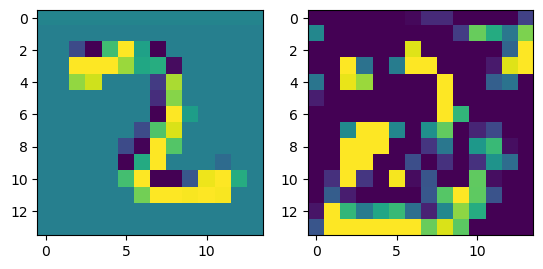

prediction: tensor([1, 8, 2]), tensor([5.2310, 0.3751, 0.2042]) groudtruth: 1
-0.103868306 0.07502121


<Figure size 640x480 with 0 Axes>

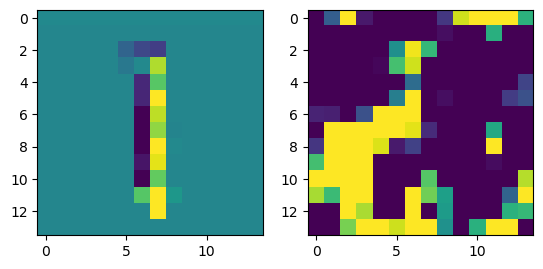

prediction: tensor([5, 0, 6]), tensor([2.8250, 2.7215, 1.7883]) groudtruth: 8
-0.076098025 0.09443143


<Figure size 640x480 with 0 Axes>

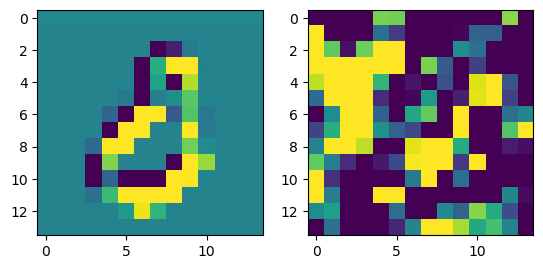

prediction: tensor([5, 3, 1]), tensor([3.7107, 1.5700, 0.6034]) groudtruth: 3
-0.078994155 0.10463172


<Figure size 640x480 with 0 Axes>

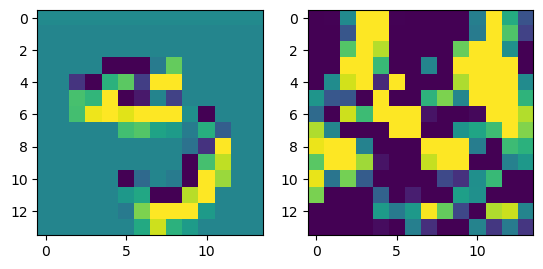

prediction: tensor([5, 4, 6]), tensor([4.2642, 1.4214, 1.1733]) groudtruth: 5
-0.10761601 0.13877158


<Figure size 640x480 with 0 Axes>

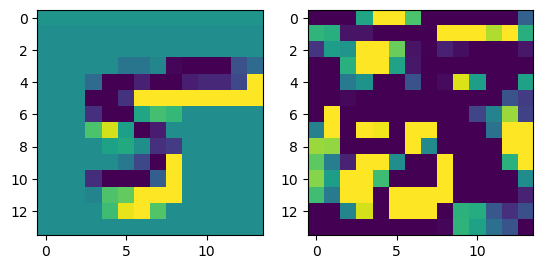

prediction: tensor([5, 7, 4]), tensor([4.8493, 1.6291, 0.1989]) groudtruth: 5
-0.05747813 0.097037464


<Figure size 640x480 with 0 Axes>

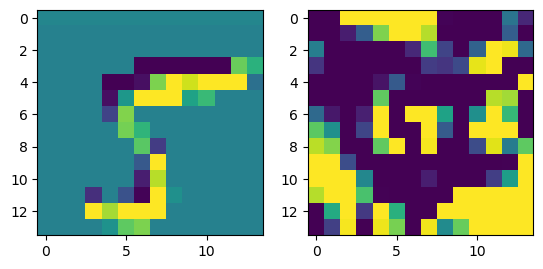

prediction: tensor([7, 9, 0]), tensor([4.4593, 0.9084, 0.5406]) groudtruth: 7
-0.057885647 0.07116082


<Figure size 640x480 with 0 Axes>

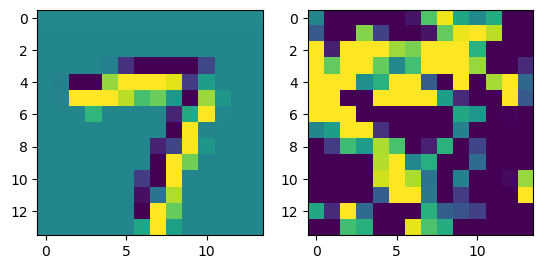

prediction: tensor([2, 7, 1]), tensor([3.1525, 2.4830, 1.4682]) groudtruth: 2
-0.09256923 0.096626215


<Figure size 640x480 with 0 Axes>

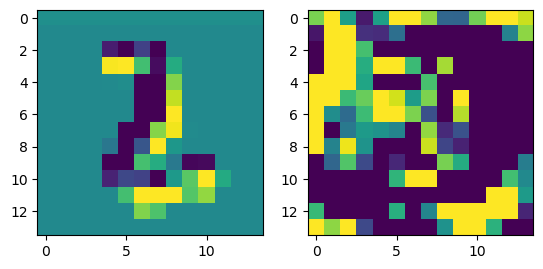

prediction: tensor([8, 2, 4]), tensor([3.8524, 1.4220, 1.0299]) groudtruth: 4
-0.05924648 0.06362145


<Figure size 640x480 with 0 Axes>

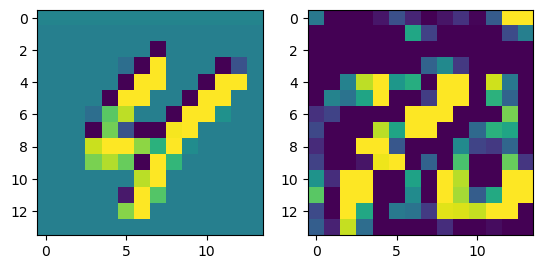

prediction: tensor([0, 4, 3]), tensor([6.0523, 1.5411, 1.3249]) groudtruth: 6
-0.0683167 0.09064391


<Figure size 640x480 with 0 Axes>

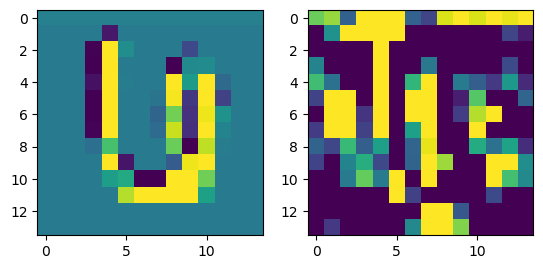

prediction: tensor([7, 9, 4]), tensor([3.0544, 1.8503, 1.0921]) groudtruth: 7
-0.09147251 0.08578919


<Figure size 640x480 with 0 Axes>

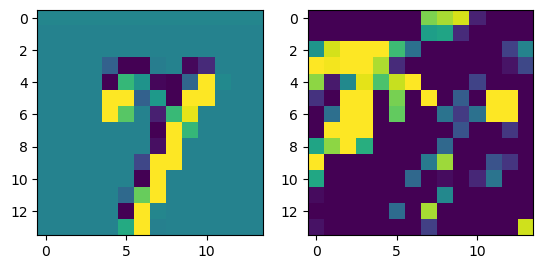

prediction: tensor([1, 0, 2]), tensor([4.6634, 1.8466, 1.6530]) groudtruth: 1
-0.05611521 0.08310795


<Figure size 640x480 with 0 Axes>

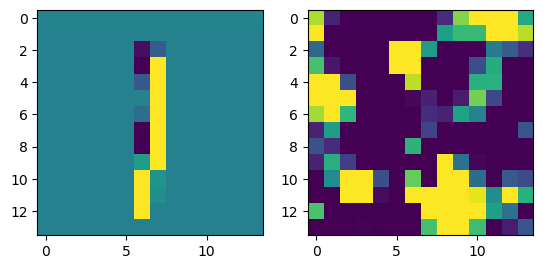

prediction: tensor([7, 3, 8]), tensor([4.5618, 2.8069, 0.2497]) groudtruth: 7
-0.10290724 0.08932456


<Figure size 640x480 with 0 Axes>

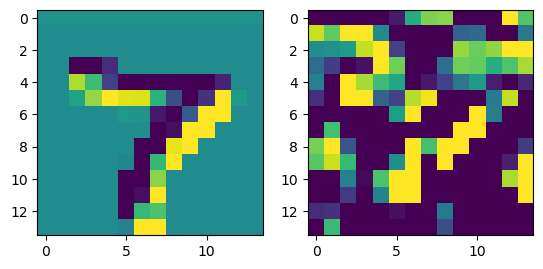

prediction: tensor([4, 9, 7]), tensor([4.2674, 1.7092, 1.3409]) groudtruth: 4
-0.09554869 0.084782705


<Figure size 640x480 with 0 Axes>

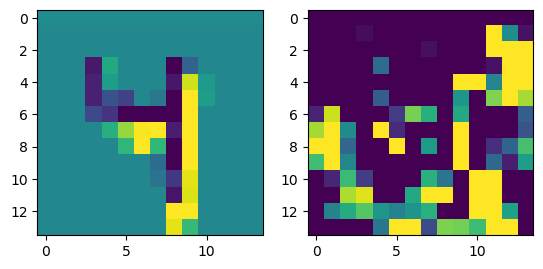

prediction: tensor([5, 9, 8]), tensor([5.6595, 1.6690, 0.5952]) groudtruth: 5
-0.10084963 0.07226968


<Figure size 640x480 with 0 Axes>

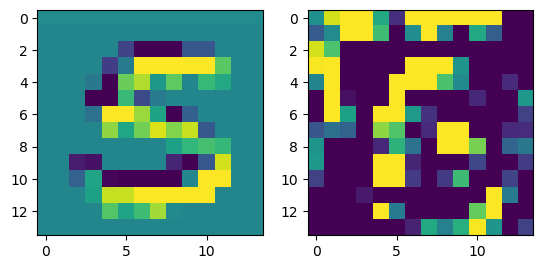

prediction: tensor([7, 2, 9]), tensor([5.1870, 2.1969, 1.4864]) groudtruth: 7
-0.08955115 0.10085441


<Figure size 640x480 with 0 Axes>

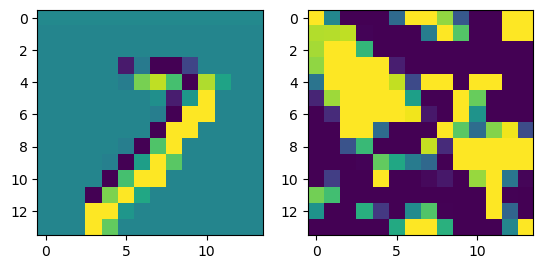

prediction: tensor([1, 8, 2]), tensor([3.8271, 1.8433, 1.2894]) groudtruth: 1
-0.053247094 0.08403368


<Figure size 640x480 with 0 Axes>

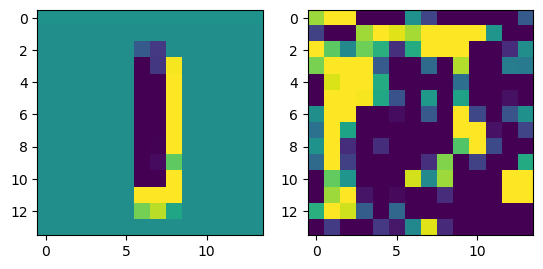

prediction: tensor([2, 4, 6]), tensor([5.7264, 3.2993, 2.2749]) groudtruth: 2
-0.08794314 0.080505416


<Figure size 640x480 with 0 Axes>

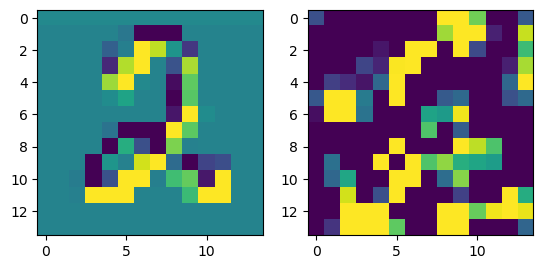

prediction: tensor([1, 9, 8]), tensor([5.8855, 1.3221, 0.9402]) groudtruth: 1
-0.06728202 0.10956971


<Figure size 640x480 with 0 Axes>

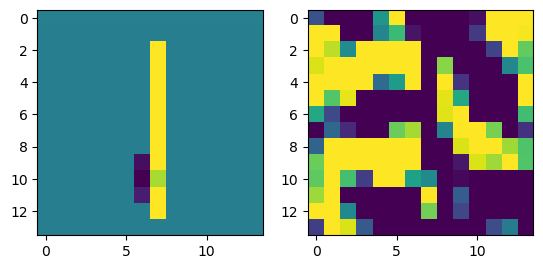

prediction: tensor([1, 6, 5]), tensor([3.8163, 0.3728, 0.2142]) groudtruth: 1
-0.057231188 0.06605157


<Figure size 640x480 with 0 Axes>

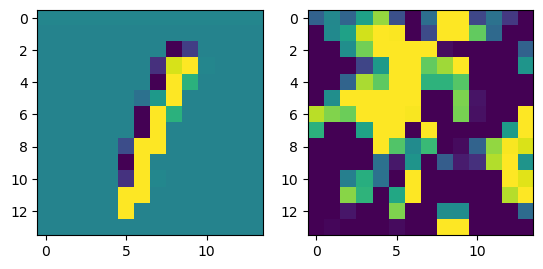

prediction: tensor([7, 8, 2]), tensor([2.0602, 1.8123, 0.9371]) groudtruth: 3
-0.072411716 0.10120611


<Figure size 640x480 with 0 Axes>

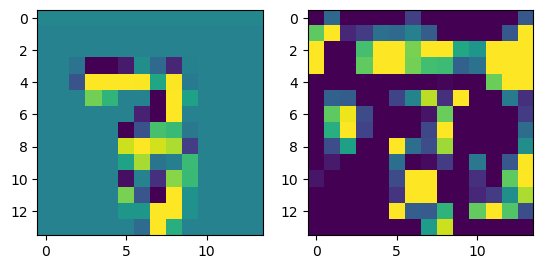

prediction: tensor([9, 2, 7]), tensor([1.5206, 1.1724, 1.1278]) groudtruth: 9
-0.10467827 0.07756302


<Figure size 640x480 with 0 Axes>

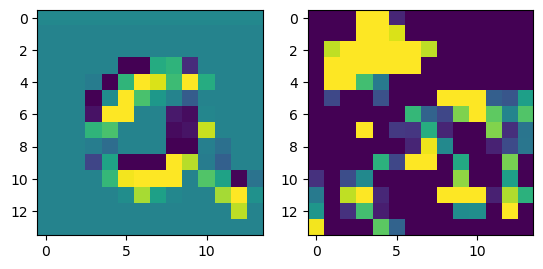

prediction: tensor([6, 2, 4]), tensor([7.1011, 1.6991, 1.3174]) groudtruth: 6
-0.079662204 0.073411345


<Figure size 640x480 with 0 Axes>

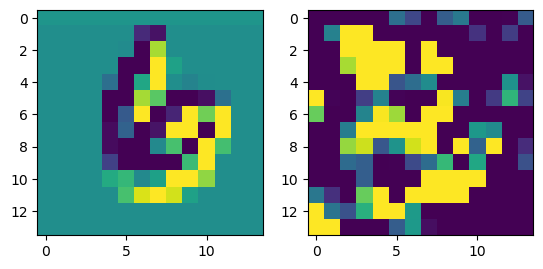

prediction: tensor([3, 2, 5]), tensor([3.0355, 2.3713, 0.8848]) groudtruth: 2
-0.087335706 0.08240001


<Figure size 640x480 with 0 Axes>

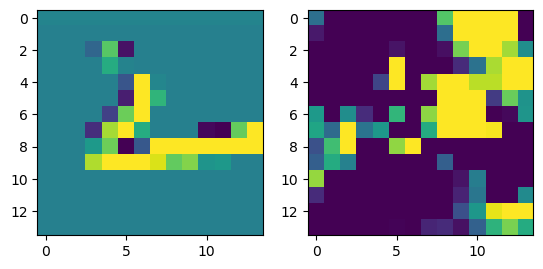

prediction: tensor([1, 6, 3]), tensor([5.1430, 1.7875, 0.0967]) groudtruth: 1
-0.067091465 0.10160768


<Figure size 640x480 with 0 Axes>

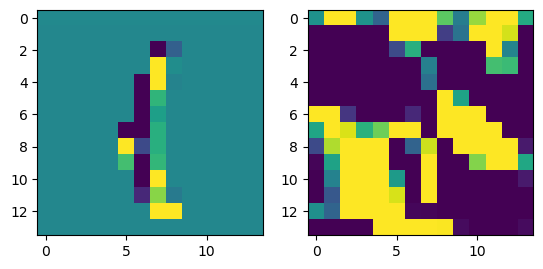

prediction: tensor([0, 7, 8]), tensor([1.7343, 1.6186, 1.1309]) groudtruth: 2
-0.070379734 0.07784174


<Figure size 640x480 with 0 Axes>

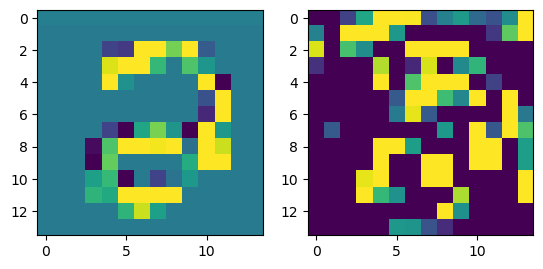

prediction: tensor([8, 7, 9]), tensor([3.0718, 2.4058, 1.5784]) groudtruth: 8
-0.07708049 0.11078627


<Figure size 640x480 with 0 Axes>

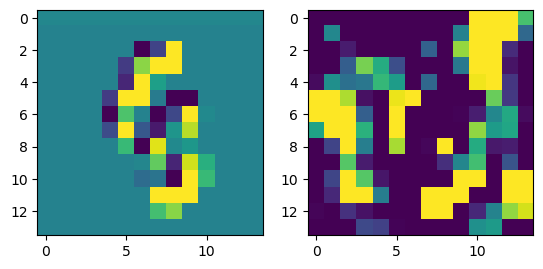

prediction: tensor([3, 0, 2]), tensor([4.6956, 0.9560, 0.8706]) groudtruth: 3
-0.076298654 0.07552859


<Figure size 640x480 with 0 Axes>

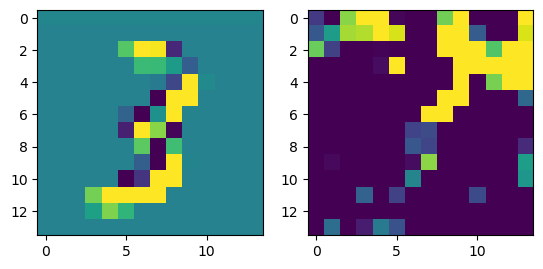

prediction: tensor([6, 4, 5]), tensor([4.0427, 2.6357, 1.1723]) groudtruth: 4
-0.08297968 0.06406607


<Figure size 640x480 with 0 Axes>

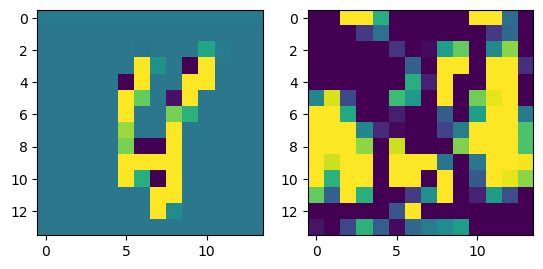

prediction: tensor([5, 1, 3]), tensor([3.6853, 3.5583, 1.2771]) groudtruth: 1
-0.097875774 0.07808115


<Figure size 640x480 with 0 Axes>

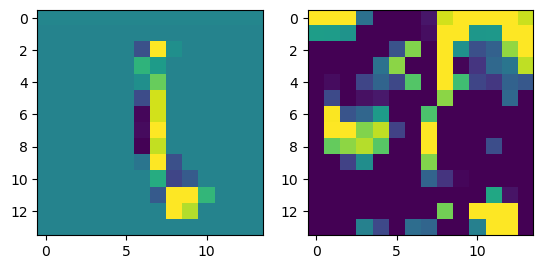

prediction: tensor([1, 7, 9]), tensor([4.4655, 2.8781, 0.1216]) groudtruth: 1
-0.05508071 0.07694585


<Figure size 640x480 with 0 Axes>

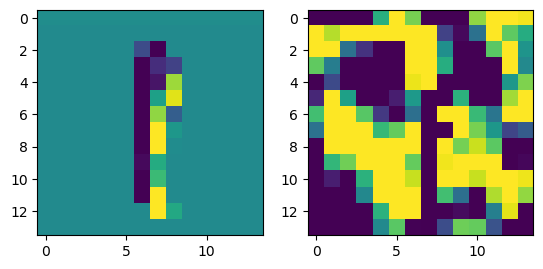

prediction: tensor([1, 6, 8]), tensor([4.8666, 1.0291, 0.7822]) groudtruth: 1
-0.06875092 0.0806786


<Figure size 640x480 with 0 Axes>

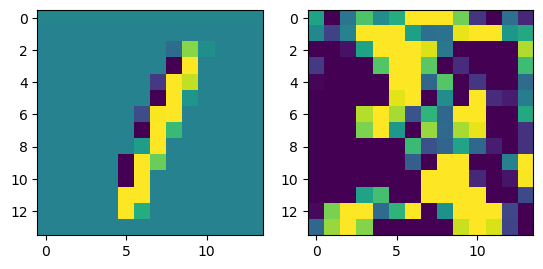

prediction: tensor([5, 3, 1]), tensor([6.5972, 1.2313, 0.3423]) groudtruth: 5
-0.09484297 0.10566147


<Figure size 640x480 with 0 Axes>

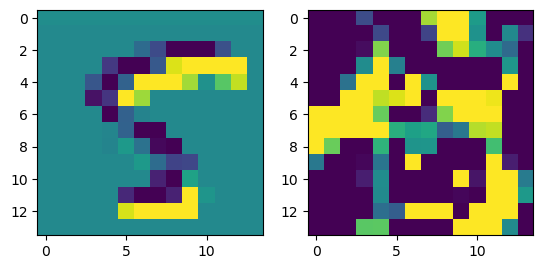

prediction: tensor([6, 5, 7]), tensor([6.0158, 0.9268, 0.4423]) groudtruth: 6
-0.073598325 0.076540396


<Figure size 640x480 with 0 Axes>

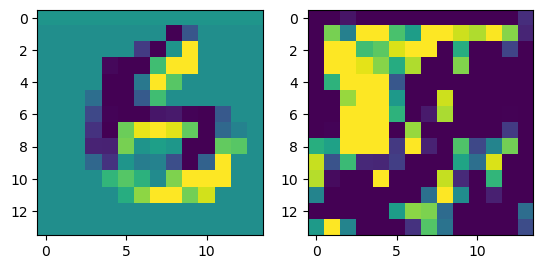

prediction: tensor([0, 3, 8]), tensor([4.9019, 0.6407, 0.4337]) groudtruth: 0
-0.09689069 0.09734194


<Figure size 640x480 with 0 Axes>

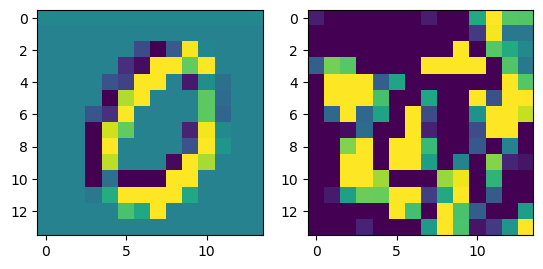

prediction: tensor([7, 2, 9]), tensor([3.2705, 1.5134, 1.4543]) groudtruth: 7
-0.08155978 0.104730025


<Figure size 640x480 with 0 Axes>

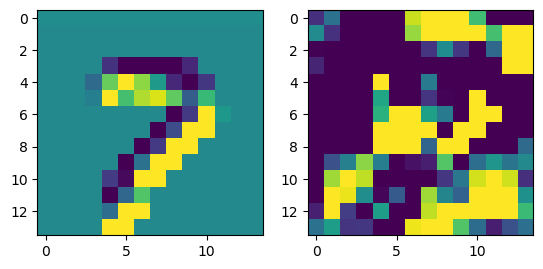

prediction: tensor([0, 3, 1]), tensor([5.5219, 0.8896, 0.1988]) groudtruth: 0
-0.069108605 0.07375355


<Figure size 640x480 with 0 Axes>

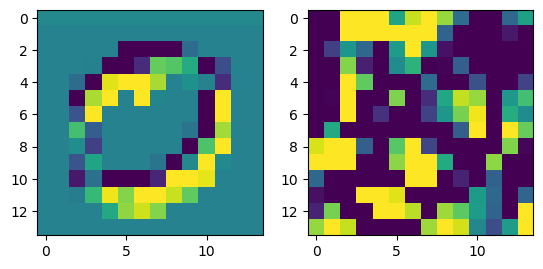

prediction: tensor([7, 9, 4]), tensor([3.6861, 1.6574, 1.0007]) groudtruth: 7
-0.08312428 0.09206705


<Figure size 640x480 with 0 Axes>

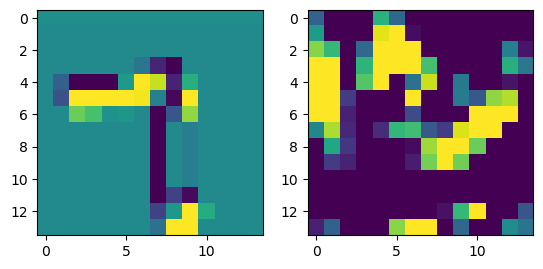

prediction: tensor([6, 7, 9]), tensor([1.4603, 0.9391, 0.7574]) groudtruth: 2
-0.085409045 0.10182127


<Figure size 640x480 with 0 Axes>

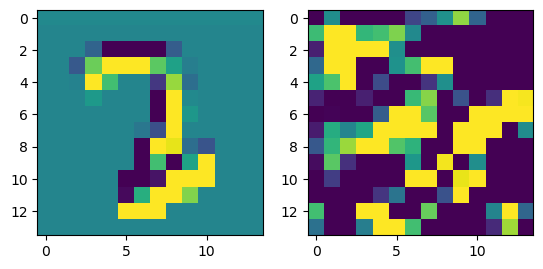

prediction: tensor([3, 9, 7]), tensor([5.4460, 2.7973, 1.8656]) groudtruth: 3
-0.091935754 0.06996359


<Figure size 640x480 with 0 Axes>

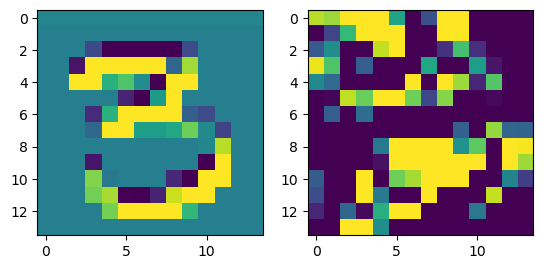

prediction: tensor([2, 0, 7]), tensor([3.9668, 3.0818, 2.9728]) groudtruth: 2
-0.094243884 0.104122534


<Figure size 640x480 with 0 Axes>

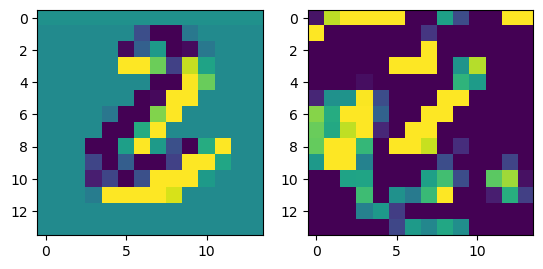

prediction: tensor([5, 8, 0]), tensor([3.5022, 1.9686, 1.5103]) groudtruth: 5
-0.07277465 0.075927205


<Figure size 640x480 with 0 Axes>

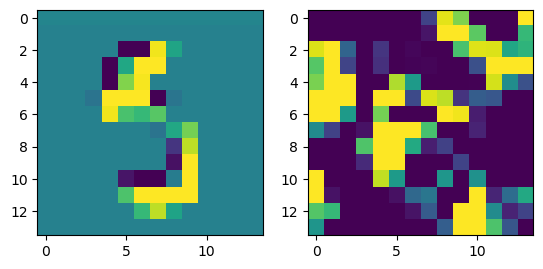

prediction: tensor([6, 7, 1]), tensor([3.9928, 1.8745, 1.3987]) groudtruth: 2
-0.09347743 0.07505681


<Figure size 640x480 with 0 Axes>

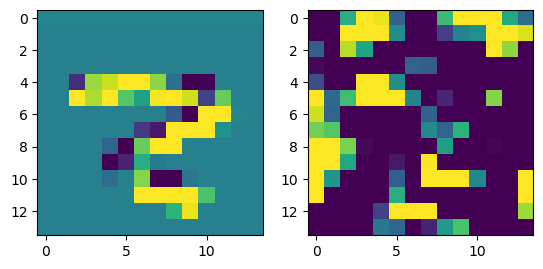

prediction: tensor([0, 6, 9]), tensor([6.2227, 1.6731, 0.8326]) groudtruth: 0
-0.086850524 0.08395407


<Figure size 640x480 with 0 Axes>

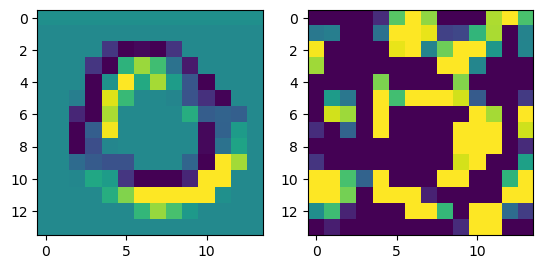

prediction: tensor([7, 3, 8]), tensor([5.6602, 1.1541, 1.1340]) groudtruth: 7
-0.077796996 0.069738284


<Figure size 640x480 with 0 Axes>

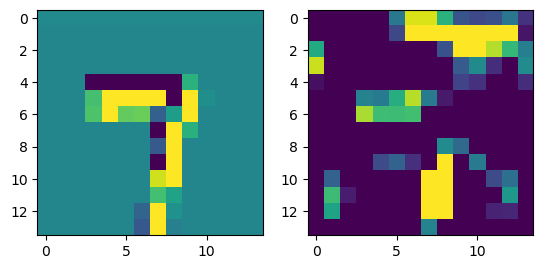

prediction: tensor([7, 6, 9]), tensor([2.7797, 2.0688, 0.8368]) groudtruth: 7
-0.094011426 0.09939331


<Figure size 640x480 with 0 Axes>

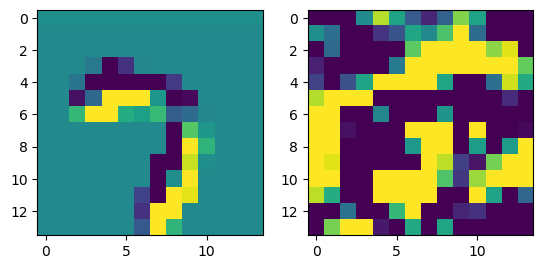

prediction: tensor([0, 2, 6]), tensor([2.6642, 2.5743, 1.3291]) groudtruth: 2
-0.10734326 0.10273185


<Figure size 640x480 with 0 Axes>

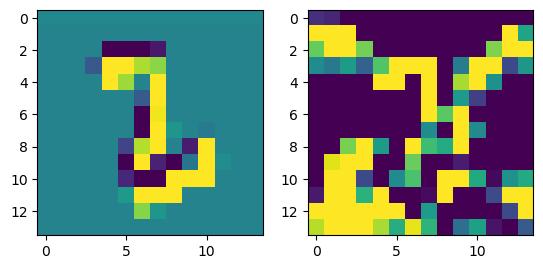

prediction: tensor([9, 3, 7]), tensor([1.9367, 1.7601, 1.3950]) groudtruth: 3
-0.06594658 0.06914308


<Figure size 640x480 with 0 Axes>

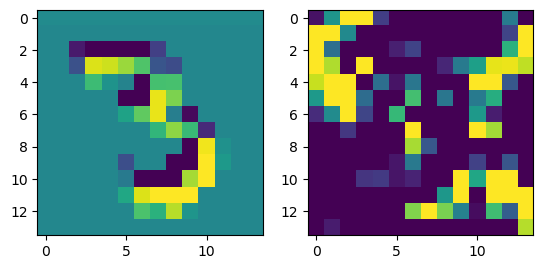

prediction: tensor([2, 1, 0]), tensor([2.5311, 2.4509, 1.7492]) groudtruth: 2
-0.085880935 0.076307446


<Figure size 640x480 with 0 Axes>

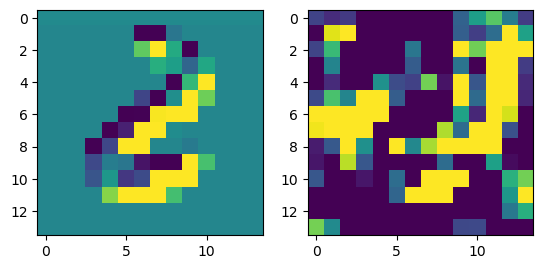

prediction: tensor([1, 4, 6]), tensor([2.5496, 2.4644, 1.1746]) groudtruth: 4
-0.098097265 0.0763787


<Figure size 640x480 with 0 Axes>

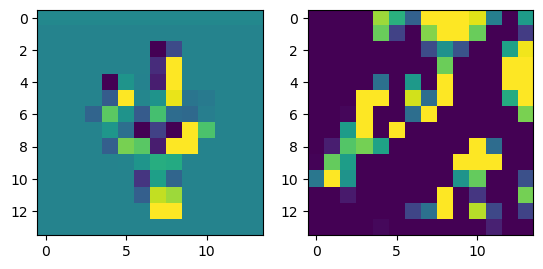

prediction: tensor([0, 1, 5]), tensor([4.6574, 2.4401, 0.2246]) groudtruth: 0
-0.069613576 0.081857726


<Figure size 640x480 with 0 Axes>

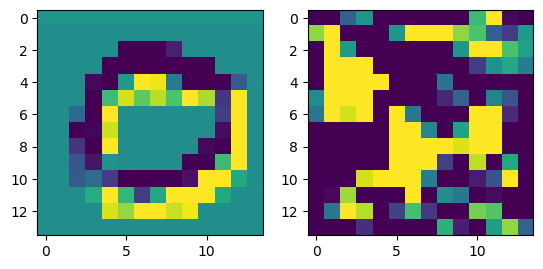

prediction: tensor([3, 5, 7]), tensor([6.8829, 1.3674, 0.8158]) groudtruth: 3
-0.085166216 0.08037165


<Figure size 640x480 with 0 Axes>

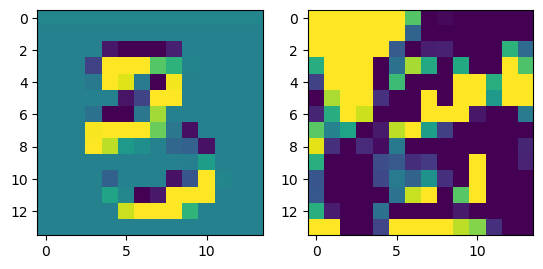

prediction: tensor([2, 6, 9]), tensor([1.4971, 1.0488, 0.9068]) groudtruth: 9
-0.076556206 0.06229072


<Figure size 640x480 with 0 Axes>

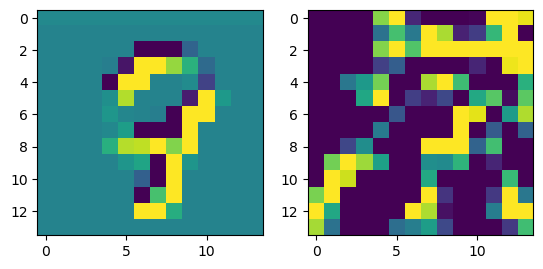

prediction: tensor([9, 3, 4]), tensor([5.2384, 1.9888, 0.6384]) groudtruth: 9
-0.08186144 0.070499726


<Figure size 640x480 with 0 Axes>

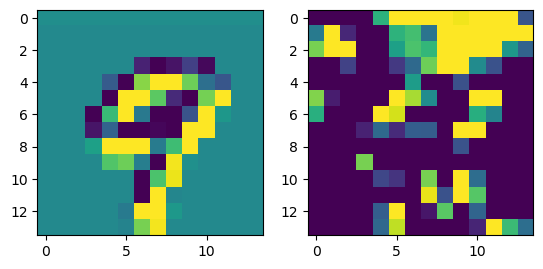

prediction: tensor([8, 3, 6]), tensor([4.9248, 1.2640, 0.6860]) groudtruth: 8
-0.07651365 0.10162032


<Figure size 640x480 with 0 Axes>

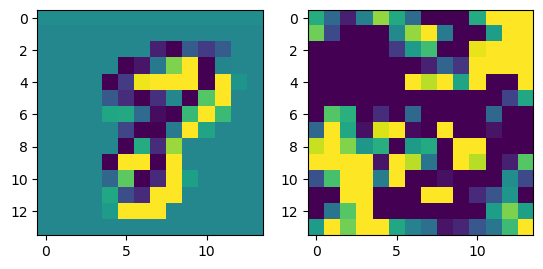

prediction: tensor([4, 1, 0]), tensor([5.6667, 1.9292, 0.3119]) groudtruth: 4
-0.073520124 0.09927754


<Figure size 640x480 with 0 Axes>

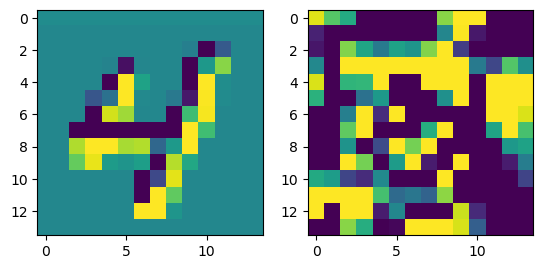

prediction: tensor([1, 4, 6]), tensor([4.5163, 1.4105, 0.5669]) groudtruth: 1
-0.07255584 0.09793629


<Figure size 640x480 with 0 Axes>

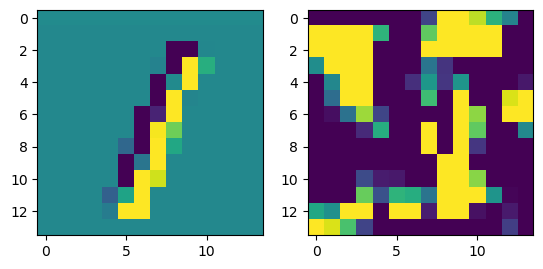

prediction: tensor([0, 3, 6]), tensor([5.3014, 0.7920, 0.7838]) groudtruth: 0
-0.072396934 0.057652995


<Figure size 640x480 with 0 Axes>

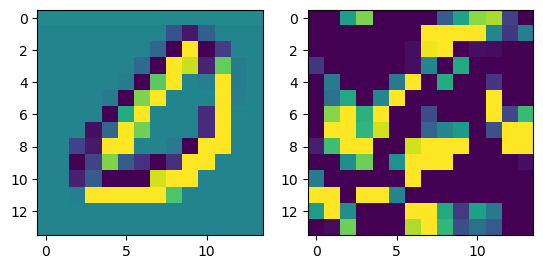

prediction: tensor([6, 2, 1]), tensor([5.7050, 0.8091, 0.6362]) groudtruth: 6
-0.083737135 0.08337928


<Figure size 640x480 with 0 Axes>

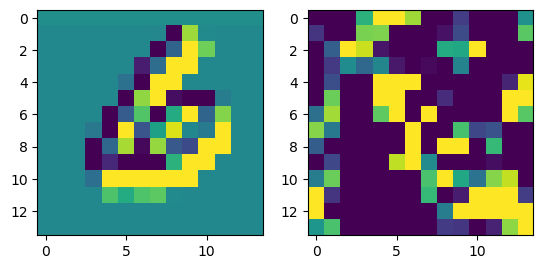

prediction: tensor([5, 3, 2]), tensor([5.6713, 2.5724, 1.6538]) groudtruth: 5
-0.063213885 0.09157291


<Figure size 640x480 with 0 Axes>

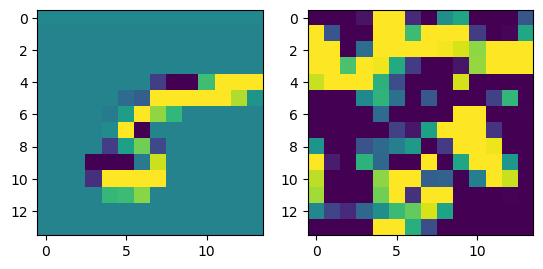

prediction: tensor([6, 9, 0]), tensor([4.4398, 1.9675, 0.6791]) groudtruth: 6
-0.056283414 0.08026352


<Figure size 640x480 with 0 Axes>

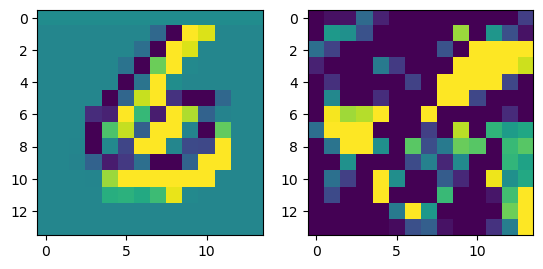

prediction: tensor([7, 9, 6]), tensor([4.3666, 1.6941, 1.3416]) groudtruth: 7
-0.065107405 0.10138421


<Figure size 640x480 with 0 Axes>

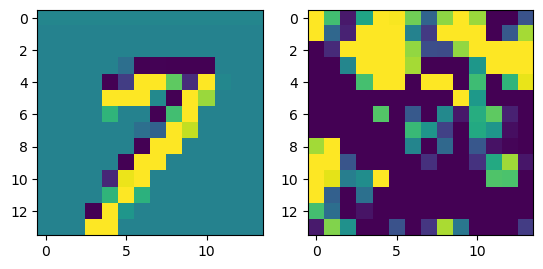

prediction: tensor([3, 8, 5]), tensor([3.6293, 3.4127, 2.5811]) groudtruth: 8
-0.06658411 0.095970705


<Figure size 640x480 with 0 Axes>

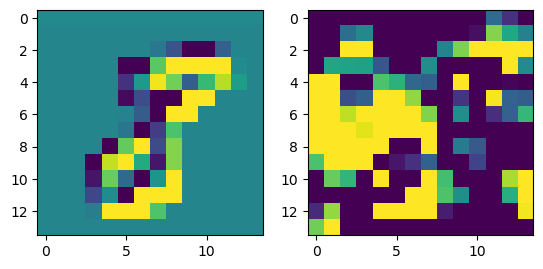

prediction: tensor([9, 5, 2]), tensor([2.0421, 1.7945, 1.1991]) groudtruth: 9
-0.07786518 0.10782436


<Figure size 640x480 with 0 Axes>

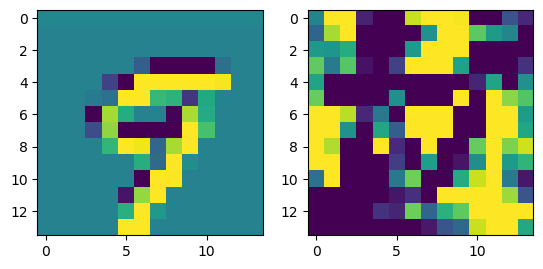

prediction: tensor([8, 9, 2]), tensor([4.3602, 1.3735, 1.3035]) groudtruth: 8
-0.087387025 0.063663915


<Figure size 640x480 with 0 Axes>

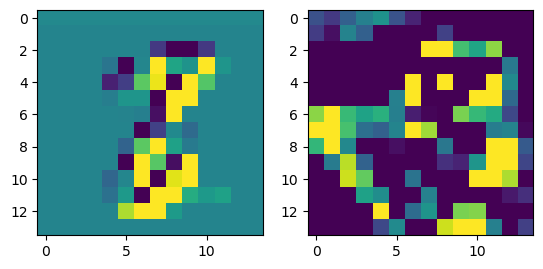

prediction: tensor([6, 5, 1]), tensor([2.9736, 1.3653, 0.9340]) groudtruth: 3
-0.09668571 0.09869304


<Figure size 640x480 with 0 Axes>

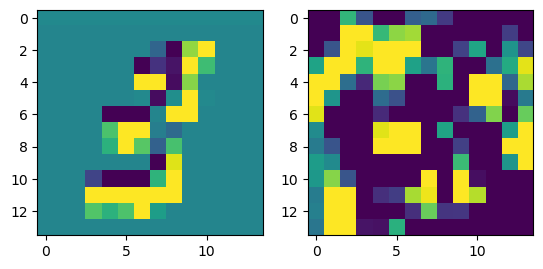

prediction: tensor([4, 9, 7]), tensor([5.4107, 1.3986, 0.7429]) groudtruth: 4
-0.07607412 0.086333096


<Figure size 640x480 with 0 Axes>

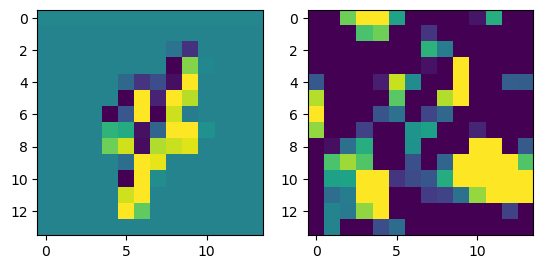

prediction: tensor([7, 6, 3]), tensor([3.4165, 1.4116, 1.0544]) groudtruth: 7
-0.10117078 0.10520193


<Figure size 640x480 with 0 Axes>

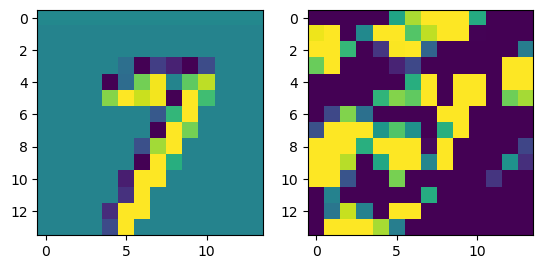

prediction: tensor([8, 2, 5]), tensor([3.4968, 2.5920, 1.1951]) groudtruth: 8
-0.06898743 0.08209944


<Figure size 640x480 with 0 Axes>

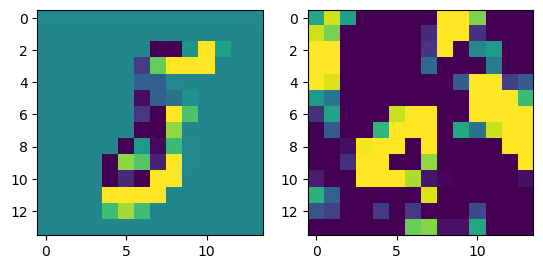

prediction: tensor([6, 3, 2]), tensor([4.4290, 1.3781, 1.1321]) groudtruth: 6
-0.08989936 0.07964834


<Figure size 640x480 with 0 Axes>

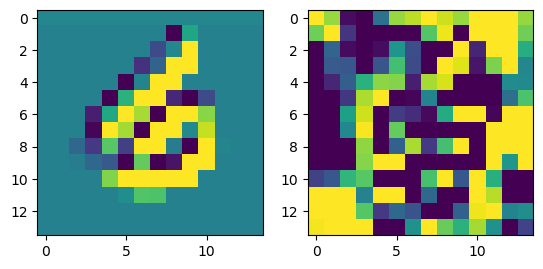

prediction: tensor([8, 2, 3]), tensor([1.7165, 1.3357, 1.2830]) groudtruth: 3
-0.06976026 0.07809292


<Figure size 640x480 with 0 Axes>

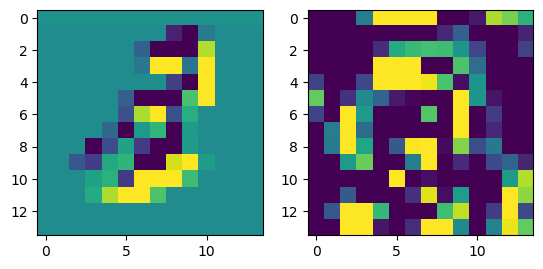

prediction: tensor([4, 6, 7]), tensor([3.2029, 2.3304, 1.2437]) groudtruth: 4
-0.10194141 0.099038735


<Figure size 640x480 with 0 Axes>

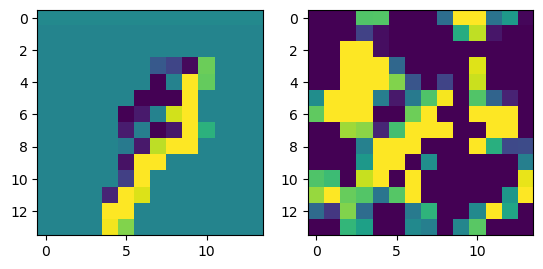

prediction: tensor([0, 1, 3]), tensor([5.4929, 0.9703, 0.3117]) groudtruth: 0
-0.062177062 0.0995014


<Figure size 640x480 with 0 Axes>

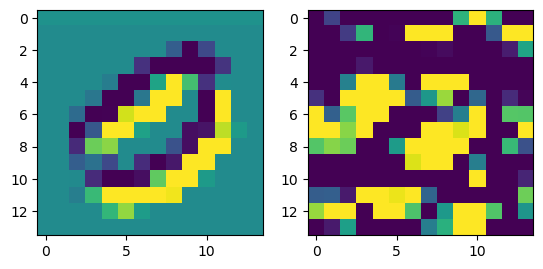

prediction: tensor([9, 3, 4]), tensor([3.4890, 2.5938, 1.9105]) groudtruth: 9
-0.06096989 0.08023529


<Figure size 640x480 with 0 Axes>

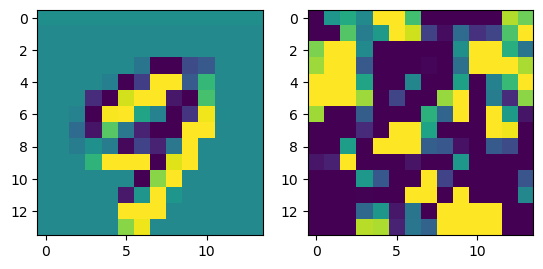

prediction: tensor([7, 3, 5]), tensor([4.7826, 0.8608, 0.4087]) groudtruth: 7
-0.087602556 0.07977882


<Figure size 640x480 with 0 Axes>

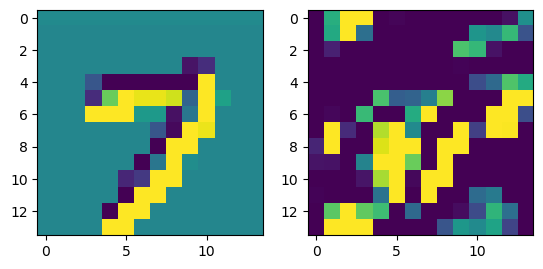

prediction: tensor([2, 6, 8]), tensor([5.7234, 2.0026, 1.4840]) groudtruth: 2
-0.06865066 0.06987615


<Figure size 640x480 with 0 Axes>

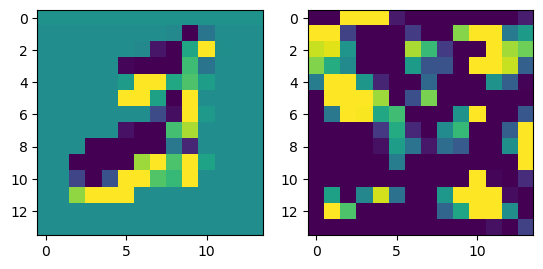

prediction: tensor([9, 6, 7]), tensor([2.7953, 1.6751, 1.6461]) groudtruth: 7
-0.1104725 0.07051785


<Figure size 640x480 with 0 Axes>

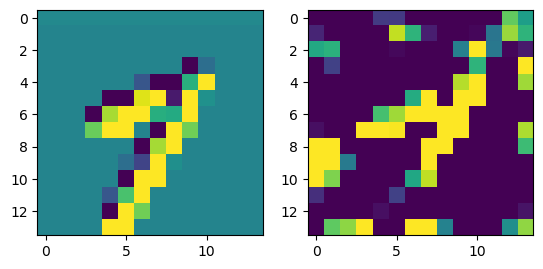

prediction: tensor([7, 9, 8]), tensor([3.5574, 2.2263, 0.3873]) groudtruth: 7
-0.08741605 0.068388045


<Figure size 640x480 with 0 Axes>

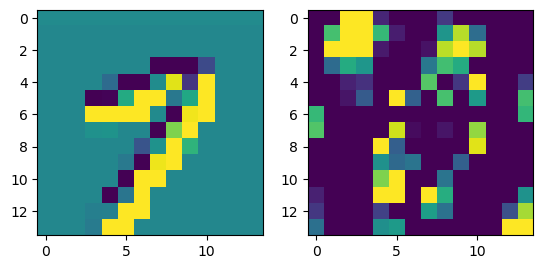

prediction: tensor([4, 7, 3]), tensor([3.7058, 2.0787, 0.8578]) groudtruth: 4
-0.07623464 0.086714335


<Figure size 640x480 with 0 Axes>

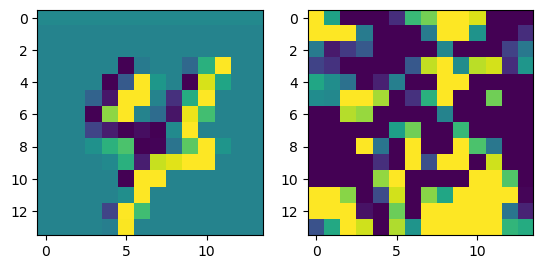

prediction: tensor([0, 7, 2]), tensor([ 8.9777,  0.4721, -0.0698]) groudtruth: 0
-0.0774588 0.07911648


<Figure size 640x480 with 0 Axes>

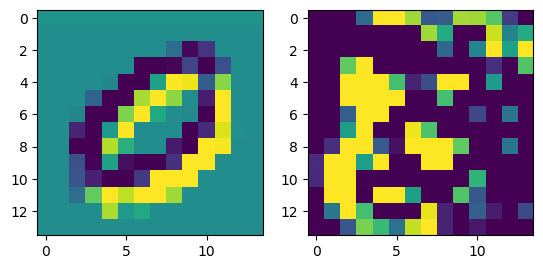

prediction: tensor([2, 3, 8]), tensor([5.5061, 0.7195, 0.2518]) groudtruth: 2
-0.097483456 0.0860429


<Figure size 640x480 with 0 Axes>

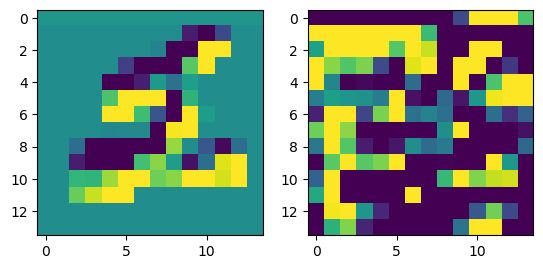

prediction: tensor([4, 1, 3]), tensor([5.2364, 2.3201, 1.2335]) groudtruth: 4
-0.07192969 0.08321488


<Figure size 640x480 with 0 Axes>

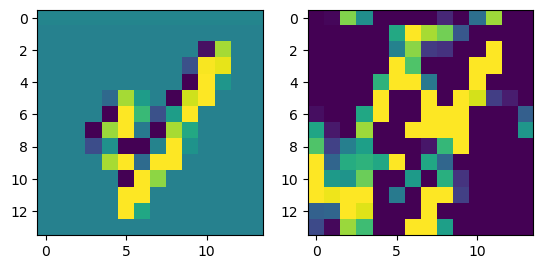

prediction: tensor([2, 8, 9]), tensor([4.8062, 2.5745, 0.5122]) groudtruth: 2
-0.06187874 0.06685233


<Figure size 640x480 with 0 Axes>

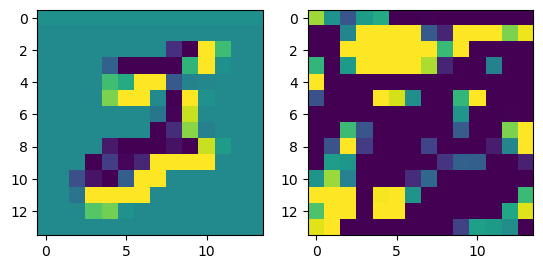

prediction: tensor([1, 4, 6]), tensor([5.8820, 1.6429, 0.8308]) groudtruth: 1
-0.091816664 0.10116743


<Figure size 640x480 with 0 Axes>

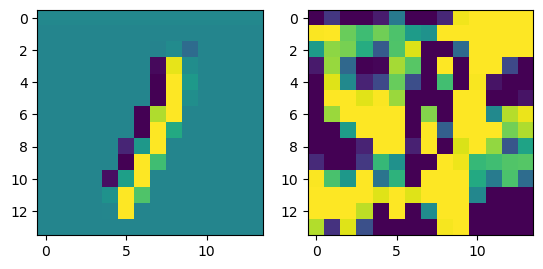

prediction: tensor([8, 5, 0]), tensor([3.7127, 2.2034, 1.7470]) groudtruth: 8
-0.08321494 0.06608441


<Figure size 640x480 with 0 Axes>

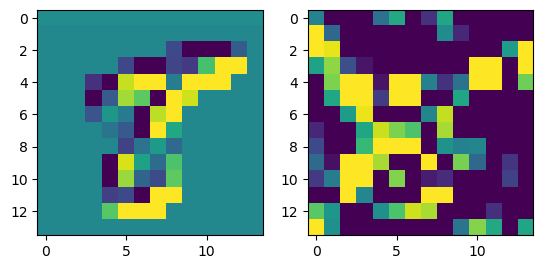

prediction: tensor([9, 2, 7]), tensor([4.2214, 1.4750, 1.4633]) groudtruth: 9
-0.06727666 0.08348328


<Figure size 640x480 with 0 Axes>

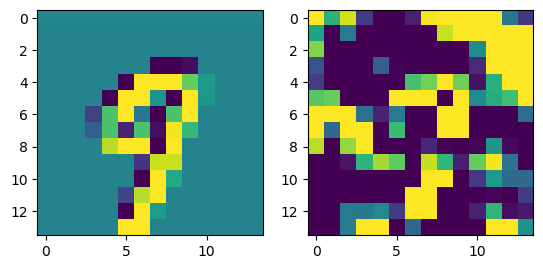

prediction: tensor([6, 5, 8]), tensor([7.3488e+00, 1.0970e+00, 3.4190e-03]) groudtruth: 6
-0.06793052 0.057778165


<Figure size 640x480 with 0 Axes>

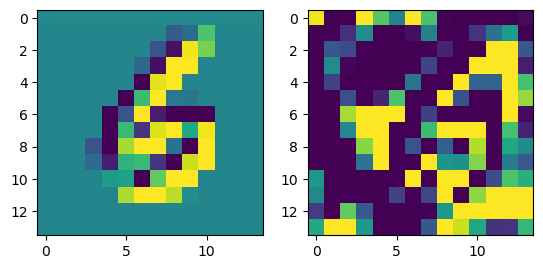

prediction: tensor([1, 7, 0]), tensor([2.5386, 1.2635, 1.0167]) groudtruth: 1
-0.09653354 0.10325008


<Figure size 640x480 with 0 Axes>

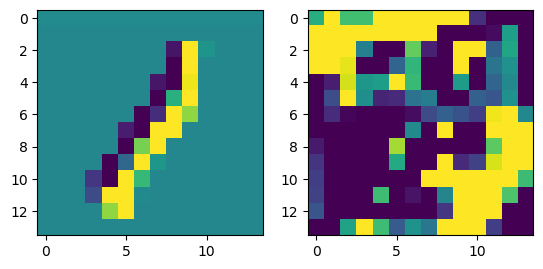

prediction: tensor([0, 1, 5]), tensor([7.9284, 1.1108, 0.1938]) groudtruth: 0
-0.1093992 0.10944907


<Figure size 640x480 with 0 Axes>

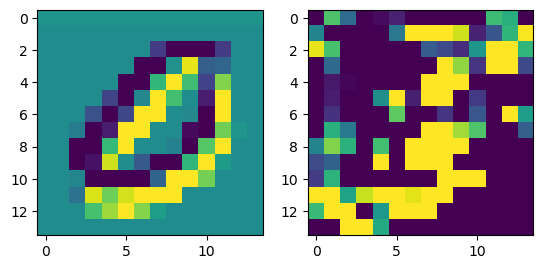

prediction: tensor([5, 8, 9]), tensor([3.8664, 1.9822, 1.4871]) groudtruth: 5
-0.089482605 0.09742817


<Figure size 640x480 with 0 Axes>

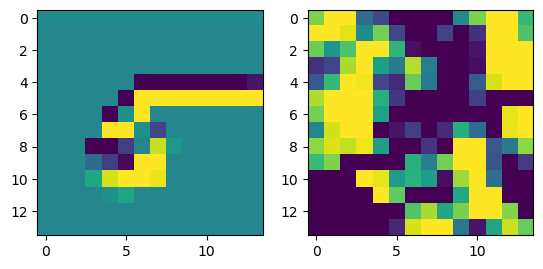

prediction: tensor([9, 4, 2]), tensor([2.9508, 1.4386, 1.4157]) groudtruth: 9
-0.08545083 0.07607786


<Figure size 640x480 with 0 Axes>

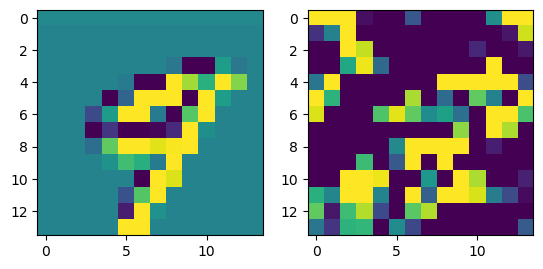

prediction: tensor([8, 2, 9]), tensor([4.1369, 3.9880, 1.2830]) groudtruth: 8
-0.11949706 0.07125418


<Figure size 640x480 with 0 Axes>

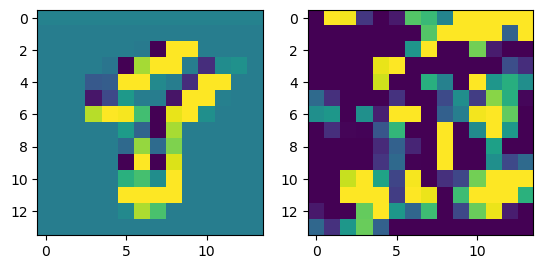

prediction: tensor([3, 5, 2]), tensor([3.7248, 1.6995, 1.3821]) groudtruth: 3
-0.08614999 0.09444168


<Figure size 640x480 with 0 Axes>

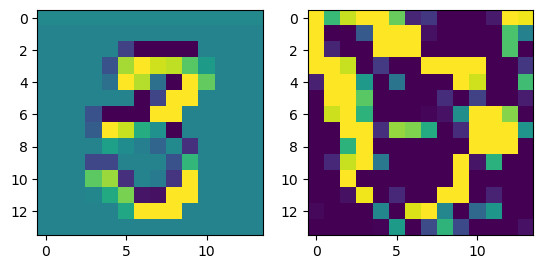

prediction: tensor([1, 6, 8]), tensor([6.6312, 1.4737, 0.4523]) groudtruth: 1
-0.07682294 0.113312855


<Figure size 640x480 with 0 Axes>

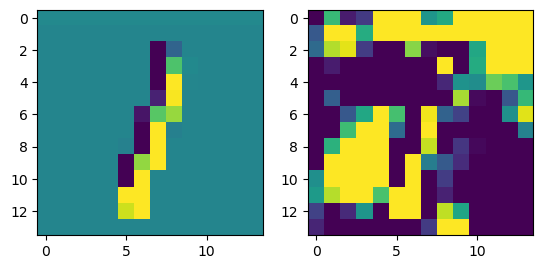

prediction: tensor([9, 5, 8]), tensor([4.9387, 4.8922, 3.2083]) groudtruth: 5
-0.06457448 0.087730356


<Figure size 640x480 with 0 Axes>

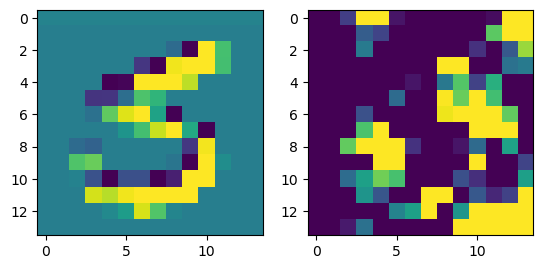

prediction: tensor([8, 2, 9]), tensor([4.6967, 2.9115, 1.0015]) groudtruth: 8
-0.065481365 0.07941913


<Figure size 640x480 with 0 Axes>

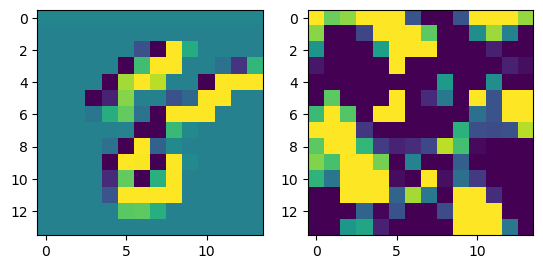

prediction: tensor([2, 0, 3]), tensor([4.5407, 0.8868, 0.8839]) groudtruth: 2
-0.08195788 0.071571596


<Figure size 640x480 with 0 Axes>

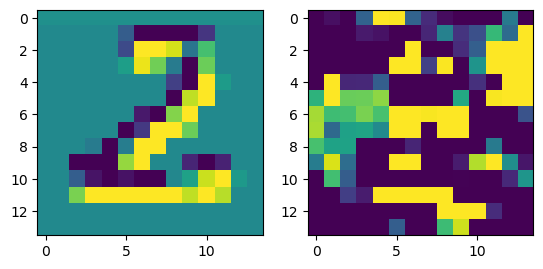

prediction: tensor([7, 6, 1]), tensor([2.7850, 2.5427, 2.4108]) groudtruth: 7
-0.08313751 0.10722663


<Figure size 640x480 with 0 Axes>

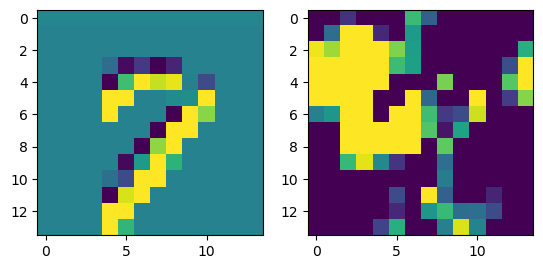

prediction: tensor([4, 1, 7]), tensor([6.8809, 2.4152, 1.5799]) groudtruth: 4
-0.1140722 0.107753605


<Figure size 640x480 with 0 Axes>

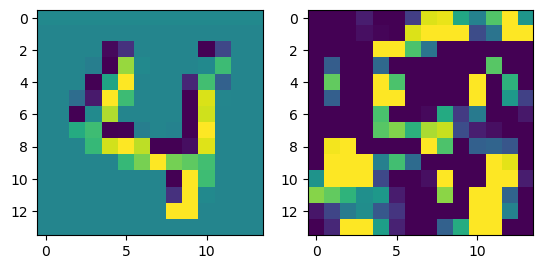

prediction: tensor([2, 1, 8]), tensor([5.0550, 1.9771, 1.5412]) groudtruth: 2
-0.12843531 0.14445037


<Figure size 640x480 with 0 Axes>

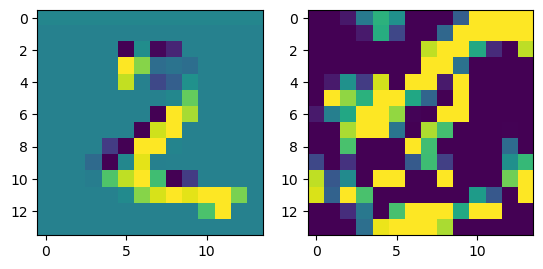

prediction: tensor([1, 7, 4]), tensor([5.7011, 2.2446, 0.8197]) groudtruth: 1
-0.0899272 0.1295908


<Figure size 640x480 with 0 Axes>

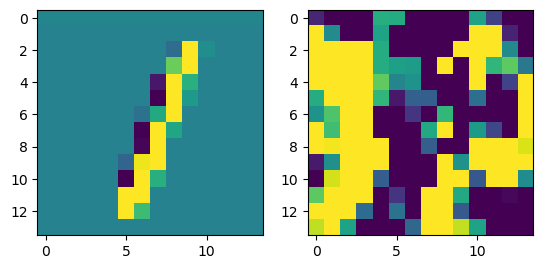

prediction: tensor([5, 3, 9]), tensor([ 5.3399,  3.3692, -0.1703]) groudtruth: 5
-0.060914576 0.08001455


<Figure size 640x480 with 0 Axes>

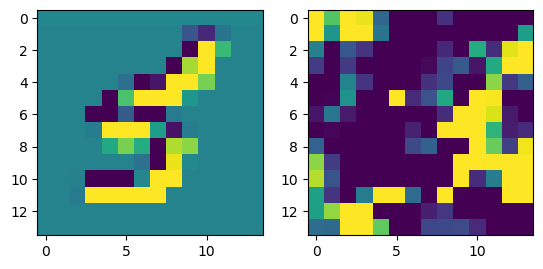

prediction: tensor([4, 9, 7]), tensor([5.9953, 2.0113, 0.7486]) groudtruth: 4
-0.06652427 0.10106118


<Figure size 640x480 with 0 Axes>

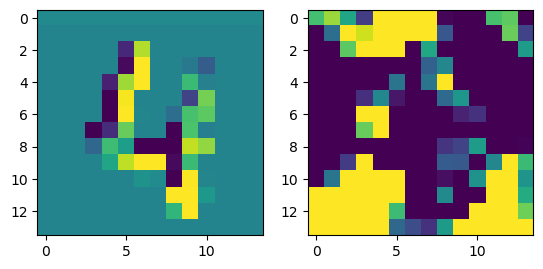

prediction: tensor([5, 3, 1]), tensor([4.0117, 3.3162, 1.4483]) groudtruth: 5
-0.06587118 0.08865369


<Figure size 640x480 with 0 Axes>

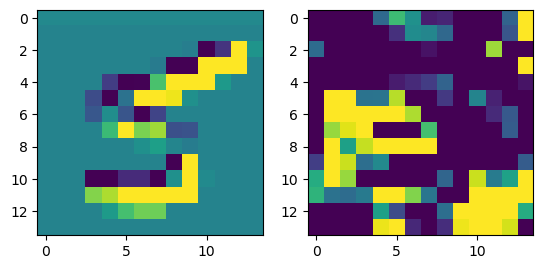

prediction: tensor([5, 8, 3]), tensor([5.9831, 3.8617, 3.3725]) groudtruth: 5
-0.093393385 0.09047564


<Figure size 640x480 with 0 Axes>

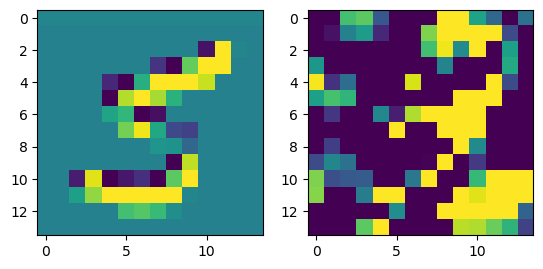

prediction: tensor([8, 9, 5]), tensor([4.7792, 2.0723, 0.5460]) groudtruth: 8
-0.07703382 0.10736674


<Figure size 640x480 with 0 Axes>

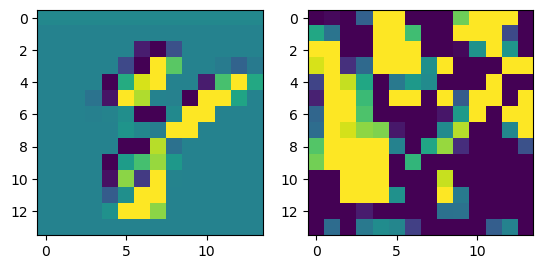

prediction: tensor([6, 0, 3]), tensor([2.3601, 2.0009, 1.7145]) groudtruth: 6
-0.097052574 0.07450223


<Figure size 640x480 with 0 Axes>

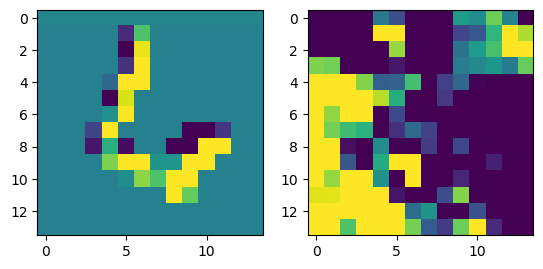

prediction: tensor([3, 9, 2]), tensor([3.1067, 1.4857, 1.2213]) groudtruth: 3
-0.092978954 0.06667009


<Figure size 640x480 with 0 Axes>

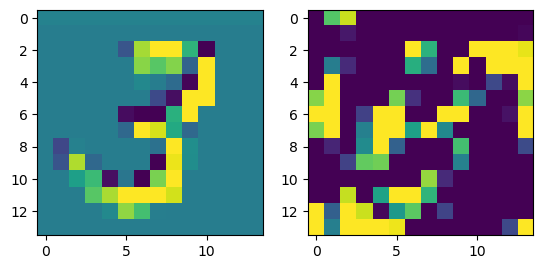

prediction: tensor([0, 3, 4]), tensor([3.5087, 1.2573, 1.1719]) groudtruth: 0
-0.104518175 0.08252707


<Figure size 640x480 with 0 Axes>

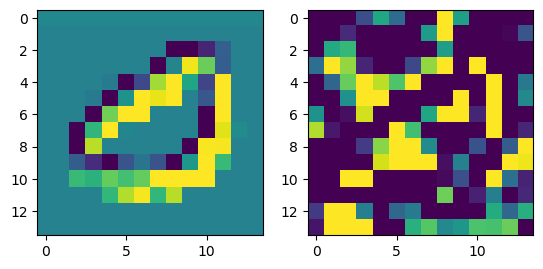

prediction: tensor([9, 2, 8]), tensor([3.5220, 3.2887, 1.1849]) groudtruth: 2
-0.07542378 0.0711408


<Figure size 640x480 with 0 Axes>

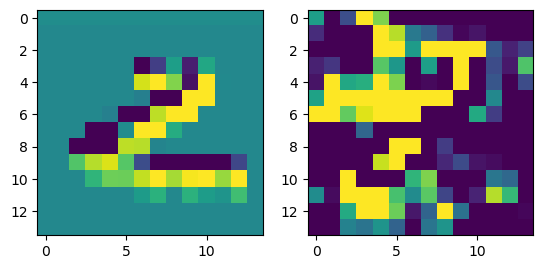

prediction: tensor([0, 8, 2]), tensor([3.9993, 2.3462, 0.9520]) groudtruth: 0
-0.09775084 0.07493951


<Figure size 640x480 with 0 Axes>

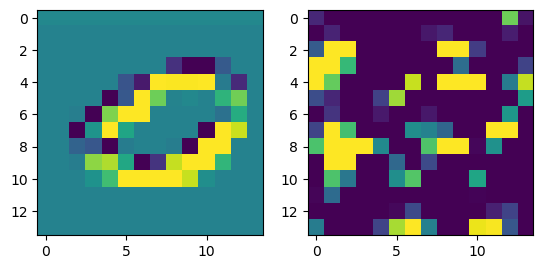

prediction: tensor([1, 2, 6]), tensor([2.6005, 1.5655, 1.0814]) groudtruth: 1
-0.08881867 0.06923154


<Figure size 640x480 with 0 Axes>

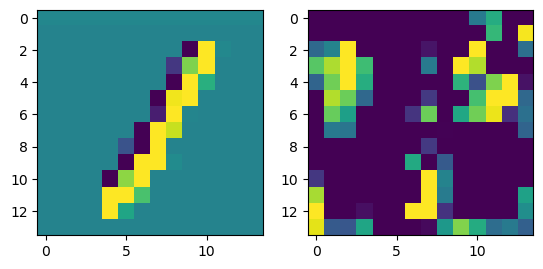

prediction: tensor([0, 2, 7]), tensor([5.3283, 2.8940, 1.8786]) groudtruth: 0
-0.07556641 0.07493663


<Figure size 640x480 with 0 Axes>

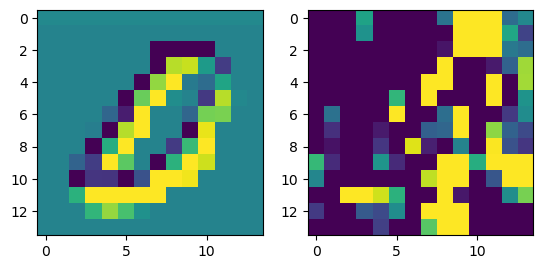

prediction: tensor([1, 6, 2]), tensor([ 4.2608,  0.6539, -0.1818]) groudtruth: 1
-0.07388693 0.065892346


<Figure size 640x480 with 0 Axes>

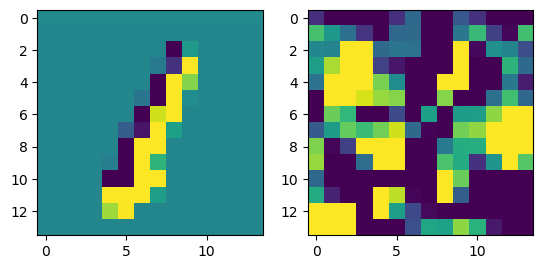

prediction: tensor([0, 1, 6]), tensor([5.9241, 0.9113, 0.7313]) groudtruth: 0
-0.0810017 0.09570344


<Figure size 640x480 with 0 Axes>

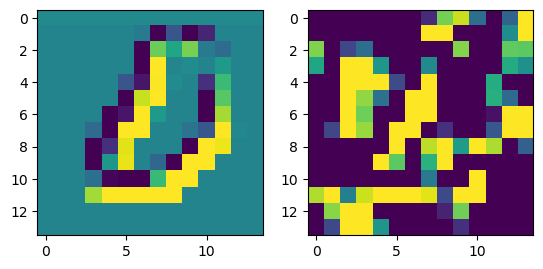

prediction: tensor([4, 7, 2]), tensor([5.3708, 1.9869, 1.0993]) groudtruth: 4
-0.06080115 0.06710385


<Figure size 640x480 with 0 Axes>

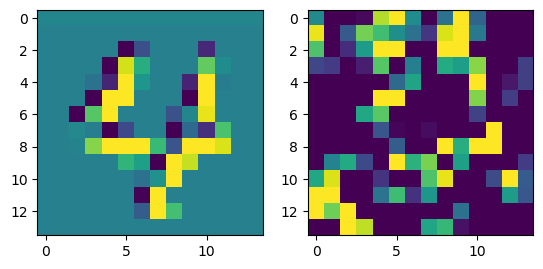

prediction: tensor([0, 6, 2]), tensor([5.5277, 1.5187, 1.1216]) groudtruth: 0
-0.078009605 0.10467249


<Figure size 640x480 with 0 Axes>

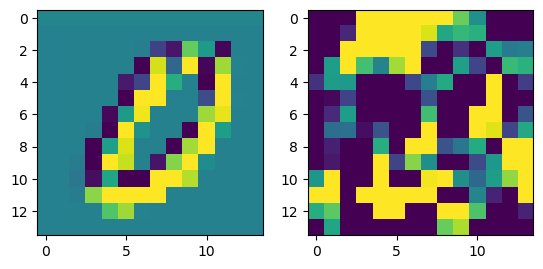

prediction: tensor([1, 7, 4]), tensor([3.1406, 1.9554, 0.5948]) groudtruth: 1
-0.07349026 0.106814176


<Figure size 640x480 with 0 Axes>

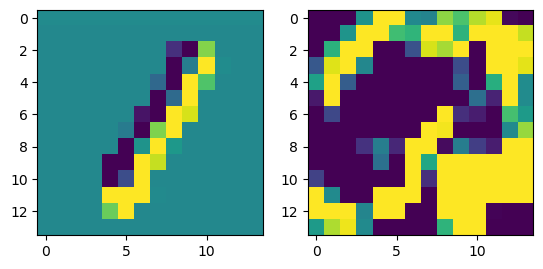

prediction: tensor([0, 8, 2]), tensor([5.7130, 0.8099, 0.7922]) groudtruth: 0
-0.08219653 0.088752076


<Figure size 640x480 with 0 Axes>

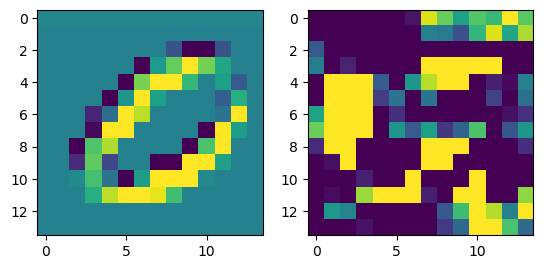

prediction: tensor([4, 9, 0]), tensor([5.0420, 0.9635, 0.7217]) groudtruth: 4
-0.06159997 0.105747834


<Figure size 640x480 with 0 Axes>

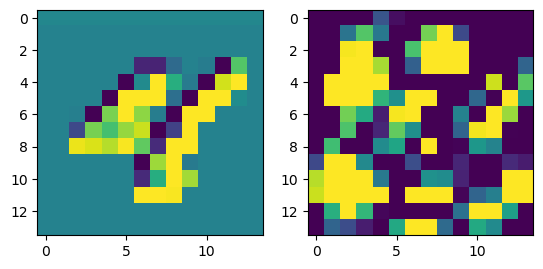

prediction: tensor([7, 9, 2]), tensor([2.8791, 2.0821, 2.0535]) groudtruth: 7
-0.110219836 0.09594427


<Figure size 640x480 with 0 Axes>

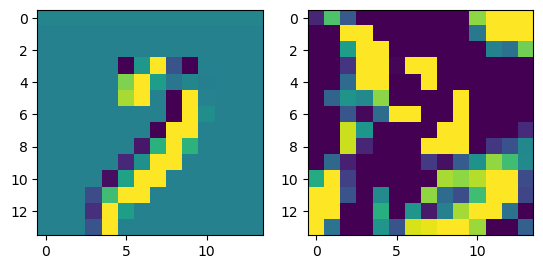

prediction: tensor([9, 3, 5]), tensor([3.8714, 3.0325, 2.9945]) groudtruth: 9
-0.0684734 0.063093


<Figure size 640x480 with 0 Axes>

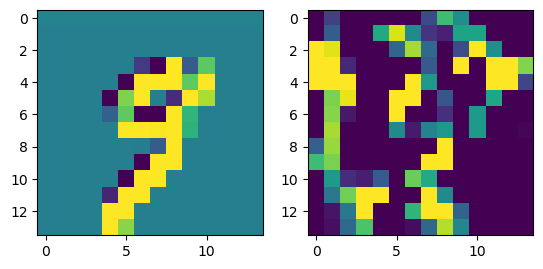

prediction: tensor([6, 4, 5]), tensor([ 4.2998,  0.3016, -0.2948]) groudtruth: 6
-0.08279765 0.08653186


<Figure size 640x480 with 0 Axes>

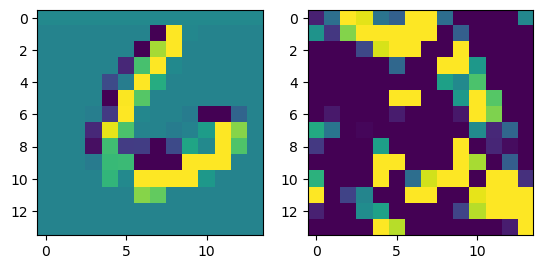

prediction: tensor([4, 5, 1]), tensor([6.6930, 0.5210, 0.4849]) groudtruth: 4
-0.08392793 0.0891723


<Figure size 640x480 with 0 Axes>

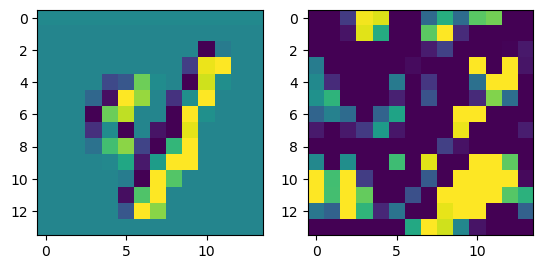

prediction: tensor([7, 0, 8]), tensor([2.9491, 2.0020, 0.1660]) groudtruth: 7
-0.07971877 0.10398121


<Figure size 640x480 with 0 Axes>

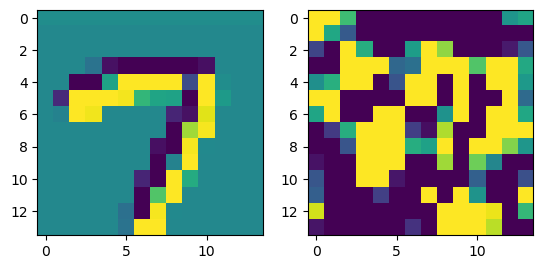

prediction: tensor([1, 7, 8]), tensor([3.6932, 0.9333, 0.5112]) groudtruth: 1
-0.075341165 0.09407337


<Figure size 640x480 with 0 Axes>

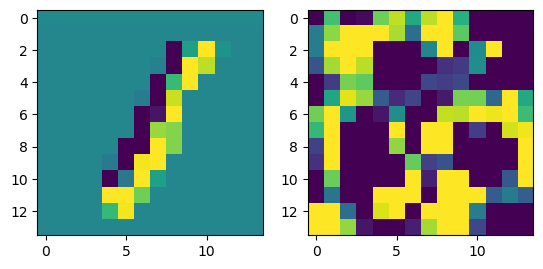

prediction: tensor([8, 9, 6]), tensor([2.3717, 1.7972, 1.7540]) groudtruth: 9
-0.08064717 0.066168174


<Figure size 640x480 with 0 Axes>

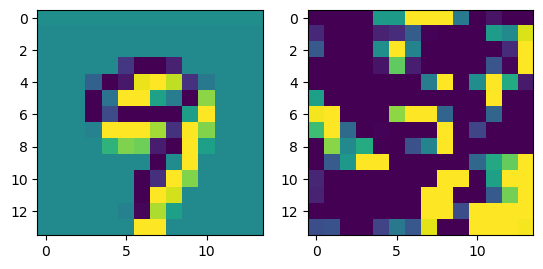

prediction: tensor([1, 7, 9]), tensor([4.5147, 1.6986, 0.5876]) groudtruth: 1
-0.114292085 0.09428458


<Figure size 640x480 with 0 Axes>

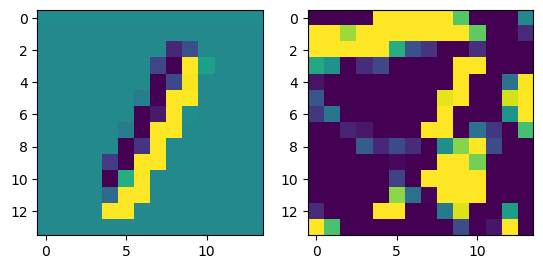

prediction: tensor([7, 9, 0]), tensor([3.8556, 1.2377, 0.9074]) groudtruth: 7
-0.09167659 0.062427223


<Figure size 640x480 with 0 Axes>

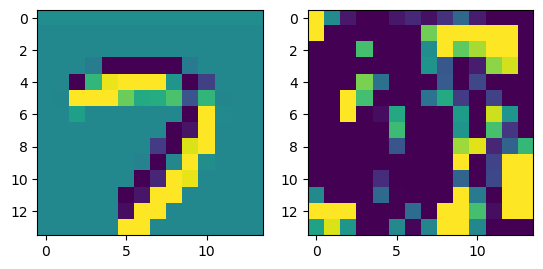

prediction: tensor([1, 8, 6]), tensor([3.7288, 1.7585, 1.5159]) groudtruth: 1
-0.078312516 0.093578786


<Figure size 640x480 with 0 Axes>

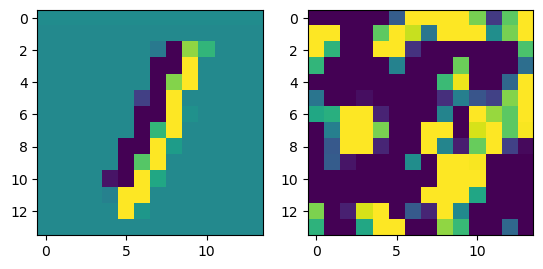

prediction: tensor([4, 8, 9]), tensor([6.1616, 1.5996, 0.2926]) groudtruth: 4
-0.09364772 0.1179691


<Figure size 640x480 with 0 Axes>

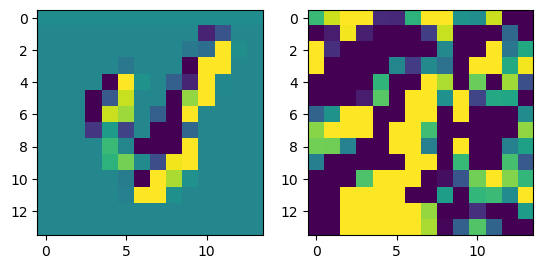

prediction: tensor([0, 7, 8]), tensor([6.3235, 1.0167, 0.2358]) groudtruth: 0
-0.09310132 0.07659206


<Figure size 640x480 with 0 Axes>

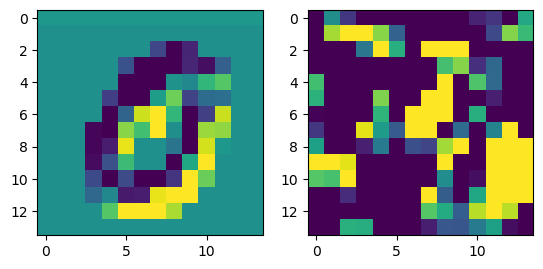

prediction: tensor([0, 8, 2]), tensor([5.0308, 1.8996, 0.4827]) groudtruth: 0
-0.09289074 0.11635493


<Figure size 640x480 with 0 Axes>

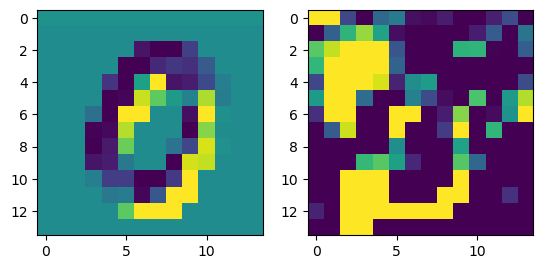

prediction: tensor([4, 5, 3]), tensor([3.9337, 2.1297, 0.9479]) groudtruth: 4
-0.10316008 0.095437795


<Figure size 640x480 with 0 Axes>

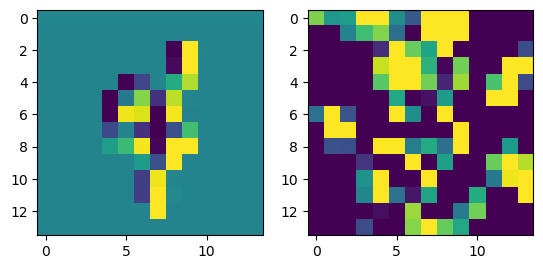

prediction: tensor([1, 7, 4]), tensor([2.6997, 0.9623, 0.8293]) groudtruth: 1
-0.08746117 0.115983464


<Figure size 640x480 with 0 Axes>

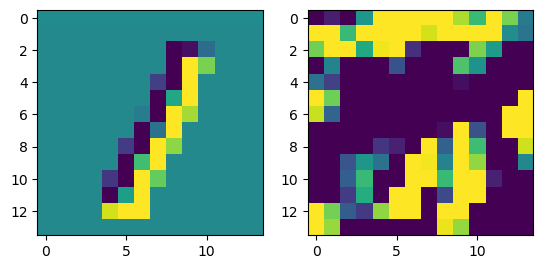

prediction: tensor([9, 7, 6]), tensor([2.5050, 1.7111, 1.1265]) groudtruth: 7
-0.09778041 0.07589346


<Figure size 640x480 with 0 Axes>

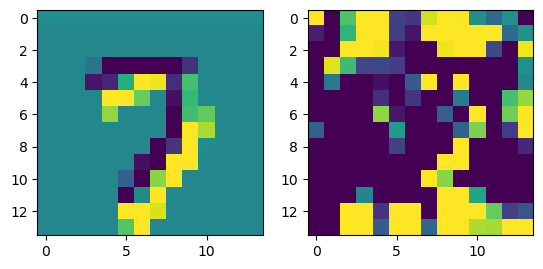

prediction: tensor([5, 3, 7]), tensor([4.8252, 2.2332, 1.7617]) groudtruth: 5
-0.07616961 0.059464313


<Figure size 640x480 with 0 Axes>

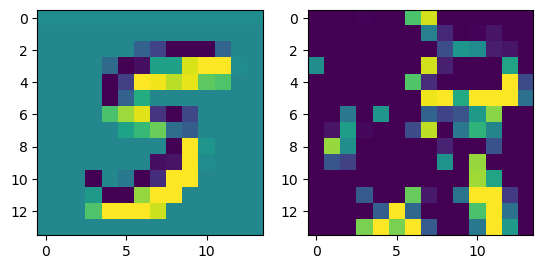

prediction: tensor([7, 6, 0]), tensor([3.4704, 1.4324, 0.5084]) groudtruth: 7
-0.09335488 0.07973936


<Figure size 640x480 with 0 Axes>

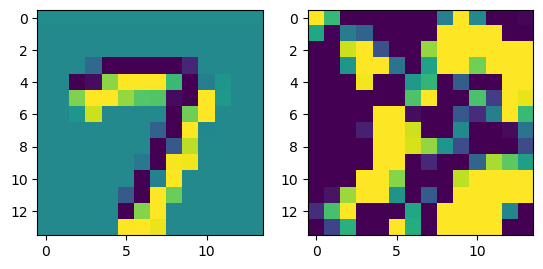

prediction: tensor([1, 8, 2]), tensor([3.3382, 1.8617, 0.2214]) groudtruth: 1
-0.08572978 0.089098066


<Figure size 640x480 with 0 Axes>

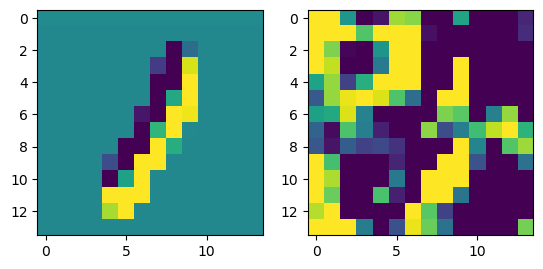

prediction: tensor([9, 8, 3]), tensor([3.7954, 3.5580, 1.8587]) groudtruth: 8
-0.107213855 0.09592068


<Figure size 640x480 with 0 Axes>

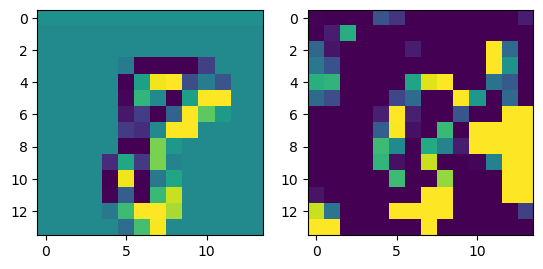

prediction: tensor([9, 7, 3]), tensor([3.5801, 1.6572, 1.0368]) groudtruth: 9
-0.0830639 0.07572967


<Figure size 640x480 with 0 Axes>

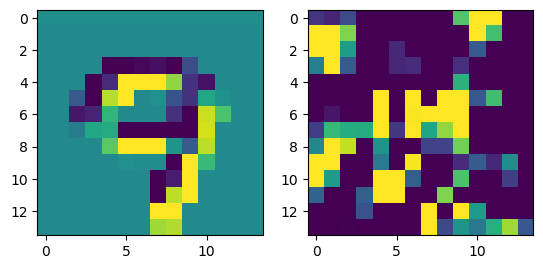

prediction: tensor([6, 9, 8]), tensor([5.1198, 1.5703, 0.5985]) groudtruth: 6
-0.13254225 0.07242724


<Figure size 640x480 with 0 Axes>

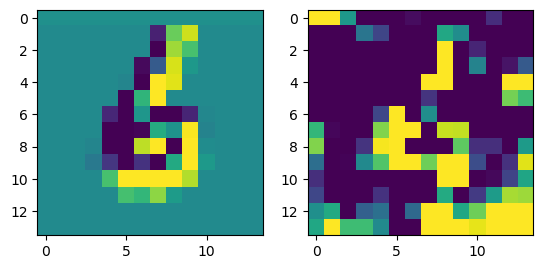

prediction: tensor([8, 9, 4]), tensor([3.2213, 0.8229, 0.5459]) groudtruth: 8
-0.06807393 0.06383814


<Figure size 640x480 with 0 Axes>

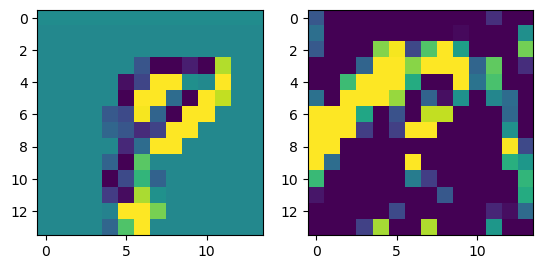

prediction: tensor([9, 7, 8]), tensor([3.4187, 1.6280, 0.8924]) groudtruth: 8
-0.08920318 0.07784871


<Figure size 640x480 with 0 Axes>

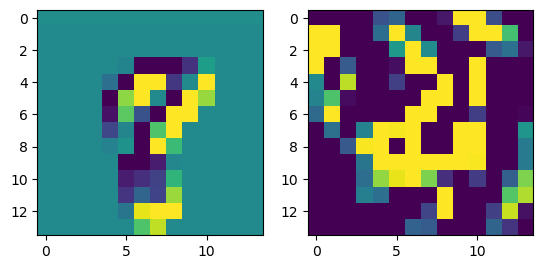

prediction: tensor([1, 2, 7]), tensor([3.5592, 3.2288, 1.6153]) groudtruth: 2
-0.08808583 0.09954514


<Figure size 640x480 with 0 Axes>

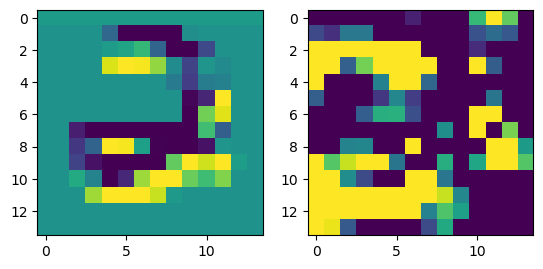

prediction: tensor([9, 3, 4]), tensor([3.6516, 2.9704, 2.0235]) groudtruth: 3
-0.0967747 0.068311885


<Figure size 640x480 with 0 Axes>

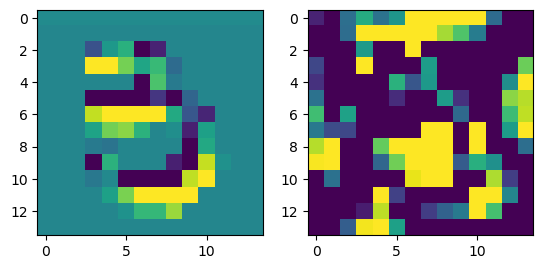

prediction: tensor([6, 8, 7]), tensor([4.2945, 1.4460, 0.6255]) groudtruth: 6
-0.101415515 0.08617751


<Figure size 640x480 with 0 Axes>

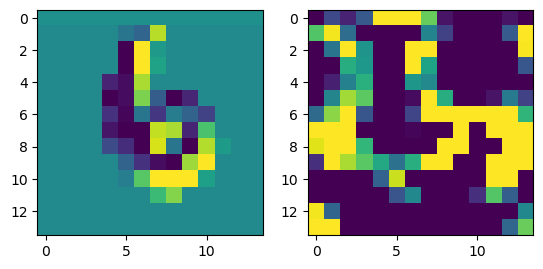

prediction: tensor([1, 4, 6]), tensor([4.9764, 1.2524, 0.5809]) groudtruth: 1
-0.05135578 0.10237073


<Figure size 640x480 with 0 Axes>

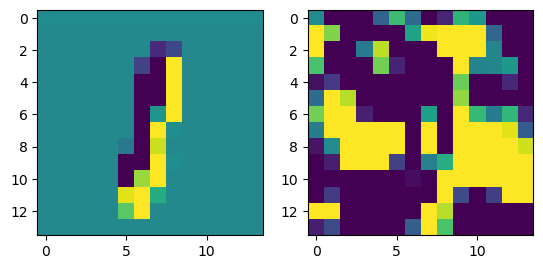

prediction: tensor([2, 7, 4]), tensor([7.2200, 2.4476, 2.0623]) groudtruth: 2
-0.0930087 0.07890397


<Figure size 640x480 with 0 Axes>

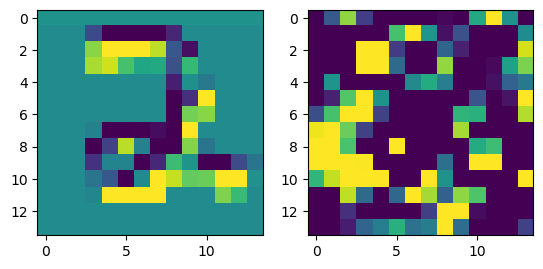

prediction: tensor([9, 6, 2]), tensor([2.7577, 1.2952, 0.7090]) groudtruth: 9
-0.08542979 0.085078


<Figure size 640x480 with 0 Axes>

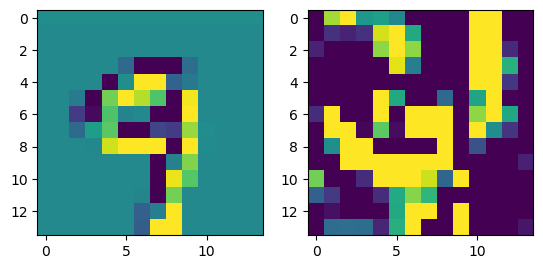

prediction: tensor([8, 5, 3]), tensor([3.3146, 1.1848, 0.3596]) groudtruth: 8
-0.07585633 0.08626167


<Figure size 640x480 with 0 Axes>

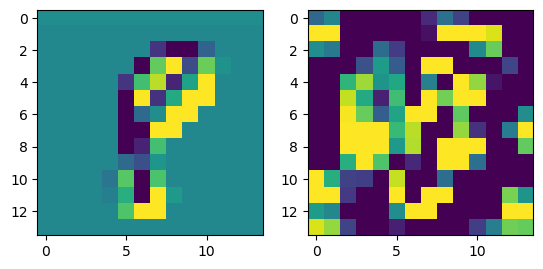

prediction: tensor([9, 1, 6]), tensor([2.8878, 1.5319, 0.5823]) groudtruth: 9
-0.090943694 0.07116913


<Figure size 640x480 with 0 Axes>

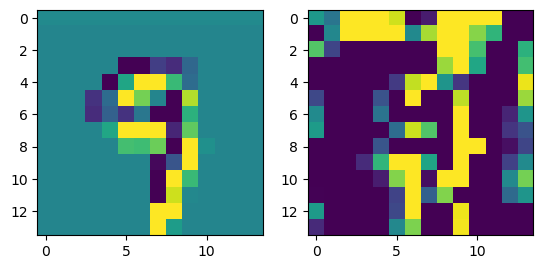

prediction: tensor([5, 8, 3]), tensor([5.9292, 1.9704, 1.4816]) groudtruth: 5
-0.07422346 0.082264766


<Figure size 640x480 with 0 Axes>

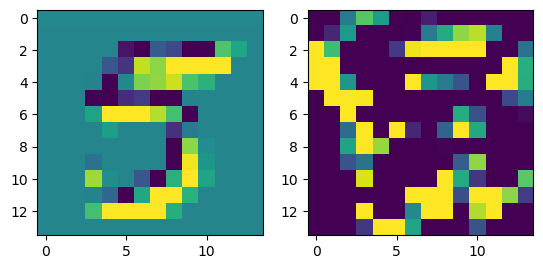

prediction: tensor([2, 9, 4]), tensor([4.3610, 2.2140, 1.3663]) groudtruth: 2
-0.111202955 0.11639412


<Figure size 640x480 with 0 Axes>

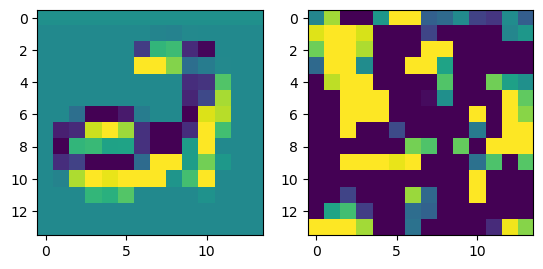

prediction: tensor([6, 2, 0]), tensor([3.6294, 1.5857, 0.8565]) groudtruth: 6
-0.0770244 0.068044


<Figure size 640x480 with 0 Axes>

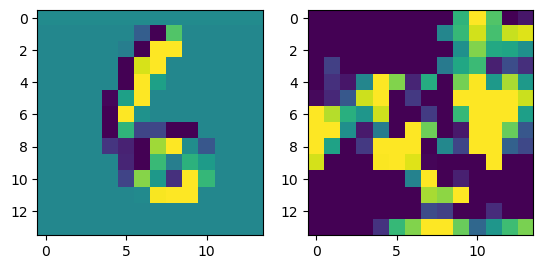

prediction: tensor([4, 7, 9]), tensor([6.1535, 2.6396, 1.4709]) groudtruth: 4
-0.091860116 0.09951731


<Figure size 640x480 with 0 Axes>

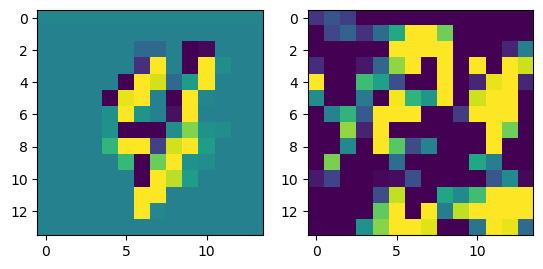

prediction: tensor([6, 7, 3]), tensor([3.5621, 1.7171, 1.4788]) groudtruth: 6
-0.06560683 0.09071176


<Figure size 640x480 with 0 Axes>

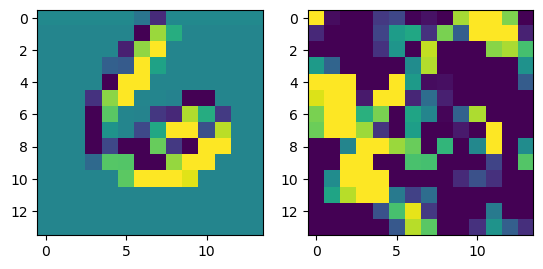

prediction: tensor([1, 8, 9]), tensor([4.6892, 0.5126, 0.4508]) groudtruth: 1
-0.07039839 0.08400149


<Figure size 640x480 with 0 Axes>

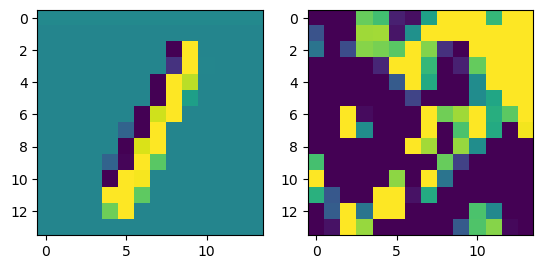

prediction: tensor([0, 7, 5]), tensor([5.9798, 2.7285, 0.5904]) groudtruth: 0
-0.08560616 0.0724205


<Figure size 640x480 with 0 Axes>

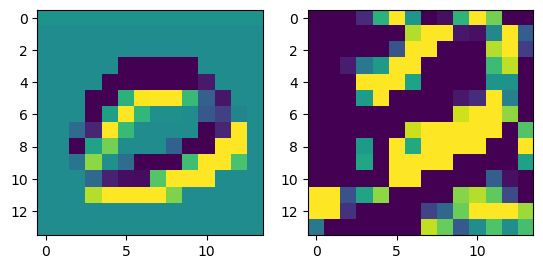

prediction: tensor([4, 6, 8]), tensor([4.4498, 3.1251, 1.3741]) groudtruth: 4
-0.0812251 0.08688943


<Figure size 640x480 with 0 Axes>

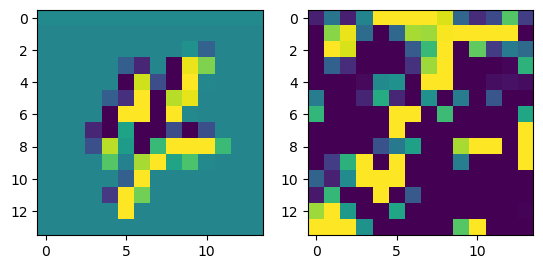

prediction: tensor([5, 0, 6]), tensor([5.1401, 2.4375, 1.6079]) groudtruth: 5
-0.0970602 0.104799345


<Figure size 640x480 with 0 Axes>

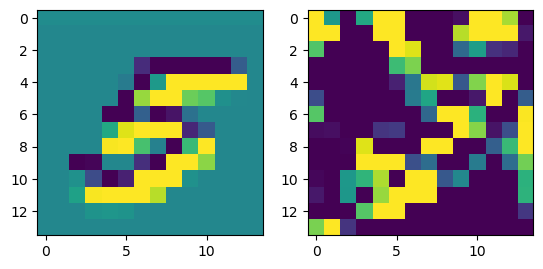

prediction: tensor([3, 5, 9]), tensor([4.0027, 3.3996, 0.8481]) groudtruth: 3
-0.0753389 0.07862522


<Figure size 640x480 with 0 Axes>

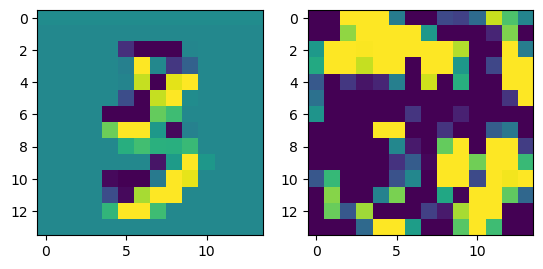

prediction: tensor([9, 7, 4]), tensor([4.7378, 1.8092, 0.0521]) groudtruth: 9
-0.084561765 0.065353334


<Figure size 640x480 with 0 Axes>

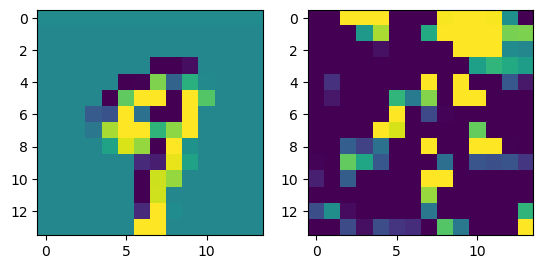

prediction: tensor([4, 2, 7]), tensor([5.9395, 2.9935, 1.4853]) groudtruth: 4
-0.07674241 0.10012725


<Figure size 640x480 with 0 Axes>

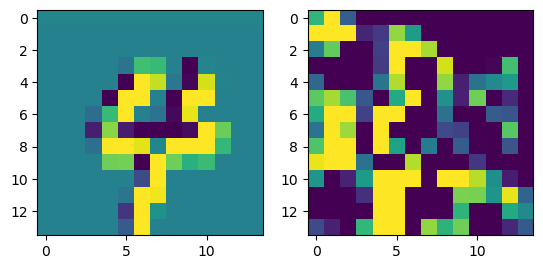

prediction: tensor([9, 5, 7]), tensor([3.9006, 2.2664, 1.4262]) groudtruth: 2
-0.09327799 0.09284203


<Figure size 640x480 with 0 Axes>

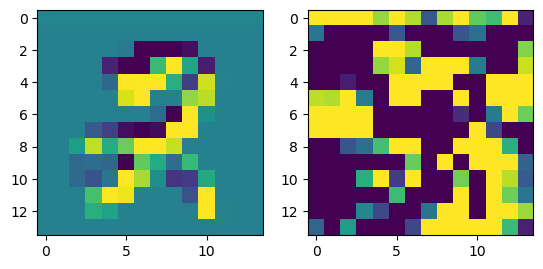

prediction: tensor([0, 8, 3]), tensor([6.2566, 1.3270, 0.3703]) groudtruth: 0
-0.10210723 0.069975235


<Figure size 640x480 with 0 Axes>

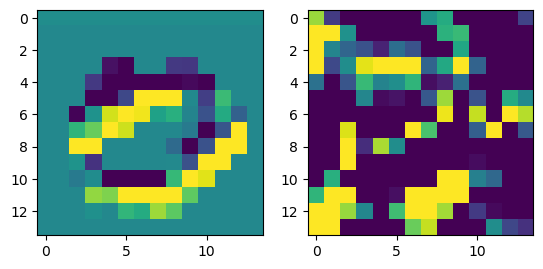

prediction: tensor([5, 3, 7]), tensor([7.3267, 3.4397, 0.0305]) groudtruth: 5
-0.104578376 0.10001737


<Figure size 640x480 with 0 Axes>

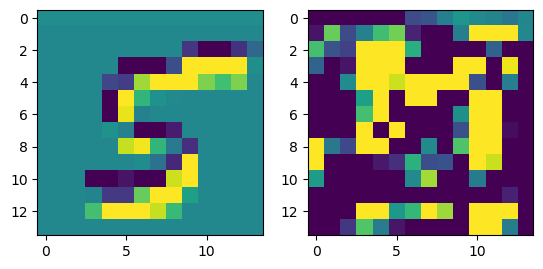

prediction: tensor([0, 7, 9]), tensor([5.8373, 2.6840, 0.3311]) groudtruth: 0
-0.072359264 0.07119188


<Figure size 640x480 with 0 Axes>

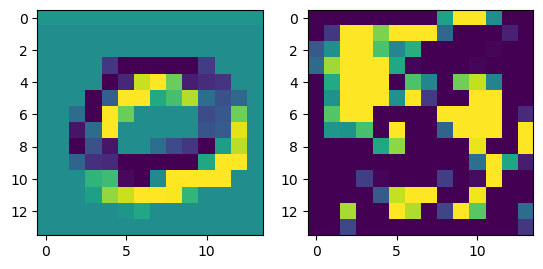

prediction: tensor([1, 7, 4]), tensor([6.2008, 1.7046, 0.5107]) groudtruth: 1
-0.11093807 0.08720322


<Figure size 640x480 with 0 Axes>

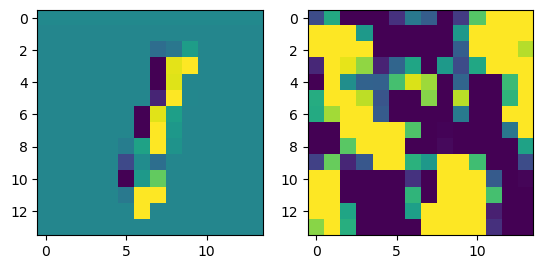

prediction: tensor([3, 8, 2]), tensor([4.1987, 1.9999, 0.8261]) groudtruth: 3
-0.086821854 0.07413937


<Figure size 640x480 with 0 Axes>

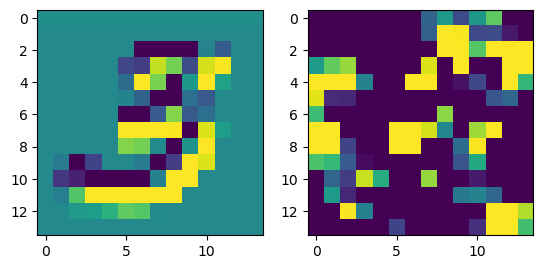

prediction: tensor([2, 7, 4]), tensor([4.9748, 1.2581, 1.0693]) groudtruth: 2
-0.10421032 0.12770915


<Figure size 640x480 with 0 Axes>

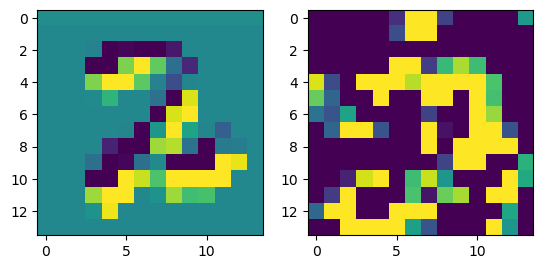

prediction: tensor([3, 9, 5]), tensor([5.0841, 1.5275, 1.0298]) groudtruth: 3
-0.08243811 0.07543142


<Figure size 640x480 with 0 Axes>

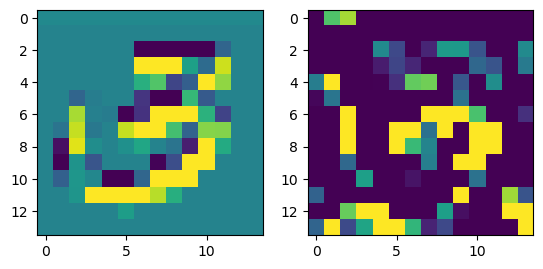

prediction: tensor([0, 8, 6]), tensor([1.8375, 1.6664, 1.1231]) groudtruth: 0
-0.07493174 0.079673596


<Figure size 640x480 with 0 Axes>

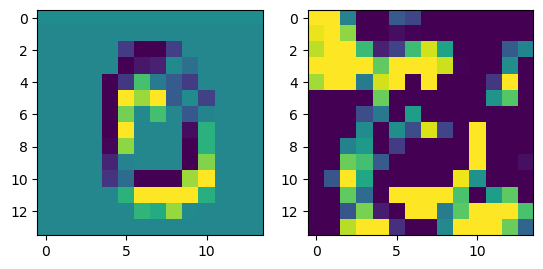

prediction: tensor([1, 2, 3]), tensor([5.1134, 1.0280, 0.8146]) groudtruth: 1
-0.06130737 0.05463832


<Figure size 640x480 with 0 Axes>

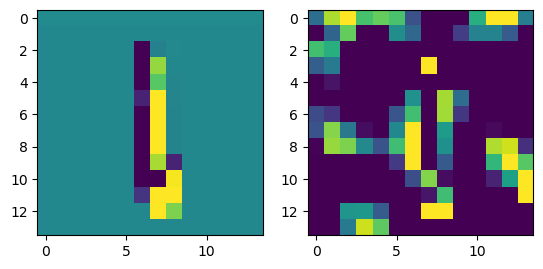

prediction: tensor([2, 6, 9]), tensor([4.5992, 1.8059, 0.8467]) groudtruth: 2
-0.06883991 0.091736004


<Figure size 640x480 with 0 Axes>

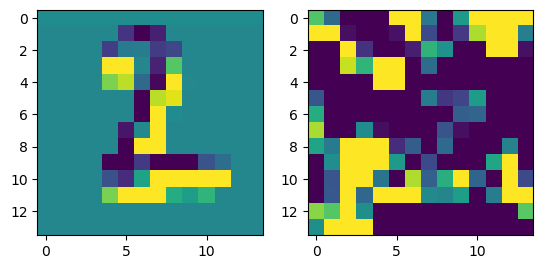

prediction: tensor([3, 9, 7]), tensor([5.8585, 1.0548, 0.3101]) groudtruth: 3
-0.10377407 0.13616668


<Figure size 640x480 with 0 Axes>

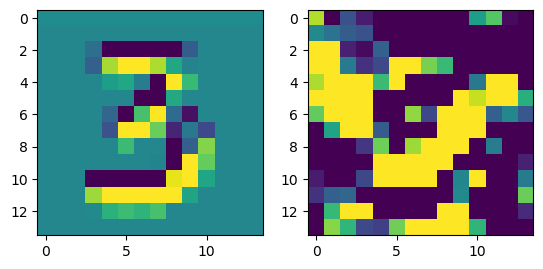

prediction: tensor([4, 7, 9]), tensor([2.9452, 2.2707, 1.1864]) groudtruth: 4
-0.083824575 0.054376967


<Figure size 640x480 with 0 Axes>

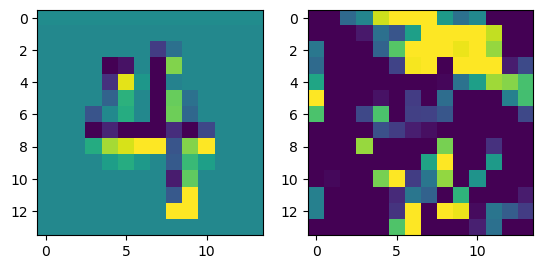

prediction: tensor([5, 8, 6]), tensor([5.3610, 2.3842, 1.4978]) groudtruth: 5
-0.06566644 0.098670825


<Figure size 640x480 with 0 Axes>

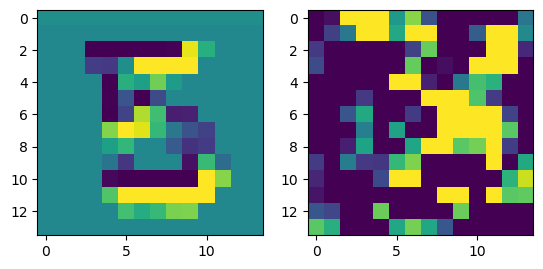

prediction: tensor([6, 8, 1]), tensor([3.1346, 1.5695, 1.5181]) groudtruth: 6
-0.056117177 0.04833866


<Figure size 640x480 with 0 Axes>

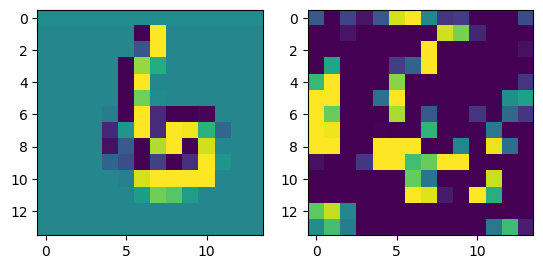

prediction: tensor([7, 9, 2]), tensor([ 4.6107,  2.2547, -0.2503]) groudtruth: 7
-0.111258864 0.10057526


<Figure size 640x480 with 0 Axes>

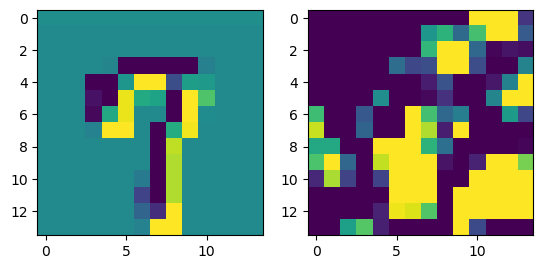

prediction: tensor([0, 5, 6]), tensor([3.9849, 1.3034, 0.7355]) groudtruth: 0
-0.06633371 0.058198515


<Figure size 640x480 with 0 Axes>

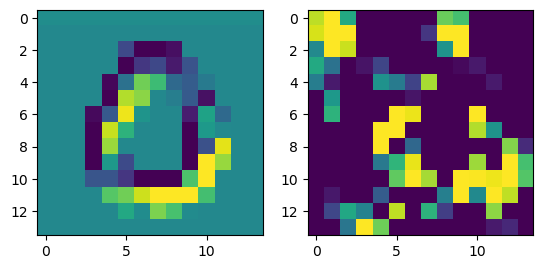

prediction: tensor([1, 2, 3]), tensor([5.3678, 1.3086, 1.3018]) groudtruth: 1
-0.069081366 0.08954023


<Figure size 640x480 with 0 Axes>

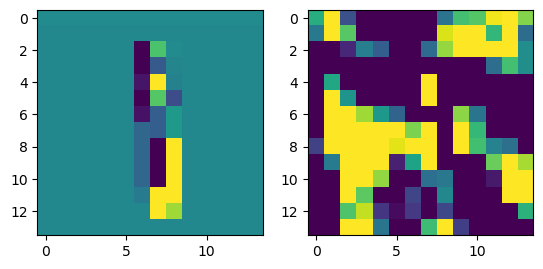

prediction: tensor([2, 6, 7]), tensor([6.0014, 2.2710, 1.6887]) groudtruth: 2
-0.07358104 0.073504195


<Figure size 640x480 with 0 Axes>

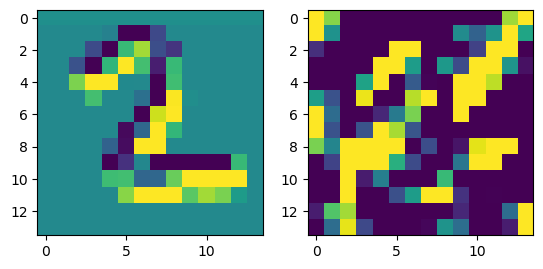

prediction: tensor([3, 9, 5]), tensor([3.5975, 1.8249, 0.7824]) groudtruth: 3
-0.085169196 0.08071419


<Figure size 640x480 with 0 Axes>

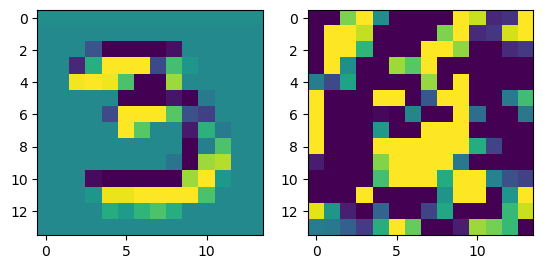

prediction: tensor([4, 9, 7]), tensor([4.6315, 1.7354, 0.9950]) groudtruth: 4
-0.07583648 0.07849607


<Figure size 640x480 with 0 Axes>

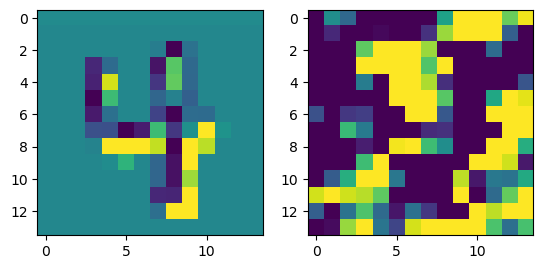

prediction: tensor([8, 5, 6]), tensor([2.6015, 1.8112, 1.6891]) groudtruth: 5
-0.09555787 0.10172975


<Figure size 640x480 with 0 Axes>

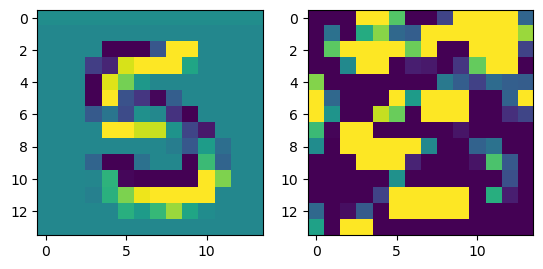

prediction: tensor([0, 7, 9]), tensor([1.4180, 1.4043, 1.3426]) groudtruth: 0
-0.07736021 0.06661892


<Figure size 640x480 with 0 Axes>

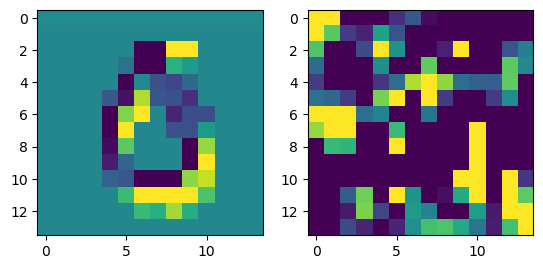

prediction: tensor([6, 1, 7]), tensor([7.0347, 2.5096, 0.8892]) groudtruth: 6
-0.09989178 0.06442715


<Figure size 640x480 with 0 Axes>

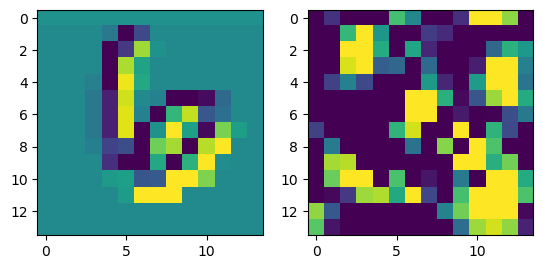

prediction: tensor([8, 5, 0]), tensor([2.7906, 2.4140, 1.2310]) groudtruth: 8
-0.08614731 0.093291774


<Figure size 640x480 with 0 Axes>

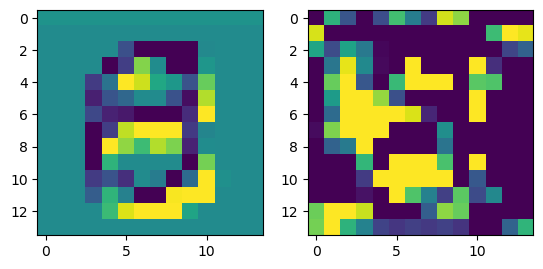

prediction: tensor([5, 9, 8]), tensor([5.5565, 1.1799, 0.9977]) groudtruth: 5
-0.078011036 0.08267207


<Figure size 640x480 with 0 Axes>

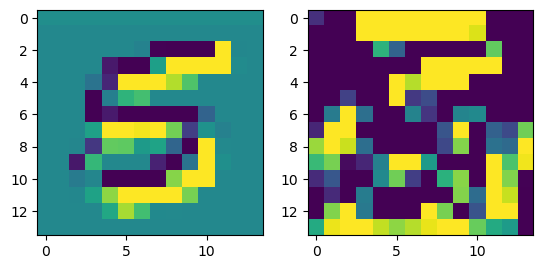

prediction: tensor([5, 9, 8]), tensor([5.7880, 2.1514, 1.8353]) groudtruth: 5
-0.119241536 0.09721219


<Figure size 640x480 with 0 Axes>

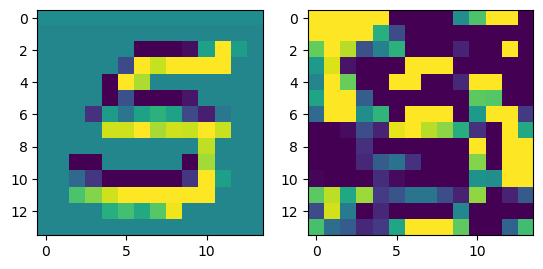

prediction: tensor([5, 8, 6]), tensor([6.2019, 2.9686, 1.0685]) groudtruth: 5
-0.06195301 0.091808215


<Figure size 640x480 with 0 Axes>

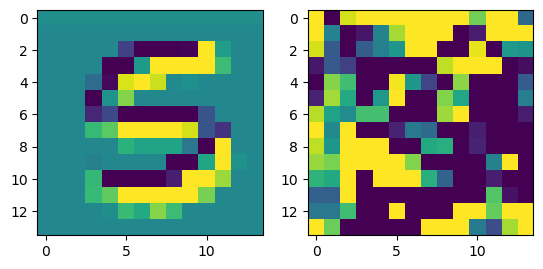

prediction: tensor([3, 7, 5]), tensor([3.6199, 3.6066, 1.6327]) groudtruth: 3
-0.08084345 0.069114946


<Figure size 640x480 with 0 Axes>

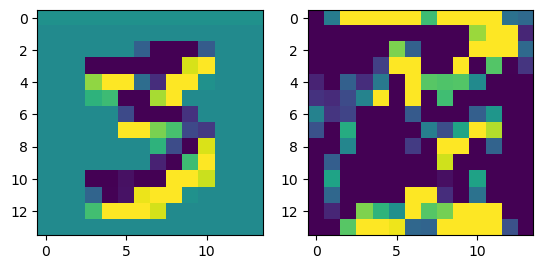

prediction: tensor([5, 8, 1]), tensor([2.7978, 1.5091, 1.3739]) groudtruth: 5
-0.061912417 0.06361434


<Figure size 640x480 with 0 Axes>

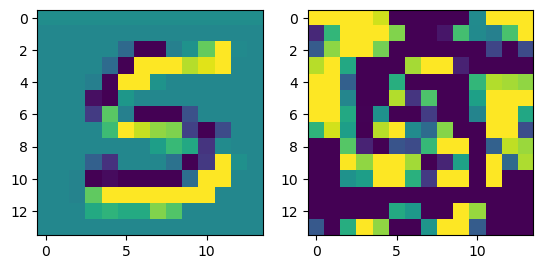

prediction: tensor([9, 7, 2]), tensor([3.5805, 2.7930, 1.1503]) groudtruth: 9
-0.10306597 0.07814275


<Figure size 640x480 with 0 Axes>

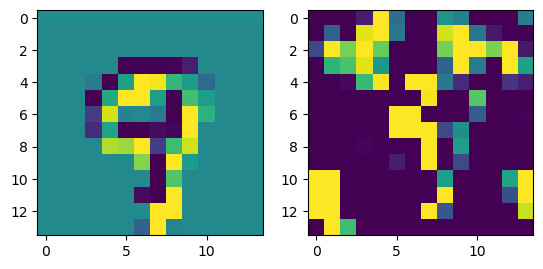

prediction: tensor([7, 6, 5]), tensor([3.7379, 2.0536, 1.3586]) groudtruth: 7
-0.06954521 0.08047354


<Figure size 640x480 with 0 Axes>

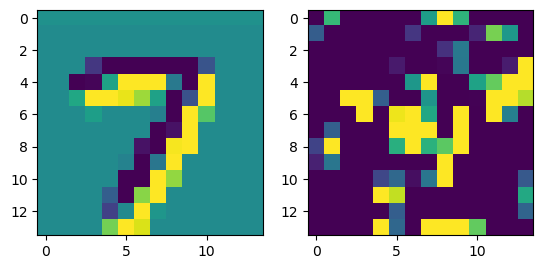

prediction: tensor([2, 8, 4]), tensor([2.0400, 1.4829, 1.3054]) groudtruth: 4
-0.07377845 0.086148255


<Figure size 640x480 with 0 Axes>

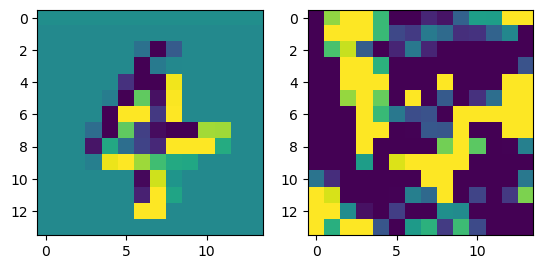

prediction: tensor([8, 2, 7]), tensor([4.0842, 1.6059, 0.4110]) groudtruth: 8
-0.08614594 0.09546804


<Figure size 640x480 with 0 Axes>

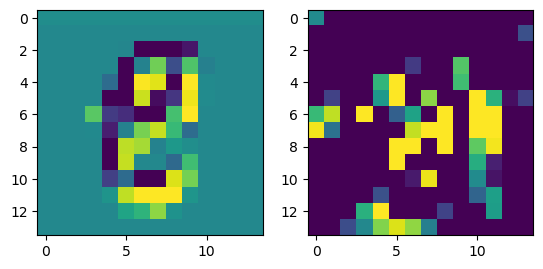

prediction: tensor([5, 3, 6]), tensor([6.9813, 1.7388, 1.3122]) groudtruth: 5
-0.10929835 0.098801285


<Figure size 640x480 with 0 Axes>

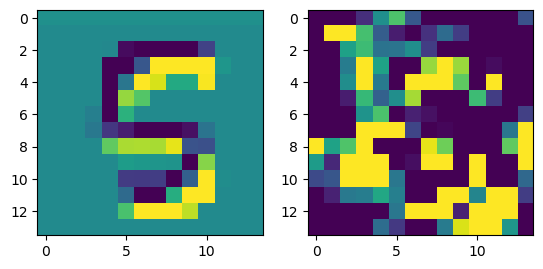

prediction: tensor([9, 4, 3]), tensor([3.3033, 0.7302, 0.4158]) groudtruth: 9
-0.08746511 0.086832084


<Figure size 640x480 with 0 Axes>

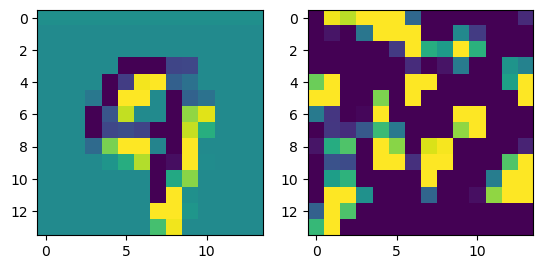

prediction: tensor([6, 9, 7]), tensor([5.2282, 1.3560, 1.1151]) groudtruth: 6
-0.06642997 0.054534562


<Figure size 640x480 with 0 Axes>

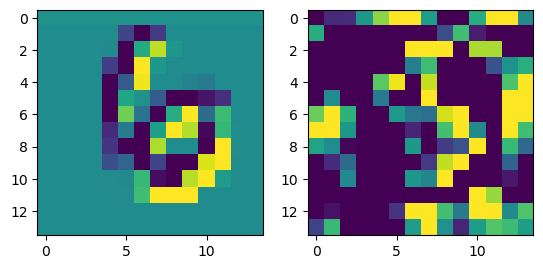

prediction: tensor([9, 7, 4]), tensor([3.8896, 1.2846, 0.2833]) groudtruth: 9
-0.080700934 0.09416759


<Figure size 640x480 with 0 Axes>

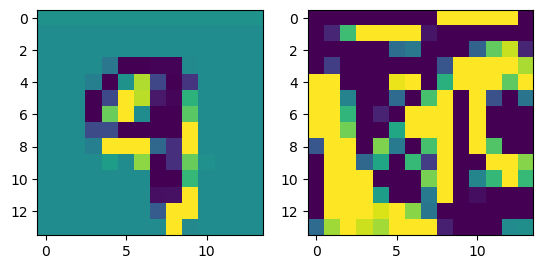

prediction: tensor([3, 7, 5]), tensor([4.3005, 1.2673, 0.3566]) groudtruth: 3
-0.098550916 0.08143775


<Figure size 640x480 with 0 Axes>

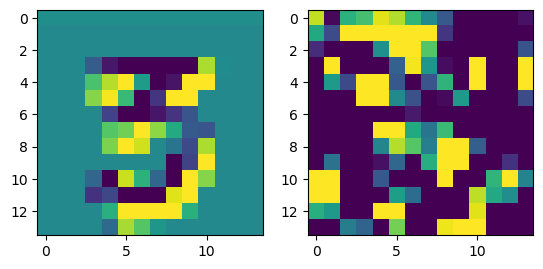

prediction: tensor([5, 3, 7]), tensor([4.9045, 2.9541, 2.3622]) groudtruth: 5
-0.08106047 0.08503537


<Figure size 640x480 with 0 Axes>

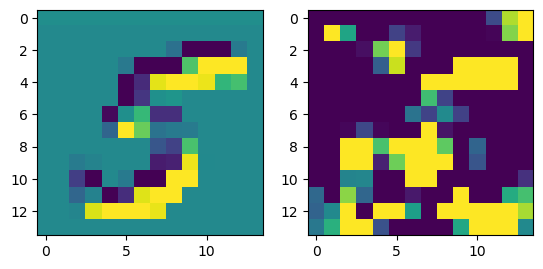

prediction: tensor([1, 6, 5]), tensor([2.3934, 1.9824, 1.1852]) groudtruth: 5
-0.07494974 0.13532947


<Figure size 640x480 with 0 Axes>

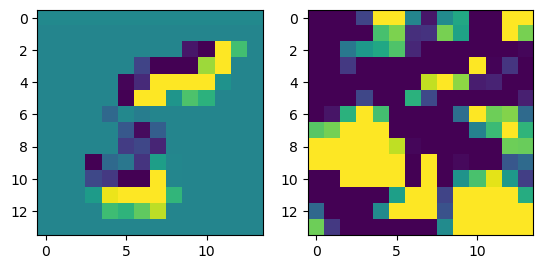

prediction: tensor([2, 1, 9]), tensor([2.2592, 1.6337, 1.1144]) groudtruth: 2
-0.068413496 0.08079848


<Figure size 640x480 with 0 Axes>

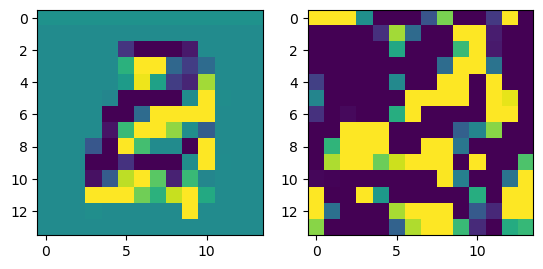

prediction: tensor([3, 4, 2]), tensor([4.5121, 1.9580, 1.7091]) groudtruth: 3
-0.07471335 0.073245265


<Figure size 640x480 with 0 Axes>

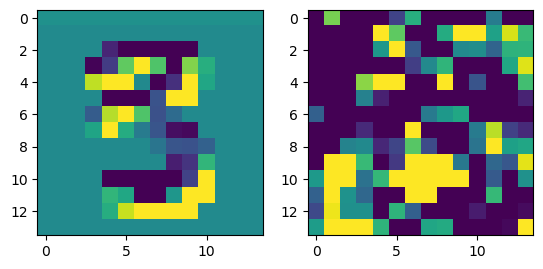

prediction: tensor([2, 4, 9]), tensor([6.6743, 0.7177, 0.5060]) groudtruth: 2
-0.076402605 0.07335222


<Figure size 640x480 with 0 Axes>

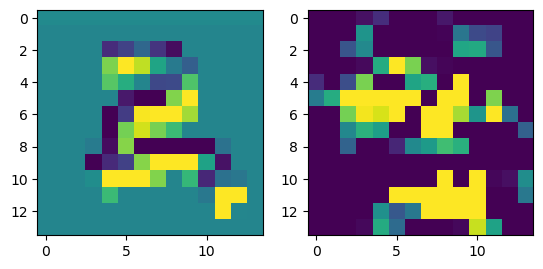

prediction: tensor([1, 7, 4]), tensor([5.0674, 1.0324, 0.7561]) groudtruth: 1
-0.077088356 0.07193063


<Figure size 640x480 with 0 Axes>

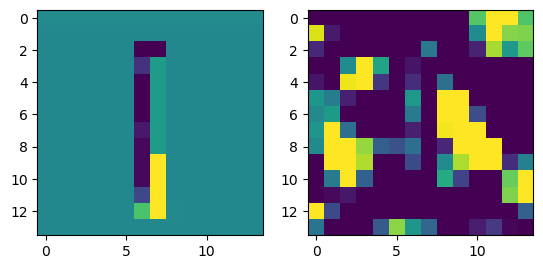

prediction: tensor([9, 3, 7]), tensor([2.3038, 2.2261, 1.8853]) groudtruth: 3
-0.110324144 0.09557758


<Figure size 640x480 with 0 Axes>

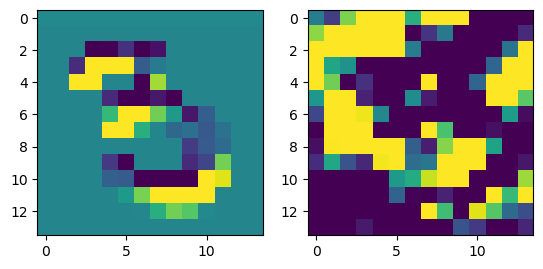

prediction: tensor([9, 3, 7]), tensor([3.6531, 2.8976, 1.4871]) groudtruth: 9
-0.067379296 0.07138754


<Figure size 640x480 with 0 Axes>

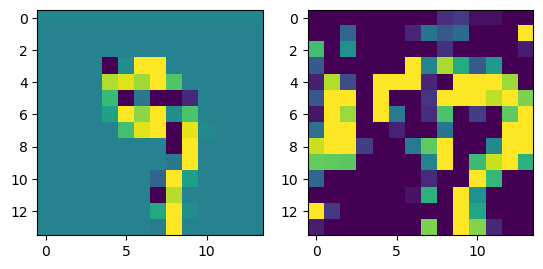

prediction: tensor([7, 9, 0]), tensor([3.7391, 2.3108, 2.0590]) groudtruth: 7
-0.08700472 0.11447805


<Figure size 640x480 with 0 Axes>

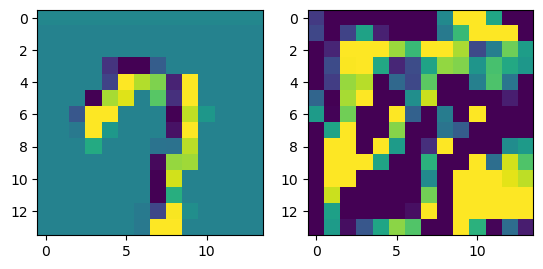

prediction: tensor([2, 9, 6]), tensor([2.2082, 1.2462, 1.1264]) groudtruth: 2
-0.08003563 0.11288818


<Figure size 640x480 with 0 Axes>

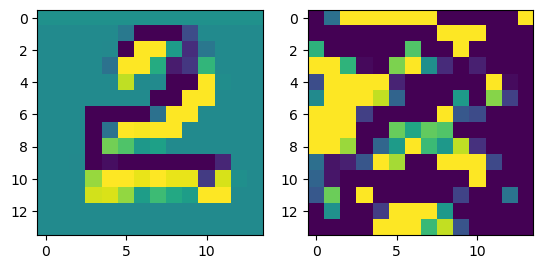

prediction: tensor([0, 8, 6]), tensor([3.4320, 3.0478, 1.3203]) groudtruth: 1
-0.070644796 0.07641724


<Figure size 640x480 with 0 Axes>

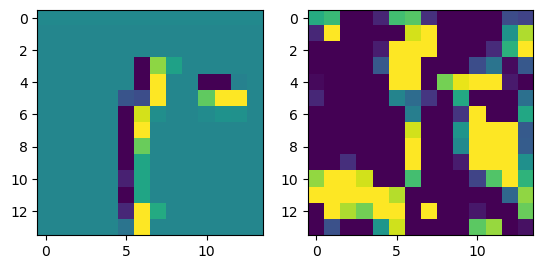

prediction: tensor([2, 9, 7]), tensor([4.5019, 3.7176, 0.5344]) groudtruth: 2
-0.062386394 0.066051155


<Figure size 640x480 with 0 Axes>

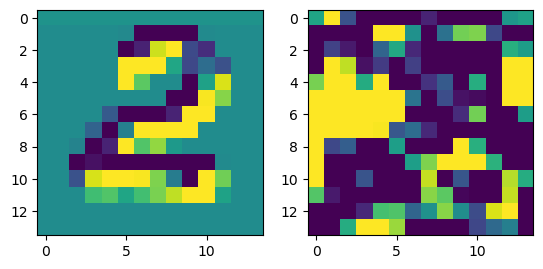

prediction: tensor([8, 3, 1]), tensor([3.3058, 1.7478, 0.9463]) groudtruth: 8
-0.07078159 0.082647815


<Figure size 640x480 with 0 Axes>

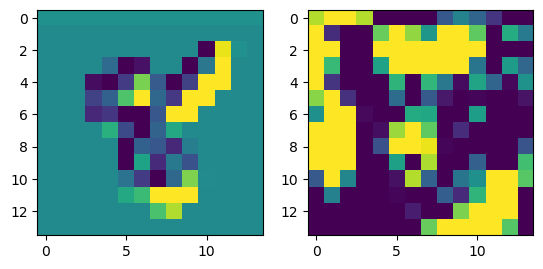

prediction: tensor([9, 7, 8]), tensor([4.2793, 1.9377, 0.7341]) groudtruth: 9
-0.10712862 0.11042079


<Figure size 640x480 with 0 Axes>

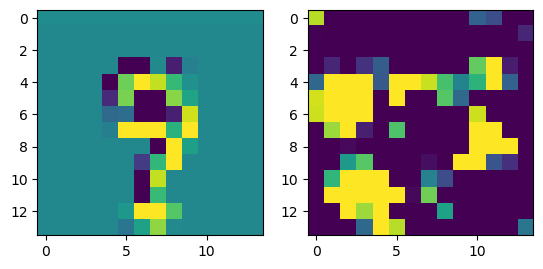

prediction: tensor([1, 6, 8]), tensor([4.3848, 1.9252, 0.8050]) groudtruth: 1
-0.08495045 0.07280513


<Figure size 640x480 with 0 Axes>

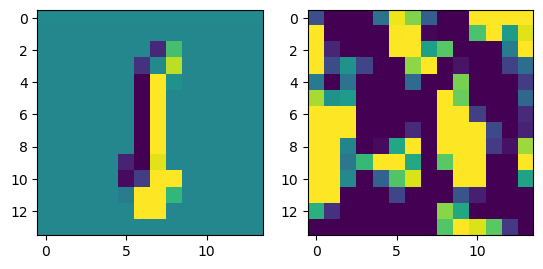

prediction: tensor([8, 4, 1]), tensor([3.6741, 2.1267, 1.0627]) groudtruth: 8
-0.06886178 0.07354092


<Figure size 640x480 with 0 Axes>

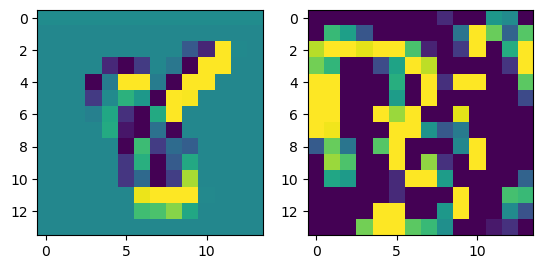

prediction: tensor([4, 8, 9]), tensor([4.9720, 0.4175, 0.3468]) groudtruth: 4
-0.07706034 0.0906364


<Figure size 640x480 with 0 Axes>

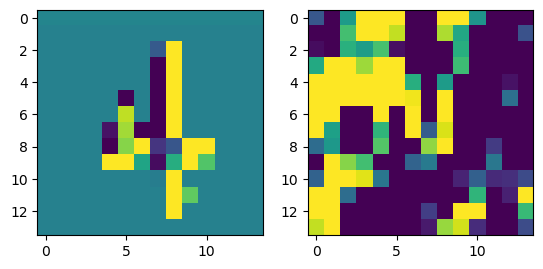

prediction: tensor([5, 8, 3]), tensor([4.7243, 3.0051, 1.1637]) groudtruth: 5
-0.07799888 0.09368003


<Figure size 640x480 with 0 Axes>

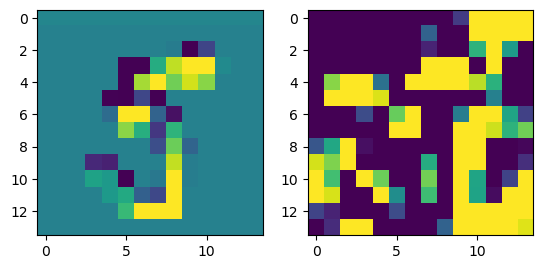

prediction: tensor([4, 1, 9]), tensor([1.6070, 1.4168, 1.2895]) groudtruth: 4
-0.08112264 0.08866985


<Figure size 640x480 with 0 Axes>

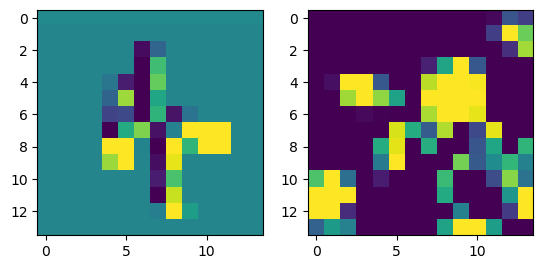

prediction: tensor([1, 2, 3]), tensor([5.6873, 2.0442, 0.4940]) groudtruth: 1
-0.090412855 0.09574297


<Figure size 640x480 with 0 Axes>

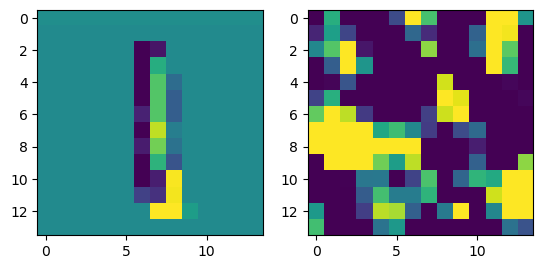

prediction: tensor([2, 8, 3]), tensor([2.6334, 2.2693, 2.0632]) groudtruth: 3
-0.071459174 0.08068369


<Figure size 640x480 with 0 Axes>

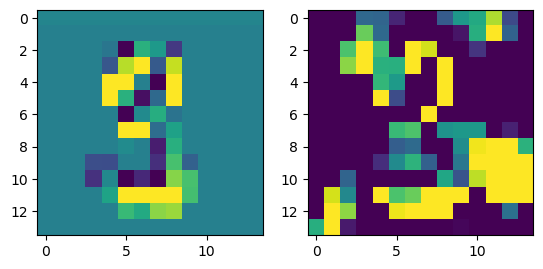

prediction: tensor([8, 7, 6]), tensor([1.4251, 1.0484, 1.0100]) groudtruth: 8
-0.07385212 0.09230442


<Figure size 640x480 with 0 Axes>

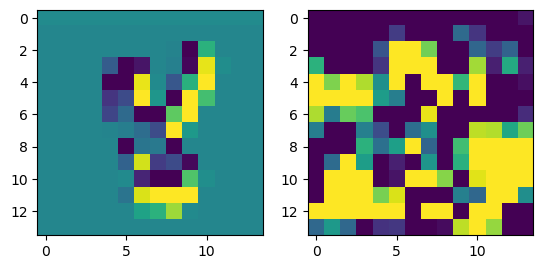

prediction: tensor([7, 6, 2]), tensor([3.5767, 3.3958, 0.8316]) groudtruth: 6
-0.08753157 0.08668168


<Figure size 640x480 with 0 Axes>

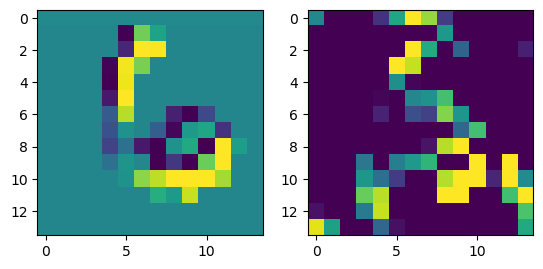

prediction: tensor([3, 7, 8]), tensor([2.5750, 1.8859, 1.8506]) groudtruth: 3
-0.08087546 0.09848194


<Figure size 640x480 with 0 Axes>

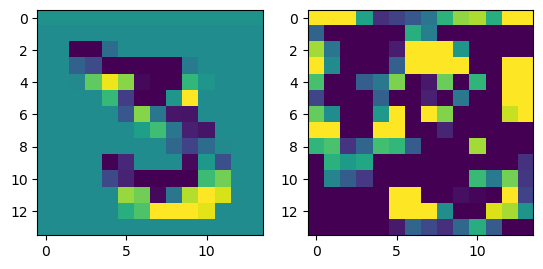

prediction: tensor([9, 2, 7]), tensor([6.0847, 1.6661, 1.6184]) groudtruth: 9
-0.059788287 0.08145213


<Figure size 640x480 with 0 Axes>

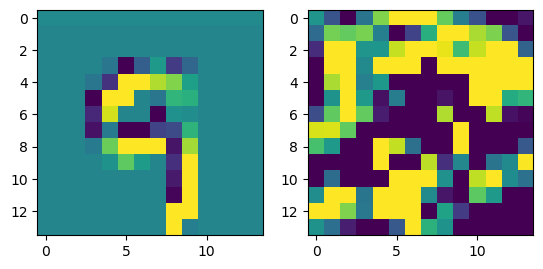

prediction: tensor([9, 6, 5]), tensor([4.6185, 1.6268, 1.6150]) groudtruth: 9
-0.091334105 0.0924296


<Figure size 640x480 with 0 Axes>

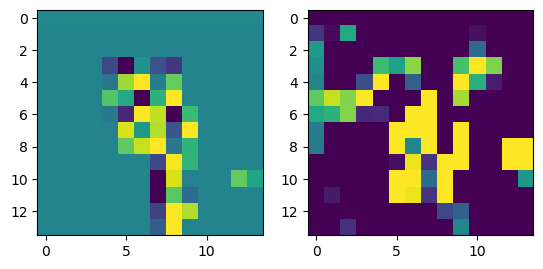

prediction: tensor([5, 8, 3]), tensor([4.4670, 2.6444, 1.5645]) groudtruth: 5
-0.06767696 0.07833612


<Figure size 640x480 with 0 Axes>

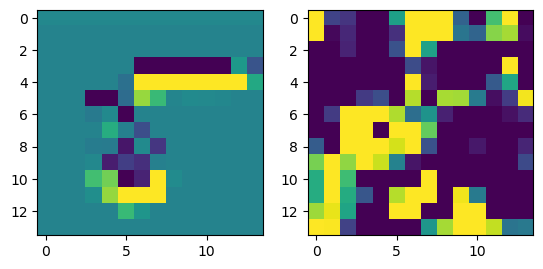

prediction: tensor([9, 8, 3]), tensor([4.7807, 0.8213, 0.7623]) groudtruth: 9
-0.10281354 0.06790431


<Figure size 640x480 with 0 Axes>

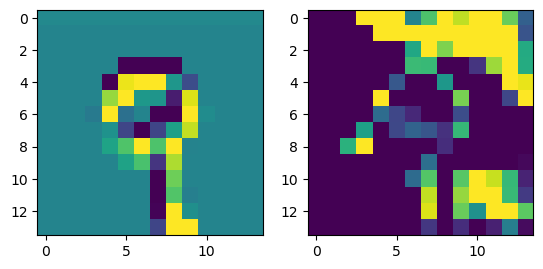

prediction: tensor([3, 5, 4]), tensor([4.5035, 0.9048, 0.6222]) groudtruth: 3
-0.06961697 0.06814176


<Figure size 640x480 with 0 Axes>

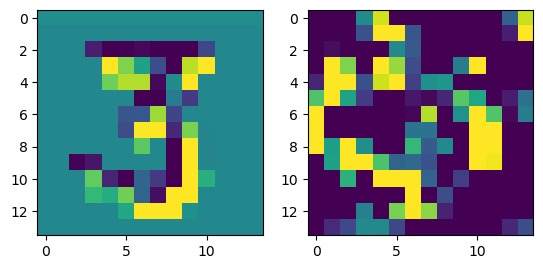

prediction: tensor([9, 7, 0]), tensor([3.1468, 2.6660, 1.5330]) groudtruth: 7
-0.08184862 0.079512864


<Figure size 640x480 with 0 Axes>

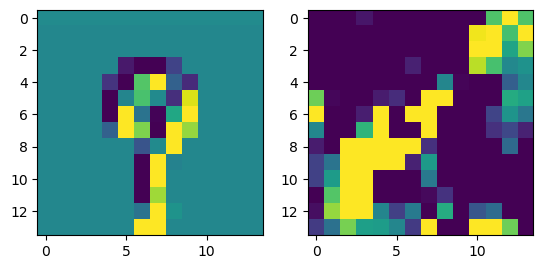

prediction: tensor([8, 3, 4]), tensor([3.0656, 2.6741, 1.4956]) groudtruth: 8
-0.09784132 0.068927735


<Figure size 640x480 with 0 Axes>

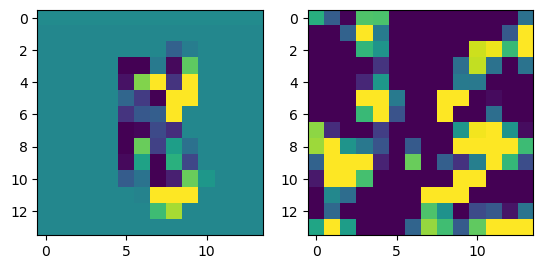

prediction: tensor([5, 8, 6]), tensor([5.2102, 1.3798, 0.7723]) groudtruth: 5
-0.073682606 0.10023463


<Figure size 640x480 with 0 Axes>

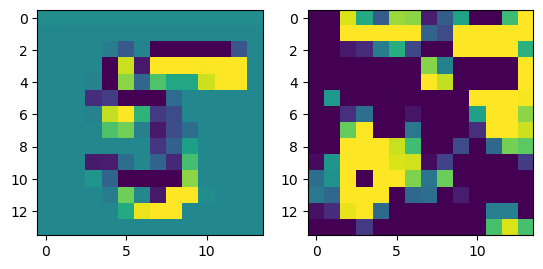

prediction: tensor([3, 2, 9]), tensor([4.7311, 2.4457, 1.7887]) groudtruth: 3
-0.0782491 0.08202286


<Figure size 640x480 with 0 Axes>

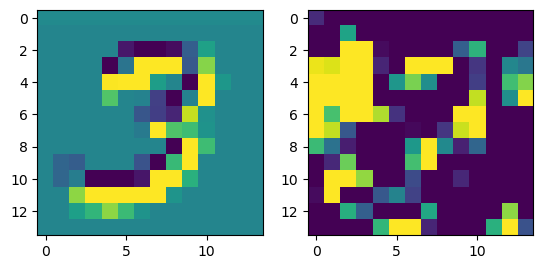

prediction: tensor([2, 6, 3]), tensor([6.4904, 0.7730, 0.5596]) groudtruth: 2
-0.083161175 0.12243175


<Figure size 640x480 with 0 Axes>

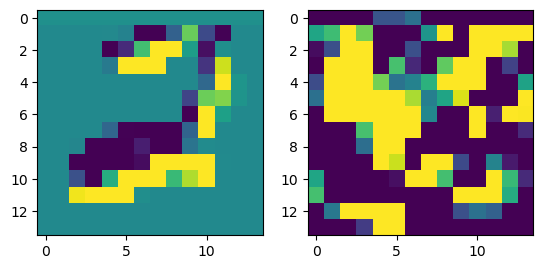

prediction: tensor([1, 2, 7]), tensor([5.6702, 0.5178, 0.3279]) groudtruth: 1
-0.07853305 0.073011585


<Figure size 640x480 with 0 Axes>

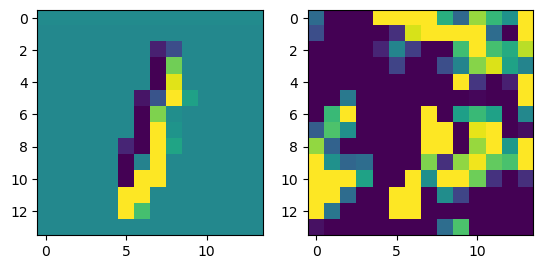

prediction: tensor([2, 7, 6]), tensor([5.3954, 0.7114, 0.6583]) groudtruth: 2
-0.10649663 0.1276243


<Figure size 640x480 with 0 Axes>

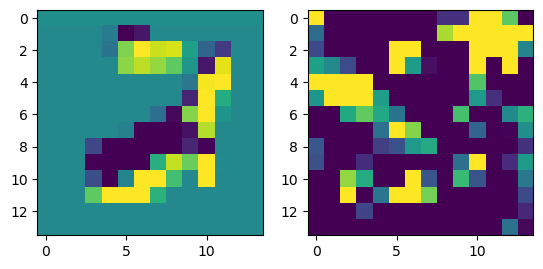

prediction: tensor([3, 9, 8]), tensor([ 3.8612,  1.2230, -0.0410]) groudtruth: 3
-0.06723046 0.07150072


<Figure size 640x480 with 0 Axes>

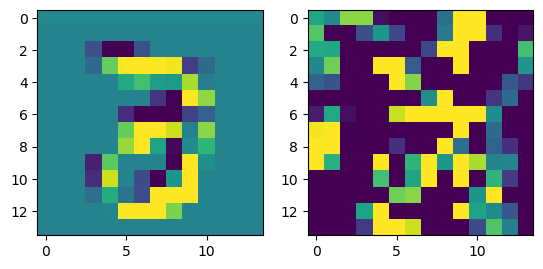

prediction: tensor([8, 9, 5]), tensor([5.9651, 1.5049, 0.3711]) groudtruth: 8
-0.105354786 0.08132261


<Figure size 640x480 with 0 Axes>

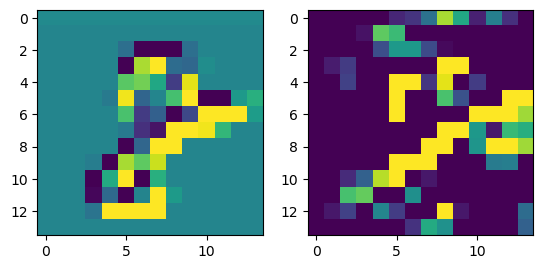

prediction: tensor([3, 1, 4]), tensor([3.7128, 1.3437, 0.9732]) groudtruth: 3
-0.099665344 0.081053756


<Figure size 640x480 with 0 Axes>

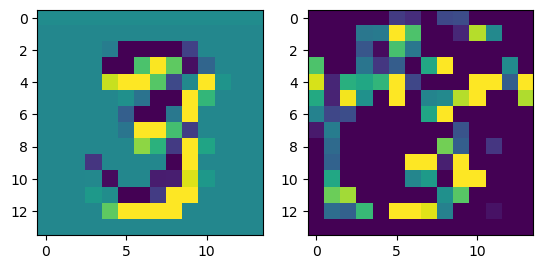

prediction: tensor([2, 7, 6]), tensor([6.3794, 1.0085, 0.7794]) groudtruth: 2
-0.0796504 0.10133354


<Figure size 640x480 with 0 Axes>

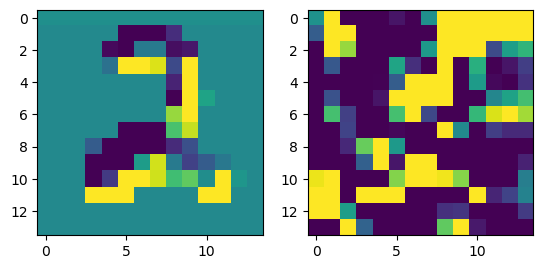

prediction: tensor([5, 7, 6]), tensor([3.1957, 2.4020, 2.0680]) groudtruth: 6
-0.08815938 0.06471405


<Figure size 640x480 with 0 Axes>

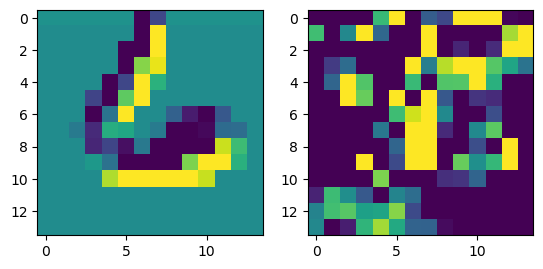

prediction: tensor([2, 8, 5]), tensor([1.1713, 1.1403, 0.7441]) groudtruth: 5
-0.060687423 0.08548665


<Figure size 640x480 with 0 Axes>

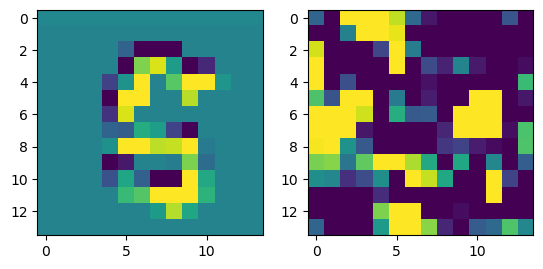

prediction: tensor([6, 2, 7]), tensor([3.8892, 1.4887, 0.6514]) groudtruth: 6
-0.0892148 0.08770641


<Figure size 640x480 with 0 Axes>

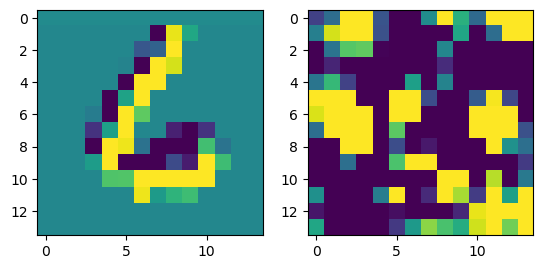

prediction: tensor([8, 2, 4]), tensor([3.4941, 1.7094, 1.1969]) groudtruth: 8
-0.064320445 0.098129675


<Figure size 640x480 with 0 Axes>

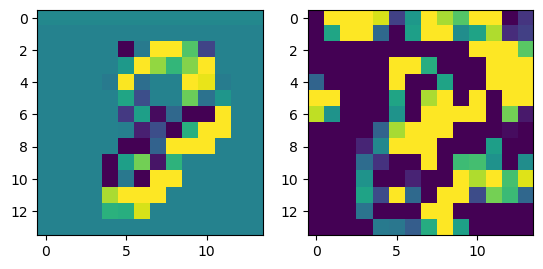

prediction: tensor([2, 0, 6]), tensor([5.3651, 1.5170, 1.0038]) groudtruth: 2
-0.106752336 0.09155979


<Figure size 640x480 with 0 Axes>

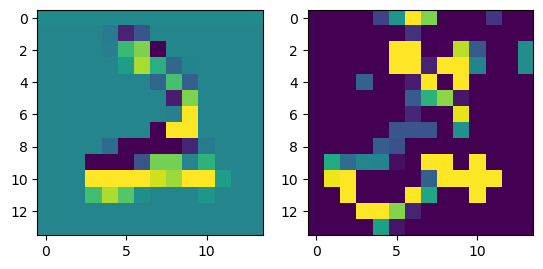

prediction: tensor([7, 9, 6]), tensor([6.4927, 1.2399, 0.0490]) groudtruth: 7
-0.07413167 0.08363991


<Figure size 640x480 with 0 Axes>

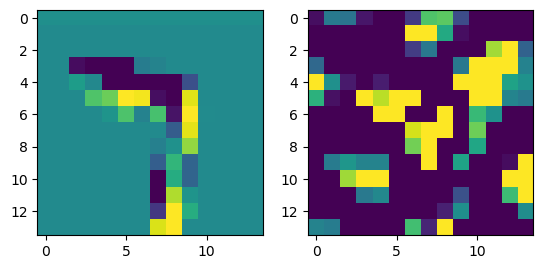

prediction: tensor([4, 3, 7]), tensor([4.2744, 0.6127, 0.5436]) groudtruth: 4
-0.090096176 0.10832524


<Figure size 640x480 with 0 Axes>

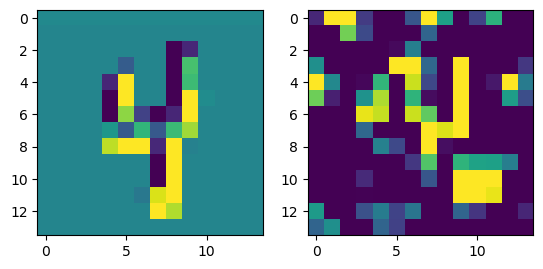

prediction: tensor([8, 5, 2]), tensor([5.3433, 1.5052, 1.4734]) groudtruth: 8
-0.08614594 0.058367


<Figure size 640x480 with 0 Axes>

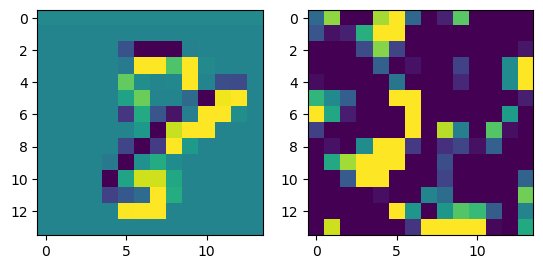

prediction: tensor([7, 3, 4]), tensor([3.7754, 3.5128, 0.8670]) groudtruth: 3
-0.103423774 0.09346502


<Figure size 640x480 with 0 Axes>

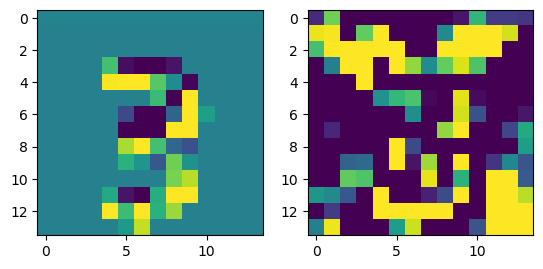

prediction: tensor([4, 2, 7]), tensor([4.7645, 3.1402, 0.6113]) groudtruth: 4
-0.08106917 0.07112363


<Figure size 640x480 with 0 Axes>

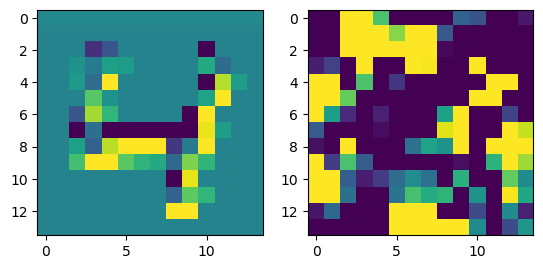

prediction: tensor([6, 1, 2]), tensor([6.3431, 2.0108, 1.0086]) groudtruth: 6
-0.06543833 0.08056475


<Figure size 640x480 with 0 Axes>

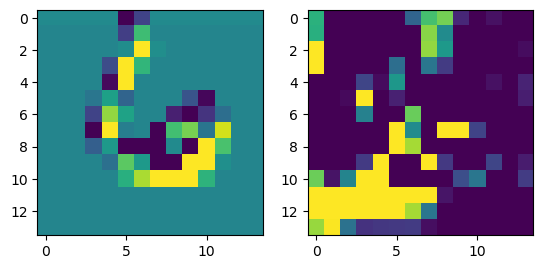

prediction: tensor([0, 3, 6]), tensor([3.6395, 3.4871, 0.8094]) groudtruth: 0
-0.074052155 0.078214556


<Figure size 640x480 with 0 Axes>

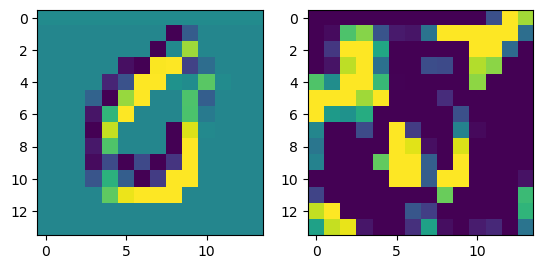

prediction: tensor([5, 0, 6]), tensor([3.0551, 2.4135, 2.4104]) groudtruth: 0
-0.06845182 0.077960566


<Figure size 640x480 with 0 Axes>

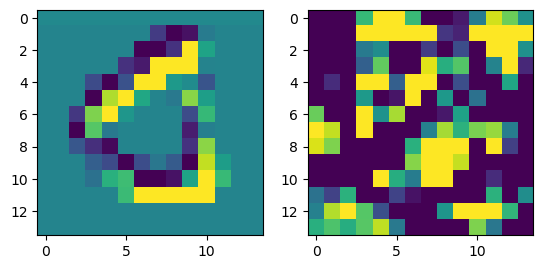

prediction: tensor([2, 4, 3]), tensor([7.1314, 5.3387, 3.1482]) groudtruth: 2
-0.07049948 0.06777155


<Figure size 640x480 with 0 Axes>

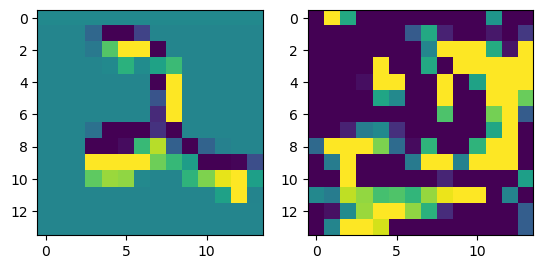

prediction: tensor([0, 7, 3]), tensor([5.9133, 0.9921, 0.7856]) groudtruth: 0
-0.069236934 0.08012268


<Figure size 640x480 with 0 Axes>

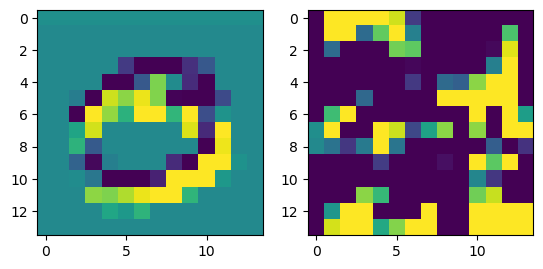

prediction: tensor([1, 8, 6]), tensor([5.2088, 2.0276, 1.3316]) groudtruth: 1
-0.1061399 0.07588011


<Figure size 640x480 with 0 Axes>

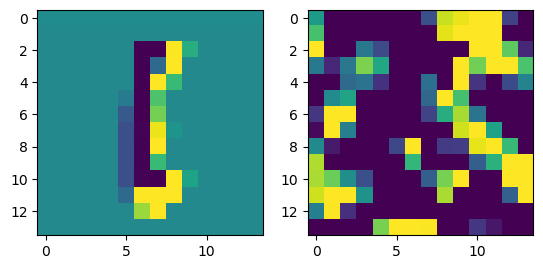

prediction: tensor([4, 7, 2]), tensor([2.3785, 2.3295, 2.0355]) groudtruth: 4
-0.06892949 0.063381925


<Figure size 640x480 with 0 Axes>

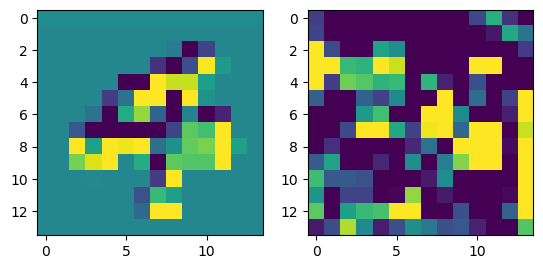

prediction: tensor([9, 3, 5]), tensor([3.3131, 1.3008, 1.1637]) groudtruth: 5
-0.06510812 0.09870005


<Figure size 640x480 with 0 Axes>

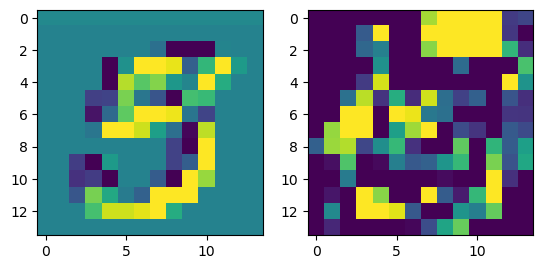

prediction: tensor([6, 4, 2]), tensor([4.0498, 2.3080, 1.6906]) groudtruth: 6
-0.07760739 0.083459154


<Figure size 640x480 with 0 Axes>

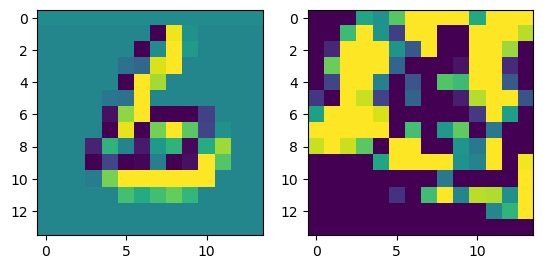

prediction: tensor([7, 2, 9]), tensor([2.9130, 1.0877, 0.6793]) groudtruth: 7
-0.09280276 0.08934493


<Figure size 640x480 with 0 Axes>

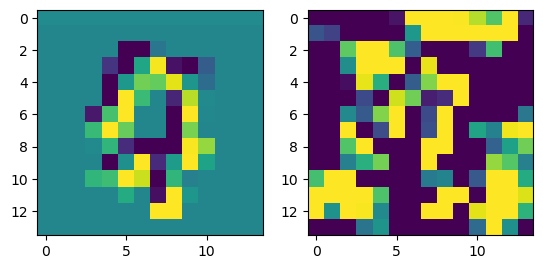

prediction: tensor([8, 3, 1]), tensor([2.0232, 1.1570, 0.4524]) groudtruth: 8
-0.08237916 0.08789246


<Figure size 640x480 with 0 Axes>

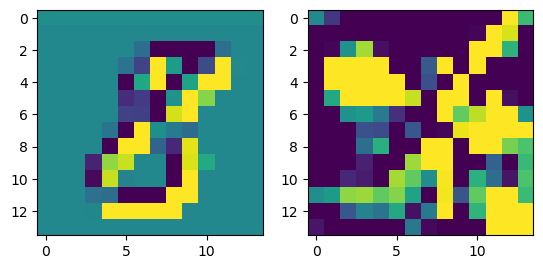

prediction: tensor([9, 7, 4]), tensor([3.3172, 1.8367, 0.9721]) groudtruth: 9
-0.081760705 0.10571638


<Figure size 640x480 with 0 Axes>

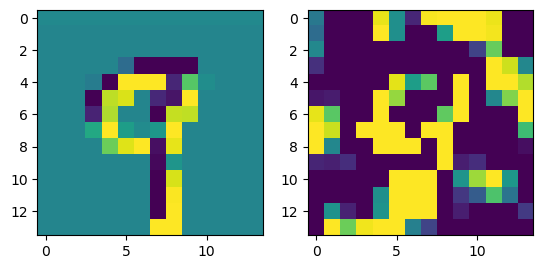

prediction: tensor([0, 3, 8]), tensor([5.9631, 3.3261, 1.3290]) groudtruth: 0
-0.07042748 0.047003828


<Figure size 640x480 with 0 Axes>

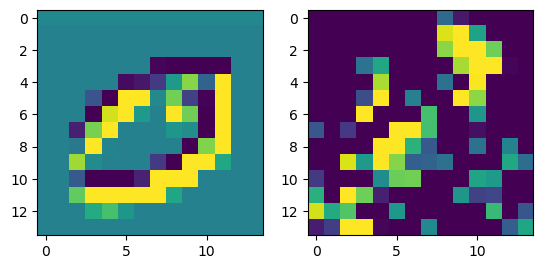

prediction: tensor([1, 0, 6]), tensor([5.1713, 1.2776, 0.5717]) groudtruth: 1
-0.07318443 0.09464542


<Figure size 640x480 with 0 Axes>

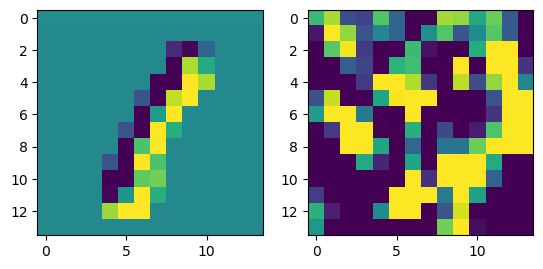

prediction: tensor([0, 4, 6]), tensor([4.2804, 2.8635, 1.2807]) groudtruth: 4
-0.1035977 0.089120574


<Figure size 640x480 with 0 Axes>

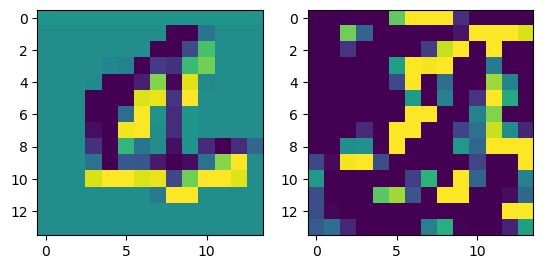

prediction: tensor([1, 9, 3]), tensor([4.5203, 1.3660, 1.3457]) groudtruth: 1
-0.09197885 0.086225875


<Figure size 640x480 with 0 Axes>

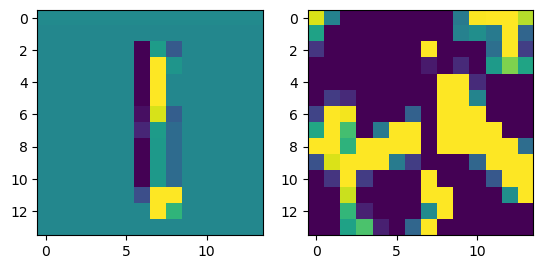

prediction: tensor([9, 7, 1]), tensor([1.7919, 1.5523, 1.5059]) groudtruth: 0
-0.094025075 0.08858828


<Figure size 640x480 with 0 Axes>

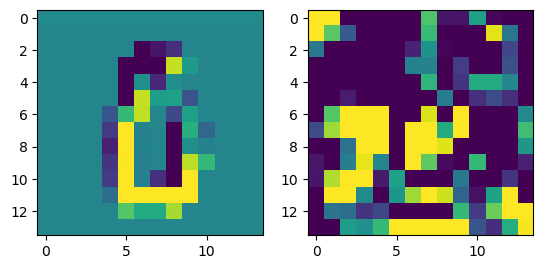

prediction: tensor([5, 3, 7]), tensor([3.9000, 2.4251, 1.9509]) groudtruth: 5
-0.097251594 0.08636479


<Figure size 640x480 with 0 Axes>

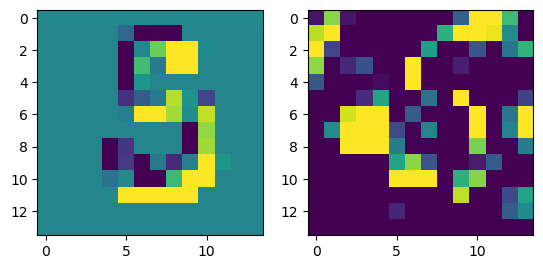

prediction: tensor([3, 9, 5]), tensor([3.3733, 2.0363, 1.7483]) groudtruth: 3
-0.07454634 0.11132554


<Figure size 640x480 with 0 Axes>

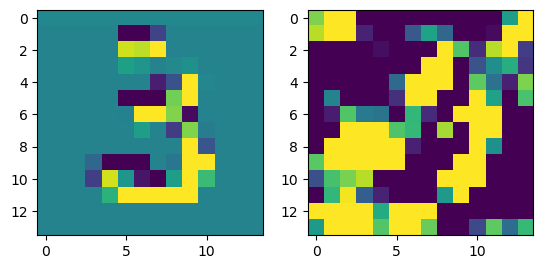

prediction: tensor([1, 6, 8]), tensor([6.0317, 1.5979, 0.0669]) groudtruth: 1
-0.066851795 0.07579635


<Figure size 640x480 with 0 Axes>

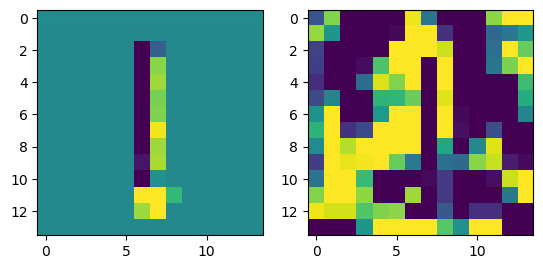

prediction: tensor([9, 7, 6]), tensor([5.4311, 3.2274, 0.0562]) groudtruth: 9
-0.07733959 0.09913469


<Figure size 640x480 with 0 Axes>

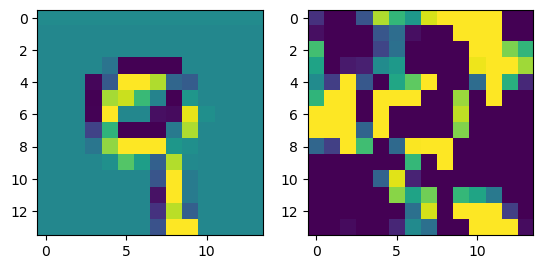

prediction: tensor([2, 9, 6]), tensor([3.0034, 2.1610, 1.7064]) groudtruth: 2
-0.08691394 0.10698314


<Figure size 640x480 with 0 Axes>

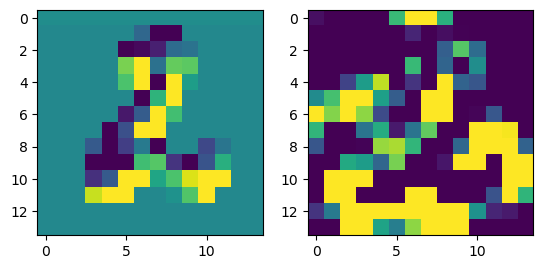

prediction: tensor([1, 2, 3]), tensor([5.0947, 0.2700, 0.1455]) groudtruth: 1
-0.07676774 0.10313955


<Figure size 640x480 with 0 Axes>

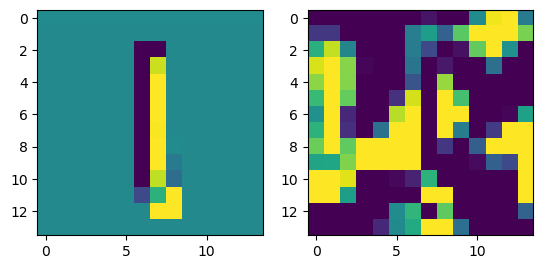

prediction: tensor([9, 7, 2]), tensor([4.9045, 3.2204, 0.6335]) groudtruth: 9
-0.06852305 0.08128657


<Figure size 640x480 with 0 Axes>

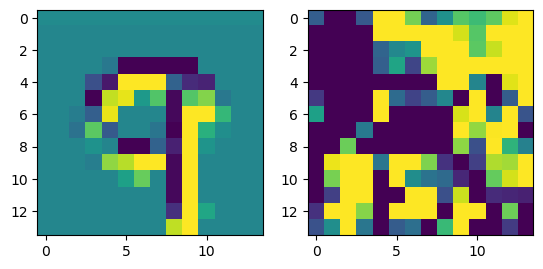

prediction: tensor([6, 7, 2]), tensor([4.7787, 1.4084, 1.0002]) groudtruth: 6
-0.08655685 0.058405027


<Figure size 640x480 with 0 Axes>

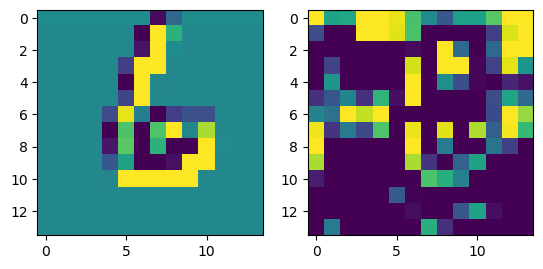

prediction: tensor([0, 6, 2]), tensor([3.1210, 2.3127, 2.1445]) groudtruth: 0
-0.065617144 0.07746622


<Figure size 640x480 with 0 Axes>

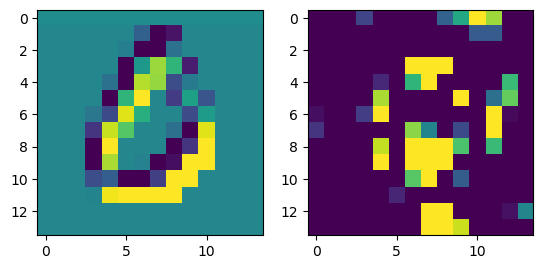

prediction: tensor([4, 3, 5]), tensor([6.3109, 3.6632, 1.2033]) groudtruth: 4
-0.08109367 0.07977488


<Figure size 640x480 with 0 Axes>

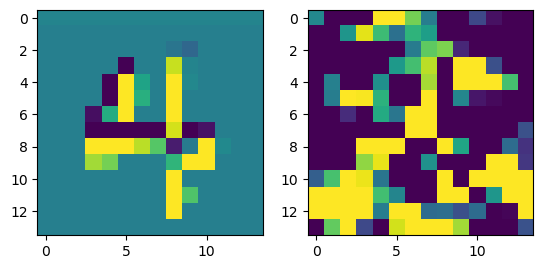

prediction: tensor([6, 1, 0]), tensor([3.1005, 2.8398, 1.5964]) groudtruth: 6
-0.10548866 0.06492991


<Figure size 640x480 with 0 Axes>

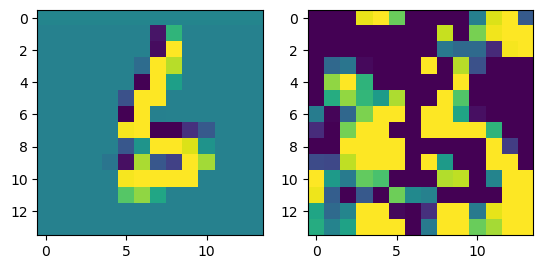

prediction: tensor([1, 7, 8]), tensor([6.7053, 1.7582, 1.5383]) groudtruth: 1
-0.106346965 0.06975915


<Figure size 640x480 with 0 Axes>

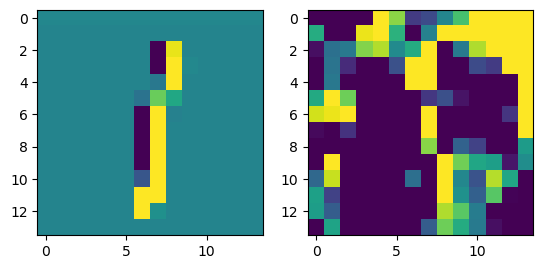

prediction: tensor([7, 9, 5]), tensor([3.7564, 2.6321, 1.8802]) groudtruth: 7
-0.09024453 0.08194405


<Figure size 640x480 with 0 Axes>

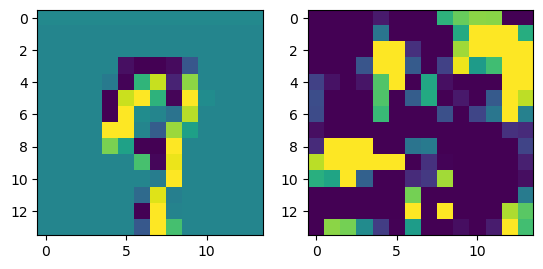

prediction: tensor([0, 7, 3]), tensor([4.8478, 1.3995, 0.6035]) groudtruth: 0
-0.061707795 0.06730014


<Figure size 640x480 with 0 Axes>

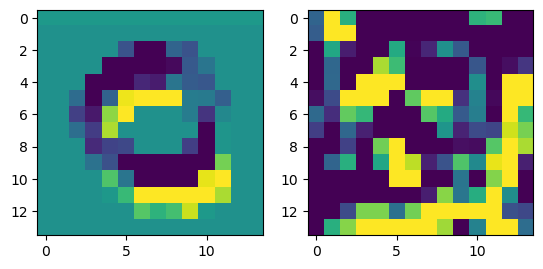

prediction: tensor([1, 2, 5]), tensor([5.0051, 2.0172, 0.8169]) groudtruth: 1
-0.071361005 0.104868144


<Figure size 640x480 with 0 Axes>

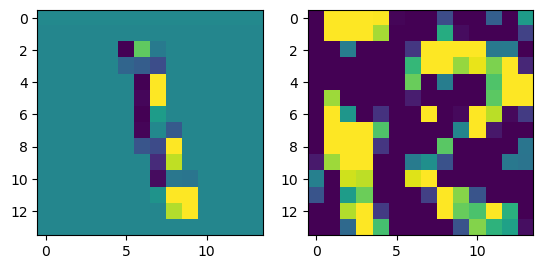

prediction: tensor([2, 9, 4]), tensor([5.9738, 3.7978, 3.4283]) groudtruth: 2
-0.1005764 0.10089897


<Figure size 640x480 with 0 Axes>

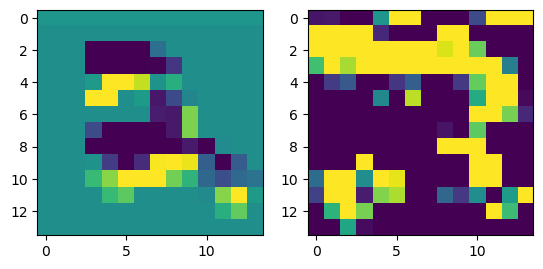

prediction: tensor([8, 9, 3]), tensor([2.5322, 2.1870, 1.9714]) groudtruth: 3
-0.11107075 0.08887704


<Figure size 640x480 with 0 Axes>

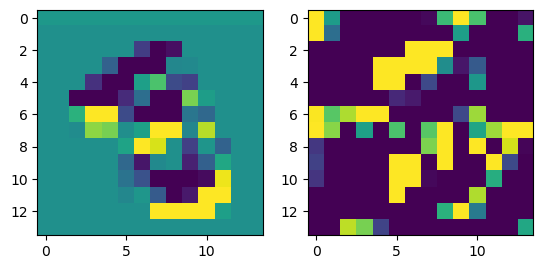

prediction: tensor([4, 8, 9]), tensor([6.2092, 1.7685, 0.7974]) groudtruth: 4
-0.083388805 0.07271238


<Figure size 640x480 with 0 Axes>

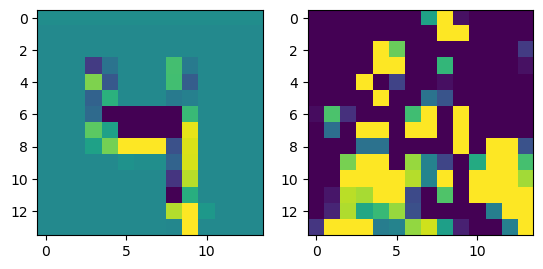

prediction: tensor([8, 5, 9]), tensor([4.2292, 3.3654, 1.2328]) groudtruth: 5
-0.086940825 0.08178549


<Figure size 640x480 with 0 Axes>

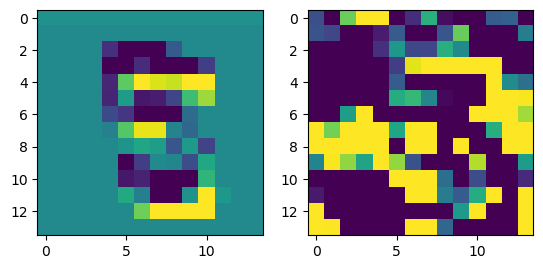

prediction: tensor([6, 9, 4]), tensor([5.1839, 1.6455, 1.5636]) groudtruth: 6
-0.08565122 0.08468759


<Figure size 640x480 with 0 Axes>

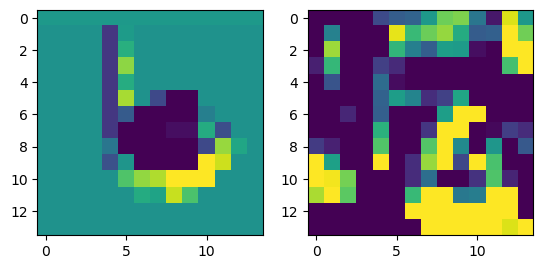

prediction: tensor([7, 8, 9]), tensor([5.3723, 0.8539, 0.4642]) groudtruth: 7
-0.087999344 0.113702506


<Figure size 640x480 with 0 Axes>

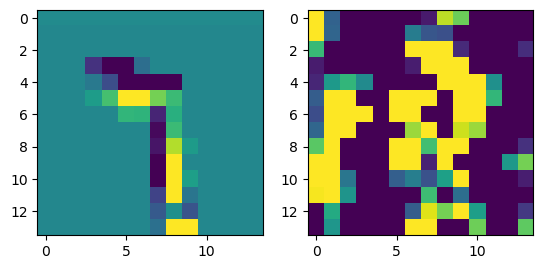

prediction: tensor([8, 0, 6]), tensor([2.5262, 1.1097, 0.1361]) groudtruth: 8
-0.08528721 0.102323785


<Figure size 640x480 with 0 Axes>

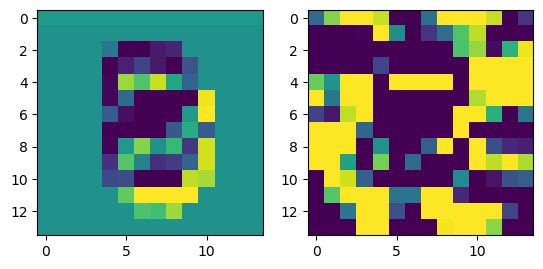

prediction: tensor([9, 7, 8]), tensor([4.0540, 3.2336, 2.1270]) groudtruth: 9
-0.07491648 0.08426707


<Figure size 640x480 with 0 Axes>

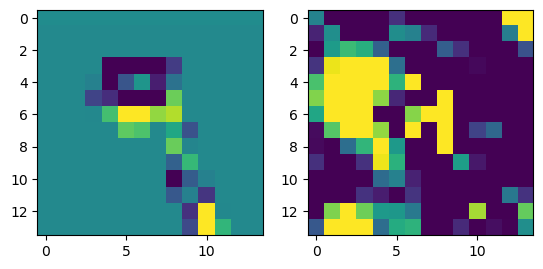

prediction: tensor([8, 4, 9]), tensor([3.9039, 2.2779, 0.2190]) groudtruth: 8
-0.11183232 0.07873458


<Figure size 640x480 with 0 Axes>

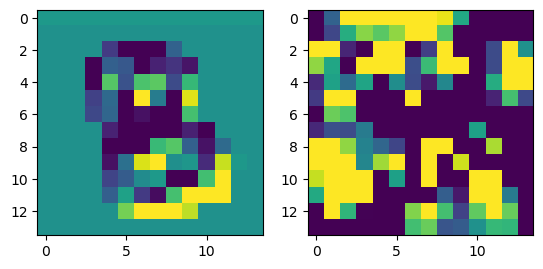

prediction: tensor([1, 6, 8]), tensor([1.8569, 1.6932, 0.9131]) groudtruth: 6
-0.08991635 0.104972795


<Figure size 640x480 with 0 Axes>

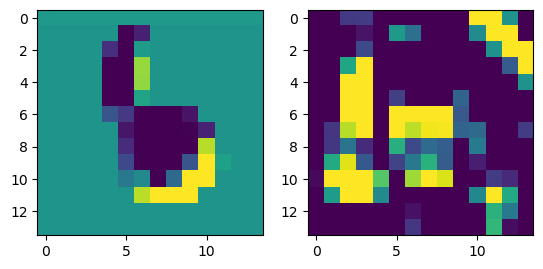

prediction: tensor([5, 3, 8]), tensor([2.4782, 1.9928, 1.7209]) groudtruth: 5
-0.09269887 0.09577269


<Figure size 640x480 with 0 Axes>

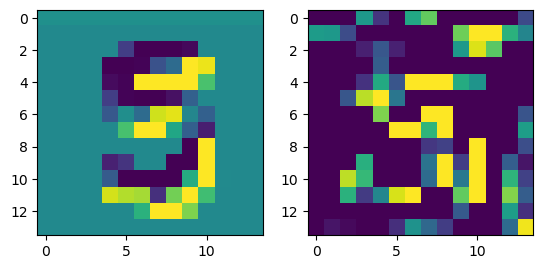

prediction: tensor([0, 9, 3]), tensor([3.8882, 1.4138, 1.0662]) groudtruth: 0
-0.08252722 0.076573685


<Figure size 640x480 with 0 Axes>

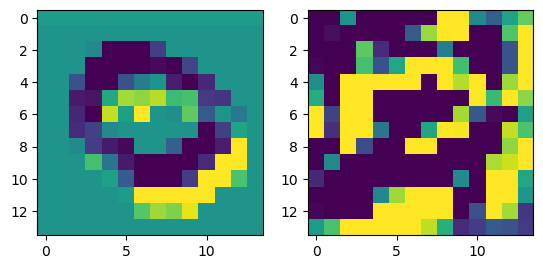

prediction: tensor([6, 2, 1]), tensor([3.4794, 2.1021, 1.2705]) groudtruth: 6
-0.0955649 0.11329846


<Figure size 640x480 with 0 Axes>

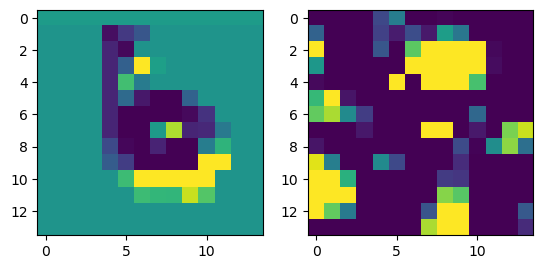

prediction: tensor([8, 1, 9]), tensor([5.4348, 2.4294, 1.3061]) groudtruth: 8
-0.07817274 0.090549886


<Figure size 640x480 with 0 Axes>

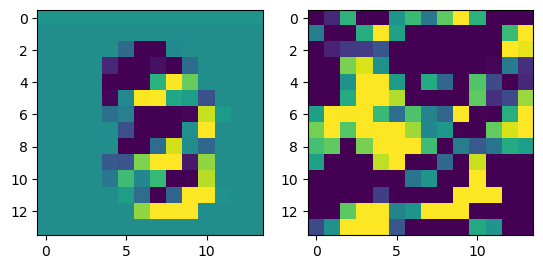

prediction: tensor([0, 9, 3]), tensor([4.2196, 2.6238, 1.8279]) groudtruth: 0
-0.08409965 0.08972971


<Figure size 640x480 with 0 Axes>

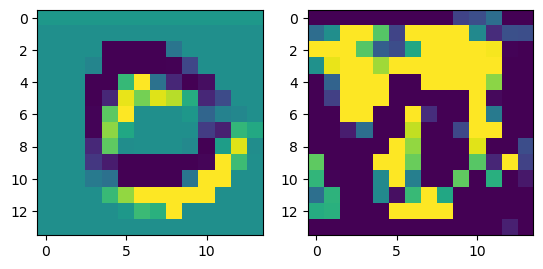

prediction: tensor([7, 2, 0]), tensor([6.0886, 1.4401, 1.0823]) groudtruth: 7
-0.113374054 0.0730594


<Figure size 640x480 with 0 Axes>

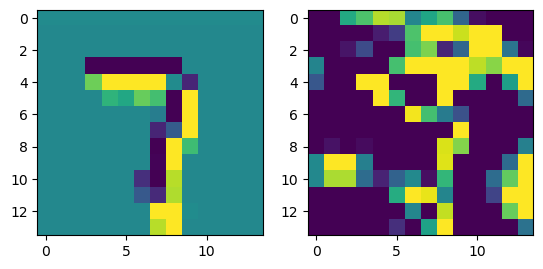

prediction: tensor([8, 2, 9]), tensor([6.2607, 1.7790, 1.0755]) groudtruth: 8
-0.08416343 0.066027015


<Figure size 640x480 with 0 Axes>

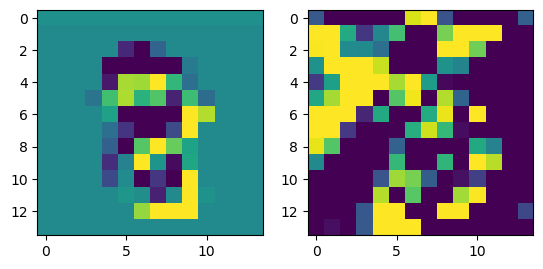

prediction: tensor([8, 3, 5]), tensor([2.5262, 1.8950, 1.7197]) groudtruth: 4
-0.07575905 0.107228756


<Figure size 640x480 with 0 Axes>

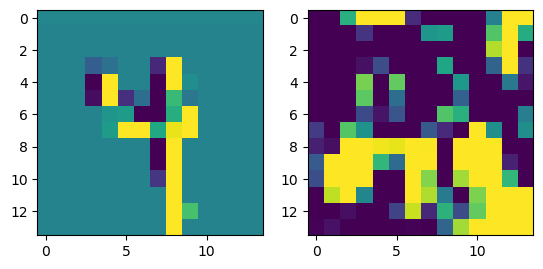

prediction: tensor([6, 5, 9]), tensor([4.3373, 1.6784, 1.4843]) groudtruth: 6
-0.08530438 0.07844945


<Figure size 640x480 with 0 Axes>

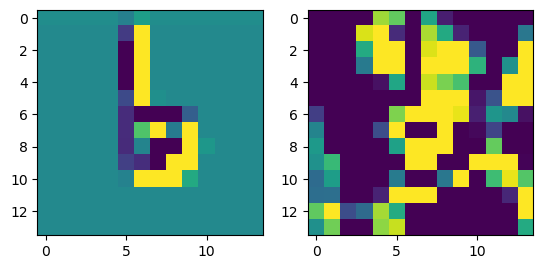

prediction: tensor([8, 4, 5]), tensor([5.5590, 2.1121, 1.4055]) groudtruth: 4
-0.09037638 0.07090699


<Figure size 640x480 with 0 Axes>

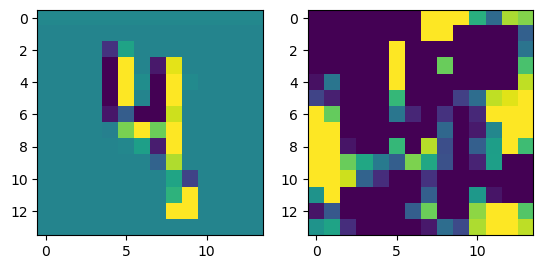

prediction: tensor([9, 7, 4]), tensor([4.2080, 0.9227, 0.7445]) groudtruth: 9
-0.11249018 0.11234772


<Figure size 640x480 with 0 Axes>

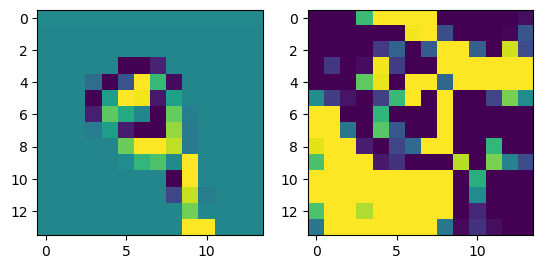

prediction: tensor([8, 9, 1]), tensor([2.2034, 1.4125, 1.2148]) groudtruth: 3
-0.072538376 0.08033403


<Figure size 640x480 with 0 Axes>

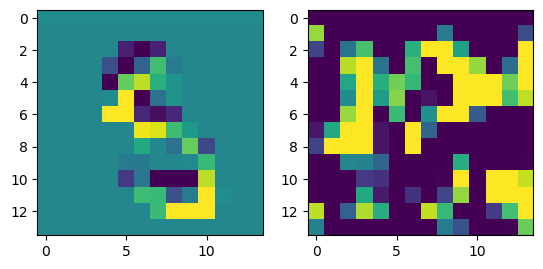

prediction: tensor([8, 9, 1]), tensor([4.1277, 1.5589, 1.0331]) groudtruth: 8
-0.13423091 0.100033484


<Figure size 640x480 with 0 Axes>

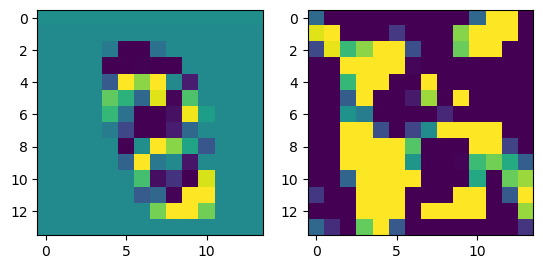

prediction: tensor([4, 3, 7]), tensor([4.6760, 1.9007, 1.8601]) groudtruth: 4
-0.09599227 0.10282701


<Figure size 640x480 with 0 Axes>

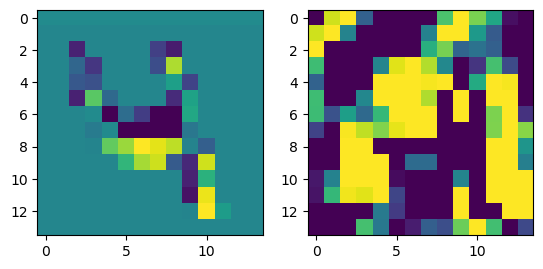

prediction: tensor([2, 7, 8]), tensor([4.4764, 1.9927, 0.8192]) groudtruth: 7
-0.08753455 0.10241462


<Figure size 640x480 with 0 Axes>

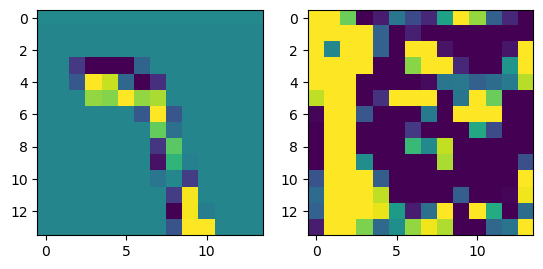

prediction: tensor([9, 7, 2]), tensor([2.1128, 1.9440, 1.9012]) groudtruth: 2
-0.08389497 0.07618216


<Figure size 640x480 with 0 Axes>

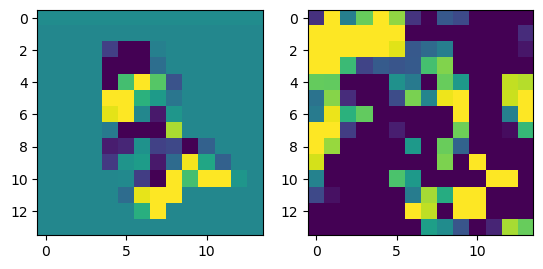

prediction: tensor([5, 8, 7]), tensor([3.8333, 2.2096, 1.8635]) groudtruth: 5
-0.103291094 0.0901172


<Figure size 640x480 with 0 Axes>

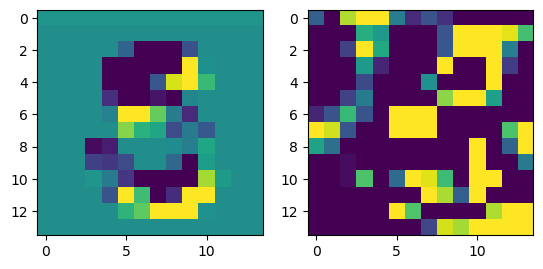

prediction: tensor([6, 9, 2]), tensor([3.3714, 3.1221, 0.7334]) groudtruth: 6
-0.07309276 0.078033514


<Figure size 640x480 with 0 Axes>

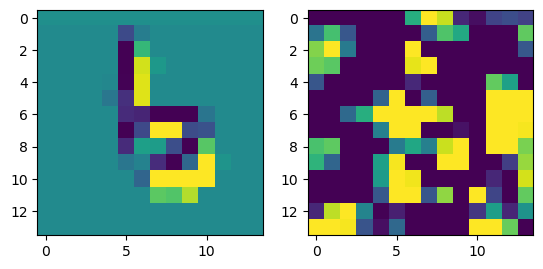

prediction: tensor([3, 8, 5]), tensor([3.5862, 2.2443, 2.0150]) groudtruth: 3
-0.10614371 0.08425699


<Figure size 640x480 with 0 Axes>

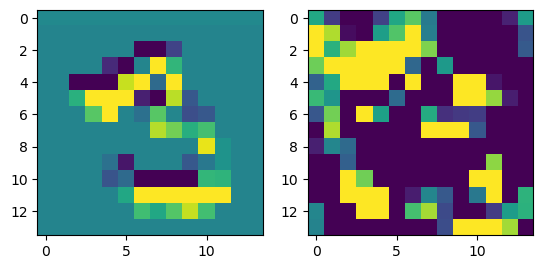

prediction: tensor([1, 6, 9]), tensor([2.2700, 1.2246, 1.0454]) groudtruth: 6
-0.09569621 0.07827784


<Figure size 640x480 with 0 Axes>

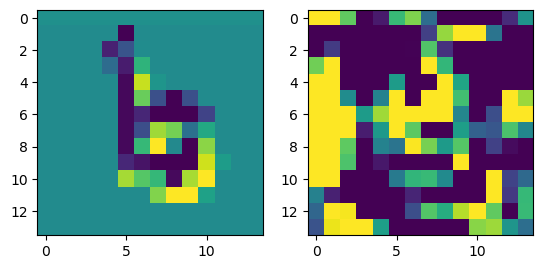

prediction: tensor([8, 9, 0]), tensor([3.1558, 2.5522, 1.8247]) groudtruth: 8
-0.10316676 0.08248513


<Figure size 640x480 with 0 Axes>

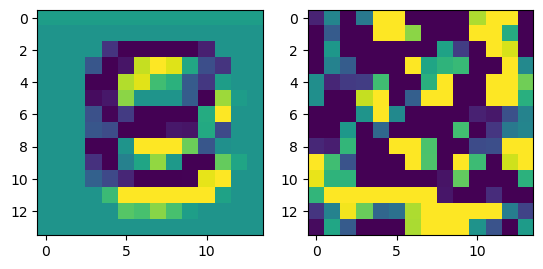

prediction: tensor([0, 5, 8]), tensor([4.4057, 3.0551, 1.2472]) groudtruth: 9
-0.08725512 0.123957306


<Figure size 640x480 with 0 Axes>

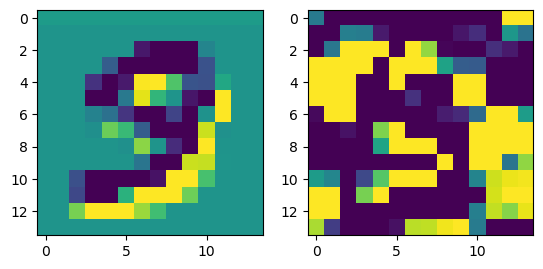

prediction: tensor([0, 8, 5]), tensor([2.9776, 1.5797, 0.7508]) groudtruth: 0
-0.062240303 0.09051944


<Figure size 640x480 with 0 Axes>

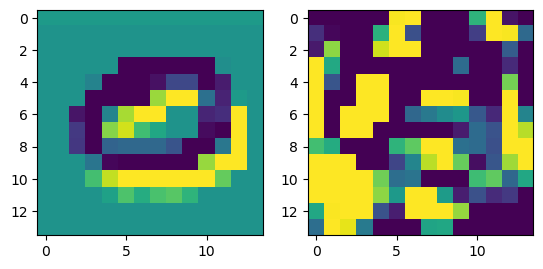

prediction: tensor([1, 6, 8]), tensor([4.0679, 2.8490, 1.6300]) groudtruth: 1
-0.08617562 0.0794135


<Figure size 640x480 with 0 Axes>

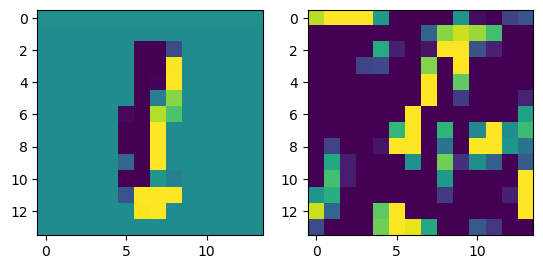

prediction: tensor([2, 6, 3]), tensor([4.8162, 1.5962, 1.2828]) groudtruth: 2
-0.08204776 0.080555215


<Figure size 640x480 with 0 Axes>

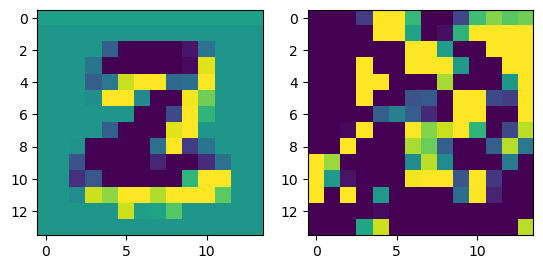

prediction: tensor([0, 3, 8]), tensor([3.1914, 3.1422, 1.3202]) groudtruth: 3
-0.085380435 0.07756538


<Figure size 640x480 with 0 Axes>

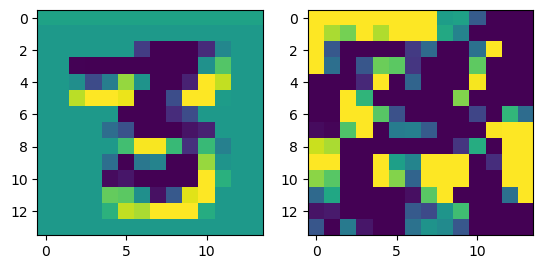

prediction: tensor([4, 6, 9]), tensor([6.2718, 1.3967, 0.5028]) groudtruth: 4
-0.09191209 0.12047723


<Figure size 640x480 with 0 Axes>

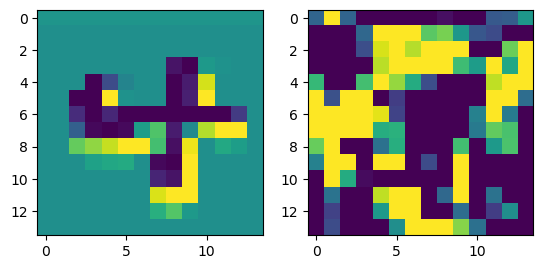

prediction: tensor([2, 6, 5]), tensor([2.0643, 1.8334, 1.5305]) groudtruth: 5
-0.10918969 0.108423576


<Figure size 640x480 with 0 Axes>

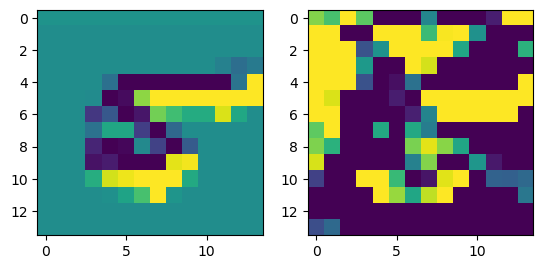

prediction: tensor([6, 5, 2]), tensor([5.0633, 0.7711, 0.6590]) groudtruth: 6
-0.11158216 0.06387441


<Figure size 640x480 with 0 Axes>

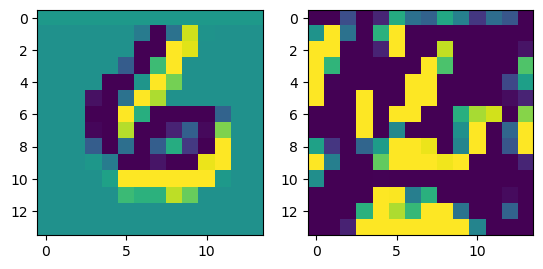

prediction: tensor([7, 3, 8]), tensor([3.5770, 2.2933, 1.3659]) groudtruth: 7
-0.07868701 0.07697155


<Figure size 640x480 with 0 Axes>

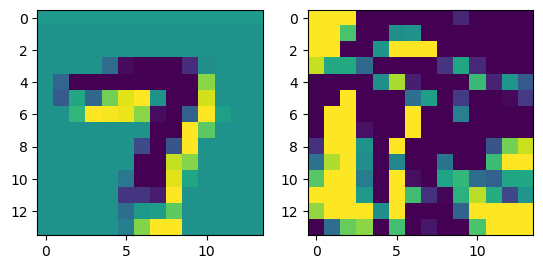

prediction: tensor([8, 7, 0]), tensor([3.8405, 1.8733, 1.0698]) groudtruth: 8
-0.07757622 0.105130404


<Figure size 640x480 with 0 Axes>

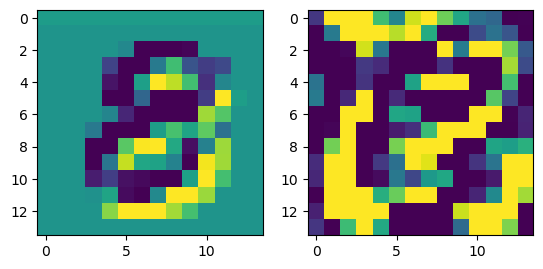

prediction: tensor([0, 5, 1]), tensor([2.8637, 2.5871, 1.5690]) groudtruth: 9
-0.10159618 0.10664105


<Figure size 640x480 with 0 Axes>

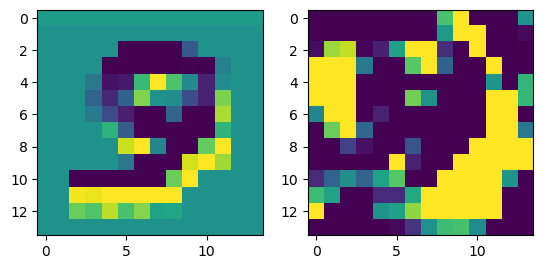

prediction: tensor([1, 7, 9]), tensor([3.5930, 2.1909, 1.4061]) groudtruth: 1
-0.085454166 0.07503969


<Figure size 640x480 with 0 Axes>

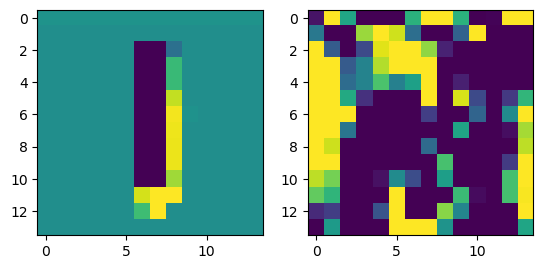

prediction: tensor([2, 7, 8]), tensor([3.8192, 1.3380, 0.4191]) groudtruth: 2
-0.084279776 0.09852052


<Figure size 640x480 with 0 Axes>

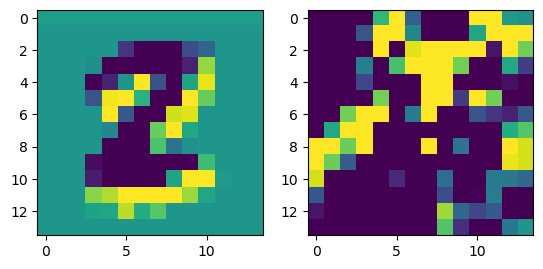

prediction: tensor([6, 1, 4]), tensor([5.4008, 2.0113, 1.8025]) groudtruth: 6
-0.0948835 0.08976379


<Figure size 640x480 with 0 Axes>

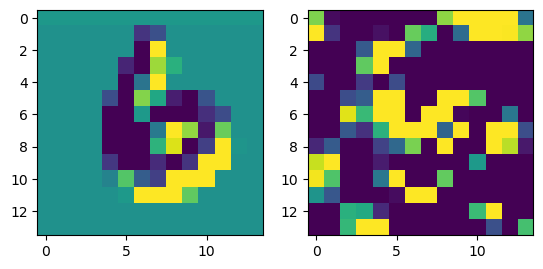

prediction: tensor([5, 2, 3]), tensor([2.9858, 2.1803, 0.5431]) groudtruth: 5
-0.07171887 0.090372026


<Figure size 640x480 with 0 Axes>

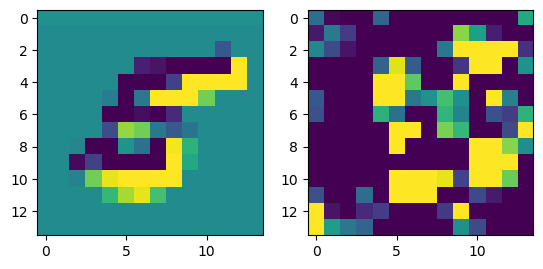

prediction: tensor([4, 1, 7]), tensor([6.7907, 2.1122, 0.2881]) groudtruth: 4
-0.07392806 0.08214502


<Figure size 640x480 with 0 Axes>

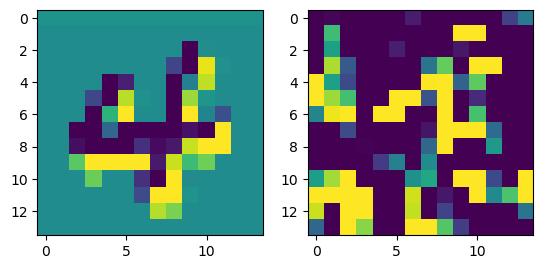

prediction: tensor([8, 9, 6]), tensor([5.3510, 0.7001, 0.4564]) groudtruth: 8
-0.07012689 0.058997214


<Figure size 640x480 with 0 Axes>

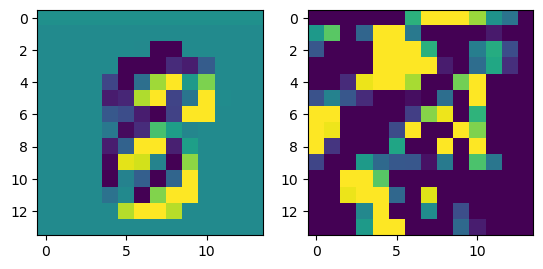

prediction: tensor([8, 5, 2]), tensor([3.4688, 2.7942, 0.9312]) groudtruth: 5
-0.086966336 0.0821252


<Figure size 640x480 with 0 Axes>

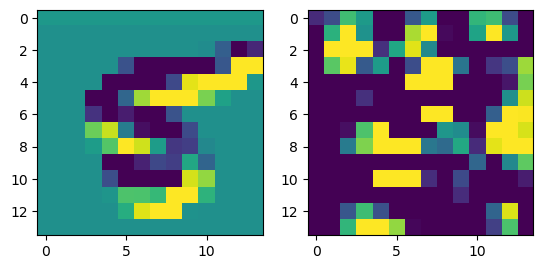

prediction: tensor([7, 8, 4]), tensor([4.8549, 1.7453, 0.8470]) groudtruth: 7
-0.06461197 0.07019682


<Figure size 640x480 with 0 Axes>

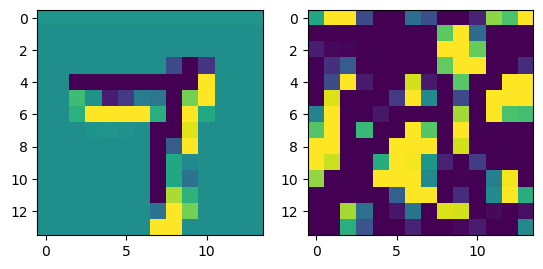

prediction: tensor([5, 2, 7]), tensor([3.5624, 1.8785, 1.0611]) groudtruth: 5
-0.09035456 0.083795846


<Figure size 640x480 with 0 Axes>

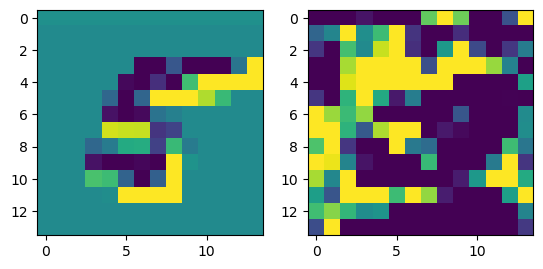

prediction: tensor([7, 3, 8]), tensor([4.7647, 1.3540, 1.1778]) groudtruth: 7
-0.086838305 0.083799966


<Figure size 640x480 with 0 Axes>

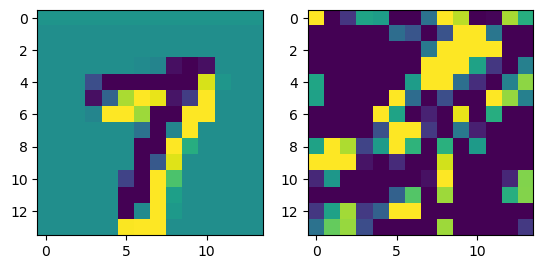

prediction: tensor([8, 5, 0]), tensor([3.9040, 2.2463, 0.8104]) groudtruth: 8
-0.08527869 0.07978006


<Figure size 640x480 with 0 Axes>

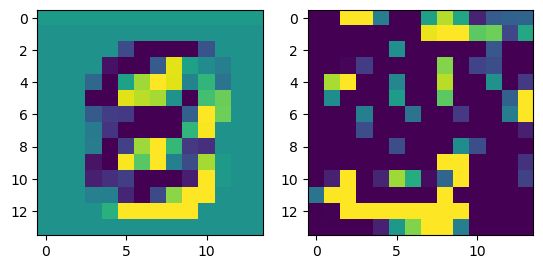

prediction: tensor([3, 5, 0]), tensor([4.3483, 2.4422, 1.6485]) groudtruth: 3
-0.07868099 0.106524974


<Figure size 640x480 with 0 Axes>

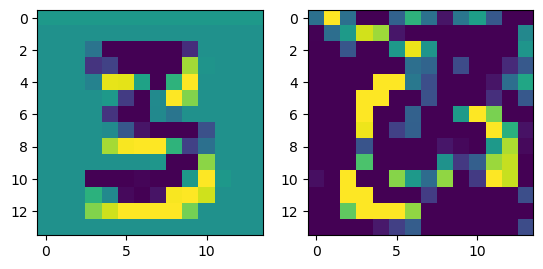

prediction: tensor([4, 2, 9]), tensor([4.9582, 1.7269, 1.5107]) groudtruth: 4
-0.097058535 0.08145964


<Figure size 640x480 with 0 Axes>

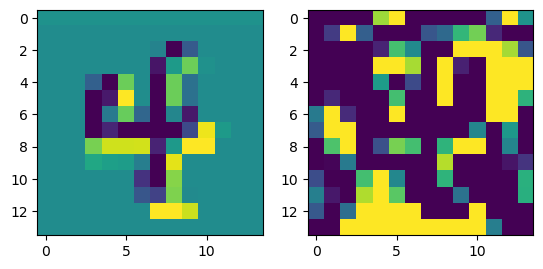

prediction: tensor([8, 0, 9]), tensor([4.0474, 1.3660, 0.9233]) groudtruth: 8
-0.07752383 0.06771775


<Figure size 640x480 with 0 Axes>

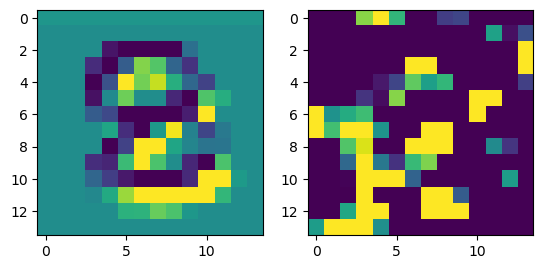

prediction: tensor([8, 0, 9]), tensor([5.9658, 1.4694, 0.6037]) groudtruth: 8
-0.07152742 0.09990165


<Figure size 640x480 with 0 Axes>

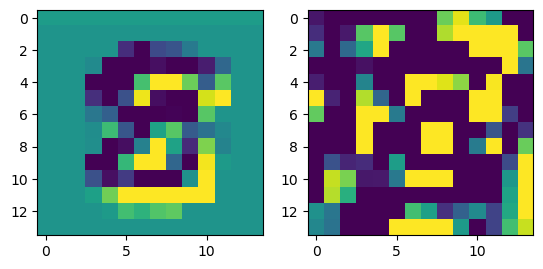

prediction: tensor([5, 3, 6]), tensor([4.4858, 1.6877, 1.5104]) groudtruth: 5
-0.09142959 0.06363341


<Figure size 640x480 with 0 Axes>

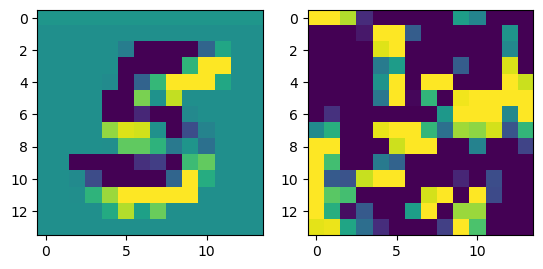

prediction: tensor([2, 7, 9]), tensor([5.5240, 0.9048, 0.8650]) groudtruth: 2
-0.0674237 0.08668042


<Figure size 640x480 with 0 Axes>

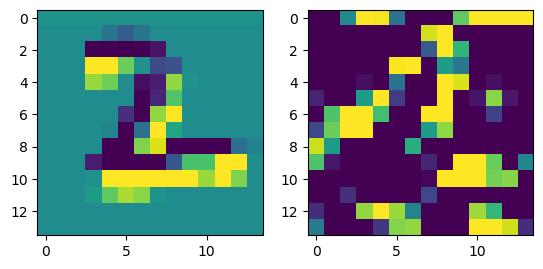

prediction: tensor([0, 1, 5]), tensor([2.4067, 1.0200, 0.4756]) groudtruth: 9
-0.08658129 0.10339533


<Figure size 640x480 with 0 Axes>

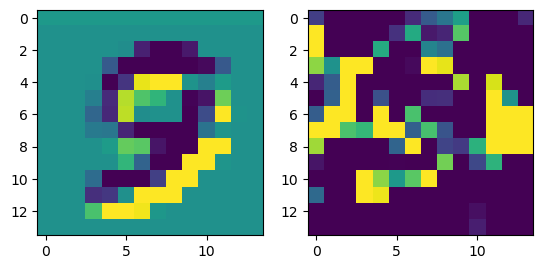

prediction: tensor([7, 6, 2]), tensor([4.9256, 0.6643, 0.3457]) groudtruth: 7
-0.08321631 0.079448864


<Figure size 640x480 with 0 Axes>

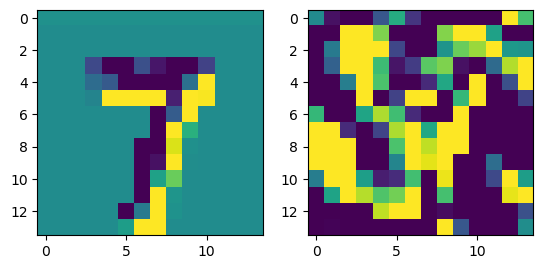

prediction: tensor([1, 6, 9]), tensor([3.9988, 1.2814, 1.0702]) groudtruth: 1
-0.08573514 0.07836817


<Figure size 640x480 with 0 Axes>

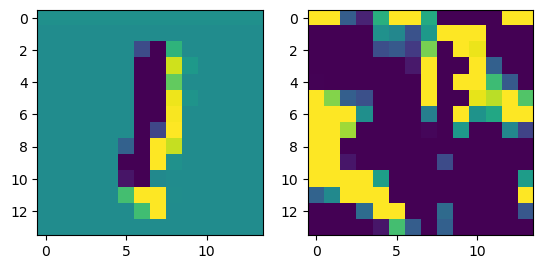

prediction: tensor([7, 6, 9]), tensor([2.6206, 1.7365, 1.0081]) groudtruth: 7
-0.09717178 0.084521234


<Figure size 640x480 with 0 Axes>

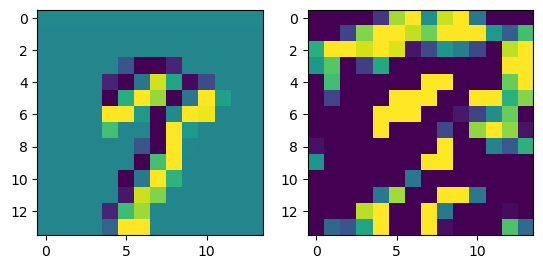

prediction: tensor([8, 3, 2]), tensor([4.5808, 3.6050, 0.7653]) groudtruth: 8
-0.068782866 0.0999129


<Figure size 640x480 with 0 Axes>

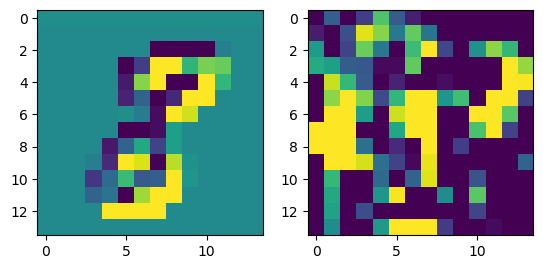

prediction: tensor([0, 9, 2]), tensor([3.5971, 2.7445, 0.7164]) groudtruth: 9
-0.095614314 0.11800004


<Figure size 640x480 with 0 Axes>

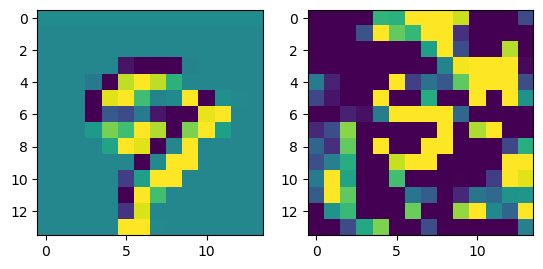

prediction: tensor([0, 7, 6]), tensor([5.9591, 1.7860, 0.7401]) groudtruth: 0
-0.11380285 0.09959696


<Figure size 640x480 with 0 Axes>

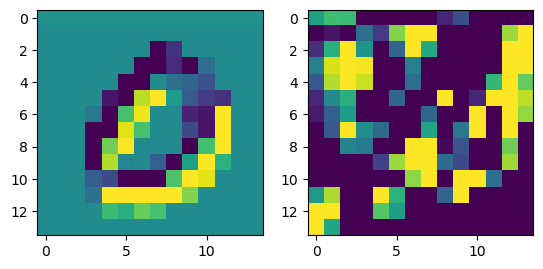

prediction: tensor([8, 3, 5]), tensor([3.4730, 2.2286, 0.7642]) groudtruth: 8
-0.090682864 0.07357285


<Figure size 640x480 with 0 Axes>

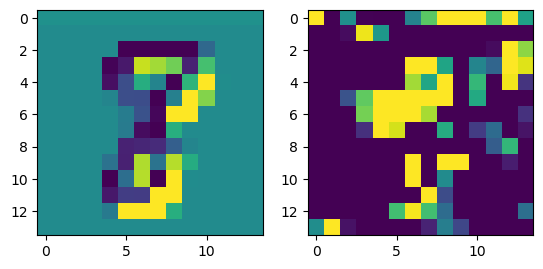

prediction: tensor([3, 8, 9]), tensor([3.9643, 0.8184, 0.2555]) groudtruth: 3
-0.11175287 0.10528761


<Figure size 640x480 with 0 Axes>

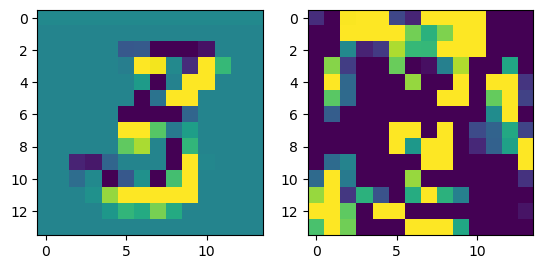

prediction: tensor([9, 7, 2]), tensor([3.9040, 1.6415, 0.7322]) groudtruth: 9
-0.07386845 0.08072297


<Figure size 640x480 with 0 Axes>

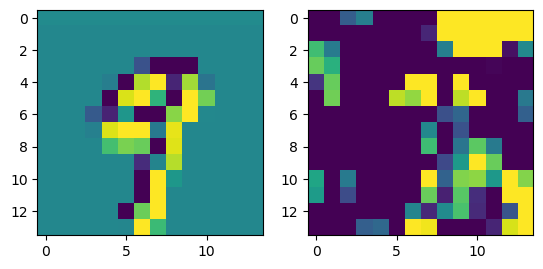

prediction: tensor([5, 3, 7]), tensor([5.4403, 4.3880, 1.0408]) groudtruth: 5
-0.08028889 0.07582453


<Figure size 640x480 with 0 Axes>

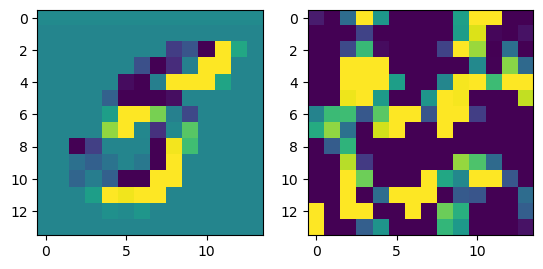

prediction: tensor([5, 3, 6]), tensor([3.9733, 2.6986, 1.0371]) groudtruth: 5
-0.06559086 0.08130677


<Figure size 640x480 with 0 Axes>

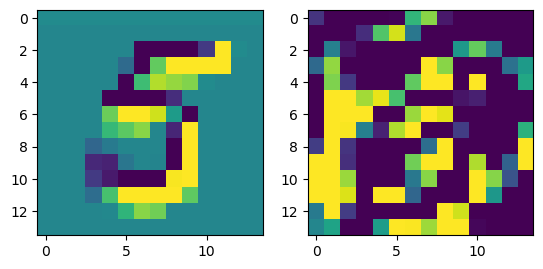

prediction: tensor([2, 3, 9]), tensor([6.4620, 1.1815, 0.7173]) groudtruth: 2
-0.09202492 0.080827385


<Figure size 640x480 with 0 Axes>

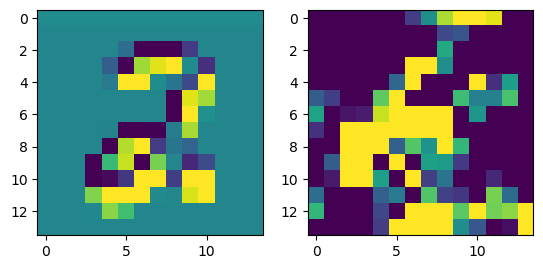

prediction: tensor([6, 0, 2]), tensor([6.2682, 0.9817, 0.6074]) groudtruth: 6
-0.12017959 0.1093531


<Figure size 640x480 with 0 Axes>

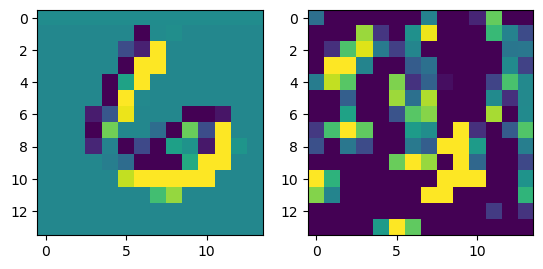

prediction: tensor([8, 3, 2]), tensor([3.5053, 1.2361, 1.0355]) groudtruth: 8
-0.09019768 0.08524084


<Figure size 640x480 with 0 Axes>

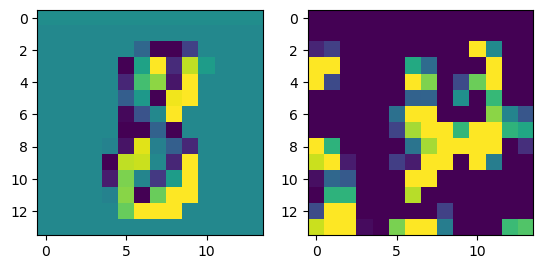

prediction: tensor([4, 3, 2]), tensor([4.6304, 1.4502, 0.9852]) groudtruth: 4
-0.08354676 0.09063114


<Figure size 640x480 with 0 Axes>

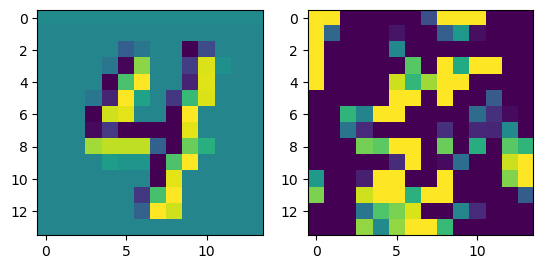

prediction: tensor([9, 8, 0]), tensor([2.6813, 1.8272, 0.5247]) groudtruth: 9
-0.08974403 0.07719672


<Figure size 640x480 with 0 Axes>

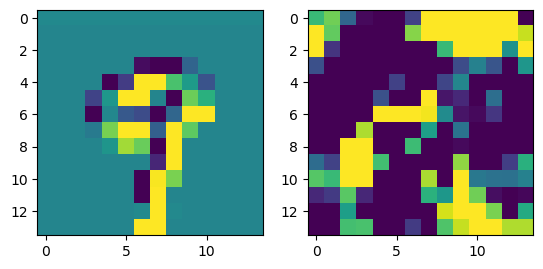

prediction: tensor([1, 7, 4]), tensor([6.5539, 1.4638, 1.2284]) groudtruth: 1
-0.10907519 0.101464644


<Figure size 640x480 with 0 Axes>

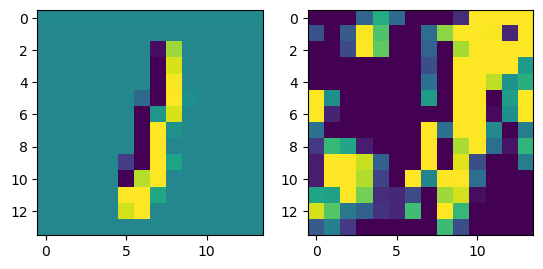

prediction: tensor([7, 9, 4]), tensor([4.4587, 1.0865, 0.9736]) groudtruth: 7
-0.05521345 0.07485831


<Figure size 640x480 with 0 Axes>

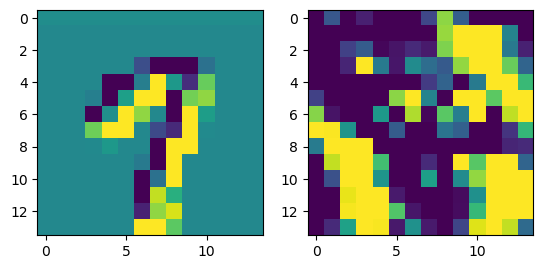

prediction: tensor([3, 2, 5]), tensor([3.4968, 0.8225, 0.4254]) groudtruth: 3
-0.060460627 0.08928628


<Figure size 640x480 with 0 Axes>

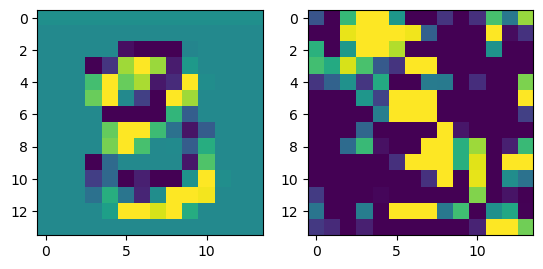

prediction: tensor([4, 3, 0]), tensor([3.9320, 1.0445, 0.4301]) groudtruth: 4
-0.085888445 0.0690616


<Figure size 640x480 with 0 Axes>

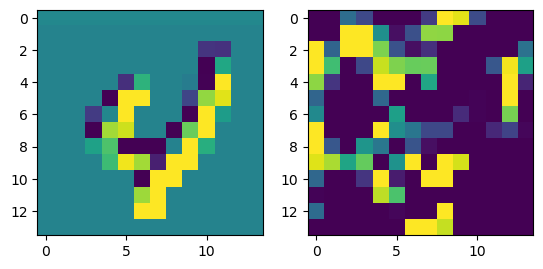

prediction: tensor([2, 3, 6]), tensor([6.0102, 1.5591, 0.7610]) groudtruth: 2
-0.09595734 0.080605954


<Figure size 640x480 with 0 Axes>

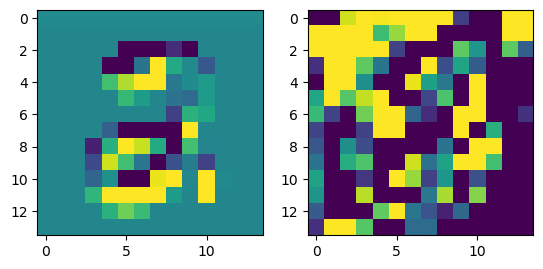

prediction: tensor([8, 5, 3]), tensor([5.3918, 1.5302, 0.2937]) groudtruth: 8
-0.06542206 0.06966911


<Figure size 640x480 with 0 Axes>

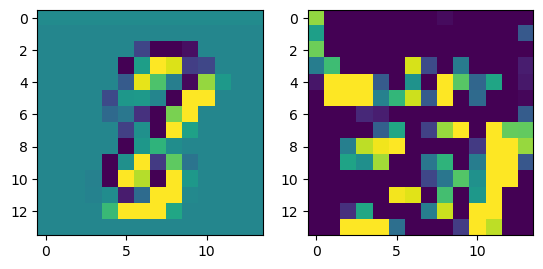

prediction: tensor([1, 6, 0]), tensor([5.1696, 0.8203, 0.7551]) groudtruth: 1
-0.11232042 0.09665599


<Figure size 640x480 with 0 Axes>

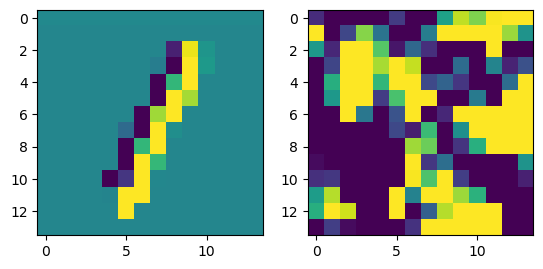

prediction: tensor([5, 3, 9]), tensor([3.9382, 1.1777, 0.4516]) groudtruth: 5
-0.12921679 0.1420163


<Figure size 640x480 with 0 Axes>

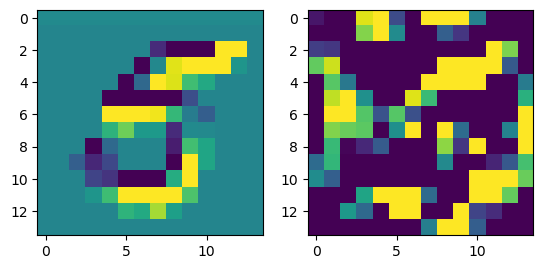

prediction: tensor([1, 6, 5]), tensor([4.2322, 1.0896, 0.8251]) groudtruth: 1
-0.07564467 0.111196026


<Figure size 640x480 with 0 Axes>

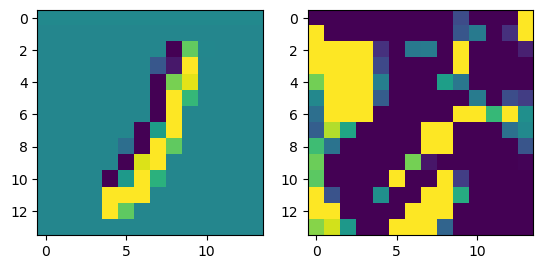

prediction: tensor([4, 2, 3]), tensor([3.4328, 3.2819, 1.1239]) groudtruth: 2
-0.089669645 0.07337523


<Figure size 640x480 with 0 Axes>

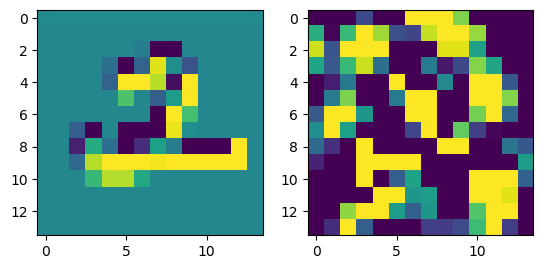

prediction: tensor([0, 6, 7]), tensor([5.1841, 1.2714, 0.8007]) groudtruth: 0
-0.06819838 0.083759904


<Figure size 640x480 with 0 Axes>

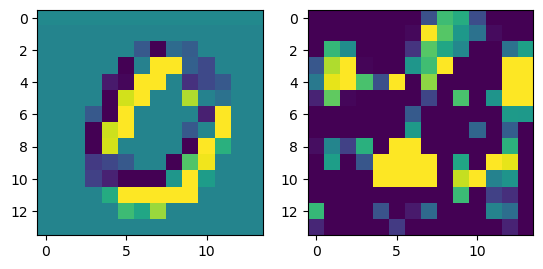

prediction: tensor([2, 3, 4]), tensor([6.0698, 2.5567, 2.4892]) groudtruth: 2
-0.07492709 0.0784004


<Figure size 640x480 with 0 Axes>

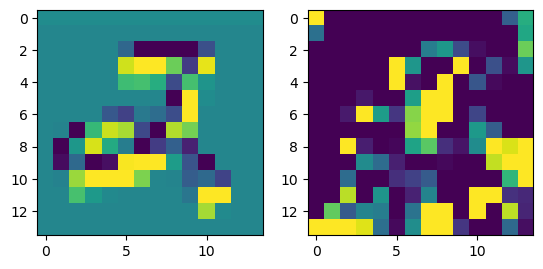

prediction: tensor([5, 3, 6]), tensor([4.5212, 1.4919, 1.1506]) groudtruth: 5
-0.07011706 0.08898631


<Figure size 640x480 with 0 Axes>

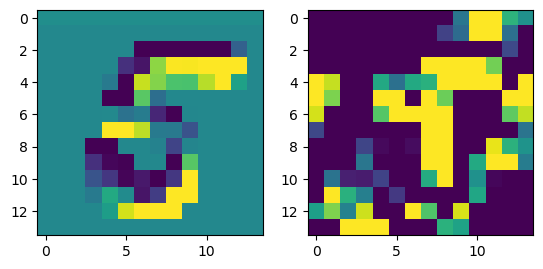

prediction: tensor([6, 1, 2]), tensor([4.4762, 0.5126, 0.3000]) groudtruth: 6
-0.0820393 0.068058014


<Figure size 640x480 with 0 Axes>

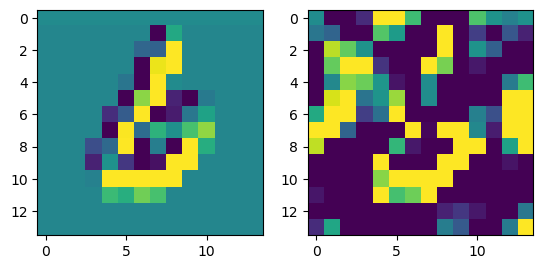

prediction: tensor([4, 2, 5]), tensor([5.8092, 1.6946, 1.2835]) groudtruth: 4
-0.11331689 0.08419311


<Figure size 640x480 with 0 Axes>

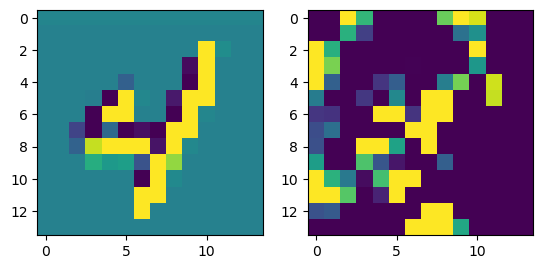

prediction: tensor([3, 5, 1]), tensor([6.0949, 1.7765, 0.4540]) groudtruth: 3
-0.08178401 0.06835793


<Figure size 640x480 with 0 Axes>

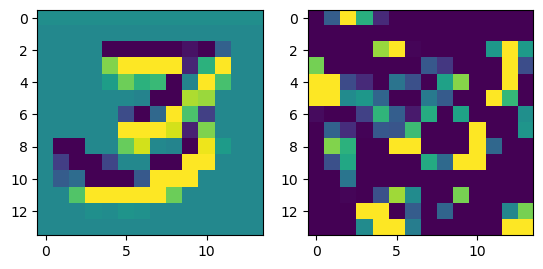

prediction: tensor([0, 3, 1]), tensor([ 7.5624,  2.1487, -0.2277]) groudtruth: 0
-0.069386065 0.09192666


<Figure size 640x480 with 0 Axes>

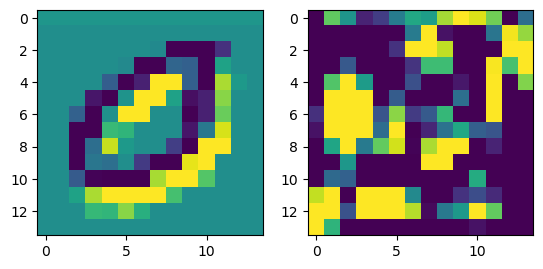

prediction: tensor([0, 3, 6]), tensor([5.5148, 0.6336, 0.3939]) groudtruth: 0
-0.08272648 0.081761144


<Figure size 640x480 with 0 Axes>

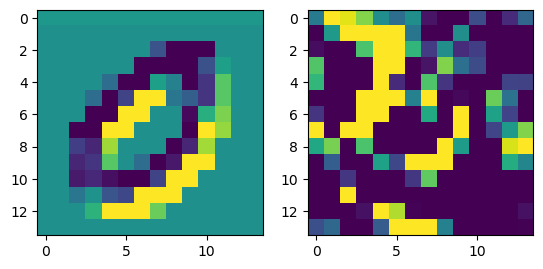

prediction: tensor([8, 6, 1]), tensor([6.7492, 2.4719, 0.0853]) groudtruth: 8
-0.09421468 0.10205219


<Figure size 640x480 with 0 Axes>

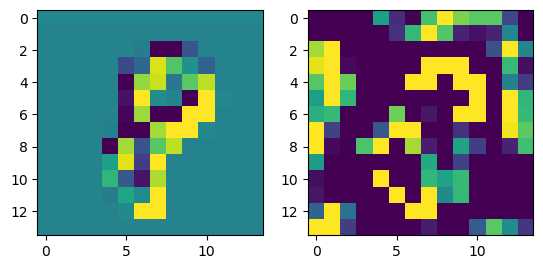

prediction: tensor([2, 4, 5]), tensor([3.5334, 2.4513, 1.1497]) groudtruth: 2
-0.0796721 0.066648975


<Figure size 640x480 with 0 Axes>

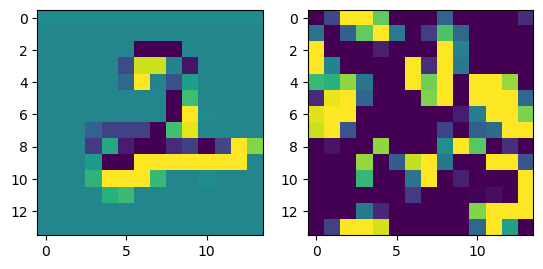

prediction: tensor([1, 0, 8]), tensor([4.3088, 0.7194, 0.4810]) groudtruth: 1
-0.07800245 0.099115826


<Figure size 640x480 with 0 Axes>

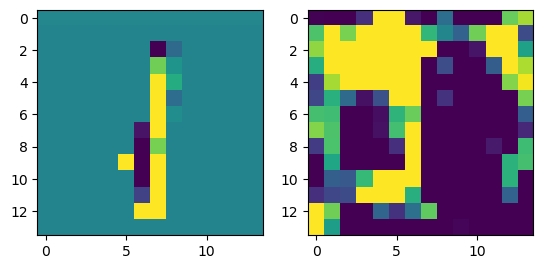

prediction: tensor([7, 2, 1]), tensor([2.9118, 1.5467, 1.4246]) groudtruth: 7
-0.07802075 0.07563553


<Figure size 640x480 with 0 Axes>

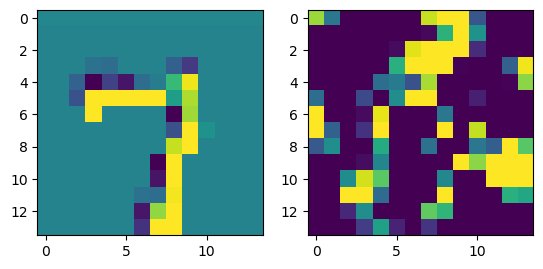

prediction: tensor([2, 4, 1]), tensor([6.8527, 2.6986, 1.2962]) groudtruth: 2
-0.08259463 0.07519771


<Figure size 640x480 with 0 Axes>

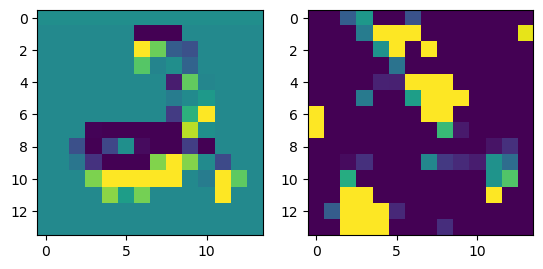

prediction: tensor([5, 3, 0]), tensor([5.9163, 4.3621, 1.3489]) groudtruth: 5
-0.07752234 0.0837016


<Figure size 640x480 with 0 Axes>

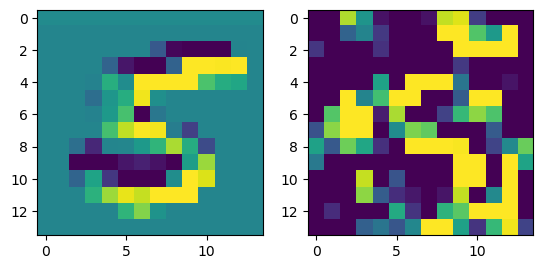

prediction: tensor([0, 9, 5]), tensor([5.2317, 1.2452, 0.6825]) groudtruth: 0
-0.11263627 0.09123422


<Figure size 640x480 with 0 Axes>

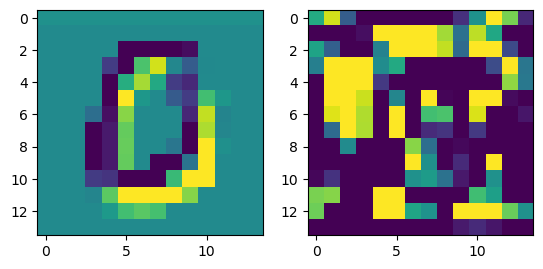

prediction: tensor([8, 2, 6]), tensor([3.4360, 2.7507, 0.9059]) groudtruth: 8
-0.078976035 0.06410301


<Figure size 640x480 with 0 Axes>

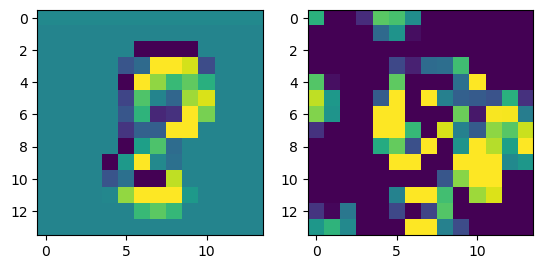

prediction: tensor([0, 6, 7]), tensor([6.0507, 2.4847, 0.4741]) groudtruth: 0
-0.08452016 0.068161525


<Figure size 640x480 with 0 Axes>

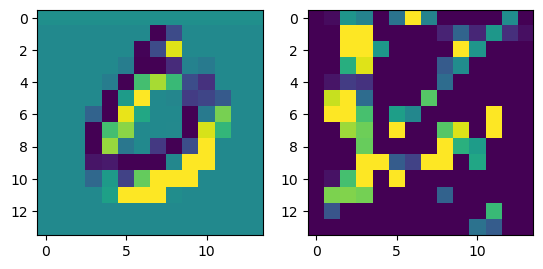

prediction: tensor([2, 8, 3]), tensor([6.1619, 0.9570, 0.4623]) groudtruth: 2
-0.10333252 0.099793315


<Figure size 640x480 with 0 Axes>

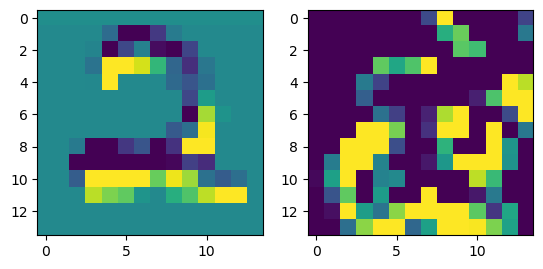

prediction: tensor([7, 6, 0]), tensor([3.6632, 0.8560, 0.4244]) groudtruth: 7
-0.06881487 0.102480255


<Figure size 640x480 with 0 Axes>

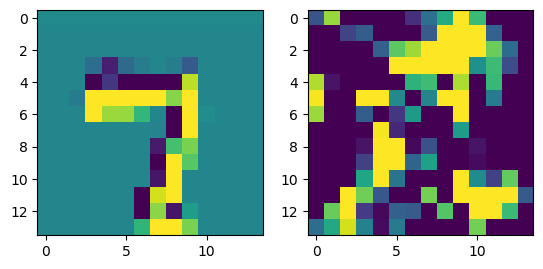

prediction: tensor([0, 2, 6]), tensor([1.8331, 1.8298, 1.7993]) groudtruth: 8
-0.07026529 0.10770091


<Figure size 640x480 with 0 Axes>

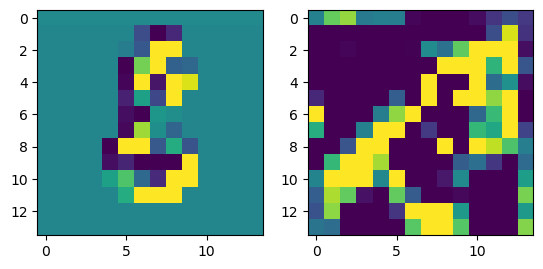

prediction: tensor([8, 6, 2]), tensor([4.2424, 1.8910, 1.4389]) groudtruth: 8
-0.06112677 0.0658458


<Figure size 640x480 with 0 Axes>

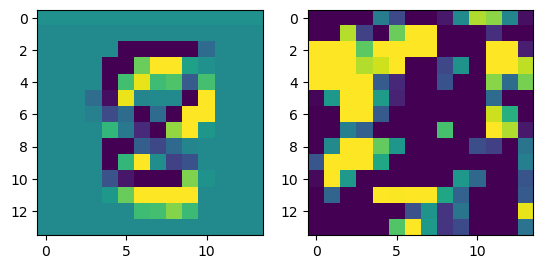

prediction: tensor([3, 9, 5]), tensor([4.1165, 3.0629, 0.6941]) groudtruth: 3
-0.11094308 0.11934741


<Figure size 640x480 with 0 Axes>

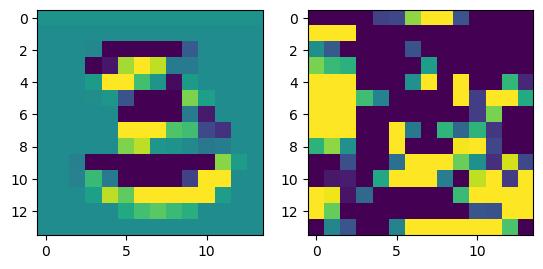

prediction: tensor([6, 8, 4]), tensor([6.8759, 1.5257, 1.3577]) groudtruth: 6
-0.093202055 0.07687031


<Figure size 640x480 with 0 Axes>

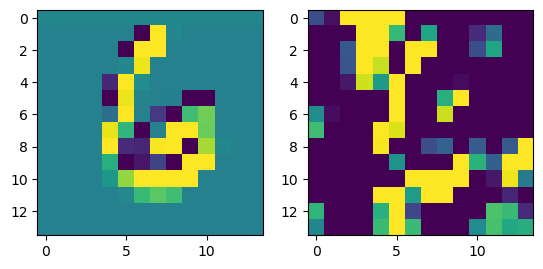

prediction: tensor([0, 2, 5]), tensor([4.8719, 1.4430, 1.2402]) groudtruth: 0
-0.06472808 0.10077085


<Figure size 640x480 with 0 Axes>

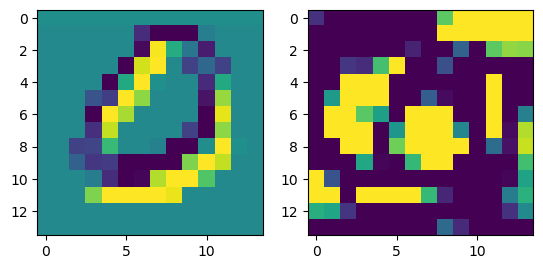

prediction: tensor([6, 0, 4]), tensor([3.4387, 1.5568, 1.3918]) groudtruth: 0
-0.07974464 0.07613743


<Figure size 640x480 with 0 Axes>

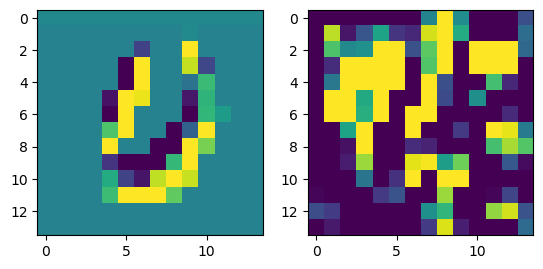

prediction: tensor([9, 7, 8]), tensor([3.2898, 1.5212, 0.2407]) groudtruth: 9
-0.09491038 0.0887686


<Figure size 640x480 with 0 Axes>

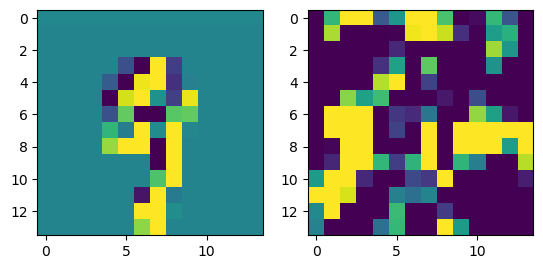

prediction: tensor([6, 7, 1]), tensor([6.2976, 1.7390, 1.0502]) groudtruth: 6
-0.07931167 0.09333154


<Figure size 640x480 with 0 Axes>

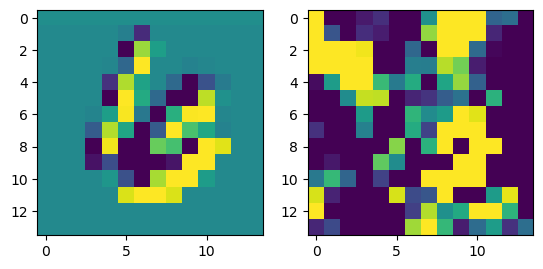

prediction: tensor([6, 8, 0]), tensor([2.8496, 2.8295, 1.0118]) groudtruth: 8
-0.09579772 0.06639259


<Figure size 640x480 with 0 Axes>

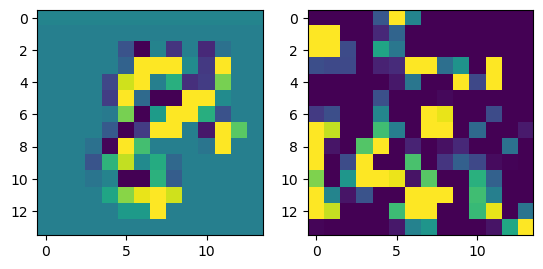

prediction: tensor([8, 6, 4]), tensor([5.1498, 2.6789, 1.3318]) groudtruth: 8
-0.06513834 0.12464103


<Figure size 640x480 with 0 Axes>

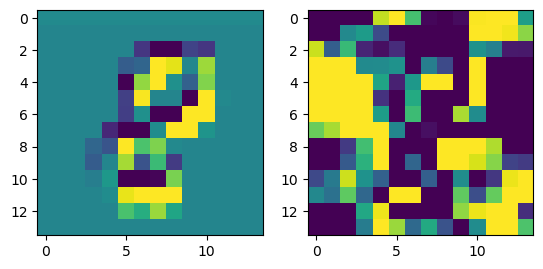

prediction: tensor([5, 8, 6]), tensor([6.6814, 2.3875, 1.9303]) groudtruth: 5
-0.09135026 0.09410356


<Figure size 640x480 with 0 Axes>

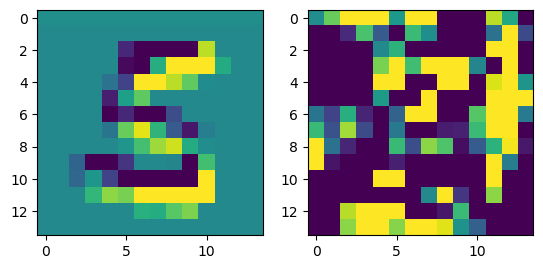

prediction: tensor([6, 9, 7]), tensor([3.4643, 1.9178, 1.2984]) groudtruth: 6
-0.05720377 0.07098766


<Figure size 640x480 with 0 Axes>

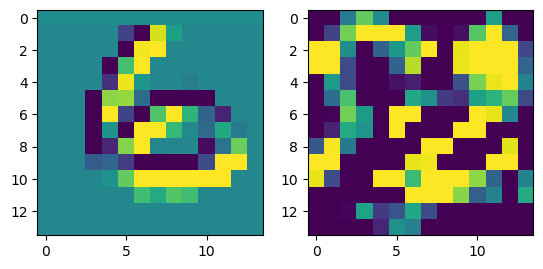

prediction: tensor([1, 7, 9]), tensor([5.6901, 1.9546, 0.1461]) groudtruth: 1
-0.085335195 0.07792387


<Figure size 640x480 with 0 Axes>

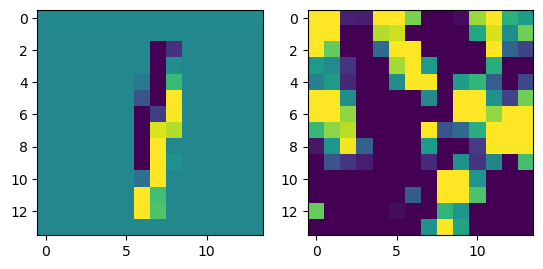

prediction: tensor([1, 5, 6]), tensor([5.3307, 0.8037, 0.5266]) groudtruth: 1
-0.09423202 0.06295334


<Figure size 640x480 with 0 Axes>

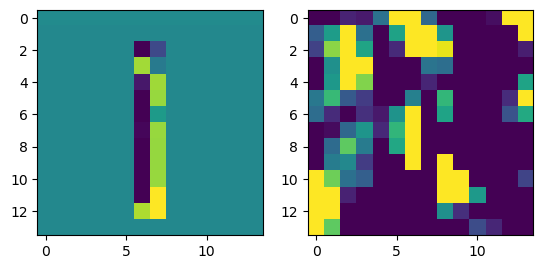

prediction: tensor([9, 4, 2]), tensor([4.2875, 2.2233, 1.2980]) groudtruth: 9
-0.062252223 0.059745487


<Figure size 640x480 with 0 Axes>

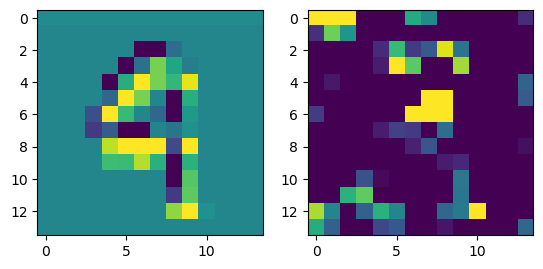

prediction: tensor([8, 6, 2]), tensor([3.5874, 1.3860, 0.8885]) groudtruth: 8
-0.07317203 0.09788217


<Figure size 640x480 with 0 Axes>

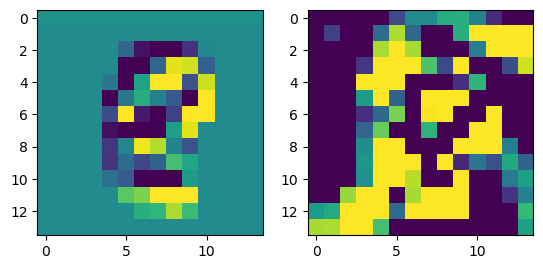

prediction: tensor([9, 7, 2]), tensor([3.9675, 2.7805, 0.6295]) groudtruth: 9
-0.102592885 0.09339593


<Figure size 640x480 with 0 Axes>

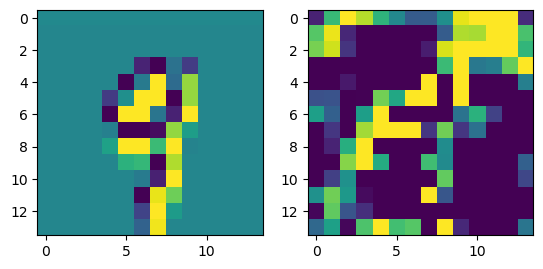

prediction: tensor([2, 0, 9]), tensor([3.9296, 3.0626, 1.0425]) groudtruth: 2
-0.097468615 0.08623886


<Figure size 640x480 with 0 Axes>

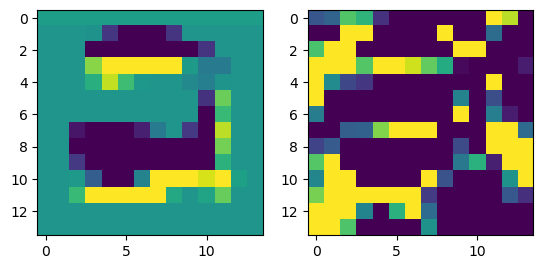

prediction: tensor([3, 9, 5]), tensor([5.2876, 1.4465, 0.4334]) groudtruth: 3
-0.069473445 0.07842532


<Figure size 640x480 with 0 Axes>

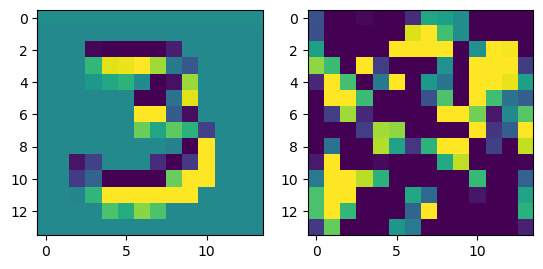

prediction: tensor([5, 3, 2]), tensor([5.1569, 2.0805, 0.5628]) groudtruth: 5
-0.06930208 0.091243595


<Figure size 640x480 with 0 Axes>

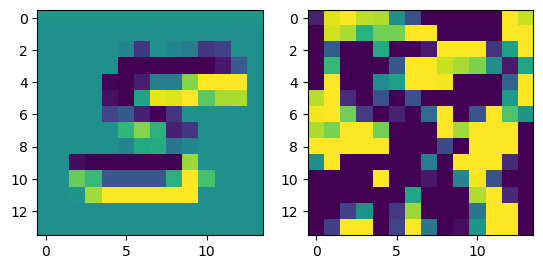

prediction: tensor([5, 3, 1]), tensor([6.0988, 2.6124, 1.6158]) groudtruth: 5
-0.060969293 0.07356732


<Figure size 640x480 with 0 Axes>

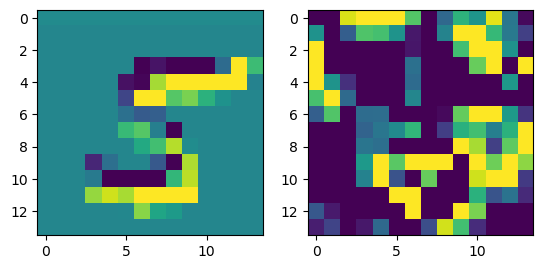

prediction: tensor([8, 5, 6]), tensor([3.8239, 2.2303, 1.4844]) groudtruth: 8
-0.07445687 0.08396709


<Figure size 640x480 with 0 Axes>

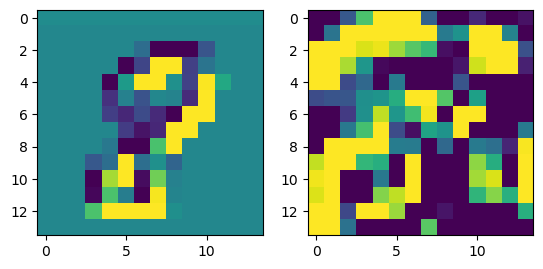

prediction: tensor([3, 2, 5]), tensor([2.9353, 1.5323, 1.5052]) groudtruth: 3
-0.08665484 0.09706047


<Figure size 640x480 with 0 Axes>

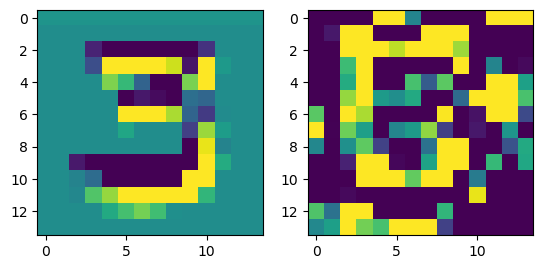

prediction: tensor([2, 8, 5]), tensor([6.8369, 2.4019, 1.2997]) groudtruth: 2
-0.07724565 0.10235588


<Figure size 640x480 with 0 Axes>

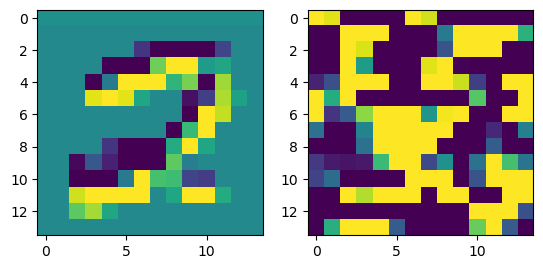

prediction: tensor([8, 9, 7]), tensor([5.3857, 0.5398, 0.4823]) groudtruth: 8
-0.058719397 0.106390566


<Figure size 640x480 with 0 Axes>

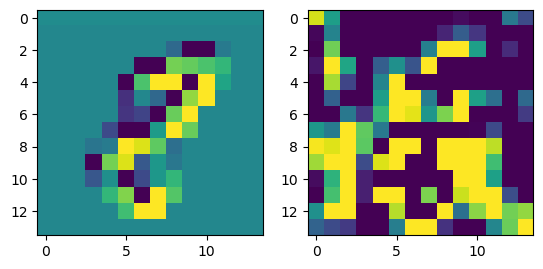

prediction: tensor([1, 2, 6]), tensor([3.1318, 1.4001, 0.4601]) groudtruth: 1
-0.08390802 0.0775811


<Figure size 640x480 with 0 Axes>

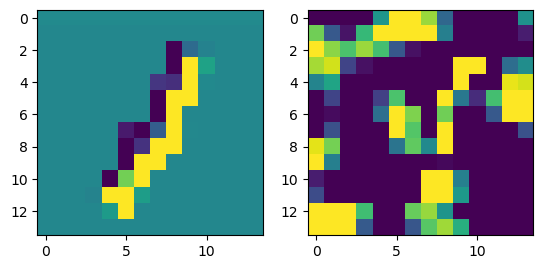

prediction: tensor([2, 7, 4]), tensor([5.2814, 2.1120, 0.8423]) groudtruth: 2
-0.095979095 0.09061424


<Figure size 640x480 with 0 Axes>

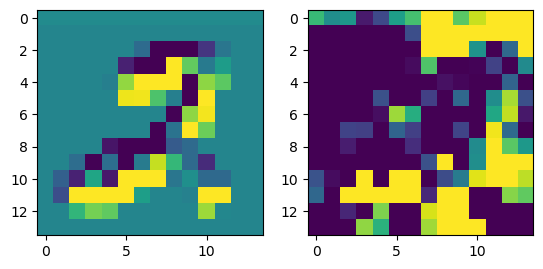

prediction: tensor([0, 4, 7]), tensor([3.2302, 1.6931, 1.6498]) groudtruth: 0
-0.07861906 0.0738287


<Figure size 640x480 with 0 Axes>

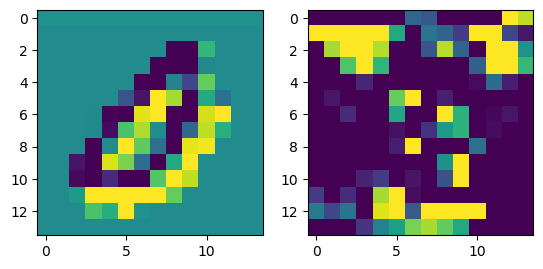

prediction: tensor([7, 6, 4]), tensor([3.8282, 2.6782, 2.5670]) groudtruth: 7
-0.08916032 0.08544451


<Figure size 640x480 with 0 Axes>

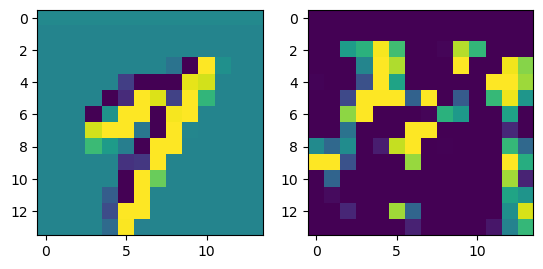

prediction: tensor([1, 0, 6]), tensor([2.9819, 0.6521, 0.5080]) groudtruth: 1
-0.076206446 0.11608222


<Figure size 640x480 with 0 Axes>

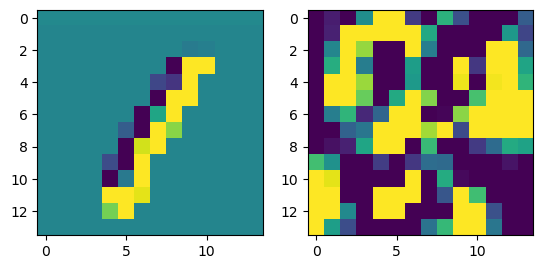

prediction: tensor([0, 2, 7]), tensor([6.6973, 3.6100, 2.7883]) groudtruth: 0
-0.099175334 0.078752115


<Figure size 640x480 with 0 Axes>

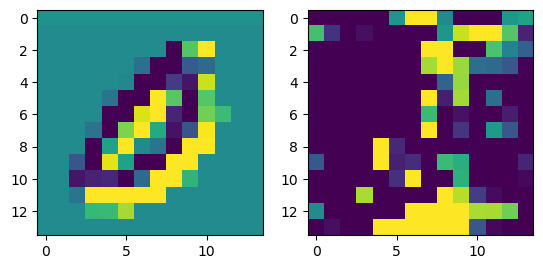

prediction: tensor([8, 4, 2]), tensor([3.7083, 1.5649, 0.4792]) groudtruth: 4
-0.08890712 0.08526835


<Figure size 640x480 with 0 Axes>

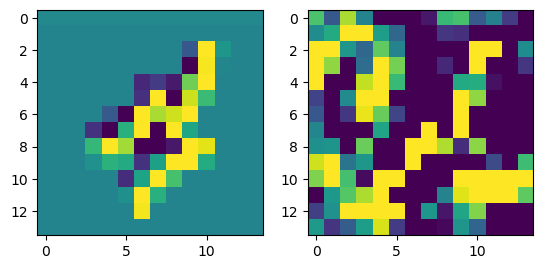

prediction: tensor([4, 0, 1]), tensor([5.4551, 1.5497, 1.0502]) groudtruth: 4
-0.05915886 0.06047783


<Figure size 640x480 with 0 Axes>

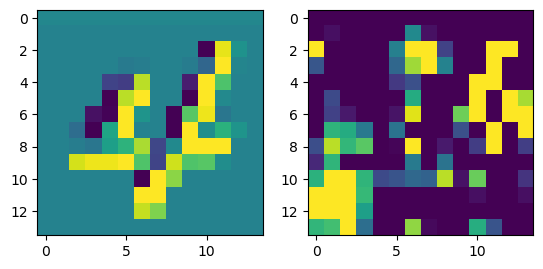

prediction: tensor([5, 3, 0]), tensor([6.4062, 1.6708, 0.2035]) groudtruth: 5
-0.109607875 0.12056129


<Figure size 640x480 with 0 Axes>

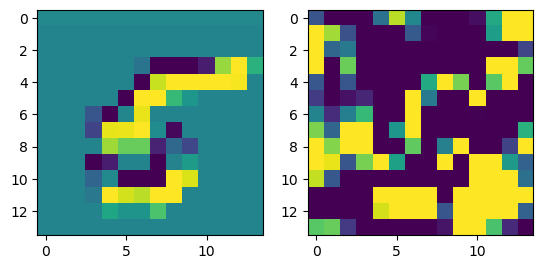

prediction: tensor([8, 1, 5]), tensor([3.8747, 3.2483, 2.4648]) groudtruth: 8
-0.052520335 0.097800985


<Figure size 640x480 with 0 Axes>

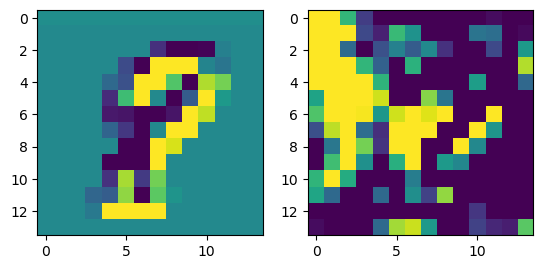

prediction: tensor([0, 7, 3]), tensor([4.8822, 2.1975, 1.0578]) groudtruth: 0
-0.06605536 0.08939634


<Figure size 640x480 with 0 Axes>

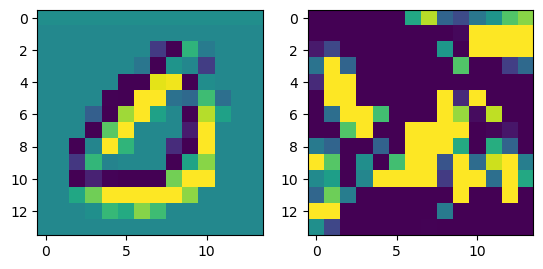

prediction: tensor([6, 2, 9]), tensor([4.4224, 1.3495, 1.2432]) groudtruth: 6
-0.07720941 0.07757801


<Figure size 640x480 with 0 Axes>

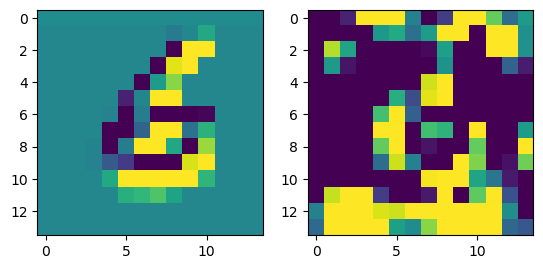

prediction: tensor([2, 4, 7]), tensor([4.2126, 1.6263, 0.8039]) groudtruth: 2
-0.102752864 0.08581532


<Figure size 640x480 with 0 Axes>

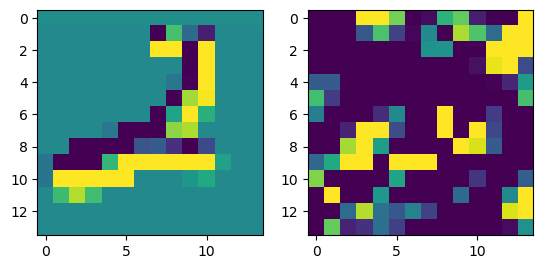

prediction: tensor([4, 9, 7]), tensor([5.7745, 1.7609, 0.6934]) groudtruth: 4
-0.07896614 0.06758878


<Figure size 640x480 with 0 Axes>

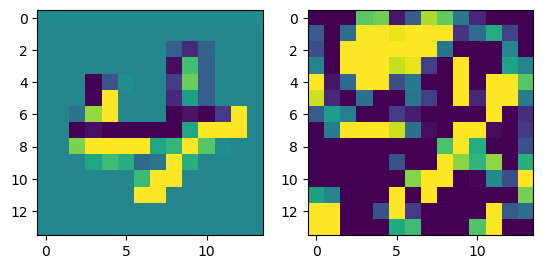

prediction: tensor([5, 3, 4]), tensor([4.2170, 1.2797, 1.0258]) groudtruth: 5
-0.13272846 0.07115117


<Figure size 640x480 with 0 Axes>

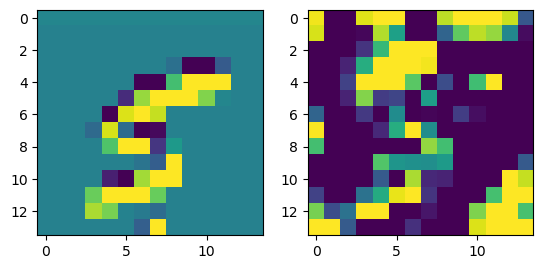

prediction: tensor([6, 7, 8]), tensor([5.6098, 0.8447, 0.5617]) groudtruth: 6
-0.086964846 0.08974716


<Figure size 640x480 with 0 Axes>

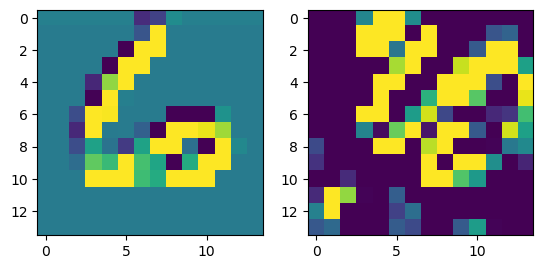

prediction: tensor([7, 0, 3]), tensor([5.9017, 3.7351, 0.6399]) groudtruth: 0
-0.06841141 0.074399486


<Figure size 640x480 with 0 Axes>

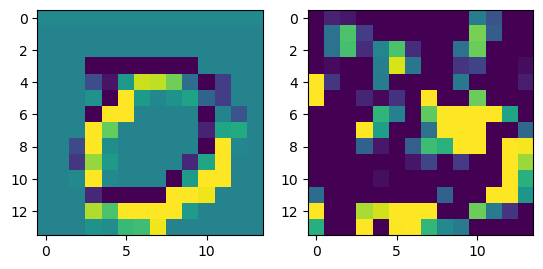

prediction: tensor([1, 7, 4]), tensor([6.9951, 1.1330, 0.2218]) groudtruth: 1
-0.07850301 0.07948676


<Figure size 640x480 with 0 Axes>

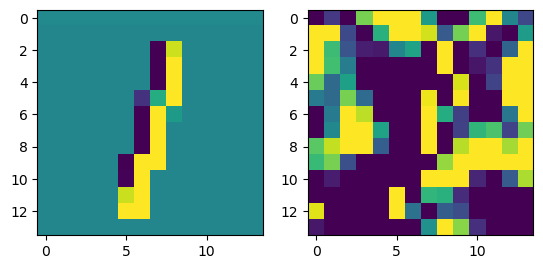

prediction: tensor([2, 8, 7]), tensor([5.0743, 2.8663, 2.2255]) groudtruth: 2
-0.09220278 0.090262495


<Figure size 640x480 with 0 Axes>

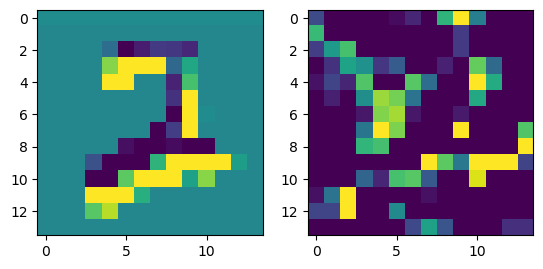

prediction: tensor([3, 9, 5]), tensor([4.5539, 2.0275, 1.8803]) groudtruth: 3
-0.07694602 0.09013672


<Figure size 640x480 with 0 Axes>

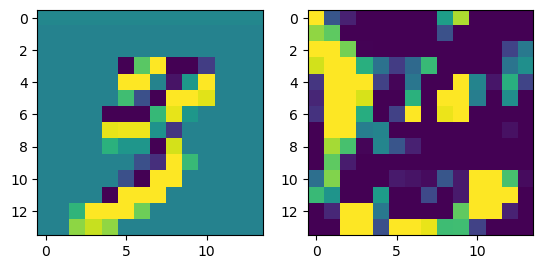

prediction: tensor([4, 1, 5]), tensor([5.2790, 1.7423, 0.3870]) groudtruth: 4
-0.09389138 0.089781746


<Figure size 640x480 with 0 Axes>

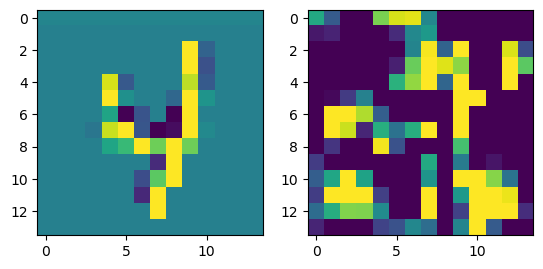

prediction: tensor([5, 3, 9]), tensor([3.6131, 2.7590, 1.6577]) groudtruth: 5
-0.08401579 0.07458527


<Figure size 640x480 with 0 Axes>

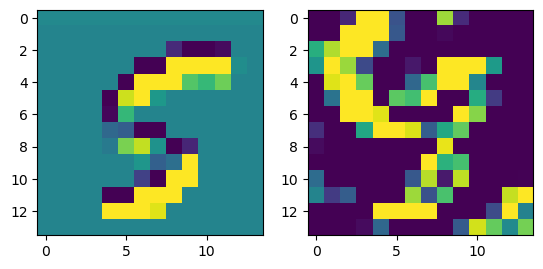

prediction: tensor([1, 6, 9]), tensor([2.0808, 2.0488, 1.7270]) groudtruth: 6
-0.057563543 0.06584698


<Figure size 640x480 with 0 Axes>

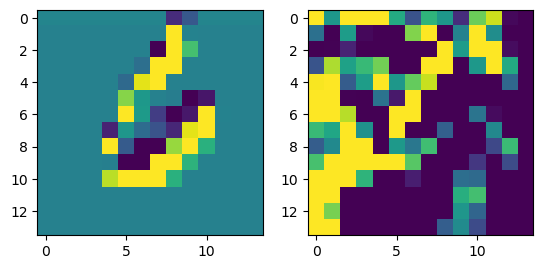

prediction: tensor([7, 3, 6]), tensor([4.4321, 1.8513, 0.8907]) groudtruth: 7
-0.107035816 0.05412004


<Figure size 640x480 with 0 Axes>

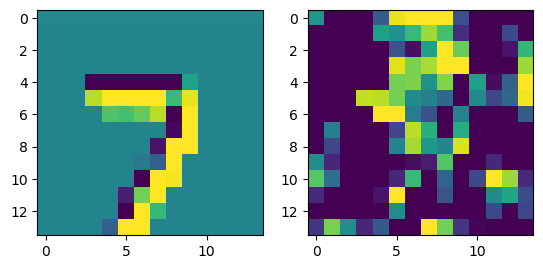

prediction: tensor([1, 9, 2]), tensor([4.5839, 1.3556, 1.2489]) groudtruth: 1
-0.06511974 0.089338616


<Figure size 640x480 with 0 Axes>

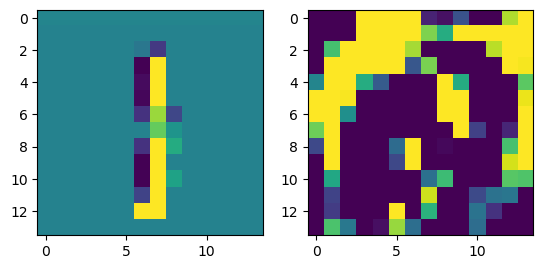

prediction: tensor([7, 2, 9]), tensor([3.2363, 3.1883, 2.2435]) groudtruth: 2
-0.06742221 0.060968928


<Figure size 640x480 with 0 Axes>

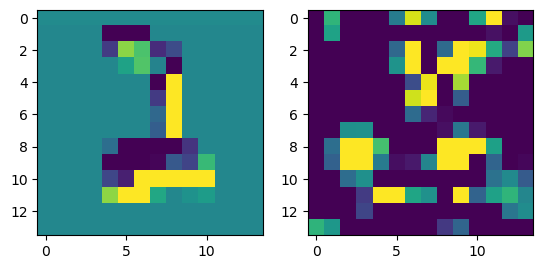

prediction: tensor([3, 0, 4]), tensor([3.8195, 2.2275, 1.7059]) groudtruth: 3
-0.07583231 0.08144749


<Figure size 640x480 with 0 Axes>

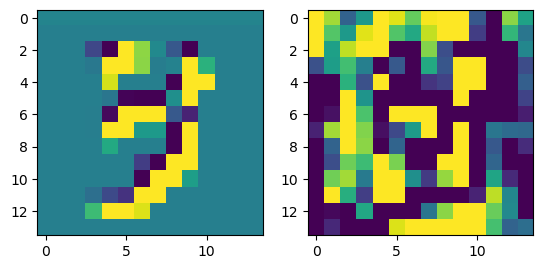

prediction: tensor([4, 3, 1]), tensor([7.1667, 2.9692, 0.5507]) groudtruth: 4
-0.06101507 0.08382149


<Figure size 640x480 with 0 Axes>

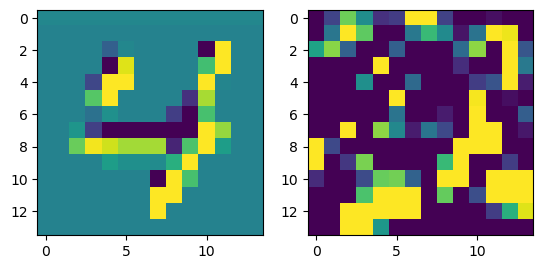

prediction: tensor([9, 4, 6]), tensor([4.9221, 1.6482, 0.9975]) groudtruth: 9
-0.06158352 0.0874264


<Figure size 640x480 with 0 Axes>

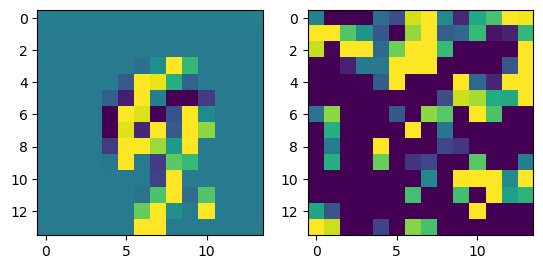

prediction: tensor([3, 7, 2]), tensor([4.1966, 1.3833, 0.9171]) groudtruth: 3
-0.0780862 0.08849634


<Figure size 640x480 with 0 Axes>

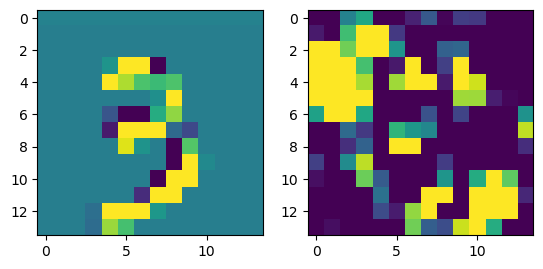

prediction: tensor([2, 3, 4]), tensor([5.6976, 3.5972, 2.0374]) groudtruth: 2
-0.101418674 0.08406703


<Figure size 640x480 with 0 Axes>

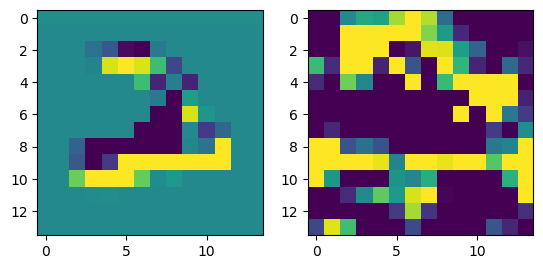

prediction: tensor([8, 5, 1]), tensor([4.0725, 3.2098, 0.8289]) groudtruth: 8
-0.09506661 0.11282937


<Figure size 640x480 with 0 Axes>

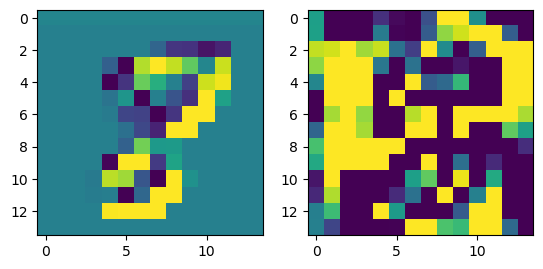

prediction: tensor([6, 3, 7]), tensor([5.5712, 2.0399, 1.0679]) groudtruth: 6
-0.074694276 0.062267564


<Figure size 640x480 with 0 Axes>

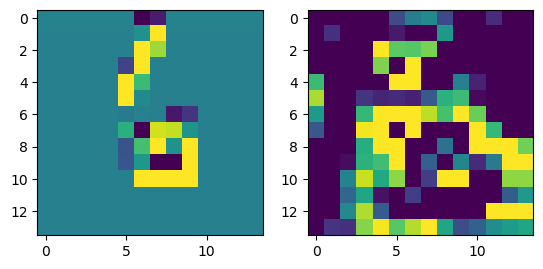

prediction: tensor([7, 0, 6]), tensor([2.9564, 2.2688, 1.6157]) groudtruth: 0
-0.056226134 0.075865984


<Figure size 640x480 with 0 Axes>

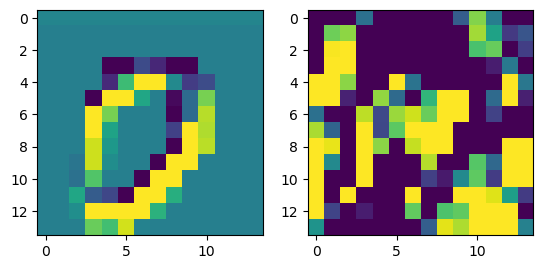

prediction: tensor([9, 5, 3]), tensor([3.0623, 1.9604, 1.9581]) groudtruth: 5
-0.07461882 0.06444655


<Figure size 640x480 with 0 Axes>

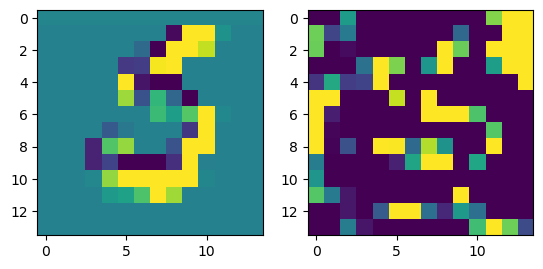

prediction: tensor([7, 9, 6]), tensor([3.0345, 1.1695, 0.0868]) groudtruth: 7
-0.08605552 0.0801117


<Figure size 640x480 with 0 Axes>

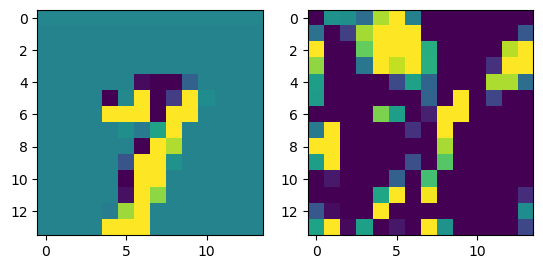

prediction: tensor([5, 3, 8]), tensor([6.3222, 2.8614, 0.4634]) groudtruth: 5
-0.0789122 0.084906444


<Figure size 640x480 with 0 Axes>

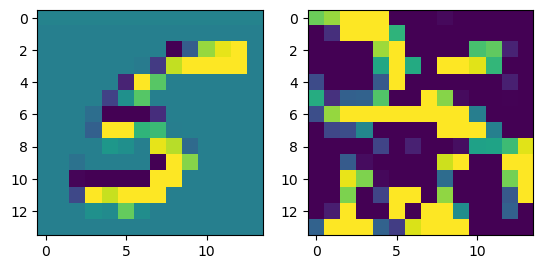

prediction: tensor([1, 4, 2]), tensor([7.2100, 1.2816, 0.4246]) groudtruth: 1
-0.10377616 0.11313422


<Figure size 640x480 with 0 Axes>

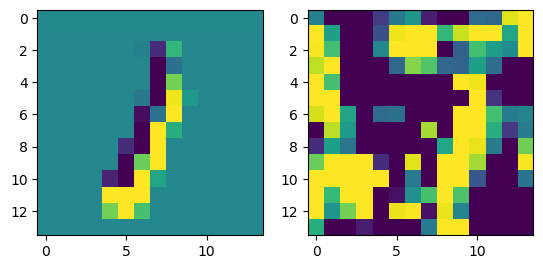

prediction: tensor([0, 7, 5]), tensor([4.0238, 1.3743, 0.8619]) groudtruth: 0
-0.10038364 0.10265792


<Figure size 640x480 with 0 Axes>

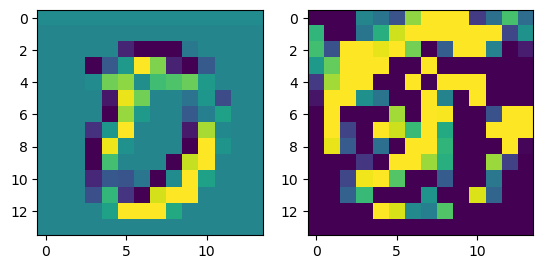

prediction: tensor([7, 9, 5]), tensor([2.6406, 1.1713, 0.7615]) groudtruth: 8
-0.079972744 0.084574826


<Figure size 640x480 with 0 Axes>

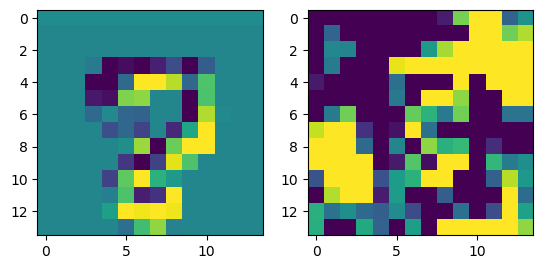

prediction: tensor([1, 6, 8]), tensor([7.4963, 1.6044, 0.8417]) groudtruth: 1
-0.07632136 0.114342235


<Figure size 640x480 with 0 Axes>

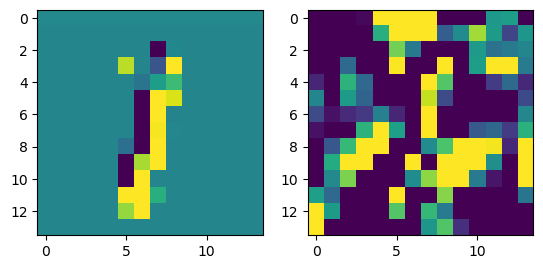

prediction: tensor([7, 0, 6]), tensor([1.5439, 1.0084, 0.7496]) groudtruth: 6
-0.08114201 0.07860224


<Figure size 640x480 with 0 Axes>

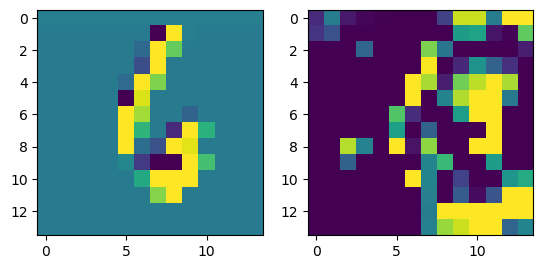

prediction: tensor([7, 0, 6]), tensor([4.2175, 2.4291, 1.4105]) groudtruth: 7
-0.067353666 0.07867718


<Figure size 640x480 with 0 Axes>

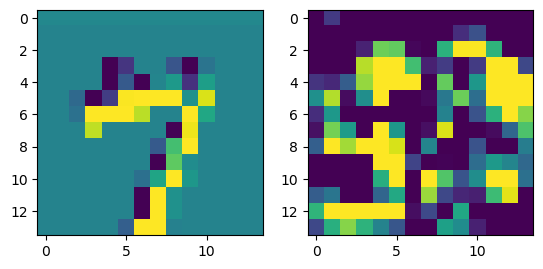

prediction: tensor([4, 7, 2]), tensor([1.8157, 1.2615, 1.2343]) groudtruth: 2
-0.07759029 0.07261127


<Figure size 640x480 with 0 Axes>

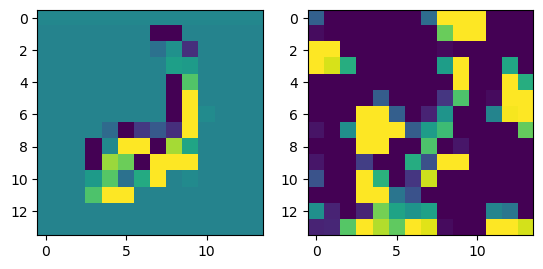

prediction: tensor([9, 7, 3]), tensor([3.7938, 0.9430, 0.4770]) groudtruth: 9
-0.07165223 0.08589844


<Figure size 640x480 with 0 Axes>

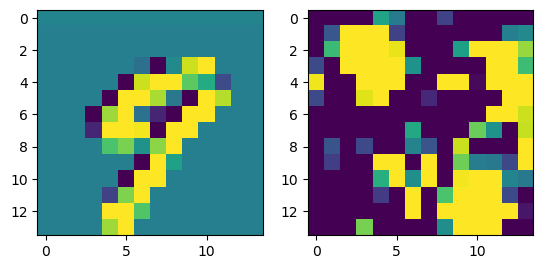

prediction: tensor([8, 4, 5]), tensor([4.1291, 2.1900, 1.4765]) groudtruth: 8
-0.08452886 0.08260697


<Figure size 640x480 with 0 Axes>

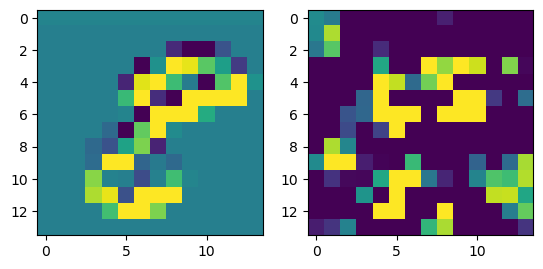

prediction: tensor([4, 9, 7]), tensor([3.0109, 2.8836, 1.1522]) groudtruth: 9
-0.05990511 0.08673308


<Figure size 640x480 with 0 Axes>

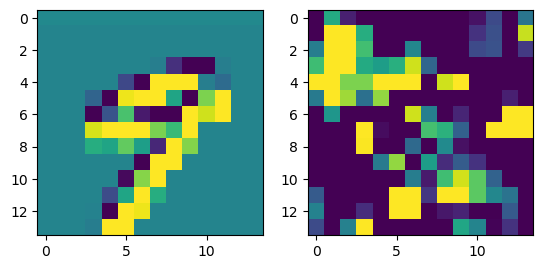

prediction: tensor([8, 5, 6]), tensor([3.2451, 2.7556, 0.9988]) groudtruth: 8
-0.079925954 0.08888049


<Figure size 640x480 with 0 Axes>

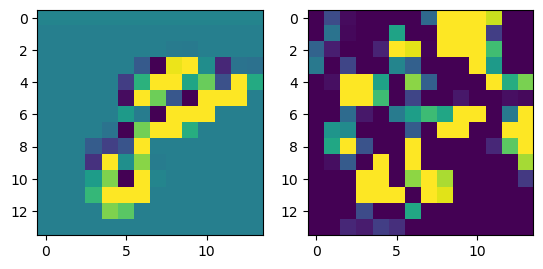

prediction: tensor([4, 9, 1]), tensor([4.4818, 1.9323, 1.7359]) groudtruth: 4
-0.077643275 0.07014926


<Figure size 640x480 with 0 Axes>

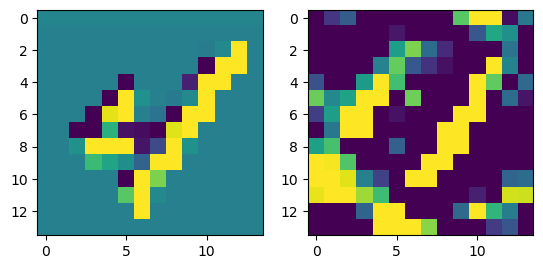

prediction: tensor([1, 7, 3]), tensor([4.1660, 2.4631, 0.3068]) groudtruth: 1
-0.07083714 0.09448025


<Figure size 640x480 with 0 Axes>

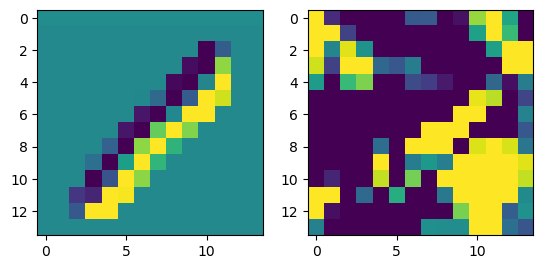

prediction: tensor([7, 9, 2]), tensor([4.2324, 1.6495, 1.1676]) groudtruth: 7
-0.08212513 0.069316335


<Figure size 640x480 with 0 Axes>

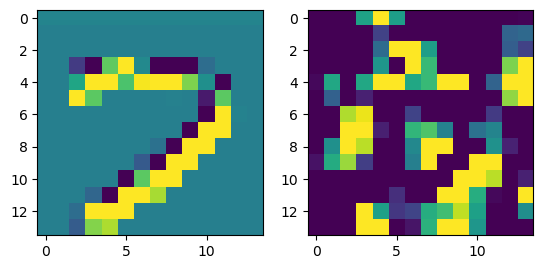

prediction: tensor([7, 9, 6]), tensor([4.9565, 2.1457, 1.0659]) groudtruth: 7
-0.06910133 0.095224746


<Figure size 640x480 with 0 Axes>

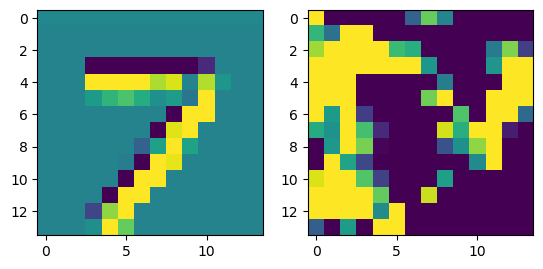

prediction: tensor([9, 3, 2]), tensor([2.2230, 2.1650, 1.1972]) groudtruth: 3
-0.094575584 0.07414162


<Figure size 640x480 with 0 Axes>

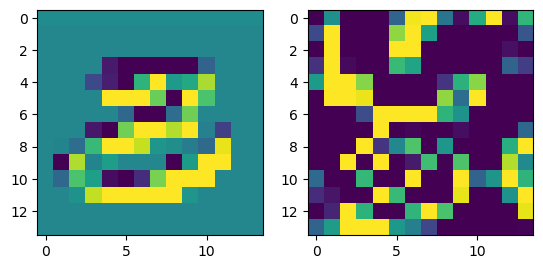

prediction: tensor([7, 3, 5]), tensor([4.2126, 3.5490, 2.2581]) groudtruth: 3
-0.09501463 0.10421743


<Figure size 640x480 with 0 Axes>

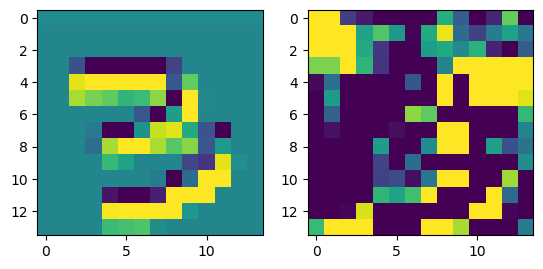

prediction: tensor([7, 3, 5]), tensor([3.1162, 2.8483, 2.3047]) groudtruth: 7
-0.08837539 0.073686376


<Figure size 640x480 with 0 Axes>

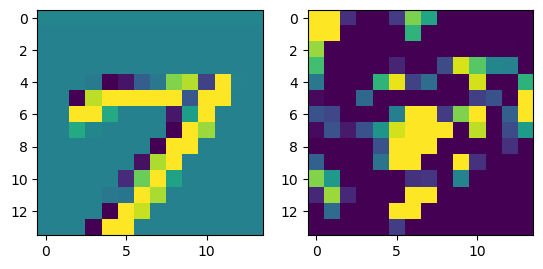

prediction: tensor([6, 8, 9]), tensor([4.4932, 3.2014, 0.9568]) groudtruth: 6
-0.09376019 0.066642225


<Figure size 640x480 with 0 Axes>

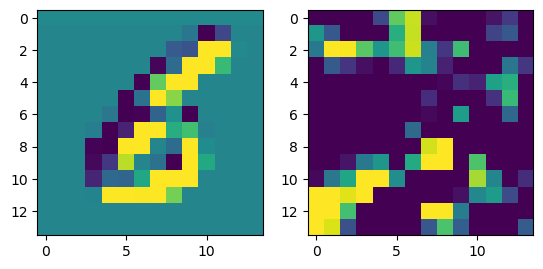

prediction: tensor([6, 5, 2]), tensor([3.0995, 2.1537, 1.8838]) groudtruth: 6
-0.08576989 0.07305667


<Figure size 640x480 with 0 Axes>

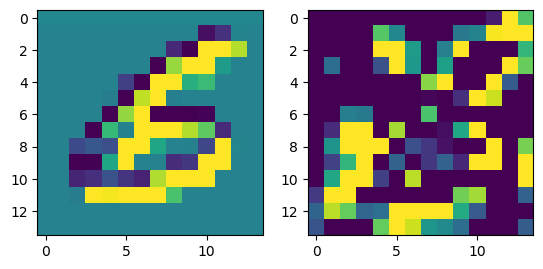

prediction: tensor([6, 5, 3]), tensor([4.6549, 1.7730, 1.1447]) groudtruth: 6
-0.077001214 0.09596287


<Figure size 640x480 with 0 Axes>

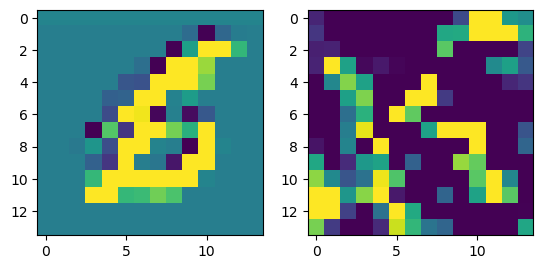

prediction: tensor([1, 9, 7]), tensor([4.0941, 0.6496, 0.4069]) groudtruth: 1
-0.09294313 0.078868866


<Figure size 640x480 with 0 Axes>

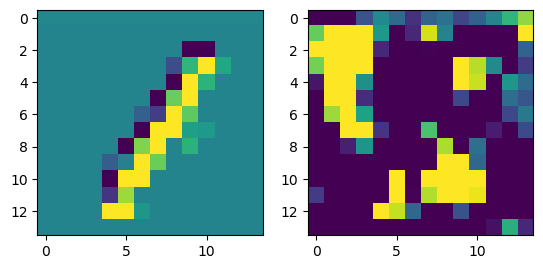

prediction: tensor([9, 3, 7]), tensor([3.7542, 1.6183, 0.8723]) groudtruth: 9
-0.05303079 0.08558275


<Figure size 640x480 with 0 Axes>

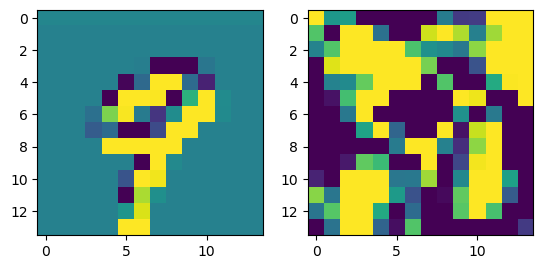

prediction: tensor([2, 1, 6]), tensor([1.7240, 1.5198, 0.8359]) groudtruth: 1
-0.10281032 0.09628423


<Figure size 640x480 with 0 Axes>

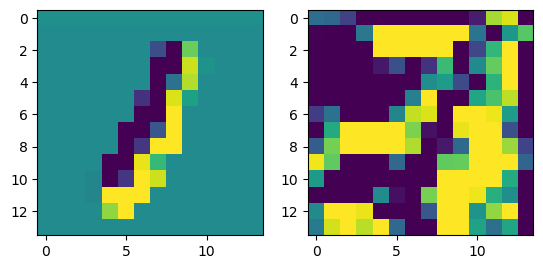

prediction: tensor([0, 4, 2]), tensor([1.6877, 1.5833, 1.2260]) groudtruth: 2
-0.09025955 0.066433


<Figure size 640x480 with 0 Axes>

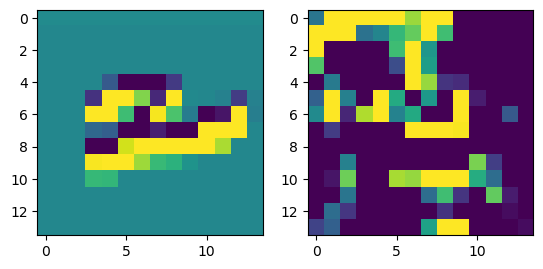

prediction: tensor([9, 3, 4]), tensor([4.7225, 4.3232, 1.4432]) groudtruth: 3
-0.0824222 0.10105192


<Figure size 640x480 with 0 Axes>

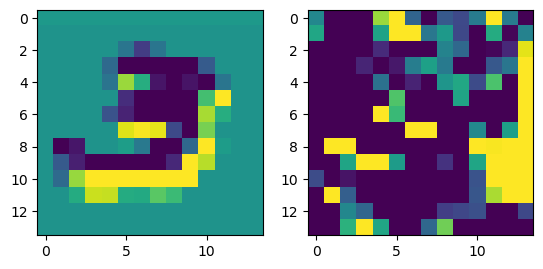

prediction: tensor([4, 9, 8]), tensor([4.3968, 2.0097, 1.3925]) groudtruth: 4
-0.052933216 0.0736637


<Figure size 640x480 with 0 Axes>

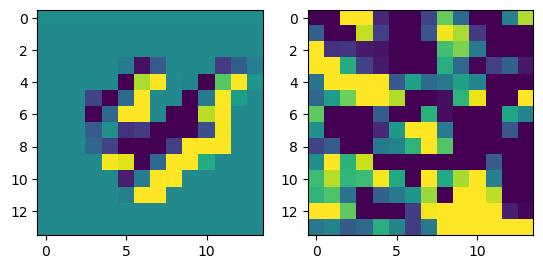

prediction: tensor([7, 2, 9]), tensor([2.2848, 0.9934, 0.7035]) groudtruth: 7
-0.08356774 0.08344042


<Figure size 640x480 with 0 Axes>

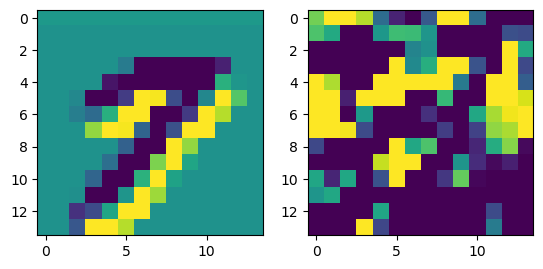

prediction: tensor([8, 6, 2]), tensor([3.9207, 2.2963, 1.4610]) groudtruth: 8
-0.08276898 0.10822809


<Figure size 640x480 with 0 Axes>

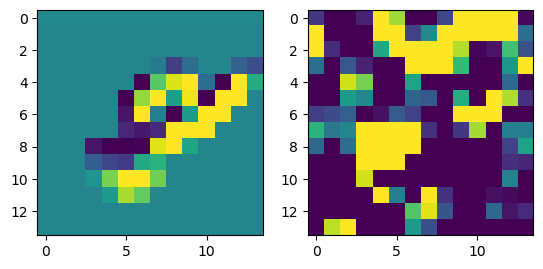

prediction: tensor([1, 8, 9]), tensor([4.9262, 1.0401, 0.7320]) groudtruth: 1
-0.0843392 0.0820833


<Figure size 640x480 with 0 Axes>

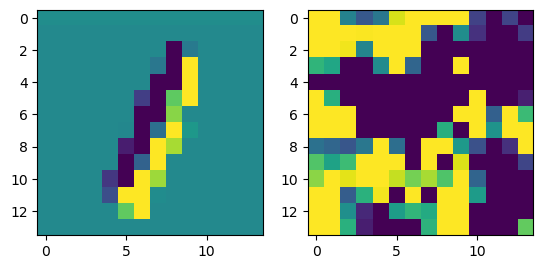

prediction: tensor([3, 8, 5]), tensor([4.1621, 2.1904, 0.7071]) groudtruth: 3
-0.10265392 0.09363553


<Figure size 640x480 with 0 Axes>

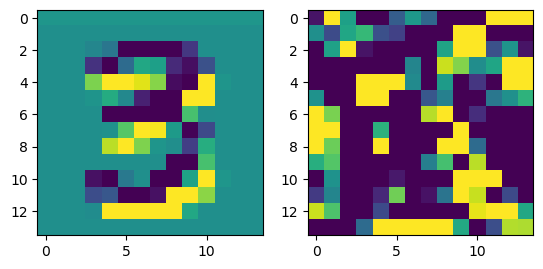

prediction: tensor([7, 5, 3]), tensor([2.9995, 2.4339, 1.7303]) groudtruth: 5
-0.08049756 0.11172572


<Figure size 640x480 with 0 Axes>

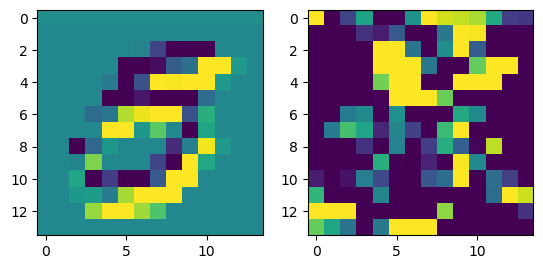

prediction: tensor([1, 6, 0]), tensor([5.5301, 0.1743, 0.1259]) groudtruth: 1
-0.09312993 0.071907714


<Figure size 640x480 with 0 Axes>

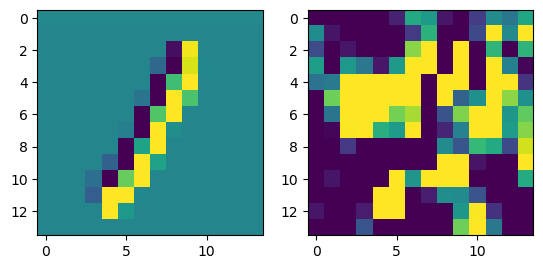

prediction: tensor([2, 7, 8]), tensor([3.0298, 2.6244, 0.7520]) groudtruth: 7
-0.09331435 0.075463876


<Figure size 640x480 with 0 Axes>

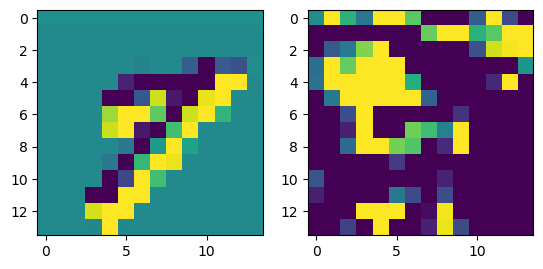

prediction: tensor([7, 9, 4]), tensor([3.3187, 2.5273, 0.7625]) groudtruth: 7
-0.08842254 0.105477236


<Figure size 640x480 with 0 Axes>

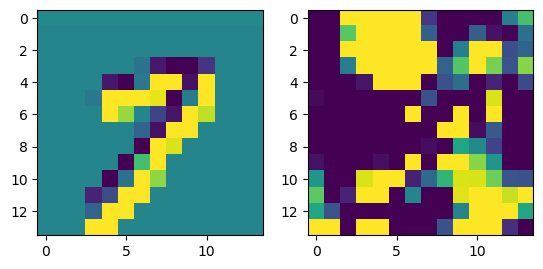

prediction: tensor([2, 3, 5]), tensor([4.0822, 3.9195, 1.4537]) groudtruth: 2
-0.0956108 0.07247915


<Figure size 640x480 with 0 Axes>

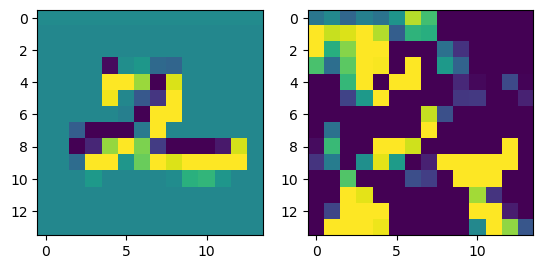

prediction: tensor([7, 8, 1]), tensor([2.2745, 1.7407, 1.2290]) groudtruth: 1
-0.10313189 0.11473234


<Figure size 640x480 with 0 Axes>

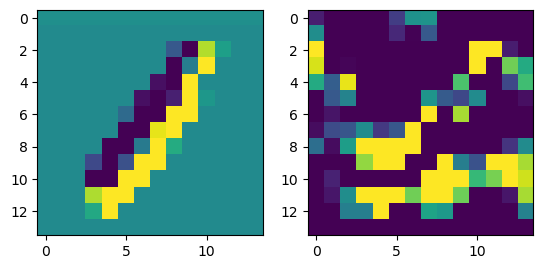

prediction: tensor([4, 6, 9]), tensor([7.4373, 3.0841, 1.6041]) groudtruth: 4
-0.062134266 0.067833275


<Figure size 640x480 with 0 Axes>

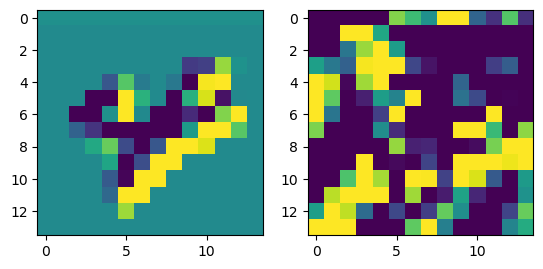

prediction: tensor([8, 6, 0]), tensor([2.8845, 1.4374, 1.0519]) groudtruth: 8
-0.081751406 0.08639152


<Figure size 640x480 with 0 Axes>

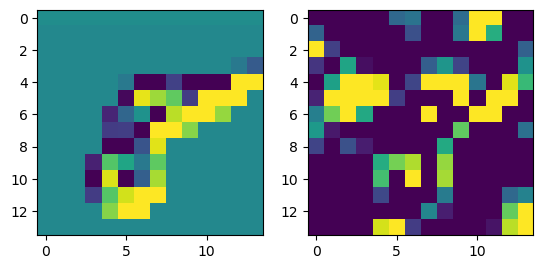

prediction: tensor([9, 4, 3]), tensor([4.0380, 3.3119, 1.0452]) groudtruth: 9
-0.08185589 0.0888596


<Figure size 640x480 with 0 Axes>

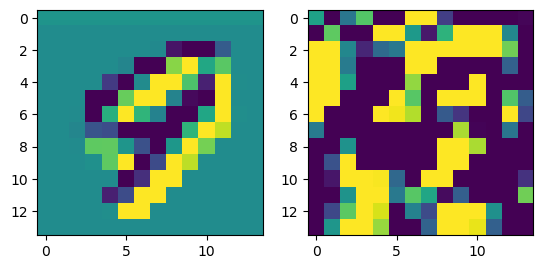

prediction: tensor([2, 5, 4]), tensor([2.5012, 1.5521, 1.3127]) groudtruth: 2
-0.0663712 0.10613969


<Figure size 640x480 with 0 Axes>

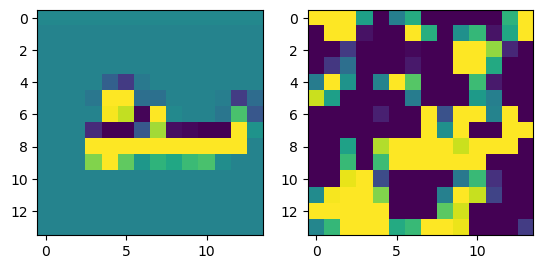

prediction: tensor([0, 2, 6]), tensor([6.7986, 2.1550, 0.7122]) groudtruth: 0
-0.067713976 0.057857636


<Figure size 640x480 with 0 Axes>

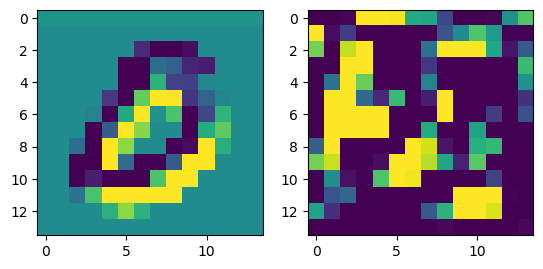

prediction: tensor([9, 7, 6]), tensor([2.5924, 2.1511, 0.2602]) groudtruth: 9
-0.08526248 0.071896866


<Figure size 640x480 with 0 Axes>

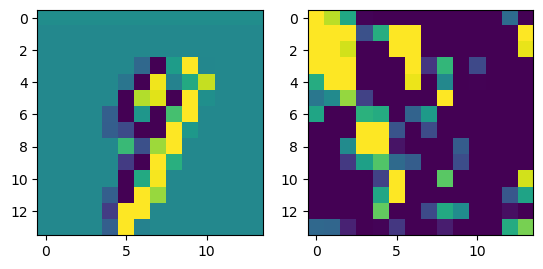

prediction: tensor([5, 8, 6]), tensor([4.8052, 1.9500, 1.3792]) groudtruth: 5
-0.08403909 0.06813519


<Figure size 640x480 with 0 Axes>

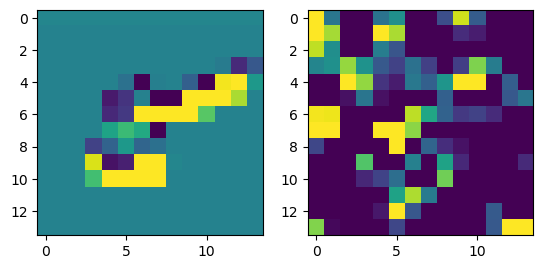

prediction: tensor([1, 6, 4]), tensor([3.4719, 1.2066, 0.2673]) groudtruth: 1
-0.053962648 0.06934571


<Figure size 640x480 with 0 Axes>

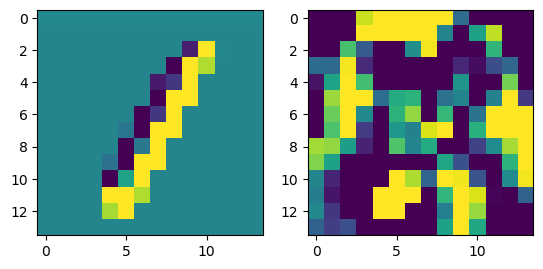

prediction: tensor([9, 3, 0]), tensor([4.1184, 3.9874, 0.6721]) groudtruth: 3
-0.1148389 0.06303315


<Figure size 640x480 with 0 Axes>

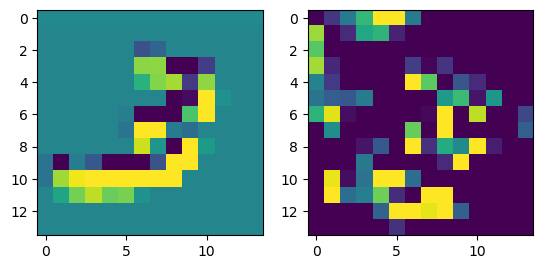

prediction: tensor([7, 8, 2]), tensor([3.0514, 1.7551, 1.1495]) groudtruth: 7
-0.09610486 0.06989728


<Figure size 640x480 with 0 Axes>

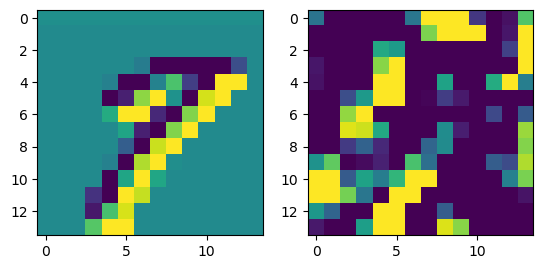

prediction: tensor([6, 2, 9]), tensor([5.2828, 0.9743, 0.8851]) groudtruth: 6
-0.07504296 0.078567475


<Figure size 640x480 with 0 Axes>

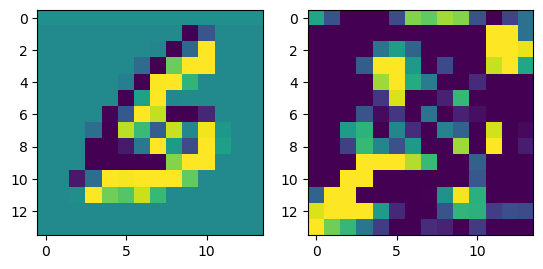

prediction: tensor([4, 6, 9]), tensor([2.0758, 1.8305, 1.6636]) groudtruth: 9
-0.09363377 0.105902925


<Figure size 640x480 with 0 Axes>

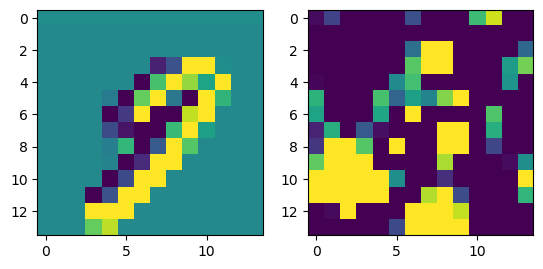

prediction: tensor([3, 0, 5]), tensor([3.4049, 0.6287, 0.6190]) groudtruth: 3
-0.080616474 0.076529525


<Figure size 640x480 with 0 Axes>

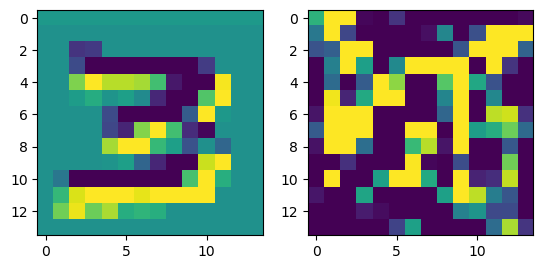

prediction: tensor([0, 3, 1]), tensor([6.5041, 0.9952, 0.3685]) groudtruth: 0
-0.0802812 0.081585094


<Figure size 640x480 with 0 Axes>

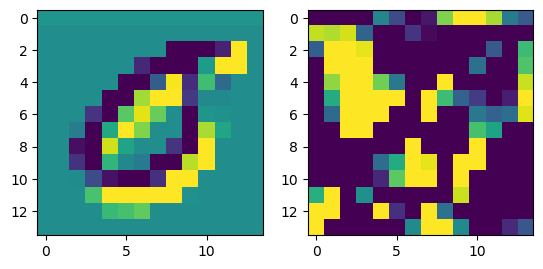

prediction: tensor([2, 8, 7]), tensor([2.4925, 1.5926, 1.2633]) groudtruth: 2
-0.0854153 0.086670645


<Figure size 640x480 with 0 Axes>

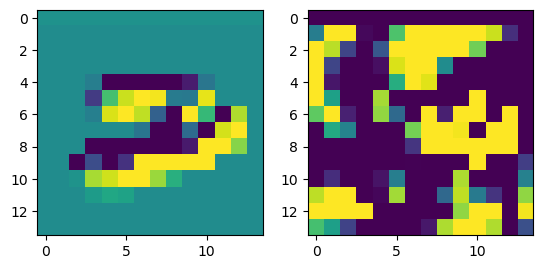

prediction: tensor([7, 2, 6]), tensor([1.9715, 1.8869, 0.7193]) groudtruth: 2
-0.062142134 0.0910086


<Figure size 640x480 with 0 Axes>

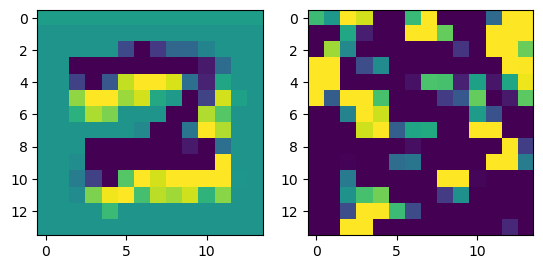

prediction: tensor([0, 3, 9]), tensor([4.5085, 1.1862, 0.9292]) groudtruth: 0
-0.07275385 0.074713156


<Figure size 640x480 with 0 Axes>

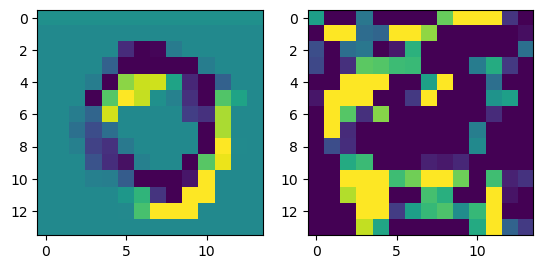

prediction: tensor([1, 7, 8]), tensor([3.2329, 1.3058, 0.6136]) groudtruth: 1
-0.09725076 0.08101119


<Figure size 640x480 with 0 Axes>

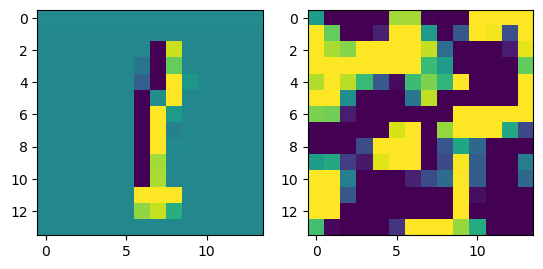

prediction: tensor([1, 4, 6]), tensor([5.3153, 0.3920, 0.1142]) groudtruth: 1
-0.081003904 0.1139823


<Figure size 640x480 with 0 Axes>

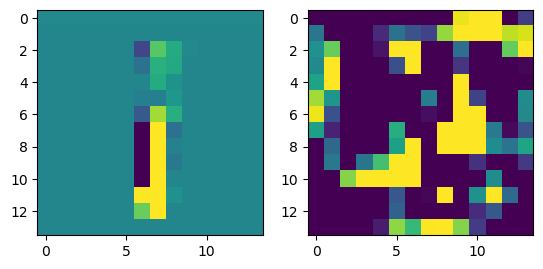

prediction: tensor([2, 6, 8]), tensor([4.8105, 1.7734, 0.7002]) groudtruth: 2
-0.10970539 0.112524204


<Figure size 640x480 with 0 Axes>

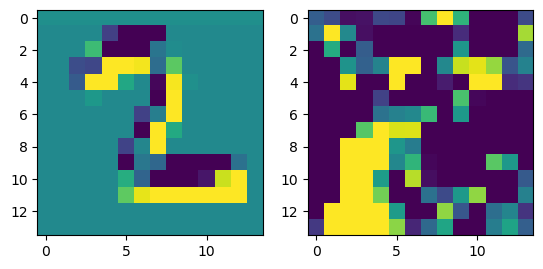

prediction: tensor([8, 7, 2]), tensor([3.7964, 1.6182, 1.1963]) groudtruth: 8
-0.0812453 0.085635684


<Figure size 640x480 with 0 Axes>

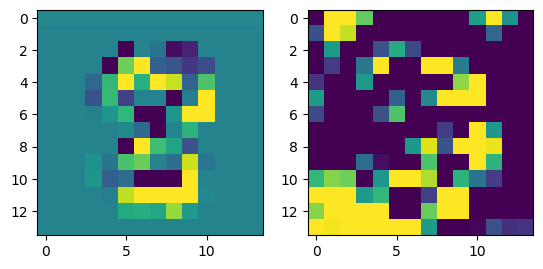

prediction: tensor([8, 2, 5]), tensor([4.4758, 3.4753, 1.2868]) groudtruth: 8
-0.10456592 0.07592102


<Figure size 640x480 with 0 Axes>

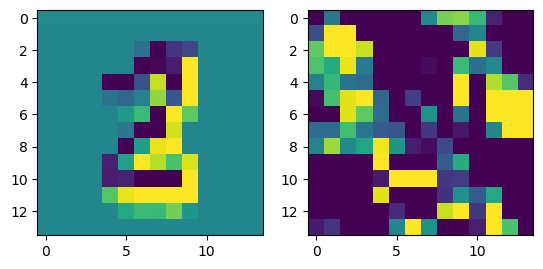

prediction: tensor([7, 9, 3]), tensor([4.8320, 1.4597, 0.9617]) groudtruth: 7
-0.07992834 0.07597445


<Figure size 640x480 with 0 Axes>

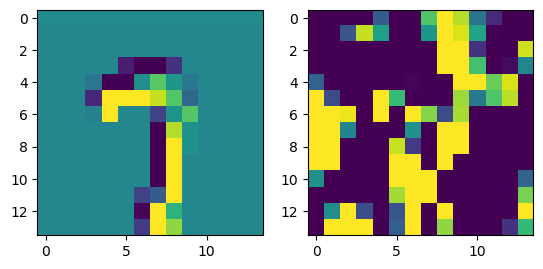

prediction: tensor([7, 9, 4]), tensor([3.6129, 1.8375, 1.6075]) groudtruth: 7
-0.07212359 0.07968749


<Figure size 640x480 with 0 Axes>

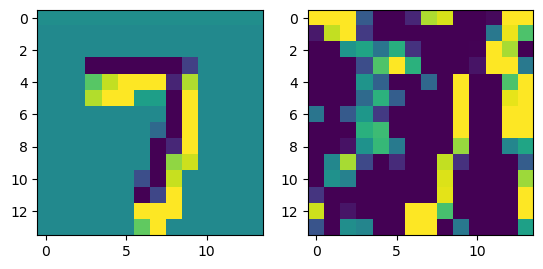

prediction: tensor([6, 5, 7]), tensor([2.6122, 1.8531, 1.4801]) groudtruth: 4
-0.102724314 0.09210166


<Figure size 640x480 with 0 Axes>

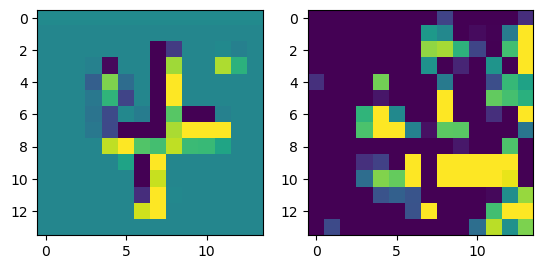

prediction: tensor([7, 0, 8]), tensor([5.5156, 1.7316, 0.9069]) groudtruth: 7
-0.08331424 0.08453451


<Figure size 640x480 with 0 Axes>

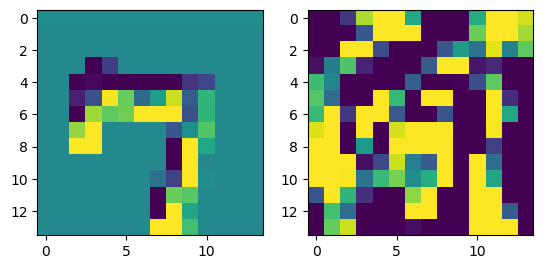

prediction: tensor([7, 9, 5]), tensor([ 3.5589,  2.0114, -0.0890]) groudtruth: 7
-0.083895504 0.06496749


<Figure size 640x480 with 0 Axes>

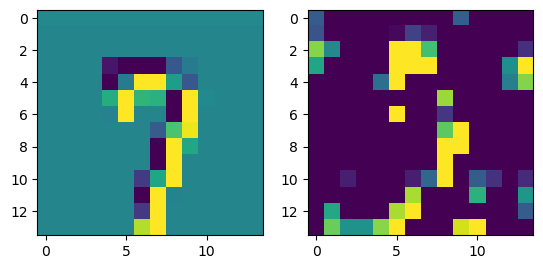

prediction: tensor([3, 2, 1]), tensor([5.2155, 1.7205, 0.3733]) groudtruth: 3
-0.10615945 0.13979447


<Figure size 640x480 with 0 Axes>

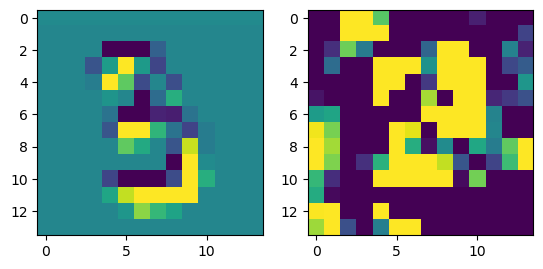

prediction: tensor([7, 4, 9]), tensor([4.9800, 1.1287, 0.4297]) groudtruth: 7
-0.108344555 0.08060701


<Figure size 640x480 with 0 Axes>

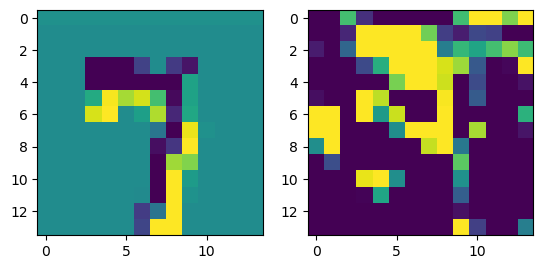

prediction: tensor([5, 4, 8]), tensor([2.3667, 1.9052, 1.5371]) groudtruth: 4
-0.12978631 0.09354678


<Figure size 640x480 with 0 Axes>

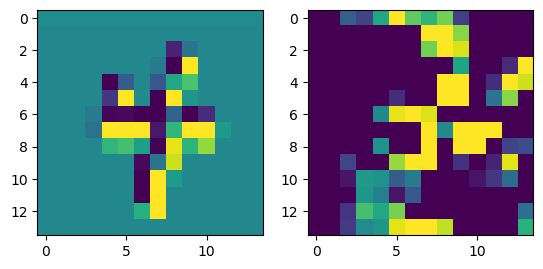

prediction: tensor([5, 3, 9]), tensor([6.2170, 4.0212, 1.9151]) groudtruth: 5
-0.088511944 0.073412


<Figure size 640x480 with 0 Axes>

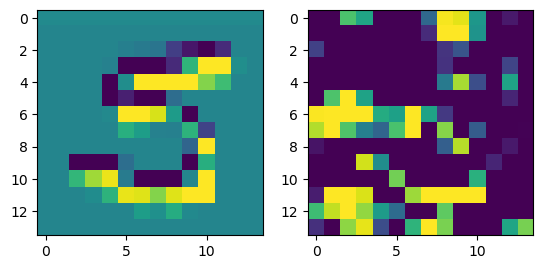

prediction: tensor([4, 2, 8]), tensor([6.0172, 1.3844, 1.1226]) groudtruth: 4
-0.07144636 0.089152545


<Figure size 640x480 with 0 Axes>

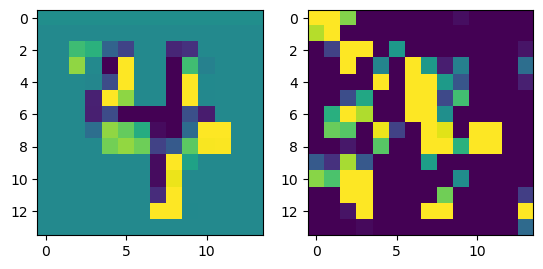

prediction: tensor([3, 5, 2]), tensor([3.6937, 1.3442, 0.6891]) groudtruth: 3
-0.08573145 0.0974939


<Figure size 640x480 with 0 Axes>

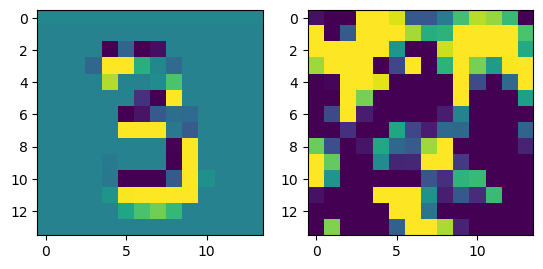

prediction: tensor([3, 9, 7]), tensor([3.0676, 1.1783, 0.9229]) groudtruth: 3
-0.08883864 0.07846668


<Figure size 640x480 with 0 Axes>

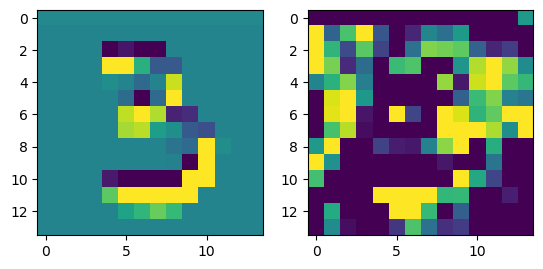

prediction: tensor([2, 5, 3]), tensor([4.5114, 2.6915, 1.8169]) groudtruth: 2
-0.09121585 0.09767192


<Figure size 640x480 with 0 Axes>

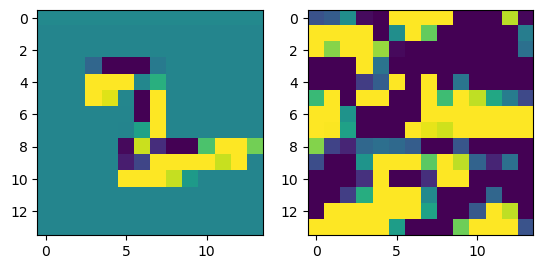

prediction: tensor([1, 9, 7]), tensor([6.8159, 0.7152, 0.2595]) groudtruth: 1
-0.114088655 0.06912389


<Figure size 640x480 with 0 Axes>

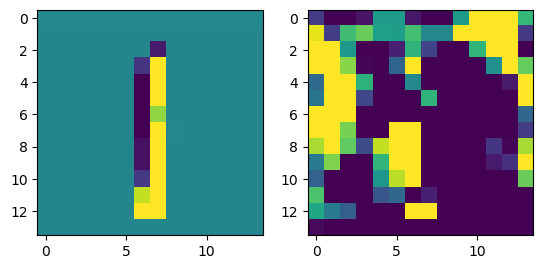

prediction: tensor([9, 1, 7]), tensor([ 3.6013,  2.5850, -0.0294]) groudtruth: 9
-0.08198959 0.07092506


<Figure size 640x480 with 0 Axes>

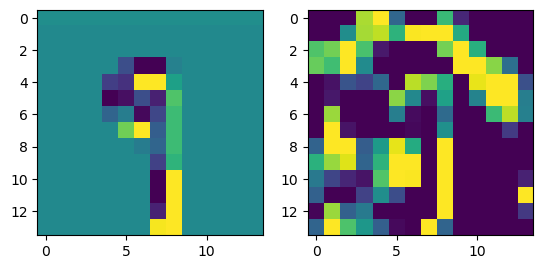

prediction: tensor([4, 8, 3]), tensor([4.5406, 1.3553, 0.7850]) groudtruth: 4
-0.087487996 0.076339945


<Figure size 640x480 with 0 Axes>

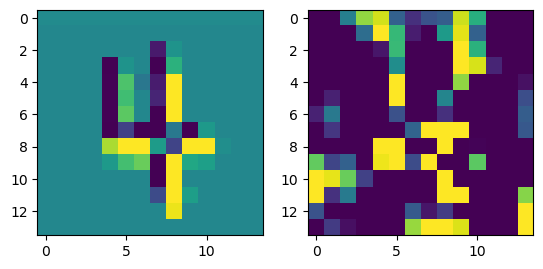

prediction: tensor([9, 7, 1]), tensor([4.2700, 1.3055, 0.9940]) groudtruth: 9
-0.11462164 0.1082223


<Figure size 640x480 with 0 Axes>

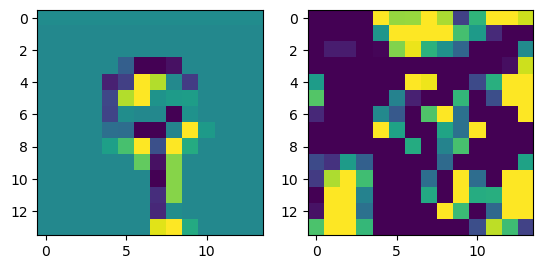

prediction: tensor([1, 9, 6]), tensor([4.8379, 0.8462, 0.2905]) groudtruth: 1
-0.075481474 0.0800432


<Figure size 640x480 with 0 Axes>

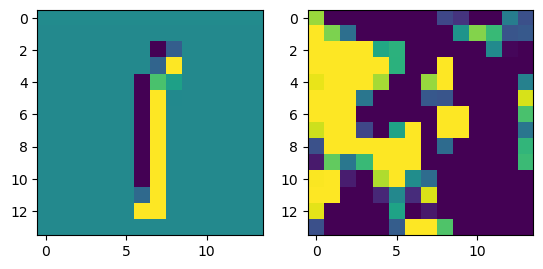

prediction: tensor([3, 1, 9]), tensor([4.4136, 1.3906, 0.5098]) groudtruth: 3
-0.10156584 0.088587


<Figure size 640x480 with 0 Axes>

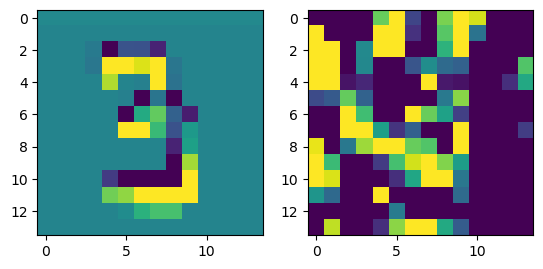

prediction: tensor([9, 8, 7]), tensor([3.0722, 2.4322, 1.7742]) groudtruth: 9
-0.08919126 0.071023494


<Figure size 640x480 with 0 Axes>

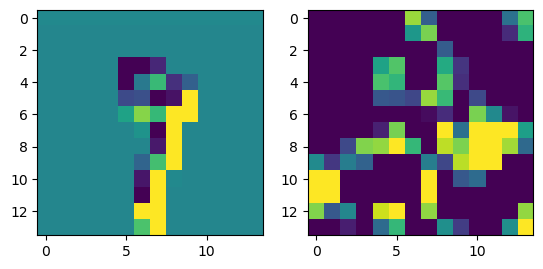

prediction: tensor([2, 0, 8]), tensor([3.8934, 2.4363, 0.7239]) groudtruth: 2
-0.09592676 0.08463108


<Figure size 640x480 with 0 Axes>

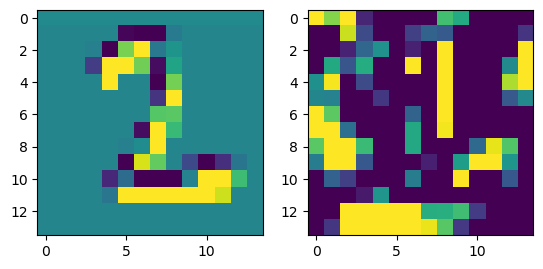

prediction: tensor([0, 3, 5]), tensor([5.1779, 3.4320, 0.6608]) groudtruth: 0
-0.09000695 0.10101773


<Figure size 640x480 with 0 Axes>

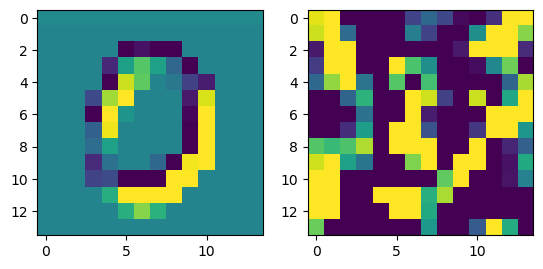

prediction: tensor([8, 6, 9]), tensor([3.8473, 3.8015, 2.5838]) groudtruth: 6
-0.08067781 0.08453043


<Figure size 640x480 with 0 Axes>

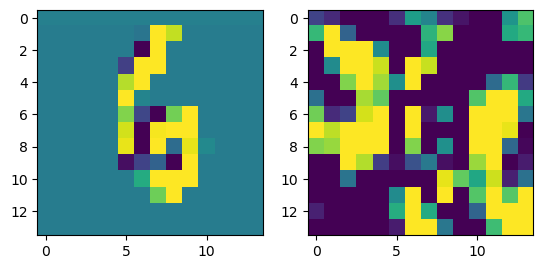

prediction: tensor([0, 8, 7]), tensor([4.9365, 1.2832, 0.7837]) groudtruth: 0
-0.07637143 0.069298


<Figure size 640x480 with 0 Axes>

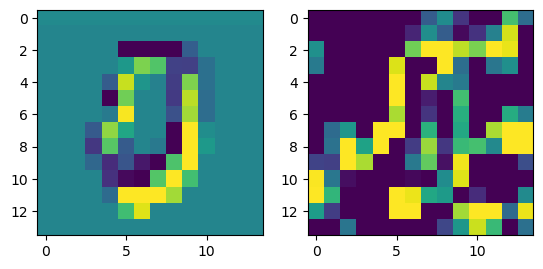

prediction: tensor([4, 2, 8]), tensor([3.0922, 2.1488, 0.7810]) groudtruth: 4
-0.09153348 0.09878054


<Figure size 640x480 with 0 Axes>

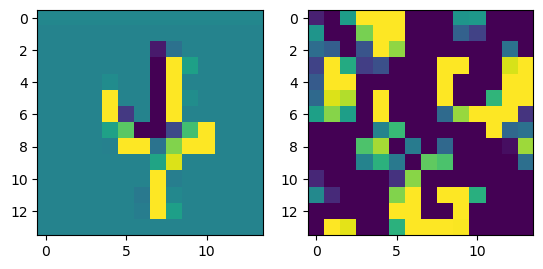

prediction: tensor([0, 2, 8]), tensor([5.1261, 1.0046, 0.5723]) groudtruth: 0
-0.14219975 0.104575574


<Figure size 640x480 with 0 Axes>

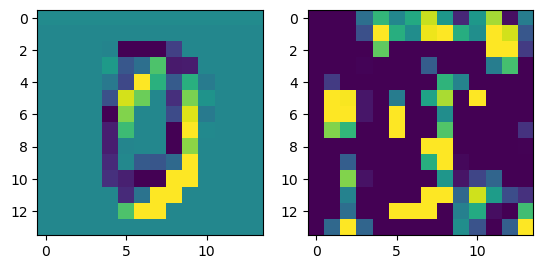

prediction: tensor([6, 4, 5]), tensor([3.4708, 1.8475, 0.1664]) groudtruth: 6
-0.10696113 0.06986771


<Figure size 640x480 with 0 Axes>

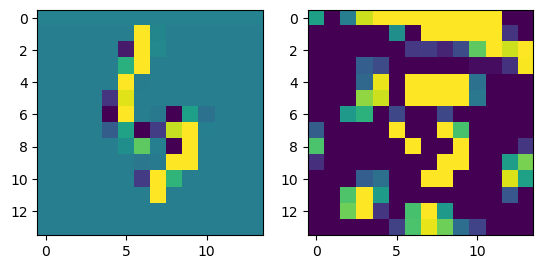

prediction: tensor([0, 8, 6]), tensor([4.0388, 1.5494, 0.4460]) groudtruth: 0
-0.07159895 0.08449657


<Figure size 640x480 with 0 Axes>

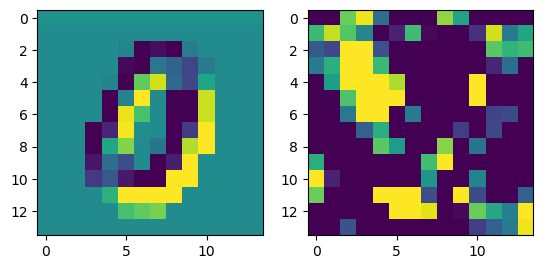

prediction: tensor([1, 6, 7]), tensor([5.8654, 0.9949, 0.1793]) groudtruth: 1
-0.07571232 0.08959757


<Figure size 640x480 with 0 Axes>

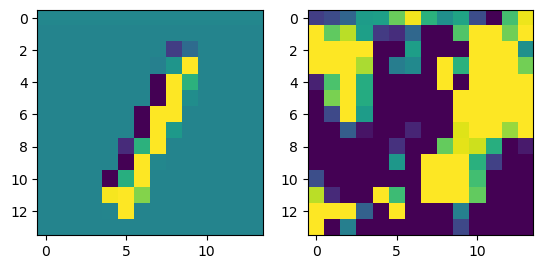

prediction: tensor([5, 3, 8]), tensor([4.4351, 2.8117, 0.7242]) groudtruth: 5
-0.09735626 0.10029842


<Figure size 640x480 with 0 Axes>

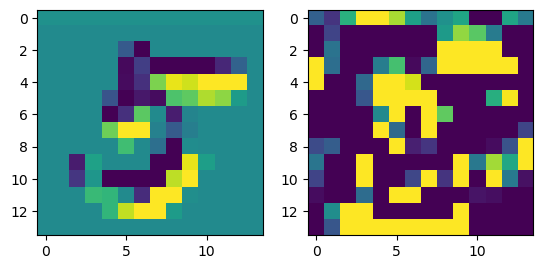

prediction: tensor([6, 0, 2]), tensor([3.7090, 1.9233, 0.6089]) groudtruth: 0
-0.06865227 0.058508154


<Figure size 640x480 with 0 Axes>

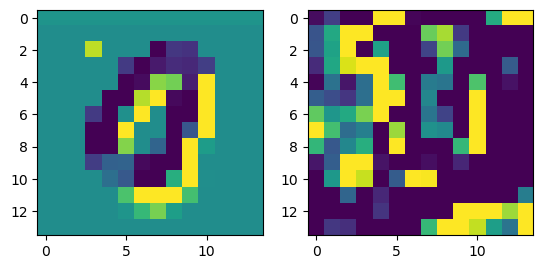

prediction: tensor([0, 9, 8]), tensor([4.3110, 1.9645, 1.2571]) groudtruth: 0
-0.08356434 0.096718594


<Figure size 640x480 with 0 Axes>

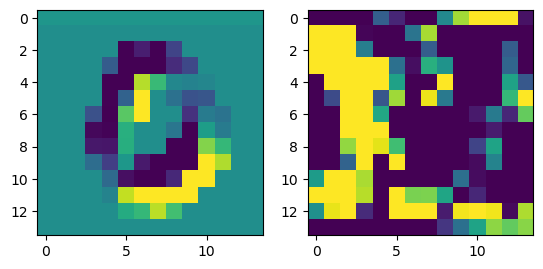

prediction: tensor([9, 3, 7]), tensor([5.4412, 1.8659, 1.8429]) groudtruth: 9
-0.082659185 0.08223972


<Figure size 640x480 with 0 Axes>

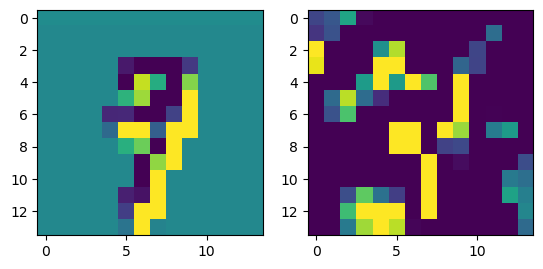

prediction: tensor([5, 2, 3]), tensor([3.5694, 2.7645, 0.9099]) groudtruth: 5
-0.081100225 0.109818906


<Figure size 640x480 with 0 Axes>

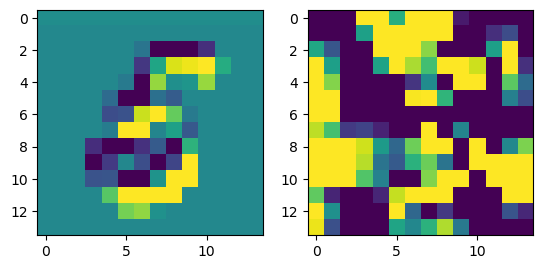

prediction: tensor([3, 9, 1]), tensor([5.0817, 1.6267, 1.1156]) groudtruth: 3
-0.09846234 0.10867581


<Figure size 640x480 with 0 Axes>

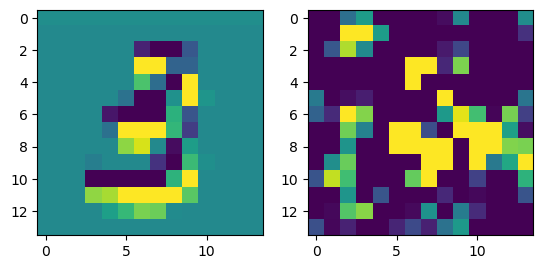

prediction: tensor([4, 8, 7]), tensor([4.1338, 0.5931, 0.3812]) groudtruth: 4
-0.082187414 0.096592456


<Figure size 640x480 with 0 Axes>

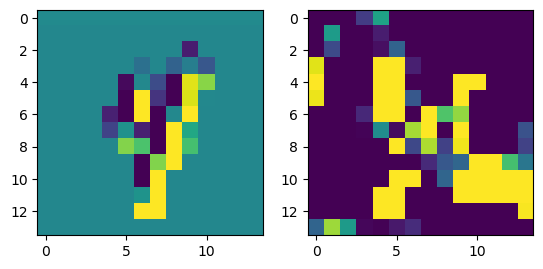

prediction: tensor([9, 8, 3]), tensor([4.7618, 1.0394, 0.2549]) groudtruth: 9
-0.07363415 0.07731827


<Figure size 640x480 with 0 Axes>

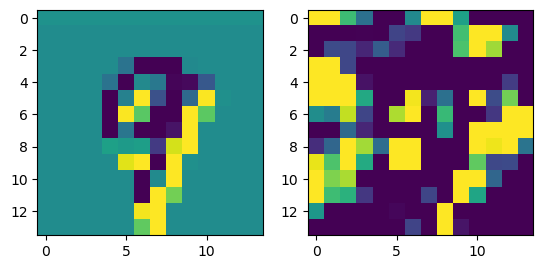

prediction: tensor([3, 8, 5]), tensor([3.8016, 1.9025, 0.8380]) groudtruth: 3
-0.09108788 0.081807144


<Figure size 640x480 with 0 Axes>

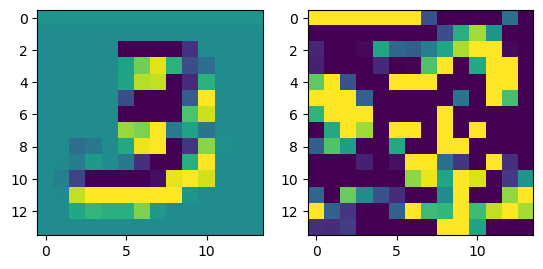

prediction: tensor([8, 7, 9]), tensor([1.6663, 1.0503, 0.8797]) groudtruth: 7
-0.07319379 0.075066015


<Figure size 640x480 with 0 Axes>

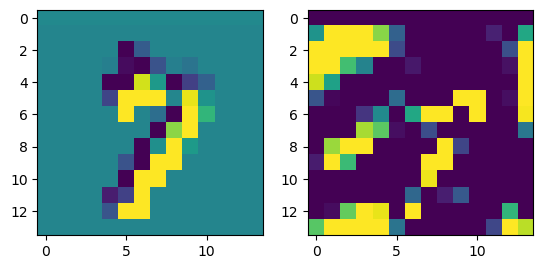

prediction: tensor([6, 7, 1]), tensor([4.9946, 0.7388, 0.6795]) groudtruth: 6
-0.07931268 0.10012544


<Figure size 640x480 with 0 Axes>

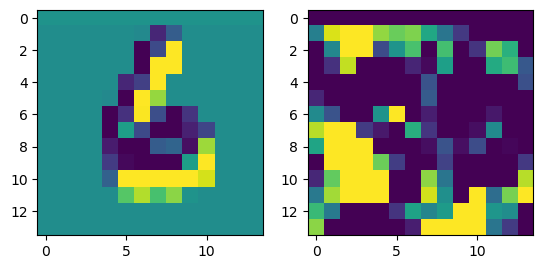

prediction: tensor([9, 3, 1]), tensor([3.7128, 1.1586, 0.9191]) groudtruth: 9
-0.10894656 0.103399254


<Figure size 640x480 with 0 Axes>

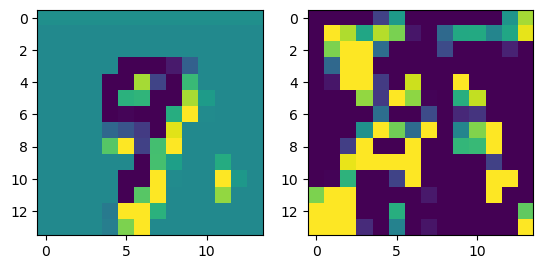

prediction: tensor([2, 4, 1]), tensor([4.7123, 0.5717, 0.3989]) groudtruth: 2
-0.07707387 0.066220686


<Figure size 640x480 with 0 Axes>

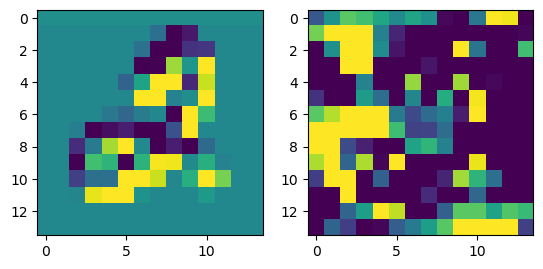

prediction: tensor([4, 8, 9]), tensor([4.7973, 1.9619, 1.7937]) groudtruth: 4
-0.07947481 0.068786785


<Figure size 640x480 with 0 Axes>

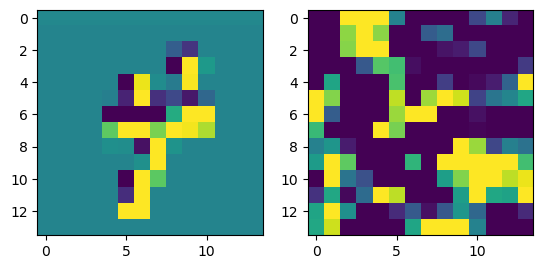

prediction: tensor([5, 3, 1]), tensor([3.8469, 1.5979, 1.0248]) groudtruth: 5
-0.07372439 0.07360448


<Figure size 640x480 with 0 Axes>

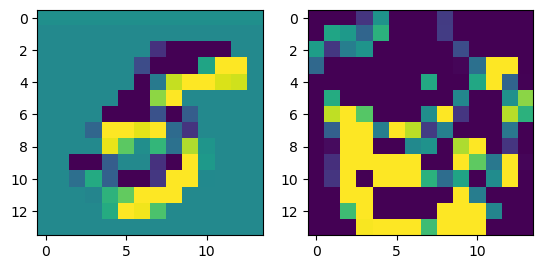

prediction: tensor([3, 5, 7]), tensor([2.6883, 1.6269, 0.5639]) groudtruth: 3
-0.11894095 0.096613765


<Figure size 640x480 with 0 Axes>

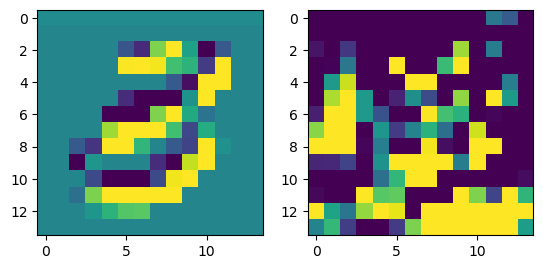

prediction: tensor([7, 6, 0]), tensor([6.7024, 0.7339, 0.3065]) groudtruth: 7
-0.083180666 0.08350991


<Figure size 640x480 with 0 Axes>

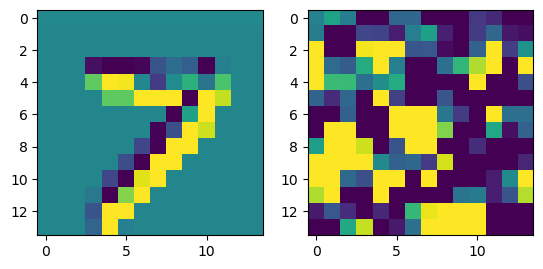

prediction: tensor([6, 7, 2]), tensor([3.6756, 2.0928, 1.6073]) groudtruth: 6
-0.071051 0.071150966


<Figure size 640x480 with 0 Axes>

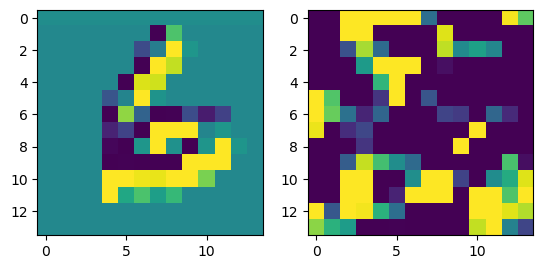

prediction: tensor([9, 7, 0]), tensor([4.1012, 0.9859, 0.8976]) groudtruth: 9
-0.077180564 0.08878343


<Figure size 640x480 with 0 Axes>

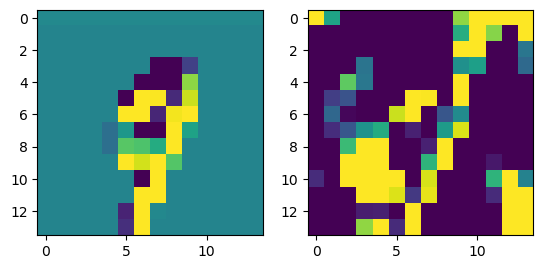

prediction: tensor([9, 7, 3]), tensor([4.8870, 2.3449, 0.9209]) groudtruth: 9
-0.07521492 0.10061446


<Figure size 640x480 with 0 Axes>

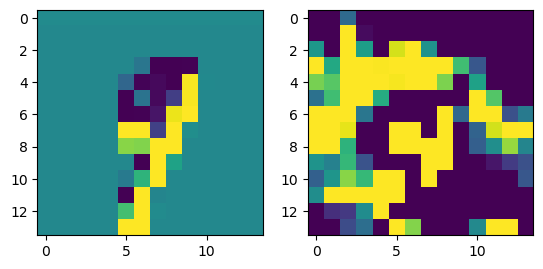

prediction: tensor([4, 5, 8]), tensor([7.0853, 1.3661, 0.1515]) groudtruth: 4
-0.074997485 0.071613126


<Figure size 640x480 with 0 Axes>

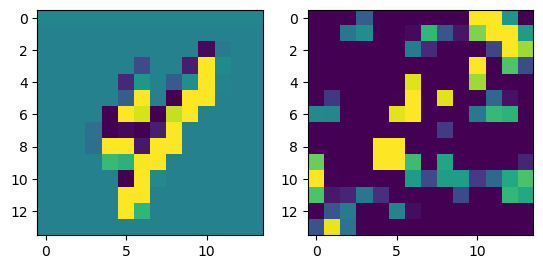

prediction: tensor([8, 3, 1]), tensor([5.7295, 1.9169, 1.6322]) groudtruth: 8
-0.0844568 0.08679747


<Figure size 640x480 with 0 Axes>

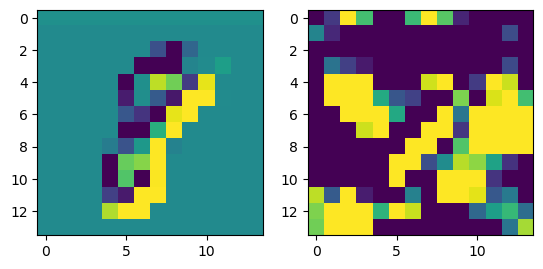

prediction: tensor([4, 9, 7]), tensor([2.5368, 1.8263, 1.3211]) groudtruth: 4
-0.05857277 0.08927885


<Figure size 640x480 with 0 Axes>

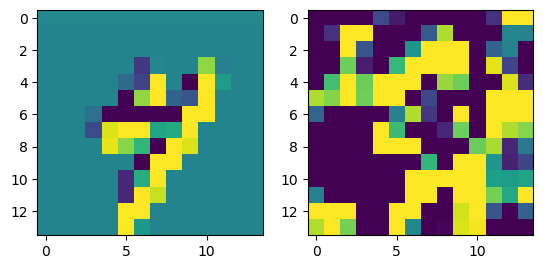

prediction: tensor([1, 5, 3]), tensor([4.5673, 1.2790, 0.1610]) groudtruth: 1
-0.093610704 0.08822505


<Figure size 640x480 with 0 Axes>

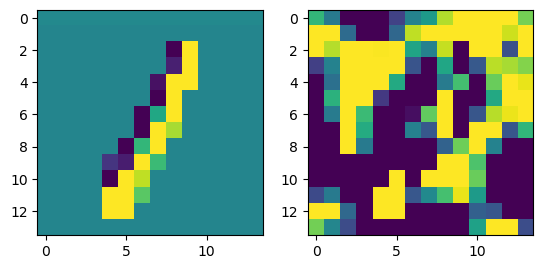

prediction: tensor([6, 0, 4]), tensor([3.0092, 1.6799, 0.0880]) groudtruth: 0
-0.085012734 0.07879579


<Figure size 640x480 with 0 Axes>

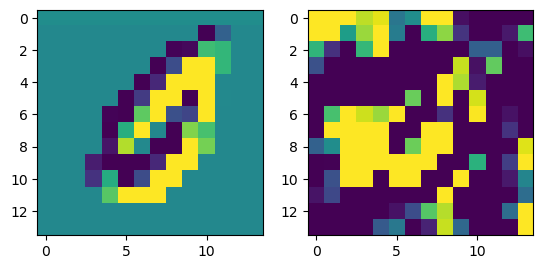

prediction: tensor([6, 2, 9]), tensor([4.6359, 1.3827, 0.8768]) groudtruth: 6
-0.05514735 0.07322775


<Figure size 640x480 with 0 Axes>

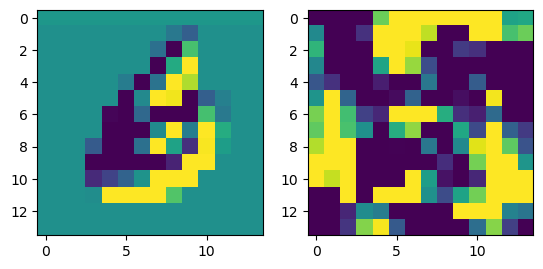

prediction: tensor([6, 9, 2]), tensor([4.1603, 2.5116, 1.4866]) groudtruth: 6
-0.07205933 0.064519025


<Figure size 640x480 with 0 Axes>

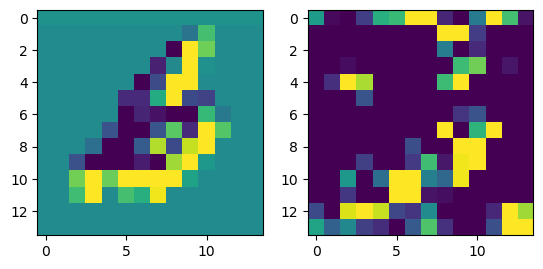

prediction: tensor([0, 6, 8]), tensor([4.7446, 0.3293, 0.1080]) groudtruth: 0
-0.07733965 0.090888426


<Figure size 640x480 with 0 Axes>

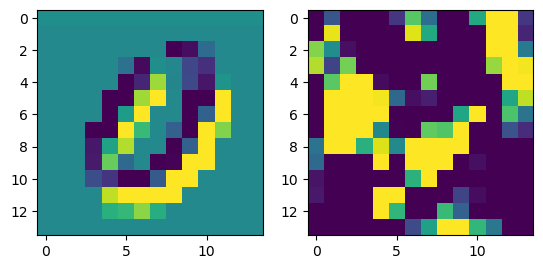

prediction: tensor([1, 6, 8]), tensor([2.8816, 2.2443, 1.8890]) groudtruth: 1
-0.086566925 0.067223884


<Figure size 640x480 with 0 Axes>

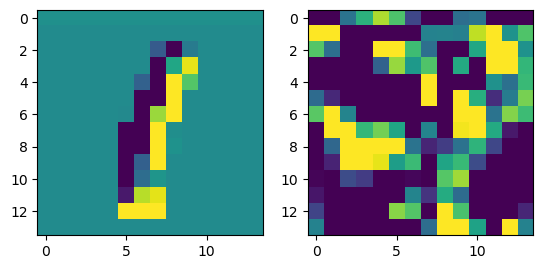

prediction: tensor([2, 1, 7]), tensor([3.6142, 1.3163, 1.1352]) groudtruth: 2
-0.112475455 0.11685501


<Figure size 640x480 with 0 Axes>

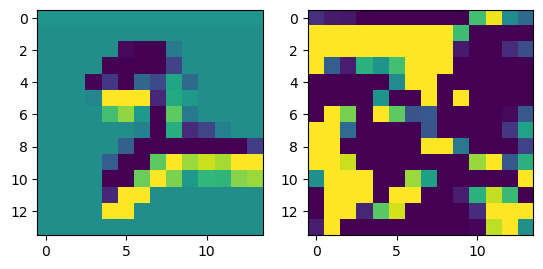

prediction: tensor([3, 4, 7]), tensor([3.7776, 0.6437, 0.3201]) groudtruth: 3
-0.065842986 0.098918036


<Figure size 640x480 with 0 Axes>

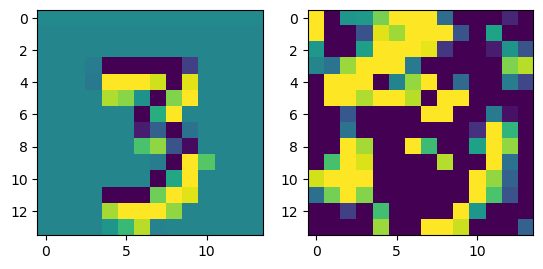

prediction: tensor([3, 5, 2]), tensor([4.2549, 2.1218, 0.9523]) groudtruth: 3
-0.086120665 0.07645301


<Figure size 640x480 with 0 Axes>

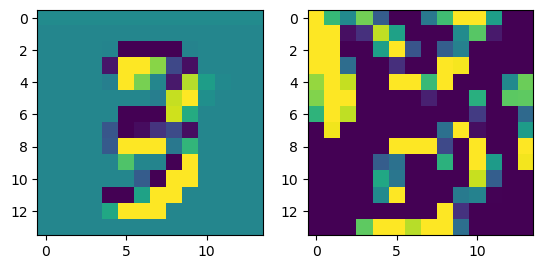

prediction: tensor([6, 1, 4]), tensor([5.3936, 1.6961, 1.3772]) groudtruth: 6
-0.08824235 0.07087996


<Figure size 640x480 with 0 Axes>

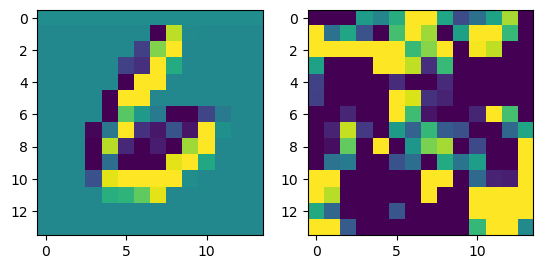

prediction: tensor([9, 2, 8]), tensor([3.8608, 0.7208, 0.5471]) groudtruth: 9
-0.09369075 0.08714531


<Figure size 640x480 with 0 Axes>

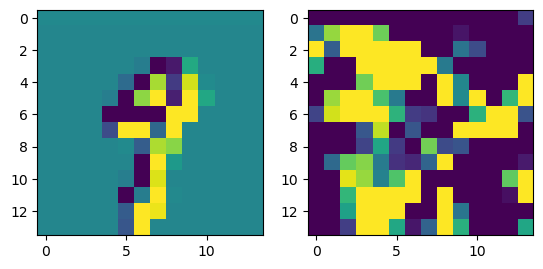

prediction: tensor([3, 9, 1]), tensor([3.0848, 2.4761, 0.9164]) groudtruth: 9
-0.07161486 0.0816007


<Figure size 640x480 with 0 Axes>

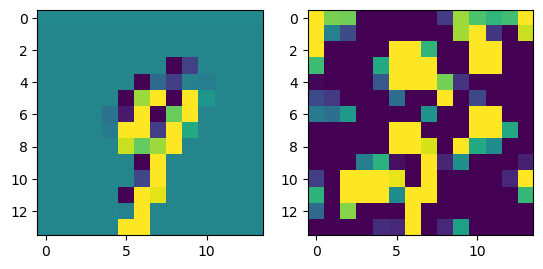

prediction: tensor([5, 9, 6]), tensor([5.0172, 0.9667, 0.8564]) groudtruth: 5
-0.088647425 0.073134795


<Figure size 640x480 with 0 Axes>

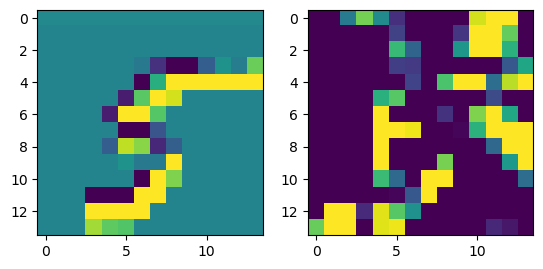

prediction: tensor([8, 2, 1]), tensor([4.7304, 1.9332, 0.8943]) groudtruth: 8
-0.09231895 0.07888949


<Figure size 640x480 with 0 Axes>

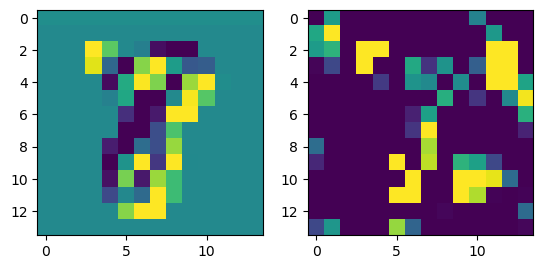

prediction: tensor([6, 2, 4]), tensor([5.3686, 2.4449, 1.0582]) groudtruth: 6
-0.07840997 0.07813023


<Figure size 640x480 with 0 Axes>

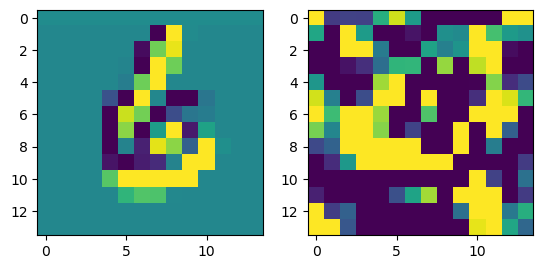

prediction: tensor([7, 6, 9]), tensor([3.9792, 1.0935, 0.8318]) groudtruth: 7
-0.07242519 0.07977481


<Figure size 640x480 with 0 Axes>

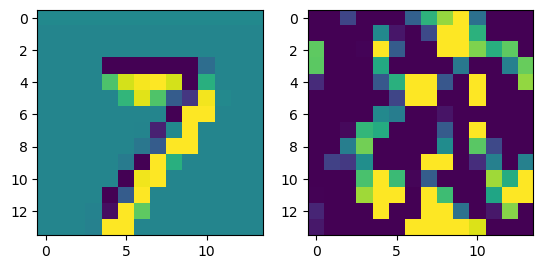

prediction: tensor([0, 2, 7]), tensor([4.6927, 2.2294, 1.0796]) groudtruth: 0
-0.0735386 0.09113112


<Figure size 640x480 with 0 Axes>

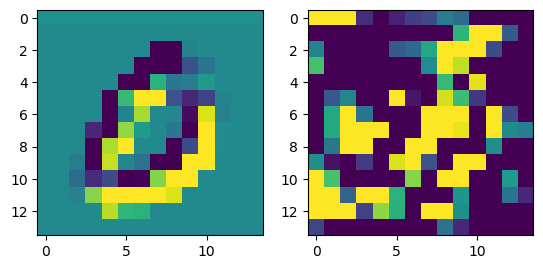

prediction: tensor([6, 0, 4]), tensor([4.6892, 0.7152, 0.5056]) groudtruth: 6
-0.058164537 0.073104024


<Figure size 640x480 with 0 Axes>

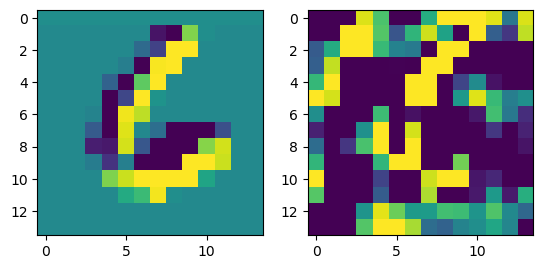

prediction: tensor([8, 7, 1]), tensor([4.3196, 0.6719, 0.2162]) groudtruth: 8
-0.11845261 0.10314892


<Figure size 640x480 with 0 Axes>

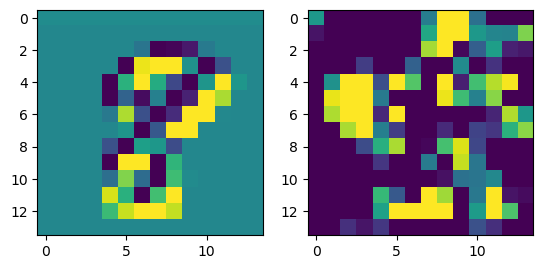

prediction: tensor([2, 6, 3]), tensor([5.1795, 1.9899, 1.2146]) groudtruth: 2
-0.08634651 0.06729749


<Figure size 640x480 with 0 Axes>

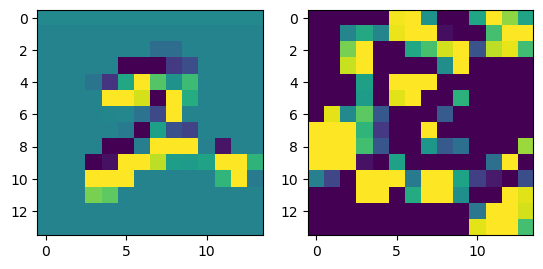

prediction: tensor([6, 4, 8]), tensor([6.0263, 1.4199, 0.4612]) groudtruth: 6
-0.07714248 0.07408101


<Figure size 640x480 with 0 Axes>

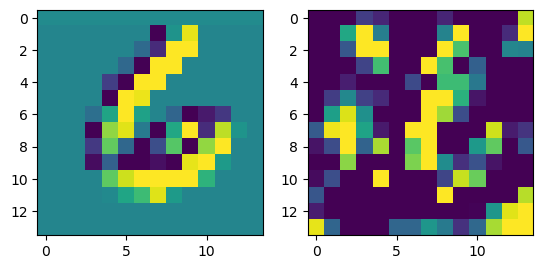

prediction: tensor([3, 5, 8]), tensor([4.6601, 2.9385, 2.3003]) groudtruth: 3
-0.07501376 0.08955836


<Figure size 640x480 with 0 Axes>

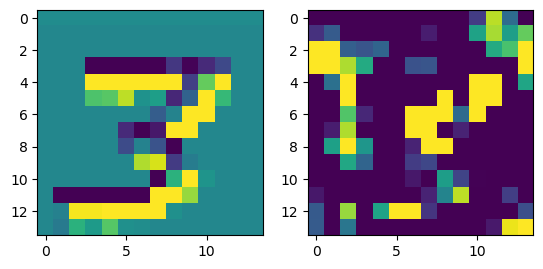

prediction: tensor([9, 3, 8]), tensor([4.4171, 1.6979, 0.5695]) groudtruth: 9
-0.07991058 0.077979304


<Figure size 640x480 with 0 Axes>

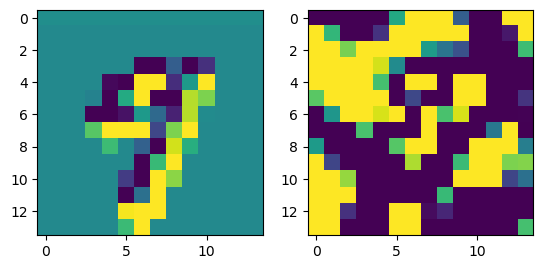

prediction: tensor([5, 3, 6]), tensor([4.2965, 2.5416, 1.3730]) groudtruth: 3
-0.09456974 0.09633953


<Figure size 640x480 with 0 Axes>

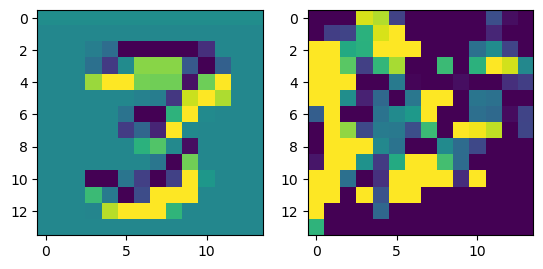

prediction: tensor([0, 6, 7]), tensor([5.7991, 2.5470, 2.2771]) groudtruth: 0
-0.073013365 0.08869113


<Figure size 640x480 with 0 Axes>

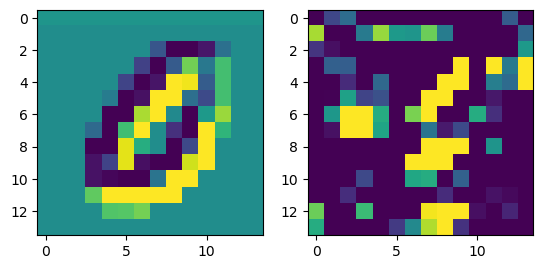

prediction: tensor([4, 8, 6]), tensor([5.6612, 1.9139, 1.6810]) groudtruth: 4
-0.11608255 0.07206376


<Figure size 640x480 with 0 Axes>

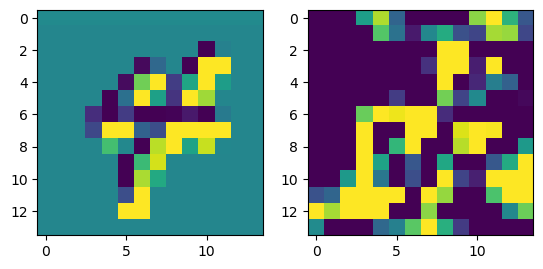

prediction: tensor([3, 5, 1]), tensor([3.2819, 1.5272, 0.9787]) groudtruth: 3
-0.082901716 0.093894705


<Figure size 640x480 with 0 Axes>

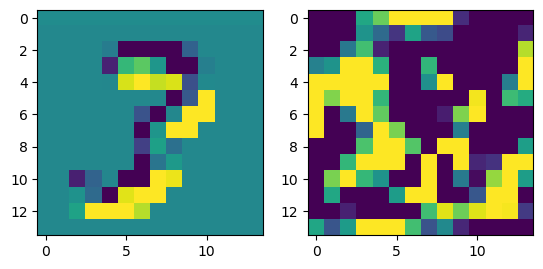

prediction: tensor([1, 2, 8]), tensor([3.4800, 1.5524, 0.6197]) groudtruth: 1
-0.09439641 0.110082015


<Figure size 640x480 with 0 Axes>

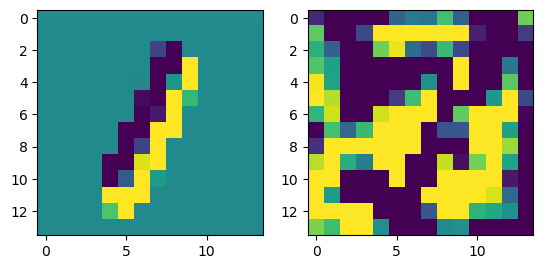

prediction: tensor([6, 9, 4]), tensor([2.0938, 1.3485, 0.9819]) groudtruth: 6
-0.08091682 0.07521047


<Figure size 640x480 with 0 Axes>

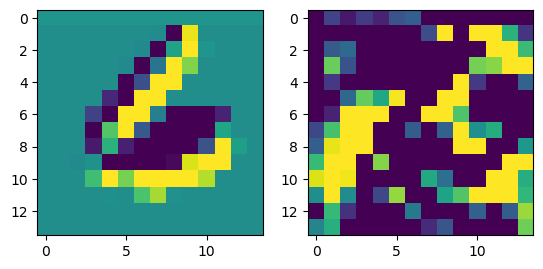

prediction: tensor([1, 7, 8]), tensor([4.8149, 0.6772, 0.5794]) groudtruth: 1
-0.08750647 0.06469314


<Figure size 640x480 with 0 Axes>

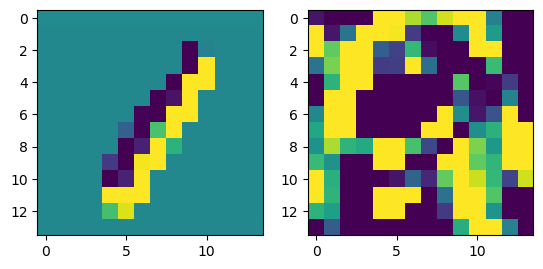

prediction: tensor([9, 1, 3]), tensor([3.1649, 0.9533, 0.7743]) groudtruth: 9
-0.08930391 0.052335087


<Figure size 640x480 with 0 Axes>

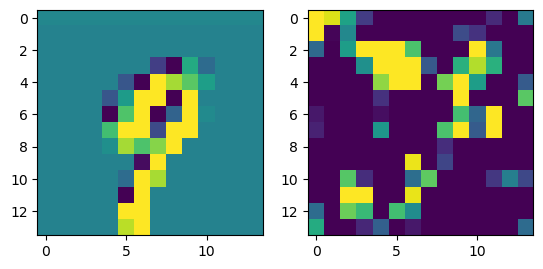

prediction: tensor([0, 7, 6]), tensor([3.8302, 1.3904, 1.3467]) groudtruth: 0
-0.08395374 0.09287938


<Figure size 640x480 with 0 Axes>

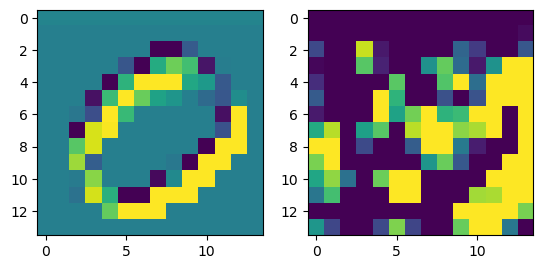

prediction: tensor([1, 8, 6]), tensor([6.6973, 0.5492, 0.4485]) groudtruth: 1
-0.0882628 0.08956606


<Figure size 640x480 with 0 Axes>

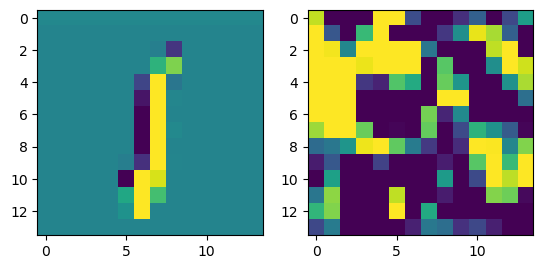

prediction: tensor([4, 1, 0]), tensor([4.4673, 1.4843, 0.7847]) groudtruth: 4
-0.08859867 0.073789015


<Figure size 640x480 with 0 Axes>

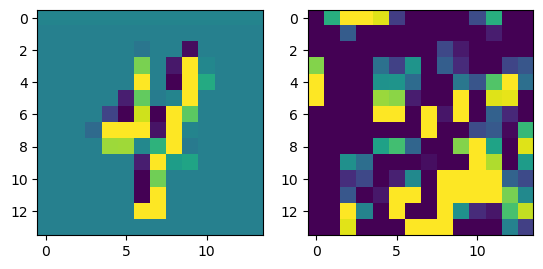

prediction: tensor([5, 9, 3]), tensor([6.5495, 3.0330, 2.8970]) groudtruth: 5
-0.10115212 0.095138565


<Figure size 640x480 with 0 Axes>

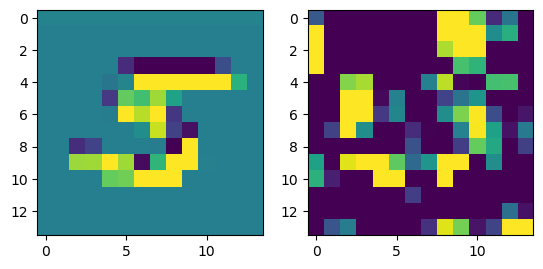

prediction: tensor([6, 7, 0]), tensor([5.0858, 2.4073, 0.6993]) groudtruth: 6
-0.089760005 0.06651314


<Figure size 640x480 with 0 Axes>

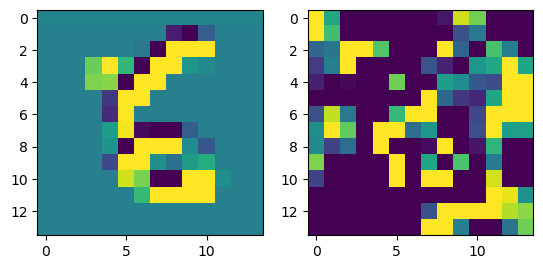

prediction: tensor([6, 7, 0]), tensor([3.4606, 3.1580, 1.7712]) groudtruth: 7
-0.08741337 0.07977195


<Figure size 640x480 with 0 Axes>

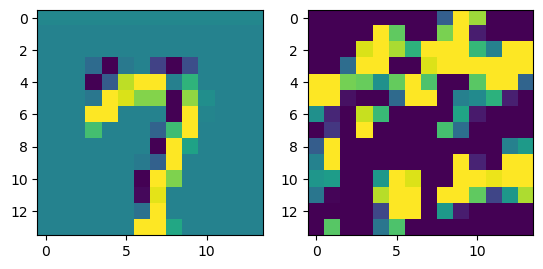

prediction: tensor([8, 0, 3]), tensor([5.5086, 0.5381, 0.5104]) groudtruth: 8
-0.07899904 0.07240466


<Figure size 640x480 with 0 Axes>

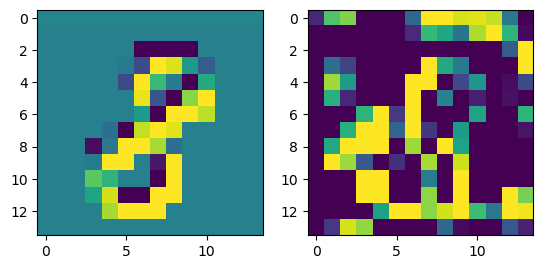

prediction: tensor([7, 9, 3]), tensor([4.2802, 3.0160, 1.4865]) groudtruth: 9
-0.072968364 0.07114956


<Figure size 640x480 with 0 Axes>

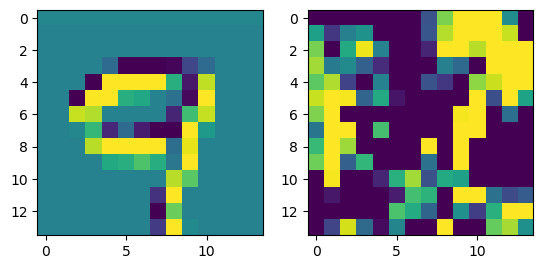

prediction: tensor([1, 8, 7]), tensor([6.5743, 1.9824, 1.6151]) groudtruth: 1
-0.07252622 0.09686145


<Figure size 640x480 with 0 Axes>

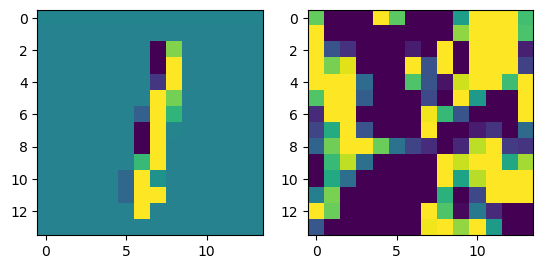

prediction: tensor([1, 0, 5]), tensor([3.4348, 2.5240, 1.7227]) groudtruth: 1
-0.070446074 0.06772772


<Figure size 640x480 with 0 Axes>

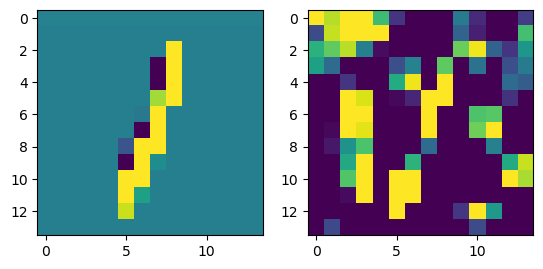

prediction: tensor([7, 0, 5]), tensor([2.9254, 2.8616, 2.4832]) groudtruth: 3
-0.091596186 0.107334785


<Figure size 640x480 with 0 Axes>

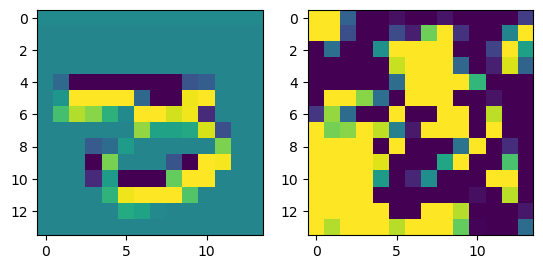

prediction: tensor([8, 9, 5]), tensor([3.2372, 2.6067, 1.3170]) groudtruth: 8
-0.11802012 0.14567089


<Figure size 640x480 with 0 Axes>

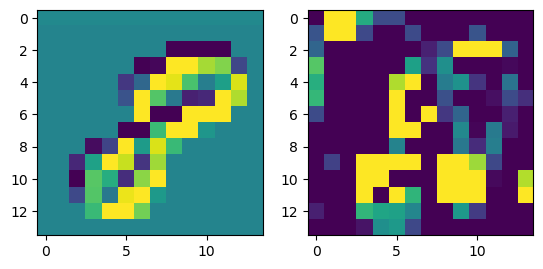

prediction: tensor([7, 2, 9]), tensor([2.4948, 2.1852, 2.1529]) groudtruth: 2
-0.08497763 0.088523924


<Figure size 640x480 with 0 Axes>

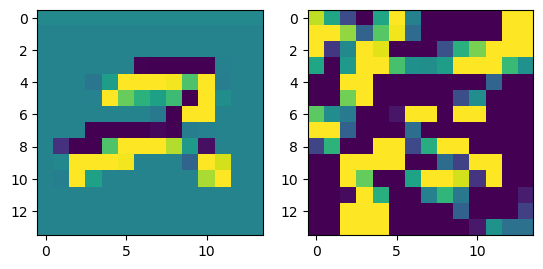

prediction: tensor([9, 7, 3]), tensor([6.5021, 1.3514, 1.0376]) groudtruth: 9
-0.06520438 0.094937705


<Figure size 640x480 with 0 Axes>

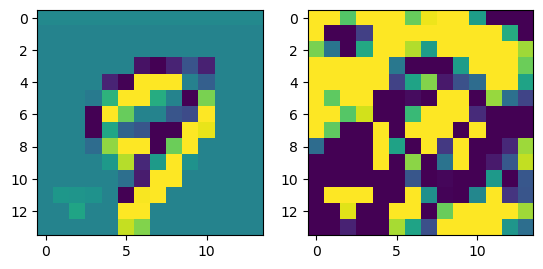

prediction: tensor([2, 3, 5]), tensor([4.3471, 2.3984, 1.5285]) groudtruth: 2
-0.058662653 0.078961566


<Figure size 640x480 with 0 Axes>

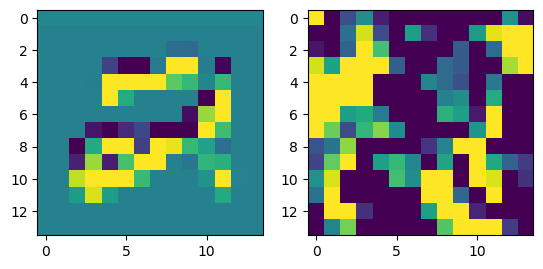

prediction: tensor([9, 7, 6]), tensor([2.7321, 1.4725, 1.3743]) groudtruth: 7
-0.07830739 0.096854284


<Figure size 640x480 with 0 Axes>

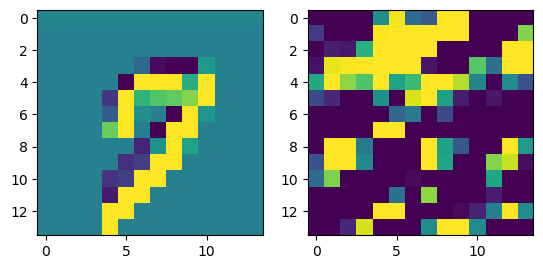

prediction: tensor([6, 5, 2]), tensor([5.8821, 1.3675, 1.0062]) groudtruth: 6
-0.082570076 0.06878711


<Figure size 640x480 with 0 Axes>

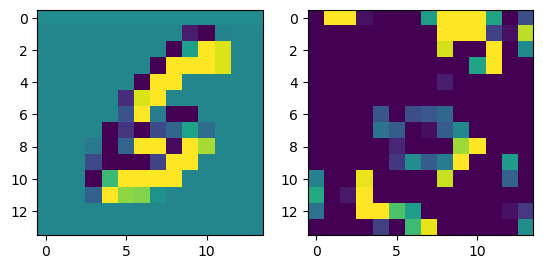

prediction: tensor([5, 9, 8]), tensor([5.4340, 2.0723, 1.9723]) groudtruth: 5
-0.09679711 0.100540385


<Figure size 640x480 with 0 Axes>

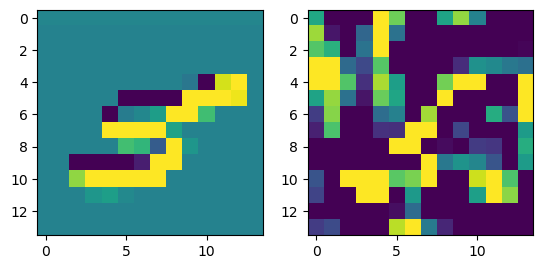

prediction: tensor([5, 8, 9]), tensor([4.1696, 1.8416, 1.8414]) groudtruth: 5
-0.11489272 0.10021068


<Figure size 640x480 with 0 Axes>

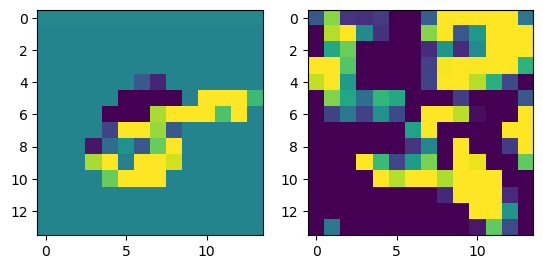

prediction: tensor([9, 7, 2]), tensor([6.1987, 2.0897, 1.2119]) groudtruth: 9
-0.10303795 0.09492546


<Figure size 640x480 with 0 Axes>

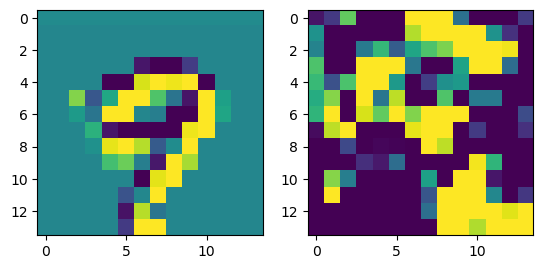

prediction: tensor([9, 7, 4]), tensor([3.4703, 2.3093, 0.4897]) groudtruth: 9
-0.0846194 0.10604361


<Figure size 640x480 with 0 Axes>

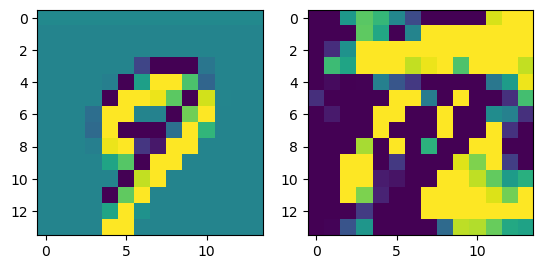

prediction: tensor([8, 9, 5]), tensor([6.4635, 4.0341, 0.2416]) groudtruth: 8
-0.071294606 0.10586056


<Figure size 640x480 with 0 Axes>

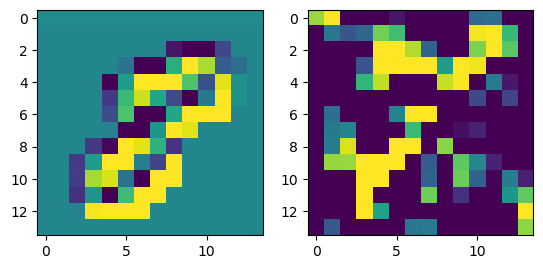

prediction: tensor([2, 3, 7]), tensor([4.9324, 1.5749, 1.3031]) groudtruth: 2
-0.089758635 0.10247206


<Figure size 640x480 with 0 Axes>

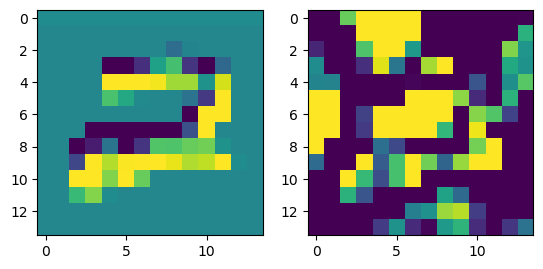

prediction: tensor([9, 7, 6]), tensor([2.6854, 1.8918, 1.0238]) groudtruth: 9
-0.07769179 0.1387172


<Figure size 640x480 with 0 Axes>

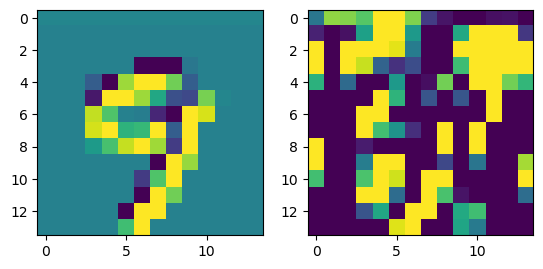

prediction: tensor([1, 2, 3]), tensor([1.9236, 1.6006, 1.3902]) groudtruth: 1
-0.0810585 0.07433464


<Figure size 640x480 with 0 Axes>

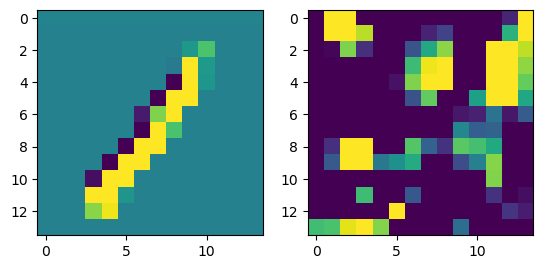

prediction: tensor([7, 9, 4]), tensor([4.4097, 1.9420, 0.4318]) groudtruth: 7
-0.077685416 0.089793906


<Figure size 640x480 with 0 Axes>

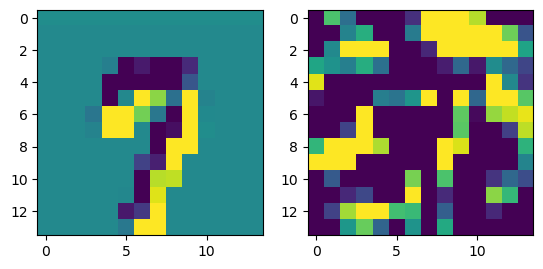

prediction: tensor([8, 2, 4]), tensor([2.7871, 0.9843, 0.8131]) groudtruth: 8
-0.08671117 0.08305721


<Figure size 640x480 with 0 Axes>

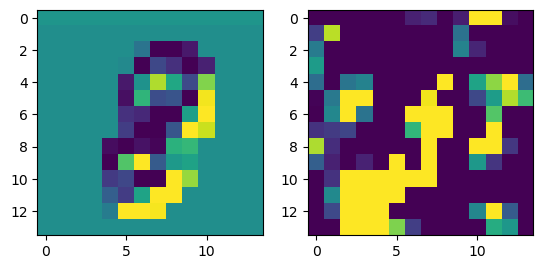

prediction: tensor([9, 7, 6]), tensor([3.0542, 2.1067, 0.4538]) groudtruth: 9
-0.069833815 0.08054924


<Figure size 640x480 with 0 Axes>

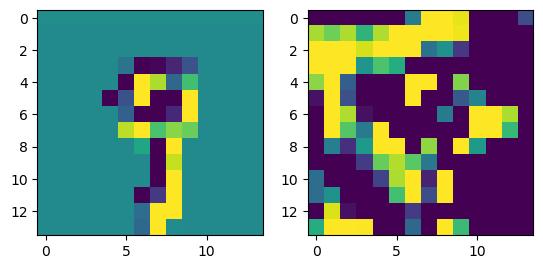

prediction: tensor([1, 4, 7]), tensor([6.8482, 0.9185, 0.3653]) groudtruth: 1
-0.061430514 0.08119639


<Figure size 640x480 with 0 Axes>

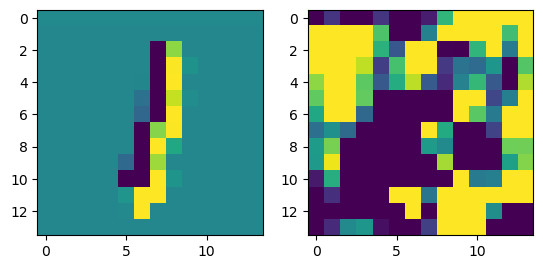

prediction: tensor([7, 0, 6]), tensor([4.3609, 1.5128, 1.2728]) groudtruth: 7
-0.09634793 0.087167524


<Figure size 640x480 with 0 Axes>

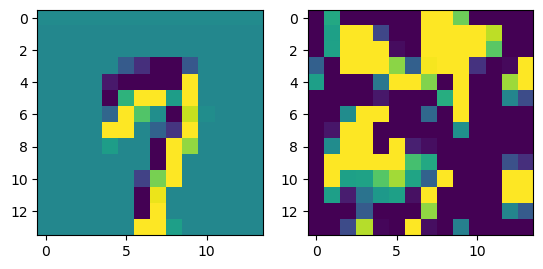

prediction: tensor([4, 0, 7]), tensor([4.7454, 0.8809, 0.6689]) groudtruth: 4
-0.085184336 0.076383546


<Figure size 640x480 with 0 Axes>

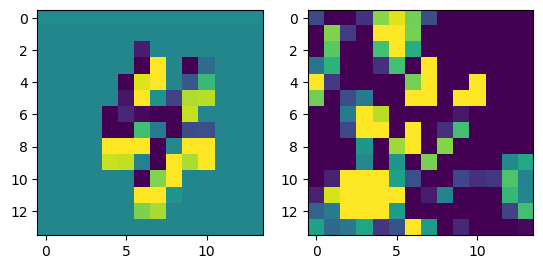

prediction: tensor([8, 3, 9]), tensor([4.2993, 1.5966, 0.8422]) groudtruth: 8
-0.096852005 0.11838657


<Figure size 640x480 with 0 Axes>

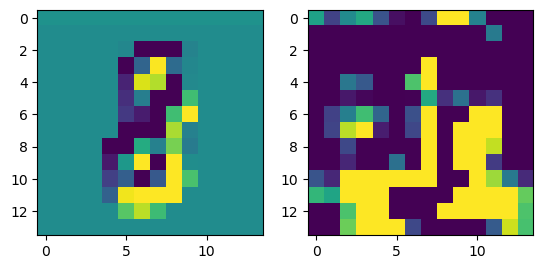

prediction: tensor([1, 7, 9]), tensor([4.8967, 3.1973, 0.2290]) groudtruth: 1
-0.07375234 0.08057732


<Figure size 640x480 with 0 Axes>

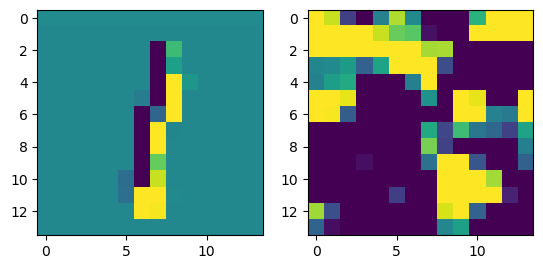

prediction: tensor([7, 6, 5]), tensor([1.7599, 1.4155, 1.2883]) groudtruth: 5
-0.086144805 0.08933689


<Figure size 640x480 with 0 Axes>

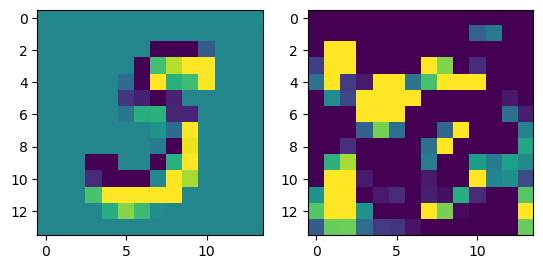

prediction: tensor([6, 2, 9]), tensor([3.3871, 2.0266, 1.4281]) groudtruth: 6
-0.09146488 0.07647909


<Figure size 640x480 with 0 Axes>

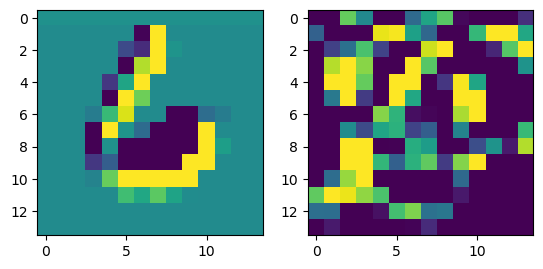

prediction: tensor([3, 5, 1]), tensor([3.1051, 2.6696, 1.2732]) groudtruth: 5
-0.085668445 0.09496097


<Figure size 640x480 with 0 Axes>

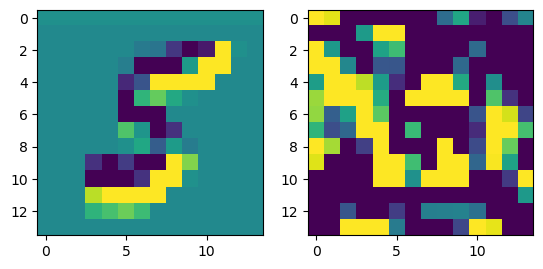

prediction: tensor([7, 9, 4]), tensor([4.1266, 2.3847, 1.0419]) groudtruth: 7
-0.09618217 0.077360265


<Figure size 640x480 with 0 Axes>

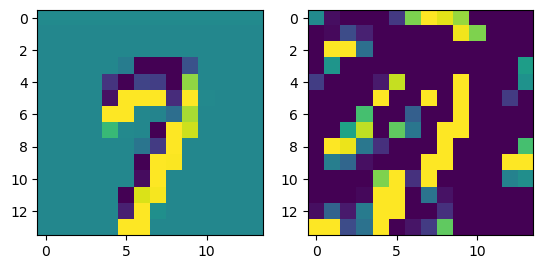

prediction: tensor([2, 6, 1]), tensor([4.4236, 1.0978, 0.6406]) groudtruth: 2
-0.076108396 0.08918227


<Figure size 640x480 with 0 Axes>

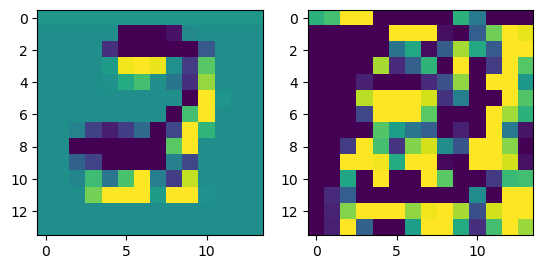

prediction: tensor([0, 2, 7]), tensor([2.6072, 1.9660, 0.7533]) groudtruth: 8
-0.079904854 0.08099548


<Figure size 640x480 with 0 Axes>

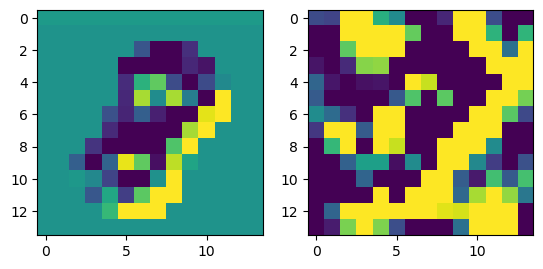

prediction: tensor([6, 2, 9]), tensor([3.3513, 2.8317, 2.0615]) groudtruth: 6
-0.06867629 0.09218439


<Figure size 640x480 with 0 Axes>

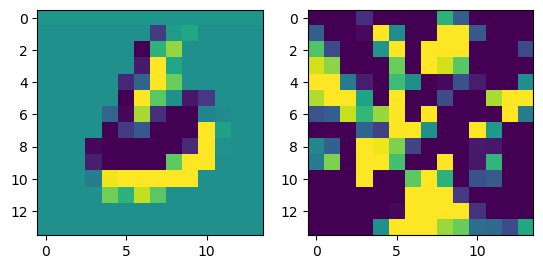

prediction: tensor([3, 2, 9]), tensor([4.2317, 1.9006, 1.6397]) groudtruth: 3
-0.07274556 0.08474687


<Figure size 640x480 with 0 Axes>

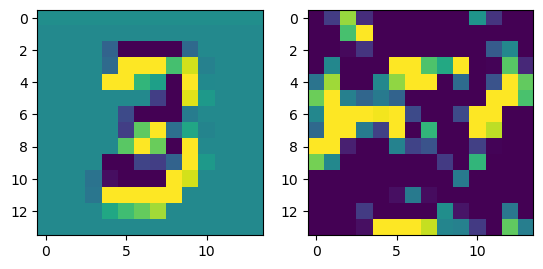

prediction: tensor([9, 6, 1]), tensor([3.4699, 0.9237, 0.2434]) groudtruth: 9
-0.09402192 0.09401431


<Figure size 640x480 with 0 Axes>

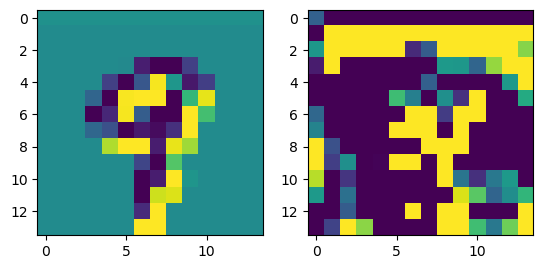

prediction: tensor([8, 4, 6]), tensor([1.4336, 1.1439, 0.6041]) groudtruth: 4
-0.07189125 0.069500595


<Figure size 640x480 with 0 Axes>

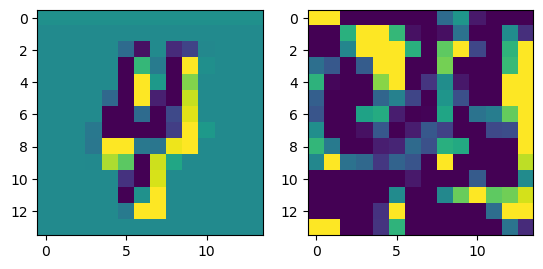

prediction: tensor([7, 6, 0]), tensor([4.0992, 1.0357, 1.0181]) groudtruth: 7
-0.09845537 0.1163609


<Figure size 640x480 with 0 Axes>

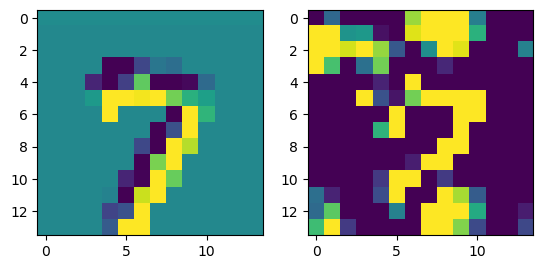

prediction: tensor([7, 0, 2]), tensor([2.0101, 1.8923, 1.5656]) groudtruth: 0
-0.080950975 0.07128399


<Figure size 640x480 with 0 Axes>

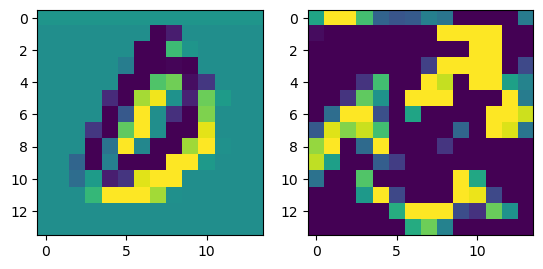

prediction: tensor([2, 6, 5]), tensor([2.6340, 2.0903, 1.1873]) groudtruth: 2
-0.106868744 0.12833776


<Figure size 640x480 with 0 Axes>

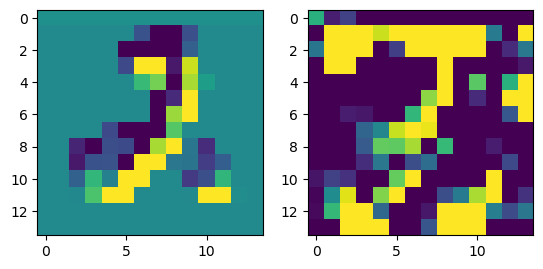

prediction: tensor([3, 2, 5]), tensor([4.7115, 2.1545, 1.1662]) groudtruth: 3
-0.09739274 0.109017


<Figure size 640x480 with 0 Axes>

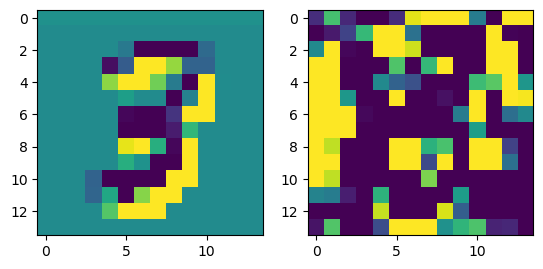

prediction: tensor([4, 7, 1]), tensor([2.8135, 1.7422, 0.7862]) groudtruth: 4
-0.08121359 0.0791356


<Figure size 640x480 with 0 Axes>

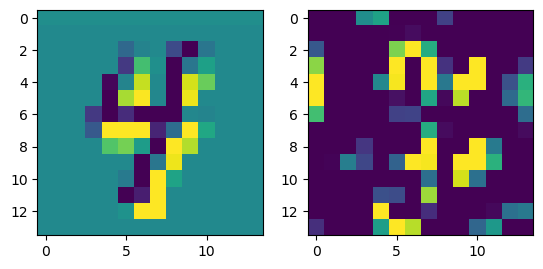

prediction: tensor([0, 7, 6]), tensor([4.3436, 2.3901, 1.6208]) groudtruth: 0
-0.08345616 0.0836595


<Figure size 640x480 with 0 Axes>

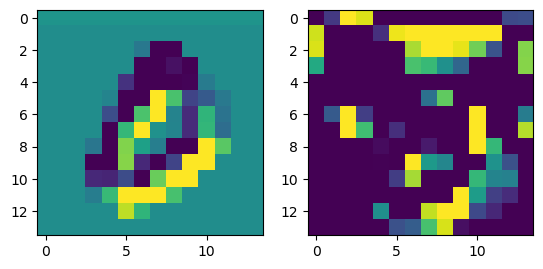

prediction: tensor([0, 7, 8]), tensor([4.4584, 1.5790, 1.0486]) groudtruth: 0
-0.06969738 0.09012373


<Figure size 640x480 with 0 Axes>

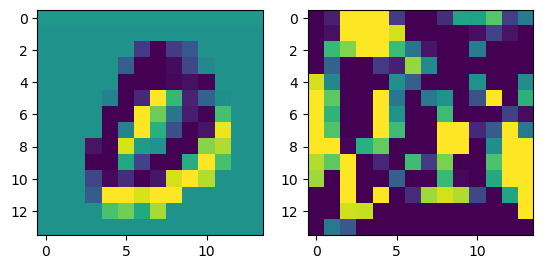

prediction: tensor([8, 7, 2]), tensor([3.4976, 1.4141, 1.3922]) groudtruth: 8
-0.07555395 0.055074908


<Figure size 640x480 with 0 Axes>

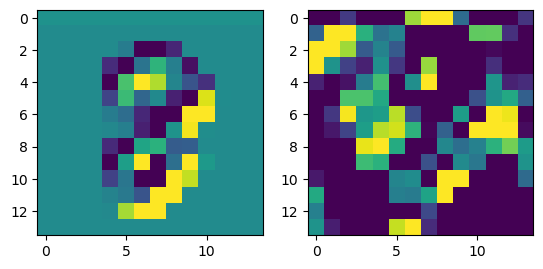

prediction: tensor([8, 3, 0]), tensor([2.8315, 1.8773, 1.7721]) groudtruth: 8
-0.076387346 0.0973253


<Figure size 640x480 with 0 Axes>

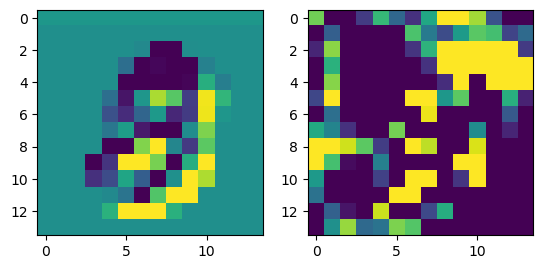

prediction: tensor([8, 0, 6]), tensor([3.2540, 1.5056, 0.9385]) groudtruth: 8
-0.090747416 0.089786835


<Figure size 640x480 with 0 Axes>

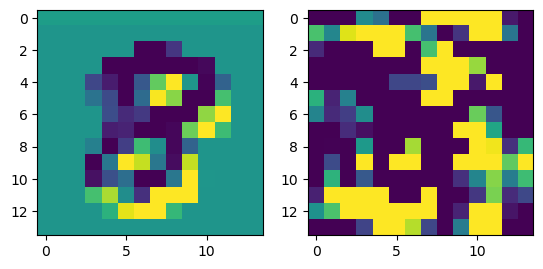

prediction: tensor([5, 3, 6]), tensor([2.5162, 1.9240, 1.2511]) groudtruth: 5
-0.07010889 0.07550739


<Figure size 640x480 with 0 Axes>

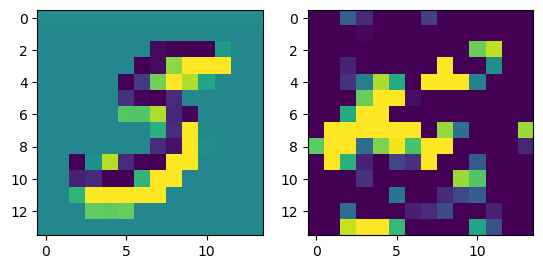

prediction: tensor([1, 9, 7]), tensor([4.1304, 2.0571, 0.3605]) groudtruth: 1
-0.096441686 0.07832694


<Figure size 640x480 with 0 Axes>

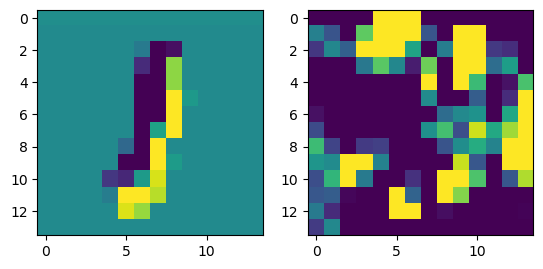

prediction: tensor([3, 2, 6]), tensor([4.4192, 1.3055, 0.8616]) groudtruth: 3
-0.073619604 0.07728162


<Figure size 640x480 with 0 Axes>

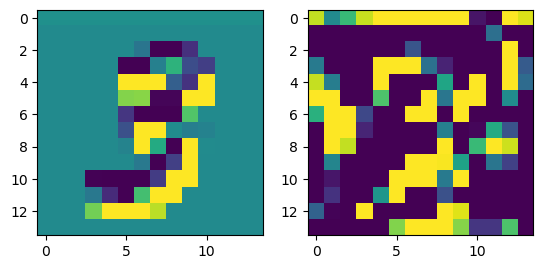

prediction: tensor([7, 9, 2]), tensor([ 4.6738,  2.5091, -0.4746]) groudtruth: 7
-0.06556976 0.084999286


<Figure size 640x480 with 0 Axes>

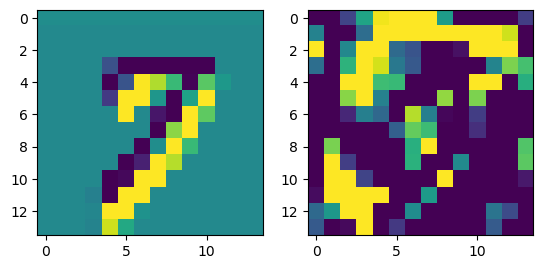

prediction: tensor([1, 0, 2]), tensor([3.6641, 0.3546, 0.2978]) groudtruth: 1
-0.0640049 0.06800517


<Figure size 640x480 with 0 Axes>

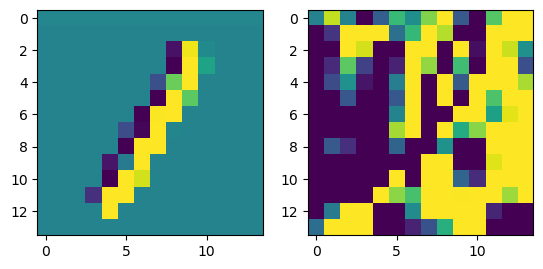

prediction: tensor([9, 4, 8]), tensor([3.3605, 2.8808, 0.5174]) groudtruth: 4
-0.06907308 0.06081442


<Figure size 640x480 with 0 Axes>

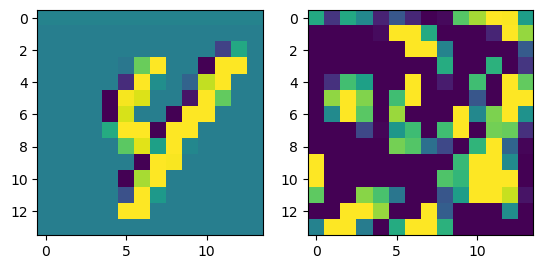

prediction: tensor([5, 9, 8]), tensor([4.5400, 4.0151, 2.4672]) groudtruth: 9
-0.057019055 0.10203121


<Figure size 640x480 with 0 Axes>

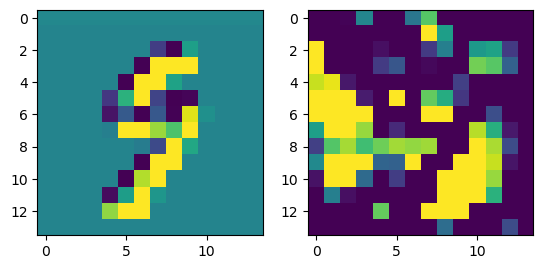

prediction: tensor([6, 0, 2]), tensor([5.5168, 3.2899, 1.0995]) groudtruth: 6
-0.06863499 0.077410094


<Figure size 640x480 with 0 Axes>

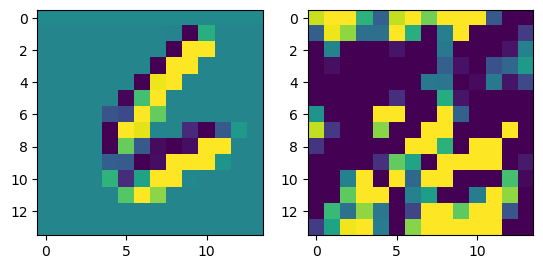

prediction: tensor([8, 2, 5]), tensor([6.0878, 1.9003, 1.5419]) groudtruth: 8
-0.096946955 0.070108086


<Figure size 640x480 with 0 Axes>

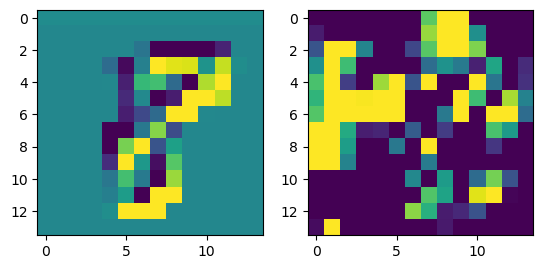

prediction: tensor([8, 4, 5]), tensor([2.1873, 2.1491, 2.0218]) groudtruth: 4
-0.094459355 0.07171811


<Figure size 640x480 with 0 Axes>

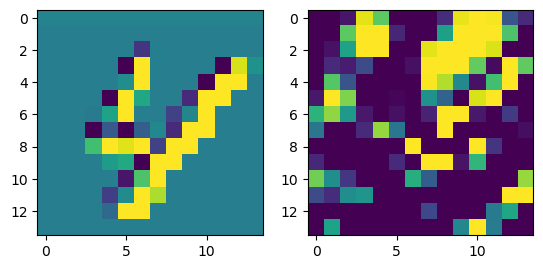

prediction: tensor([5, 9, 8]), tensor([3.8331, 2.1190, 2.0392]) groudtruth: 5
-0.1071679 0.08143731


<Figure size 640x480 with 0 Axes>

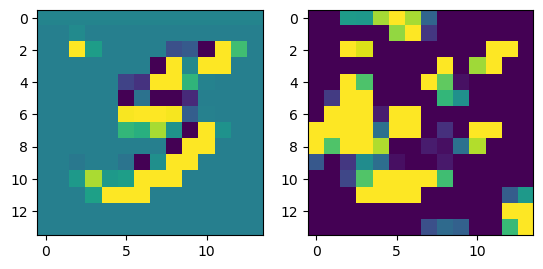

prediction: tensor([3, 9, 0]), tensor([3.5983, 3.0474, 0.6636]) groudtruth: 3
-0.0905925 0.08448082


<Figure size 640x480 with 0 Axes>

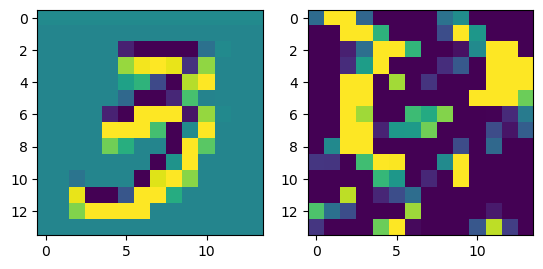

prediction: tensor([2, 8, 3]), tensor([2.2573, 1.3899, 1.2818]) groudtruth: 7
-0.08032858 0.08430542


<Figure size 640x480 with 0 Axes>

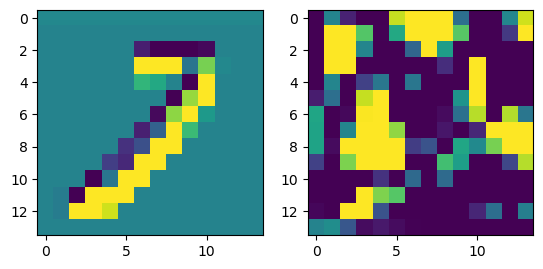

prediction: tensor([8, 2, 0]), tensor([3.3527, 2.6555, 2.5057]) groudtruth: 8
-0.09060794 0.07800481


<Figure size 640x480 with 0 Axes>

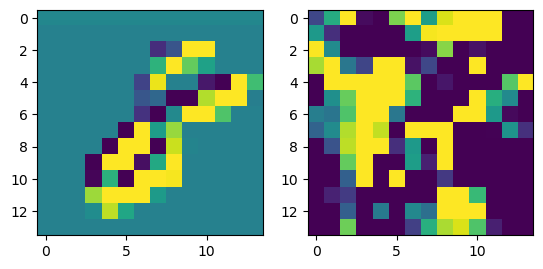

prediction: tensor([6, 3, 8]), tensor([1.9566, 1.3353, 1.2928]) groudtruth: 4
-0.0864681 0.08925404


<Figure size 640x480 with 0 Axes>

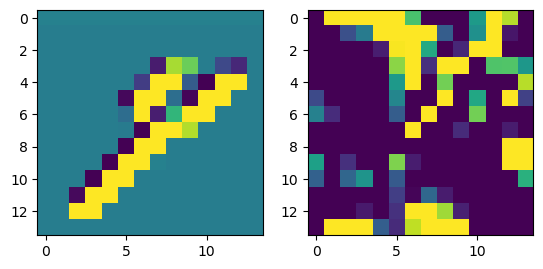

prediction: tensor([3, 5, 7]), tensor([3.4040, 1.8183, 1.7105]) groudtruth: 3
-0.07434529 0.09782867


<Figure size 640x480 with 0 Axes>

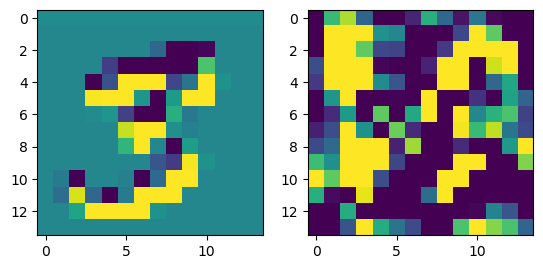

prediction: tensor([3, 5, 8]), tensor([4.0961, 0.9725, 0.7565]) groudtruth: 3
-0.1346237 0.07519752


<Figure size 640x480 with 0 Axes>

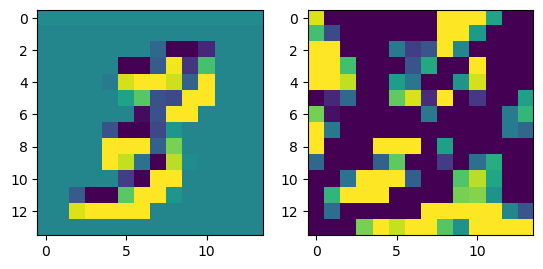

prediction: tensor([5, 4, 3]), tensor([5.8654, 2.2839, 1.1724]) groudtruth: 5
-0.08264655 0.08242598


<Figure size 640x480 with 0 Axes>

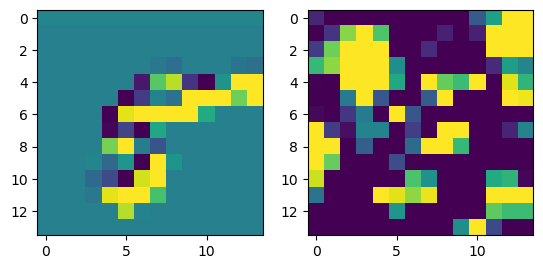

prediction: tensor([6, 2, 7]), tensor([3.7987, 2.7924, 1.5135]) groudtruth: 6
-0.078866065 0.09945028


<Figure size 640x480 with 0 Axes>

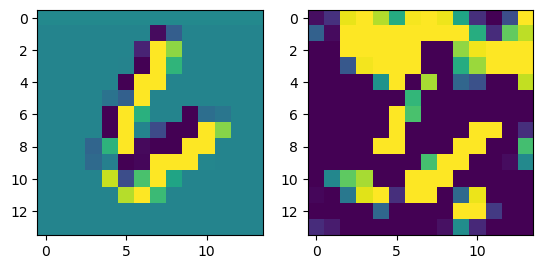

prediction: tensor([7, 2, 6]), tensor([3.2883, 2.2466, 1.5008]) groudtruth: 7
-0.0753997 0.07759285


<Figure size 640x480 with 0 Axes>

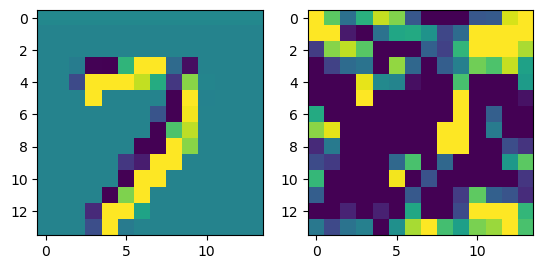

prediction: tensor([4, 8, 3]), tensor([2.8591, 2.4189, 1.4842]) groudtruth: 4
-0.09106243 0.09316195


<Figure size 640x480 with 0 Axes>

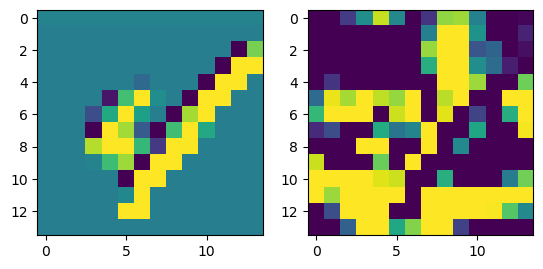

prediction: tensor([9, 5, 7]), tensor([3.7250, 2.5877, 1.3439]) groudtruth: 9
-0.07494086 0.0893919


<Figure size 640x480 with 0 Axes>

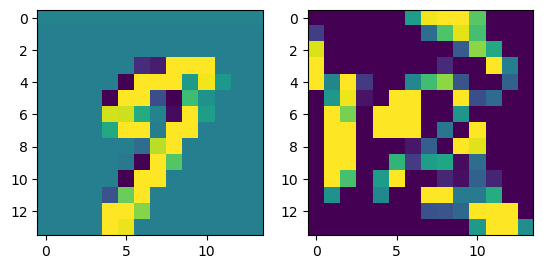

prediction: tensor([7, 2, 9]), tensor([4.6526, 2.4407, 0.7381]) groudtruth: 7
-0.09976566 0.09041306


<Figure size 640x480 with 0 Axes>

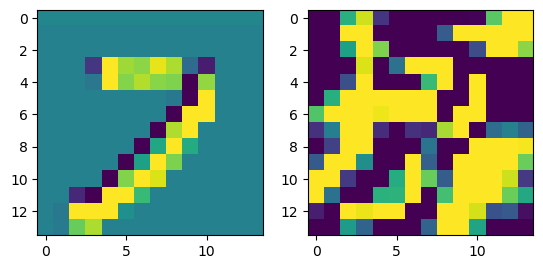

prediction: tensor([2, 0, 3]), tensor([2.1547, 0.8735, 0.5014]) groudtruth: 0
-0.090729594 0.1188924


<Figure size 640x480 with 0 Axes>

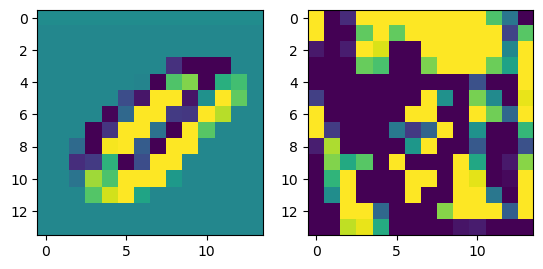

prediction: tensor([2, 3, 7]), tensor([3.3434, 1.6456, 0.6368]) groudtruth: 2
-0.09937364 0.10736536


<Figure size 640x480 with 0 Axes>

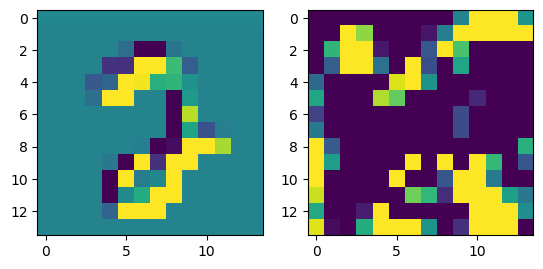

prediction: tensor([7, 9, 2]), tensor([5.4302, 1.8960, 0.4502]) groudtruth: 7
-0.082497716 0.08070673


<Figure size 640x480 with 0 Axes>

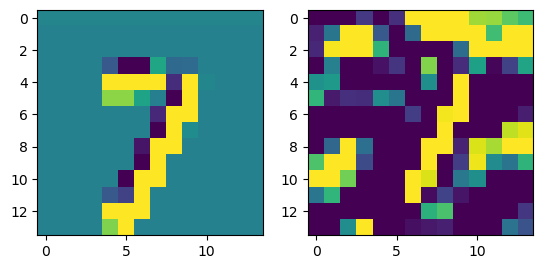

prediction: tensor([4, 1, 8]), tensor([2.5323, 1.9684, 1.5153]) groudtruth: 4
-0.09168404 0.07979204


<Figure size 640x480 with 0 Axes>

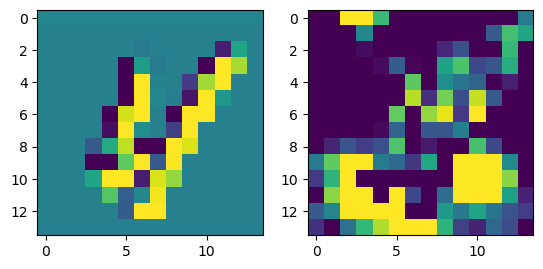

prediction: tensor([9, 7, 8]), tensor([3.6534, 1.9589, 1.0224]) groudtruth: 9
-0.06699622 0.12697797


<Figure size 640x480 with 0 Axes>

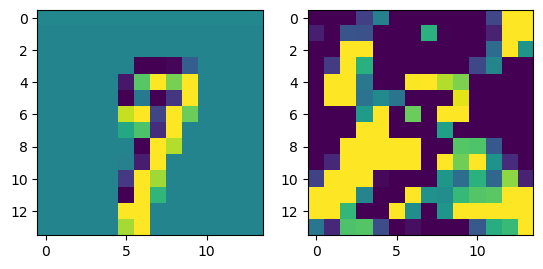

prediction: tensor([9, 7, 5]), tensor([4.1815, 1.6661, 0.7246]) groudtruth: 9
-0.07792652 0.09493232


<Figure size 640x480 with 0 Axes>

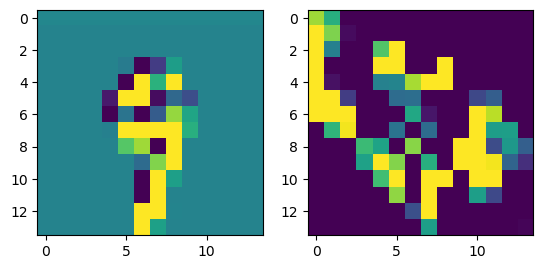

prediction: tensor([7, 2, 4]), tensor([4.1376, 4.0644, 1.8735]) groudtruth: 2
-0.08069003 0.069036126


<Figure size 640x480 with 0 Axes>

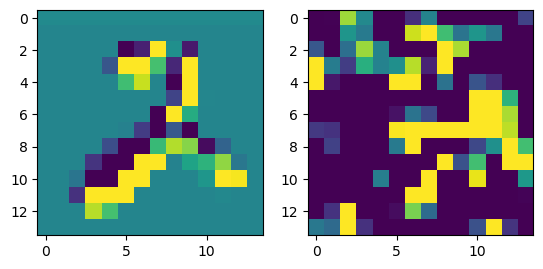

prediction: tensor([2, 3, 6]), tensor([1.6551, 1.5987, 0.8813]) groudtruth: 5
-0.05638933 0.065666474


<Figure size 640x480 with 0 Axes>

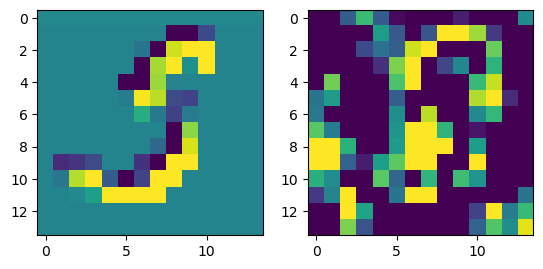

prediction: tensor([9, 8, 7]), tensor([6.8939, 1.2986, 0.9575]) groudtruth: 9
-0.099722326 0.12058973


<Figure size 640x480 with 0 Axes>

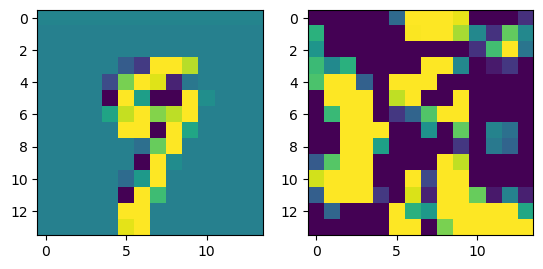

prediction: tensor([8, 1, 3]), tensor([4.3854, 1.0434, 0.8133]) groudtruth: 8
-0.08013642 0.06879291


<Figure size 640x480 with 0 Axes>

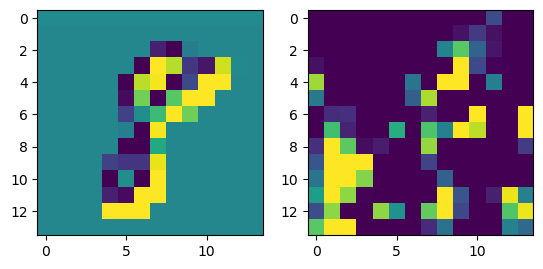

prediction: tensor([3, 2, 9]), tensor([5.0822, 1.6015, 1.2695]) groudtruth: 3
-0.09038669 0.10009918


<Figure size 640x480 with 0 Axes>

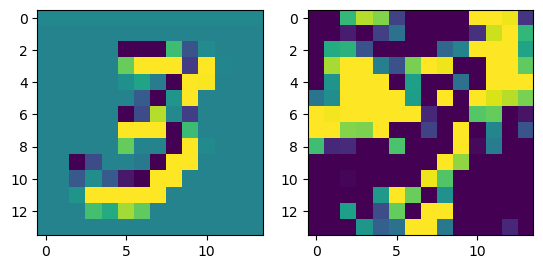

prediction: tensor([8, 1, 2]), tensor([4.2748, 1.0164, 0.9656]) groudtruth: 8
-0.09628779 0.05599256


<Figure size 640x480 with 0 Axes>

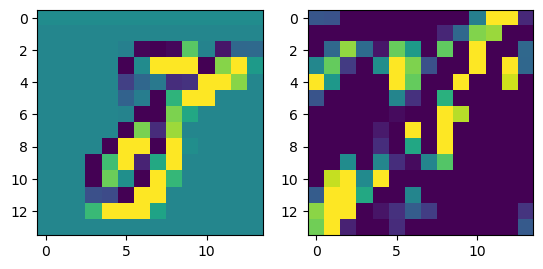

prediction: tensor([2, 7, 6]), tensor([2.5325, 2.2964, 1.9390]) groudtruth: 6
-0.10099518 0.07580263


<Figure size 640x480 with 0 Axes>

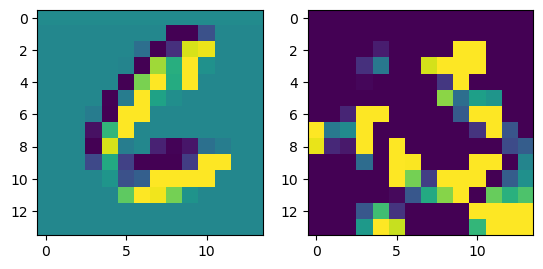

prediction: tensor([8, 7, 6]), tensor([4.5356, 1.6611, 1.3887]) groudtruth: 8
-0.086665094 0.081610635


<Figure size 640x480 with 0 Axes>

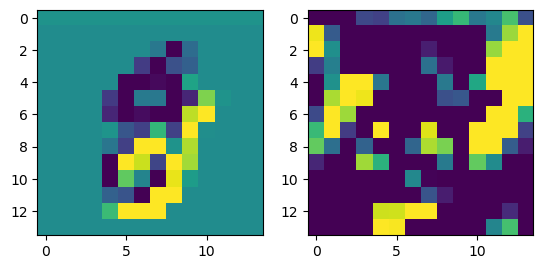

prediction: tensor([8, 0, 2]), tensor([3.5018, 1.6264, 1.3461]) groudtruth: 8
-0.08234042 0.069395505


<Figure size 640x480 with 0 Axes>

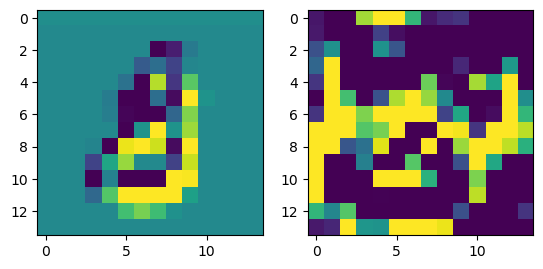

prediction: tensor([9, 3, 7]), tensor([2.9206, 2.5815, 1.3870]) groudtruth: 3
-0.12426585 0.08363378


<Figure size 640x480 with 0 Axes>

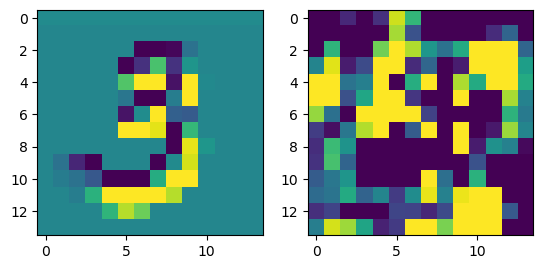

prediction: tensor([0, 7, 5]), tensor([3.7489, 0.8990, 0.8341]) groudtruth: 0
-0.07772851 0.058538094


<Figure size 640x480 with 0 Axes>

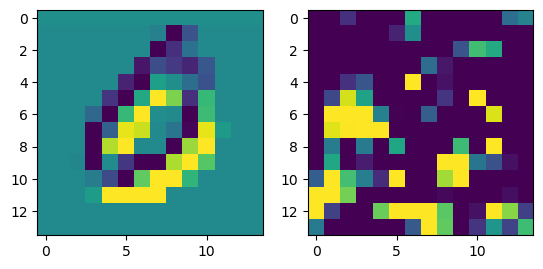

prediction: tensor([1, 7, 2]), tensor([4.4093, 1.4497, 1.0540]) groudtruth: 1
-0.11187863 0.08113142


<Figure size 640x480 with 0 Axes>

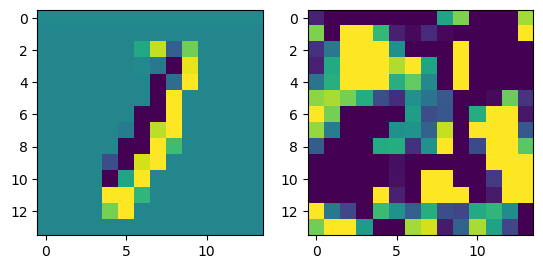

prediction: tensor([9, 6, 5]), tensor([4.7716, 1.6280, 0.5649]) groudtruth: 9
-0.099250436 0.107204005


<Figure size 640x480 with 0 Axes>

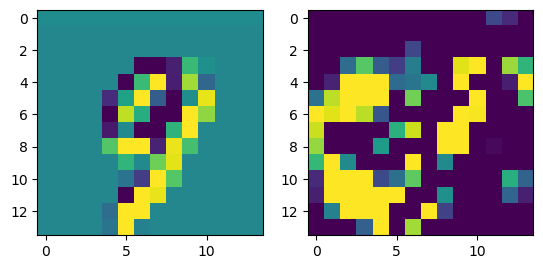

prediction: tensor([0, 2, 7]), tensor([3.6946, 1.8716, 1.8549]) groudtruth: 0
-0.09397006 0.066932954


<Figure size 640x480 with 0 Axes>

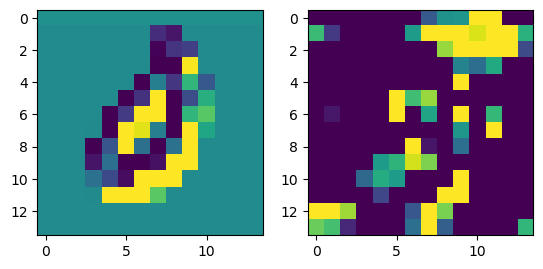

prediction: tensor([5, 3, 2]), tensor([5.8535, 3.0361, 2.2938]) groudtruth: 5
-0.08481729 0.092383415


<Figure size 640x480 with 0 Axes>

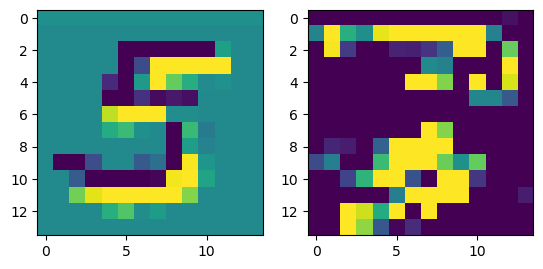

prediction: tensor([4, 1, 7]), tensor([3.5486, 1.3277, 0.6305]) groudtruth: 4
-0.07822502 0.093093015


<Figure size 640x480 with 0 Axes>

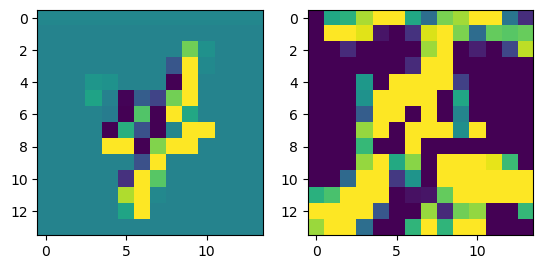

prediction: tensor([1, 2, 9]), tensor([3.2386, 0.7009, 0.6078]) groudtruth: 1
-0.0677315 0.08447067


<Figure size 640x480 with 0 Axes>

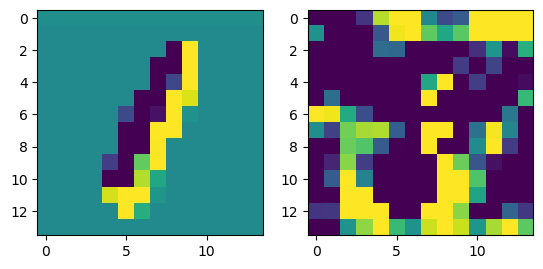

prediction: tensor([9, 3, 7]), tensor([4.4463, 2.5256, 1.4288]) groudtruth: 9
-0.09789759 0.07925251


<Figure size 640x480 with 0 Axes>

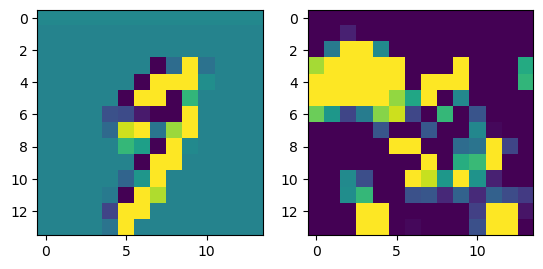

prediction: tensor([7, 1, 0]), tensor([2.2942, 2.2667, 1.4886]) groudtruth: 1
-0.084077 0.089597255


<Figure size 640x480 with 0 Axes>

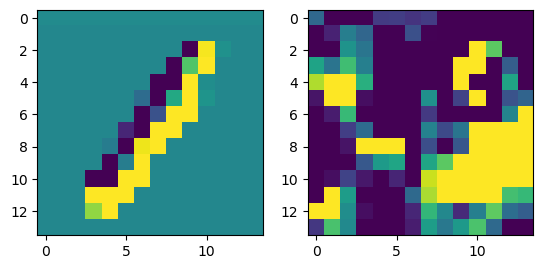

prediction: tensor([2, 8, 3]), tensor([4.7488, 1.2467, 0.0611]) groudtruth: 2
-0.11769521 0.10476349


<Figure size 640x480 with 0 Axes>

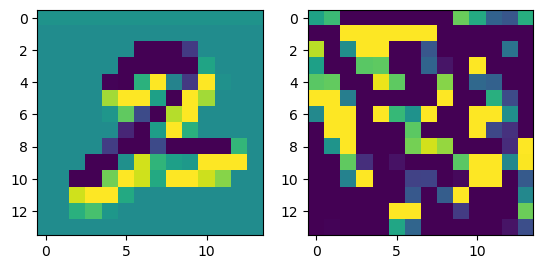

prediction: tensor([4, 7, 3]), tensor([2.6141, 2.1961, 1.4482]) groudtruth: 7
-0.08798671 0.09039111


<Figure size 640x480 with 0 Axes>

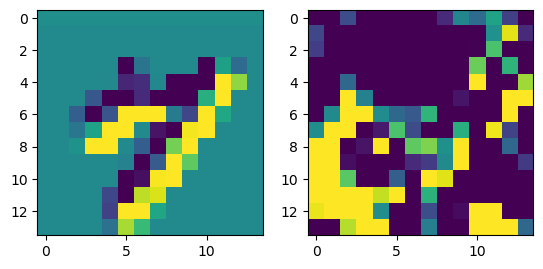

prediction: tensor([0, 7, 3]), tensor([5.2114, 0.9528, 0.0828]) groudtruth: 0
-0.0846113 0.08832954


<Figure size 640x480 with 0 Axes>

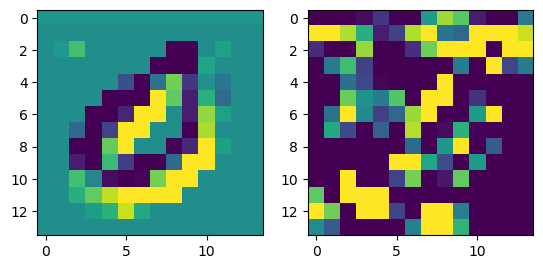

prediction: tensor([1, 7, 9]), tensor([5.0444, 1.8899, 0.2081]) groudtruth: 1
-0.08171028 0.08548337


<Figure size 640x480 with 0 Axes>

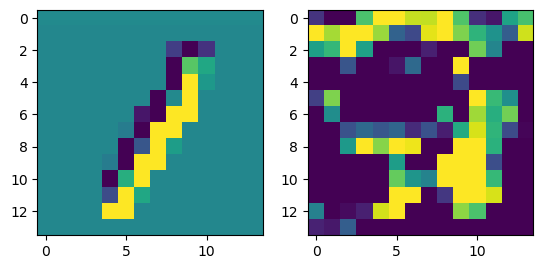

prediction: tensor([9, 3, 4]), tensor([4.0766, 1.2580, 0.2440]) groudtruth: 9
-0.09161383 0.08554126


<Figure size 640x480 with 0 Axes>

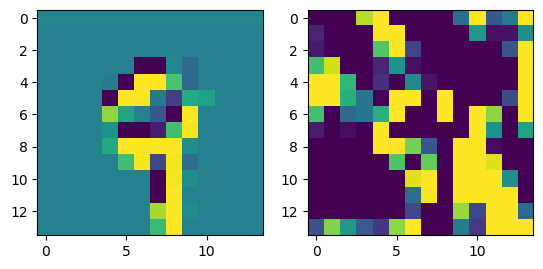

prediction: tensor([0, 9, 6]), tensor([7.2132, 0.8803, 0.3062]) groudtruth: 0
-0.08408928 0.10131106


<Figure size 640x480 with 0 Axes>

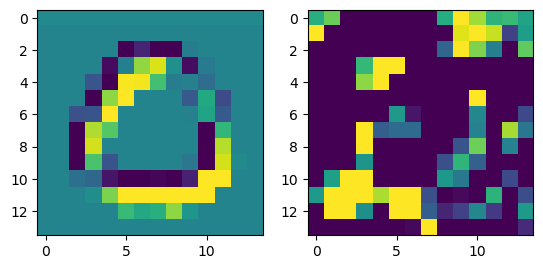

prediction: tensor([1, 9, 3]), tensor([5.3613, 1.7453, 1.5184]) groudtruth: 1
-0.09657639 0.071267724


<Figure size 640x480 with 0 Axes>

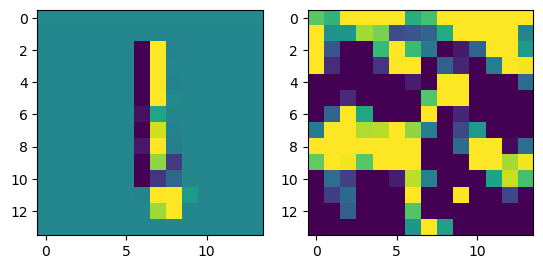

prediction: tensor([3, 9, 2]), tensor([4.3540, 1.7065, 1.3088]) groudtruth: 2
-0.11026955 0.071243085


<Figure size 640x480 with 0 Axes>

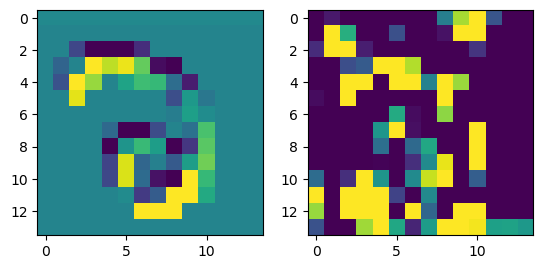

prediction: tensor([3, 4, 5]), tensor([3.9672, 2.7620, 1.9488]) groudtruth: 3
-0.0588367 0.09058041


<Figure size 640x480 with 0 Axes>

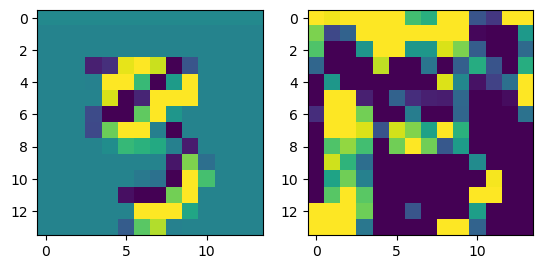

prediction: tensor([4, 1, 2]), tensor([5.3305, 1.1584, 0.9428]) groudtruth: 4
-0.099809885 0.09042502


<Figure size 640x480 with 0 Axes>

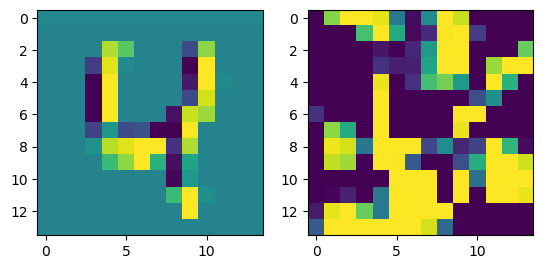

prediction: tensor([9, 5, 4]), tensor([2.9005, 2.7259, 2.0678]) groudtruth: 5
-0.07955092 0.10284069


<Figure size 640x480 with 0 Axes>

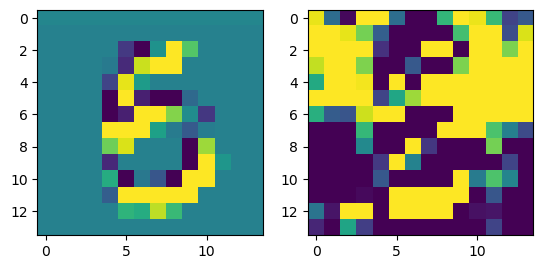

prediction: tensor([8, 2, 4]), tensor([5.2782, 1.4149, 0.5101]) groudtruth: 8
-0.06719035 0.068613425


<Figure size 640x480 with 0 Axes>

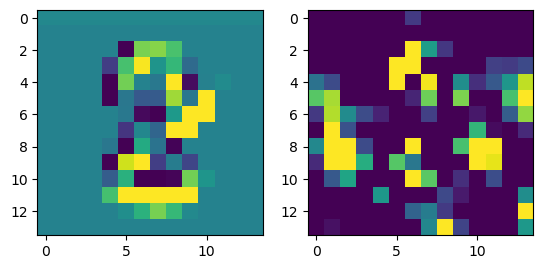

prediction: tensor([9, 7, 4]), tensor([4.4699, 1.3383, 1.1562]) groudtruth: 9
-0.09367293 0.08229447


<Figure size 640x480 with 0 Axes>

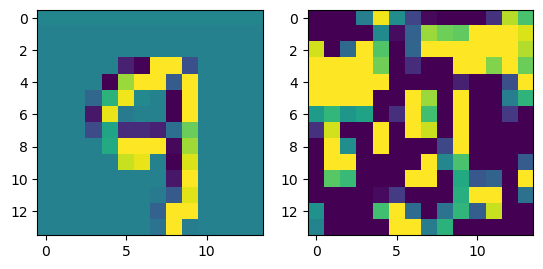

prediction: tensor([0, 5, 6]), tensor([4.8450, 1.9165, 1.1484]) groudtruth: 0
-0.07809734 0.07619628


<Figure size 640x480 with 0 Axes>

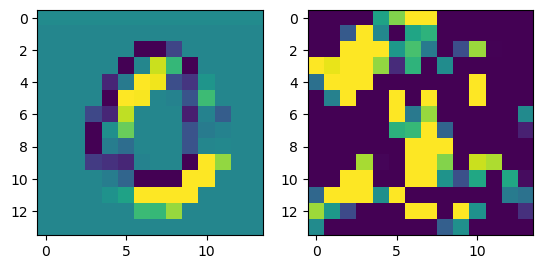

prediction: tensor([1, 7, 9]), tensor([5.3563, 1.7521, 0.7163]) groudtruth: 1
-0.068969846 0.09832913


<Figure size 640x480 with 0 Axes>

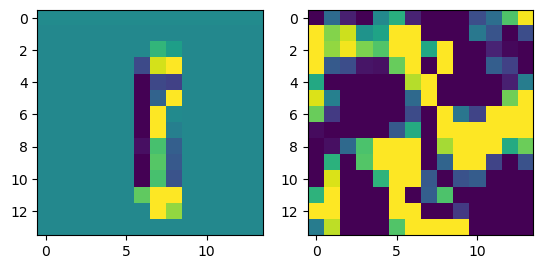

prediction: tensor([2, 3, 5]), tensor([2.9026, 2.1281, 1.9512]) groudtruth: 2
-0.1009385 0.10445717


<Figure size 640x480 with 0 Axes>

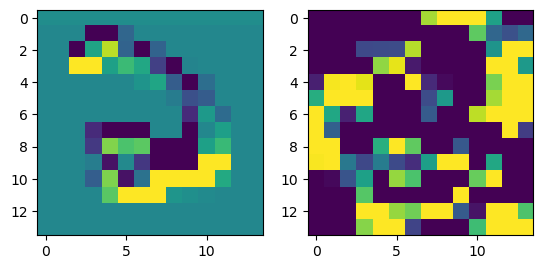

prediction: tensor([3, 5, 9]), tensor([5.3032, 2.9125, 1.8582]) groudtruth: 3
-0.08346605 0.11286527


<Figure size 640x480 with 0 Axes>

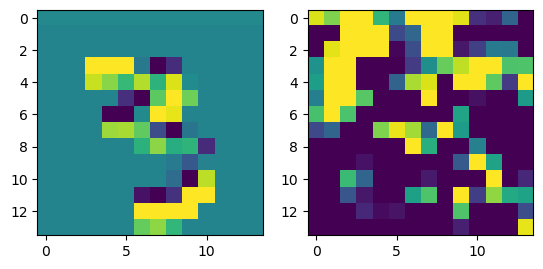

prediction: tensor([4, 7, 1]), tensor([4.8808, 2.1577, 1.2516]) groudtruth: 4
-0.10077977 0.080409914


<Figure size 640x480 with 0 Axes>

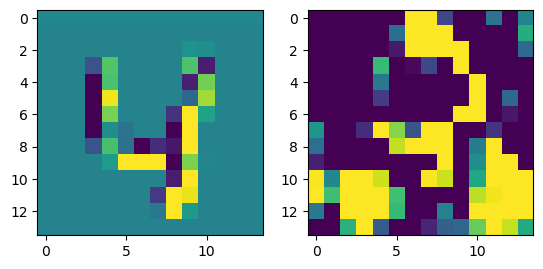

prediction: tensor([5, 9, 6]), tensor([6.4306, 2.0622, 1.1840]) groudtruth: 5
-0.09010202 0.088942125


<Figure size 640x480 with 0 Axes>

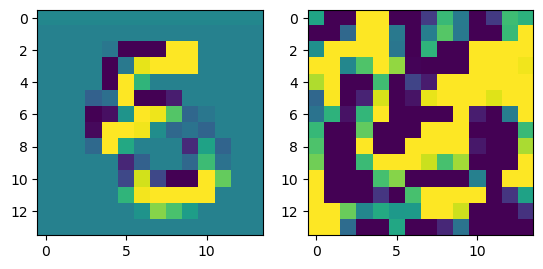

prediction: tensor([6, 7, 0]), tensor([4.0978, 1.6207, 1.5409]) groudtruth: 6
-0.06816858 0.07567527


<Figure size 640x480 with 0 Axes>

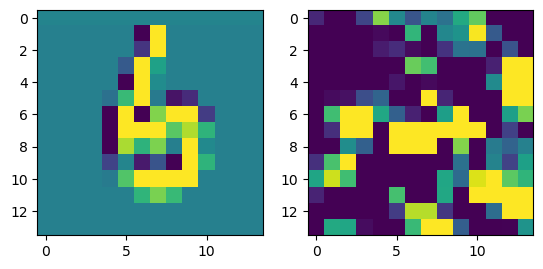

prediction: tensor([7, 9, 2]), tensor([1.8922, 1.6201, 0.9807]) groudtruth: 9
-0.07412064 0.0680787


<Figure size 640x480 with 0 Axes>

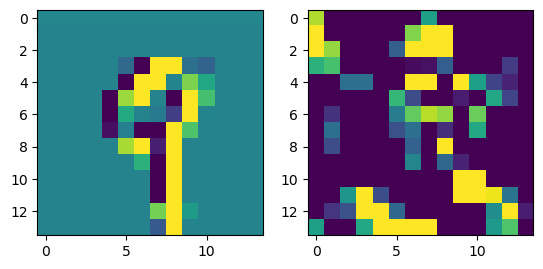

prediction: tensor([6, 9, 4]), tensor([3.9477, 1.3839, 0.3047]) groudtruth: 6
-0.09704095 0.07199441


<Figure size 640x480 with 0 Axes>

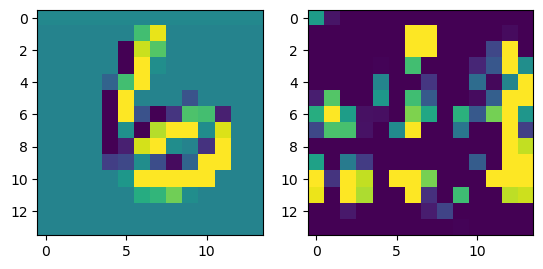

prediction: tensor([9, 8, 7]), tensor([2.7029, 1.1573, 0.7904]) groudtruth: 9
-0.075345576 0.09738289


<Figure size 640x480 with 0 Axes>

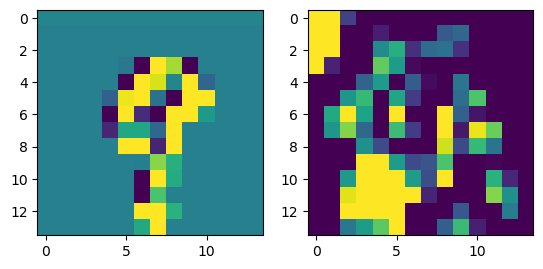

prediction: tensor([3, 0, 7]), tensor([3.3087, 1.4029, 1.1581]) groudtruth: 2
-0.104646266 0.08868701


<Figure size 640x480 with 0 Axes>

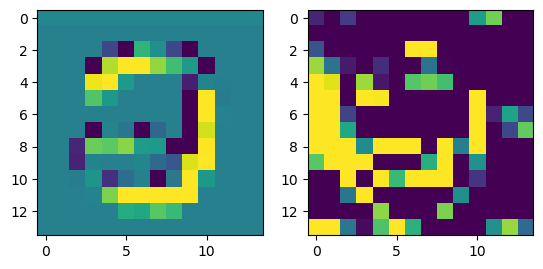

prediction: tensor([6, 5, 2]), tensor([4.4487, 1.2065, 0.8944]) groudtruth: 6
-0.085719824 0.068748385


<Figure size 640x480 with 0 Axes>

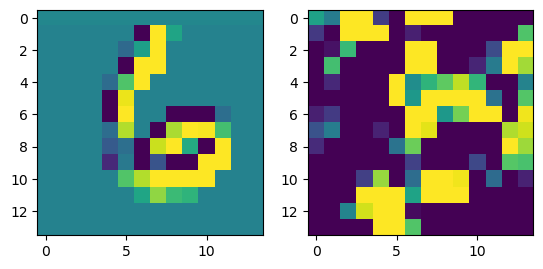

prediction: tensor([2, 7, 0]), tensor([3.6250, 1.7636, 1.5812]) groudtruth: 2
-0.08491087 0.07730837


<Figure size 640x480 with 0 Axes>

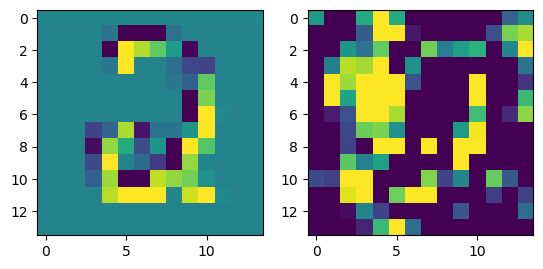

prediction: tensor([1, 7, 9]), tensor([5.2639, 1.5155, 1.0165]) groudtruth: 1
-0.05962062 0.056065757


<Figure size 640x480 with 0 Axes>

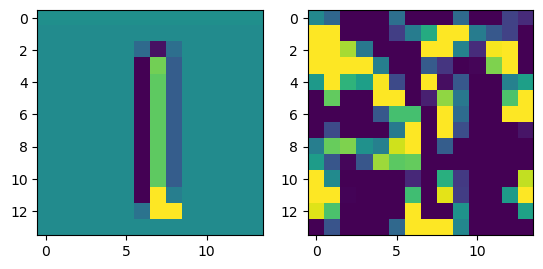

prediction: tensor([2, 0, 3]), tensor([3.0024, 1.3186, 1.1074]) groudtruth: 2
-0.10486555 0.11094134


<Figure size 640x480 with 0 Axes>

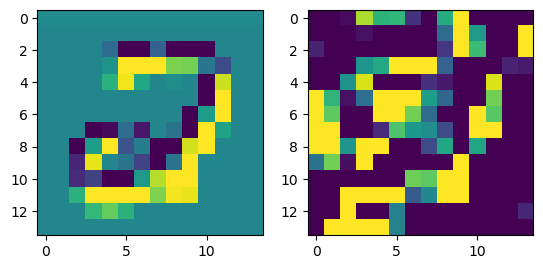

prediction: tensor([0, 9, 5]), tensor([5.1138, 2.4577, 0.8729]) groudtruth: 0
-0.09090865 0.097762845


<Figure size 640x480 with 0 Axes>

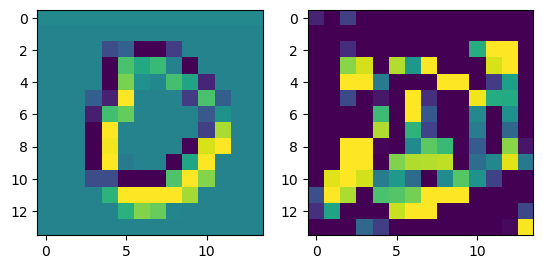

prediction: tensor([8, 1, 2]), tensor([2.0098, 1.9608, 1.8602]) groudtruth: 8
-0.07250953 0.094978936


<Figure size 640x480 with 0 Axes>

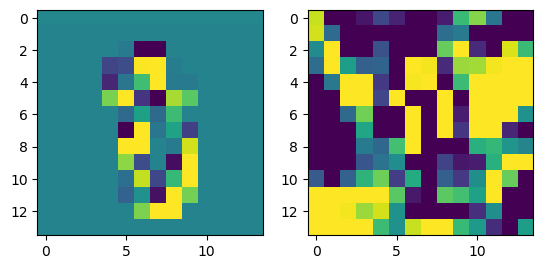

prediction: tensor([3, 8, 2]), tensor([3.7915, 1.7844, 1.3484]) groudtruth: 3
-0.07266122 0.09571707


<Figure size 640x480 with 0 Axes>

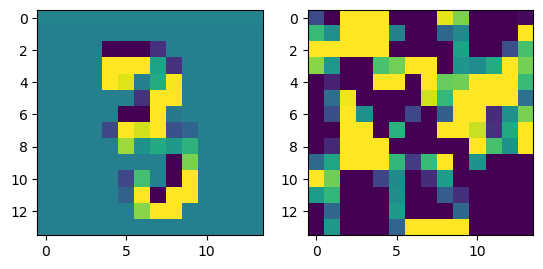

prediction: tensor([8, 3, 4]), tensor([2.2325, 1.2334, 1.0933]) groudtruth: 8
-0.09484583 0.092191696


<Figure size 640x480 with 0 Axes>

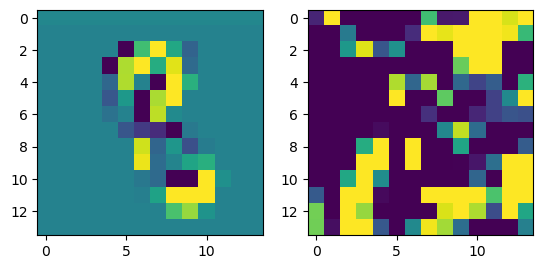

prediction: tensor([3, 8, 2]), tensor([5.4801, 2.5580, 1.5982]) groudtruth: 3
-0.09531963 0.071433514


<Figure size 640x480 with 0 Axes>

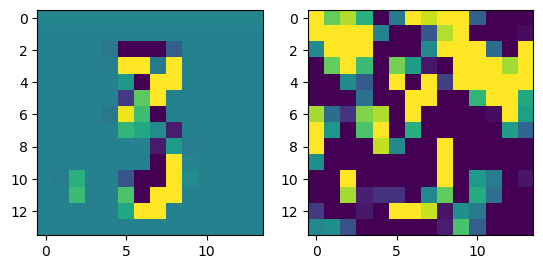

prediction: tensor([0, 6, 9]), tensor([4.8721, 2.4033, 2.0350]) groudtruth: 0
-0.10145813 0.08647828


<Figure size 640x480 with 0 Axes>

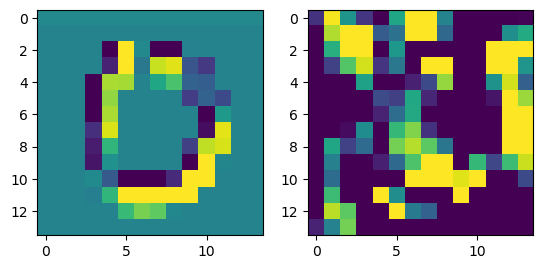

prediction: tensor([8, 1, 2]), tensor([4.6037, 4.1265, 0.3335]) groudtruth: 8
-0.07761693 0.056570508


<Figure size 640x480 with 0 Axes>

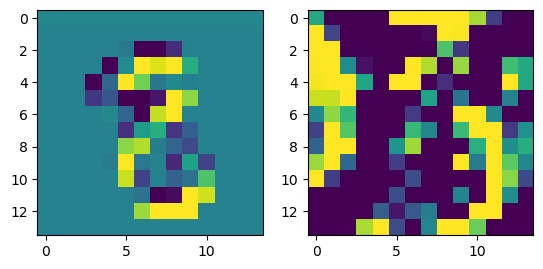

prediction: tensor([7, 1, 9]), tensor([4.3029, 1.6814, 1.5846]) groudtruth: 7
-0.09589708 0.09098904


<Figure size 640x480 with 0 Axes>

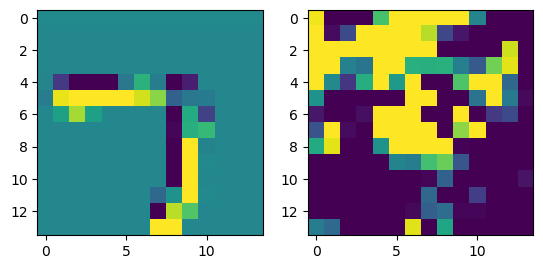

prediction: tensor([3, 5, 6]), tensor([1.3845, 0.9280, 0.8709]) groudtruth: 7
-0.09942311 0.072346576


<Figure size 640x480 with 0 Axes>

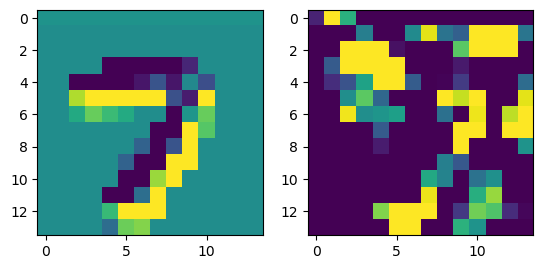

prediction: tensor([8, 2, 3]), tensor([5.5755, 1.4243, 0.7245]) groudtruth: 8
-0.06876391 0.068967864


<Figure size 640x480 with 0 Axes>

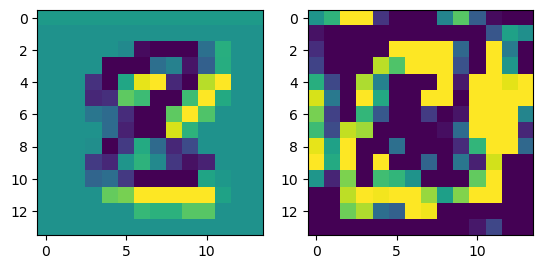

prediction: tensor([9, 3, 6]), tensor([5.5579, 2.6813, 0.8370]) groudtruth: 9
-0.08477092 0.07611704


<Figure size 640x480 with 0 Axes>

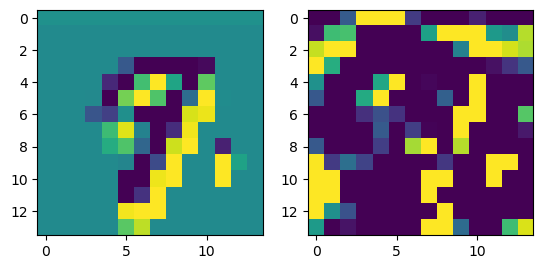

prediction: tensor([0, 6, 9]), tensor([4.4159, 1.8624, 0.9048]) groudtruth: 0
-0.08279163 0.07764436


<Figure size 640x480 with 0 Axes>

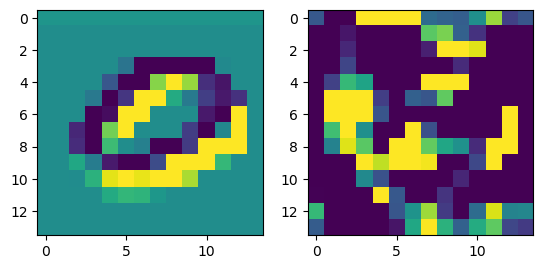

prediction: tensor([1, 8, 2]), tensor([1.8031, 1.2885, 0.7798]) groudtruth: 1
-0.098110735 0.1006282


<Figure size 640x480 with 0 Axes>

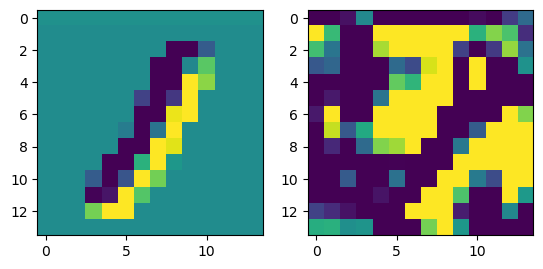

prediction: tensor([2, 4, 8]), tensor([4.0027, 0.8116, 0.5864]) groudtruth: 2
-0.09464449 0.11030297


<Figure size 640x480 with 0 Axes>

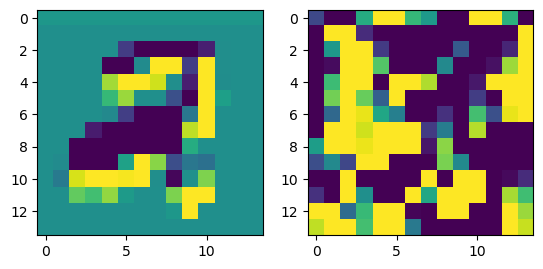

prediction: tensor([3, 2, 9]), tensor([4.3588, 2.0914, 1.9201]) groudtruth: 3
-0.099009216 0.07985722


<Figure size 640x480 with 0 Axes>

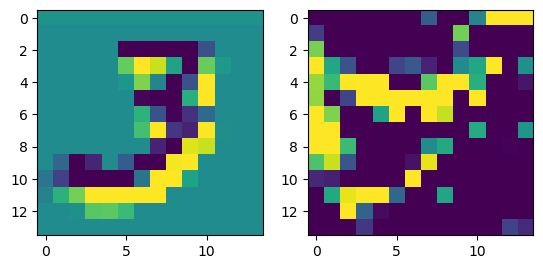

prediction: tensor([4, 9, 8]), tensor([5.7299, 2.3527, 0.1145]) groudtruth: 4
-0.09048718 0.08265022


<Figure size 640x480 with 0 Axes>

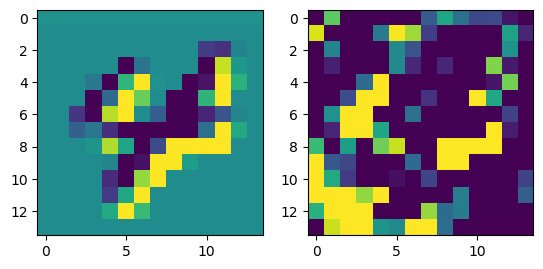

prediction: tensor([5, 0, 3]), tensor([5.0298, 1.8590, 1.5799]) groudtruth: 5
-0.11114907 0.06263974


<Figure size 640x480 with 0 Axes>

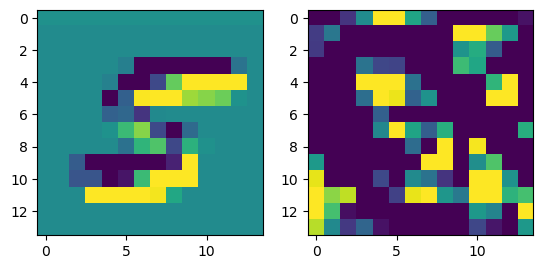

prediction: tensor([6, 7, 2]), tensor([7.4310, 1.2943, 0.7409]) groudtruth: 6
-0.06919396 0.07037522


<Figure size 640x480 with 0 Axes>

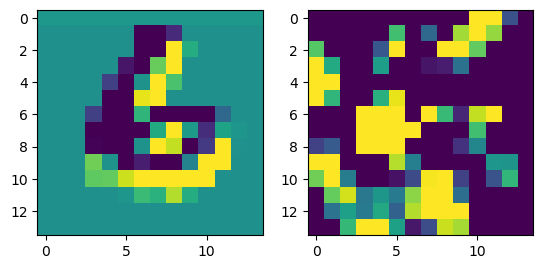

prediction: tensor([7, 6, 9]), tensor([2.7341, 1.4982, 1.4248]) groudtruth: 7
-0.060522914 0.07013697


<Figure size 640x480 with 0 Axes>

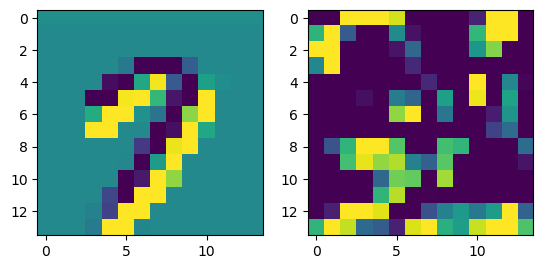

prediction: tensor([8, 2, 0]), tensor([3.7256, 0.9945, 0.8413]) groudtruth: 8
-0.08278203 0.066275455


<Figure size 640x480 with 0 Axes>

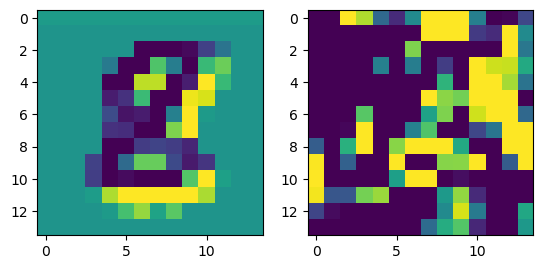

prediction: tensor([9, 8, 7]), tensor([3.8608, 2.5092, 0.5132]) groudtruth: 9
-0.11627054 0.12624384


<Figure size 640x480 with 0 Axes>

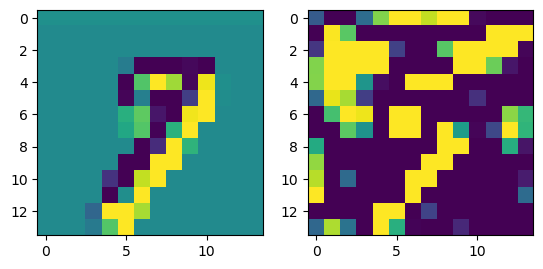

prediction: tensor([7, 9, 3]), tensor([4.2080, 2.9428, 0.5976]) groudtruth: 7
-0.08395815 0.09872705


<Figure size 640x480 with 0 Axes>

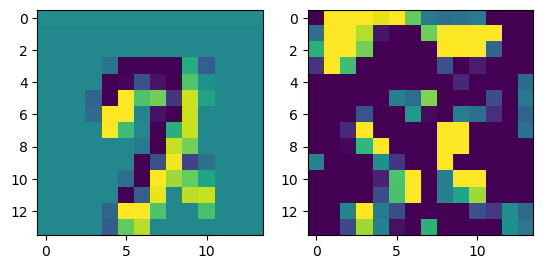

prediction: tensor([6, 9, 2]), tensor([5.0442, 1.8327, 1.7493]) groudtruth: 6
-0.08801687 0.07555054


<Figure size 640x480 with 0 Axes>

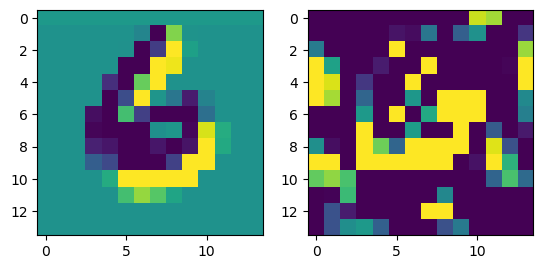

prediction: tensor([4, 6, 9]), tensor([4.4420, 2.0314, 1.8773]) groudtruth: 4
-0.07642102 0.10678069


<Figure size 640x480 with 0 Axes>

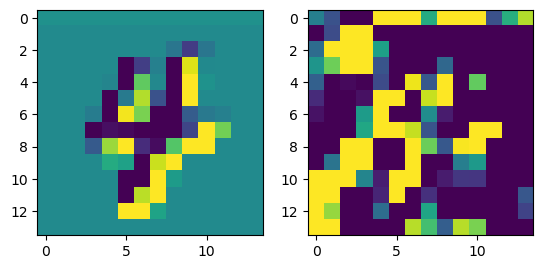

prediction: tensor([5, 2, 8]), tensor([3.7323, 3.1581, 1.3395]) groudtruth: 5
-0.06208682 0.06882431


<Figure size 640x480 with 0 Axes>

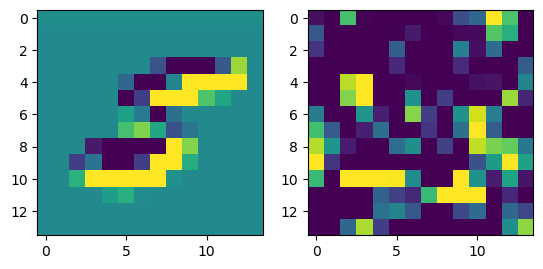

prediction: tensor([5, 2, 7]), tensor([3.8641, 1.7594, 1.4558]) groudtruth: 5
-0.08671796 0.079859555


<Figure size 640x480 with 0 Axes>

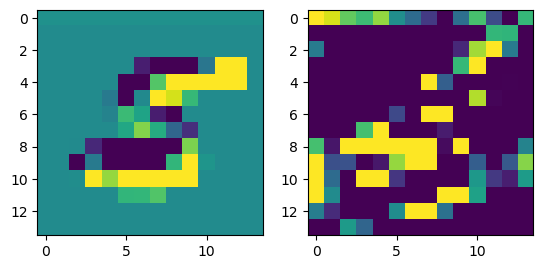

prediction: tensor([0, 2, 6]), tensor([4.4300, 1.6280, 1.3261]) groudtruth: 0
-0.08604157 0.09347066


<Figure size 640x480 with 0 Axes>

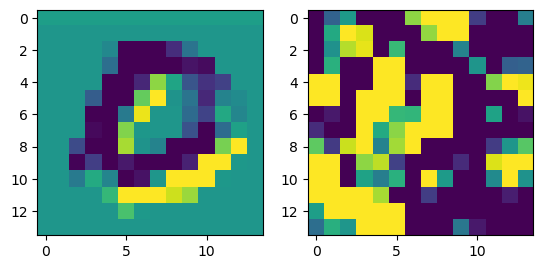

prediction: tensor([1, 4, 8]), tensor([2.6053, 2.2549, 1.3175]) groudtruth: 1
-0.069399476 0.08144347


<Figure size 640x480 with 0 Axes>

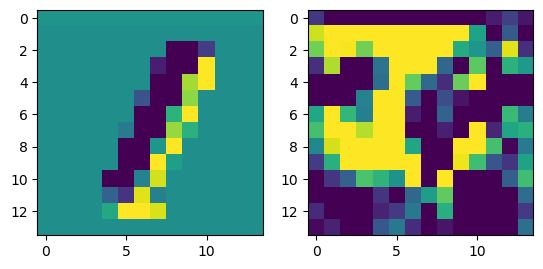

prediction: tensor([9, 4, 8]), tensor([2.5575, 2.4816, 1.2236]) groudtruth: 1
-0.06455749 0.09372917


<Figure size 640x480 with 0 Axes>

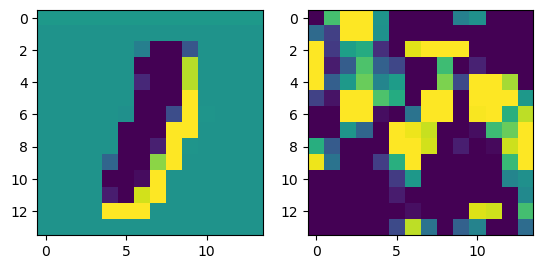

prediction: tensor([9, 3, 1]), tensor([4.0973, 1.1235, 0.7916]) groudtruth: 9
-0.10205585 0.07699554


<Figure size 640x480 with 0 Axes>

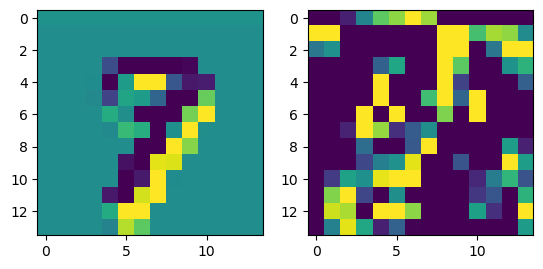

prediction: tensor([8, 2, 5]), tensor([5.5831, 1.5445, 1.0411]) groudtruth: 8
-0.060610056 0.09057103


<Figure size 640x480 with 0 Axes>

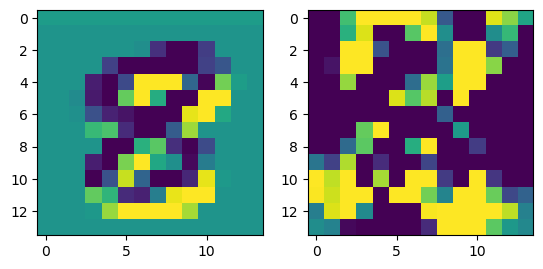

prediction: tensor([2, 0, 5]), tensor([5.7272, 0.8022, 0.5990]) groudtruth: 2
-0.10405439 0.07506895


<Figure size 640x480 with 0 Axes>

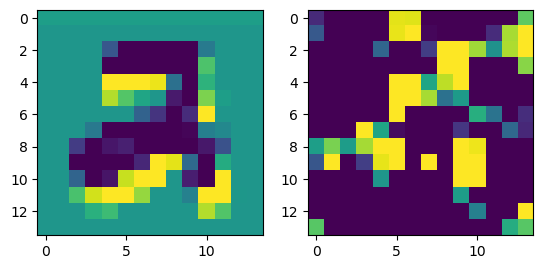

prediction: tensor([6, 5, 8]), tensor([6.0216, 0.6232, 0.4063]) groudtruth: 6
-0.09745979 0.08205965


<Figure size 640x480 with 0 Axes>

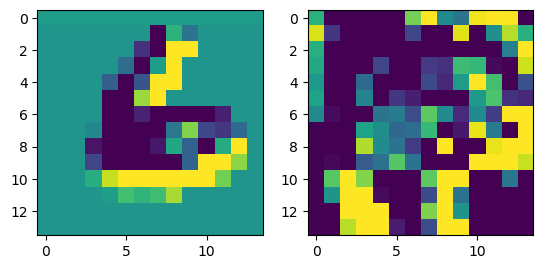

prediction: tensor([0, 9, 5]), tensor([5.7936, 0.9344, 0.7190]) groudtruth: 0
-0.06442934 0.093003


<Figure size 640x480 with 0 Axes>

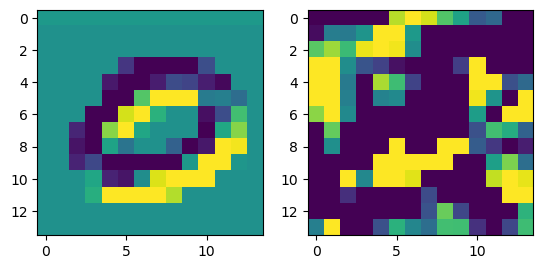

prediction: tensor([4, 1, 6]), tensor([6.2843, 4.1189, 1.5472]) groudtruth: 4
-0.10508138 0.08173631


<Figure size 640x480 with 0 Axes>

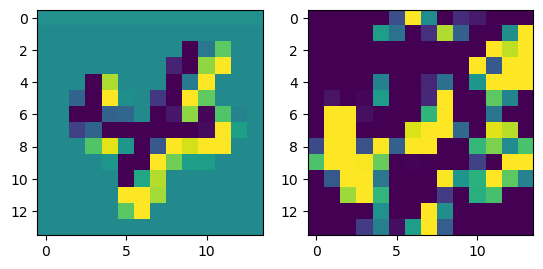

prediction: tensor([5, 3, 8]), tensor([5.8154, 3.5639, 2.0642]) groudtruth: 5
-0.08450782 0.07033733


<Figure size 640x480 with 0 Axes>

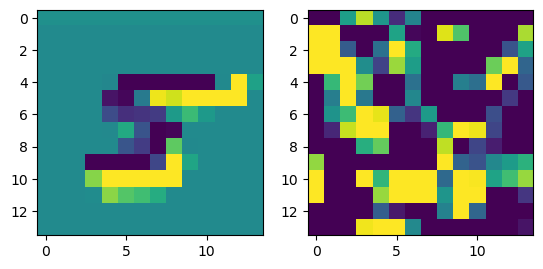

prediction: tensor([0, 5, 9]), tensor([3.9853, 1.7645, 0.6844]) groudtruth: 0
-0.10133493 0.093035564


<Figure size 640x480 with 0 Axes>

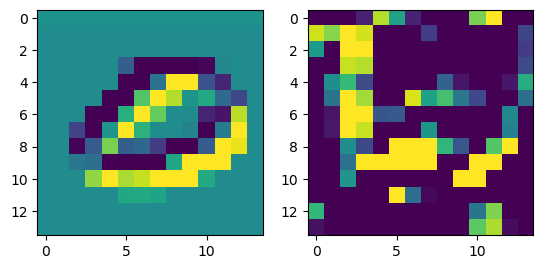

prediction: tensor([2, 7, 0]), tensor([3.7976, 3.1688, 2.5889]) groudtruth: 3
-0.0841828 0.074089


<Figure size 640x480 with 0 Axes>

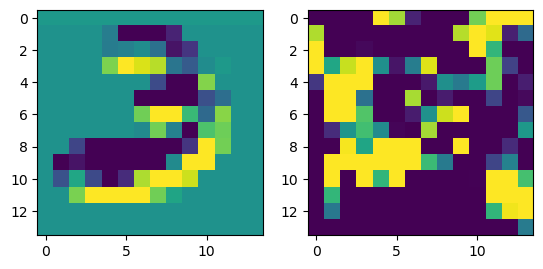

prediction: tensor([2, 4, 1]), tensor([2.4295, 1.8421, 1.5103]) groudtruth: 1
-0.106646895 0.089210354


<Figure size 640x480 with 0 Axes>

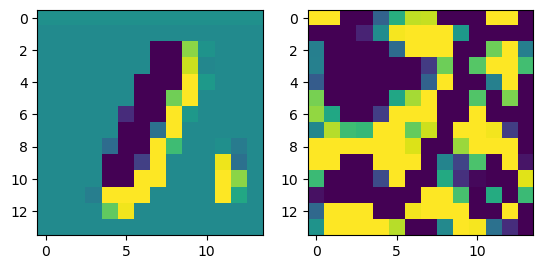

prediction: tensor([8, 0, 3]), tensor([3.9088, 2.0796, 1.8539]) groudtruth: 8
-0.09445977 0.09777224


<Figure size 640x480 with 0 Axes>

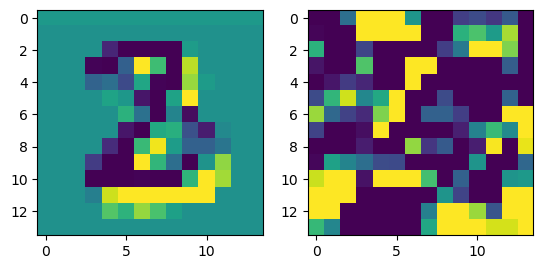

prediction: tensor([8, 0, 6]), tensor([3.2117, 3.0520, 0.7605]) groudtruth: 8
-0.06978917 0.06808676


<Figure size 640x480 with 0 Axes>

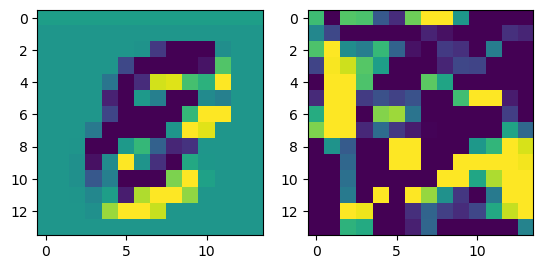

prediction: tensor([0, 1, 4]), tensor([5.0529, 1.0756, 1.0013]) groudtruth: 0
-0.07565093 0.09073669


<Figure size 640x480 with 0 Axes>

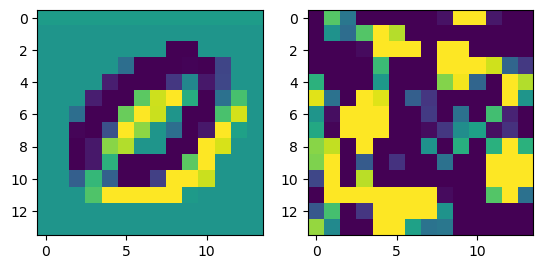

prediction: tensor([9, 3, 7]), tensor([3.6558, 2.6260, 1.8323]) groudtruth: 9
-0.07821828 0.10379558


<Figure size 640x480 with 0 Axes>

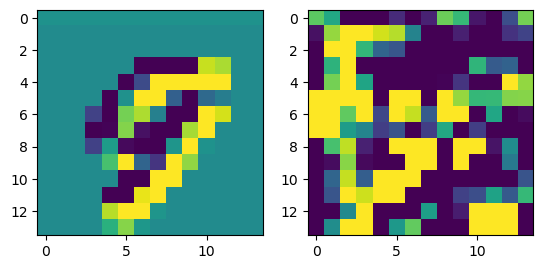

prediction: tensor([3, 9, 2]), tensor([4.9927, 4.0137, 0.6304]) groudtruth: 3
-0.06935495 0.10653979


<Figure size 640x480 with 0 Axes>

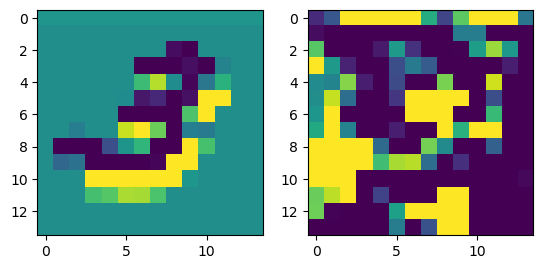

prediction: tensor([2, 4, 9]), tensor([5.7032, 3.5958, 0.3741]) groudtruth: 2
-0.087269366 0.080304265


<Figure size 640x480 with 0 Axes>

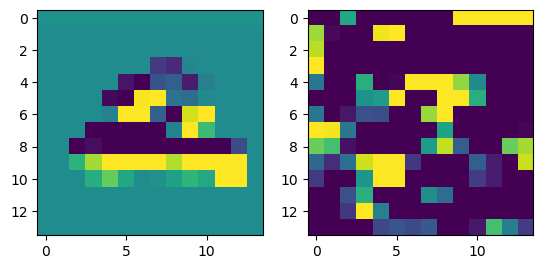

prediction: tensor([6, 7, 8]), tensor([1.9013, 1.8894, 1.5278]) groudtruth: 7
-0.09380752 0.079551786


<Figure size 640x480 with 0 Axes>

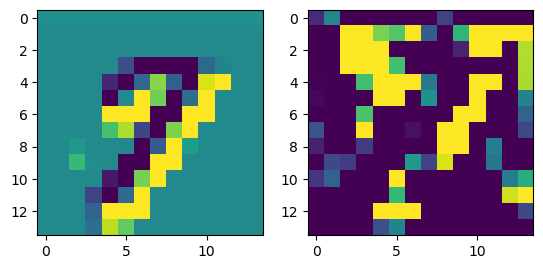

prediction: tensor([8, 2, 0]), tensor([3.9873, 1.8803, 1.2509]) groudtruth: 8
-0.07978213 0.09608908


<Figure size 640x480 with 0 Axes>

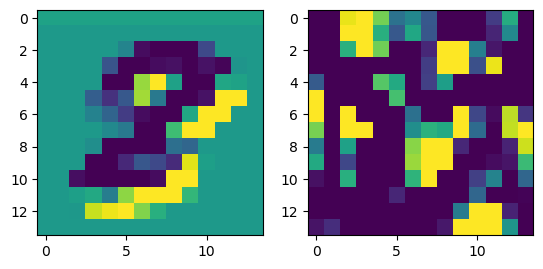

prediction: tensor([4, 1, 2]), tensor([4.3271, 2.6297, 0.6686]) groudtruth: 4
-0.08558977 0.058300056


<Figure size 640x480 with 0 Axes>

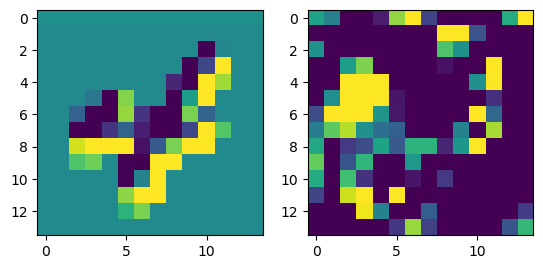

prediction: tensor([6, 7, 2]), tensor([3.2557, 1.4220, 0.6779]) groudtruth: 6
-0.09297353 0.06733854


<Figure size 640x480 with 0 Axes>

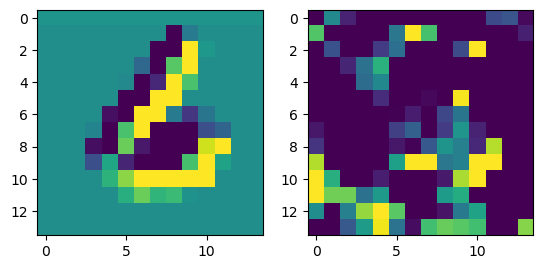

prediction: tensor([1, 7, 8]), tensor([3.3497, 1.5063, 0.5512]) groudtruth: 1
-0.085715294 0.09814281


<Figure size 640x480 with 0 Axes>

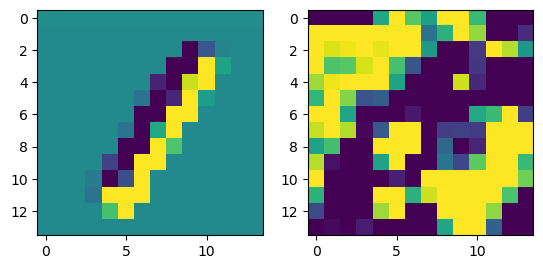

prediction: tensor([0, 7, 2]), tensor([6.0689, 1.6827, 0.4186]) groudtruth: 0
-0.08838534 0.08018108


<Figure size 640x480 with 0 Axes>

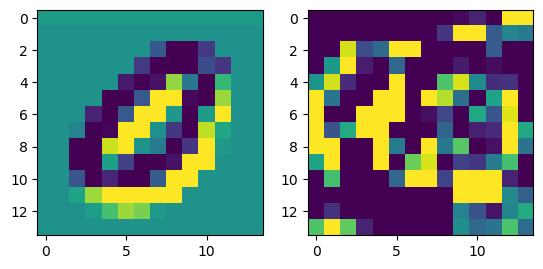

prediction: tensor([4, 6, 1]), tensor([4.9175, 1.0359, 0.2871]) groudtruth: 4
-0.09514278 0.075410336


<Figure size 640x480 with 0 Axes>

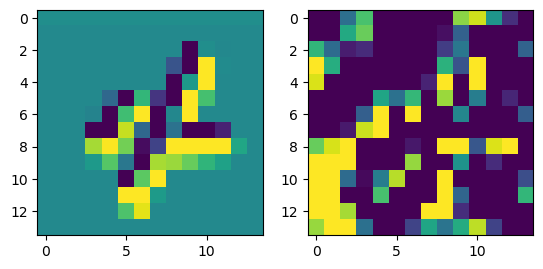

prediction: tensor([9, 8, 3]), tensor([5.3096, 1.4857, 1.4135]) groudtruth: 9
-0.087791026 0.09053056


<Figure size 640x480 with 0 Axes>

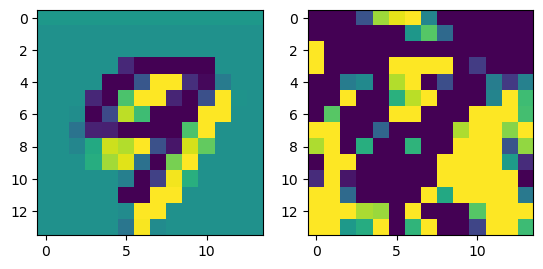

prediction: tensor([4, 7, 2]), tensor([5.0250, 2.0936, 1.9621]) groudtruth: 4
-0.07221317 0.08993895


<Figure size 640x480 with 0 Axes>

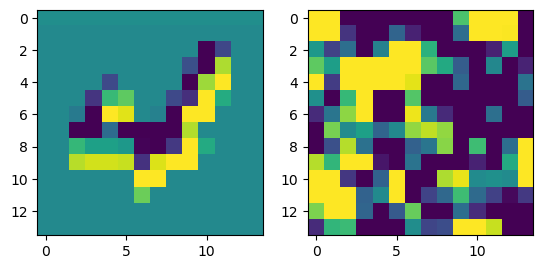

prediction: tensor([4, 2, 9]), tensor([2.8286, 1.8634, 1.6269]) groudtruth: 2
-0.09090227 0.07947926


<Figure size 640x480 with 0 Axes>

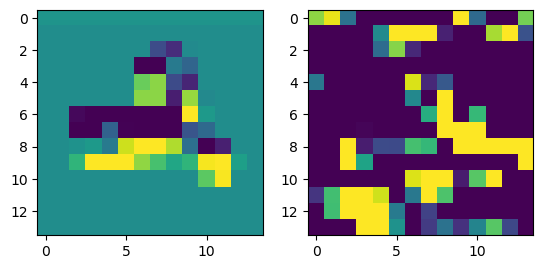

prediction: tensor([0, 6, 8]), tensor([5.0671, 1.4058, 0.7678]) groudtruth: 0
-0.10066813 0.09130673


<Figure size 640x480 with 0 Axes>

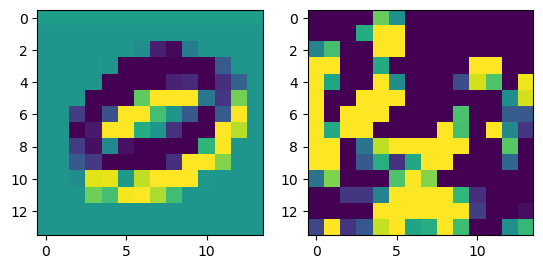

prediction: tensor([3, 2, 1]), tensor([3.2328, 1.7886, 1.5260]) groudtruth: 3
-0.09548122 0.123690225


<Figure size 640x480 with 0 Axes>

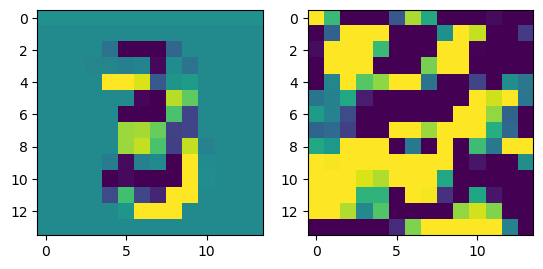

prediction: tensor([4, 1, 9]), tensor([5.4147, 1.8566, 1.4051]) groudtruth: 4
-0.079644084 0.08698848


<Figure size 640x480 with 0 Axes>

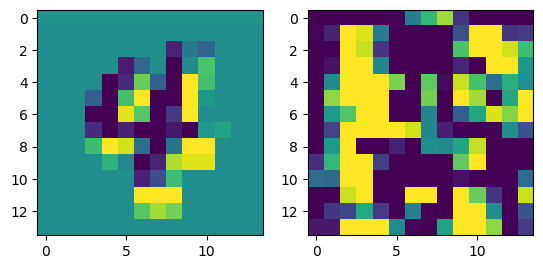

prediction: tensor([5, 3, 8]), tensor([5.1777, 1.4505, 0.8649]) groudtruth: 5
-0.06319827 0.050166838


<Figure size 640x480 with 0 Axes>

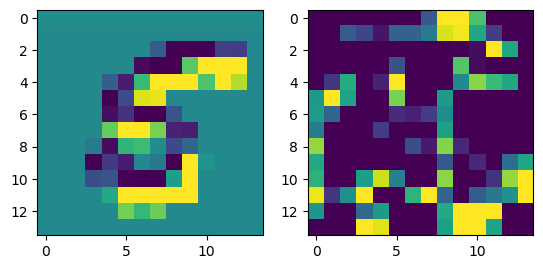

prediction: tensor([6, 2, 4]), tensor([4.0402, 1.4675, 1.1160]) groudtruth: 6
-0.06259048 0.08185709


<Figure size 640x480 with 0 Axes>

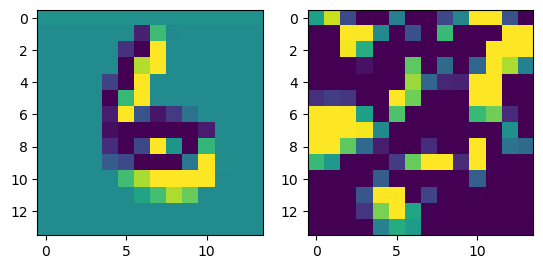

prediction: tensor([7, 6, 0]), tensor([4.2723, 2.5833, 2.0818]) groudtruth: 7
-0.06723559 0.096043736


<Figure size 640x480 with 0 Axes>

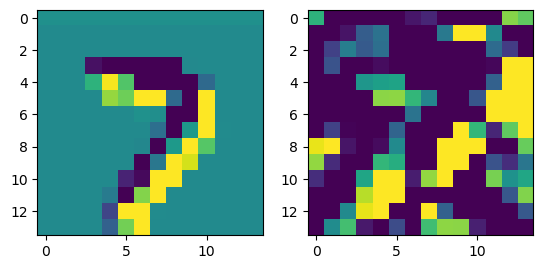

prediction: tensor([8, 6, 7]), tensor([2.5597, 2.3025, 0.7850]) groudtruth: 8
-0.075327754 0.06607451


<Figure size 640x480 with 0 Axes>

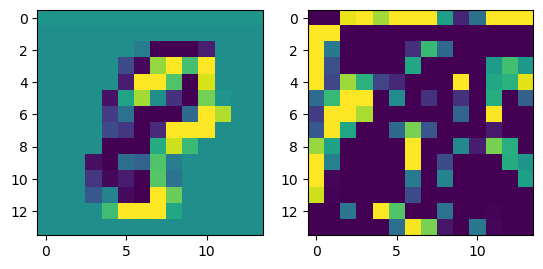

prediction: tensor([9, 7, 3]), tensor([4.7598, 3.1809, 0.4981]) groudtruth: 9
-0.08449739 0.08863303


<Figure size 640x480 with 0 Axes>

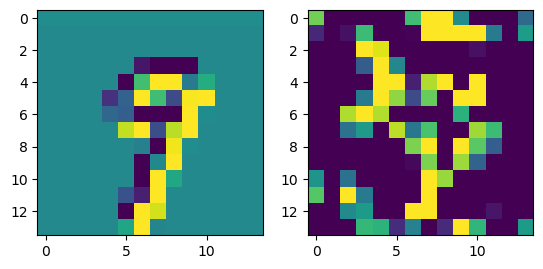

prediction: tensor([9, 0, 3]), tensor([3.6981, 2.0036, 1.0055]) groudtruth: 0
-0.061754584 0.08966278


<Figure size 640x480 with 0 Axes>

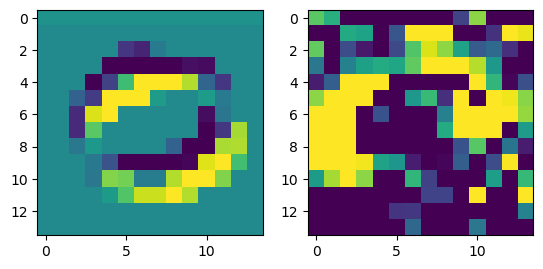

prediction: tensor([1, 8, 7]), tensor([3.4142, 1.0808, 0.6894]) groudtruth: 1
-0.06579745 0.1219531


<Figure size 640x480 with 0 Axes>

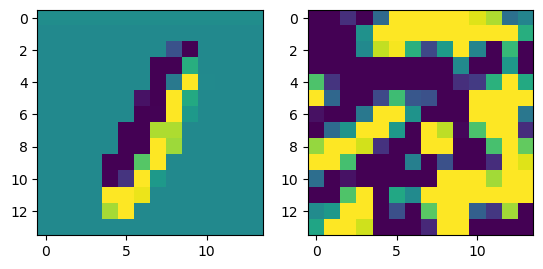

prediction: tensor([9, 2, 4]), tensor([4.2393, 2.9269, 1.6097]) groudtruth: 2
-0.107637465 0.09635919


<Figure size 640x480 with 0 Axes>

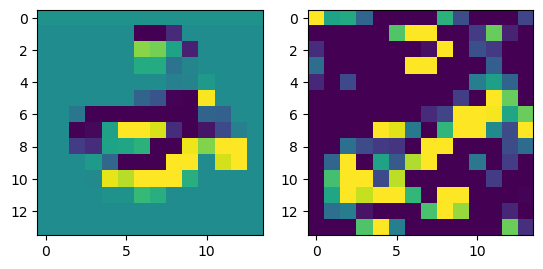

prediction: tensor([3, 9, 8]), tensor([2.3736, 2.2104, 1.6475]) groudtruth: 3
-0.09108776 0.09723684


<Figure size 640x480 with 0 Axes>

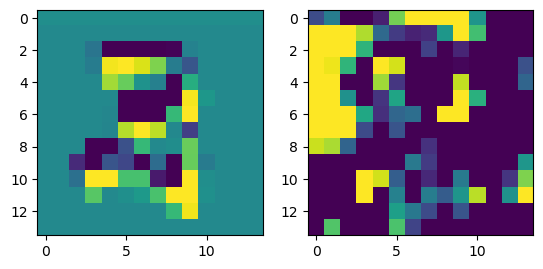

prediction: tensor([4, 6, 1]), tensor([3.5062, 2.7661, 1.5261]) groudtruth: 4
-0.0785774 0.077923305


<Figure size 640x480 with 0 Axes>

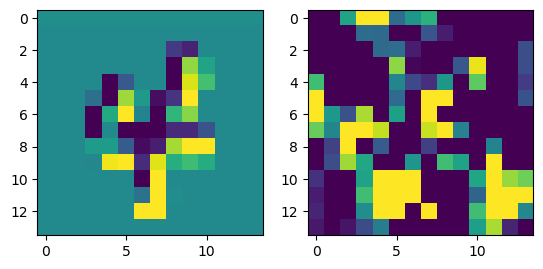

prediction: tensor([5, 3, 8]), tensor([2.1348, 1.5274, 1.3043]) groudtruth: 5
-0.07161641 0.10376276


<Figure size 640x480 with 0 Axes>

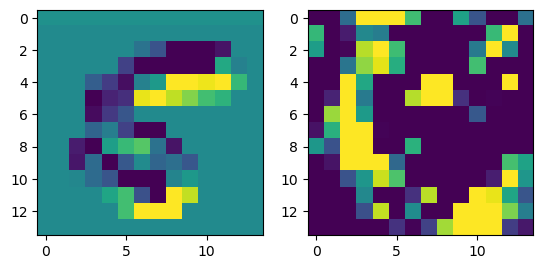

prediction: tensor([6, 4, 2]), tensor([6.0123, 0.6083, 0.3903]) groudtruth: 6
-0.09505707 0.060262322


<Figure size 640x480 with 0 Axes>

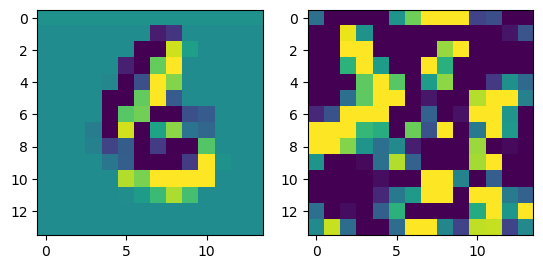

prediction: tensor([7, 9, 6]), tensor([3.8192, 2.6685, 1.6344]) groudtruth: 7
-0.1188519 0.10981603


<Figure size 640x480 with 0 Axes>

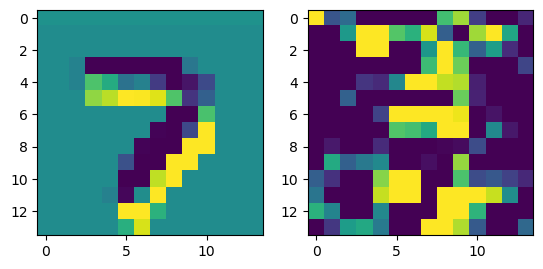

prediction: tensor([9, 6, 8]), tensor([2.3258, 2.1741, 1.7923]) groudtruth: 8
-0.12709504 0.108312905


<Figure size 640x480 with 0 Axes>

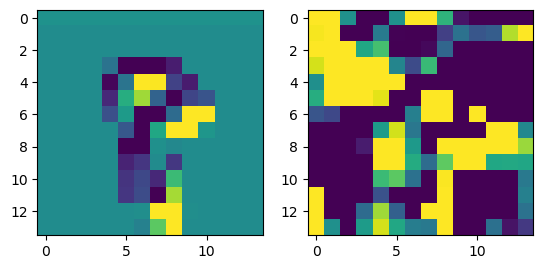

prediction: tensor([4, 2, 5]), tensor([1.7248, 1.2810, 1.1150]) groudtruth: 4
-0.09868544 0.09050879


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 1, 3]), tensor([3.7345, 1.7171, 0.7064]) groudtruth: 9
-0.09049517 0.078702


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 7, 4]), tensor([3.6510, 1.8086, 0.9845]) groudtruth: 9
-0.0874207 0.083223745


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 9, 2]), tensor([3.8824, 1.5777, 1.3856]) groudtruth: 7
-0.08863151 0.102430135


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 9, 7]), tensor([3.1417, 1.4827, 1.3032]) groudtruth: 1
-0.08297753 0.103926994


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 4, 6]), tensor([5.6948, 2.0353, 0.9531]) groudtruth: 1
-0.058377504 0.07808515


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 6, 7]), tensor([2.8008, 0.7272, 0.6997]) groudtruth: 9
-0.094696105 0.09489332


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 1, 8]), tensor([6.0417, 0.9672, 0.3824]) groudtruth: 0
-0.07693797 0.08142997


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 0, 8]), tensor([4.0844, 1.1564, 0.9329]) groudtruth: 7
-0.06957209 0.10790144


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 2, 1]), tensor([4.5066, 2.9656, 1.0401]) groudtruth: 8
-0.08242518 0.097844824


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 9, 0]), tensor([5.8449, 2.2738, 2.1062]) groudtruth: 3
-0.077267766 0.06905061


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 8, 6]), tensor([3.8957, 2.0461, 1.4433]) groudtruth: 4
-0.089001834 0.0811482


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 0, 1]), tensor([3.5065, 0.9653, 0.6553]) groudtruth: 8
-0.10725433 0.084384


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 1, 6]), tensor([3.2855, 2.8626, 2.6213]) groudtruth: 6
-0.0823012 0.08278529


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 2, 5]), tensor([4.5878, 1.2238, 1.0772]) groudtruth: 3
-0.069153845 0.0743873


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 6, 9]), tensor([2.6300, 1.3635, 1.2730]) groudtruth: 8
-0.0731948 0.06986754


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 3, 7]), tensor([1.7989, 1.3389, 0.8522]) groudtruth: 7
-0.08745772 0.100855894


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 4, 6]), tensor([1.2789, 1.2410, 0.5305]) groudtruth: 8
-0.06872666 0.086874396


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 7, 4]), tensor([5.6897, 2.6725, 1.6845]) groudtruth: 9
-0.104887724 0.09305334


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 1, 7]), tensor([8.1778, 1.7791, 0.5946]) groudtruth: 0
-0.10337645 0.114442214


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 7, 8]), tensor([1.7944, 1.0942, 0.8618]) groudtruth: 1
-0.066407084 0.058478616


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 1, 7]), tensor([3.8462, 1.0425, 1.0117]) groudtruth: 2
-0.087171376 0.0777457


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 4, 2]), tensor([3.8126, 1.2470, 1.0860]) groudtruth: 3
-0.10656285 0.06646644


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 2, 3]), tensor([2.0821, 2.0485, 1.2155]) groudtruth: 4
-0.087484 0.09186514


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 8, 0]), tensor([3.8631, 3.6680, 1.7194]) groudtruth: 5
-0.07773548 0.075671434


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 2, 8]), tensor([3.6807, 1.7695, 1.4748]) groudtruth: 6
-0.07463205 0.09037821


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 9, 3]), tensor([4.4055, 1.0093, 0.7716]) groudtruth: 7
-0.1241889 0.108458385


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 7, 2]), tensor([4.1951, 1.2897, 0.2302]) groudtruth: 8
-0.082993984 0.072458185


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 7, 2]), tensor([4.4460, 1.3835, 0.4926]) groudtruth: 9
-0.07810801 0.07448002


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 8, 9]), tensor([5.1292, 1.1731, 0.8457]) groudtruth: 0
-0.08158827 0.11774625


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 7, 9]), tensor([2.8820, 1.5753, 1.5411]) groudtruth: 1
-0.083835006 0.07959474


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 9, 6]), tensor([3.5747, 2.6797, 0.8814]) groudtruth: 2
-0.09444976 0.07276189


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 6, 8]), tensor([3.5452, 3.0012, 1.0357]) groudtruth: 1
-0.08901602 0.13485278


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 3, 7]), tensor([5.6861, 3.4809, 1.5080]) groudtruth: 2
-0.07361311 0.11826787


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 9, 7]), tensor([6.4768, 2.4118, 1.6330]) groudtruth: 3
-0.07933211 0.09005687


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 9, 3]), tensor([4.2348, 2.2582, 1.0220]) groudtruth: 4
-0.09171301 0.07352768


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 8]), tensor([7.4454, 2.5333, 1.5317]) groudtruth: 5
-0.08307046 0.07114958


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 9, 2]), tensor([3.7103, 1.8320, 0.9552]) groudtruth: 6
-0.081881166 0.07030949


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 6, 0]), tensor([4.6197, 0.9230, 0.3286]) groudtruth: 7
-0.066672206 0.08111106


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 2, 4]), tensor([4.5099, 1.5780, 1.2726]) groudtruth: 8
-0.056582153 0.075126134


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 6, 7]), tensor([4.2331, 2.0956, 1.4026]) groudtruth: 9
-0.06962228 0.08661208


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 7, 6]), tensor([7.1539, 1.4645, 0.9599]) groudtruth: 0
-0.093734145 0.109603375


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 4, 8]), tensor([3.7662, 1.2433, 1.0355]) groudtruth: 1
-0.09042698 0.08483514


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 7, 5]), tensor([7.5850, 2.7209, 0.3848]) groudtruth: 2
-0.10517985 0.09023676


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 9, 5]), tensor([5.0005, 2.5345, 1.3496]) groudtruth: 3
-0.07791966 0.060878847


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 1, 2]), tensor([3.3073, 1.0409, 0.8182]) groudtruth: 4
-0.077248394 0.0814901


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 6, 3]), tensor([6.1518, 2.7792, 0.4857]) groudtruth: 5
-0.06397623 0.059059978


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 9, 2]), tensor([1.6425, 1.4997, 1.4781]) groudtruth: 6
-0.085006356 0.07623562


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 6]), tensor([6.2555, 3.0847, 3.0185]) groudtruth: 5
-0.115798116 0.08284763


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 0, 8]), tensor([2.8392, 1.1075, 1.0703]) groudtruth: 4
-0.08090955 0.065629765


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 5, 2]), tensor([6.2852, 2.2662, 1.0474]) groudtruth: 0
-0.08048892 0.08823663


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 3, 7]), tensor([4.2659, 1.6306, 1.3664]) groudtruth: 0
-0.09179348 0.10579071


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 5, 8]), tensor([3.3599, 3.1811, 2.2903]) groudtruth: 6
-0.072683096 0.06512883


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 5, 2]), tensor([5.1217, 2.6321, 1.2748]) groudtruth: 6
-0.080910146 0.089436956


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 3, 5]), tensor([2.5062, 2.4721, 1.3470]) groudtruth: 2
-0.097554505 0.08174962


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 8, 7]), tensor([8.0143, 0.7785, 0.5360]) groudtruth: 0
-0.08412111 0.09775832


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 5, 2]), tensor([3.8441, 2.1740, 2.0896]) groudtruth: 6
-0.07848984 0.1012492


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 7, 5]), tensor([2.3554, 1.5392, 1.3512]) groudtruth: 3
-0.06352997 0.11617862


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 9, 2]), tensor([3.0531, 2.0711, 1.6899]) groudtruth: 7
-0.10874587 0.10116082


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 7, 9]), tensor([2.9592, 2.8794, 2.0219]) groudtruth: 7
-0.096592546 0.10228722


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 3, 2]), tensor([4.5692, 4.0655, 1.0716]) groudtruth: 4
-0.07814515 0.06916414


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 3, 2]), tensor([5.2577, 4.2147, 2.0486]) groudtruth: 4
-0.10757905 0.061974816


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 5, 6]), tensor([4.2265, 2.7533, 1.2871]) groudtruth: 3
-0.08878642 0.070280746


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 9, 3]), tensor([3.5946, 2.6223, 1.0460]) groudtruth: 9
-0.07670802 0.099587806


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 2, 5]), tensor([3.9960, 3.2284, 1.9823]) groudtruth: 6
-0.08953273 0.090300545


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 3, 9]), tensor([6.6592, 2.5466, 1.3333]) groudtruth: 7
-0.0958277 0.072199486


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 8, 9]), tensor([3.7941, 3.4745, 3.4406]) groudtruth: 8
-0.10018587 0.05657474


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 4, 2]), tensor([4.5900, 0.9650, 0.6428]) groudtruth: 9
-0.10696554 0.06979175


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 5, 8]), tensor([4.0507, 2.3521, 1.8600]) groudtruth: 0
-0.088745 0.09783946


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 2, 4]), tensor([3.5139, 1.2863, 1.0939]) groudtruth: 1
-0.06783593 0.10068494


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 7, 8]), tensor([3.7182, 1.7325, 1.1086]) groudtruth: 2
-0.07155448 0.102115065


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 3, 1]), tensor([1.7474, 1.6133, 0.8143]) groudtruth: 3
-0.10211688 0.09405201


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 6, 9]), tensor([4.6276, 2.1809, 1.7324]) groudtruth: 4
-0.07109004 0.07033108


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 6, 4]), tensor([4.5844, 2.7333, 2.0006]) groudtruth: 7
-0.09848046 0.08515857


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 5, 6]), tensor([4.7311, 2.8419, 1.0326]) groudtruth: 8
-0.07694167 0.0891832


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 6, 4]), tensor([2.8571, 1.2899, 1.1208]) groudtruth: 9
-0.076308966 0.13425851


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 8, 2]), tensor([4.9507, 1.2649, 1.1163]) groudtruth: 1
-0.08330041 0.067169674


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 9, 5]), tensor([ 5.0554,  0.5288, -0.1771]) groudtruth: 4
-0.059480608 0.08210597


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 8, 0]), tensor([2.7432, 2.5387, 1.6073]) groudtruth: 5
-0.076315224 0.0628833


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 7, 0]), tensor([5.2063, 1.4463, 0.6633]) groudtruth: 3
-0.07346654 0.07922889


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 7, 6]), tensor([3.6158, 1.9642, 1.9083]) groudtruth: 2
-0.08695793 0.11051449


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 0, 5]), tensor([5.2314, 3.1440, 1.2970]) groudtruth: 7
-0.09262651 0.078127176


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 5, 6]), tensor([4.5980, 1.6463, 1.5122]) groudtruth: 9
-0.062617004 0.09088556


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 3, 6]), tensor([3.4311, 2.7123, 1.8457]) groudtruth: 2
-0.070035815 0.08982716


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 8, 2]), tensor([5.0756, 1.8434, 1.5206]) groudtruth: 1
-0.07866943 0.07535367


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 6, 2]), tensor([4.8077, 1.5329, 0.9804]) groudtruth: 0
-0.08715278 0.096300885


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 6, 0]), tensor([5.6923, 2.5299, 2.0198]) groudtruth: 6
-0.084917426 0.07591704


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 8, 3]), tensor([4.2269, 3.6833, 1.4833]) groudtruth: 5
-0.085499465 0.11184755


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 9, 4]), tensor([3.8198, 2.3868, 1.8489]) groudtruth: 3
-0.096615076 0.1266157


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 2, 9]), tensor([3.9721, 2.6226, 0.8526]) groudtruth: 4
-0.07348108 0.09463443


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 2, 5]), tensor([5.0854, 1.4750, 0.1605]) groudtruth: 8
-0.06721014 0.07612442


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 6, 2]), tensor([6.5637, 2.1258, 1.7334]) groudtruth: 5
-0.08751142 0.08892611


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 9, 0]), tensor([3.2873, 1.4331, 1.0275]) groudtruth: 9
-0.08775377 0.075393595


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 7, 6]), tensor([3.5205, 3.0168, 2.0382]) groudtruth: 6
-0.06308836 0.05085499


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 6, 5]), tensor([3.7969, 1.7361, 0.4595]) groudtruth: 9
-0.07094902 0.08551521


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 0, 5]), tensor([3.0220, 2.7700, 0.6370]) groudtruth: 0
-0.071116924 0.058101736


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 2, 3]), tensor([4.1132, 3.1767, 1.0687]) groudtruth: 8
-0.05835712 0.0769175


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 1, 0]), tensor([2.1340, 1.0179, 0.9485]) groudtruth: 6
-0.0819 0.063842006


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 0, 3]), tensor([6.3775, 2.5424, 2.2304]) groudtruth: 5
-0.08394611 0.078728855


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 5, 7]), tensor([2.8058, 2.2444, 1.8495]) groudtruth: 7
-0.08618152 0.090720594


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 8, 2]), tensor([7.3875, 2.2666, 1.4233]) groudtruth: 0
-0.086919844 0.07605696


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 5, 2]), tensor([4.9428, 2.6102, 1.8942]) groudtruth: 0
-0.06728941 0.08239366


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 5, 6]), tensor([4.8828, 1.0242, 0.4431]) groudtruth: 1
-0.05889088 0.09313563


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 7, 8]), tensor([4.1567, 3.6681, 1.2587]) groudtruth: 7
-0.08445394 0.082733676


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 9, 8]), tensor([6.1833, 1.2582, 1.2342]) groudtruth: 4
-0.08974618 0.11108489


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 9, 7]), tensor([2.5401, 2.1017, 1.4133]) groudtruth: 3
-0.10572839 0.07473241


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 5, 3]), tensor([7.1932, 1.6093, 0.5819]) groudtruth: 2
-0.10456759 0.0953372


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 6, 0]), tensor([8.8429, 1.7422, 0.2286]) groudtruth: 4
-0.08229643 0.0775038


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 6, 4]), tensor([4.4005, 0.9576, 0.8195]) groudtruth: 1
-0.07099968 0.07044831


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 3, 9]), tensor([2.3561, 1.8692, 1.2823]) groudtruth: 3
-0.09066641 0.081150055


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 6, 9]), tensor([4.0424, 1.3905, 0.1867]) groudtruth: 7
-0.1136775 0.08356255


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 9, 5]), tensor([5.8582, 1.3517, 0.2489]) groudtruth: 6
-0.078531265 0.11228439


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 8, 7]), tensor([5.3947, 1.1806, 0.7593]) groudtruth: 0
-0.10329199 0.083152235


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 2, 6]), tensor([5.6084, 1.8256, 0.4482]) groudtruth: 1
-0.07258403 0.10061416


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 9, 3]), tensor([4.7345, 2.7426, 0.9543]) groudtruth: 2
-0.08328766 0.08564635


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 8, 9]), tensor([4.5284, 0.4856, 0.3487]) groudtruth: 3
-0.09641981 0.098463744


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 4, 3]), tensor([2.7128, 2.1871, 0.8098]) groudtruth: 4
-0.08471066 0.07208043


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 5, 0]), tensor([1.5644, 1.3741, 1.2649]) groudtruth: 5
-0.09210795 0.08887211


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 5, 7]), tensor([6.8045, 1.6856, 1.4885]) groudtruth: 6
-0.064471245 0.06372445


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 6, 0]), tensor([4.0722, 1.5251, 1.1935]) groudtruth: 7
-0.11587888 0.07963709


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 0, 5]), tensor([2.3607, 1.7241, 0.9478]) groudtruth: 8
-0.09996426 0.09786185


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 9, 4]), tensor([2.5004, 2.3267, 1.7816]) groudtruth: 9
-0.1390571 0.07556677


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 3, 9]), tensor([6.4705, 2.1892, 1.3324]) groudtruth: 0
-0.12695247 0.11611232


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 7, 8]), tensor([4.7116, 1.3570, 1.3089]) groudtruth: 1
-0.08314407 0.08959608


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 9, 3]), tensor([6.0125, 2.6613, 0.8467]) groudtruth: 2
-0.06599784 0.080494046


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 8, 2]), tensor([2.8229, 2.0075, 0.8336]) groudtruth: 3
-0.06725305 0.08340467


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 6, 1]), tensor([4.0730, 1.0311, 0.9651]) groudtruth: 4
-0.08680564 0.091620296


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 2, 3]), tensor([4.6264, 1.3664, 1.3614]) groudtruth: 5
-0.083096385 0.073283955


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 4, 9]), tensor([4.2305, 1.4542, 0.7521]) groudtruth: 7
-0.08889252 0.075229004


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 0, 9]), tensor([3.0776, 2.5967, 1.4571]) groudtruth: 0
-0.07058567 0.101498514


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 5, 8]), tensor([6.7749, 0.4366, 0.3296]) groudtruth: 0
-0.086481154 0.13365021


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 2, 1]), tensor([3.4340, 1.7417, 0.6959]) groudtruth: 6
-0.05047977 0.095924675


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 9, 5]), tensor([5.5767, 1.7815, 0.9160]) groudtruth: 6
-0.068130076 0.066894636


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 2, 9]), tensor([4.3550, 1.4561, 0.6557]) groudtruth: 6
-0.07045287 0.07268356


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 9, 2]), tensor([4.2611, 1.0818, 1.0477]) groudtruth: 3
-0.08537835 0.07090607


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 7, 9]), tensor([3.5547, 3.4525, 2.0505]) groudtruth: 7
-0.050305307 0.085078225


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 4, 7]), tensor([3.1015, 2.0586, 1.2243]) groudtruth: 4
-0.102424204 0.06478286


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 6, 1]), tensor([4.3313, 2.3679, 1.0370]) groudtruth: 2
-0.0879339 0.09917128


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 2, 9]), tensor([3.4632, 2.5131, 1.4409]) groudtruth: 8
-0.10744721 0.07847829


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 9, 7]), tensor([2.7331, 2.4762, 1.2383]) groudtruth: 9
-0.09077853 0.09020837


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 2, 6]), tensor([2.9006, 1.4176, 1.1103]) groudtruth: 8
-0.07540363 0.08909435


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 9, 4]), tensor([4.1683, 2.6102, 0.1932]) groudtruth: 7
-0.09718186 0.06276369


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 8, 9]), tensor([5.0907, 1.8044, 0.5816]) groudtruth: 1
-0.08702028 0.119423494


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 9, 7]), tensor([3.5344, 2.2972, 1.7910]) groudtruth: 4
-0.087275624 0.0879191


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 5, 6]), tensor([5.2865, 1.5983, 1.2873]) groudtruth: 0
-0.07041556 0.109813236


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 5, 2]), tensor([5.9158, 0.9628, 0.8787]) groudtruth: 4
-0.078635275 0.08333966


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 6]), tensor([4.3055, 2.1920, 1.3633]) groudtruth: 5
-0.07985556 0.10875753


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 0, 7]), tensor([2.5745, 1.8573, 1.2574]) groudtruth: 6
-0.07264221 0.07523199


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 1, 8]), tensor([5.6001, 2.0166, 1.4634]) groudtruth: 6
-0.09292412 0.098895945


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 5, 8]), tensor([1.8880, 1.8306, 1.6303]) groudtruth: 3
-0.112472534 0.10710037


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 9, 3]), tensor([5.1166, 1.5102, 0.4036]) groudtruth: 4
-0.09352404 0.06914943


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 3, 0]), tensor([7.3476, 0.5921, 0.0677]) groudtruth: 4
-0.08677709 0.060001306


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 2, 7]), tensor([5.3123, 2.3430, 0.8864]) groudtruth: 2
-0.06610352 0.07023952


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 5, 3]), tensor([4.2745, 1.7321, 1.7009]) groudtruth: 8
-0.075722516 0.05461941


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 4, 7]), tensor([6.5553, 1.1738, 0.8343]) groudtruth: 1
-0.103303015 0.087580495


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 9, 4]), tensor([5.3439, 0.8496, 0.2262]) groudtruth: 0
-0.086319506 0.067700714


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 8, 4]), tensor([3.4064, 1.6850, 0.9917]) groudtruth: 6
-0.080803394 0.062764846


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 9, 3]), tensor([5.5497, 1.2526, 1.1401]) groudtruth: 4
-0.085410535 0.07922721


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 6, 7]), tensor([3.7453, 1.5597, 0.8793]) groudtruth: 9
-0.08283585 0.07673508


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 0, 7]), tensor([1.7951, 1.5741, 0.7751]) groudtruth: 7
-0.08306348 0.09238953


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 7, 8]), tensor([5.8496, 1.5394, 0.8617]) groudtruth: 9
-0.12794065 0.082824014


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 6, 2]), tensor([5.8369, 1.9652, 1.2377]) groudtruth: 7
-0.078688025 0.1006258


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 7, 8]), tensor([3.9186, 1.7708, 1.4619]) groudtruth: 9
-0.0786829 0.12212161


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 9]), tensor([6.3110, 3.1318, 1.5336]) groudtruth: 5
-0.06483954 0.0868465


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 8, 0]), tensor([6.5837, 2.6934, 1.2698]) groudtruth: 6
-0.06879336 0.07409706


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 8, 9]), tensor([4.6520, 1.7600, 0.4089]) groudtruth: 5
-0.095425844 0.11907247


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 3, 4]), tensor([4.3579, 2.5374, 0.5247]) groudtruth: 2
-0.09438223 0.1019859


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 9, 3]), tensor([3.3223, 0.7603, 0.6615]) groudtruth: 6
-0.071508944 0.056613892


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 3, 7]), tensor([6.6601, 2.5485, 1.4625]) groudtruth: 2
-0.07283157 0.07172103


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 8, 3]), tensor([1.8604, 1.6577, 1.2870]) groudtruth: 8
-0.0800491 0.07661788


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 8, 7]), tensor([6.7674, 1.4459, 1.0512]) groudtruth: 1
-0.05885291 0.078381464


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 9, 6]), tensor([2.8713, 2.2857, 0.7869]) groudtruth: 7
-0.0973227 0.0976159


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 6]), tensor([5.0868, 1.6754, 1.3707]) groudtruth: 5
-0.07609302 0.074132726


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 8, 3]), tensor([4.7455, 2.7586, 2.2287]) groudtruth: 5
-0.06431067 0.08043903


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 2, 0]), tensor([5.1908, 2.0356, 1.6675]) groudtruth: 7
-0.102003574 0.09444672


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 2, 8]), tensor([2.7416, 2.4126, 2.3148]) groudtruth: 3
-0.07628775 0.078011334


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 9, 4]), tensor([4.9759, 2.2355, 1.1178]) groudtruth: 2
-0.08110005 0.09651724


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 2, 6]), tensor([1.8544, 1.1177, 0.4812]) groudtruth: 9
-0.09023684 0.10728939


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 2, 6]), tensor([2.6946, 2.1632, 1.3293]) groudtruth: 3
-0.08235699 0.09829266


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 4, 3]), tensor([5.4488, 1.5450, 0.5899]) groudtruth: 2
-0.10740113 0.0922997


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 4, 6]), tensor([2.8265, 1.5549, 1.5501]) groudtruth: 1
-0.06975466 0.073560186


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 7, 8]), tensor([6.4795, 0.5804, 0.1802]) groudtruth: 4
-0.105460525 0.1288948


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 6, 3]), tensor([4.9813, 0.8636, 0.6323]) groudtruth: 5
-0.045592964 0.099977255


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 0]), tensor([1.9951, 1.9170, 0.6250]) groudtruth: 5
-0.06787574 0.081398025


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 8, 7]), tensor([5.5211, 0.5507, 0.3458]) groudtruth: 2
-0.08826172 0.10845202


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 9, 2]), tensor([4.1347, 2.1458, 0.7188]) groudtruth: 3
-0.07604706 0.0942608


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 4, 7]), tensor([3.8491, 1.2006, 1.0018]) groudtruth: 2
-0.112656415 0.1533957


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 9, 8]), tensor([5.2416, 1.1731, 1.0016]) groudtruth: 1
-0.08417404 0.07821666


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 0, 9]), tensor([3.1544, 1.4000, 1.1348]) groudtruth: 3
-0.07367128 0.09749274


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 8, 6]), tensor([3.2332, 1.9234, 0.4621]) groudtruth: 9
-0.099333346 0.07483142


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 1, 2]), tensor([2.8272, 1.6807, 0.8450]) groudtruth: 7
-0.048679054 0.07025111


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 3, 4]), tensor([7.0879, 0.7812, 0.4505]) groudtruth: 2
-0.09462565 0.078934096


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 7, 4]), tensor([4.5037, 0.2836, 0.2106]) groudtruth: 1
-0.08074218 0.1013568


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 2, 4]), tensor([4.9644, 1.4269, 0.4846]) groudtruth: 6
-0.08204287 0.083418354


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 2, 7]), tensor([5.2444, 1.4934, 1.0383]) groudtruth: 4
-0.07658523 0.098154105


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 1, 4]), tensor([4.9906, 1.3223, 1.2963]) groudtruth: 6
-0.09043479 0.09097924


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 4, 7]), tensor([6.2134, 1.9943, 0.5580]) groudtruth: 0
-0.08634412 0.09522786


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 7, 6]), tensor([3.5832, 2.7954, 1.5694]) groudtruth: 4
-0.10207081 0.07259627


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 0]), tensor([4.2428, 2.4132, 1.0678]) groudtruth: 5
-0.07537633 0.07366551


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 1, 9]), tensor([ 6.0628,  2.5327, -0.1453]) groudtruth: 4
-0.079401016 0.058993988


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 4, 9]), tensor([4.8530, 1.0858, 0.4321]) groudtruth: 1
-0.0900051 0.08486761


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 5, 0]), tensor([4.4320, 1.1473, 0.6249]) groudtruth: 3
-0.079740465 0.09212318


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 1, 6]), tensor([4.8639, 1.4286, 0.6979]) groudtruth: 8
-0.0711112 0.08722878


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 5, 7]), tensor([4.4739, 0.9611, 0.5000]) groudtruth: 6
-0.07313627 0.08785802


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 5, 1]), tensor([4.6469, 1.5615, 0.8915]) groudtruth: 3
-0.10242802 0.06901008


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 6, 7]), tensor([2.3033, 1.8198, 0.5324]) groudtruth: 9
-0.07738131 0.06561208


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 8, 7]), tensor([3.7315, 0.8591, 0.5260]) groudtruth: 9
-0.083613336 0.08468431


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 6]), tensor([4.6806, 2.0285, 0.4152]) groudtruth: 5
-0.10995489 0.10640538


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 8, 7]), tensor([4.0279, 1.2279, 0.9816]) groudtruth: 4
-0.09085047 0.0834352


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 9, 6]), tensor([3.6979, 1.7469, 1.0608]) groudtruth: 7
-0.085828066 0.079279326


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 0]), tensor([7.2715, 1.6641, 1.1516]) groudtruth: 5
-0.08326769 0.08962436


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 9, 3]), tensor([8.2659, 0.8400, 0.8305]) groudtruth: 5
-0.058058083 0.07812679


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 7, 6]), tensor([1.8105, 1.7453, 1.4436]) groudtruth: 4
-0.093536735 0.09095448


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 9, 2]), tensor([4.4558, 1.2037, 0.4823]) groudtruth: 7
-0.06211108 0.064589486


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 4, 3]), tensor([6.3066, 2.9071, 2.4230]) groudtruth: 2
-0.09815842 0.07887031


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 4, 7]), tensor([4.0718, 2.2015, 1.6347]) groudtruth: 9
-0.09370482 0.10919393


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 8, 2]), tensor([4.6686, 1.6664, 1.6605]) groudtruth: 3
-0.09250206 0.06858391


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 6, 3]), tensor([3.1045, 1.0621, 0.6341]) groudtruth: 9
-0.09336889 0.09757902


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 5, 9]), tensor([4.6822, 1.3468, 0.7605]) groudtruth: 3
-0.087302804 0.077860005


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 9, 0]), tensor([3.9972, 0.9847, 0.5129]) groudtruth: 8
-0.09345847 0.073945045


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 1, 4]), tensor([4.2818, 1.3421, 0.8071]) groudtruth: 2
-0.072940946 0.066504434


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 6, 4]), tensor([3.5422, 1.5900, 1.1917]) groudtruth: 0
-0.101574 0.073892325


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 7, 4]), tensor([1.9713, 1.1127, 0.7366]) groudtruth: 9
-0.093041 0.057498045


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 0, 3]), tensor([5.3159, 3.4290, 2.1909]) groudtruth: 5
-0.087724864 0.082054846


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 9, 7]), tensor([5.1479, 1.6909, 1.5588]) groudtruth: 6
-0.10260159 0.12644456


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 7, 5]), tensor([ 5.8956,  3.3176, -0.1071]) groudtruth: 9
-0.0886783 0.08912093


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 1, 5]), tensor([7.3224, 0.4591, 0.3545]) groudtruth: 4
-0.09218353 0.09328585


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 0, 6]), tensor([5.4507, 1.5001, 1.3803]) groudtruth: 9
-0.09285742 0.112834066


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 6, 8]), tensor([3.5945, 2.2966, 1.3357]) groudtruth: 9
-0.10729504 0.076393284


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 4, 9]), tensor([5.5008, 0.6338, 0.0622]) groudtruth: 6
-0.07390791 0.079089284


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 8, 9]), tensor([3.2060, 2.3749, 1.6237]) groudtruth: 2
-0.09569645 0.1084592


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 0, 1]), tensor([ 5.4205,  0.4520, -0.3827]) groudtruth: 3
-0.08006543 0.07828422


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 3, 0]), tensor([2.4118, 1.6366, 1.6202]) groudtruth: 7
-0.079366386 0.10074975


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 2, 7]), tensor([5.1352, 0.6559, 0.5986]) groudtruth: 1
-0.074525654 0.075899825


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 9, 4]), tensor([2.7889, 2.3603, 1.8255]) groudtruth: 9
-0.08119613 0.09870304


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 3, 7]), tensor([7.0629, 2.3114, 0.8672]) groudtruth: 2
-0.098884165 0.11367121


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 8, 3]), tensor([3.5138, 0.9678, 0.9256]) groudtruth: 2
-0.07477069 0.078251466


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 0]), tensor([8.2488, 1.4323, 1.2096]) groudtruth: 5
-0.09886998 0.102621295


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 3, 0]), tensor([3.5199, 3.0541, 0.1751]) groudtruth: 3
-0.08752769 0.0877842


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 9, 3]), tensor([5.0502, 2.0284, 1.0362]) groudtruth: 7
-0.07849324 0.07390627


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 9, 3]), tensor([5.5417, 1.7889, 1.7025]) groudtruth: 4
-0.11614716 0.07176697


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 3, 2]), tensor([3.6283, 2.8176, 1.7867]) groudtruth: 4
-0.095146954 0.08544725


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 1, 7]), tensor([4.0525, 1.4990, 1.2545]) groudtruth: 9
-0.061493218 0.07296825


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 1, 5]), tensor([4.4836, 2.1385, 1.4009]) groudtruth: 8
-0.07387364 0.08433734


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 8, 9]), tensor([5.8102, 1.7545, 0.5513]) groudtruth: 5
-0.08603138 0.10248983


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 4, 1]), tensor([5.1894, 1.2995, 1.2741]) groudtruth: 8
-0.073836684 0.096623674


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 4, 7]), tensor([6.0967, 2.2001, 1.4151]) groudtruth: 2
-0.07948333 0.073831856


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 2, 7]), tensor([2.3323, 0.9028, 0.7260]) groudtruth: 6
-0.07303989 0.08851871


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 9, 4]), tensor([3.6802, 2.0742, 1.0137]) groudtruth: 6
-0.06690514 0.08610912


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 5, 7]), tensor([5.0084, 0.5151, 0.3998]) groudtruth: 2
-0.09162378 0.086624764


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 8, 5]), tensor([4.6746, 2.6816, 2.2530]) groudtruth: 3
-0.10986513 0.09514365


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 8, 2]), tensor([3.9178, 0.4611, 0.1905]) groudtruth: 1
-0.08151466 0.07656917


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 2, 5]), tensor([4.5395, 1.0118, 0.7662]) groudtruth: 3
-0.11744177 0.120039016


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 6, 4]), tensor([6.4162e+00, 2.6631e+00, 3.1887e-03]) groudtruth: 2
-0.11216116 0.09482148


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 4, 9]), tensor([4.2745, 2.4068, 2.2452]) groudtruth: 7
-0.09370178 0.083116695


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 3, 5]), tensor([3.4554, 2.4662, 1.9926]) groudtruth: 3
-0.13072765 0.12923124


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 6, 3]), tensor([5.5109, 2.6835, 1.5798]) groudtruth: 7
-0.09902364 0.06387493


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 0, 8]), tensor([3.8672, 2.1090, 1.0980]) groudtruth: 1
-0.07202172 0.089175165


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 4, 2]), tensor([4.3179, 2.8324, 2.5878]) groudtruth: 9
-0.0902313 0.10705694


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 5, 1]), tensor([4.6015, 1.7143, 1.3367]) groudtruth: 3
-0.07949448 0.07116511


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 9, 6]), tensor([3.0179, 1.9409, 1.0843]) groudtruth: 9
-0.13344789 0.10729515


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 9, 2]), tensor([3.8978, 1.2007, 0.9392]) groudtruth: 6
-0.0918442 0.075570874


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 6, 2]), tensor([3.5904, 3.2543, 0.2815]) groudtruth: 1
-0.10756427 0.10258537


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 8, 7]), tensor([3.9546, 1.9594, 1.6789]) groudtruth: 7
-0.06967616 0.067417145


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 8, 3]), tensor([5.5218, 3.9383, 2.5011]) groudtruth: 2
-0.07308453 0.09338568


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 2, 8]), tensor([4.2735, 2.6133, 2.3289]) groudtruth: 4
-0.09870154 0.06993504


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 8, 9]), tensor([4.1175, 2.6963, 1.6192]) groudtruth: 4
-0.08408743 0.10020306


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 6, 3]), tensor([4.7251, 2.1531, 0.4097]) groudtruth: 5
-0.079928815 0.084913015


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 7, 6]), tensor([3.6599, 1.4680, 0.9865]) groudtruth: 7
-0.07933146 0.0880122


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 2, 7]), tensor([6.3650, 1.8457, 0.4163]) groudtruth: 0
-0.092256546 0.067751616


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 5, 6]), tensor([3.7637, 1.3818, 0.3875]) groudtruth: 0
-0.08438587 0.086025074


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 3, 7]), tensor([2.7600, 2.6974, 1.6566]) groudtruth: 1
-0.08841187 0.11882875


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 6, 4]), tensor([3.9127, 1.6422, 1.0555]) groudtruth: 8
-0.058458626 0.07259117


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 8, 7]), tensor([3.6321, 2.0689, 1.6664]) groudtruth: 9
-0.06852245 0.09180148


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 7, 2]), tensor([4.1147, 1.7219, 1.2760]) groudtruth: 1
-0.073770225 0.084134966


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 4, 9]), tensor([5.4650, 2.4604, 0.7128]) groudtruth: 6
-0.08986205 0.08329745


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 1, 5]), tensor([4.7051, 0.2221, 0.1030]) groudtruth: 8
-0.065909564 0.066765666


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 6, 5]), tensor([2.7912, 1.1890, 0.8256]) groudtruth: 9
-0.0914346 0.095924355


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 6, 4]), tensor([4.5195, 1.3646, 1.2567]) groudtruth: 9
-0.10190821 0.09501738


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 7, 3]), tensor([5.9022, 2.3470, 1.6199]) groudtruth: 0
-0.0876503 0.070178874


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 6, 8]), tensor([4.8101, 1.4711, 0.6209]) groudtruth: 1
-0.08947986 0.081089415


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 9, 6]), tensor([3.0150, 1.4157, 1.3326]) groudtruth: 2
-0.08521736 0.13628754


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 8, 3]), tensor([4.3599, 1.1945, 1.0257]) groudtruth: 4
-0.07804108 0.08076561


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 1, 7]), tensor([8.1384, 1.4131, 1.0122]) groudtruth: 4
-0.107565105 0.09545437


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 2, 5]), tensor([5.7029, 1.9418, 1.7696]) groudtruth: 3
-0.08293247 0.106563136


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 4, 0]), tensor([3.9912, 0.4215, 0.3929]) groudtruth: 7
-0.099234045 0.10791826


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 6, 7]), tensor([4.8478, 1.9176, 1.7228]) groudtruth: 4
-0.082711875 0.091787495


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 6, 8]), tensor([1.9315, 1.2476, 0.5179]) groudtruth: 4
-0.065542996 0.06955736


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 1, 8]), tensor([4.6255, 2.0867, 1.2284]) groudtruth: 4
-0.10751152 0.079604805


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 7, 5]), tensor([2.7509, 1.6905, 1.2265]) groudtruth: 9
-0.09461403 0.08192054


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 9, 8]), tensor([4.6645, 0.9587, 0.6800]) groudtruth: 2
-0.07920003 0.09511026


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 7, 4]), tensor([3.7551, 2.5055, 1.9921]) groudtruth: 1
-0.080535054 0.078916535


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 7, 2]), tensor([4.9363, 1.7335, 0.7621]) groudtruth: 3
-0.06476045 0.08617024


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 5, 2]), tensor([5.3594, 1.9824, 1.7989]) groudtruth: 3
-0.08050299 0.07543926


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 5, 7]), tensor([3.8066, 1.9174, 1.2188]) groudtruth: 0
-0.09964126 0.08515225


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 8, 6]), tensor([6.6354, 2.3245, 0.7286]) groudtruth: 5
-0.11200267 0.13291699


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 2, 3]), tensor([3.4129, 2.6458, 0.8742]) groudtruth: 5
-0.07103354 0.10393624


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 6, 2]), tensor([4.4470, 1.0043, 0.0582]) groudtruth: 8
-0.06294328 0.06613619


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 2, 4]), tensor([3.0034, 1.7118, 1.4354]) groudtruth: 0
-0.10166222 0.07506463


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 2, 8]), tensor([3.4816, 3.3573, 0.9093]) groudtruth: 3
-0.069319844 0.07859718


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 6, 0]), tensor([6.2612, 1.4410, 0.5187]) groudtruth: 7
-0.08809763 0.089237586


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 5, 7]), tensor([3.9781, 2.7475, 1.5127]) groudtruth: 9
-0.10028654 0.06257796


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 6, 4]), tensor([5.7274, 1.2642, 0.6636]) groudtruth: 7
-0.07527238 0.075976446


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 7, 9]), tensor([4.4422, 3.1050, 2.5593]) groudtruth: 0
-0.09460455 0.12544125


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 8, 7]), tensor([2.8320, 1.8325, 1.7177]) groudtruth: 9
-0.06429148 0.10050659


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 2, 6]), tensor([3.3775, 2.6583, 2.0108]) groudtruth: 3
-0.078369856 0.08278586


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 5, 1]), tensor([2.2488, 0.9970, 0.6921]) groudtruth: 9
-0.068648756 0.06066686


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 3, 6]), tensor([3.2965, 3.2705, 1.4529]) groudtruth: 3
-0.10048854 0.07906839


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 3, 9]), tensor([7.8872, 1.3985, 0.7292]) groudtruth: 0
-0.071501195 0.07269041


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 2, 7]), tensor([6.0440, 1.7563, 1.5075]) groudtruth: 0
-0.06824851 0.06304904


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 7, 3]), tensor([4.3938, 1.7163, 1.4080]) groudtruth: 1
-0.12482512 0.12502214


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 5, 8]), tensor([4.1479, 1.6575, 0.9347]) groudtruth: 0
-0.08836377 0.09524833


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 1, 5]), tensor([2.8144, 0.5247, 0.4908]) groudtruth: 4
-0.09100258 0.07661491


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 7, 9]), tensor([3.1371, 1.5671, 1.2245]) groudtruth: 2
-0.09550977 0.09747402


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 7, 1]), tensor([3.9267, 1.0683, 0.9191]) groudtruth: 6
-0.08418411 0.08259555


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 9, 3]), tensor([3.0618, 2.6626, 2.2540]) groudtruth: 3
-0.082194686 0.08182229


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 8]), tensor([5.6843, 2.1475, 1.6638]) groudtruth: 5
-0.10665363 0.10125023


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 9, 2]), tensor([4.2181, 1.8671, 1.1588]) groudtruth: 3
-0.08865589 0.09111488


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 9, 7]), tensor([5.2490, 1.6190, 0.8951]) groudtruth: 0
-0.09273577 0.091077745


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 2, 0]), tensor([3.1570, 1.2435, 0.2745]) groudtruth: 3
-0.07162136 0.06531677


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 5, 3]), tensor([4.2429, 3.3005, 2.5353]) groudtruth: 8
-0.0922851 0.11071766


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 8, 3]), tensor([6.3921, 4.3537, 2.0855]) groudtruth: 0
-0.07037908 0.09978556


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 5, 0]), tensor([5.1318, 1.7421, 1.4914]) groudtruth: 1
-0.089158654 0.096304804


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 8, 5]), tensor([4.6742, 4.0133, 2.0185]) groudtruth: 3
-0.09013492 0.09018735


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 7, 8]), tensor([4.9133, 1.2454, 0.5434]) groudtruth: 4
-0.08277011 0.0940277


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 6, 0]), tensor([5.7097, 1.7868, 0.4207]) groudtruth: 7
-0.085879624 0.07399035


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 5, 9]), tensor([2.7670, 1.2023, 1.0151]) groudtruth: 8
-0.07044566 0.09375974


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 7, 8]), tensor([6.3546, 3.0638, 1.8768]) groudtruth: 9
-0.09178531 0.091078065


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 2, 9]), tensor([5.7102, 1.6681, 0.7324]) groudtruth: 7
-0.10003352 0.10726635


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 7, 6]), tensor([2.9551, 2.0551, 1.0356]) groudtruth: 5
-0.076786935 0.10051783


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 6]), tensor([4.5109, 2.6252, 0.7608]) groudtruth: 5
-0.07611996 0.0895612


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 7, 0]), tensor([ 5.3267,  1.3311, -0.0158]) groudtruth: 1
-0.07422066 0.08491498


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 7, 8]), tensor([3.9295, 0.8976, 0.6938]) groudtruth: 9
-0.109586954 0.101241484


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 7, 8]), tensor([4.7966, 1.2529, 0.5610]) groudtruth: 9
-0.09962988 0.09101638


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 6, 2]), tensor([4.9708, 0.3637, 0.1996]) groudtruth: 7
-0.12748998 0.0812646


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 7, 4]), tensor([6.8164, 1.2815, 1.1759]) groudtruth: 1
-0.06360668 0.09718739


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 7, 1]), tensor([4.7307, 1.5586, 0.8051]) groudtruth: 4
-0.11890799 0.13959967


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 5, 8]), tensor([5.1307, 1.4677, 1.0616]) groudtruth: 1
-0.08081126 0.072279945


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 2, 0]), tensor([2.1260, 2.0635, 2.0063]) groudtruth: 2
-0.09081972 0.11797876


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 7, 9]), tensor([4.7473, 2.1605, 0.3060]) groudtruth: 4
-0.07042128 0.07969388


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 7, 6]), tensor([5.5284, 1.1461, 0.7379]) groudtruth: 1
-0.07880652 0.072412096


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 9]), tensor([5.8866, 2.4489, 1.3767]) groudtruth: 5
-0.091955185 0.07748543


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 7, 9]), tensor([6.4172, 1.1471, 0.8089]) groudtruth: 4
-0.08703685 0.112240955


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 0, 5]), tensor([2.7116, 2.2834, 1.1137]) groudtruth: 2
-0.082258046 0.11841909


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 9, 6]), tensor([1.9225, 1.2827, 1.0970]) groudtruth: 0
-0.11090845 0.097356714


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 8, 0]), tensor([3.4007, 1.1236, 0.9740]) groudtruth: 4
-0.10195482 0.06722273


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 3, 1]), tensor([4.1111, 2.0646, 1.4435]) groudtruth: 8
-0.08561742 0.12532344


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 7, 8]), tensor([5.6112, 1.3547, 1.2790]) groudtruth: 6
-0.090452135 0.055279344


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 8, 2]), tensor([6.2155, 1.6334, 1.1823]) groudtruth: 1
-0.059236705 0.09025491


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 7, 3]), tensor([3.9844, 0.8867, 0.4206]) groudtruth: 9
-0.08983642 0.08534899


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 6, 3]), tensor([3.8241, 0.9485, 0.8352]) groudtruth: 0
-0.067275465 0.07048748


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 1, 0]), tensor([5.3784, 2.7888, 1.6095]) groudtruth: 2
-0.081541 0.101401575


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 0, 7]), tensor([2.6624, 1.2696, 0.9012]) groudtruth: 9
-0.08454758 0.09471449


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 9, 0]), tensor([2.7220, 1.1665, 0.8330]) groudtruth: 3
-0.12041408 0.101033166


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 9, 2]), tensor([5.0044, 3.1409, 0.3117]) groudtruth: 8
-0.092437625 0.06266741


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 7, 1]), tensor([4.5589, 2.4362, 1.6840]) groudtruth: 4
-0.076987326 0.08394863


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 1, 5]), tensor([5.7978, 1.9087, 0.6696]) groudtruth: 4
-0.084047794 0.07780703


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 9, 0]), tensor([4.3382, 3.0353, 0.2944]) groudtruth: 7
-0.09320426 0.093409166


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 9, 8]), tensor([5.3220, 1.7548, 1.5267]) groudtruth: 0
-0.08470321 0.08796447


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 2, 3]), tensor([5.2623, 1.1424, 0.8295]) groudtruth: 1
-0.08591038 0.10640042


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 3, 4]), tensor([3.0710, 1.3994, 1.2225]) groudtruth: 9
-0.07946372 0.056622557


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 2, 9]), tensor([2.4781, 2.1977, 1.0617]) groudtruth: 2
-0.07629007 0.08617839


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 5, 1]), tensor([4.2917, 4.0035, 0.6730]) groudtruth: 8
-0.06825757 0.09039149


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 0, 9]), tensor([3.2317, 1.2166, 0.7899]) groudtruth: 7
-0.07798779 0.08862267


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 5, 7]), tensor([4.0115, 3.2463, 0.6610]) groudtruth: 8
-0.06957555 0.07385748


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 9, 7]), tensor([5.1101, 2.3583, 1.9054]) groudtruth: 2
-0.07573938 0.10284629


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 8]), tensor([3.8163, 3.6112, 0.5811]) groudtruth: 5
-0.08557135 0.08415925


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 1, 6]), tensor([3.1220, 1.2300, 0.9729]) groudtruth: 9
-0.0851143 0.081015185


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 2, 7]), tensor([4.8431, 2.2468, 1.6878]) groudtruth: 9
-0.09546703 0.10583578


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 3, 9]), tensor([4.7358, 2.2121, 1.7593]) groudtruth: 4
-0.05952549 0.076561555


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 5, 8]), tensor([2.9953, 2.5575, 1.2683]) groudtruth: 3
-0.07509178 0.095606856


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 7, 9]), tensor([4.8976, 1.2698, 0.9543]) groudtruth: 6
-0.05998504 0.05550489


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 6, 4]), tensor([6.4270, 1.3325, 1.2727]) groudtruth: 2
-0.078121305 0.057998374


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 4, 3]), tensor([5.6165, 1.3042, 1.2303]) groudtruth: 2
-0.07117385 0.07677468


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 5, 8]), tensor([4.2876, 2.2910, 1.3222]) groudtruth: 5
-0.0700016 0.0712595


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 3, 6]), tensor([2.8006, 1.5840, 1.4438]) groudtruth: 3
-0.07611978 0.07869859


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 9, 7]), tensor([6.3959, 2.1533, 1.1229]) groudtruth: 2
-0.10123569 0.07663369


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 0]), tensor([3.9402, 3.7734, 0.5572]) groudtruth: 5
-0.093529046 0.08763146


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 8, 3]), tensor([2.7422, 2.3645, 1.9557]) groudtruth: 5
-0.07678491 0.073227465


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 7, 3]), tensor([4.2467, 2.0277, 0.9588]) groudtruth: 9
-0.087338805 0.09872809


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 4, 2]), tensor([2.7214, 2.4100, 2.2844]) groudtruth: 4
-0.079223394 0.10648511


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 6, 0]), tensor([2.3990, 1.2853, 1.2349]) groudtruth: 1
-0.059987485 0.10078415


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 0, 2]), tensor([5.2371, 1.8747, 0.5473]) groudtruth: 7
-0.0788582 0.08028149


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 6, 7]), tensor([4.6809, 4.0082, 1.5062]) groudtruth: 2
-0.077489674 0.08120021


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 9, 7]), tensor([4.7664, 2.6396, 2.1094]) groudtruth: 3
-0.10909033 0.10438202


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 9, 7]), tensor([3.6290, 2.2901, 0.8689]) groudtruth: 4
-0.07603401 0.08859487


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 8, 7]), tensor([2.2548, 1.8277, 1.5966]) groudtruth: 4
-0.0894953 0.10446903


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 9, 5]), tensor([4.5577, 1.2185, 0.4550]) groudtruth: 9
-0.11201042 0.12458719


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 4, 9]), tensor([2.6076, 1.4832, 1.4722]) groudtruth: 1
-0.07205355 0.07864122


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 7, 8]), tensor([3.4056, 2.6014, 2.0271]) groudtruth: 4
-0.07542616 0.11822409


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 2, 6]), tensor([4.4176, 2.9990, 2.6246]) groudtruth: 0
-0.098172426 0.109774336


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 8, 6]), tensor([4.1363, 0.8452, 0.4352]) groudtruth: 7
-0.087919235 0.11852771


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 7, 9]), tensor([3.4991, 1.8485, 0.9983]) groudtruth: 9
-0.106678605 0.099240705


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 7]), tensor([4.4681, 2.7273, 2.1401]) groudtruth: 5
-0.07352507 0.07490194


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 0, 4]), tensor([4.4366, 1.9244, 1.6436]) groudtruth: 7
-0.07667041 0.08196297


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 3, 7]), tensor([4.9723, 3.9670, 1.7798]) groudtruth: 2
-0.07432747 0.08400285


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 0, 8]), tensor([2.9169, 1.7106, 1.6457]) groudtruth: 3
-0.08953768 0.07455409


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 8, 7]), tensor([7.5460, 0.8808, 0.2963]) groudtruth: 1
-0.07331538 0.0784625


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 4, 7]), tensor([3.0056, 2.6379, 1.5577]) groudtruth: 4
-0.077837646 0.07886812


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 3, 1]), tensor([3.8181, 0.8027, 0.7184]) groudtruth: 4
-0.0744285 0.077057086


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 9, 8]), tensor([3.4153, 1.8268, 1.0214]) groudtruth: 5
-0.10083079 0.11042708


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 7, 2]), tensor([5.5542, 2.2206, 1.5661]) groudtruth: 0
-0.08068824 0.0857035


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 7, 2]), tensor([3.9999, 0.9463, 0.4171]) groudtruth: 1
-0.082340896 0.101334974


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 6, 4]), tensor([3.3858, 1.9347, 1.4606]) groudtruth: 2
-0.076343 0.098741435


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 9, 5]), tensor([2.0737, 1.6030, 0.7538]) groudtruth: 3
-0.09221196 0.09106124


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 8, 1]), tensor([5.1358, 1.8800, 0.7994]) groudtruth: 4
-0.074971855 0.099469304


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 8, 3]), tensor([7.9825, 2.5835, 1.6243]) groudtruth: 5
-0.10135752 0.10058065


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 2, 1]), tensor([4.1980, 2.9862, 0.8021]) groudtruth: 6
-0.09812659 0.08718908


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 1, 0]), tensor([4.9831, 1.1149, 0.5571]) groudtruth: 7
-0.107406914 0.07470076


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 2, 9]), tensor([2.5056, 1.1963, 0.7950]) groudtruth: 8
-0.08182949 0.069463156


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 6, 5]), tensor([4.4104, 1.1472, 0.8710]) groudtruth: 9
-0.100619316 0.078147314


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 7, 3]), tensor([7.4952, 1.4555, 0.5441]) groudtruth: 0
-0.09382987 0.07511437


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 6, 8]), tensor([3.2420, 1.1462, 1.0903]) groudtruth: 1
-0.06624758 0.075397864


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 1, 2]), tensor([2.8458, 1.3333, 1.3247]) groudtruth: 2
-0.07882577 0.06846042


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 5, 9]), tensor([5.7245, 2.8568, 0.0270]) groudtruth: 3
-0.06510234 0.078941956


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 4, 1]), tensor([3.3767, 2.5356, 1.1909]) groudtruth: 4
-0.06655133 0.07065105


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 2, 9]), tensor([4.1193, 1.7404, 1.5692]) groudtruth: 2
-0.09947008 0.10672164


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 2, 0]), tensor([5.3506, 1.3940, 0.2387]) groudtruth: 6
-0.08249456 0.08245398


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 0, 2]), tensor([3.8378, 3.2444, 1.3579]) groudtruth: 0
-0.08413565 0.06478573


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 3, 8]), tensor([3.3220, 2.9521, 2.5566]) groudtruth: 8
-0.071662545 0.08733836


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 3, 8]), tensor([4.3907, 1.5662, 0.4040]) groudtruth: 9
-0.074175 0.1002193


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 2, 5]), tensor([2.4855, 1.1289, 1.0557]) groudtruth: 4
-0.08541906 0.084384784


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 8]), tensor([3.9716, 3.4934, 1.3748]) groudtruth: 3
-0.115126014 0.09806218


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 8]), tensor([6.2715, 3.6962, 2.7147]) groudtruth: 5
-0.06878203 0.068840474


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 1, 2]), tensor([3.5913, 3.2056, 1.5101]) groudtruth: 4
-0.11642128 0.066810116


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 5, 9]), tensor([3.2489, 1.8775, 1.3005]) groudtruth: 8
-0.08239204 0.10089897


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 7, 9]), tensor([4.0426, 1.3352, 0.6113]) groudtruth: 1
-0.08558935 0.0843314


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 0, 2]), tensor([8.7151, 2.1517, 1.5599]) groudtruth: 5
-0.08420676 0.10278501


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 3, 2]), tensor([4.6448, 2.3846, 0.6206]) groudtruth: 9
-0.10280299 0.1184484


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 2, 8]), tensor([3.5781, 1.4378, 1.3227]) groudtruth: 0
-0.11756647 0.0909784


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 2, 1]), tensor([3.3960, 1.9724, 0.8934]) groudtruth: 6
-0.10269725 0.10911195


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 2, 5]), tensor([3.9706, 1.7373, 1.5864]) groudtruth: 6
-0.08937353 0.09824008


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 2, 6]), tensor([5.5609, 3.6066, 1.2382]) groudtruth: 4
-0.07439035 0.08772659


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 6, 7]), tensor([3.3733, 2.1643, 0.2697]) groudtruth: 5
-0.06945622 0.09007211


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 2, 8]), tensor([4.4346, 3.4904, 0.2673]) groudtruth: 6
-0.05241108 0.06075777


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 9, 4]), tensor([2.5091, 1.5655, 1.0277]) groudtruth: 7
-0.080198884 0.09231616


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 3, 2]), tensor([5.1140, 1.9660, 0.9541]) groudtruth: 8
-0.07730389 0.07425204


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 8, 4]), tensor([1.6654, 1.4263, 1.2438]) groudtruth: 9
-0.09931958 0.08034525


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 9, 0]), tensor([3.8557, 2.3387, 0.5426]) groudtruth: 7
-0.076322496 0.079306334


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 7, 9]), tensor([3.9696, 3.1834, 0.3458]) groudtruth: 4
-0.07707715 0.10988313


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 6, 5]), tensor([3.2785, 2.3272, 2.2376]) groudtruth: 6
-0.097889245 0.094107285


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 6, 2]), tensor([ 6.1808,  2.7398, -0.1731]) groudtruth: 1
-0.076663375 0.078017354


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 8, 6]), tensor([3.7501, 3.0823, 2.7899]) groudtruth: 4
-0.0801698 0.07618337


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 7, 2]), tensor([5.5604, 2.6579, 0.5377]) groudtruth: 0
-0.08302903 0.077975325


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 8, 4]), tensor([1.7791, 1.6080, 1.0292]) groudtruth: 9
-0.07947618 0.098649785


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 6, 8]), tensor([1.2732, 0.7086, 0.5223]) groudtruth: 9
-0.06930214 0.07757241


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 3, 9]), tensor([1.9739, 1.5740, 1.2498]) groudtruth: 3
-0.1204505 0.080897875


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 1, 9]), tensor([3.9422, 1.8125, 1.6323]) groudtruth: 7
-0.06971878 0.119149074


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 2, 7]), tensor([2.5741, 0.9719, 0.8116]) groudtruth: 4
-0.08894378 0.05322709


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 2, 4]), tensor([3.6902, 1.6455, 0.7106]) groudtruth: 6
-0.0721485 0.08455652


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 8, 2]), tensor([3.7536, 3.3780, 2.4227]) groudtruth: 6
-0.101039946 0.06839165


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 2, 4]), tensor([3.8087, 0.1985, 0.0766]) groudtruth: 1
-0.089938045 0.0837806


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 6, 7]), tensor([2.2166, 1.4387, 0.8743]) groudtruth: 1
-0.08778697 0.08040556


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 8, 2]), tensor([2.2503, 2.0694, 1.3566]) groudtruth: 3
-0.095615685 0.075036556


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 7, 9]), tensor([5.2288, 2.5727, 1.3777]) groudtruth: 2
-0.059488177 0.088898204


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 3, 0]), tensor([3.5112, 0.9568, 0.9017]) groudtruth: 1
-0.08872247 0.059540235


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 3, 2]), tensor([4.2822, 1.8124, 1.3979]) groudtruth: 0
-0.108691156 0.12211731


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 2, 1]), tensor([6.1449, 1.6755, 0.9982]) groudtruth: 0
-0.0708338 0.071540974


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 6, 0]), tensor([4.1280, 3.0211, 0.4131]) groudtruth: 1
-0.067008615 0.07436676


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 3, 8]), tensor([3.5776, 1.7426, 0.6176]) groudtruth: 2
-0.07526964 0.07520189


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 5, 0]), tensor([6.0884, 1.9680, 0.8954]) groudtruth: 3
-0.06931323 0.067047626


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 5, 9]), tensor([7.1375, 1.5623, 1.2014]) groudtruth: 4
-0.112130165 0.07683499


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 0, 9]), tensor([5.8987, 1.9685, 1.1108]) groudtruth: 7
-0.076324105 0.09099193


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 2, 3]), tensor([4.4977, 0.9284, 0.5007]) groudtruth: 8
-0.064939976 0.070143946


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 2]), tensor([5.8096, 1.2893, 0.7334]) groudtruth: 9
-0.07634896 0.0859343


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 6, 5]), tensor([6.0398, 3.1100, 1.0524]) groudtruth: 8
-0.086806595 0.070867725


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 6, 8]), tensor([2.9537, 2.0012, 1.7693]) groudtruth: 6
-0.06868005 0.090274185


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 9, 2]), tensor([4.6530, 2.0392, 1.5095]) groudtruth: 7
-0.074359655 0.07615604


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 5, 9]), tensor([2.8721, 2.1160, 1.8820]) groudtruth: 3
-0.0698508 0.09878538


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 0, 2]), tensor([4.7965, 0.8964, 0.4317]) groudtruth: 4
-0.07242 0.08137146


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 8, 2]), tensor([4.3553, 2.1392, 0.2309]) groudtruth: 6
-0.07904065 0.07764976


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 3, 5]), tensor([3.6051, 1.4892, 1.3917]) groudtruth: 8
-0.05042106 0.06905034


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 9, 3]), tensor([3.3135, 1.8019, 1.0726]) groudtruth: 7
-0.095581055 0.073286355


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 7, 1]), tensor([5.3395, 2.6682, 0.9270]) groudtruth: 0
-0.062352538 0.09430826


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 2, 3]), tensor([3.1812, 2.7295, 1.2179]) groudtruth: 4
-0.079580784 0.07507303


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 2, 6]), tensor([3.4476, 3.2308, 2.3444]) groudtruth: 2
-0.09121841 0.08393567


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 8, 2]), tensor([2.3501, 1.1866, 1.0273]) groudtruth: 7
-0.08615428 0.0854166


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 2, 8]), tensor([3.3130, 0.9829, 0.7289]) groudtruth: 7
-0.089761674 0.08251405


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 6, 1]), tensor([4.6865, 2.7368, 0.7983]) groudtruth: 5
-0.09431052 0.12776053


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 8, 1]), tensor([4.2702, 2.3176, 1.7329]) groudtruth: 4
-0.087409556 0.09072934


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 6, 9]), tensor([4.1316, 1.6342, 0.4913]) groudtruth: 8
-0.08048046 0.088944644


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 6, 5]), tensor([4.8075, 2.1650, 1.7567]) groudtruth: 6
-0.113218725 0.09476404


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 9, 5]), tensor([3.8217, 1.5758, 0.8214]) groudtruth: 4
-0.08747542 0.065185264


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 2, 6]), tensor([3.6591, 1.2535, 0.8877]) groudtruth: 1
-0.09617615 0.105590016


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 4, 5]), tensor([3.3327, 3.1496, 2.3836]) groudtruth: 9
-0.08331835 0.071571015


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 8, 2]), tensor([1.8752, 1.4729, 1.1212]) groudtruth: 3
-0.09326887 0.09366205


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 3, 9]), tensor([4.1289, 2.8270, 1.9033]) groudtruth: 8
-0.07662302 0.08567393


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 6, 3]), tensor([5.2484, 2.5835, 2.0622]) groudtruth: 4
-0.1179567 0.11883271


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 9, 8]), tensor([4.4696, 3.9592, 1.9805]) groudtruth: 4
-0.08169079 0.0814911


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 6, 3]), tensor([4.3188, 1.4029, 1.0452]) groudtruth: 7
-0.068921626 0.08299929


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 7, 6]), tensor([4.6545, 2.3088, 2.3058]) groudtruth: 0
-0.08492571 0.08580184


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 5, 6]), tensor([4.9164, 1.3056, 0.8815]) groudtruth: 1
-0.06833011 0.08321224


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 9, 7]), tensor([2.9633, 2.0497, 1.8088]) groudtruth: 9
-0.11110377 0.09226492


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 9, 8]), tensor([3.8582, 2.7890, 1.0389]) groudtruth: 2
-0.07238966 0.07909562


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 2, 0]), tensor([5.7934, 1.1852, 0.7788]) groudtruth: 8
-0.07812548 0.08143495


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 9, 5]), tensor([4.0023, 2.2354, 1.5347]) groudtruth: 7
-0.0731923 0.089475006


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 7, 9]), tensor([3.9600, 2.1563, 1.0957]) groudtruth: 1
-0.061654687 0.07355381


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 1, 2]), tensor([2.2062, 0.9982, 0.8845]) groudtruth: 2
-0.06812358 0.07689191


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 1, 8]), tensor([3.3105, 1.5946, 1.5467]) groudtruth: 3
-0.07217437 0.09113604


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 1, 5]), tensor([6.3361, 1.0395, 0.4032]) groudtruth: 4
-0.08476502 0.07123109


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 6]), tensor([4.7093, 2.5754, 1.7259]) groudtruth: 5
-0.094994426 0.10073307


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 7, 8]), tensor([4.5732, 1.0052, 0.7664]) groudtruth: 6
-0.08643508 0.06472902


<Figure size 640x480 with 0 Axes>

prediction: tensor([7, 9, 3]), tensor([3.6605, 2.4828, 1.9499]) groudtruth: 7
-0.078759015 0.084867194


<Figure size 640x480 with 0 Axes>

prediction: tensor([8, 2, 3]), tensor([3.8446, 2.4077, 1.1656]) groudtruth: 8
-0.07777846 0.066662006


<Figure size 640x480 with 0 Axes>

prediction: tensor([9, 4, 6]), tensor([4.0015, 1.6553, 1.2553]) groudtruth: 9
-0.09594226 0.0604128


<Figure size 640x480 with 0 Axes>

prediction: tensor([0, 2, 3]), tensor([5.5579, 1.6966, 0.2165]) groudtruth: 0
-0.10213411 0.086852886


<Figure size 640x480 with 0 Axes>

prediction: tensor([1, 8, 2]), tensor([5.0332, 1.2350, 0.6252]) groudtruth: 1
-0.0853349 0.10339597


<Figure size 640x480 with 0 Axes>

prediction: tensor([2, 3, 6]), tensor([5.5354, 1.6620, 0.7409]) groudtruth: 2
-0.07641435 0.10475245


<Figure size 640x480 with 0 Axes>

prediction: tensor([3, 9, 2]), tensor([5.6392, 1.1289, 0.8341]) groudtruth: 3
-0.07894629 0.07196532


<Figure size 640x480 with 0 Axes>

prediction: tensor([4, 6, 7]), tensor([4.0926, 2.2196, 2.1708]) groudtruth: 4
-0.07894641 0.06677343


<Figure size 640x480 with 0 Axes>

prediction: tensor([5, 3, 6]), tensor([2.2370, 1.8979, 1.6653]) groudtruth: 5
-0.10277289 0.06523502


<Figure size 640x480 with 0 Axes>

prediction: tensor([6, 2, 3]), tensor([4.4459, 3.6039, 0.9952]) groudtruth: 6
-0.09915435 0.086254396


<Figure size 640x480 with 0 Axes>

In [244]:
import matplotlib.pyplot as plt

for data, target in test_loader: 

    a1, a2, a3, a4 = forward_model(data)
    s1, s2, s3 = backward_model(target, use_act_derivative=True)
    p = torch.topk(a4, k=3, dim=-1).indices
    v = torch.topk(a4, k=3, dim=-1).values

    for i1 in range(16):

        if p[i1][0] != target[i1] or True:

            i2 = 15
            print(f"prediction: {p[i1]}, {v[i1].detach()} groudtruth: {target[i1]}")

            plt.figure()
            fig, axes = plt.subplots(1,2)

            X = a1.detach().cpu()
            # X = X / X.norm()
            X = X.numpy()
            axes[0].imshow(X[i1,i2], vmin=-1, vmax=1)

            X = s1.detach().cpu()
            # X = X / X.norm()
            X = X.numpy()
            print(X[i1,i2].min(), X[i1,i2].max())
            axes[1].imshow(X[i1,i2], vmin=-0.0, vmax=0.03)
            plt.pause(0.2)

tensor([8, 3, 2, 8, 1, 2, 0, 7, 1, 0, 4, 4, 5, 8, 0, 6, 2, 3, 1, 5, 1, 8, 5, 9,
        4, 0, 7, 5, 8, 8, 3, 2, 9, 2, 6, 2, 5, 3, 1, 7, 2, 2, 1, 9, 9, 6, 0, 3,
        4, 2, 8, 1, 4, 5, 5, 2, 9, 2, 5, 8, 9, 5, 0, 1])

In [23]:
## import matplotlib.pyplot as plt

backward_model = BackwardModel()
s1, s2, s3 = backward_model(target)

i1, i2 = 7, 2
X = s1.detach().cpu()
X = X / X.norm()
X = X.numpy()
print(X[i1,i2].min(), X[i1,i2].max())
plt.imshow(X[i1,i2])

0.0 0.0054241167


In [19]:
i1, i2 = 0, 6
X = a1.detach().cpu()
X = X / X.norm()
X = X.numpy()
print(X[i1,i2].min(), X[i1,i2].max())
plt.imshow(X[i1,i2])

0.0 0.0056584203


In [ ]:
s2.shape